# DNA/RNA Virus Toolklit

## Import needed Python libraries

In [38]:
from tqdm import tqdm
import pandas as pd
import numpy as np
import random
from collections import Counter
import os, sys, traceback

from Bio import SeqIO
from Bio.Seq import Seq
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.Alphabet import generic_dna

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD

import nltk
from nltk.util import ngrams
from nltk import word_tokenize

plt.style.use('ggplot')

## Structures needed in genome analysis

In [30]:
# declare valid nucleotides, proteins and their complements, as well as uncertain letters appearing in sequences from NCBI
nucleotides = ["A", "T", "C", "G"]
proteins = ['A','D','E','G','F','L','S','Y','C','W','L','P','H','Q','R','I','M','T','N','K','S','R','V']
complements = {"A": "T", "T": "A", "G": "C", "C": "G"}
uncertainties = ['W', 'U', 'S', 'M', 'K', 'R', 'Y', 'B', 'D', 'H', 'V', 'N', 'Z']


# using mRNA in lookup, not tRNA anti-codon
start_codons = ["ATG"]
stop_codons = ["TAA", "TAG", "TGA"]
dna_codons = {
    # 'M' - START, '_' - STOP
    "GCT": "A", "GCC": "A", "GCA": "A", "GCG": "A",
    "TGT": "C", "TGC": "C",
    "GAT": "D", "GAC": "D",
    "GAA": "E", "GAG": "E",
    "TTT": "F", "TTC": "F",
    "GGT": "G", "GGC": "G", "GGA": "G", "GGG": "G",
    "CAT": "H", "CAC": "H",
    "ATA": "I", "ATT": "I", "ATC": "I",
    "AAA": "K", "AAG": "K",
    "TTA": "L", "TTG": "L", "CTT": "L", "CTC": "L", "CTA": "L", "CTG": "L",
    "ATG": "M",
    "AAT": "N", "AAC": "N",
    "CCT": "P", "CCC": "P", "CCA": "P", "CCG": "P",
    "CAA": "Q", "CAG": "Q",
    "CGT": "R", "CGC": "R", "CGA": "R", "CGG": "R", "AGA": "R", "AGG": "R",
    "TCT": "S", "TCC": "S", "TCA": "S", "TCG": "S", "AGT": "S", "AGC": "S",
    "ACT": "T", "ACC": "T", "ACA": "T", "ACG": "T",
    "GTT": "V", "GTC": "V", "GTA": "V", "GTG": "V",
    "TGG": "W",
    "TAT": "Y", "TAC": "Y",
    "TAA": "_", "TAG": "_", "TGA": "_"
}

rna_codons = {
    # 'M' - START, '_' - STOP
    "GCU": "A", "GCC": "A", "GCA": "A", "GCG": "A",
    "UGU": "C", "UGC": "C",
    "GAU": "D", "GAC": "D",
    "GAA": "E", "GAG": "E",
    "UUU": "F", "UUC": "F",
    "GGU": "G", "GGC": "G", "GGA": "G", "GGG": "G",
    "CAU": "H", "CAC": "H",
    "AUA": "I", "AUU": "I", "AUC": "I",
    "AAA": "K", "AAG": "K",
    "UUA": "L", "UUG": "L", "CUU": "L", "CUC": "L", "CUA": "L", "CUG": "L",
    "AUG": "M",
    "AAU": "N", "AAC": "N",
    "CCU": "P", "CCC": "P", "CCA": "P", "CCG": "P",
    "CAA": "Q", "CAG": "Q",
    "CGU": "R", "CGC": "R", "CGA": "R", "CGG": "R", "AGA": "R", "AGG": "R",
    "UCU": "S", "UCC": "S", "UCA": "S", "UCG": "S", "AGU": "S", "AGC": "S",
    "ACU": "T", "ACC": "T", "ACA": "T", "ACG": "T",
    "GUU": "V", "GUC": "V", "GUA": "V", "GUG": "V",
    "UGG": "W",
    "UAU": "Y", "UAC": "Y",
    "UAA": "_", "UAG": "_", "UGA": "_"
}

# two test sequences for the below methods, one is COVID, and the other is deformed wing disease (avian), virulent and non-virulent respectively
BT006808_1 = "ATGGCCCTGTGGATGCGCCTCCTGCCCCTGCTGGCGCTGCTGGCCCTCTGGGGACCTGACCCAGCCGCAGCCTTTGTGAACCAACACCTGTGCGGCTCACACCTGGTGGAAGCTCTCTACCTAGTGTGCGGGGAACGAGGCTTCTTCTACACACCCAAGACCCGCCGGGAGGCAGAGGACCTGCAGGTGGGGCAGGTGGAGCTGGGCGGGGGCCCTGGTGCAGGCAGCCTGCAGCCCTTGGCCCTGGAGGGGTCCCTGCAGAAGCGTGGCATTGTGGAACAATGCTGTACCAGCATCTGCTCCCTCTACCAGCTGGAGAACTACTGCAACTAG"
MT324680_1 = "CAAKACTCACTTTCTTCCACAGCAAGTGCACTTGGAAAACTTCAAGATGTGGTCAACCAAAATGCACAAGCTTTAAACACGCTTGTTAAACAACTTAGCTCCAATTTTGGTGCAATTTCAAGTGTTTTAAATGATATCCTTTCACGTCTTGACAAAGTTGAGGCTGAAGTGCAAATTGATAGGTTGATCACAGGCAGACTTCAAAGTTTGCAGACATATGTGACTCAACAATTAATTAGAGCTGCAGAAATCAGAGCTTCTGCTAATCTTGCTGCTACTAAAATGTCAGAGTGTGTACTTGGACAATCAAAAAGAGTTGATTTTTGTGGAAAGGGCTATCATCTTATGTCCTTCCCTCAGTCAGCACCTCATGGTGTAGTCTTCTTGCATGTGACTTATGTCCCTGCACAAGAAAAGAACTTCACAACTGCTCCTGCCATTTGTCATGATGGAAAAGCACACTTTCCTCGTGAAGGTGTCTTTGTTTCAAA"

## Defined bioinformatic functions

In [6]:
def translateNucleotides(seq):
    seq = Seq(seq, generic_dna)
    translated_seq = str(seq.translate()).replace('*', '')
    clean_seq = ''.join([p for p in translated_seq if p in proteins])
    return clean_seq

In [28]:
def getVirusDf(fasta_data):
    try:
        ids = [] # accession id, searchable on NCBI
        descs = [] # text description of strain
        aa_percs = [] # ratio of amino acids in strain
        m_weights = [] # molecular weight
        a = [] # aromaticity
        ii = [] # instability index, > 40 means unstable / short half life .instability_index()
        n_seqs = [] # nuleotide sequence
        p_seqs = [] # translated protein sequence

        for record in tqdm(fasta_data):
            print(f'Processing {record.id} - {record.description}')
            str_seq = cleanPlaceholderNucleotides(str(record.seq))
            p_seq = translateNucleotides(str_seq)
            ids.append(record.id)
            descs.append(record.description)
            analysis = ProteinAnalysis(p_seq)
            aa_percs.append(analysis.get_amino_acids_percent())
            m_weights.append(analysis.molecular_weight())
            ii.append(analysis.instability_index())
            a.append(analysis.aromaticity())
            n_seqs.append(str_seq)
            p_seqs.append(str(record.seq.translate()).replace('*', ' '))

        virus_df = pd.DataFrame({
            "ids": ids,
            "description": descs,
            "amino_acid_percents": aa_percs,
            "molecular_weights": m_weights,
            "aromaticity": a,
            "instability_index": ii,
            "nucleotide_sequence": n_seqs,
            "protein_sequence": p_seqs
        })

        return virus_df
                  
    except Exception as e:
        print('-'*80)
        print(f"Exception in building virus datatframe: {e}")
        traceback.print_exc(file=sys.stdout)
        print('-'*80)

In [8]:
def removeStringBuffer(seq, i):
    out_seq = seq[:i-i%3] + seq[i+3-i%3:]
    return out_seq.replace('\n', '')

In [26]:
def cleanPlaceholderNucleotides(seq):
    k_pos = []
    for i in range(len(seq)):
        if seq[i] not in nucleotides:
            print(f'Found placeholder at {i}th nucleotide')
            k_pos.append(i)
    
    k_seq = seq
    if len(k_pos) > 0:
        for pos in k_pos:
            k_seq = removeStringBuffer(k_seq, pos)

    return k_seq[:(len(k_seq)-len(k_seq)%3)]

In [10]:
def buildAminoTriples(s):
    seq_list = []
    for i in range(0, len(s), 3):
        seq_list.append(s[i:i+3])
    return seq_list

In [11]:
def countNucleotides(seq):
#     a_num = seq.count('A')
#     t_num = seq.count('T')
#     c_num = seq.count('C')
#     g_num = seq.count('G')
#     gc_content = (c_num + g_num) / (c_num + g_num + a_num + c_num)
#     nuc_dict = {"A": a_num,
#                "T": t_num,
#                "C": c_num,
#                "G": g_num,
#                "GC": gc_content}
    nuc_dict = dict(Counter(seq))
    return nuc_dict

In [12]:
def validateString(seq):
    tmp_seq = seq.upper()
    for nuc in tmp_seq:
        if nuc not in nucleotides:
            return False
    return True

In [13]:
def generateRandomString(num_nucs):
    rand_seq = ''.join([random.choice(nucleotides) for nuc in range(num_nucs)])
    return rand_seq

In [14]:
def transcription(seq):
    return seq.replace("T", "U")

In [15]:
def reverseComplement(seq):
    return ''.join([complements[nuc] for nuc in seq])[::-1]

In [16]:
def calcGcContent(seq):
    return round((seq.count("C") + seq.count("G")) / len(seq) * 100, 3)

In [17]:
def subseqGcContent(seq, k=20):
    res = []
    for i in range(0, len(seq) - k + 1, k):
        subseq = seq[i:i + k]
        res.append(calcGcContent(subseq))
    return res

In [18]:
def translateSequence(seq, seq_type='dna', init_pos=0):
    if seq_type == 'dna':
        return [dna_codons[seq[pos:pos+3]] for pos in range(init_pos, len(seq) -2, 3)]
    elif seq_type == 'rna':
        return [rna_condons[seq[pos:pos+3]] for pos in range(init_pos, len(seq) -2, 3)]
    else:
        return ['invalid genome type provided']

In [19]:
def codonUsage(seq, aminoacid):
    codon_list = []
    for i in range(0, len(seq) - 2, 3):
        if dna_codons[seq[i:i + 3]] == aminoacid:
            codon_list.append(seq[i:i + 3])
            
    codon_frequencies = dict(Counter(codon_list))
    total_weight = sum(codon_frequencies.values())
    for seq in codon_frequencies:
        codon_frequencies[seq] = round(codon_frequencies[seq] / total_weight, 2)
    return codon_frequencies

In [20]:
def generateReadingFrames(seq):
    frames = []
    frames.append(translateSequence(seq, 'dna', 0))
    frames.append(translateSequence(seq, 'dna', 1))
    frames.append(translateSequence(seq, 'dna', 2))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 0))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 1))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 2))
    return frames

In [21]:
def proteinsFromReadingFrame(amino_acids):
    current_protein = []
    proteins = []
    
    for amino_acid in amino_acids:
        if amino_acid == "_":
            if current_protein:
                for protein in current_protein:
                    proteins.append(protein)
                current_protein = []
        else:
            if amino_acid == "M":
                current_protein.append("")
            for i in range(len(current_protein)):
                current_protein[i] += amino_acid
    return proteins

In [22]:
def aggregateProteinsFromReadingFrames(seq, start_pos=0, end_pos=0, ordered=False):
    if end_pos > start_pos:
        reading_frames = generateReadingFrames(seq[start_pos: end_pos])
    else:
        reading_frames = generateReadingFrames(seq)
    
    result = []
    for frame in reading_frames:
        proteins = proteinsFromReadingFrame(frame)
        for protein in proteins:
            result.append(protein)
            
    if ordered:
        return sorted(result, key=len, reverse=True)
    return result

## Unit Testing Functions Defined Above

In [23]:
# dna_seq = generateRandomString(50)
# dna_seq = BT006808_1
dna_seq = MT324680_1

print(f'Full Sequence:\n')
print(dna_seq, '\n')
print(f'Sequence Length: {len(dna_seq)}\n')

valid_seq = validateString(dna_seq)
if valid_seq:
    print('Valid DNA sequence provided')
else:
    print('Invalid DNA sequence or placeholders identified')
    dna_seq = cleanPlaceholderNucleotides(dna_seq)

nuc_count = countNucleotides(dna_seq)
print('Nucleotide count:\n')
print(nuc_count)

gc_content = calcGcContent(dna_seq)
print(f'GC Content: {gc_content}% \n')

print(f'GC Content of subsequence (k=5):\n')
print(subseqGcContent(dna_seq, k=5), '\n')

rna_seq = transcription(dna_seq)
print(f'DNA/RNA Transcription:\n')
print(rna_seq, '\n')

reverse_seq = reverseComplement(dna_seq)
print(f'Reverse Complement Sequence:\n')
print(dna_seq)
print('|'*len(dna_seq))
print(reverse_seq, '\n')

print('Amino Acid Sequence from DNA:\n')
print(translateSequence(dna_seq, 'dna'), '\n')

# print('Codon Frequency of Aminoacid (L):\n')
# print(codonUsage(dna_seq, "L"), '\n')

print('Reading frames:\n')
for frame in generateReadingFrames(dna_seq):
    print(frame)
print('\n')    

print('All proteins in reading frames:\n')
for protein in aggregateProteinsFromReadingFrames(dna_seq, 0, 0, True):
    print(f'{protein}')

Full Sequence:

CAAKACTCACTTTCTTCCACAGCAAGTGCACTTGGAAAACTTCAAGATGTGGTCAACCAAAATGCACAAGCTTTAAACACGCTTGTTAAACAACTTAGCTCCAATTTTGGTGCAATTTCAAGTGTTTTAAATGATATCCTTTCACGTCTTGACAAAGTTGAGGCTGAAGTGCAAATTGATAGGTTGATCACAGGCAGACTTCAAAGTTTGCAGACATATGTGACTCAACAATTAATTAGAGCTGCAGAAATCAGAGCTTCTGCTAATCTTGCTGCTACTAAAATGTCAGAGTGTGTACTTGGACAATCAAAAAGAGTTGATTTTTGTGGAAAGGGCTATCATCTTATGTCCTTCCCTCAGTCAGCACCTCATGGTGTAGTCTTCTTGCATGTGACTTATGTCCCTGCACAAGAAAAGAACTTCACAACTGCTCCTGCCATTTGTCATGATGGAAAAGCACACTTTCCTCGTGAAGGTGTCTTTGTTTCAAA 

Sequence Length: 491

Invalid DNA sequence or placeholders identified
K found at 3
Nucleotide count:

{'C': 101, 'A': 145, 'T': 149, 'G': 93}
GC Content: 39.754% 

GC Content of subsequence (k=5):

[40.0, 20.0, 60.0, 60.0, 40.0, 40.0, 40.0, 40.0, 20.0, 60.0, 60.0, 0.0, 60.0, 40.0, 20.0, 60.0, 20.0, 20.0, 40.0, 60.0, 0.0, 80.0, 0.0, 40.0, 20.0, 20.0, 20.0, 40.0, 60.0, 40.0, 20.0, 60.0, 40.0, 60.0, 20.0, 40.0, 20.0, 60.0, 60.0, 40.0, 20.0, 60.0, 20.0, 40.0, 40.0, 20.0, 0.0, 60.0, 60.0, 2

## Using Biopython to import COVID-19 data and clean sequences

In [27]:
covid_nucleotides = list(SeqIO.parse('covid19_nucleotide_sequences.fasta', 'fasta'))

In [78]:
covid_nucleotides[0]

SeqRecord(seq=Seq('ATTAAAGGTTTATACCTTCCCAGGTAACAAACCAACCAACTTTCGATCTCTTGT...AAA', SingleLetterAlphabet()), id='NC_045512.2', name='NC_045512.2', description='NC_045512.2 |Severe acute respiratory syndrome coronavirus 2 isolate Wuhan-Hu-1| complete genome', dbxrefs=[])

In [79]:
covid_nucleotides[0].seq.translate()

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\Bio\Seq.py:2859: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  BiopythonWarning,


Seq('IKGLYLPR*QTNQLSISCRSVL*TNFKICVAVTRLHA*CTHAV*LITNYCR*QD...KKK', HasStopCodon(ExtendedIUPACProtein(), '*'))

In [142]:
str(covid_nucleotides[0].seq.translate(to_stop=True))

'IKGLYLPR'

In [139]:
analysis = ProteinAnalysis(str(covid_nucleotides[0].seq.translate(to_stop=True)))

In [140]:
analysis.count_amino_acids()

{'A': 0,
 'C': 0,
 'D': 0,
 'E': 0,
 'F': 0,
 'G': 1,
 'H': 0,
 'I': 1,
 'K': 1,
 'L': 2,
 'M': 0,
 'N': 0,
 'P': 1,
 'Q': 0,
 'R': 1,
 'S': 0,
 'T': 0,
 'V': 0,
 'W': 0,
 'Y': 1}

In [141]:
analysis.molecular_weight()

959.1858

In [156]:
analysis = ProteinAnalysis(str(covid_nucleotides[0].seq.translate()))

In [157]:
analysis.count_amino_acids()

{'A': 375,
 'C': 635,
 'D': 290,
 'E': 270,
 'F': 593,
 'G': 394,
 'H': 332,
 'I': 436,
 'K': 413,
 'L': 886,
 'M': 117,
 'N': 472,
 'P': 292,
 'Q': 325,
 'R': 558,
 'S': 810,
 'T': 679,
 'V': 548,
 'W': 263,
 'Y': 505}

In [128]:
analysis2 = ProteinAnalysis('IQRRNWPTHASKSPKRNYLLRGRNTSHRSVNRGSCLENW')
analysis2.molecular_weight()
analysis2.count_amino_acids()

{'A': 1,
 'C': 1,
 'D': 0,
 'E': 1,
 'F': 0,
 'G': 2,
 'H': 2,
 'I': 1,
 'K': 2,
 'L': 3,
 'M': 0,
 'N': 5,
 'P': 2,
 'Q': 1,
 'R': 7,
 'S': 5,
 'T': 2,
 'V': 1,
 'W': 2,
 'Y': 1}

In [131]:
analysis2.get_amino_acids_percent()

{'A': 0.02564102564102564,
 'C': 0.02564102564102564,
 'D': 0.0,
 'E': 0.02564102564102564,
 'F': 0.0,
 'G': 0.05128205128205128,
 'H': 0.05128205128205128,
 'I': 0.02564102564102564,
 'K': 0.05128205128205128,
 'L': 0.07692307692307693,
 'M': 0.0,
 'N': 0.1282051282051282,
 'P': 0.05128205128205128,
 'Q': 0.02564102564102564,
 'R': 0.1794871794871795,
 'S': 0.1282051282051282,
 'T': 0.05128205128205128,
 'V': 0.02564102564102564,
 'W': 0.05128205128205128,
 'Y': 0.02564102564102564}

In [134]:
analysis2.instability_index()

71.20256410256408

In [313]:
covid_df = getVirusDf(covid_nucleotides)

  0%|                                                                                                                         | 3/3971 [00:00<03:42, 17.82it/s]

Processing NC_045512.2 - NC_045512.2 |Severe acute respiratory syndrome coronavirus 2 isolate Wuhan-Hu-1| complete genome
Processing MT270101.1 - MT270101.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat1-ChVir929/2020| complete genome
Processing MT270102.1 - MT270102.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat4-ChVir1019/2020| complete genome
Found placeholder at 9861th nucleotide
Processing MT270103.1 - MT270103.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat3-ChVir1020/2020| complete genome


  0%|▏                                                                                                                        | 5/3971 [00:00<03:52, 17.02it/s]

Processing MT270104.1 - MT270104.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat6-ChVir1247/2020| complete genome
Processing MT270105.1 - MT270105.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat5-ChVir1248/2020| complete genome
Processing MT270106.1 - MT270106.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat7-ChVir1289/2020| complete genome


  0%|▎                                                                                                                        | 9/3971 [00:00<04:27, 14.80it/s]

Processing MT270107.1 - MT270107.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat8-ChVir1356/2020| complete genome
Processing MT270108.1 - MT270108.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat9-ChVir1433/2020| complete genome
Processing MT270109.1 - MT270109.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat11-ChVir1459/2020| complete genome
Processing MT270110.1 - MT270110.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat10-ChVir1482/2020| complete genome

  0%|▎                                                                                                                       | 11/3971 [00:00<05:13, 12.62it/s]


Processing MT270111.1 - MT270111.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat14-ChVir1483/2020| complete genome
Processing MT270112.1 - MT270112.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat2-ChVir984-ChVir1017/2020| complete genome

  0%|▍                                                                                                                       | 13/3971 [00:00<05:22, 12.27it/s]


Processing MT270113.1 - MT270113.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat16-ChVir1530/2020| complete genome
Processing MT270114.1 - MT270114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/BavPat15-ChVir1484-ChVir1536/2020| complete genome

  0%|▍                                                                                                                       | 15/3971 [00:01<05:59, 10.99it/s]


Found placeholder at 8964th nucleotide
Found placeholder at 15097th nucleotide
Found placeholder at 17580th nucleotide
Found placeholder at 19965th nucleotide
Found placeholder at 28494th nucleotide
Processing MT483553.1 - MT483553.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC83/2020| complete genome
Processing MT483554.1 - MT483554.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC81a/2020| complete genome


  0%|▌                                                                                                                       | 17/3971 [00:01<06:06, 10.78it/s]

Processing MT483555.1 - MT483555.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC79a/2020| complete genome
Processing MT483556.1 - MT483556.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC82a/2020| complete genome


  1%|▋                                                                                                                       | 21/3971 [00:01<05:47, 11.35it/s]

Processing MT483557.1 - MT483557.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC79b/2020| complete genome
Processing MT483558.1 - MT483558.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC82b/2020| complete genome
Processing MT483559.1 - MT483559.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC84/2020| complete genome


  1%|▋                                                                                                                       | 23/3971 [00:01<05:46, 11.38it/s]

Processing MT483560.1 - MT483560.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC81b/2020| complete genome
Processing MT483563.1 - MT483563.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1053/2020| complete genome
Found placeholder at 1037th nucleotide
Found placeholder at 4660th nucleotide
Found placeholder at 6017th nucleotide
Found placeholder at 7522th nucleotide
Found placeholder at 10117th nucleotide
Found placeholder at 10829th nucleotide
Found placeholder at 10965th nucleotide
Found placeholder at 13459th nucleotide
Found placeholder at 15812th nucleotide
Found placeholder at 15825th nucleotide
Found placeholder at 15854th nucleotide
Found placeholder at 15855th nucleotide
Found placeholder at 15856th nucleotide
Found placeholder at 15857th nucleotide
Found placeholder at 15858th nucleotide
Found placeholder at 15859th nucleotide
Found placeholder at 15860th nucleotide
Found placeholder at 15861th nucle

  1%|▊                                                                                                                       | 25/3971 [00:02<07:02,  9.33it/s]

Processing MT483564.1 - MT483564.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1055/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 556th nucleotide
Found placeholder at 557th nucleotide
Found placeholder at 558th nucleotide
Found placeholder at 559th nucleotide
Found placeholder at 560th nucleotide
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 566th nucleotide
Found placeholder at 567th nucleotide
Found placeholder at 568th nucleotide
Found placeholder at 569th nucleotide
Found placeholder at 570

Found placeholder at 1382th nucleotide
Found placeholder at 1383th nucleotide
Found placeholder at 1384th nucleotide
Found placeholder at 1385th nucleotide
Found placeholder at 1386th nucleotide
Found placeholder at 1387th nucleotide
Found placeholder at 1388th nucleotide
Found placeholder at 1389th nucleotide
Found placeholder at 1390th nucleotide
Found placeholder at 1391th nucleotide
Found placeholder at 1392th nucleotide
Found placeholder at 1393th nucleotide
Found placeholder at 1394th nucleotide
Found placeholder at 1395th nucleotide
Found placeholder at 1396th nucleotide
Found placeholder at 1397th nucleotide
Found placeholder at 1398th nucleotide
Found placeholder at 1399th nucleotide
Found placeholder at 1400th nucleotide
Found placeholder at 1401th nucleotide
Found placeholder at 1402th nucleotide
Found placeholder at 1403th nucleotide
Found placeholder at 1404th nucleotide
Found placeholder at 1405th nucleotide
Found placeholder at 1406th nucleotide
Found placeholder at 1407

Found placeholder at 15725th nucleotide
Found placeholder at 15726th nucleotide
Found placeholder at 15727th nucleotide
Found placeholder at 15728th nucleotide
Found placeholder at 15729th nucleotide
Found placeholder at 15730th nucleotide
Found placeholder at 15731th nucleotide
Found placeholder at 15732th nucleotide
Found placeholder at 15733th nucleotide
Found placeholder at 15734th nucleotide
Found placeholder at 15735th nucleotide
Found placeholder at 15736th nucleotide
Found placeholder at 15737th nucleotide
Found placeholder at 15738th nucleotide
Found placeholder at 15739th nucleotide
Found placeholder at 15740th nucleotide
Found placeholder at 15741th nucleotide
Found placeholder at 15742th nucleotide
Found placeholder at 15743th nucleotide
Found placeholder at 15744th nucleotide
Found placeholder at 15745th nucleotide
Found placeholder at 15746th nucleotide
Found placeholder at 15747th nucleotide
Found placeholder at 15748th nucleotide
Found placeholder at 15749th nucleotide


  1%|▊                                                                                                                       | 27/3971 [00:02<13:53,  4.73it/s]

Processing MT483702.1 - MT483702.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC78b/2020| complete genome
Found placeholder at 23868th nucleotide
Found placeholder at 23869th nucleotide
Found placeholder at 23870th nucleotide
Found placeholder at 23871th nucleotide
Found placeholder at 23872th nucleotide
Found placeholder at 23873th nucleotide
Found placeholder at 23874th nucleotide
Found placeholder at 23875th nucleotide
Found placeholder at 23876th nucleotide
Found placeholder at 23877th nucleotide
Found placeholder at 23878th nucleotide
Found placeholder at 23879th nucleotide
Found placeholder at 23880th nucleotide
Found placeholder at 23881th nucleotide
Found placeholder at 23882th nucleotide
Found placeholder at 23883th nucleotide
Found placeholder at 23884th nucleotide
Found placeholder at 29424th nucleotide
Found placeholder at 29425th nucleotide
Found placeholder at 29426th nucleotide
Found placeholder at 29427th nucleotide
Found placeholder

  1%|▊                                                                                                                       | 28/3971 [00:03<13:05,  5.02it/s]

Processing MT477836.1 - MT477836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK006/2020| complete genome


  1%|▉                                                                                                                       | 30/3971 [00:03<12:22,  5.31it/s]

Processing MT477837.1 - MT477837.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK010/2020| complete genome
Found placeholder at 19386th nucleotide
Found placeholder at 21513th nucleotide
Found placeholder at 21568th nucleotide
Processing MT477838.1 - MT477838.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK011/2020| complete genome


  1%|▉                                                                                                                       | 32/3971 [00:03<12:15,  5.35it/s]

Processing MT477839.1 - MT477839.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK013/2020| complete genome
Processing MT477840.1 - MT477840.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK015/2020| complete genome
Found placeholder at 7966th nucleotide


  1%|█                                                                                                                       | 35/3971 [00:04<09:19,  7.03it/s]

Processing MT477841.1 - MT477841.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK016/2020| complete genome
Processing MT477842.1 - MT477842.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK034/2020| complete genome
Processing MT477843.1 - MT477843.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK037/2020| complete genome


  1%|█                                                                                                                       | 37/3971 [00:04<08:09,  8.04it/s]

Processing MT477844.1 - MT477844.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK040/2020| complete genome
Processing MT477845.1 - MT477845.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK041/2020| complete genome
Processing MT477846.1 - MT477846.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK052/2020| complete genome


  1%|█▏                                                                                                                      | 41/3971 [00:04<07:11,  9.11it/s]

Processing MT477847.1 - MT477847.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK070/2020| complete genome
Processing MT477848.1 - MT477848.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK074/2020| complete genome
Found placeholder at 6308th nucleotide
Processing MT477849.1 - MT477849.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK077/2020| complete genome


  1%|█▎                                                                                                                      | 43/3971 [00:04<06:46,  9.67it/s]

Processing MT477850.1 - MT477850.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK092/2020| complete genome
Processing MT477851.1 - MT477851.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK101/2020| complete genome


  1%|█▎                                                                                                                      | 45/3971 [00:05<07:11,  9.10it/s]

Processing MT477852.1 - MT477852.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK115/2020| complete genome
Processing MT477853.1 - MT477853.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK118/2020| complete genome


  1%|█▍                                                                                                                      | 47/3971 [00:05<06:37,  9.88it/s]

Processing MT477854.1 - MT477854.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK122/2020| complete genome
Processing MT477855.1 - MT477855.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK151/2020| complete genome
Processing MT477856.1 - MT477856.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK152/2020| complete genome


  1%|█▌                                                                                                                      | 51/3971 [00:05<05:43, 11.40it/s]

Processing MT477857.1 - MT477857.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK153/2020| complete genome
Processing MT477858.1 - MT477858.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK178/2020| complete genome
Processing MT477859.1 - MT477859.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK180/2020| complete genome
Found placeholder at 27697th nucleotide
Processing MT477860.1 - MT477860.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK193/2020| complete genome

  1%|█▌                                                                                                                      | 53/3971 [00:05<05:31, 11.82it/s]


Processing MT477861.1 - MT477861.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK200/2020| complete genome
Processing MT477862.1 - MT477862.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK283/2020| complete genome


  1%|█▋                                                                                                                      | 57/3971 [00:06<05:40, 11.49it/s]

Processing MT477885.1 - MT477885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/OUMRK1090/2020| complete genome
Processing MT477903.1 - MT477903.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UF-10/2020| complete genome
Processing MT477904.1 - MT477904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UF-9/2020| complete genome


  2%|█▊                                                                                                                      | 61/3971 [00:06<04:59, 13.05it/s]

Processing MT481927.1 - MT481927.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1136/2020| complete genome
Processing MT481928.1 - MT481928.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1137/2020| complete genome
Found placeholder at 16290th nucleotide
Found placeholder at 16291th nucleotide
Found placeholder at 16292th nucleotide
Processing MT481929.1 - MT481929.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1138/2020| complete genome
Processing MT481930.1 - MT481930.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1139/2020| complete genome
Found placeholder at 15165th nucleotide
Found placeholder at 15166th nucleotide
Found placeholder at 15167th nucleotide
Found placeholder at 15168th nucleotide
Found placeholder at 15169th nucleotide
Found placeholder at 15170th nucleotide
Found placeholder at 15171th nucleotide
Found placeh

  2%|█▉                                                                                                                      | 63/3971 [00:06<05:16, 12.33it/s]

Processing MT481931.1 - MT481931.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1140/2020| complete genome
Found placeholder at 8160th nucleotide
Found placeholder at 21418th nucleotide
Processing MT481932.1 - MT481932.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1141/2020| complete genome
Processing MT481933.1 - MT481933.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1142/2020| complete genome


  2%|██                                                                                                                      | 67/3971 [00:06<04:55, 13.21it/s]

Processing MT481934.1 - MT481934.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1143/2020| complete genome
Processing MT481935.1 - MT481935.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1144/2020| complete genome
Processing MT481936.1 - MT481936.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1145/2020| complete genome
Processing MT481992.1 - MT481992.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDC-0139/2020| complete genome

  2%|██                                                                                                                      | 69/3971 [00:06<04:56, 13.18it/s]


Processing MT482110.1 - MT482110.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0118/2020| complete genome
Found placeholder at 29806th nucleotide
Found placeholder at 29807th nucleotide
Found placeholder at 29808th nucleotide
Found placeholder at 29809th nucleotide
Found placeholder at 29810th nucleotide
Found placeholder at 29811th nucleotide
Found placeholder at 29812th nucleotide
Found placeholder at 29813th nucleotide
Found placeholder at 29814th nucleotide
Found placeholder at 29815th nucleotide
Found placeholder at 29816th nucleotide
Found placeholder at 29817th nucleotide
Found placeholder at 29818th nucleotide
Found placeholder at 29819th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found place

  2%|██▏                                                                                                                     | 71/3971 [00:07<05:54, 11.00it/s]

Processing MT482111.1 - MT482111.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0120/2020| complete genome
Processing MT482112.1 - MT482112.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0126/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found p

  2%|██▏                                                                                                                     | 73/3971 [00:07<06:42,  9.69it/s]

Processing MT482113.1 - MT482113.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0127/2020| complete genome
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Processing MT482114.1 - MT482114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0128/2020| complete genome
Found placeholder at 29817th nucleotide
Found placeholder at 29818th nucleotide
Found placeholder at 29819th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 298

  2%|██▎                                                                                                                     | 75/3971 [00:07<06:42,  9.69it/s]

Processing MT482115.1 - MT482115.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0129/2020| complete genome
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Processing MT482116.1 - MT482116.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0130/2020| complete genome


  2%|██▎                                                                                                                     | 77/3971 [00:07<07:04,  9.17it/s]

Processing MT482117.1 - MT482117.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0131/2020| complete genome
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Processing MT482118.1 - MT482118.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0132/2020| complete genome
Processing MT482119.1 - MT482119.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0133/2020| complete genome

  2%|██▍                                                                                                                     | 79/3971 [00:08<06:31,  9.93it/s]


Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Processing MT482120.1 - MT482120.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0134/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protei

  2%|██▍                                                                                                                     | 81/3971 [00:08<07:26,  8.71it/s]

Processing MT482121.1 - MT482121.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0135/2020| complete genome
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Processing MT482122.1 - MT482122.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0136/2020| complete genome


  2%|██▌                                                                                                                     | 84/3971 [00:08<07:24,  8.75it/s]

Processing MT482123.1 - MT482123.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0137/2020| complete genome
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeh

  2%|██▌                                                                                                                     | 85/3971 [00:08<08:23,  7.71it/s]


Processing MT482126.1 - MT482126.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0140/2020| complete genome
Found placeholder at 29868th nucleotide


  2%|██▋                                                                                                                     | 87/3971 [00:09<07:55,  8.16it/s]

Processing MT482127.1 - MT482127.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0141/2020| complete genome
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide
Processing MT482128.1 - MT482128.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0142/2020| complete genome


  2%|██▋                                                                                                                     | 89/3971 [00:09<08:15,  7.83it/s]

Processing MT482129.1 - MT482129.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0144/2020| complete genome
Found placeholder at 29867th nucleotide
Processing MT482130.1 - MT482130.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0146/2020| complete genome
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide


  2%|██▋                                                                                                                     | 91/3971 [00:09<07:41,  8.41it/s]

Processing MT482131.1 - MT482131.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0151/2020| complete genome
Processing MT482132.1 - MT482132.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0152/2020| complete genome


  2%|██▊                                                                                                                     | 93/3971 [00:09<07:23,  8.75it/s]

Processing MT482133.1 - MT482133.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0153/2020| complete genome
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholder at 19305th nucleotide
Found placeholder at 19306th nucleotide
Found placeholder at 19307th nucleotide
Found placeholder at 19308th nucleotide
Found placeh

  2%|██▊                                                                                                                     | 95/3971 [00:10<07:36,  8.49it/s]

Processing MT482135.1 - MT482135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0155/2020| complete genome
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29832th nucleotide
Processing MT482136.1 - MT482136.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0156/2020| complete genome
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 192

  2%|██▉                                                                                                                     | 97/3971 [00:10<08:05,  7.99it/s]

Processing MT482137.1 - MT482137.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0157/2020| complete genome
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Processing MT482138.1 - MT482138.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0158/2020| complete genome


  2%|██▉                                                                                                                     | 99/3971 [00:10<08:29,  7.60it/s]

Processing MT482139.1 - MT482139.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0159/2020| complete genome
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Processing MT482140.1 - MT482140.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0160/2020| complete genome


  3%|███                                                                                                                    | 101/3971 [00:10<07:47,  8.27it/s]

Processing MT482141.1 - MT482141.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0161/2020| complete genome
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Processing MT482142.1 - MT482142.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0162/2020| complete genome
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide


  3%|███                                                                                                                    | 103/3971 [00:11<08:08,  7.92it/s]

Processing MT482143.1 - MT482143.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0163/2020| complete genome
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 19449th nucleotide
Found placeholder at 19450th nucleotide
Found placeholder at 19451th nucleotide
Found placeholder at 19452th nucleotide
Found placeholder at 19453th nucleotide
Found placeholder at 19454th nucleotide
Found placeholder at 19455th nucleotide
Found placeholder at 19456th nucleotide
Found placeholder at 19457th nucleotide
Found placeholder at 19458th nucleotide
Found placeholder at 19459th nucleotide
Found placeholder at 19460th nucleotide
Found placeholder at 19461th nucleotide
Found placeholder at 19462th nucleotide
Found placeholder at 19463th nucleotide
Found placeholder at 19464th nucleotide
Found placeholder at 19465th nucleotide
Found placeholder at 19466th nucleotide
Found placeh

  3%|███▏                                                                                                                   | 105/3971 [00:11<08:07,  7.93it/s]

Processing MT482145.1 - MT482145.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0165/2020| complete genome
Processing MT482146.1 - MT482146.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0166/2020| complete genome
Found placeholder at 29829th nucleotide


  3%|███▏                                                                                                                   | 107/3971 [00:11<07:29,  8.59it/s]

Processing MT482147.1 - MT482147.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0167/2020| complete genome
Processing MT482148.1 - MT482148.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0168/2020| complete genome
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Processing MT482149.1 - MT482149.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0169/2020| complete gen

  3%|███▎                                                                                                                   | 110/3971 [00:11<07:16,  8.86it/s]

Processing LC547518.1 - LC547518.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P1/2020 RNA| complete genome
Processing LC547519.1 - LC547519.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P2-1/2020 RNA| complete genome
Processing LC547520.1 - LC547520.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P2-2/2020 RNA| complete genome


  3%|███▍                                                                                                                   | 114/3971 [00:12<06:03, 10.61it/s]

Processing LC547521.1 - LC547521.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P3-1/2020 RNA| complete genome
Processing LC547522.1 - LC547522.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P3-2/2020 RNA| complete genome
Processing LC547523.1 - LC547523.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-1/2020 RNA| complete genome
Processing LC547524.1 - LC547524.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-2/2020 RNA| complete genome


  3%|███▌                                                                                                                   | 118/3971 [00:12<05:49, 11.03it/s]

Processing LC547525.1 - LC547525.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-3/2020 RNA| complete genome
Processing LC547526.1 - LC547526.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-4/2020 RNA| complete genome
Processing LC547527.1 - LC547527.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-5/2020 RNA| complete genome


  3%|███▌                                                                                                                   | 120/3971 [00:12<06:15, 10.25it/s]

Processing LC547528.1 - LC547528.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-6/2020 RNA| complete genome
Processing LC547529.1 - LC547529.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-7/2020 RNA| complete genome
Processing LC547530.1 - LC547530.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P4-8/2020 RNA| complete genome

  3%|███▋                                                                                                                   | 124/3971 [00:12<05:28, 11.70it/s]


Processing LC547531.1 - LC547531.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P5-1/2020 RNA| complete genome
Processing LC547532.1 - LC547532.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P5-2/2020 RNA| complete genome
Processing LC547533.1 - LC547533.1 |Severe acute respiratory syndrome coronavirus 2 hCoV-19/Japan/P5-3/2020 RNA| complete genome


  3%|███▊                                                                                                                   | 126/3971 [00:13<05:19, 12.03it/s]

Processing LC546038.1 - LC546038.1 |Severe acute respiratory syndrome coronavirus 2 SARS-CoV-2/Hu/Kng/19-865 RNA| complete genome
Processing MT079843.1 - MT079843.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV001/2020| complete genome
Processing MT079844.1 - MT079844.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV002/2020| complete genome


  3%|███▉                                                                                                                   | 130/3971 [00:13<05:15, 12.17it/s]

Processing MT079845.1 - MT079845.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV003/2020| complete genome
Processing MT079846.1 - MT079846.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV004/2020| complete genome
Processing MT079847.1 - MT079847.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV005/2020| complete genome


  3%|███▉                                                                                                                   | 132/3971 [00:13<05:55, 10.79it/s]

Processing MT079848.1 - MT079848.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV006/2020| complete genome
Processing MT079849.1 - MT079849.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV007/2020| complete genome


  3%|████                                                                                                                   | 134/3971 [00:13<05:57, 10.73it/s]

Processing MT079850.1 - MT079850.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV008/2020| complete genome
Processing MT079851.1 - MT079851.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV011/2020| complete genome
Processing MT079852.1 - MT079852.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV012/2020| complete genome


  3%|████▏                                                                                                                  | 138/3971 [00:14<06:15, 10.20it/s]

Processing MT079853.1 - MT079853.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV020/2020| complete genome
Processing MT079854.1 - MT079854.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/WHUHnCoV021/2020| complete genome


  4%|████▏                                                                                                                  | 140/3971 [00:14<06:27,  9.88it/s]

Processing MT472621.1 - MT472621.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA-CDC-2908/2020| complete genome
Processing MT472622.1 - MT472622.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MD-CDC-0025/2020| complete genome
Found placeholder at 1220th nucleotide
Found placeholder at 5210th nucleotide
Found placeholder at 14873th nucleotide
Found placeholder at 16585th nucleotide
Processing MT472623.1 - MT472623.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VT-CDC-0303/2020| complete genome


  4%|████▎                                                                                                                  | 142/3971 [00:14<06:53,  9.25it/s]

Processing MT472624.1 - MT472624.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL-CDC-7619/2020| complete genome
Found placeholder at 682th nucleotide
Found placeholder at 4262th nucleotide
Found placeholder at 4702th nucleotide
Found placeholder at 4724th nucleotide
Found placeholder at 5183th nucleotide
Found placeholder at 5653th nucleotide
Found placeholder at 5890th nucleotide
Found placeholder at 12122th nucleotide
Found placeholder at 14661th nucleotide
Found placeholder at 25695th nucleotide
Found placeholder at 26595th nucleotide
Found placeholder at 28474th nucleotide
Found placeholder at 28686th nucleotide
Processing MT472625.1 - MT472625.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PR-CDC-3578/2020| complete genome
Found placeholder at 5283th nucleotide
Found placeholder at 8646th nucleotide
Found placeholder at 11338th nucleotide
Found placeholder at 17648th nucleotide
Found placeholder at 25730th nucleot

  4%|████▍                                                                                                                  | 146/3971 [00:15<06:26,  9.89it/s]

Processing MT472627.1 - MT472627.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/DC-CDC-0019/2020| complete genome
Processing MT474126.1 - MT474126.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1121/2020| complete genome
Found placeholder at 10124th nucleotide
Processing MT474127.1 - MT474127.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1122/2020| complete genome
Found placeholder at 3761th nucleotide
Found placeholder at 3762th nucleotide
Found placeholder at 3763th nucleotide
Found placeholder at 3764th nucleotide
Found placeholder at 3765th nucleotide
Found placeholder at 3766th nucleotide
Found placeholder at 3767th nucleotide
Found placeholder at 3768th nucleotide
Found placeholder at 3769th nucleotide
Found placeholder at 3770th nucleotide
Found placeholder at 3771th nucleotide
Found placeholder at 3772th nucleotide
Found placeholder at 3773th nucleotide
Found placeh

  4%|████▍                                                                                                                  | 148/3971 [00:15<07:27,  8.55it/s]

Processing MT474128.1 - MT474128.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1123/2020| complete genome
Found placeholder at 3783th nucleotide
Found placeholder at 3784th nucleotide
Found placeholder at 3785th nucleotide
Found placeholder at 3786th nucleotide
Found placeholder at 3787th nucleotide
Found placeholder at 3788th nucleotide
Found placeholder at 3789th nucleotide
Found placeholder at 3790th nucleotide
Found placeholder at 3791th nucleotide
Found placeholder at 3792th nucleotide
Found placeholder at 3793th nucleotide
Found placeholder at 3794th nucleotide
Found placeholder at 3795th nucleotide
Found placeholder at 3796th nucleotide
Found placeholder at 3797th nucleotide
Found placeholder at 3798th nucleotide
Found placeholder at 3799th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleo

  4%|████▍                                                                                                                  | 149/3971 [00:15<07:54,  8.06it/s]

Processing MT474130.1 - MT474130.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1125/2020| complete genome
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder at 6362th nucleotide
Found placeholder at 6363th nucleotide
Found placeholder at 6364th nucleotide
Found placeholder at 6365th nucleotide
Found placeholder at 6366th nucleotide
Found placeholder at 6367th nucleotide
Found placeholder at 6368th nucleotide
Found placeholder at 6369th nucleotide
Found placeholder at 6370th nucleo

  4%|████▍                                                                                                                  | 150/3971 [00:15<09:14,  6.89it/s]

Processing MT474131.1 - MT474131.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1126/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder at 6362th nucleotide
Found placeholder at 6363th nucleotide
Found placeholder at 6364th nucleotide
Found plac

  4%|████▌                                                                                                                  | 152/3971 [00:16<09:37,  6.61it/s]

Processing MT474132.1 - MT474132.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1127/2020| complete genome
Found placeholder at 14650th nucleotide
Found placeholder at 23400th nucleotide
Processing MT474133.1 - MT474133.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1128/2020| complete genome
Found placeholder at 23395th nucleotide


  4%|████▌                                                                                                                  | 154/3971 [00:16<09:48,  6.48it/s]

Processing MT474134.1 - MT474134.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1129/2020| complete genome
Found placeholder at 15850th nucleotide
Found placeholder at 15851th nucleotide
Found placeholder at 15852th nucleotide
Found placeholder at 15853th nucleotide
Found placeholder at 15854th nucleotide
Found placeholder at 15855th nucleotide
Found placeholder at 15856th nucleotide
Found placeholder at 23390th nucleotide
Processing MT474135.1 - MT474135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1131/2020| complete genome


  4%|████▋                                                                                                                  | 155/3971 [00:16<09:37,  6.61it/s]

Processing MT474136.1 - MT474136.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1132/2020| complete genome
Processing MT474137.1 - MT474137.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1133/2020| complete genome


  4%|████▊                                                                                                                  | 159/3971 [00:16<07:43,  8.23it/s]

Processing MT474138.1 - MT474138.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1134/2020| complete genome
Processing MT476384.1 - MT476384.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/ENV/USA/UF-11/2020| complete genome
Processing MT476385.1 - MT476385.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/BGD/CHRF_0001/2020| complete genome


  4%|████▊                                                                                                                  | 161/3971 [00:17<07:23,  8.58it/s]

Processing MT358638.1 - MT358638.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/FFM1/2020| complete genome
Processing MT358639.1 - MT358639.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/FFM3/2020| complete genome


  4%|████▉                                                                                                                  | 163/3971 [00:17<06:34,  9.66it/s]

Processing MT358640.1 - MT358640.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/FFM4/2020| complete genome
Found placeholder at 16288th nucleotide
Found placeholder at 29869th nucleotide
Processing MT358641.1 - MT358641.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/FFM5/2020| complete genome
Processing MT358642.1 - MT358642.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/FFM6/2020| complete genome
Found placeholder at 29869th nucleotide

  4%|████▉                                                                                                                  | 165/3971 [00:17<06:17, 10.09it/s]


Processing MT358643.1 - MT358643.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/FFM7/2020| complete genome
Found placeholder at 23178th nucleotide
Processing MT466071.1 - MT466071.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/URY/Mdeo-1/2020| complete genome


  4%|█████                                                                                                                  | 169/3971 [00:17<05:58, 10.61it/s]

Processing MT466583.1 - MT466583.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AK002/2020| complete genome
Processing MT467237.1 - MT467237.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC25/2020| complete genome
Processing MT467238.1 - MT467238.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC46/2020| complete genome


  4%|█████                                                                                                                  | 171/3971 [00:17<06:05, 10.40it/s]

Processing MT467239.1 - MT467239.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC26/2020| complete genome
Found placeholder at 7252th nucleotide
Found placeholder at 7253th nucleotide
Found placeholder at 7254th nucleotide
Found placeholder at 7255th nucleotide
Found placeholder at 7256th nucleotide
Found placeholder at 7257th nucleotide
Found placeholder at 7258th nucleotide
Found placeholder at 7259th nucleotide
Found placeholder at 7260th nucleotide
Found placeholder at 7261th nucleotide
Found placeholder at 7262th nucleotide
Found placeholder at 7263th nucleotide
Found placeholder at 7264th nucleotide
Found placeholder at 7265th nucleotide
Found placeholder at 7266th nucleotide
Found placeholder at 7267th nucleotide
Found placeholder at 7268th nucleotide
Found placeholder at 7269th nucleotide
Found placeholder at 7270th nucleotide
Found placeholder at 7271th nucleotide
Found placeholder at 7272th nucleotide
Found placeholder at 7273th nucleotide


  4%|█████▏                                                                                                                 | 173/3971 [00:18<06:40,  9.49it/s]

Processing MT467241.1 - MT467241.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC27/2020| complete genome
Processing MT467242.1 - MT467242.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC48/2020| complete genome


  4%|█████▏                                                                                                                 | 175/3971 [00:18<08:05,  7.82it/s]

Processing MT467243.1 - MT467243.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC28/2020| complete genome
Processing MT467244.1 - MT467244.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC29/2020| complete genome


  4%|█████▎                                                                                                                 | 178/3971 [00:18<07:47,  8.12it/s]

Processing MT467245.1 - MT467245.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC30/2020| complete genome
Processing MT467246.1 - MT467246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC40/2020| complete genome
Processing MT467247.1 - MT467247.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC31/2020| complete genome


  5%|█████▍                                                                                                                 | 180/3971 [00:19<06:57,  9.08it/s]

Processing MT467248.1 - MT467248.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC41/2020| complete genome
Processing MT467249.1 - MT467249.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC32/2020| complete genome
Processing MT467250.1 - MT467250.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC42/2020| complete genome


  5%|█████▍                                                                                                                 | 182/3971 [00:19<06:13, 10.15it/s]

Processing MT467251.1 - MT467251.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC43/2020| complete genome
Processing MT467252.1 - MT467252.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC44/2020| complete genome


  5%|█████▌                                                                                                                 | 186/3971 [00:19<06:13, 10.14it/s]

Processing MT467253.1 - MT467253.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC45/2020| complete genome
Processing MT467254.1 - MT467254.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC33/2020| complete genome
Processing MT467255.1 - MT467255.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC49/2020| complete genome


  5%|█████▋                                                                                                                 | 188/3971 [00:19<06:08, 10.27it/s]

Processing MT467256.1 - MT467256.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC34/2020| complete genome
Processing MT467257.1 - MT467257.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC50/2020| complete genome
Processing MT467258.1 - MT467258.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC35/2020| complete genome


  5%|█████▊                                                                                                                 | 192/3971 [00:20<05:53, 10.68it/s]

Processing MT467259.1 - MT467259.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC51/2020| complete genome
Processing MT467260.1 - MT467260.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC52/2020| complete genome
Processing MT467261.1 - MT467261.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC53/2020| complete genome
Found placeholder at 7252th nucleotide
Found placeholder at 7253th nucleotide
Found placeholder at 7254th nucleotide
Found placeholder at 7255th nucleotide
Found placeholder at 7256th nucleotide
Found placeholder at 7257th nucleotide
Found placeholder at 7258th nucleotide
Found placeholder at 7259th nucleotide
Found placeholder at 7260th nucleotide
Found placeholder at 7261th nucleotide
Found placeholder at 7262th nucleotide
Found placeholder at 7263th nucleotide
Found placeholder at 7264th nucleotide
Found placeholder at 7265th nucleotide
Found placeholder at 7266th 

  5%|█████▊                                                                                                                 | 194/3971 [00:20<06:14, 10.08it/s]


Found placeholder at 7285th nucleotide
Found placeholder at 7286th nucleotide
Found placeholder at 7287th nucleotide
Found placeholder at 7288th nucleotide
Found placeholder at 7289th nucleotide
Processing MT467262.1 - MT467262.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC54/2020| complete genome
Found placeholder at 7235th nucleotide
Found placeholder at 7236th nucleotide
Found placeholder at 7237th nucleotide
Found placeholder at 7238th nucleotide
Found placeholder at 7239th nucleotide
Found placeholder at 7240th nucleotide
Found placeholder at 7241th nucleotide
Found placeholder at 7242th nucleotide
Found placeholder at 7243th nucleotide
Found placeholder at 7244th nucleotide
Found placeholder at 7245th nucleotide
Found placeholder at 7246th nucleotide
Found placeholder at 7247th nucleotide
Found placeholder at 7248th nucleotide
Found placeholder at 7249th nucleotide
Found placeholder at 7250th nucleotide
Found placeholder at 7251th nucleotide

  5%|█████▊                                                                                                                 | 196/3971 [00:20<05:51, 10.74it/s]

Processing MT470100.1 - MT470100.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10027AA/2020| complete genome
Processing MT470101.1 - MT470101.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/70001GR/2020| complete genome
Processing MT470102.1 - MT470102.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/40004SR/2020| complete genome


  5%|█████▉                                                                                                                 | 200/3971 [00:20<05:31, 11.37it/s]

Processing MT470103.1 - MT470103.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50010DC/2020| complete genome
Processing MT470104.1 - MT470104.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/40005BH/2020| complete genome
Processing MT470105.1 - MT470105.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/60003NG/2020| complete genome


  5%|██████                                                                                                                 | 202/3971 [00:21<05:24, 11.60it/s]

Processing MT470106.1 - MT470106.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10036BG/2020| complete genome
Processing MT470107.1 - MT470107.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10037CJ/2020| complete genome
Processing MT470108.1 - MT470108.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/40006SG/2020| complete genome


  5%|██████▏                                                                                                                | 206/3971 [00:21<04:28, 14.00it/s]

Processing MT470109.1 - MT470109.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10030NV/2020| complete genome
Processing MT470110.1 - MT470110.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10040LJ/2020| complete genome
Processing MT470111.1 - MT470111.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10041MR/2020| complete genome
Processing MT470112.1 - MT470112.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/20001SE/2020| complete genome


  5%|██████▎                                                                                                                | 210/3971 [00:21<04:43, 13.26it/s]

Processing MT470113.1 - MT470113.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10048SA/2020| complete genome
Processing MT470114.1 - MT470114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10046GM/2020| complete genome


  5%|██████▎                                                                                                                | 212/3971 [00:21<04:19, 14.50it/s]

Processing MT470115.1 - MT470115.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10029DT/2020| complete genome
Processing MT470116.1 - MT470116.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10031BS/2020| complete genome
Processing MT470117.1 - MT470117.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/60002VV/2020| complete genome
Processing MT470118.1 - MT470118.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10032KL/2020| complete genome


  5%|██████▍                                                                                                                | 216/3971 [00:21<04:53, 12.80it/s]

Processing MT470119.1 - MT470119.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50008KC/2020| complete genome
Processing MT470120.1 - MT470120.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10033ZM/2020| complete genome
Processing MT470121.1 - MT470121.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10034HM/2020| complete genome


  5%|██████▌                                                                                                                | 218/3971 [00:22<05:08, 12.15it/s]

Processing MT470122.1 - MT470122.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10050RA/2020| complete genome
Processing MT470123.1 - MT470123.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10045DZ/2020| complete genome
Processing MT470124.1 - MT470124.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10051SM/2020| complete genome


  6%|██████▋                                                                                                                | 222/3971 [00:22<04:37, 13.51it/s]

Processing MT470125.1 - MT470125.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10063BI/2020| complete genome
Processing MT470126.1 - MT470126.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10066GJ/2020| complete genome
Processing MT470127.1 - MT470127.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10069NM/2020| complete genome
Processing MT470128.1 - MT470128.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10071BR/2020| complete genome


  6%|██████▊                                                                                                                | 226/3971 [00:22<04:36, 13.53it/s]

Processing MT470129.1 - MT470129.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10060KV/2020| complete genome
Processing MT470130.1 - MT470130.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10074LD/2020| complete genome
Processing MT470131.1 - MT470131.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10072CG/2020| complete genome
Processing MT470132.1 - MT470132.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10076MH/2020| complete genome

  6%|██████▊                                                                                                                | 228/3971 [00:22<04:56, 12.62it/s]


Processing MT470133.1 - MT470133.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10078MA/2020| complete genome
Processing MT470134.1 - MT470134.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10057CJ/2020| complete genome


  6%|██████▉                                                                                                                | 232/3971 [00:23<05:02, 12.37it/s]

Processing MT470135.1 - MT470135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10062MD/2020| complete genome
Processing MT470136.1 - MT470136.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10059IS/2020| complete genome
Processing MT470137.1 - MT470137.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10068ND/2020| complete genome


  6%|███████                                                                                                                | 234/3971 [00:23<05:30, 11.32it/s]

Processing MT470138.1 - MT470138.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/40007RD/2020| complete genome
Processing MT470139.1 - MT470139.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/5003KM/2020| complete genome
Processing MT470140.1 - MT470140.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50002BS/2020| complete genome

  6%|███████                                                                                                                | 236/3971 [00:23<05:51, 10.63it/s]


Processing MT470141.1 - MT470141.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10004CF/2020| complete genome
Processing MT470142.1 - MT470142.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10009EE/2020| complete genome


  6%|███████▏                                                                                                               | 238/3971 [00:23<05:43, 10.87it/s]

Processing MT470143.1 - MT470143.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10008DM/2020| complete genome
Processing MT470144.1 - MT470144.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50001AR/2020| complete genome


  6%|███████▎                                                                                                               | 242/3971 [00:24<05:53, 10.56it/s]

Processing MT470145.1 - MT470145.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10010LA/2020| complete genome
Processing MT470146.1 - MT470146.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10014BC/2020| complete genome
Processing MT470147.1 - MT470147.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10080AA/2020| complete genome


  6%|███████▎                                                                                                               | 244/3971 [00:24<05:54, 10.51it/s]

Processing MT470148.1 - MT470148.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10019LM/2020| complete genome
Processing MT470149.1 - MT470149.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10018HJ/2020| complete genome
Processing MT470150.1 - MT470150.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10020MM/2020| complete genome


  6%|███████▍                                                                                                               | 248/3971 [00:24<05:05, 12.20it/s]

Processing MT470151.1 - MT470151.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50005JM/2020| complete genome
Processing MT470152.1 - MT470152.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50004CS/2020| complete genome
Processing MT470153.1 - MT470153.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10016DC/2020| complete genome


  6%|███████▍                                                                                                               | 250/3971 [00:24<05:24, 11.48it/s]

Processing MT470154.1 - MT470154.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10015BY/2020| complete genome
Processing MT470155.1 - MT470155.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10012BM/2020| complete genome
Processing MT470156.1 - MT470156.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10017GS/2020| complete genome


  6%|███████▌                                                                                                               | 254/3971 [00:25<05:20, 11.61it/s]

Processing MT470157.1 - MT470157.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10013BA/2020| complete genome
Processing MT470158.1 - MT470158.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10021SB/2020| complete genome
Processing MT470159.1 - MT470159.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10011AS/2020| complete genome


  6%|███████▋                                                                                                               | 256/3971 [00:25<05:08, 12.05it/s]

Processing MT470160.1 - MT470160.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10023FD/2020| complete genome
Processing MT470161.1 - MT470161.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10022AR/2020| complete genome
Processing MT470162.1 - MT470162.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50011LM/2020| complete genome

  6%|███████▋                                                                                                               | 258/3971 [00:25<05:08, 12.05it/s]


Processing MT470163.1 - MT470163.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10001DM/2020| complete genome
Processing MT470164.1 - MT470164.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50007PI/2020| complete genome


  7%|███████▊                                                                                                               | 262/3971 [00:25<05:30, 11.21it/s]

Processing MT470165.1 - MT470165.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10003SN/2020| complete genome
Processing MT470166.1 - MT470166.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10025GM/2020| complete genome
Processing MT470167.1 - MT470167.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10002PM/2020| complete genome


  7%|███████▉                                                                                                               | 264/3971 [00:26<05:45, 10.73it/s]

Processing MT470168.1 - MT470168.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10026SL/2020| complete genome
Processing MT470169.1 - MT470169.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/30001MB/2020| complete genome


  7%|████████                                                                                                               | 268/3971 [00:26<05:10, 11.92it/s]

Processing MT470170.1 - MT470170.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/40003KA/2020| complete genome
Processing MT470171.1 - MT470171.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10007LJ/2020| complete genome
Processing MT470172.1 - MT470172.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10028CD/2020| complete genome


  7%|████████                                                                                                               | 270/3971 [00:26<05:20, 11.54it/s]

Processing MT470173.1 - MT470173.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10006HC/2020| complete genome
Processing MT470174.1 - MT470174.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10053BP/2020| complete genome
Processing MT470175.1 - MT470175.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10064DR/2020| complete genome


  7%|████████▏                                                                                                              | 272/3971 [00:26<05:07, 12.03it/s]

Processing MT470176.1 - MT470176.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10065EE/2020| complete genome
Processing MT470177.1 - MT470177.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/10070SK/2020| complete genome
Processing MT470178.1 - MT470178.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/50006PT/2020| complete genome


  7%|████████▎                                                                                                              | 276/3971 [00:27<05:34, 11.03it/s]

Processing MT470179.1 - MT470179.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/France/40002VJ/2020| complete genome
Processing MT470219.1 - MT470219.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/COL/Cali-01/2020| complete genome
Processing MT459832.1 - MT459832.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/34_36284/2020| complete genome
Found placeholder at 1665th nucleotide
Found placeholder at 1666th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1668th nucleotide
Found placeholder at 1669th nucleotide
Found placeholder at 1670th nucleotide


  7%|████████▎                                                                                                              | 278/3971 [00:27<05:50, 10.53it/s]

Processing MT459833.1 - MT459833.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/43_35679/2020| complete genome
Found placeholder at 4225th nucleotide
Found placeholder at 4226th nucleotide
Found placeholder at 4227th nucleotide
Found placeholder at 4228th nucleotide
Found placeholder at 4229th nucleotide
Found placeholder at 4230th nucleotide
Found placeholder at 4231th nucleotide
Found placeholder at 4232th nucleotide
Found placeholder at 4233th nucleotide
Found placeholder at 4234th nucleotide
Found placeholder at 4235th nucleotide
Found placeholder at 4236th nucleotide
Found placeholder at 4237th nucleotide
Found placeholder at 4238th nucleotide
Processing MT459834.1 - MT459834.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/50_36277/2020| complete genome
Found placeholder at 1679th nucleotide


  7%|████████▍                                                                                                              | 280/3971 [00:27<06:24,  9.61it/s]

Processing MT459835.1 - MT459835.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/55_36015/2020| complete genome
Found placeholder at 1665th nucleotide
Found placeholder at 1666th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1668th nucleotide
Found placeholder at 1669th nucleotide
Found placeholder at 1670th nucleotide
Found placeholder at 1671th nucleotide
Found placeholder at 1672th nucleotide
Found placeholder at 1673th nucleotide
Found placeholder at 1674th nucleotide
Found placeholder at 1675th nucleotide
Found placeholder at 1676th nucleotide
Found placeholder at 1677th nucleotide
Found placeholder at 1678th nucleotide
Found placeholder at 1679th nucleotide
Found placeholder at 1680th nucleotide
Found placeholder at 1681th nucleotide
Found placeholder at 1682th nucleotide
Processing MT459836.1 - MT459836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/152_33705/2020| complete genome
Found pla

  7%|████████▍                                                                                                              | 282/3971 [00:27<06:06, 10.05it/s]

Processing MT459837.1 - MT459837.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/35_36913/2020| complete genome
Processing MT459838.1 - MT459838.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/36_36859/2020| complete genome
Processing MT459839.1 - MT459839.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/37_35684/2020| complete genome


  7%|████████▌                                                                                                              | 286/3971 [00:28<05:22, 11.41it/s]

Processing MT459840.1 - MT459840.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/38_36178/2020| complete genome
Processing MT459841.1 - MT459841.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/39_36914/2020| complete genome
Processing MT459842.1 - MT459842.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/44_36073/2020| complete genome


  7%|████████▋                                                                                                              | 288/3971 [00:28<06:02, 10.17it/s]

Processing MT459843.1 - MT459843.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/46_36230/2020| complete genome
Processing MT459844.1 - MT459844.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/47_36060/2020| complete genome


  7%|████████▋                                                                                                              | 290/3971 [00:28<06:25,  9.54it/s]

Processing MT459845.1 - MT459845.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/48_35910/2020| complete genome
Processing MT459846.1 - MT459846.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/51_36518/2020| complete genome


  7%|████████▊                                                                                                              | 292/3971 [00:28<06:13,  9.86it/s]

Processing MT459847.1 - MT459847.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/53_38017/2020| complete genome
Processing MT459848.1 - MT459848.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/54_37163/2020| complete genome


  7%|████████▊                                                                                                              | 294/3971 [00:29<06:17,  9.74it/s]

Processing MT459849.1 - MT459849.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/133_31929/2020| complete genome
Processing MT459850.1 - MT459850.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/134_32124/2020| complete genome
Processing MT459851.1 - MT459851.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/135_32174/2020| complete genome


  7%|████████▊                                                                                                              | 296/3971 [00:29<05:50, 10.49it/s]

Processing MT459852.1 - MT459852.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/136_32338/2020| complete genome
Processing MT459853.1 - MT459853.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/137_32340/2020| complete genome


  8%|████████▉                                                                                                              | 300/3971 [00:29<05:29, 11.15it/s]

Processing MT459854.1 - MT459854.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/138_32343/2020| complete genome
Processing MT459855.1 - MT459855.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/139_32716/2020| complete genome
Processing MT459856.1 - MT459856.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/140_32855/2020| complete genome
Found placeholder at 1665th nucleotide
Found placeholder at 1666th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1668th nucleotide
Found placeholder at 1669th nucleotide
Found placeholder at 1670th nucleotide
Found placeholder at 1671th nucleotide
Found placeholder at 1672th nucleotide
Found placeholder at 1673th nucleotide
Found placeholder at 1674th nucleotide
Found placeholder at 1675th nucleotide
Found placeholder at 1676th nucleotide
Found placeholder at 1677th nucleotide
Found placeholder at 1678th nucleotide
Found placeholder a

  8%|█████████                                                                                                              | 302/3971 [00:29<06:11,  9.87it/s]

Processing MT459857.1 - MT459857.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/141_32983/2020| complete genome
Processing MT459858.1 - MT459858.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/142_33859/2020| complete genome


  8%|█████████                                                                                                              | 304/3971 [00:30<06:21,  9.61it/s]

Processing MT459859.1 - MT459859.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/143_34652/2020| complete genome
Processing MT459860.1 - MT459860.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/144_34723/2020| complete genome
Processing MT459861.1 - MT459861.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/145_34726/2020| complete genome


  8%|█████████▏                                                                                                             | 308/3971 [00:30<05:44, 10.64it/s]

Processing MT459862.1 - MT459862.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/146_35473/2020| complete genome
Processing MT459863.1 - MT459863.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/148_31943/2020| complete genome
Processing MT459864.1 - MT459864.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/149_32357/2020| complete genome


  8%|█████████▎                                                                                                             | 310/3971 [00:30<05:34, 10.94it/s]

Processing MT459865.1 - MT459865.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/150_32764/2020| complete genome
Processing MT459866.1 - MT459866.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/151_33690/2020| complete genome
Processing MT459867.1 - MT459867.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/154_35632/2020| complete genome


  8%|█████████▍                                                                                                             | 314/3971 [00:30<05:18, 11.47it/s]

Processing MT459868.1 - MT459868.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/155_35480/2020| complete genome
Processing MT459869.1 - MT459869.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/156_34721/2020| complete genome
Processing MT459870.1 - MT459870.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/202_32984/2020| complete genome


  8%|█████████▍                                                                                                             | 316/3971 [00:31<05:26, 11.20it/s]

Processing MT459871.1 - MT459871.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/203_33026/2020| complete genome
Processing MT459872.1 - MT459872.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/204_33112/2020| complete genome
Processing MT459873.1 - MT459873.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/205_33490/2020| complete genome
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found

  8%|█████████▌                                                                                                             | 318/3971 [00:31<05:21, 11.36it/s]

Processing MT459874.1 - MT459874.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/206_33492/2020| complete genome
Processing MT459875.1 - MT459875.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/207_33548/2020| complete genome


  8%|█████████▋                                                                                                             | 322/3971 [00:31<05:07, 11.87it/s]

Processing MT459876.1 - MT459876.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/208_33922/2020| complete genome
Processing MT459877.1 - MT459877.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/209_33926/2020| complete genome
Found placeholder at 4091th nucleotide
Found placeholder at 4092th nucleotide
Found placeholder at 4093th nucleotide
Found placeholder at 4094th nucleotide
Found placeholder at 4095th nucleotide
Found placeholder at 4096th nucleotide
Found placeholder at 4097th nucleotide
Found placeholder at 4098th nucleotide
Found placeholder at 4099th nucleotide
Found placeholder at 4100th nucleotide
Found placeholder at 4101th nucleotide
Found placeholder at 4102th nucleotide
Found placeholder at 4103th nucleotide
Found placeholder at 4104th nucleotide
Found placeholder at 4105th nucleotide
Found placeholder at 4106th nucleotide
Found placeholder at 4107th nucleotide
Found placeholder at 4108th nucleotide
Found pl

  8%|█████████▋                                                                                                             | 324/3971 [00:31<04:40, 12.98it/s]

Processing MT459880.1 - MT459880.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/212_34023/2020| complete genome
Processing MT459881.1 - MT459881.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/213_34051/2020| complete genome
Found placeholder at 1661th nucleotide
Found placeholder at 1662th nucleotide
Found placeholder at 1663th nucleotide
Found placeholder at 1664th nucleotide
Found placeholder at 1665th nucleotide
Found placeholder at 1666th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1668th nucleotide
Found placeholder at 1669th nucleotide
Found placeholder at 1670th nucleotide
Found placeholder at 1671th nucleotide
Found placeholder at 1672th nucleotide
Found placeholder at 1673th nucleotide
Found placeholder at 1674th nucleotide
Found placeholder at 1675th nucleotide
Found placeholder at 1676th nucleotide
Found placeholder at 1677th nucleotide
Found placeholder at 1678th nucleotide


  8%|█████████▊                                                                                                             | 326/3971 [00:31<05:45, 10.55it/s]

Processing MT459882.1 - MT459882.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/214_34505/2020| complete genome
Found placeholder at 1662th nucleotide
Found placeholder at 1663th nucleotide
Found placeholder at 1664th nucleotide
Found placeholder at 1665th nucleotide
Found placeholder at 1666th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1668th nucleotide
Found placeholder at 1669th nucleotide
Found placeholder at 1670th nucleotide
Processing MT459883.1 - MT459883.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/215_34644/2020| complete genome


  8%|█████████▉                                                                                                             | 330/3971 [00:32<06:00, 10.11it/s]

Processing MT459884.1 - MT459884.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/216_34732/2020| complete genome
Processing MT459885.1 - MT459885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/217_34885/2020| complete genome
Processing MT459886.1 - MT459886.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/218_35009/2020| complete genome
Found placeholder at 7282th nucleotide
Found placeholder at 7283th nucleotide
Found placeholder at 7284th nucleotide
Found placeholder at 7285th nucleotide
Found placeholder at 7286th nucleotide
Found placeholder at 7287th nucleotide
Found placeholder at 7288th nucleotide
Found placeholder at 7289th nucleotide


  8%|█████████▉                                                                                                             | 332/3971 [00:32<05:44, 10.55it/s]

Processing MT459887.1 - MT459887.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/219_35198/2020| complete genome
Processing MT459888.1 - MT459888.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/220_35357/2020| complete genome
Processing MT459889.1 - MT459889.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/221_33038/2020| complete genome
Found placeholder at 3803th nucleotide
Found placeholder at 3804th nucleotide
Found placeholder at 3805th nucleotide
Found placeholder at 3806th nucleotide
Found placeholder at 3807th nucleotide
Found placeholder at 3808th nucleotide
Found placeholder at 3809th nucleotide
Found placeholder at 3810th nucleotide
Found placeholder at 3811th nucleotide
Found placeholder at 3812th nucleotide
Found placeholder at 3813th nucleotide
Found placeholder at 3814th nucleotide
Found placeholder at 3815th nucleotide
Found placeholder at 3816th nucleotide
Found placeholder a

  8%|██████████                                                                                                             | 334/3971 [00:32<06:18,  9.62it/s]

Processing MT459890.1 - MT459890.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/222_33921/2020| complete genome
Found placeholder at 11100th nucleotide
Found placeholder at 11101th nucleotide
Found placeholder at 11102th nucleotide
Found placeholder at 11103th nucleotide
Found placeholder at 11104th nucleotide
Found placeholder at 11105th nucleotide
Found placeholder at 11106th nucleotide
Found placeholder at 11107th nucleotide
Found placeholder at 11108th nucleotide
Found placeholder at 11109th nucleotide
Found placeholder at 11110th nucleotide
Found placeholder at 11111th nucleotide
Found placeholder at 14450th nucleotide
Found placeholder at 14451th nucleotide
Found placeholder at 14452th nucleotide
Found placeholder at 14453th nucleotide
Found placeholder at 14454th nucleotide
Found placeholder at 14455th nucleotide
Found placeholder at 14456th nucleotide
Found placeholder at 14457th nucleotide
Found placeholder at 14458th nucleotide
Found placehold

  9%|██████████▏                                                                                                            | 339/3971 [00:33<05:38, 10.72it/s]

Processing MT459891.1 - MT459891.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/223_34904/2020| complete genome
Processing MT459892.1 - MT459892.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/224_35200/2020| complete genome
Found placeholder at 2330th nucleotide
Found placeholder at 2331th nucleotide
Found placeholder at 2332th nucleotide
Found placeholder at 2333th nucleotide
Found placeholder at 2334th nucleotide
Found placeholder at 2335th nucleotide
Found placeholder at 2336th nucleotide
Found placeholder at 2337th nucleotide
Found placeholder at 2338th nucleotide
Found placeholder at 2339th nucleotide
Found placeholder at 2340th nucleotide
Found placeholder at 2341th nucleotide
Found placeholder at 2342th nucleotide
Found placeholder at 2343th nucleotide
Found placeholder at 2344th nucleotide
Found placeholder at 2345th nucleotide
Found placeholder at 2346th nucleotide
Found placeholder at 2347th nucleotide
Found pl

  9%|██████████▏                                                                                                            | 341/3971 [00:33<06:09,  9.81it/s]

Processing MT459896.1 - MT459896.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/33_36910/2020| complete genome
Processing MT459897.1 - MT459897.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/234_31670/2020| complete genome


  9%|██████████▎                                                                                                            | 343/3971 [00:33<06:19,  9.56it/s]

Processing MT459898.1 - MT459898.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/235_31783/2020| complete genome
Processing MT459899.1 - MT459899.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/236_31815/2020| complete genome
Processing MT459900.1 - MT459900.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/237_31890/2020| complete genome

  9%|██████████▎                                                                                                            | 346/3971 [00:33<06:19,  9.54it/s]


Processing MT459901.1 - MT459901.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/238_31927/2020| complete genome
Processing MT459902.1 - MT459902.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/239_32178/2020| complete genome


  9%|██████████▍                                                                                                            | 348/3971 [00:34<06:00, 10.05it/s]

Processing MT459903.1 - MT459903.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/40_36244/2020| complete genome
Processing MT459904.1 - MT459904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/41_36861/2020| complete genome
Processing MT459905.1 - MT459905.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/42_36236/2020| complete genome


  9%|██████████▌                                                                                                            | 352/3971 [00:34<06:26,  9.38it/s]

Processing MT459906.1 - MT459906.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/45_35378/2020| complete genome
Processing MT459907.1 - MT459907.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/247_32207/2020| complete genome
Processing MT459908.1 - MT459908.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/248_32261/2020| complete genome


  9%|██████████▋                                                                                                            | 355/3971 [00:34<05:15, 11.47it/s]

Processing MT459909.1 - MT459909.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/250_32267/2020| complete genome
Processing MT459910.1 - MT459910.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/251_32400/2020| complete genome
Processing MT459911.1 - MT459911.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/153_33892/2020| complete genome
Processing MT459912.1 - MT459912.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/254_32422/2020| complete genome
Processing MT459913.1 - MT459913.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/255_32525/2020| complete genome


  9%|██████████▊                                                                                                            | 360/3971 [00:35<04:21, 13.83it/s]

Processing MT459914.1 - MT459914.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/259_31928/2020| complete genome
Processing MT459915.1 - MT459915.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/243_32202/2020| complete genome
Processing MT459916.1 - MT459916.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/244_32204/2020| complete genome
Found placeholder at 6819th nucleotide
Found placeholder at 6820th nucleotide
Found placeholder at 6821th nucleotide
Found placeholder at 6822th nucleotide
Found placeholder at 6823th nucleotide
Found placeholder at 6824th nucleotide
Found placeholder at 6825th nucleotide
Found placeholder at 6826th nucleotide
Found placeholder at 6827th nucleotide
Found placeholder at 6828th nucleotide
Found placeholder at 6829th nucleotide
Found placeholder at 6830th nucleotide
Found placeholder at 6831th nucleotide
Found placeholder at 6832th nucleotide
Found placeholder a

  9%|██████████▊                                                                                                            | 362/3971 [00:35<04:58, 12.08it/s]

Processing MT459917.1 - MT459917.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/246_32206/2020| complete genome
Processing MT459918.1 - MT459918.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/260_32216/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3806th nucleotide
Found placeholder at 3807th nucleotide
Found placeholder at 3808th nucleotide
Found placeholder at 3809th nucleotide
Found placeholder at 3810th nucleotide
Found placeholder at 3811th nucleotide
Found placeholder at 3812th nucleotide
Found placeholder at 3813th nucleotide
Found placeholder at 3814th nucleotide
Found placeholder at 3815th nucleotide
Found placeholder at 38

Processing MT459919.1 - MT459919.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/261_32221/2020| complete genome
Found placeholder at 3952th nucleotide
Found placeholder at 3953th nucleotide
Found placeholder at 3954th nucleotide
Found placeholder at 3955th nucleotide
Found placeholder at 3956th nucleotide
Found placeholder at 3957th nucleotide
Found placeholder at 3958th nucleotide
Found placeholder at 3959th nucleotide
Found placeholder at 3960th nucleotide
Found placeholder at 3961th nucleotide
Found placeholder at 3962th nucleotide
Found placeholder at 3963th nucleotide
Found placeholder at 3964th nucleotide
Found placeholder at 3965th nucleotide
Found placeholder at 3966th nucleotide
Found placeholder at 3967th nucleotide
Found placeholder at 3968th nucleotide
Found placeholder at 3969th nucleotide
Found placeholder at 3970th nucleotide
Found placeholder at 3971th nucleotide
Found placeholder at 3972th nucleotide
Found placeholder at 3973th nucleoti

  9%|██████████▉                                                                                                            | 364/3971 [00:35<07:54,  7.61it/s]

Processing MT459920.1 - MT459920.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/262_32443/2020| complete genome


  9%|██████████▉                                                                                                            | 366/3971 [00:36<09:11,  6.54it/s]

Processing MT459921.1 - MT459921.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/263_32477/2020| complete genome


  9%|██████████▉                                                                                                            | 367/3971 [00:36<08:40,  6.93it/s]

Processing MT459922.1 - MT459922.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/264_32497/2020| complete genome
Processing MT459923.1 - MT459923.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/49_36716/2020| complete genome
Processing MT459924.1 - MT459924.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/52_37266/2020| complete genome


  9%|███████████                                                                                                            | 369/3971 [00:36<07:37,  7.87it/s]

Processing MT459925.1 - MT459925.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/56_37161/2020| complete genome
Processing MT459928.1 - MT459928.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/KHGRC-3-2178/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19195th nucleotide
Found placeholder at 19196th nucleotide
Found placeholder at 19197th nucleotide
Found placeholder at 19198th nucleotide
Found placeholder at 19199th nucleotide
Found placeholder at 19200th nucleotide
Found placeholder at 19201th nucleotide
Found placeholder at 19202th nucleotide
Found placeholder at 19203th nucleotide
Found placeholder at 19204th nucleotide
Found place

Found placeholder at 19870th nucleotide
Found placeholder at 19871th nucleotide
Found placeholder at 19872th nucleotide
Found placeholder at 19873th nucleotide
Found placeholder at 19874th nucleotide
Found placeholder at 19875th nucleotide
Found placeholder at 19876th nucleotide
Found placeholder at 19877th nucleotide
Found placeholder at 19878th nucleotide
Found placeholder at 19879th nucleotide
Found placeholder at 19880th nucleotide
Found placeholder at 19881th nucleotide
Found placeholder at 19882th nucleotide
Found placeholder at 19883th nucleotide
Found placeholder at 19884th nucleotide
Found placeholder at 19885th nucleotide
Found placeholder at 19886th nucleotide
Found placeholder at 19887th nucleotide
Found placeholder at 19888th nucleotide
Found placeholder at 19889th nucleotide
Found placeholder at 19890th nucleotide
Found placeholder at 19891th nucleotide
Found placeholder at 19892th nucleotide
Found placeholder at 19893th nucleotide
Found placeholder at 19894th nucleotide


  9%|███████████▏                                                                                                           | 373/3971 [00:37<08:25,  7.12it/s]

Processing MT459979.1 - MT459979.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/SRB/Novi Pazar-363/2020| complete genome
Processing MT459985.1 - MT459985.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GUM/GU-NHG-01/2020| complete genome
Processing MT459986.1 - MT459986.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GUM/GU-NHG-02/2020| complete genome


  9%|███████████▏                                                                                                           | 374/3971 [00:37<09:26,  6.34it/s]

Processing MT459987.1 - MT459987.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GUM/GU-NHG-03/2020| complete genome


  9%|███████████▏                                                                                                           | 375/3971 [00:37<10:22,  5.78it/s]

Processing MT459988.1 - MT459988.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC-NHRC-01/2020| complete genome


  9%|███████████▎                                                                                                           | 376/3971 [00:37<10:56,  5.47it/s]

Processing MT459989.1 - MT459989.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC-NHRC-02/2020| complete genome


 10%|███████████▎                                                                                                           | 378/3971 [00:38<11:19,  5.29it/s]

Processing MT459990.1 - MT459990.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC-NHRC-03/2020| complete genome
Processing MT460089.1 - MT460089.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1089/2020| complete genome
Found placeholder at 15856th nucleotide
Found placeholder at 15857th nucleotide
Found placeholder at 15858th nucleotide
Found placeholder at 15859th nucleotide
Found placeholder at 15860th nucleotide
Found placeholder at 15861th nucleotide


 10%|███████████▎                                                                                                           | 379/3971 [00:38<10:04,  5.95it/s]

Processing MT460090.1 - MT460090.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1090/2020| complete genome
Processing MT460091.1 - MT460091.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1091/2020| complete genome
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 8158th nucleotide
Found placeholder at 8159th nucleotide


 10%|███████████▍                                                                                                           | 382/3971 [00:38<08:23,  7.12it/s]

Processing MT460092.1 - MT460092.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1092/2020| complete genome
Found placeholder at 15753th nucleotide
Processing MT460113.1 - MT460113.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1093/2020| complete genome
Processing MT460114.1 - MT460114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1094/2020| complete genome


 10%|███████████▌                                                                                                           | 385/3971 [00:38<06:56,  8.62it/s]

Processing MT460115.1 - MT460115.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1095/2020| complete genome
Processing MT460116.1 - MT460116.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1096/2020| complete genome
Processing MT460117.1 - MT460117.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1097/2020| complete genome


 10%|███████████▌                                                                                                           | 387/3971 [00:38<05:54, 10.12it/s]

Processing MT460118.1 - MT460118.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1098/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3759th nucleotide
Found placeholder at 3760th nucleotide
Found placeholder at 3761th nucleotide
Found placeholder at 3762th nucleotide
Found placeholder at 3763th nucleotide
Found placeholder at 3764th nucleotide
Found placeholder at 3765th nucleotide
Found placeholder at 3766th nucleotide
Found placeholder at 3767th nucleotide
Found placeholder at 3768th nucleotide
Found placeholder at 3769th nucleotide
Found placeholder at 3770th nucleotide
Found placeholder at 3771th nucleotide
Found placeholder at 3772th nucleotide
Found plac

 10%|███████████▋                                                                                                           | 389/3971 [00:39<06:59,  8.54it/s]

Processing MT460119.1 - MT460119.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1099/2020| complete genome
Processing MT460120.1 - MT460120.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1100/2020| complete genome
Processing MT460121.1 - MT460121.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1101/2020| complete genome
Found placeholder at 6338th nucleotide
Found placeholder at 6339th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide

 10%|███████████▋                                                                                                           | 391/3971 [00:39<06:05,  9.80it/s]


Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder at 6362th nucleotide
Found placeholder at 6363th nucleotide
Found placeholder at 6364th nucleotide
Found placeholder at 6365th nucleotide
Found placeholder at 6366th nucleotide
Found placeholder at 6367th nucleotide
Found placeholder at 6368th nucleotide
Found placeholder at 8156th nucleotide
Found placeholder at 8157th nucleotide
Found placeholder at 8158th nucleotide
Found placeholder at 8159th nucleotide
Found placeholder at 8160th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 816

Found placeholder at 9584th nucleotide
Found placeholder at 9585th nucleotide
Found placeholder at 9586th nucleotide
Found placeholder at 9587th nucleotide
Found placeholder at 9588th nucleotide
Found placeholder at 9589th nucleotide
Found placeholder at 9590th nucleotide
Found placeholder at 9591th nucleotide
Found placeholder at 9592th nucleotide
Found placeholder at 9593th nucleotide
Found placeholder at 9594th nucleotide
Found placeholder at 9595th nucleotide
Found placeholder at 9596th nucleotide
Found placeholder at 9597th nucleotide
Found placeholder at 9598th nucleotide
Found placeholder at 9599th nucleotide
Found placeholder at 9600th nucleotide
Found placeholder at 9601th nucleotide
Found placeholder at 9602th nucleotide
Found placeholder at 9603th nucleotide
Found placeholder at 9604th nucleotide
Found placeholder at 9605th nucleotide
Found placeholder at 9606th nucleotide
Found placeholder at 9607th nucleotide
Found placeholder at 9608th nucleotide
Found placeholder at 9609

Found placeholder at 16183th nucleotide
Found placeholder at 16184th nucleotide
Found placeholder at 16185th nucleotide
Found placeholder at 16186th nucleotide
Found placeholder at 16187th nucleotide
Found placeholder at 16188th nucleotide
Found placeholder at 16189th nucleotide
Found placeholder at 16190th nucleotide
Found placeholder at 16191th nucleotide
Found placeholder at 16192th nucleotide
Found placeholder at 16193th nucleotide
Found placeholder at 16194th nucleotide
Found placeholder at 16195th nucleotide
Found placeholder at 16196th nucleotide
Found placeholder at 16197th nucleotide
Found placeholder at 16198th nucleotide
Found placeholder at 16199th nucleotide
Found placeholder at 16200th nucleotide
Found placeholder at 16201th nucleotide
Found placeholder at 16202th nucleotide
Found placeholder at 16203th nucleotide
Found placeholder at 16204th nucleotide
Found placeholder at 16205th nucleotide
Found placeholder at 16206th nucleotide
Found placeholder at 16207th nucleotide


Found placeholder at 18169th nucleotide
Found placeholder at 18170th nucleotide
Found placeholder at 18171th nucleotide
Found placeholder at 18172th nucleotide
Found placeholder at 18173th nucleotide
Found placeholder at 18174th nucleotide
Found placeholder at 18175th nucleotide
Found placeholder at 18176th nucleotide
Found placeholder at 18177th nucleotide
Found placeholder at 18178th nucleotide
Found placeholder at 18179th nucleotide
Found placeholder at 18180th nucleotide
Found placeholder at 18181th nucleotide
Found placeholder at 18182th nucleotide
Found placeholder at 18183th nucleotide
Found placeholder at 18184th nucleotide
Found placeholder at 18185th nucleotide
Found placeholder at 18186th nucleotide
Found placeholder at 18187th nucleotide
Found placeholder at 18192th nucleotide
Found placeholder at 18193th nucleotide
Found placeholder at 18194th nucleotide
Found placeholder at 18195th nucleotide
Found placeholder at 18196th nucleotide
Found placeholder at 18677th nucleotide


Found placeholder at 23987th nucleotide
Found placeholder at 23988th nucleotide
Found placeholder at 23989th nucleotide
Found placeholder at 23990th nucleotide
Found placeholder at 23991th nucleotide
Found placeholder at 23992th nucleotide
Found placeholder at 23993th nucleotide
Found placeholder at 23994th nucleotide
Found placeholder at 24027th nucleotide
Found placeholder at 24028th nucleotide
Found placeholder at 24029th nucleotide
Found placeholder at 24030th nucleotide
Found placeholder at 24031th nucleotide
Found placeholder at 24032th nucleotide
Found placeholder at 24033th nucleotide
Found placeholder at 24034th nucleotide
Found placeholder at 24035th nucleotide
Found placeholder at 24036th nucleotide
Found placeholder at 24037th nucleotide
Found placeholder at 24038th nucleotide
Found placeholder at 24039th nucleotide
Found placeholder at 24040th nucleotide
Found placeholder at 24041th nucleotide
Found placeholder at 24042th nucleotide
Found placeholder at 24043th nucleotide


Found placeholder at 25632th nucleotide
Found placeholder at 25633th nucleotide
Found placeholder at 25842th nucleotide
Found placeholder at 25843th nucleotide
Found placeholder at 25844th nucleotide
Found placeholder at 25845th nucleotide
Found placeholder at 25846th nucleotide
Found placeholder at 25847th nucleotide
Found placeholder at 25848th nucleotide
Found placeholder at 25849th nucleotide
Found placeholder at 25850th nucleotide
Found placeholder at 25851th nucleotide
Found placeholder at 25852th nucleotide
Found placeholder at 25853th nucleotide
Found placeholder at 25854th nucleotide
Found placeholder at 25855th nucleotide
Found placeholder at 25856th nucleotide
Found placeholder at 25857th nucleotide
Found placeholder at 25858th nucleotide
Found placeholder at 25859th nucleotide
Found placeholder at 25860th nucleotide
Found placeholder at 25861th nucleotide
Found placeholder at 25862th nucleotide
Found placeholder at 25863th nucleotide
Found placeholder at 25864th nucleotide


Found placeholder at 18963th nucleotide
Found placeholder at 18964th nucleotide
Found placeholder at 18965th nucleotide
Found placeholder at 18966th nucleotide
Found placeholder at 18967th nucleotide
Found placeholder at 18968th nucleotide
Found placeholder at 18969th nucleotide
Found placeholder at 18970th nucleotide
Found placeholder at 18971th nucleotide
Found placeholder at 18972th nucleotide
Found placeholder at 18973th nucleotide
Found placeholder at 18974th nucleotide
Found placeholder at 18975th nucleotide
Found placeholder at 18976th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide


Found placeholder at 25116th nucleotide
Found placeholder at 25117th nucleotide
Found placeholder at 25118th nucleotide
Found placeholder at 25119th nucleotide
Found placeholder at 25120th nucleotide
Found placeholder at 25121th nucleotide
Found placeholder at 25122th nucleotide
Found placeholder at 25123th nucleotide
Found placeholder at 25124th nucleotide
Found placeholder at 25125th nucleotide
Found placeholder at 25126th nucleotide
Found placeholder at 25127th nucleotide
Found placeholder at 25128th nucleotide
Found placeholder at 25129th nucleotide
Found placeholder at 25130th nucleotide
Found placeholder at 25131th nucleotide
Found placeholder at 25132th nucleotide
Found placeholder at 25133th nucleotide
Found placeholder at 25134th nucleotide
Found placeholder at 25135th nucleotide
Found placeholder at 25136th nucleotide
Found placeholder at 25137th nucleotide
Found placeholder at 25138th nucleotide
Found placeholder at 25139th nucleotide
Found placeholder at 25140th nucleotide


 10%|███████████▊                                                                                                           | 393/3971 [00:41<20:25,  2.92it/s]

Processing MT460124.1 - MT460124.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1104/2020| complete genome
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 8178th nucleotide
Found placeholder at 8179th nucleotide
Found placeholder at 8180th nucleotide
Found placeholder at 8181th nucleotide
Found placeholder at 15817th nucleotide
Found placeholder at 15818th nucleotide
Found placeholder at 15819th nuc

 10%|███████████▊                                                                                                           | 394/3971 [00:41<18:55,  3.15it/s]

Processing MT460125.1 - MT460125.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1105/2020| complete genome
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 8158th nucleotide
Found placeholder at 8159th nucleotide
Found placeholder at 8160th nucleotide
Found placeholder at 15783th nucleotide
Found placeholder at 15784th nucleotide
Found placeholder at 15785th nuc

 10%|███████████▊                                                                                                           | 395/3971 [00:41<17:14,  3.46it/s]

Processing MT460126.1 - MT460126.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1106/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1515th nucleotide
Found placeholder at 1516th nucleotide
Found placeholder at 1517th nucleotide
Found placeholder at 1518th nucleotide
Found placeholder at 1519th nucleotide
Found placeholder at 1520th nucleotide
Found placeholder at 1521th nucleotide
Found placeholder at 1522th nucleotide
Found placeholder at 1523th nucleotide
Found placeholder at 1524th nucleotide
Found placeholder at 1525th nucleotide
Found placeholder at 1526th nucleotide
Found placeholder at 1527th nucleotide
Found placeholder at 1528th nucleotide
Found plac

Found placeholder at 10992th nucleotide
Found placeholder at 13527th nucleotide
Found placeholder at 13528th nucleotide
Found placeholder at 14774th nucleotide
Found placeholder at 14775th nucleotide
Found placeholder at 14776th nucleotide
Found placeholder at 14777th nucleotide
Found placeholder at 14778th nucleotide
Found placeholder at 14779th nucleotide
Found placeholder at 14780th nucleotide
Found placeholder at 14781th nucleotide
Found placeholder at 14782th nucleotide
Found placeholder at 14783th nucleotide
Found placeholder at 14784th nucleotide
Found placeholder at 14785th nucleotide
Found placeholder at 14786th nucleotide
Found placeholder at 14787th nucleotide
Found placeholder at 14788th nucleotide
Found placeholder at 14789th nucleotide
Found placeholder at 14790th nucleotide
Found placeholder at 14791th nucleotide
Found placeholder at 14792th nucleotide
Found placeholder at 14793th nucleotide
Found placeholder at 14794th nucleotide
Found placeholder at 14795th nucleotide


Found placeholder at 20898th nucleotide
Found placeholder at 20899th nucleotide
Found placeholder at 20900th nucleotide
Found placeholder at 20901th nucleotide
Found placeholder at 20902th nucleotide
Found placeholder at 20903th nucleotide
Found placeholder at 20904th nucleotide
Found placeholder at 20905th nucleotide
Found placeholder at 20906th nucleotide
Found placeholder at 20907th nucleotide
Found placeholder at 20908th nucleotide
Found placeholder at 20909th nucleotide
Found placeholder at 20910th nucleotide
Found placeholder at 20911th nucleotide
Found placeholder at 20912th nucleotide
Found placeholder at 20913th nucleotide
Found placeholder at 20914th nucleotide
Found placeholder at 20915th nucleotide
Found placeholder at 20916th nucleotide
Found placeholder at 20917th nucleotide
Found placeholder at 20918th nucleotide
Found placeholder at 20919th nucleotide
Found placeholder at 20920th nucleotide
Found placeholder at 20921th nucleotide
Found placeholder at 20922th nucleotide


 10%|███████████▉                                                                                                           | 397/3971 [00:42<17:45,  3.35it/s]

Processing MT460127.1 - MT460127.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1107/2020| complete genome
Found placeholder at 29553th nucleotide
Processing MT460128.1 - MT460128.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1108/2020| complete genome


 10%|███████████▉                                                                                                           | 399/3971 [00:42<13:17,  4.48it/s]

Processing MT460129.1 - MT460129.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1109/2020| complete genome
Found placeholder at 25053th nucleotide
Processing MT460130.1 - MT460130.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1110/2020| complete genome
Processing MT460131.1 - MT460131.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1111/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds

 10%|████████████                                                                                                           | 401/3971 [00:42<11:13,  5.30it/s]


Found placeholder at 6339th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder at 6362th nucleotide
Found placeholder at 6363th nucleotide
Found placeholder at 636

 10%|████████████                                                                                                           | 403/3971 [00:43<09:45,  6.09it/s]

Processing MT460133.1 - MT460133.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1113/2020| complete genome
Processing MT460134.1 - MT460134.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1114/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 550th nucleotide
Found placeholder at 551th nucleotide
Found placeholder at 552th nucleotide
Found placeholder at 553th nucleotide
Found placeholder at 554th nucleotide
Found placeholder at 555th nucleotide
Found placeholder at 556th nucleotide
Found placeholder at 557th nucleotide
Found placeholder at 558th nucleotide
Found placeholder at 559th nucleotide
Found placeholder at 560th nu

Found placeholder at 6306th nucleotide
Found placeholder at 6307th nucleotide
Found placeholder at 6308th nucleotide
Found placeholder at 6309th nucleotide
Found placeholder at 6310th nucleotide
Found placeholder at 6311th nucleotide
Found placeholder at 6312th nucleotide
Found placeholder at 6313th nucleotide
Found placeholder at 6314th nucleotide
Found placeholder at 6315th nucleotide
Found placeholder at 6316th nucleotide
Found placeholder at 6317th nucleotide
Found placeholder at 6318th nucleotide
Found placeholder at 6319th nucleotide
Found placeholder at 6320th nucleotide
Found placeholder at 6321th nucleotide
Found placeholder at 6322th nucleotide
Found placeholder at 6323th nucleotide
Found placeholder at 6324th nucleotide
Found placeholder at 6325th nucleotide
Found placeholder at 6326th nucleotide
Found placeholder at 6327th nucleotide
Found placeholder at 6328th nucleotide
Found placeholder at 6329th nucleotide
Found placeholder at 6330th nucleotide
Found placeholder at 6331

Found placeholder at 17056th nucleotide
Found placeholder at 17057th nucleotide
Found placeholder at 17058th nucleotide
Found placeholder at 17059th nucleotide
Found placeholder at 17060th nucleotide
Found placeholder at 17061th nucleotide
Found placeholder at 17062th nucleotide
Found placeholder at 17063th nucleotide
Found placeholder at 17064th nucleotide
Found placeholder at 17065th nucleotide
Found placeholder at 17066th nucleotide
Found placeholder at 17067th nucleotide
Found placeholder at 17085th nucleotide
Found placeholder at 17086th nucleotide
Found placeholder at 17087th nucleotide
Found placeholder at 17088th nucleotide
Found placeholder at 17089th nucleotide
Found placeholder at 17090th nucleotide
Found placeholder at 17091th nucleotide
Found placeholder at 17092th nucleotide
Found placeholder at 17093th nucleotide
Found placeholder at 17094th nucleotide
Found placeholder at 17095th nucleotide
Found placeholder at 17096th nucleotide
Found placeholder at 17097th nucleotide


Found placeholder at 25151th nucleotide
Found placeholder at 25152th nucleotide
Found placeholder at 25153th nucleotide
Found placeholder at 25154th nucleotide
Found placeholder at 25155th nucleotide
Found placeholder at 25156th nucleotide
Found placeholder at 25157th nucleotide
Found placeholder at 25158th nucleotide
Found placeholder at 25159th nucleotide
Found placeholder at 25160th nucleotide
Found placeholder at 25161th nucleotide
Found placeholder at 25162th nucleotide
Found placeholder at 25163th nucleotide
Found placeholder at 25164th nucleotide
Found placeholder at 25165th nucleotide
Found placeholder at 25166th nucleotide
Found placeholder at 25167th nucleotide
Found placeholder at 25168th nucleotide
Found placeholder at 25169th nucleotide
Found placeholder at 25170th nucleotide
Found placeholder at 25171th nucleotide
Found placeholder at 25172th nucleotide
Found placeholder at 25173th nucleotide
Found placeholder at 25174th nucleotide
Found placeholder at 25175th nucleotide


 10%|████████████▏                                                                                                          | 406/3971 [00:43<14:39,  4.05it/s]

Processing MT460135.1 - MT460135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1115/2020| complete genome
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 15814th nucleotide
Found placeholder at 15815th nucleotide
Found placeholder at 15816th nucleotide
Found placeholder at 15817th nucleotide
Found placeholder at 15818th nucleotide
Found placeholder at 15819th nucleotide
Found placeholder at 15820th nucleotide
Found placeholder at 15821th nucleotide
Found placeholder at 15822th nucleotide
Found placeholder at 15823th nucleotide
Found placeholder at 15824th nucleotide
Found placeholder at 15825th nucleotide
Found placeholder at 15826th nucleotide
Found placeholder at 15827th nucleotide
Found placeholder at 15828th nucleotide
Found placeholder at 15829th nucleotide
Found placeholder at 15830th nucleotide
Found placeholder at 15831th nucleotide
Found placeholder at 15832th nucleotide
Found placehold

 10%|████████████▏                                                                                                          | 408/3971 [00:44<12:08,  4.89it/s]

Processing MT460138.1 - MT460138.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1118/2020| complete genome
Processing MT460139.1 - MT460139.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1119/2020| complete genome
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Foun

 10%|████████████▎                                                                                                          | 412/3971 [00:44<07:56,  7.47it/s]

Processing MT461603.1 - MT461603.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-3982/2020| complete genome
Processing MT461604.1 - MT461604.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4009/2020| complete genome
Processing MT461605.1 - MT461605.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4014/2020| complete genome


 10%|████████████▍                                                                                                          | 416/3971 [00:44<05:52, 10.09it/s]

Processing MT461606.1 - MT461606.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4015/2020| complete genome
Processing MT461607.1 - MT461607.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4021/2020| complete genome
Processing MT461608.1 - MT461608.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4024/2020| complete genome
Found placeholder at 10th nucleotide
Processing MT461609.1 - MT461609.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4026/2020| complete genome
Found placeholder at 4th nucleotide
Processing MT461610.1 - MT461610.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4032/2020| complete genome
Found placeholder at 16th nucleotide


 11%|████████████▌                                                                                                          | 421/3971 [00:44<04:23, 13.48it/s]

Processing MT461611.1 - MT461611.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4041/2020| complete genome
Found placeholder at 17th nucleotide
Processing MT461612.1 - MT461612.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4046/2020| complete genome
Processing MT461613.1 - MT461613.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4051/2020| complete genome
Processing MT461614.1 - MT461614.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4058/2020| complete genome


 11%|████████████▋                                                                                                          | 423/3971 [00:45<05:00, 11.82it/s]

Processing MT461615.1 - MT461615.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4061/2020| complete genome
Processing MT461616.1 - MT461616.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4065/2020| complete genome
Found placeholder at 7809th nucleotide
Found placeholder at 7810th nucleotide


 11%|████████████▊                                                                                                          | 427/3971 [00:45<04:52, 12.11it/s]

Processing MT461617.1 - MT461617.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4067/2020| complete genome
Processing MT461618.1 - MT461618.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-4089/2020| complete genome
Processing MT461619.1 - MT461619.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-4097/2020| complete genome
Found placeholder at 18th nucleotide


 11%|████████████▉                                                                                                          | 430/3971 [00:45<04:12, 14.03it/s]

Processing MT461620.1 - MT461620.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4114/2020| complete genome
Found placeholder at 11th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Processing MT461621.1 - MT461621.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4210/2020| complete genome
Processing MT461622.1 - MT461622.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4221/2020| complete genome
Found placeholder at 6th nucleotide
Found placeholder at 7th nucleotide
Found placeholder at 8th nucleotide
Found placeholder at 15th nucleotide
Processing MT461623.1 - MT461623.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4225/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 18th nucleotide
Processing MT461624.1 - MT461624.1 |Sever

 11%|█████████████                                                                                                          | 435/3971 [00:46<04:00, 14.68it/s]

Processing MT461625.1 - MT461625.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4254/2020| complete genome
Processing MT461626.1 - MT461626.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4270/2020| complete genome
Found placeholder at 7th nucleotide
Processing MT461627.1 - MT461627.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4296/2020| complete genome
Processing MT461628.1 - MT461628.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4308/2020| complete genome


 11%|█████████████                                                                                                          | 437/3971 [00:46<04:36, 12.80it/s]

Processing MT461629.1 - MT461629.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4317/2020| complete genome
Found placeholder at 12th nucleotide
Processing MT461630.1 - MT461630.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4414/2020| complete genome


 11%|█████████████▏                                                                                                         | 441/3971 [00:46<04:15, 13.82it/s]

Processing MT461631.1 - MT461631.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6446/2020| complete genome
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Processing MT461632.1 - MT461632.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6448/2020| complete genome
Found placeholder at 22th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Processing MT461633.1 - MT461633.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6455/2020| complete genome
Found placeholder at 6676th nucleotide
Found placeholder at 20021th nucleotide
Found placeholder at 20022th nucleotide
Found placehold

 11%|█████████████▎                                                                                                         | 443/3971 [00:46<04:51, 12.11it/s]

Processing MT461635.1 - MT461635.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6466/2020| complete genome
Processing MT461636.1 - MT461636.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6467/2020| complete genome
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 29805th nucleotide
Processing MT461637.1 - MT461637.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6472/2020| complete genome
Found placeholder at 74th nucleotide
Foun

 11%|█████████████▎                                                                                                         | 445/3971 [00:46<04:36, 12.77it/s]

Processing MT461638.1 - MT461638.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-6473/2020| complete genome
Found placeholder at 86th nucleotide
Found placeholder at 6890th nucleotide
Found placeholder at 6891th nucleotide
Found placeholder at 6892th nucleotide
Found placeholder at 6893th nucleotide
Found placeholder at 6894th nucleotide
Found placeholder at 6895th nucleotide
Found placeholder at 6896th nucleotide
Found placeholder at 6897th nucleotide
Found placeholder at 29813th nucleotide
Found placeholder at 29815th nucleotide
Processing MT461639.1 - MT461639.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6478/2020| complete genome


 11%|█████████████▍                                                                                                         | 447/3971 [00:47<06:04,  9.66it/s]

Processing MT461640.1 - MT461640.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6480/2020| complete genome
Processing MT461641.1 - MT461641.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6481/2020| complete genome


 11%|█████████████▌                                                                                                         | 451/3971 [00:47<05:38, 10.40it/s]

Processing MT461642.1 - MT461642.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6483/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 3th nucleotide
Found placeholder at 29693th nucleotide
Processing MT461643.1 - MT461643.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6484/2020| complete genome
Processing MT461644.1 - MT461644.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6485/2020| complete genome
Processing MT461645.1 - MT461645.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6486/2020| complete genome

 11%|█████████████▌                                                                                                         | 453/3971 [00:47<05:27, 10.76it/s]


Found placeholder at 51th nucleotide
Found placeholder at 52th nucleotide
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide
Found placeholder at 58th nucleotide
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide


 11%|█████████████▋                                                                                                         | 455/3971 [00:47<05:14, 11.18it/s]

Processing MT461647.1 - MT461647.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6497/2020| complete genome
Found placeholder at 29844th nucleotide
Processing MT461648.1 - MT461648.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6501/2020| complete genome


 12%|█████████████▋                                                                                                         | 457/3971 [00:48<05:52,  9.98it/s]

Processing MT461649.1 - MT461649.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-6504/2020| complete genome
Processing MT461650.1 - MT461650.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6507/2020| complete genome
Processing MT461651.1 - MT461651.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6514/2020| complete genome


 12%|█████████████▊                                                                                                         | 459/3971 [00:48<05:34, 10.51it/s]

Processing MT461652.1 - MT461652.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6520/2020| complete genome
Processing MT461653.1 - MT461653.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6526/2020| complete genome


 12%|█████████████▊                                                                                                         | 463/3971 [00:48<05:23, 10.83it/s]

Processing MT461654.1 - MT461654.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6527/2020| complete genome
Processing MT461655.1 - MT461655.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6528/2020| complete genome
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found

 12%|█████████████▉                                                                                                         | 465/3971 [00:48<05:26, 10.73it/s]

Processing MT461657.1 - MT461657.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6546/2020| complete genome
Processing MT461658.1 - MT461658.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6547/2020| complete genome
Processing MT461659.1 - MT461659.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6548/2020| complete genome
Found placeholder at 14th nucleotide
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found 

 12%|██████████████                                                                                                         | 469/3971 [00:49<05:10, 11.27it/s]

Processing MT461660.1 - MT461660.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6559/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide
Processing MT461661.1 - MT461661.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6562/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21860th nucleotide
Found placeholder at 21861th nucleotide
Found placeholder at 21862th nucleotide
Found placeholder at 21863th nucleotide
Found placeholder at 21864th nucleotide
Found placeholder at 21865th nucleotide
Found placeholder at 21866th nucleotide
Found placeholder at 21867th nucl

 12%|██████████████                                                                                                         | 471/3971 [00:49<04:36, 12.65it/s]

Processing MT461663.1 - MT461663.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6565/2020| complete genome
Found placeholder at 3th nucleotide
Found placeholder at 4th nucleotide
Processing MT461664.1 - MT461664.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6569/2020| complete genome
Processing MT461665.1 - MT461665.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6571/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5737th nucleotide
Found placeholder at 5738th nucleotide
Found placeholder at 5739th nucleotide
Found placeholder at 5755th nucleotide
Found place

 12%|██████████████▏                                                                                                        | 473/3971 [00:49<05:18, 10.98it/s]

Processing MT461666.1 - MT461666.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6573/2020| complete genome
Processing MT461667.1 - MT461667.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6574/2020| complete genome


 12%|██████████████▎                                                                                                        | 478/3971 [00:49<05:13, 11.14it/s]

Processing MT461668.1 - MT461668.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6576/2020| complete genome
Processing MT457389.1 - MT457389.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ITA/UNIPA-CNR-01/2020 nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT457390.1 - MT457390.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB01_01KS/2020| complete genome
Processing MT457391.1 - MT457391.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB01_02KS/2020| complete genome
Processing MT457392.1 - MT457392.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB01_03KS/2020| complete genome


 12%|██████████████▍                                                                                                        | 482/3971 [00:50<04:53, 11.90it/s]

Processing MT457393.1 - MT457393.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB01_04KS/2020| complete genome
Processing MT457394.1 - MT457394.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB02_03KS/2020| complete genome


 12%|██████████████▌                                                                                                        | 484/3971 [00:50<04:31, 12.86it/s]

Processing MT457395.1 - MT457395.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB02_06KS/2020| complete genome
Processing MT457396.1 - MT457396.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB02_07KS/2020| complete genome
Processing MT457397.1 - MT457397.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB02_13KS/2020| complete genome
Processing MT457398.1 - MT457398.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB02_index/2020| complete genome


 12%|██████████████▌                                                                                                        | 488/3971 [00:50<04:12, 13.80it/s]

Processing MT457399.1 - MT457399.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB02_16RS/2020| complete genome
Processing MT457400.1 - MT457400.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB03_index/2020| complete genome
Processing MT457401.1 - MT457401.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NED/NB04_index/2020| complete genome
Processing MT457402.1 - MT457402.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GMC-KP1125/2020| complete genome
Found placeholder at 19526th nucleotide
Found placeholder at 29856th nucleotide


 12%|██████████████▋                                                                                                        | 490/3971 [00:50<04:02, 14.37it/s]

Processing MT457403.1 - MT457403.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GMC-RR1191/2020| complete genome
Found placeholder at 29721th nucleotide
Found placeholder at 29856th nucleotide
Processing MT449636.1 - MT449636.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1043/2020| complete genome
Found placeholder at 560th nucleotide
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 2167th nucleotide
Found placeholder at 2168th nucleotide
Found placeholder at 2169th nucleotide
Found placeholder at 2170th nucleotide
Found placeholder at 2171th nucleotide
Found placeholder at 2172th nucleotide
Found placeholder at 2173th nucleotide
Found placeholder at 2174th nucleotide
Found placeholder at 2175th nucleotide
Found placeholder at 2176th nucleotide
Found pla

 12%|██████████████▋                                                                                                        | 492/3971 [00:51<05:46, 10.03it/s]


Found placeholder at 25732th nucleotide
Found placeholder at 25733th nucleotide
Found placeholder at 25734th nucleotide
Found placeholder at 25735th nucleotide
Found placeholder at 25736th nucleotide
Found placeholder at 25737th nucleotide
Found placeholder at 25738th nucleotide
Found placeholder at 28518th nucleotide
Found placeholder at 28519th nucleotide
Found placeholder at 28520th nucleotide
Found placeholder at 28521th nucleotide
Found placeholder at 28522th nucleotide
Found placeholder at 28523th nucleotide
Found placeholder at 28524th nucleotide
Found placeholder at 28525th nucleotide
Found placeholder at 28526th nucleotide
Found placeholder at 28527th nucleotide
Found placeholder at 28528th nucleotide
Found placeholder at 28529th nucleotide
Found placeholder at 28530th nucleotide
Found placeholder at 28531th nucleotide
Found placeholder at 28532th nucleotide
Found placeholder at 28533th nucleotide
Found placeholder at 28534th nucleotide
Found placeholder at 28535th nucleotide

Found placeholder at 15844th nucleotide
Found placeholder at 15845th nucleotide
Found placeholder at 15846th nucleotide
Found placeholder at 15847th nucleotide
Found placeholder at 15848th nucleotide
Found placeholder at 15849th nucleotide
Found placeholder at 15850th nucleotide
Found placeholder at 15851th nucleotide
Found placeholder at 15852th nucleotide
Found placeholder at 15853th nucleotide
Found placeholder at 15854th nucleotide
Found placeholder at 15855th nucleotide
Found placeholder at 15856th nucleotide
Found placeholder at 15857th nucleotide
Found placeholder at 15858th nucleotide
Found placeholder at 15859th nucleotide
Found placeholder at 15860th nucleotide
Found placeholder at 15861th nucleotide
Found placeholder at 15862th nucleotide
Found placeholder at 15863th nucleotide
Found placeholder at 15864th nucleotide
Found placeholder at 15865th nucleotide
Found placeholder at 15866th nucleotide
Found placeholder at 15867th nucleotide
Found placeholder at 15868th nucleotide


 12%|██████████████▊                                                                                                        | 494/3971 [00:51<06:36,  8.76it/s]

Processing MT449639.1 - MT449639.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1046/2020| complete genome
Processing MT449640.1 - MT449640.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1047/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder a

 13%|██████████████▉                                                                                                        | 498/3971 [00:51<06:14,  9.27it/s]

Processing MT449641.1 - MT449641.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1048/2020| complete genome
Processing MT449642.1 - MT449642.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1049/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder a

 13%|██████████████▉                                                                                                        | 500/3971 [00:52<06:34,  8.79it/s]

Processing MT449644.1 - MT449644.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1051/2020| complete genome
Processing MT449645.1 - MT449645.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1052/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 557th nucleotide
Found placeholder at 558th nucleotide
Found placeholder at 559th nucleotide
Found placeholder at 560th nucleotide
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 566th nucleotide
Found placeholder at 2164th n

Found placeholder at 6371th nucleotide
Found placeholder at 6372th nucleotide
Found placeholder at 6373th nucleotide
Found placeholder at 6374th nucleotide
Found placeholder at 6375th nucleotide
Found placeholder at 6376th nucleotide
Found placeholder at 7461th nucleotide
Found placeholder at 7462th nucleotide
Found placeholder at 7463th nucleotide
Found placeholder at 7464th nucleotide
Found placeholder at 7465th nucleotide
Found placeholder at 7466th nucleotide
Found placeholder at 7467th nucleotide
Found placeholder at 7468th nucleotide
Found placeholder at 7469th nucleotide
Found placeholder at 7470th nucleotide
Found placeholder at 7471th nucleotide
Found placeholder at 7472th nucleotide
Found placeholder at 7473th nucleotide
Found placeholder at 7474th nucleotide
Found placeholder at 7475th nucleotide
Found placeholder at 7476th nucleotide
Found placeholder at 7477th nucleotide
Found placeholder at 7478th nucleotide
Found placeholder at 7479th nucleotide
Found placeholder at 7480

Found placeholder at 15660th nucleotide
Found placeholder at 15661th nucleotide
Found placeholder at 15662th nucleotide
Found placeholder at 15663th nucleotide
Found placeholder at 15664th nucleotide
Found placeholder at 15665th nucleotide
Found placeholder at 15666th nucleotide
Found placeholder at 15667th nucleotide
Found placeholder at 15668th nucleotide
Found placeholder at 15669th nucleotide
Found placeholder at 15670th nucleotide
Found placeholder at 15671th nucleotide
Found placeholder at 15672th nucleotide
Found placeholder at 15673th nucleotide
Found placeholder at 15674th nucleotide
Found placeholder at 15675th nucleotide
Found placeholder at 15676th nucleotide
Found placeholder at 15677th nucleotide
Found placeholder at 15678th nucleotide
Found placeholder at 15679th nucleotide
Found placeholder at 15680th nucleotide
Found placeholder at 15681th nucleotide
Found placeholder at 15682th nucleotide
Found placeholder at 15683th nucleotide
Found placeholder at 15684th nucleotide


Found placeholder at 21150th nucleotide
Found placeholder at 21151th nucleotide
Found placeholder at 21152th nucleotide
Found placeholder at 21153th nucleotide
Found placeholder at 21154th nucleotide
Found placeholder at 21155th nucleotide
Found placeholder at 21156th nucleotide
Found placeholder at 21157th nucleotide
Found placeholder at 21158th nucleotide
Found placeholder at 21159th nucleotide
Found placeholder at 21160th nucleotide
Found placeholder at 21161th nucleotide
Found placeholder at 21162th nucleotide
Found placeholder at 21163th nucleotide
Found placeholder at 21164th nucleotide
Found placeholder at 21165th nucleotide
Found placeholder at 21166th nucleotide
Found placeholder at 21167th nucleotide
Found placeholder at 21168th nucleotide
Found placeholder at 21169th nucleotide
Found placeholder at 21170th nucleotide
Found placeholder at 21171th nucleotide
Found placeholder at 21172th nucleotide
Found placeholder at 21173th nucleotide
Found placeholder at 21174th nucleotide


 13%|███████████████                                                                                                        | 502/3971 [00:52<13:08,  4.40it/s]

Processing MT449646.1 - MT449646.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1054/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15906th nucleotide
Processing MT449647.1 - MT449647.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1056/2020| complete genome


 13%|███████████████                                                                                                        | 504/3971 [00:53<10:09,  5.69it/s]

Processing MT449648.1 - MT449648.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1057/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6337th nucleotide
Found placeholder at 6338th nucleotide
Found placeholder at 6339th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found plac

Found placeholder at 10461th nucleotide
Found placeholder at 10462th nucleotide
Found placeholder at 10463th nucleotide
Found placeholder at 10464th nucleotide
Found placeholder at 10465th nucleotide
Found placeholder at 10466th nucleotide
Found placeholder at 10467th nucleotide
Found placeholder at 10468th nucleotide
Found placeholder at 10469th nucleotide
Found placeholder at 10470th nucleotide
Found placeholder at 10471th nucleotide
Found placeholder at 10472th nucleotide
Found placeholder at 10473th nucleotide
Found placeholder at 10474th nucleotide
Found placeholder at 10475th nucleotide
Found placeholder at 10476th nucleotide
Found placeholder at 10477th nucleotide
Found placeholder at 10478th nucleotide
Found placeholder at 10479th nucleotide
Found placeholder at 10480th nucleotide
Found placeholder at 10481th nucleotide
Found placeholder at 11405th nucleotide
Found placeholder at 11406th nucleotide
Found placeholder at 11407th nucleotide
Found placeholder at 11408th nucleotide


Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide
Found placeholder at 21148th nucleotide
Found placeholder at 21149th nucleotide
Found placeholder at 21150th nucleotide
Found placeholder at 21151th nucleotide
Found placeholder at 21152th nucleotide
Found placeholder at 21299th nucleotide
Found placeholder at 21300th nucleotide
Found placeholder at 21301th nucleotide
Found placeholder at 21302th nucleotide
Found placeholder at 21303th nucleotide
Found placeholder at 21304th nucleotide
Found placeholder at 21305th nucleotide
Found placeholder at 21306th nucleotide
Found placeholder at 21307th nucleotide
Found placeholder at 21308th nucleotide
Found placeholder at 21309th nucleotide
Found placeholder at 21310th nucleotide
Found placeholder at 21311th nucleotide


 13%|███████████████▏                                                                                                       | 506/3971 [00:53<13:28,  4.29it/s]

Processing MT449650.1 - MT449650.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1059/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4637th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found plac

 13%|███████████████▏                                                                                                       | 507/3971 [00:53<12:07,  4.76it/s]

Found placeholder at 2214th nucleotide
Found placeholder at 2215th nucleotide
Found placeholder at 2216th nucleotide
Found placeholder at 2217th nucleotide
Found placeholder at 2218th nucleotide
Found placeholder at 2219th nucleotide
Found placeholder at 2220th nucleotide
Found placeholder at 2221th nucleotide
Found placeholder at 2222th nucleotide
Found placeholder at 3764th nucleotide
Found placeholder at 3765th nucleotide
Found placeholder at 3766th nucleotide
Found placeholder at 3767th nucleotide
Found placeholder at 3768th nucleotide
Found placeholder at 3769th nucleotide
Found placeholder at 3770th nucleotide
Found placeholder at 3771th nucleotide
Found placeholder at 3772th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350

 13%|███████████████▏                                                                                                       | 508/3971 [00:54<10:42,  5.39it/s]

Processing MT449653.1 - MT449653.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1062/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 560th nucleotide
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 566th nucleotide
Found placeholder at 567th nucleotide
Found placeholder at 568th nucleotide
Found placeholder at 2167th nucleotide
Found placeholder at 2168th nucleotide
Found placeholder at 2169th nucleotide
Found placeholder at 2170th nucleotide
Found placeholder at 2171th nucleotide
Found placeholder a

 13%|███████████████▎                                                                                                       | 510/3971 [00:54<11:16,  5.11it/s]

Processing MT449654.1 - MT449654.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1063/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeho

 13%|███████████████▎                                                                                                       | 511/3971 [00:54<11:14,  5.13it/s]


Found placeholder at 8181th nucleotide
Found placeholder at 8182th nucleotide
Found placeholder at 8183th nucleotide
Found placeholder at 8184th nucleotide
Found placeholder at 15814th nucleotide
Found placeholder at 15815th nucleotide
Found placeholder at 15816th nucleotide
Found placeholder at 15817th nucleotide
Found placeholder at 15818th nucleotide
Found placeholder at 15819th nucleotide
Found placeholder at 15820th nucleotide
Found placeholder at 15821th nucleotide
Found placeholder at 15822th nucleotide
Found placeholder at 15823th nucleotide
Found placeholder at 15824th nucleotide
Found placeholder at 15825th nucleotide
Found placeholder at 15826th nucleotide
Found placeholder at 15827th nucleotide
Found placeholder at 15828th nucleotide
Found placeholder at 15829th nucleotide
Found placeholder at 15830th nucleotide
Found placeholder at 15831th nucleotide
Found placeholder at 15832th nucleotide
Found placeholder at 15833th nucleotide
Found placeholder at 15834th nucleotide
Fou

 13%|███████████████▎                                                                                                       | 512/3971 [00:54<09:51,  5.85it/s]

Processing MT449657.1 - MT449657.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1066/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder at 6362th nucleotide
Found placeholder at 6363th nucleotide
Found placeholder at 6364th nucleotide
Found placeholder at 6365th nucleotide
Found placeholder at 6366th nucleotide
Found placeholder at 6367th nucleotide
Found plac

 13%|███████████████▎                                                                                                       | 513/3971 [00:54<10:11,  5.65it/s]

Processing MT449658.1 - MT449658.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1067/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found plac

 13%|███████████████▍                                                                                                       | 515/3971 [00:55<09:05,  6.33it/s]

Processing MT449659.1 - MT449659.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1068/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 15838th nucleotide
Found placeholder at 15909th nucleotide
Processing MT449660.1 - MT449660.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1069/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelo

 13%|███████████████▍                                                                                                       | 516/3971 [00:55<11:02,  5.21it/s]


Found placeholder at 15854th nucleotide
Found placeholder at 15855th nucleotide
Found placeholder at 15856th nucleotide
Found placeholder at 15857th nucleotide
Found placeholder at 15858th nucleotide
Found placeholder at 15859th nucleotide
Found placeholder at 15860th nucleotide
Found placeholder at 15861th nucleotide
Found placeholder at 15862th nucleotide
Found placeholder at 15863th nucleotide
Found placeholder at 15864th nucleotide
Found placeholder at 15865th nucleotide
Found placeholder at 15866th nucleotide
Found placeholder at 15867th nucleotide
Found placeholder at 15868th nucleotide
Found placeholder at 15869th nucleotide
Found placeholder at 15870th nucleotide
Found placeholder at 15871th nucleotide
Found placeholder at 15872th nucleotide
Found placeholder at 15873th nucleotide
Found placeholder at 15874th nucleotide
Found placeholder at 15875th nucleotide
Found placeholder at 15876th nucleotide
Found placeholder at 15877th nucleotide
Found placeholder at 15878th nucleotide

Found placeholder at 570th nucleotide
Found placeholder at 571th nucleotide
Found placeholder at 572th nucleotide
Found placeholder at 573th nucleotide
Found placeholder at 574th nucleotide
Found placeholder at 575th nucleotide
Found placeholder at 576th nucleotide
Found placeholder at 577th nucleotide
Found placeholder at 578th nucleotide
Found placeholder at 579th nucleotide
Found placeholder at 580th nucleotide
Found placeholder at 581th nucleotide
Found placeholder at 582th nucleotide
Found placeholder at 583th nucleotide
Found placeholder at 584th nucleotide
Found placeholder at 585th nucleotide
Found placeholder at 586th nucleotide
Found placeholder at 587th nucleotide
Found placeholder at 588th nucleotide
Found placeholder at 589th nucleotide
Found placeholder at 590th nucleotide
Found placeholder at 591th nucleotide
Found placeholder at 592th nucleotide
Found placeholder at 952th nucleotide
Found placeholder at 2133th nucleotide
Found placeholder at 2134th nucleotide
Found plac

Found placeholder at 8494th nucleotide
Found placeholder at 8495th nucleotide
Found placeholder at 8496th nucleotide
Found placeholder at 8497th nucleotide
Found placeholder at 8498th nucleotide
Found placeholder at 8499th nucleotide
Found placeholder at 8500th nucleotide
Found placeholder at 8501th nucleotide
Found placeholder at 8502th nucleotide
Found placeholder at 8503th nucleotide
Found placeholder at 8504th nucleotide
Found placeholder at 8505th nucleotide
Found placeholder at 8506th nucleotide
Found placeholder at 8507th nucleotide
Found placeholder at 8508th nucleotide
Found placeholder at 8509th nucleotide
Found placeholder at 8510th nucleotide
Found placeholder at 8511th nucleotide
Found placeholder at 8512th nucleotide
Found placeholder at 8513th nucleotide
Found placeholder at 8514th nucleotide
Found placeholder at 8515th nucleotide
Found placeholder at 8516th nucleotide
Found placeholder at 8517th nucleotide
Found placeholder at 8518th nucleotide
Found placeholder at 8721

Found placeholder at 22580th nucleotide
Found placeholder at 22581th nucleotide
Found placeholder at 22582th nucleotide
Found placeholder at 22583th nucleotide
Found placeholder at 22584th nucleotide
Found placeholder at 22585th nucleotide
Found placeholder at 22586th nucleotide
Found placeholder at 22587th nucleotide
Found placeholder at 22588th nucleotide
Found placeholder at 22589th nucleotide
Found placeholder at 22590th nucleotide
Found placeholder at 22591th nucleotide
Found placeholder at 22592th nucleotide
Found placeholder at 23575th nucleotide
Found placeholder at 23576th nucleotide
Found placeholder at 23577th nucleotide
Found placeholder at 23578th nucleotide
Found placeholder at 23579th nucleotide
Found placeholder at 23580th nucleotide
Found placeholder at 23581th nucleotide
Found placeholder at 23582th nucleotide
Found placeholder at 23583th nucleotide
Found placeholder at 23584th nucleotide
Found placeholder at 23585th nucleotide
Found placeholder at 23586th nucleotide


 13%|███████████████▍                                                                                                       | 517/3971 [00:56<18:36,  3.09it/s]

Processing MT449662.1 - MT449662.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1071/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 8178th nucleotide
Found placeholder at 8179th nucleotide
Found placeholder at 8180th nucleotide
Found plac

 13%|███████████████▌                                                                                                       | 519/3971 [00:56<16:14,  3.54it/s]

Found placeholder at 15807th nucleotide
Found placeholder at 15808th nucleotide
Found placeholder at 15809th nucleotide
Found placeholder at 15810th nucleotide
Found placeholder at 15811th nucleotide
Found placeholder at 15812th nucleotide
Found placeholder at 15813th nucleotide
Found placeholder at 15814th nucleotide
Found placeholder at 15815th nucleotide
Found placeholder at 15816th nucleotide
Found placeholder at 15817th nucleotide
Found placeholder at 15818th nucleotide
Found placeholder at 15819th nucleotide
Found placeholder at 15820th nucleotide
Found placeholder at 15821th nucleotide
Found placeholder at 15822th nucleotide
Found placeholder at 15823th nucleotide
Found placeholder at 15824th nucleotide
Found placeholder at 15825th nucleotide
Found placeholder at 15826th nucleotide
Found placeholder at 15827th nucleotide
Found placeholder at 15828th nucleotide
Found placeholder at 15829th nucleotide
Found placeholder at 15830th nucleotide
Found placeholder at 15831th nucleotide


 13%|███████████████▌                                                                                                       | 521/3971 [00:56<12:13,  4.71it/s]

Processing MT449665.1 - MT449665.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1074/2020| complete genome
Found placeholder at 15910th nucleotide
Found placeholder at 24322th nucleotide
Processing MT449666.1 - MT449666.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1075/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 566th nucleotide
Found placeholder at 567th nucleotide
Found placeholder at 568th nucleotide
Found placeholder at 569th nucleotide
Found placeholder at 570th nucleotide
Found placeholder at 571th nucleotide
Found placeholder at 572t

 13%|███████████████▋                                                                                                       | 522/3971 [00:56<11:31,  4.99it/s]

Found placeholder at 21036th nucleotide
Found placeholder at 21037th nucleotide
Found placeholder at 21038th nucleotide
Found placeholder at 21039th nucleotide
Found placeholder at 21040th nucleotide
Found placeholder at 21041th nucleotide
Found placeholder at 21042th nucleotide
Found placeholder at 21043th nucleotide
Found placeholder at 21044th nucleotide
Found placeholder at 21045th nucleotide
Found placeholder at 21046th nucleotide
Found placeholder at 21047th nucleotide
Found placeholder at 21048th nucleotide
Found placeholder at 21049th nucleotide
Found placeholder at 21050th nucleotide
Found placeholder at 21051th nucleotide
Found placeholder at 21052th nucleotide
Found placeholder at 21053th nucleotide
Found placeholder at 21054th nucleotide
Found placeholder at 21055th nucleotide
Found placeholder at 21056th nucleotide
Found placeholder at 21057th nucleotide
Found placeholder at 21058th nucleotide
Found placeholder at 21059th nucleotide
Found placeholder at 21060th nucleotide


 13%|███████████████▋                                                                                                       | 524/3971 [00:57<09:55,  5.79it/s]

Processing MT449668.1 - MT449668.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1077/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 15870th nucleotide
Found placeholder at 15871th nucleotide
Found placeholder at 15872th nucleotide
Found placeholder at 15873th nucleotide
Found 

 13%|███████████████▋                                                                                                       | 525/3971 [00:57<10:48,  5.32it/s]

Found placeholder at 15882th nucleotide
Found placeholder at 15883th nucleotide
Found placeholder at 15884th nucleotide
Found placeholder at 15885th nucleotide
Found placeholder at 15886th nucleotide
Found placeholder at 15887th nucleotide
Found placeholder at 15888th nucleotide
Found placeholder at 15889th nucleotide
Found placeholder at 15890th nucleotide
Found placeholder at 15891th nucleotide
Found placeholder at 15892th nucleotide
Found placeholder at 15893th nucleotide
Found placeholder at 15894th nucleotide
Found placeholder at 15895th nucleotide
Found placeholder at 15896th nucleotide
Found placeholder at 15897th nucleotide
Found placeholder at 15898th nucleotide
Found placeholder at 15899th nucleotide
Found placeholder at 15909th nucleotide
Found placeholder at 17450th nucleotide
Found placeholder at 17451th nucleotide
Found placeholder at 17452th nucleotide
Found placeholder at 17453th nucleotide
Found placeholder at 17454th nucleotide
Found placeholder at 17455th nucleotide


 13%|███████████████▊                                                                                                       | 526/3971 [00:57<09:51,  5.82it/s]

Processing MT449671.1 - MT449671.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1080/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 49th nucleotide
Found placeholder at 50th nucleotide
Found placeholder at 546th nucleotide
Found placeholder at 2241th nucleotide
Found placeholder at 2242th nucleotide
Found placeholder at 2243th nucleotide
Found placeholder at 2244th nucleotide
Found placeholder at 2245th nucleotide
Found placeholder at 2246th nucleotide
Found placeholder at 2247th nucleotide
Found placeholder at 2248th nucleotide
Found placeholder at 2249th nucleotide
Found placeholder at 2250th nucleotide
Found placeholder at 2251th nucleotide
Found placehold

 13%|███████████████▊                                                                                                       | 527/3971 [00:57<13:22,  4.29it/s]


Found placeholder at 20889th nucleotide
Found placeholder at 20890th nucleotide
Found placeholder at 20891th nucleotide
Found placeholder at 20892th nucleotide
Found placeholder at 20893th nucleotide
Found placeholder at 20894th nucleotide
Found placeholder at 20895th nucleotide
Found placeholder at 20896th nucleotide
Found placeholder at 20897th nucleotide
Found placeholder at 20898th nucleotide
Found placeholder at 20899th nucleotide
Found placeholder at 20900th nucleotide
Found placeholder at 20901th nucleotide
Found placeholder at 20902th nucleotide
Found placeholder at 20903th nucleotide
Found placeholder at 20904th nucleotide
Found placeholder at 20905th nucleotide
Found placeholder at 20906th nucleotide
Found placeholder at 20907th nucleotide
Found placeholder at 20908th nucleotide
Found placeholder at 20909th nucleotide
Found placeholder at 20910th nucleotide
Found placeholder at 20911th nucleotide
Found placeholder at 20912th nucleotide
Found placeholder at 20913th nucleotide

 13%|███████████████▊                                                                                                       | 528/3971 [00:58<11:27,  5.01it/s]


Processing MT449673.1 - MT449673.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1082/2020| complete genome
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 566th nucleotide
Found placeholder at 567th nucleotide
Found placeholder at 568th nucleotide
Found placeholder at 3317th nucleotide
Found placeholder at 3318th nucleotide
Found placeholder at 3319th nucleotide
Found placeholder at 3320th nucleotide
Found placeholder at 3321th nucleotide
Found placeholder at 3322th nucleotide
Found placeholder at 3323th nucleotide
Found placeholder at 3324th nucleotide
Found placeholder at 3325th nucleotide
Found placeholder at 3326th nucleotide
Found placeholder at 3327th nucleotide
Found placeholder at 3328th nucleotide
Found placeholder at 3329th nucleotide
Found placeholder at 3330th nucleotide
Fo

 13%|███████████████▉                                                                                                       | 530/3971 [00:58<12:02,  4.76it/s]

Processing MT449674.1 - MT449674.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1083/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 10327th nucleotide
Found placeholder at 15917th nucleotide


 13%|███████████████▉                                                                                                       | 531/3971 [00:58<10:09,  5.64it/s]

Processing MT449675.1 - MT449675.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1084/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15898th nucleotide
Found placeholder at 15899th nucleotide
Found placeholder at 15900th nucleotide
Processing MT449676.1 - MT449676.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1085/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| compl

 13%|███████████████▉                                                                                                       | 533/3971 [00:58<09:06,  6.29it/s]

Found placeholder at 6370th nucleotide
Found placeholder at 8158th nucleotide
Found placeholder at 8159th nucleotide
Found placeholder at 8160th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 8178th nucleotide
Found placeholder at 8179th nucleotide
Found placeholder at 8180th nucleotide
Found placeholder at 8181th nucleotide
Found placeholder at 8182

 13%|████████████████                                                                                                       | 535/3971 [00:59<07:59,  7.16it/s]

Processing MT449679.1 - MT449679.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1088/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15910th nucleotide
Processing MT450425.1 - MT450425.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/16/2020 ORF8 protein (ORF8) and nucleocapsid phosphoprotein (N) genes| partial cds
Processing MT450426.1 - MT450426.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/17/2020 ORF8 protein (ORF8) and nucleocapsid phosphoprotein (N) genes| partial cds
Processing MT450427.1 - MT450427.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/18/2020 ORF

 14%|████████████████▍                                                                                                      | 550/3971 [00:59<05:45,  9.91it/s]

Processing MT450873.1 - MT450873.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0171/2020| complete genome
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Processing MT450874.1 - MT450874.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0172/2020| complete genome
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Processing MT450875.1 - MT450875.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0173/2020| complete genome
Processing MT450876.1 - MT450876.1 |Severe acute respiratory syndrome corona

 14%|████████████████▌                                                                                                      | 554/3971 [00:59<06:04,  9.39it/s]

Processing MT450877.1 - MT450877.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0175/2020| complete genome
Processing MT450878.1 - MT450878.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0176/2020| complete genome
Found placeholder at 29847th nucleotide
Processing MT450879.1 - MT450879.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0177/2020| complete genome

 14%|████████████████▋                                                                                                      | 557/3971 [01:00<05:49,  9.78it/s]


Processing MT450880.1 - MT450880.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0178/2020| complete genome
Found placeholder at 4th nucleotide
Processing MT450881.1 - MT450881.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0179/2020| complete genome
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide


 14%|████████████████▊                                                                                                      | 560/3971 [01:00<05:46,  9.85it/s]

Processing MT450882.1 - MT450882.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0180/2020| complete genome
Processing MT450883.1 - MT450883.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0181/2020| complete genome
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29831th nucleotide
Processing MT450884.1 - MT450884.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0182/2020| complete genome
Found placeholder at 29853th nucleotide

 14%|████████████████▊                                                                                                      | 562/3971 [01:00<05:43,  9.93it/s]


Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Processing MT450885.1 - MT450885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0183/2020| complete genome
Processing MT450886.1 - MT450886.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0184/2020| complete genome
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19

 14%|████████████████▉                                                                                                      | 564/3971 [01:00<05:29, 10.35it/s]


Found placeholder at 29819th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Processing MT450887.1 - MT450887.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0185/2020| complete genome
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found place

 14%|████████████████▉                                                                                                      | 566/3971 [01:01<06:37,  8.56it/s]

Found placeholder at 27556th nucleotide
Found placeholder at 27557th nucleotide
Found placeholder at 27558th nucleotide
Found placeholder at 27559th nucleotide
Found placeholder at 27560th nucleotide
Found placeholder at 27561th nucleotide
Found placeholder at 27562th nucleotide
Found placeholder at 27563th nucleotide
Found placeholder at 27564th nucleotide
Found placeholder at 27565th nucleotide
Found placeholder at 27566th nucleotide
Found placeholder at 27567th nucleotide
Found placeholder at 27568th nucleotide
Found placeholder at 27569th nucleotide
Found placeholder at 27570th nucleotide
Found placeholder at 27571th nucleotide
Found placeholder at 27572th nucleotide
Found placeholder at 27573th nucleotide
Found placeholder at 27574th nucleotide
Found placeholder at 27575th nucleotide
Found placeholder at 27576th nucleotide
Found placeholder at 27577th nucleotide
Found placeholder at 27578th nucleotide
Found placeholder at 27579th nucleotide
Found placeholder at 27580th nucleotide


 14%|█████████████████                                                                                                      | 568/3971 [01:01<06:44,  8.41it/s]

Processing MT450890.1 - MT450890.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0188/2020| complete genome
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Processing MT450891.1 - MT450891.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0189/2020| complete genome


 14%|█████████████████                                                                                                      | 570/3971 [01:01<06:44,  8.41it/s]

Processing MT450892.1 - MT450892.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0190/2020| complete genome
Processing MT450893.1 - MT450893.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0191/2020| complete genome


 14%|█████████████████▏                                                                                                     | 572/3971 [01:01<06:40,  8.49it/s]

Processing MT450894.1 - MT450894.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0193/2020| complete genome
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29831th nucleotide
Processing MT450895.1 - MT450895.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0194/2020| complete genome
Processing MT450896.1 - MT450896.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0195/2020| complete genome
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleot

 14%|█████████████████▏                                                                                                     | 574/3971 [01:01<05:45,  9.82it/s]

Processing MT450897.1 - MT450897.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0196/2020| complete genome
Processing MT450898.1 - MT450898.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0197/2020| complete genome
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide


 15%|█████████████████▎                                                                                                     | 578/3971 [01:02<05:29, 10.31it/s]

Processing MT450899.1 - MT450899.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0198/2020| complete genome
Found placeholder at 29859th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide
Processing MT450900.1 - MT450900.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0199/2020| complete genome
Processing MT450901.1 - MT450901.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0200/2020| complete genome
Found placeholder at 8th nucleotide


 15%|█████████████████▍                                                                                                     | 580/3971 [01:02<05:21, 10.54it/s]

Processing MT450902.1 - MT450902.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0201/2020| complete genome
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Processing MT450903.1 - MT450903.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0202/2020| complete genome
Processing MT450904.1 - MT450904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0203/2020| complete genome


 15%|█████████████████▌                                                                                                     | 584/3971 [01:02<04:58, 11.35it/s]

Processing MT450905.1 - MT450905.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0204/2020| complete genome
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29831th nucleotide
Processing MT450906.1 - MT450906.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0205/2020| complete genome
Processing MT450907.1 - MT450907.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0206/2020| complete genome


 15%|█████████████████▌                                                                                                     | 586/3971 [01:02<05:42,  9.87it/s]

Processing MT450908.1 - MT450908.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0207/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 10437th nucleotide
Found placeholder at 10438th nucleotide
Found placeholder at 10439th nucleotide
Found placeholder at 10440th nucleotide
Found placeholder at 10441th nucleotide
Found placeholder at 10442th nucleotide
Found placeholder at 10443th nucleotide
Found placeholder at 10444th nucleotide
Found placeholder at 10445th nucleotide
Found placeholder at 10446th nucleotide
Found placeholder at 10447th nucleotide
Found placeholder at 10448th nucleotide
Found placeholder at 10449th nucleotide
Found placeholder at 10450th nucleo

 15%|█████████████████▌                                                                                                     | 588/3971 [01:03<05:51,  9.63it/s]

Processing MT450910.1 - MT450910.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0209/2020| complete genome
Found placeholder at 10636th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Processing MT450911.1 - MT450911.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0210/2020| complete genome


 15%|█████████████████▋                                                                                                     | 590/3971 [01:03<06:07,  9.21it/s]

Processing MT450912.1 - MT450912.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0211/2020| complete genome
Processing MT450913.1 - MT450913.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0212/2020| complete genome
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide


 15%|█████████████████▋                                                                                                     | 591/3971 [01:03<06:13,  9.05it/s]

Processing MT450914.1 - MT450914.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0213/2020| complete genome
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Processing MT450915.1 - MT450915.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0214/2020| complete genome


 15%|█████████████████▊                                                                                                     | 593/3971 [01:03<06:01,  9.33it/s]

Processing MT450916.1 - MT450916.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0215/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| and membrane glycoprotein (M) genes| complete cds; ORF6 protein (ORF6) and ORF7a protein (ORF7a) genes| partial cds; and ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 27296th nucleotide
Found placeholder at 27297th nucleotide
Found placeholder at 27298th nucleotide
Found placeholder at 27299th nucleotide
Found placeholder at 27300th nucleotide
Found placeholder at 27301th nucleotide
Found placeholder at 27302th nucleotide
Found placeholder at 27303th nucleotide
Found placeholder at 27304th nucleotide
Found placeholder at 27305th nucleotide
Found placeholder at 27306th nucleotide
Found placeholder at 27307th nucleotide
Found placeholder at 2730

 15%|█████████████████▊                                                                                                     | 596/3971 [01:04<07:32,  7.47it/s]

Processing MT450917.1 - MT450917.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0216/2020| complete genome
Processing MT450918.1 - MT450918.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0217/2020| complete genome
Processing MT450919.1 - MT450919.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC02/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5260th nucleotide
Found placeholder at 5261th nucleotide
Found placeholder at 5262th nucleotide
Found placeholder at 5263th nucleotide
Found placeholder at 5264th nucleotide
Found placeholder at 5265th nucleotide
Found placeholder at 5266th nucl

 15%|█████████████████▉                                                                                                     | 597/3971 [01:04<07:46,  7.24it/s]


Found placeholder at 22960th nucleotide
Found placeholder at 22961th nucleotide
Found placeholder at 22962th nucleotide
Found placeholder at 22963th nucleotide
Found placeholder at 22964th nucleotide
Found placeholder at 22965th nucleotide
Found placeholder at 22966th nucleotide
Found placeholder at 22967th nucleotide
Found placeholder at 22968th nucleotide
Found placeholder at 22969th nucleotide
Found placeholder at 22970th nucleotide
Found placeholder at 22971th nucleotide
Found placeholder at 22972th nucleotide
Found placeholder at 22973th nucleotide
Found placeholder at 22974th nucleotide
Found placeholder at 22975th nucleotide
Found placeholder at 22976th nucleotide
Found placeholder at 22977th nucleotide
Found placeholder at 22978th nucleotide
Found placeholder at 22979th nucleotide
Found placeholder at 22980th nucleotide
Found placeholder at 22981th nucleotide
Found placeholder at 22982th nucleotide
Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide

 15%|█████████████████▉                                                                                                     | 599/3971 [01:04<08:45,  6.41it/s]

Processing MT450921.1 - MT450921.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC04/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 11044th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide
Found placeholder at 22869th nucleotide
Fo

 15%|█████████████████▉                                                                                                     | 600/3971 [01:04<09:17,  6.04it/s]


Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide
Found placeholder at 22869th nucleotide
Found placeholder at 22870th nucleotide
Found placeholder at 22871th nucleotide
Found placeholder at 22872th nucleotide
Found placeholder at 22873th nucleotide
Found placeholder at 22874th nucleotide
Found placeholder at 22875th nucleotide
Found placeholder at 22876th nucleotide
Found placeholder at 22877th nucleotide
Found placeholder at 22878th nucleotide
Found placeholder at 22879th nucleotide
Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide

Found placeholder at 2229th nucleotide
Found placeholder at 2230th nucleotide
Found placeholder at 2231th nucleotide
Found placeholder at 2232th nucleotide
Found placeholder at 2233th nucleotide
Found placeholder at 2234th nucleotide
Found placeholder at 2235th nucleotide
Found placeholder at 2236th nucleotide
Found placeholder at 2237th nucleotide
Found placeholder at 2238th nucleotide
Found placeholder at 2239th nucleotide
Found placeholder at 2240th nucleotide
Found placeholder at 2241th nucleotide
Found placeholder at 2242th nucleotide
Found placeholder at 2243th nucleotide
Found placeholder at 2244th nucleotide
Found placeholder at 2245th nucleotide
Found placeholder at 2246th nucleotide
Found placeholder at 2247th nucleotide
Found placeholder at 2248th nucleotide
Found placeholder at 2249th nucleotide
Found placeholder at 2250th nucleotide
Found placeholder at 2251th nucleotide
Found placeholder at 2252th nucleotide
Found placeholder at 2253th nucleotide
Found placeholder at 2254

 15%|██████████████████                                                                                                     | 601/3971 [01:05<12:46,  4.40it/s]

Found placeholder at 22966th nucleotide
Found placeholder at 22967th nucleotide
Found placeholder at 22968th nucleotide
Found placeholder at 22969th nucleotide
Found placeholder at 22970th nucleotide
Found placeholder at 22971th nucleotide
Found placeholder at 22972th nucleotide
Found placeholder at 22973th nucleotide
Found placeholder at 22974th nucleotide
Found placeholder at 22975th nucleotide
Found placeholder at 22976th nucleotide
Found placeholder at 22977th nucleotide
Found placeholder at 22978th nucleotide
Found placeholder at 22979th nucleotide
Found placeholder at 22980th nucleotide
Found placeholder at 22981th nucleotide
Found placeholder at 22982th nucleotide
Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide


 15%|██████████████████                                                                                                     | 602/3971 [01:05<12:46,  4.39it/s]

Processing MT450925.1 - MT450925.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC08/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5363th nucleotide
Found placeholder at 5364th nucleotide
Found placeholder at 5365th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found place

 15%|██████████████████                                                                                                     | 603/3971 [01:05<12:30,  4.49it/s]

Processing MT450926.1 - MT450926.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC09/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5266th nucleotide
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholde

 15%|██████████████████                                                                                                     | 604/3971 [01:06<14:06,  3.98it/s]

Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide
Found placeholder at 22991th nucleotide
Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide
Found placeholder at 23002th nucleotide
Found placeholder at 23003th nucleotide
Found placeholder at 23004th nucleotide
Found placeholder at 23005th nucleotide
Found placeholder at 23006th nucleotide
Found placeholder at 23007th nucleotide


 15%|██████████████████▏                                                                                                    | 605/3971 [01:06<13:18,  4.22it/s]


Found placeholder at 22907th nucleotide
Found placeholder at 22908th nucleotide
Found placeholder at 22909th nucleotide
Found placeholder at 22910th nucleotide
Found placeholder at 22911th nucleotide
Found placeholder at 22912th nucleotide
Found placeholder at 22913th nucleotide
Found placeholder at 22914th nucleotide
Found placeholder at 22915th nucleotide
Found placeholder at 22916th nucleotide
Found placeholder at 22917th nucleotide
Found placeholder at 22918th nucleotide
Found placeholder at 22919th nucleotide
Found placeholder at 22920th nucleotide
Found placeholder at 22921th nucleotide
Found placeholder at 22922th nucleotide
Found placeholder at 22923th nucleotide
Found placeholder at 22924th nucleotide
Found placeholder at 22925th nucleotide
Found placeholder at 22926th nucleotide
Found placeholder at 22927th nucleotide
Found placeholder at 22928th nucleotide
Found placeholder at 22929th nucleotide
Found placeholder at 22930th nucleotide
Found placeholder at 22931th nucleotide

Found placeholder at 5420th nucleotide
Found placeholder at 5421th nucleotide
Found placeholder at 5422th nucleotide
Found placeholder at 5423th nucleotide
Found placeholder at 5424th nucleotide
Found placeholder at 5425th nucleotide
Found placeholder at 5426th nucleotide
Found placeholder at 5427th nucleotide
Found placeholder at 5428th nucleotide
Found placeholder at 5429th nucleotide
Found placeholder at 5430th nucleotide
Found placeholder at 5431th nucleotide
Found placeholder at 5432th nucleotide
Found placeholder at 5433th nucleotide
Found placeholder at 5434th nucleotide
Found placeholder at 5435th nucleotide
Found placeholder at 5436th nucleotide
Found placeholder at 5437th nucleotide
Found placeholder at 5438th nucleotide
Found placeholder at 5439th nucleotide
Found placeholder at 5440th nucleotide
Found placeholder at 5441th nucleotide
Found placeholder at 5442th nucleotide
Found placeholder at 5443th nucleotide
Found placeholder at 5444th nucleotide
Found placeholder at 5445

 15%|██████████████████▏                                                                                                    | 606/3971 [01:06<14:15,  3.94it/s]

Processing MT450929.1 - MT450929.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC12/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1179th nucleotide
Found placeholder at 1180th nucleotide
Found placeholder at 1455th nucleotide
Found placeholder at 2023th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholde

Found placeholder at 6266th nucleotide
Found placeholder at 6267th nucleotide
Found placeholder at 6268th nucleotide
Found placeholder at 6269th nucleotide
Found placeholder at 6270th nucleotide
Found placeholder at 6271th nucleotide
Found placeholder at 6272th nucleotide
Found placeholder at 6273th nucleotide
Found placeholder at 6274th nucleotide
Found placeholder at 6275th nucleotide
Found placeholder at 6276th nucleotide
Found placeholder at 6277th nucleotide
Found placeholder at 6278th nucleotide
Found placeholder at 6279th nucleotide
Found placeholder at 6280th nucleotide
Found placeholder at 6281th nucleotide
Found placeholder at 6282th nucleotide
Found placeholder at 6283th nucleotide
Found placeholder at 6284th nucleotide
Found placeholder at 6285th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6287th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291

 15%|██████████████████▏                                                                                                    | 608/3971 [01:07<15:25,  3.63it/s]

Processing MT450930.1 - MT450930.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC13/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholde

Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide
Found placeholder at 5289th nucleotide
Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309

 15%|██████████████████▎                                                                                                    | 609/3971 [01:07<16:18,  3.43it/s]


Found placeholder at 26869th nucleotide
Found placeholder at 26870th nucleotide
Found placeholder at 26871th nucleotide
Found placeholder at 26872th nucleotide
Found placeholder at 26873th nucleotide
Found placeholder at 27102th nucleotide
Found placeholder at 27103th nucleotide
Found placeholder at 27104th nucleotide
Found placeholder at 27105th nucleotide
Found placeholder at 27106th nucleotide
Found placeholder at 27107th nucleotide
Found placeholder at 27108th nucleotide
Found placeholder at 28977th nucleotide
Processing MT450932.1 - MT450932.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC17/2020| complete genome


 15%|██████████████████▎                                                                                                    | 610/3971 [01:07<13:09,  4.26it/s]

Processing MT450933.1 - MT450933.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC18/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 8856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found plac

 15%|██████████████████▎                                                                                                    | 611/3971 [01:07<13:28,  4.15it/s]

Processing MT450934.1 - MT450934.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC19/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholde

 15%|██████████████████▎                                                                                                    | 612/3971 [01:08<15:16,  3.66it/s]

Found placeholder at 22941th nucleotide
Found placeholder at 22942th nucleotide
Found placeholder at 22943th nucleotide
Found placeholder at 22944th nucleotide
Found placeholder at 22945th nucleotide
Found placeholder at 22946th nucleotide
Found placeholder at 22947th nucleotide
Found placeholder at 22948th nucleotide
Found placeholder at 22949th nucleotide
Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide
Found placeholder at 22952th nucleotide
Found placeholder at 22953th nucleotide
Found placeholder at 22954th nucleotide
Found placeholder at 22955th nucleotide
Found placeholder at 22956th nucleotide
Found placeholder at 22957th nucleotide
Found placeholder at 22958th nucleotide
Found placeholder at 22959th nucleotide
Found placeholder at 22960th nucleotide
Found placeholder at 22961th nucleotide
Found placeholder at 22962th nucleotide
Found placeholder at 22963th nucleotide
Found placeholder at 22964th nucleotide
Found placeholder at 22965th nucleotide


 15%|██████████████████▍                                                                                                    | 614/3971 [01:08<10:38,  5.26it/s]

Processing MT450936.1 - MT450936.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC21/2020| complete genome
Processing MT450937.1 - MT450937.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC22/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 11719th nucleotide
Found placeholder at 18613th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th

 15%|██████████████████▍                                                                                                    | 615/3971 [01:08<10:16,  5.44it/s]

Processing MT450938.1 - MT450938.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC23/2020| complete genome
Found placeholder at 11043th nucleotide
Processing MT450939.1 - MT450939.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC24/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nu

 16%|██████████████████▍                                                                                                    | 617/3971 [01:08<09:38,  5.80it/s]

Processing MT450940.1 - MT450940.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC25/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholde

 16%|██████████████████▌                                                                                                    | 618/3971 [01:09<10:13,  5.46it/s]

Processing MT450941.1 - MT450941.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC26/2020| complete genome
Processing MT450942.1 - MT450942.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC27/2020| complete genome
Found placeholder at 958th nucleotide


 16%|██████████████████▌                                                                                                    | 621/3971 [01:09<07:57,  7.02it/s]

Processing MT450943.1 - MT450943.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC28/2020| complete genome
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Processing MT450944.1 - MT450944.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC29/2020| complete genome
Found placeholder at 23758th nucleotide
Found placeholder at 28193th nucleotide


 16%|██████████████████▋                                                                                                    | 622/3971 [01:09<07:38,  7.31it/s]

Processing MT450945.1 - MT450945.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC30/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholde

 16%|██████████████████▋                                                                                                    | 623/3971 [01:09<10:59,  5.08it/s]

Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide
Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide
Found placeholder at 23050th nucleotide


 16%|██████████████████▋                                                                                                    | 624/3971 [01:09<09:54,  5.63it/s]

Processing MT450947.1 - MT450947.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC32/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5357th nucleotide
Found placeholder at 5358th nucleotide
Found placeholder at 5359th nucleotide
Found placeholder at 5360th nucleotide
Found placeholder at 5361th nucleotide
Found placeholde

 16%|██████████████████▊                                                                                                    | 626/3971 [01:10<10:02,  5.55it/s]

Processing MT450948.1 - MT450948.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC33/2020| complete genome
Processing MT450949.1 - MT450949.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC34/2020| complete genome
Found placeholder at 11044th nucleotide


 16%|██████████████████▊                                                                                                    | 628/3971 [01:10<08:38,  6.45it/s]

Processing MT450950.1 - MT450950.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC35/2020| complete genome
Found placeholder at 29393th nucleotide
Processing MT450951.1 - MT450951.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC36/2020| complete genome
Processing MT450952.1 - MT450952.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC37/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3373th nucleotide
Found placeholder at 4459th nucleotide
Found placeholder at 4460th nucleotide
Found placeholder at 4469th nucleotide
Found placeholder at 4470th nucleotide
Found placeholder at 4471th nucleotide
Found 

 16%|██████████████████▉                                                                                                    | 630/3971 [01:10<08:22,  6.64it/s]


Found placeholder at 5455th nucleotide
Found placeholder at 5456th nucleotide
Found placeholder at 5457th nucleotide
Found placeholder at 5458th nucleotide
Found placeholder at 5459th nucleotide
Found placeholder at 5460th nucleotide
Found placeholder at 5461th nucleotide
Found placeholder at 5462th nucleotide
Found placeholder at 5463th nucleotide
Found placeholder at 5464th nucleotide
Found placeholder at 5465th nucleotide
Found placeholder at 5466th nucleotide
Found placeholder at 5467th nucleotide
Found placeholder at 5468th nucleotide
Found placeholder at 5469th nucleotide
Found placeholder at 5470th nucleotide
Found placeholder at 5471th nucleotide
Found placeholder at 5472th nucleotide
Found placeholder at 5473th nucleotide
Found placeholder at 5474th nucleotide
Found placeholder at 5475th nucleotide
Found placeholder at 5476th nucleotide
Found placeholder at 5477th nucleotide
Found placeholder at 5478th nucleotide
Found placeholder at 5479th nucleotide
Found placeholder at 548

Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th nucleotide
Found placeholder at 5313th nucleotide
Found placeholder at 5314th nucleotide
Found placeholder at 5315th nucleotide
Found placeholder at 5316th nucleotide
Found placeholder at 5317

 16%|██████████████████▉                                                                                                    | 632/3971 [01:11<08:52,  6.27it/s]

Processing MT450954.1 - MT450954.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC39/2020| complete genome
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23081th nucleotide
Found placeholder at 23082th nucleotide
Found placeholder at 23083th nucleotide
Found placeholder at 23084th nucleotide
Found placeholder at 23085th nucleotide
Found placeholder at 23086th nucleotide
Found placeholder at 23087th nucleotide
Found placeholder at 23088th nucleotide
Found placeholder at 23089th nucleotide
Found placeholder at 23090th nucleotide
Found placeholder at 23091th nucleotide
Found placeholder at 23092th nucleotide
Processing MT450955

 16%|██████████████████▉                                                                                                    | 633/3971 [01:11<08:29,  6.55it/s]

Processing MT450956.1 - MT450956.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC41/2020| complete genome
Found placeholder at 28275th nucleotide
Processing MT450957.1 - MT450957.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC42/2020| complete genome
Found placeholder at 11044th nucleotide


 16%|███████████████████                                                                                                    | 635/3971 [01:11<07:31,  7.39it/s]

Processing MT450958.1 - MT450958.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC43/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholde

 16%|███████████████████                                                                                                    | 636/3971 [01:11<11:01,  5.04it/s]

Processing MT450959.1 - MT450959.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC44/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide
Found placeholde

 16%|███████████████████                                                                                                    | 638/3971 [01:12<11:50,  4.69it/s]

Processing MT450960.1 - MT450960.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC45/2020| complete genome
Found placeholder at 359th nucleotide
Found placeholder at 16691th nucleotide
Found placeholder at 22854th nucleotide
Processing MT450961.1 - MT450961.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC46/2020| complete genome
Found placeholder at 7513th nucleotide
Found placeholder at 8071th nucleotide
Found placeholder at 9089th nucleotide
Found placeholder at 28716th nucleotide


 16%|███████████████████▏                                                                                                   | 640/3971 [01:12<09:20,  5.94it/s]

Processing MT450962.1 - MT450962.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC47/2020| complete genome
Found placeholder at 11043th nucleotide
Processing MT450963.1 - MT450963.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC48/2020| complete genome
Found placeholder at 21261th nucleotide
Processing MT450964.1 - MT450964.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC49/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found

 16%|███████████████████▏                                                                                                   | 642/3971 [01:12<08:59,  6.17it/s]

Processing MT450965.1 - MT450965.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC50/2020| complete genome
Processing MT450966.1 - MT450966.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC51/2020| complete genome
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 15854th nucleotide


 16%|███████████████████▎                                                                                                   | 644/3971 [01:13<08:08,  6.81it/s]

Processing MT450967.1 - MT450967.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC52/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found pla

 16%|███████████████████▎                                                                                                   | 646/3971 [01:13<09:10,  6.05it/s]

Processing MT450968.1 - MT450968.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC53/2020| complete genome
Processing MT450969.1 - MT450969.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC54/2020| complete genome
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide
Found placeholder at 23069th nucleotide
Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found

 16%|███████████████████▍                                                                                                   | 648/3971 [01:13<08:19,  6.66it/s]

Processing MT450970.1 - MT450970.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC55/2020| complete genome
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5322th nucleotide
Processing MT450971.1 - MT450971.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC56/2020| complete genome


 16%|███████████████████▍                                                                                                   | 650/3971 [01:14<08:44,  6.33it/s]

Processing MT450972.1 - MT450972.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC57/2020| complete genome
Found placeholder at 5887th nucleotide
Processing MT450973.1 - MT450973.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC58/2020| complete genome


 16%|███████████████████▌                                                                                                   | 652/3971 [01:14<08:02,  6.87it/s]

Processing MT450974.1 - MT450974.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC59/2020| complete genome
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 11043th nucleotide
Processing MT450975.1 - MT450975.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC60/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nu

 16%|███████████████████▌                                                                                                   | 653/3971 [01:14<07:35,  7.28it/s]

Processing MT450976.1 - MT450976.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC61/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1962th nucleotide
Found placeholder at 4390th nucleotide
Found placeholder at 4391th nucleotide
Found placeholder at 4392th nucleotide
Found placeholder at 4393th nucleotide
Found placeholder at 4394th nucleotide
Found placeholder at 4395th nucleotide
Found placeholder at 4396th nucleotide
Found placeholder at 4397th nucleotide
Found placeholder at 4398th nucleotide
Found placeholder at 4399th nucleotide
Found placeholder at 4400th nucleotide
Found placeholder at 4401th nucleotide
Found placehol

Found placeholder at 13547th nucleotide
Found placeholder at 13548th nucleotide
Found placeholder at 13549th nucleotide
Found placeholder at 13550th nucleotide
Found placeholder at 13551th nucleotide
Found placeholder at 13552th nucleotide
Found placeholder at 13553th nucleotide
Found placeholder at 13554th nucleotide
Found placeholder at 13555th nucleotide
Found placeholder at 13556th nucleotide
Found placeholder at 13557th nucleotide
Found placeholder at 13558th nucleotide
Found placeholder at 13559th nucleotide
Found placeholder at 13560th nucleotide
Found placeholder at 13561th nucleotide
Found placeholder at 13562th nucleotide
Found placeholder at 13563th nucleotide
Found placeholder at 13564th nucleotide
Found placeholder at 13565th nucleotide
Found placeholder at 13566th nucleotide
Found placeholder at 13567th nucleotide
Found placeholder at 13568th nucleotide
Found placeholder at 13569th nucleotide
Found placeholder at 13570th nucleotide
Found placeholder at 13571th nucleotide


 16%|███████████████████▋                                                                                                   | 655/3971 [01:14<10:06,  5.47it/s]

Processing MT450977.1 - MT450977.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC62/2020| complete genome
Processing MT450978.1 - MT450978.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC63/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide
Found placeholder at 22892th nucleotide
Found placeholder at 22893th nucleotide
Found placeholder at 22894th nucleotide
Found placeholder at 22895th nucleotide
Found placeholder at 22896th nucleotide
Found placeholder at 22897th nucleotide
Found placeholder at 22898th nucleotide
Found placeholder at 22899th nucleotide
Found placeholder at 

 17%|███████████████████▋                                                                                                   | 656/3971 [01:15<10:41,  5.17it/s]


Found placeholder at 23024th nucleotide
Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide
Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide

Found placeholder at 5380th nucleotide
Found placeholder at 5381th nucleotide
Found placeholder at 5382th nucleotide
Found placeholder at 5383th nucleotide
Found placeholder at 5384th nucleotide
Found placeholder at 5385th nucleotide
Found placeholder at 5386th nucleotide
Found placeholder at 5387th nucleotide
Found placeholder at 5388th nucleotide
Found placeholder at 5389th nucleotide
Found placeholder at 5390th nucleotide
Found placeholder at 5391th nucleotide
Found placeholder at 5392th nucleotide
Found placeholder at 5393th nucleotide
Found placeholder at 5394th nucleotide
Found placeholder at 5395th nucleotide
Found placeholder at 5396th nucleotide
Found placeholder at 5397th nucleotide
Found placeholder at 5398th nucleotide
Found placeholder at 5399th nucleotide
Found placeholder at 5400th nucleotide
Found placeholder at 5401th nucleotide
Found placeholder at 5402th nucleotide
Found placeholder at 5403th nucleotide
Found placeholder at 5404th nucleotide
Found placeholder at 5405

 17%|███████████████████▋                                                                                                   | 657/3971 [01:15<13:12,  4.18it/s]

Processing MT450980.1 - MT450980.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC66/2020| complete genome
Processing MT450981.1 - MT450981.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC67/2020| complete genome


 17%|███████████████████▊                                                                                                   | 660/3971 [01:15<10:09,  5.43it/s]

Processing MT450982.1 - MT450982.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC68/2020| complete genome
Processing MT450983.1 - MT450983.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC69/2020| complete genome
Found placeholder at 13079th nucleotide


 17%|███████████████████▊                                                                                                   | 662/3971 [01:16<08:03,  6.85it/s]

Processing MT450984.1 - MT450984.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC70/2020| complete genome
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5345th nucleotide
Found placeholder at 5346th nucleotide
Found placeholder at 5347th nucleotide
Found placeholder at 5348th nucleotide
Found placeholder at 5349th nucleotide
Found placeholder at 5350th nucleotide
Found placeholder at 5351th nucleotide
Found placeholder at 5352th nucleotide
Found placeholder at 5353th nucleotide
Found placeholder at 5354th nucleotide
Found placeholder at 5355th nucleotide
Found placeholder at 5356th nucleotide
Found placeholder at 5357th nucleotide
Found placeholder at 5358th nucleotide
Found placeholder at 5359th nucleotide
F

 17%|███████████████████▉                                                                                                   | 664/3971 [01:16<07:38,  7.21it/s]


Found placeholder at 23060th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide
Found placeholder at 23069th nucleotide
Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found placeholder at 23073th nucleotide
Found placeholder at 23074th nucleotide
Found placeholder at 23075th nucleotide
Found placeholder at 23076th nucleotide
Found placeholder at 23077th nucleotide
Found placeholder at 23078th nucleotide
Found placeholder at 23079th nucleotide
Found placeholder at 23080th nucleotide
Found placeholder at 23081th nucleotide
Found placeholder at 23082th nucleotide
Found placeholder at 23083th nucleotide
Found placeholder at 23084th nucleotide

 17%|███████████████████▉                                                                                                   | 665/3971 [01:16<08:44,  6.30it/s]

Found placeholder at 5363th nucleotide
Found placeholder at 5364th nucleotide
Found placeholder at 5365th nucleotide
Found placeholder at 5366th nucleotide
Found placeholder at 5367th nucleotide
Found placeholder at 5368th nucleotide
Found placeholder at 5369th nucleotide
Found placeholder at 5370th nucleotide
Found placeholder at 5371th nucleotide
Found placeholder at 5372th nucleotide
Found placeholder at 5373th nucleotide
Found placeholder at 5374th nucleotide
Found placeholder at 5375th nucleotide
Found placeholder at 5376th nucleotide
Found placeholder at 5377th nucleotide
Found placeholder at 5378th nucleotide
Found placeholder at 5379th nucleotide
Found placeholder at 5380th nucleotide
Found placeholder at 5381th nucleotide
Found placeholder at 5382th nucleotide
Found placeholder at 5383th nucleotide
Found placeholder at 5384th nucleotide
Found placeholder at 5385th nucleotide
Found placeholder at 5386th nucleotide
Found placeholder at 5387th nucleotide
Found placeholder at 5388

 17%|███████████████████▉                                                                                                   | 666/3971 [01:16<08:29,  6.48it/s]

Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5362th nucleotide
Found placeholder at 5363th nucleotide
Found placeholder at 5364th nucleotide
Found placeholder at 5365th nucleotide
Found placeholder at 5366

 17%|████████████████████                                                                                                   | 668/3971 [01:16<07:49,  7.04it/s]

Processing MT450990.1 - MT450990.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC80/2020| complete genome
Found placeholder at 11044th nucleotide
Processing MT450991.1 - MT450991.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC81/2020| complete genome
Found placeholder at 14685th nucleotide


 17%|████████████████████                                                                                                   | 669/3971 [01:17<07:42,  7.14it/s]

Processing MT450992.1 - MT450992.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC82/2020| complete genome
Found placeholder at 171th nucleotide
Found placeholder at 11043th nucleotide
Found placeholder at 23944th nucleotide
Processing MT450993.1 - MT450993.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC83/2020| complete genome
Found placeholder at 11072th nucleotide
Found placeholder at 16722th nucleotide
Found placeholder at 29736th nucleotide
Found placeholder at 29737th nucleotide
Found placeholder at 29738th nucleotide
Found placeholder at 29739th nucleotide


 17%|████████████████████▏                                                                                                  | 672/3971 [01:17<08:25,  6.52it/s]

Processing MT450994.1 - MT450994.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC84/2020| complete genome
Found placeholder at 1476th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 9184th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066t

 17%|████████████████████▏                                                                                                  | 673/3971 [01:17<08:19,  6.61it/s]

Processing MT450995.1 - MT450995.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC85/2020| complete genome
Found placeholder at 21603th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 23084th nucleotide
Found placeholder at 23085th nucleotide
Found placeholder at 23086th nucleotide
Found placeholder at 23087th nucleotide
Found placeholder at 23088th nucleotide
Found placeholder at 23089th nucleotide
Found placeholder at 23090th nucleotide
Processing MT450996.1 - MT450996.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC86/2020| complete genome
Processing MT450997.1 - MT450997.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC87

 17%|████████████████████▏                                                                                                  | 675/3971 [01:17<07:21,  7.47it/s]


Found placeholder at 4913th nucleotide
Found placeholder at 25010th nucleotide
Processing MT450998.1 - MT450998.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC88/2020| complete genome
Found placeholder at 11043th nucleotide
Found placeholder at 29540th nucleotide
Processing MT450999.1 - MT450999.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC89/2020| complete genome
Found placeholder at 24808th nucleotide


 17%|████████████████████▎                                                                                                  | 678/3971 [01:18<06:20,  8.66it/s]

Processing MT451000.1 - MT451000.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC90/2020| complete genome
Found placeholder at 20703th nucleotide
Found placeholder at 25499th nucleotide
Processing MT451001.1 - MT451001.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC91/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1475th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th n

Found placeholder at 22911th nucleotide
Found placeholder at 22912th nucleotide
Found placeholder at 22913th nucleotide
Found placeholder at 22914th nucleotide
Found placeholder at 22915th nucleotide
Found placeholder at 22916th nucleotide
Found placeholder at 22917th nucleotide
Found placeholder at 22918th nucleotide
Found placeholder at 22919th nucleotide
Found placeholder at 22920th nucleotide
Found placeholder at 22921th nucleotide
Found placeholder at 22922th nucleotide
Found placeholder at 22923th nucleotide
Found placeholder at 22924th nucleotide
Found placeholder at 22925th nucleotide
Found placeholder at 22926th nucleotide
Found placeholder at 22927th nucleotide
Found placeholder at 22928th nucleotide
Found placeholder at 22929th nucleotide
Found placeholder at 22930th nucleotide
Found placeholder at 22931th nucleotide
Found placeholder at 22932th nucleotide
Found placeholder at 22933th nucleotide
Found placeholder at 22934th nucleotide
Found placeholder at 22935th nucleotide


 17%|████████████████████▎                                                                                                  | 679/3971 [01:18<08:49,  6.22it/s]

Processing MT451002.1 - MT451002.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC92/2020| complete genome
Processing MT451003.1 - MT451003.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC93/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4456th nucleotide
Found placeholder at 4457th nucleotide
Found placeholder at 4458th nucleotide
Found placeholder at 4459th nucleotide
Found placeholder at 4460th nucleotide
Found placeholder at 4461th nucleotide
Found placeholder at 4462th nucleotide
Found placeholder at 4463th nucleotide
Found placeholder at 4464th nucleotide
Found placeholder at 4465th nucleotide
Found placeholder at 4466th nuc

 17%|████████████████████▍                                                                                                  | 681/3971 [01:18<08:56,  6.14it/s]


Found placeholder at 27104th nucleotide
Found placeholder at 27105th nucleotide
Found placeholder at 27106th nucleotide
Found placeholder at 27107th nucleotide
Found placeholder at 27108th nucleotide
Found placeholder at 27109th nucleotide
Processing MT451004.1 - MT451004.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC94/2020| complete genome


 17%|████████████████████▍                                                                                                  | 683/3971 [01:19<08:31,  6.43it/s]

Processing MT451005.1 - MT451005.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC95/2020| complete genome
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide
Found placeholder at 23017th n

 17%|████████████████████▍                                                                                                  | 684/3971 [01:19<08:05,  6.77it/s]

Processing MT451007.1 - MT451007.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC97/2020| complete genome
Found placeholder at 11043th nucleotide
Processing MT451008.1 - MT451008.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC98/2020| complete genome
Found placeholder at 11043th nucleotide


 17%|████████████████████▌                                                                                                  | 687/3971 [01:19<07:45,  7.05it/s]

Processing MT451009.1 - MT451009.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC99/2020| complete genome
Found placeholder at 1709th nucleotide
Found placeholder at 3331th nucleotide
Processing MT451010.1 - MT451010.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC100/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 476th nucleotide
Found placeholder at 477th nucleotide
Found placeholder at 478th nucleotide
Found placeholder at 479th nucleotide
Found placeholder at 480th nucleotide
Found placeholder at 481th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleoti

 17%|████████████████████▋                                                                                                  | 689/3971 [01:20<10:29,  5.21it/s]

Processing MT451011.1 - MT451011.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC101/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th nucleotide
Found placeholder at 5313th nucleotide
Found placehold

 17%|████████████████████▋                                                                                                  | 690/3971 [01:20<10:22,  5.27it/s]


Found placeholder at 22933th nucleotide
Found placeholder at 22934th nucleotide
Found placeholder at 22935th nucleotide
Found placeholder at 22936th nucleotide
Found placeholder at 22937th nucleotide
Found placeholder at 22938th nucleotide
Found placeholder at 22939th nucleotide
Found placeholder at 22940th nucleotide
Found placeholder at 22941th nucleotide
Found placeholder at 22942th nucleotide
Found placeholder at 22943th nucleotide
Found placeholder at 22944th nucleotide
Found placeholder at 22945th nucleotide
Found placeholder at 22946th nucleotide
Found placeholder at 22947th nucleotide
Found placeholder at 22948th nucleotide
Found placeholder at 22949th nucleotide
Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide
Found placeholder at 22952th nucleotide
Found placeholder at 22953th nucleotide
Found placeholder at 22954th nucleotide
Found placeholder at 22955th nucleotide
Found placeholder at 22956th nucleotide
Found placeholder at 22957th nucleotide

 17%|████████████████████▋                                                                                                  | 691/3971 [01:20<11:00,  4.97it/s]

Processing MT451013.1 - MT451013.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC103/2020| complete genome
Found placeholder at 543th nucleotide
Found placeholder at 2206th nucleotide
Found placeholder at 9763th nucleotide
Found placeholder at 11707th nucleotide
Found placeholder at 14411th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide
Found placeholder at 22869th nucleotide
Found placeholder at 22870th nucleotide
Found placeholder at 22871th nucleotide
Found placeholder at 2

Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide
Found placeholder at 5289th nucleotide
Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308

 17%|████████████████████▊                                                                                                  | 694/3971 [01:20<09:28,  5.77it/s]

Processing MT451015.1 - MT451015.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC105/2020| complete genome
Processing MT451016.1 - MT451016.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC107/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th n

 18%|████████████████████▉                                                                                                  | 699/3971 [01:21<06:15,  8.72it/s]

Processing MT451019.1 - MT451019.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC110/2020| complete genome
Processing MT451020.1 - MT451020.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC111/2020| complete genome
Found placeholder at 17508th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22972th nucleotide
Found placeholder at 29600th nucleotide
Processing MT451021.1 - MT451021.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC112/2020| complete genome
Processing MT451022.1 - MT451022.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC113/2020| complete genome
Found placeholder at 1020th nucl

 18%|█████████████████████                                                                                                  | 701/3971 [01:21<05:43,  9.52it/s]

Processing MT451023.1 - MT451023.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC114/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide
Found placehold

 18%|█████████████████████                                                                                                  | 703/3971 [01:21<05:46,  9.42it/s]

Found placeholder at 5288th nucleotide
Found placeholder at 5289th nucleotide
Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th nucleotide
Found placeholder at 5313

 18%|█████████████████████▏                                                                                                 | 705/3971 [01:21<05:24, 10.05it/s]


Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide
Found placeholder at 5289th nucleotide
Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5519th nucleotide
Found placeholder at 5520th nucleotide
Found placeholder at 5521th nucleotide
Found placeholder at 5522th nucleotide
Found placeholder at 5523th nucleotide
Found placeholder at 5524th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 2

Found placeholder at 5340th nucleotide
Found placeholder at 5341th nucleotide
Found placeholder at 5342th nucleotide
Found placeholder at 5343th nucleotide
Found placeholder at 5344th nucleotide
Found placeholder at 5345th nucleotide
Found placeholder at 5346th nucleotide
Found placeholder at 5347th nucleotide
Found placeholder at 5348th nucleotide
Found placeholder at 5349th nucleotide
Found placeholder at 5350th nucleotide
Found placeholder at 5351th nucleotide
Found placeholder at 5352th nucleotide
Found placeholder at 5353th nucleotide
Found placeholder at 5354th nucleotide
Found placeholder at 5355th nucleotide
Found placeholder at 5356th nucleotide
Found placeholder at 5357th nucleotide
Found placeholder at 5358th nucleotide
Found placeholder at 5359th nucleotide
Found placeholder at 5360th nucleotide
Found placeholder at 5361th nucleotide
Found placeholder at 5362th nucleotide
Found placeholder at 5363th nucleotide
Found placeholder at 5364th nucleotide
Found placeholder at 5365

 18%|█████████████████████▏                                                                                                 | 707/3971 [01:22<07:47,  6.98it/s]

Processing MT451029.1 - MT451029.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC120/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide
Found placehold

Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th nucleotide
Found placeholder at 5313th nucleotide
Found placeholder at 5314th nucleotide
Found placeholder at 5315th nucleotide
Found placeholder at 5316th nucleotide
Found placeholder at 5317

 18%|█████████████████████▏                                                                                                 | 709/3971 [01:22<08:01,  6.77it/s]

Processing MT451031.1 - MT451031.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC122/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5265th nucleotide
Found placeholder at 5266th nucleotide
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placehold

 18%|█████████████████████▎                                                                                                 | 711/3971 [01:22<07:06,  7.65it/s]

Processing MT451033.1 - MT451033.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC126/2020| complete genome
Processing MT451034.1 - MT451034.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC127/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th n

 18%|█████████████████████▎                                                                                                 | 712/3971 [01:22<08:39,  6.27it/s]


Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide
Found placeholder at 22991th nucleotide
Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide
Found placeholder at 23002th nucleotide
Found placeholder at 23003th nucleotide
Found placeholder at 23004th nucleotide
Found placeholder at 23005th nucleotide
Found placeholder at 23006th nucleotide
Found placeholder at 23007th nucleotide
Found placeholder at 23008th nucleotide

 18%|█████████████████████▍                                                                                                 | 714/3971 [01:23<08:02,  6.74it/s]

Processing MT451036.1 - MT451036.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC130/2020| complete genome
Processing MT451037.1 - MT451037.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC131/2020| complete genome


 18%|█████████████████████▍                                                                                                 | 716/3971 [01:23<08:20,  6.51it/s]

Processing MT451038.1 - MT451038.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC134/2020| complete genome
Found placeholder at 26531th nucleotide
Processing MT451039.1 - MT451039.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC135/2020| complete genome


 18%|█████████████████████▌                                                                                                 | 718/3971 [01:23<07:10,  7.55it/s]

Processing MT451040.1 - MT451040.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC136/2020| complete genome
Processing MT451041.1 - MT451041.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC137/2020| complete genome
Processing MT451042.1 - MT451042.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC138/2020| complete genome
Found placeholder at 14289th nucleotide

 18%|█████████████████████▌                                                                                                 | 721/3971 [01:24<06:46,  8.00it/s]


Processing MT451043.1 - MT451043.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC139/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4067th nucleotide
Found placeholder at 17661th nucleotide
Found placeholder at 22879th nucleotide
Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide
Found placeholder at 22882th nucleotide
Found placeholder at 22883th nucleotide
Found placeholder at 22884th nucleotide
Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
F

 18%|█████████████████████▋                                                                                                 | 723/3971 [01:24<07:04,  7.65it/s]

Processing MT451045.1 - MT451045.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC141/2020| complete genome
Found placeholder at 22928th nucleotide
Found placeholder at 23008th nucleotide
Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide
Found placeholder at 23017th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide
Found placeholder at 23069th nucleotide
Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found placeholder at 23073th nucleotide
Found placeholder at 23074th nucleotide
Found placeholder at 23075th nucleotide
Found placeholder at 23076th nucleotide
Found placeholder at 23077th nucleotide
Found placeholder at 23078th nucleotide
Found placeholder at 23079th nucleotide
Found placeholder at 23080th nucleotide
Found placeholder at 23081th nucleotide
Found placeholder at 23082th nucleotide
Found placeholder 

 18%|█████████████████████▋                                                                                                 | 725/3971 [01:24<07:10,  7.54it/s]

Processing MT451047.1 - MT451047.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC143/2020| complete genome
Processing MT451048.1 - MT451048.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC144/2020| complete genome
Found placeholder at 23013th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide
Found placeholder at 23050th nucleotide
Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide
Found placeholder at 23055th nucleotide
Found placeholder at 23056th nucleotide
Found placeholder at 23057th nucleotide
Found placeholder at 23058th nucleot

 18%|█████████████████████▊                                                                                                 | 727/3971 [01:24<07:32,  7.17it/s]

Processing MT451049.1 - MT451049.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC145/2020| complete genome
Processing MT451050.1 - MT451050.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC146/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4439th nucleotide
Found placeholder at 4440th nucleotide
Found placeholder at 4441th nucleotide
Found placeholder at 4442th nucleotide
Found placeholder at 4443th nucleotide
Found placeholder at 4444th nucleotide
Found placeholder at 4445th nucleotide
Found placeholder at 4446th nucleotide
Found placeholder at 4447th nucleotide
Found placeholder at 4448th nucleotide
Found placeholder at 4449th n

 18%|█████████████████████▊                                                                                                 | 729/3971 [01:25<08:26,  6.40it/s]

Processing MT451051.1 - MT451051.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC147/2020| complete genome
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22933th nucleotide
Found placeholder at 22958th nucleotide
Found placeholder at 22959th nucleotide
Found placeholder at 22960th nucleotide
Found placeholder at 22961th nucleotide
Found placeholder at 22962th nucleotide
Found placeholder at 22963th nucleotide
Found placeholder at 22964th nucleotide
Found placeholder at 22965th nucleotide
Found placeholder 

 18%|█████████████████████▉                                                                                                 | 731/3971 [01:25<07:01,  7.68it/s]


Found placeholder at 5469th nucleotide
Found placeholder at 5470th nucleotide
Found placeholder at 5471th nucleotide
Found placeholder at 5472th nucleotide
Found placeholder at 5473th nucleotide
Found placeholder at 5474th nucleotide
Found placeholder at 5475th nucleotide
Found placeholder at 5476th nucleotide
Found placeholder at 5477th nucleotide
Found placeholder at 5478th nucleotide
Found placeholder at 5479th nucleotide
Found placeholder at 5480th nucleotide
Found placeholder at 5481th nucleotide
Found placeholder at 5482th nucleotide
Found placeholder at 5483th nucleotide
Found placeholder at 5484th nucleotide
Found placeholder at 5485th nucleotide
Found placeholder at 5486th nucleotide
Found placeholder at 5487th nucleotide
Found placeholder at 5488th nucleotide
Found placeholder at 5489th nucleotide
Found placeholder at 5490th nucleotide
Found placeholder at 5491th nucleotide
Found placeholder at 5492th nucleotide
Found placeholder at 5493th nucleotide
Found placeholder at 549

 18%|█████████████████████▉                                                                                                 | 732/3971 [01:25<09:02,  5.97it/s]

Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found placeholder at 23073th nucleotide
Found placeholder at 23074th nucleotide
Found placeholder at 23075th nucleotide
Found placeholder at 23076th nucleotide
Found placeholder at 23077th nucleotide
Found placeholder at 23078th nucleotide
Found placeholder at 23079th nucleotide
Found placeholder at 23080th nucleotide
Found placeholder at 23081th nucleotide
Found placeholder at 23082th nucleotide
Found placeholder at 23083th nucleotide
Found placeholder at 23084th nucleotide
Found placeholder at 23085th nucleotide
Found placeholder at 23086th nucleotide
Found placeholder at 23087th nucleotide
Found placeholder at 23088th nucleotide
Found placeholder at 24866th nucleotide
Found placeholder at 26666th nucleotide
Processing MT451055.1 - MT451055.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC151/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprote

 18%|█████████████████████▉                                                                                                 | 734/3971 [01:26<10:27,  5.16it/s]

Processing MT451056.1 - MT451056.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC152/2020| complete genome
Found placeholder at 1066th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder a

 19%|██████████████████████                                                                                                 | 736/3971 [01:26<08:08,  6.63it/s]

Processing MT451058.1 - MT451058.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC154/2020| complete genome
Processing MT451059.1 - MT451059.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC155/2020| complete genome
Found placeholder at 2785th nucleotide
Found placeholder at 2786th nucleotide
Found placeholder at 2787th nucleotide
Found placeholder at 2788th nucleotide
Found placeholder at 2789th nucleotide
Found placeholder at 2790th nucleotide
Found placeholder at 2791th nucleotide
Found placeholder at 2792th nucleotide


 19%|██████████████████████                                                                                                 | 738/3971 [01:26<07:47,  6.92it/s]

Processing MT451060.1 - MT451060.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC156/2020| complete genome
Processing MT451061.1 - MT451061.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC157/2020| complete genome
Found placeholder at 21588th nucleotide
Found placeholder at 28561th nucleotide


 19%|██████████████████████▏                                                                                                | 740/3971 [01:26<08:06,  6.64it/s]

Processing MT451062.1 - MT451062.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC158/2020| complete genome
Processing MT451063.1 - MT451063.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC159/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5265th nucleotide
Found placeholder at 5266th nucleotide
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5337th nucleotide
Found placeholder at 5490th nucleotide
Found placeholder at 5491th nucleotide
Found placeholder at 5492th n

 19%|██████████████████████▏                                                                                                | 742/3971 [01:27<09:26,  5.70it/s]

Processing MT451064.1 - MT451064.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC160/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 16036th nucleotide
Found placeholder at 17707th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
F

 19%|██████████████████████▎                                                                                                | 743/3971 [01:27<09:12,  5.84it/s]


Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide
Found placeholder at 23080th nucleotide
Found placeholder at 23081th nucleotide
Found placeholder at 23082th nucleotide
Found placeholder at 23083th nucleotide
Found placeholder at 23084th nucleotide
Found placeholder at 23085th nucleotide
Found placeholder at 23086th nucleotide
Found placeholder at 23087th nucleotide
Found placeholder at 23088th nucleotide
Found placeholder at 23089th nucleotide
Found placeholder at 23090th nucleotide
Found placeholder at 23091th nucleotide
Found placeholder at 23092th nucleotide
Found placeholder at 23093th nucleotide
Found placeholder at 23094th nucleotide
Found placeholder at 23095th nucleotide
Found placeholder at 23096th nucleotide
Found placeholder at 23097th nucleotide

 19%|██████████████████████▎                                                                                                | 744/3971 [01:27<08:32,  6.30it/s]

Processing MT451067.1 - MT451067.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC164/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3739th nucleotide
Found placeholder at 4404th nucleotide
Found placeholder at 4405th nucleotide
Found placeholder at 4406th nucleotide
Found placeholder at 4407th nucleotide
Found placeholder at 4408th nucleotide
Found placeholder at 4409th nucleotide
Found placeholder at 4410th nucleotide
Found placeholder at 4411th nucleotide
Found placeholder at 4412th nucleotide
Found placeholder at 4413th nucleotide
Found placeholder at 4414th nucleotide
Found placeholder at 4415th nucleotide
Found placeholder at 4416th nucleotide
Found placehold

Found placeholder at 8675th nucleotide
Found placeholder at 8676th nucleotide
Found placeholder at 8677th nucleotide
Found placeholder at 8678th nucleotide
Found placeholder at 8679th nucleotide
Found placeholder at 8680th nucleotide
Found placeholder at 8681th nucleotide
Found placeholder at 8682th nucleotide
Found placeholder at 8683th nucleotide
Found placeholder at 8684th nucleotide
Found placeholder at 8685th nucleotide
Found placeholder at 8686th nucleotide
Found placeholder at 8687th nucleotide
Found placeholder at 8688th nucleotide
Found placeholder at 8689th nucleotide
Found placeholder at 8690th nucleotide
Found placeholder at 8691th nucleotide
Found placeholder at 8692th nucleotide
Found placeholder at 8693th nucleotide
Found placeholder at 8694th nucleotide
Found placeholder at 8695th nucleotide
Found placeholder at 8696th nucleotide
Found placeholder at 8697th nucleotide
Found placeholder at 8698th nucleotide
Found placeholder at 8699th nucleotide
Found placeholder at 8700

 19%|██████████████████████▎                                                                                                | 745/3971 [01:28<13:33,  3.97it/s]

Processing MT451068.1 - MT451068.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC165/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5265th nucleotide
Found placeholder at 5266th nucleotide
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5294th nucleotide
Found placehold

 19%|██████████████████████▎                                                                                                | 746/3971 [01:28<12:45,  4.21it/s]

Processing MT451069.1 - MT451069.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC166/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4385th nucleotide
Found placeholder at 4386th nucleotide
Found placeholder at 4387th nucleotide
Found placeholder at 4388th nucleotide
Found placeholder at 4389th nucleotide
Found placeholder at 4390th nucleotide
Found placeholder at 4391th nucleotide
Found placeholder at 4392th nucleotide
Found placeholder at 4393th nucleotide
Found placeholder at 4394th nucleotide
Found placeholder at 4395th nucleotide
Found placeholder at 4396th nucleotide
Found placeholder at 4397th nucleotide
Found placeholder at 4398th nucleotide
Found placehold

 19%|██████████████████████▍                                                                                                | 747/3971 [01:28<12:49,  4.19it/s]

Processing MT451070.1 - MT451070.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC167/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2553th nucleotide
Found placeholder at 5523th nucleotide
Found placeholder at 5524th nucleotide
Found placeholder at 5525th nucleotide
Found placeholder at 5526th nucleotide
Found placeholder at 5527th nucleotide
Found placeholder at 6422th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found pl

 19%|██████████████████████▍                                                                                                | 749/3971 [01:28<11:25,  4.70it/s]

Processing MT451071.1 - MT451071.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC168/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5388th nucleotide
Found placeholder at 5389th nucleotide
Found placeholder at 5390th nucleotide
Found placeholder at 5391th nucleotide
Found placeholder at 5392th nucleotide
Found placeholder at 5393th nucleotide
Found placeholder at 5394th nucleotide
Found placeholder at 5395th nucleotide
Found placeholder at 5396th nucleotide
Found placeholder at 5524th nucleotide
Found placeholder at 5525th nucleotide
Found placeholder at 5526th nucleotide
Found placeholder at 5527th nucleotide
Found placeholder at 5528th nucleotide
Found placehold

 19%|██████████████████████▍                                                                                                | 750/3971 [01:29<10:11,  5.27it/s]

Processing MT451072.1 - MT451072.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC169/2020| complete genome
Found placeholder at 3438th nucleotide
Found placeholder at 20207th nucleotide
Processing MT451073.1 - MT451073.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC170/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at

 19%|██████████████████████▌                                                                                                | 752/3971 [01:29<10:28,  5.12it/s]

Processing MT451074.1 - MT451074.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC171/2020| complete genome
Found placeholder at 22872th nucleotide
Found placeholder at 22873th nucleotide
Found placeholder at 22874th nucleotide
Found placeholder at 22875th nucleotide
Found placeholder at 22876th nucleotide
Found placeholder at 22877th nucleotide
Found placeholder at 22878th nucleotide
Found placeholder at 22879th nucleotide
Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide
Found placeholder at 22882th nucleotide
Found placeholder at 22883th nucleotide
Found placeholder at 22884th nucleotide
Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide
Found placeholder at 22892th nucleotide
Found placeholder 

 19%|██████████████████████▋                                                                                                | 756/3971 [01:29<06:56,  7.72it/s]

Processing MT451077.1 - MT451077.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC174/2020| complete genome
Processing MT451078.1 - MT451078.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC175/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22

Processing MT451080.1 - MT451080.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC177/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4391th nucleotide
Found placeholder at 4393th nucleotide
Found placeholder at 4394th nucleotide
Found placeholder at 4395th nucleotide
Found placeholder at 4396th nucleotide
Found placeholder at 4397th nucleotide
Found placeholder at 4398th nucleotide
Found placeholder at 4399th nucleotide
Found placeholder at 4400th nucleotide
Found placeholder at 4401th nucleotide
Found placeholder at 4402th nucleotide
Found placeholder at 4403th nucleotide
Found placeholder at 4404th nucleotide
Found placeholder at 4405th nucleotide
Found placehold

 19%|██████████████████████▋                                                                                                | 759/3971 [01:30<08:06,  6.60it/s]

Processing MT451081.1 - MT451081.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC178/2020| complete genome
Found placeholder at 27194th nucleotide
Processing MT451082.1 - MT451082.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC179/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5514th nucleotide
Found placeholder at 5515th nucleotide
Found placeholder at 5516th nucleotide
Found placeholder at 5517th nucleotide
Found placeholder at 5518th nucleotide
Found placeholder at 5519th nucleotide
Found placeholder at 11027th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 2285

 19%|██████████████████████▊                                                                                                | 760/3971 [01:30<08:36,  6.22it/s]

Found placeholder at 23088th nucleotide
Found placeholder at 23089th nucleotide
Found placeholder at 23090th nucleotide
Found placeholder at 23091th nucleotide
Found placeholder at 23092th nucleotide
Found placeholder at 23093th nucleotide
Found placeholder at 23094th nucleotide
Found placeholder at 23095th nucleotide
Found placeholder at 23096th nucleotide
Found placeholder at 23097th nucleotide
Processing MT451083.1 - MT451083.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC181/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
F

 19%|██████████████████████▊                                                                                                | 762/3971 [01:30<07:28,  7.16it/s]

Processing MT451084.1 - MT451084.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC182/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5502th nucleotide
Found placeholder at 5503th nucleotide
Found placeholder at 5504th nucleotide
Found placeholder at 5505th nucleotide
Found placeholder at 5506th nucleotide
Found placeholder at 5507th nucleotide
Found placeholder at 5508th nucleotide
Found placeholder at 5509th nucleotide
Found placeholder at 5510th nucleotide
Found placeholder at 5511th nucleotide
Found placeholder at 5512th nucleotide
Found placeholder at 5513th nucleotide
Found placeholder at 5514th nucleotide
Found placeholder at 5515th nucleotide
Found placehold

 19%|██████████████████████▊                                                                                                | 763/3971 [01:30<07:22,  7.25it/s]

Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found placeholder at 23073th nucleotide
Found placeholder at 23074th nucleotide
Found placeholder at 23075th nucleotide
Found placeholder at 23076th nucleotide
Found placeholder at 23077th nucleotide
Found placeholder at 23078th nucleotide
Found placeholder at 23079th nucleotide
Found placeholder at 23080th nucleotide
Found placeholder at 23081th nucleotide
Found placeholder at 23082th nucleotide
Found placeholder at 23083th nucleotide
Found placeholder at 23084th nucleotide
Found placeholder at 23085th nucleotide
Found placeholder at 23086th nucleotide
Found placeholder at 23509th nucleotide
Processing MT451086.1 - MT451086.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC184/2020| complete genome
Found placeholder at 1741th nucleotide
Found placeholder at 2405th nucleotide
Found placeholder at 10576th nucleotide
Found placeholder at

 19%|██████████████████████▉                                                                                                | 766/3971 [01:31<06:26,  8.29it/s]

Processing MT451088.1 - MT451088.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC186/2020| complete genome
Processing MT451089.1 - MT451089.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC187/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22891th nucleotide
Found placeholder at 22892th nucleotide
Found placeholder at 22893th nucleotide
Found placeholder at 22894th nucleotide
Found placeholder at 22895th nucleotide
Found placeholder at 22896th nucleotide
Found placeholder at 22897th nucleotide
Found placeholder at 22898th nucleotide
Found placeholder at 22899th nucleotide
Found placeholder at 22900th nucleotide
Found placeholder a

 19%|███████████████████████                                                                                                | 769/3971 [01:31<05:32,  9.64it/s]

Processing MT451090.1 - MT451090.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC188/2020| complete genome
Found placeholder at 16719th nucleotide
Processing MT451091.1 - MT451091.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC189/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder a

 19%|███████████████████████                                                                                                | 771/3971 [01:31<04:59, 10.69it/s]

Processing MT451094.1 - MT451094.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC192/2020| complete genome
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder 

 19%|███████████████████████▏                                                                                               | 774/3971 [01:32<07:41,  6.93it/s]

Processing MT451096.1 - MT451096.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC194/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6795th nucleotide
Found placeholder at 22884th nucleotide
Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide
Found placeholder at 22892th nucleotide
Found placeholder at 22893th nucleotide
Found placeholder at 22894th nucleotide
Found placeholder at 22895th nucleotide
Found placeholder at 22896th nucleotide
Fo

Found placeholder at 4463th nucleotide
Found placeholder at 4464th nucleotide
Found placeholder at 4465th nucleotide
Found placeholder at 4466th nucleotide
Found placeholder at 4467th nucleotide
Found placeholder at 4468th nucleotide
Found placeholder at 4469th nucleotide
Found placeholder at 4470th nucleotide
Found placeholder at 4471th nucleotide
Found placeholder at 4472th nucleotide
Found placeholder at 4473th nucleotide
Found placeholder at 4474th nucleotide
Found placeholder at 4475th nucleotide
Found placeholder at 4476th nucleotide
Found placeholder at 4482th nucleotide
Found placeholder at 4483th nucleotide
Found placeholder at 4484th nucleotide
Found placeholder at 4485th nucleotide
Found placeholder at 4486th nucleotide
Found placeholder at 4487th nucleotide
Found placeholder at 4488th nucleotide
Found placeholder at 4489th nucleotide
Found placeholder at 4490th nucleotide
Found placeholder at 4491th nucleotide
Found placeholder at 4492th nucleotide
Found placeholder at 4493

 20%|███████████████████████▏                                                                                               | 775/3971 [01:32<10:48,  4.93it/s]


Found placeholder at 23116th nucleotide
Found placeholder at 23117th nucleotide
Found placeholder at 23118th nucleotide
Found placeholder at 23119th nucleotide
Found placeholder at 23120th nucleotide
Found placeholder at 23121th nucleotide
Found placeholder at 23122th nucleotide
Found placeholder at 23123th nucleotide
Found placeholder at 23124th nucleotide
Found placeholder at 23125th nucleotide
Processing MT451098.1 - MT451098.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC196/2020| complete genome


 20%|███████████████████████▎                                                                                               | 777/3971 [01:32<09:06,  5.84it/s]

Processing MT451099.1 - MT451099.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC197/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4391th nucleotide
Found placeholder at 4554th nucleotide
Found placeholder at 4555th nucleotide
Found placeholder at 4556th nucleotide
Found placeholder at 4557th nucleotide
Found placeholder at 4558th nucleotide
Found placeholder at 4559th nucleotide
Found placeholder at 4560th nucleotide
Found placeholder at 4561th nucleotide
Found placeholder at 4562th nucleotide
Found placeholder at 4563th nucleotide
Found placeholder at 4564th nucleotide
Found placeholder at 4565th nucleotide
Found placeholder at 4566th nucleotide
Found placehold

 20%|███████████████████████▎                                                                                               | 778/3971 [01:32<07:58,  6.67it/s]


Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide
Found placeholder at 23050th nucleotide
Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide
Found placeholder at 23055th nucleotide
Found placeholder at 23056th nucleotide
Found placeholder at 23057th nucleotide
Found placeholder at 23058th nucleotide
Found placeholder at 23059th nucleotide
Found placeholder at 23060th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide
Found placeholder at 23069th nucleotide
Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide

 20%|███████████████████████▍                                                                                               | 781/3971 [01:33<07:01,  7.57it/s]

Processing MT451103.1 - MT451103.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC202/2020| complete genome
Processing MT451104.1 - MT451104.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC203/2020| complete genome
Found placeholder at 11065th nucleotide


 20%|███████████████████████▍                                                                                               | 783/3971 [01:33<06:48,  7.81it/s]

Processing MT451105.1 - MT451105.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC204/2020| complete genome
Processing MT451106.1 - MT451106.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC205/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5389th nucleotide
Found placeholder at 17082th nucleotide
Found placeholder at 17510th nucleotide
Found placeholder at 20200th nucleotide
Found placeholder at 20201th nucleotide
Found placeholder at 20202th nucleotide
Found placeholder at 20203th nucleotide
Found placeholder at 20204th nucleotide
Found placeholder at 20205th nucleotide
Found placeholder at 20206th nucleotide
Found placeholder at

 20%|███████████████████████▍                                                                                               | 784/3971 [01:33<08:15,  6.43it/s]

Found placeholder at 20311th nucleotide
Found placeholder at 20312th nucleotide
Found placeholder at 20313th nucleotide
Found placeholder at 20314th nucleotide
Found placeholder at 20315th nucleotide
Found placeholder at 20316th nucleotide
Found placeholder at 20317th nucleotide
Found placeholder at 20318th nucleotide
Found placeholder at 20319th nucleotide
Found placeholder at 20320th nucleotide
Found placeholder at 20321th nucleotide
Found placeholder at 20322th nucleotide
Found placeholder at 20323th nucleotide
Found placeholder at 20324th nucleotide
Found placeholder at 20325th nucleotide
Found placeholder at 20326th nucleotide
Found placeholder at 20327th nucleotide
Found placeholder at 20328th nucleotide
Found placeholder at 20329th nucleotide
Found placeholder at 20330th nucleotide
Found placeholder at 20331th nucleotide
Found placeholder at 20332th nucleotide
Found placeholder at 20333th nucleotide
Found placeholder at 20334th nucleotide
Found placeholder at 20335th nucleotide


Found placeholder at 1447th nucleotide
Found placeholder at 1448th nucleotide
Found placeholder at 1449th nucleotide
Found placeholder at 1450th nucleotide
Found placeholder at 1451th nucleotide
Found placeholder at 1452th nucleotide
Found placeholder at 1453th nucleotide
Found placeholder at 1454th nucleotide
Found placeholder at 1455th nucleotide
Found placeholder at 1456th nucleotide
Found placeholder at 1457th nucleotide
Found placeholder at 1458th nucleotide
Found placeholder at 1459th nucleotide
Found placeholder at 1460th nucleotide
Found placeholder at 1461th nucleotide
Found placeholder at 1462th nucleotide
Found placeholder at 1463th nucleotide
Found placeholder at 1464th nucleotide
Found placeholder at 1465th nucleotide
Found placeholder at 1466th nucleotide
Found placeholder at 1467th nucleotide
Found placeholder at 1468th nucleotide
Found placeholder at 1469th nucleotide
Found placeholder at 1470th nucleotide
Found placeholder at 1471th nucleotide
Found placeholder at 1472

 20%|███████████████████████▌                                                                                               | 786/3971 [01:34<09:14,  5.74it/s]

Processing MT451108.1 - MT451108.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC207/2020| complete genome
Processing MT451109.1 - MT451109.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC208/2020| complete genome
Found placeholder at 9844th nucleotide
Found placeholder at 11061th nucleotide
Found placeholder at 23110th nucleotide
Found placeholder at 23111th nucleotide
Found placeholder at 23112th nucleotide
Found placeholder at 23113th nucleotide
Found placeholder at 23114th nucleotide
Found placeholder at 23115th nucleotide
Found placeholder at 23116th nucleotide
Found placeholder at 23117th nucleotide
Found placeholder at 23118th nucleotide


 20%|███████████████████████▌                                                                                               | 787/3971 [01:34<08:31,  6.23it/s]

Processing MT451110.1 - MT451110.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC209/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6419th nucleotide
Found placeholder at 6420th nucleotide
Found placeholder at 6421th nucleotide
Found placeholder at 6422th nucleotide
Found placeholder at 6423th nucleotide
Found placeholder at 6424th nucleotide
Found placeholder at 6425th nucleotide
Found placeholder at 8734th nucleotide
Found placeholder at 19137th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found pla

 20%|███████████████████████▋                                                                                               | 789/3971 [01:34<09:08,  5.80it/s]

Processing MT451111.1 - MT451111.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC210/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5519th nucleotide
Found placeholder at 22840th nucleotide
Found placeholder at 22841th nucleotide
Found placeholder at 22842th nucleotide
Found placeholder at 22843th nucleotide
Found placeholder at 22844th nucleotide
Found placeholder at 22845th nucleotide
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Fo

 20%|███████████████████████▋                                                                                               | 790/3971 [01:34<09:48,  5.41it/s]

Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide
Found placeholder at 22869th nucleotide
Found placeholder at 22870th nucleotide
Found placeholder at 22871th nucleotide
Found placeholder at 22872th nucleotide
Found placeholder at 22873th nucleotide
Found placeholder at 22874th nucleotide
Found placeholder at 22875th nucleotide
Found placeholder at 22876th nucleotide
Found placeholder at 22877th nucleotide
Found placeholder at 22878th nucleotide
Found placeholder at 22879th nucleotide
Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide
Found placeholder at 22882th nucleotide


Found placeholder at 5262th nucleotide
Found placeholder at 5263th nucleotide
Found placeholder at 5264th nucleotide
Found placeholder at 5265th nucleotide
Found placeholder at 5266th nucleotide
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287

 20%|███████████████████████▋                                                                                               | 791/3971 [01:35<11:53,  4.46it/s]

Processing MT451114.1 - MT451114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC213/2020| complete genome
Processing MT451115.1 - MT451115.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC214/2020| complete genome
Found placeholder at 12814th nucleotide
Found placeholder at 16690th nucleotide


 20%|███████████████████████▊                                                                                               | 795/3971 [01:35<08:42,  6.08it/s]

Processing MT451116.1 - MT451116.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC215/2020| complete genome
Found placeholder at 6210th nucleotide
Processing MT451117.1 - MT451117.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC216/2020| complete genome
Found placeholder at 2563th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 2565th nucleotide
Found placeholder at 2566th nucleotide
Found placeholder at 2567th nucleotide
Found placeholder at 2568th nucleotide
Found placeholder at 2585th nucleotide
Found placeholder at 2586th nucleotide
Found placeholder at 2620th nucleotide
Found placeholder at 2621th nucleotide
Found placeholder at 2622th nucleotide
Found placeholder at 2623th nucleotide
Found placeholder at 2624th nucleotide
Found placeholder at 2625th nucleotide
Found placeholder at 2626th nucleotide
Found placeholder at 2627th nucleotide
Found placeholder at 2628th nucleotide
Found placehol

 20%|███████████████████████▉                                                                                               | 797/3971 [01:35<07:46,  6.81it/s]

Processing MT451119.1 - MT451119.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC218/2020| complete genome
Processing MT451120.1 - MT451120.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC219/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1505th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th n

 20%|███████████████████████▉                                                                                               | 798/3971 [01:36<08:47,  6.01it/s]

Found placeholder at 5395th nucleotide
Found placeholder at 5396th nucleotide
Found placeholder at 5397th nucleotide
Found placeholder at 5398th nucleotide
Found placeholder at 5399th nucleotide
Found placeholder at 5400th nucleotide
Found placeholder at 5401th nucleotide
Found placeholder at 5402th nucleotide
Found placeholder at 5403th nucleotide
Found placeholder at 5404th nucleotide
Found placeholder at 5405th nucleotide
Found placeholder at 5406th nucleotide
Found placeholder at 5407th nucleotide
Found placeholder at 5408th nucleotide
Found placeholder at 5409th nucleotide
Found placeholder at 5410th nucleotide
Found placeholder at 5411th nucleotide
Found placeholder at 5412th nucleotide
Found placeholder at 5413th nucleotide
Found placeholder at 5414th nucleotide
Found placeholder at 5415th nucleotide
Found placeholder at 5416th nucleotide
Found placeholder at 5417th nucleotide
Found placeholder at 5418th nucleotide
Found placeholder at 5419th nucleotide
Found placeholder at 5420

 20%|███████████████████████▉                                                                                               | 800/3971 [01:36<07:46,  6.80it/s]

Processing MT451122.1 - MT451122.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC222/2020| complete genome
Processing MT451123.1 - MT451123.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC223/2020| complete genome


 20%|████████████████████████                                                                                               | 803/3971 [01:36<06:54,  7.65it/s]

Processing MT451124.1 - MT451124.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC224/2020| complete genome
Processing MT451125.1 - MT451125.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC225/2020| complete genome
Found placeholder at 5332th nucleotide
Found placeholder at 5333th nucleotide
Found placeholder at 5401th nucleotide
Found placeholder at 5412th nucleotide
Processing MT451126.1 - MT451126.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC226/2020| complete genome
Found placeholder at 28318th nucleotide


 20%|████████████████████████                                                                                               | 805/3971 [01:36<06:13,  8.48it/s]

Processing MT451127.1 - MT451127.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC227/2020| complete genome
Found placeholder at 201th nucleotide
Found placeholder at 1019th nucleotide
Found placeholder at 1328th nucleotide
Found placeholder at 2997th nucleotide
Found placeholder at 6950th nucleotide
Found placeholder at 11043th nucleotide
Found placeholder at 14368th nucleotide
Found placeholder at 14765th nucleotide
Found placeholder at 20696th nucleotide
Found placeholder at 23363th nucleotide
Found placeholder at 23667th nucleotide
Found placeholder at 24804th nucleotide
Found placeholder at 25523th nucleotide
Found placeholder at 26104th nucleotide
Found placeholder at 26518th nucleotide
Processing MT451128.1 - MT451128.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC228/2020| complete genome
Processing MT451129.1 - MT451129.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC229/20

 20%|████████████████████████▎                                                                                              | 810/3971 [01:37<04:32, 11.59it/s]

Processing MT451130.1 - MT451130.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC231/2020| complete genome
Processing MT451131.1 - MT451131.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC232/2020| complete genome
Processing MT451132.1 - MT451132.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC233/2020| complete genome
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th 

 20%|████████████████████████▎                                                                                              | 812/3971 [01:37<04:27, 11.81it/s]

Processing MT451134.1 - MT451134.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC236/2020| complete genome
Processing MT451135.1 - MT451135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC237/2020| complete genome
Found placeholder at 1075th nucleotide
Processing MT451136.1 - MT451136.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC238/2020| complete genome


 20%|████████████████████████▍                                                                                              | 814/3971 [01:37<04:54, 10.72it/s]

Processing MT451137.1 - MT451137.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC239/2020| complete genome
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 5273th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholder at 5279th nucleotide
Found placeholder at 5280th nucleotide
Found placeholder at 5281th nucleotide
Found placeholder at 5282th nucleotide
Found placeholder at 5283th nucleotide
Found placeholder at 5284th nucleotide
Found placeholder at 5285th nucleotide
Found placeholder at 5286th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5288th nucleotide


 21%|████████████████████████▌                                                                                              | 818/3971 [01:37<04:34, 11.50it/s]

Processing MT451139.1 - MT451139.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC241/2020| complete genome
Found placeholder at 20734th nucleotide
Processing MT451140.1 - MT451140.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC243/2020| complete genome
Found placeholder at 25650th nucleotide
Processing MT451141.1 - MT451141.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC244/2020| complete genome
Found placeholder at 11645th nucleotide
Found placeholder at 26700th nucleotide


 21%|████████████████████████▌                                                                                              | 820/3971 [01:38<04:37, 11.37it/s]

Processing MT451142.1 - MT451142.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC245/2020| complete genome
Processing MT451143.1 - MT451143.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC246/2020| complete genome
Processing MT451144.1 - MT451144.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC247/2020| complete genome
Found placeholder at 5348th nucleotide
Found placeholder at 5349th nucleotide
Found placeholder at 5350th nucleotide
Found placeholder at 5351th nucleotide
Found placeholder at 5352th nucleotide
Found placeholder at 5353th nucleotide
Found placeholder at 5354th nucleotide
Found placeholder at 5355th nucleotide
Found placeholder at 5356th nucleotide
Found placeholder at 5357th nucleotide
Found placeholder at 5358th nucleotide
Found placeholder at 5359th nucleotide
Found placeholder at 5360th nucleotide
Found placeholder at 5361th nucleotide
Found placeholder at 5362th 

 21%|████████████████████████▋                                                                                              | 822/3971 [01:38<04:27, 11.77it/s]


Found placeholder at 5374th nucleotide
Found placeholder at 5375th nucleotide
Found placeholder at 5376th nucleotide
Found placeholder at 5377th nucleotide
Found placeholder at 5378th nucleotide
Found placeholder at 5379th nucleotide
Found placeholder at 5380th nucleotide
Found placeholder at 5381th nucleotide
Found placeholder at 5382th nucleotide
Found placeholder at 5383th nucleotide
Found placeholder at 5384th nucleotide
Found placeholder at 5385th nucleotide
Found placeholder at 5386th nucleotide
Found placeholder at 5387th nucleotide
Found placeholder at 5388th nucleotide
Found placeholder at 5389th nucleotide
Found placeholder at 5390th nucleotide
Found placeholder at 5391th nucleotide
Found placeholder at 5392th nucleotide
Found placeholder at 5393th nucleotide
Found placeholder at 5394th nucleotide
Found placeholder at 5395th nucleotide
Found placeholder at 5396th nucleotide
Found placeholder at 5397th nucleotide
Found placeholder at 5398th nucleotide
Found placeholder at 539

 21%|████████████████████████▊                                                                                              | 827/3971 [01:38<04:11, 12.50it/s]

Processing MT451148.1 - MT451148.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC251/2020| complete genome
Processing MT451149.1 - MT451149.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC252/2020| complete genome
Processing MT451150.1 - MT451150.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC253/2020| complete genome


 21%|████████████████████████▊                                                                                              | 829/3971 [01:38<04:28, 11.70it/s]

Processing MT451151.1 - MT451151.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC254/2020| complete genome
Found placeholder at 27908th nucleotide
Processing MT451152.1 - MT451152.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC256/2020| complete genome
Found placeholder at 21277th nucleotide
Processing MT451153.1 - MT451153.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC257/2020| complete genome
Found placeholder at 27908th nucleotide


 21%|████████████████████████▉                                                                                              | 833/3971 [01:39<04:22, 11.98it/s]

Processing MT451154.1 - MT451154.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC258/2020| complete genome
Processing MT451155.1 - MT451155.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC259/2020| complete genome
Found placeholder at 18309th nucleotide
Processing MT451156.1 - MT451156.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC260/2020| complete genome


 21%|█████████████████████████                                                                                              | 835/3971 [01:39<04:31, 11.54it/s]

Processing MT451157.1 - MT451157.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC261/2020| complete genome
Processing MT451158.1 - MT451158.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC262/2020| complete genome
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 978th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1928th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 3434th nucleotide
Found placeholder at 3435th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 3856th nucleotide
Found placeholder at 5115th nucleotide
Found placeholder at 5156th nucleotide
Found placeholder a

 21%|█████████████████████████                                                                                              | 837/3971 [01:39<05:42,  9.16it/s]

Processing MT451159.1 - MT451159.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC263/2020| complete genome
Found placeholder at 23087th nucleotide
Processing MT451160.1 - MT451160.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC264/2020| complete genome
Found placeholder at 15858th nucleotide


 21%|█████████████████████████▏                                                                                             | 839/3971 [01:39<05:35,  9.34it/s]

Processing MT451161.1 - MT451161.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC265/2020| complete genome
Found placeholder at 28813th nucleotide
Processing MT451162.1 - MT451162.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC266/2020| complete genome
Processing MT451163.1 - MT451163.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC267/2020| complete genome
Found placeholder at 21675th nucleotide

 21%|█████████████████████████▏                                                                                             | 841/3971 [01:39<05:08, 10.16it/s]


Processing MT451164.1 - MT451164.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC268/2020| complete genome
Found placeholder at 2064th nucleotide
Found placeholder at 11028th nucleotide
Processing MT451165.1 - MT451165.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC269/2020| complete genome


 21%|█████████████████████████▎                                                                                             | 845/3971 [01:40<04:50, 10.74it/s]

Processing MT451166.1 - MT451166.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC270/2020| complete genome
Processing MT451167.1 - MT451167.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC271/2020| complete genome
Processing MT451168.1 - MT451168.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC272/2020| complete genome
Found placeholder at 2457th nucleotide


 21%|█████████████████████████▍                                                                                             | 847/3971 [01:40<04:35, 11.33it/s]

Processing MT451169.1 - MT451169.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC273/2020| complete genome
Found placeholder at 8100th nucleotide
Processing MT451170.1 - MT451170.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC274/2020| complete genome
Found placeholder at 12743th nucleotide
Found placeholder at 28072th nucleotide
Processing MT451171.1 - MT451171.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC275/2020| complete genome


 21%|█████████████████████████▌                                                                                             | 851/3971 [01:40<04:27, 11.65it/s]

Processing MT451172.1 - MT451172.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC276/2020| complete genome
Found placeholder at 16249th nucleotide
Processing MT451173.1 - MT451173.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC277/2020| complete genome
Processing MT451174.1 - MT451174.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC278/2020| complete genome


 21%|█████████████████████████▌                                                                                             | 853/3971 [01:40<04:25, 11.73it/s]

Processing MT451175.1 - MT451175.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC279/2020| complete genome
Processing MT451176.1 - MT451176.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC280/2020| complete genome
Processing MT451177.1 - MT451177.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC283/2020| complete genome


 22%|█████████████████████████▋                                                                                             | 857/3971 [01:41<03:52, 13.37it/s]

Processing MT451178.1 - MT451178.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC284/2020| complete genome
Processing MT451179.1 - MT451179.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC285/2020| complete genome
Processing MT451180.1 - MT451180.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC286/2020| complete genome
Processing MT451181.1 - MT451181.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC287/2020| complete genome

 22%|█████████████████████████▋                                                                                             | 859/3971 [01:41<03:52, 13.37it/s]


Processing MT451182.1 - MT451182.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC288/2020| complete genome
Processing MT451183.1 - MT451183.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC289/2020| complete genome


 22%|█████████████████████████▊                                                                                             | 863/3971 [01:41<04:02, 12.83it/s]

Processing MT451184.1 - MT451184.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC292/2020| complete genome
Processing MT451185.1 - MT451185.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC293/2020| complete genome
Processing MT451186.1 - MT451186.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC294/2020| complete genome


 22%|█████████████████████████▉                                                                                             | 865/3971 [01:41<04:16, 12.10it/s]

Processing MT451187.1 - MT451187.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC295/2020| complete genome
Processing MT451188.1 - MT451188.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC296/2020| complete genome
Processing MT451189.1 - MT451189.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC297/2020| complete genome
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5807th nucleotide
Found placeholder at 5840th nucleotide
Found placeholder at 6977th nucleotide
Found placeholder at 6998th nucleotide
Found placeholder at 7174th nucleotide
Found placeholder at 8750th nucleotide

 22%|█████████████████████████▉                                                                                             | 867/3971 [01:42<04:42, 11.00it/s]


Found placeholder at 9101th nucleotide
Found placeholder at 9155th nucleotide
Found placeholder at 9209th nucleotide
Found placeholder at 10061th nucleotide
Found placeholder at 10946th nucleotide
Found placeholder at 11495th nucleotide
Found placeholder at 12100th nucleotide
Found placeholder at 12101th nucleotide
Found placeholder at 12124th nucleotide
Found placeholder at 13531th nucleotide
Found placeholder at 14237th nucleotide
Found placeholder at 17056th nucleotide
Found placeholder at 17808th nucleotide
Found placeholder at 23303th nucleotide
Found placeholder at 24517th nucleotide
Found placeholder at 24872th nucleotide
Found placeholder at 24893th nucleotide
Found placeholder at 28039th nucleotide
Processing MT451190.1 - MT451190.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC298/2020| complete genome
Found placeholder at 2788th nucleotide
Found placeholder at 2789th nucleotide
Found placeholder at 2790th nucleotide
Found placeholder at 27

 22%|██████████████████████████                                                                                             | 869/3971 [01:42<04:58, 10.38it/s]

Processing MT451191.1 - MT451191.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC299/2020| complete genome
Found placeholder at 10859th nucleotide
Found placeholder at 26559th nucleotide
Processing MT451192.1 - MT451192.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC300/2020| complete genome
Found placeholder at 880th nucleotide
Found placeholder at 11043th nucleotide
Processing MT451193.1 - MT451193.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC301/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5258th nucleotide
Found placeholder at 5259th nucleotide
Found placeholder at 5260th nucleotide
Fo

Found placeholder at 5521th nucleotide
Found placeholder at 11033th nucleotide
Found placeholder at 21793th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
F

 22%|██████████████████████████▏                                                                                            | 873/3971 [01:42<05:23,  9.58it/s]

Processing MT451194.1 - MT451194.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC302/2020| complete genome
Found placeholder at 17061th nucleotide
Found placeholder at 29786th nucleotide
Processing MT451195.1 - MT451195.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC303/2020| complete genome
Processing MT451196.1 - MT451196.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC304/2020| complete genome
Found placeholder at 3866th nucleotide
Found placeholder at 17266th nucleotide
Found placeholder at 29570th nucleotide


 22%|██████████████████████████▏                                                                                            | 875/3971 [01:42<05:43,  9.01it/s]

Processing MT451197.1 - MT451197.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC305/2020| complete genome
Found placeholder at 101th nucleotide
Found placeholder at 11035th nucleotide
Found placeholder at 15320th nucleotide
Processing MT451198.1 - MT451198.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC306/2020| complete genome
Found placeholder at 443th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 979th nucleotide
Found placeholder at 1997th nucleotide
Found placeholder at 2565th nucleotide
Found placeholder at 2730th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 4466th nucleotide
Found placeholder at 4624th nucleotide
Found placeholder at 5808th nucleotide
Found placeholder at 5841th nucleotide
Found placeholder at 6444th nucleotide
Found placeholder 

 22%|██████████████████████████▎                                                                                            | 877/3971 [01:43<05:55,  8.70it/s]

Processing MT451199.1 - MT451199.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC307/2020| complete genome
Found placeholder at 443th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 2965th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 4624th nucleotide
Found placeholder at 5841th nucleotide
Found placeholder at 6978th nucleotide
Found placeholder at 6999th nucleotide
Found placeholder at 8751th nucleotide
Found placeholder at 9102th nucleotide
Found placeholder at 9210th nucleotide
Found placeholder at 10947th nucleotide
Found placeholder at 12101th nucleotide
Found placeholder at 12102th nucleotide
Found placeholder at 12125th nucleotide
Found placeholder at 12235th nucleotide
Found placeholder at 13532th nucleotide
Found placeholder at 17057th nucleotide
Found placeholder at 19213th nucleot

Found placeholder at 6814th nucleotide
Found placeholder at 6815th nucleotide
Found placeholder at 6816th nucleotide
Found placeholder at 6817th nucleotide
Found placeholder at 6818th nucleotide
Found placeholder at 6819th nucleotide
Found placeholder at 6820th nucleotide
Found placeholder at 6821th nucleotide
Found placeholder at 6822th nucleotide
Found placeholder at 6823th nucleotide
Found placeholder at 6824th nucleotide
Found placeholder at 6825th nucleotide
Found placeholder at 6826th nucleotide
Found placeholder at 6827th nucleotide
Found placeholder at 6828th nucleotide
Found placeholder at 6829th nucleotide
Found placeholder at 6830th nucleotide
Found placeholder at 6831th nucleotide
Found placeholder at 6832th nucleotide
Found placeholder at 6833th nucleotide
Found placeholder at 6834th nucleotide
Found placeholder at 6835th nucleotide
Found placeholder at 6836th nucleotide
Found placeholder at 6837th nucleotide
Found placeholder at 6838th nucleotide
Found placeholder at 6839

Found placeholder at 21553th nucleotide
Found placeholder at 21554th nucleotide
Found placeholder at 21555th nucleotide
Found placeholder at 21556th nucleotide
Found placeholder at 21557th nucleotide
Found placeholder at 21558th nucleotide
Found placeholder at 21559th nucleotide
Found placeholder at 21560th nucleotide
Found placeholder at 21561th nucleotide
Found placeholder at 21562th nucleotide
Found placeholder at 21563th nucleotide
Found placeholder at 21564th nucleotide
Found placeholder at 21565th nucleotide
Found placeholder at 21566th nucleotide
Found placeholder at 21567th nucleotide
Found placeholder at 21568th nucleotide
Found placeholder at 21569th nucleotide
Found placeholder at 21570th nucleotide
Found placeholder at 21571th nucleotide
Found placeholder at 21572th nucleotide
Found placeholder at 21573th nucleotide
Found placeholder at 21574th nucleotide
Found placeholder at 21575th nucleotide
Found placeholder at 21599th nucleotide
Found placeholder at 21600th nucleotide


 22%|██████████████████████████▎                                                                                            | 878/3971 [01:43<11:57,  4.31it/s]

Processing MT451201.1 - MT451201.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC309/2020| complete genome
Processing MT451202.1 - MT451202.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC310/2020| complete genome


 22%|██████████████████████████▍                                                                                            | 881/3971 [01:44<08:54,  5.78it/s]

Processing MT451203.1 - MT451203.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC311/2020| complete genome
Processing MT451204.1 - MT451204.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC312/2020| complete genome
Found placeholder at 22879th nucleotide
Found placeholder at 24818th nucleotide


 22%|██████████████████████████▍                                                                                            | 882/3971 [01:44<08:17,  6.20it/s]

Processing MT451205.1 - MT451205.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC313/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 239th nucleotide
Found placeholder at 436th nucleotide
Found placeholder at 512th nucleotide
Found placeholder at 613th nucleotide
Found placeholder at 614th nucleotide
Found placeholder at 617th nucleotide
Found placeholder at 773th nucleotide
Found placeholder at 793th nucleotide
Found placeholder at 816th nucleotide
Found placeholder at 831th nucleotide
Found placeholder at 832th nucleotide
Found placeholder at 896th nucleotide
Found placeholder at 899th nucleotide
Found placeholder at 972th nucleotide
Found placeholder at 1135th n

 22%|██████████████████████████▍                                                                                            | 883/3971 [01:44<10:23,  4.95it/s]


Found placeholder at 28467th nucleotide
Found placeholder at 28468th nucleotide
Found placeholder at 28477th nucleotide
Found placeholder at 28502th nucleotide
Found placeholder at 28510th nucleotide
Found placeholder at 28511th nucleotide
Found placeholder at 28513th nucleotide
Found placeholder at 28585th nucleotide
Found placeholder at 28586th nucleotide
Found placeholder at 28607th nucleotide
Found placeholder at 28611th nucleotide
Found placeholder at 28642th nucleotide
Found placeholder at 28644th nucleotide
Found placeholder at 28690th nucleotide
Found placeholder at 28709th nucleotide
Found placeholder at 28710th nucleotide
Found placeholder at 28746th nucleotide
Found placeholder at 28810th nucleotide
Found placeholder at 28811th nucleotide
Found placeholder at 28948th nucleotide
Found placeholder at 28951th nucleotide
Found placeholder at 29149th nucleotide
Found placeholder at 29156th nucleotide
Found placeholder at 29302th nucleotide
Found placeholder at 29479th nucleotide

Found placeholder at 2945th nucleotide
Found placeholder at 2946th nucleotide
Found placeholder at 2947th nucleotide
Found placeholder at 2948th nucleotide
Found placeholder at 2949th nucleotide
Found placeholder at 2950th nucleotide
Found placeholder at 2951th nucleotide
Found placeholder at 2952th nucleotide
Found placeholder at 2953th nucleotide
Found placeholder at 2954th nucleotide
Found placeholder at 2955th nucleotide
Found placeholder at 2956th nucleotide
Found placeholder at 2957th nucleotide
Found placeholder at 2958th nucleotide
Found placeholder at 2959th nucleotide
Found placeholder at 2960th nucleotide
Found placeholder at 2961th nucleotide
Found placeholder at 2962th nucleotide
Found placeholder at 2963th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 2965th nucleotide
Found placeholder at 2966th nucleotide
Found placeholder at 2967th nucleotide
Found placeholder at 2968th nucleotide
Found placeholder at 2969th nucleotide
Found placeholder at 2970

Found placeholder at 19358th nucleotide
Found placeholder at 19359th nucleotide
Found placeholder at 19360th nucleotide
Found placeholder at 19361th nucleotide
Found placeholder at 19362th nucleotide
Found placeholder at 19363th nucleotide
Found placeholder at 19364th nucleotide
Found placeholder at 19365th nucleotide
Found placeholder at 19366th nucleotide
Found placeholder at 19367th nucleotide
Found placeholder at 19368th nucleotide
Found placeholder at 19369th nucleotide
Found placeholder at 19370th nucleotide
Found placeholder at 19371th nucleotide
Found placeholder at 19372th nucleotide
Found placeholder at 19373th nucleotide
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide


 22%|██████████████████████████▌                                                                                            | 887/3971 [01:45<11:31,  4.46it/s]

Processing MT451207.1 - MT451207.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC315/2020| complete genome
Processing MT451208.1 - MT451208.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC316/2020| complete genome
Found placeholder at 21140th nucleotide
Found placeholder at 29313th nucleotide
Processing MT451209.1 - MT451209.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC317/2020| complete genome
Processing MT451210.1 - MT451210.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC318/2020| complete genome


 22%|██████████████████████████▋                                                                                            | 889/3971 [01:45<10:13,  5.02it/s]

Processing MT451211.1 - MT451211.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC319/2020| complete genome
Processing MT451212.1 - MT451212.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC320/2020| complete genome


 22%|██████████████████████████▋                                                                                            | 891/3971 [01:45<08:24,  6.11it/s]

Processing MT451213.1 - MT451213.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC321/2020| complete genome
Processing MT451214.1 - MT451214.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC322/2020| complete genome
Found placeholder at 341th nucleotide
Found placeholder at 19854th nucleotide


 23%|██████████████████████████▊                                                                                            | 894/3971 [01:46<07:08,  7.18it/s]

Processing MT451215.1 - MT451215.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC323/2020| complete genome
Found placeholder at 26824th nucleotide
Processing MT451216.1 - MT451216.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC324/2020| complete genome
Processing MT451217.1 - MT451217.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC325/2020| complete genome
Found placeholder at 1565th nucleotide
Found placeholder at 1566th nucleotide
Found placeholder at 1567th nucleotide
Found placeholder at 1872th nucleotide
Found placeholder at 3056th nucleotide
Found placeholder at 4258th nucleotide
Found placeholder at 11043th nucleotide
Found placeholder at 13587th nucleotide
Found placeholder at 14765th nucleotide
Found placeholder at 15500th nucleotide
Found placeholder at 26104th nucleotide
Found placeholder at 28298th nucleotide
Found placeholder at 29172th nucleotide


 23%|██████████████████████████▊                                                                                            | 896/3971 [01:46<06:15,  8.18it/s]

Processing MT451218.1 - MT451218.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC326/2020| complete genome
Processing MT451219.1 - MT451219.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC327/2020| complete genome
Processing MT451220.1 - MT451220.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC328/2020| complete genome


 23%|██████████████████████████▉                                                                                            | 898/3971 [01:46<05:34,  9.19it/s]

Processing MT451221.1 - MT451221.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC329/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 477th nucleotide
Found placeholder at 553th nucleotide
Found placeholder at 655th nucleotide
Found placeholder at 658th nucleotide
Found placeholder at 2031th nucleotide
Found placeholder at 2999th nucleotide
Found placeholder at 3546th nucleotide
Found placeholder at 3559th nucleotide
Found placeholder at 4500th nucleotide
Found placeholder at 5337th nucleotide
Found placeholder at 5379th nucleotide
Found placeholder at 5842th nucleotide
Found placeholder at 5875th nucleotide
Found placeholder at 6463th nucleotide
Found placeholder a

 23%|██████████████████████████▉                                                                                            | 900/3971 [01:46<06:06,  8.37it/s]

Processing MT451223.1 - MT451223.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC332/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 155th nucleotide
Found placeholder at 186th nucleotide
Found placeholder at 2425th nucleotide
Found placeholder at 2503th nucleotide
Found placeholder at 2982th nucleotide
Found placeholder at 5003th nucleotide
Found placeholder at 5254th nucleotide
Found placeholder at 5255th nucleotide
Found placeholder at 5256th nucleotide
Found placeholder at 5257th nucleotide
Found placeholder at 5258th nucleotide
Found placeholder at 5259th nucleotide
Found placeholder at 5260th nucleotide
Found placeholder at 5261th nucleotide
Found placeholder

 23%|███████████████████████████                                                                                            | 903/3971 [01:47<07:25,  6.89it/s]

Processing MT451224.1 - MT451224.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC333/2020| complete genome
Found placeholder at 432th nucleotide
Found placeholder at 508th nucleotide
Found placeholder at 610th nucleotide
Found placeholder at 613th nucleotide
Found placeholder at 1918th nucleotide
Found placeholder at 1986th nucleotide
Found placeholder at 2554th nucleotide
Found placeholder at 2954th nucleotide
Found placeholder at 3455th nucleotide
Found placeholder at 3501th nucleotide
Found placeholder at 3514th nucleotide
Found placeholder at 5325th nucleotide
Found placeholder at 5567th nucleotide
Found placeholder at 5830th nucleotide
Found placeholder at 6433th nucleotide
Found placeholder at 6967th nucleotide
Found placeholder at 6988th nucleotide
Found placeholder at 7196th nucleotide
Found placeholder at 8740th nucleotide
Found placeholder at 9091th nucleotide
Found placeholder at 9145th nucleotide
Found placeholder at 9199th nucleotide
Foun

 23%|███████████████████████████                                                                                            | 904/3971 [01:47<07:20,  6.96it/s]

Found placeholder at 24354th nucleotide
Processing MT451227.1 - MT451227.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC336/2020| complete genome
Found placeholder at 17708th nucleotide
Found placeholder at 27960th nucleotide


 23%|███████████████████████████▏                                                                                           | 906/3971 [01:47<07:06,  7.18it/s]

Processing MT451228.1 - MT451228.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC337/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22941th nucleotide
Found placeholder at 22942th nucleotide
Found placeholder at 22943th nucleotide
Found placeholder at 22944th nucleotide
Found placeholder at 22945th nucleotide
Found placeholder at 22946th nucleotide
Found placeholder at 22947th nucleotide
Found placeholder at 22948th nucleotide
Found placeholder at 22949th nucleotide
Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide
Found placeholder at 22952th nucleotide
Found placeholder at 22953th nucleotide
Found placeholder at 22954th nucleotide
F

 23%|███████████████████████████▏                                                                                           | 908/3971 [01:47<06:33,  7.79it/s]

Processing MT451230.1 - MT451230.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC339/2020| complete genome
Found placeholder at 3909th nucleotide
Found placeholder at 27865th nucleotide
Processing MT451231.1 - MT451231.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC340/2020| complete genome
Found placeholder at 24967th nucleotide


 23%|███████████████████████████▏                                                                                           | 909/3971 [01:47<06:28,  7.88it/s]

Processing MT451232.1 - MT451232.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC341/2020| complete genome
Found placeholder at 26774th nucleotide
Processing MT451233.1 - MT451233.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC342/2020| complete genome


 23%|███████████████████████████▎                                                                                           | 911/3971 [01:48<06:15,  8.15it/s]

Processing MT451234.1 - MT451234.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC343/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
F

 23%|███████████████████████████▍                                                                                           | 914/3971 [01:48<06:46,  7.53it/s]

Processing MT451235.1 - MT451235.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC344/2020| complete genome
Found placeholder at 21042th nucleotide
Processing MT451236.1 - MT451236.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC345/2020| complete genome
Processing MT451237.1 - MT451237.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC346/2020| complete genome
Found placeholder at 11877th nucleotide
Found placeholder at 15102th nucleotide
Found placeholder at 18959th nucleotide
Found placeholder at 29501th nucleotide


 23%|███████████████████████████▍                                                                                           | 916/3971 [01:48<06:12,  8.20it/s]

Processing MT451238.1 - MT451238.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC347/2020| complete genome
Processing MT451239.1 - MT451239.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC348/2020| complete genome
Processing MT451240.1 - MT451240.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC349/2020| complete genome

 23%|███████████████████████████▌                                                                                           | 918/3971 [01:48<05:46,  8.80it/s]


Found placeholder at 15046th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22991th nucleotide
Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide
Found placeholder at 23002th nucleotide
Found placeholder at 23003th nucleotide
Found placeholder at 23004th nucleotide
Found placeholder at 23010th nucleotide
Found placeholder at 23011th nucleotide

 23%|███████████████████████████▌                                                                                           | 919/3971 [01:48<05:54,  8.61it/s]

Processing MT451242.1 - MT451242.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC351/2020| complete genome
Found placeholder at 10144th nucleotide
Found placeholder at 10465th nucleotide
Processing MT451243.1 - MT451243.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC352/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 235th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 468th nucleotide
Found placeholder at 469th nucleotide
Found placeholder at 470th nucleotide
Found placeholder at 508th nucleotide
Found placeholder at 610th nucleotide
Found placeholder at 613th nucleotide
Found placeholder at 789th nucleoti

 23%|███████████████████████████▌                                                                                           | 921/3971 [01:49<06:39,  7.63it/s]

Found placeholder at 28830th nucleotide
Found placeholder at 28831th nucleotide
Found placeholder at 28832th nucleotide
Found placeholder at 28833th nucleotide
Found placeholder at 28834th nucleotide
Found placeholder at 28835th nucleotide
Found placeholder at 28836th nucleotide
Found placeholder at 28837th nucleotide
Found placeholder at 28838th nucleotide
Found placeholder at 28839th nucleotide
Found placeholder at 28840th nucleotide
Found placeholder at 28841th nucleotide
Found placeholder at 28842th nucleotide
Found placeholder at 28843th nucleotide
Found placeholder at 28844th nucleotide
Found placeholder at 28845th nucleotide
Found placeholder at 28846th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29085th nucleotide
Found placeholder at 29649th nucleotide
Found placeholder at 29679th nucleotide
Found placeholder at 29680th nucleotide
Found placeholder at 29681th nucleotide
Found placeholder at 29682th nucleotide
Found placeholder at 29683th nucleotide


 23%|███████████████████████████▋                                                                                           | 923/3971 [01:49<06:17,  8.07it/s]

Processing MT451245.1 - MT451245.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC354/2020| complete genome
Found placeholder at 11239th nucleotide
Processing MT451246.1 - MT451246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC355/2020| complete genome
Found placeholder at 17734th nucleotide
Found placeholder at 18251th nucleotide


 23%|███████████████████████████▋                                                                                           | 925/3971 [01:49<06:05,  8.33it/s]

Processing MT451247.1 - MT451247.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC356/2020| complete genome
Found placeholder at 6598th nucleotide
Found placeholder at 21702th nucleotide
Processing MT451248.1 - MT451248.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC357/2020| complete genome


 23%|███████████████████████████▋                                                                                           | 926/3971 [01:49<05:55,  8.58it/s]

Processing MT451249.1 - MT451249.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC358/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 246th nucleotide
Found placeholder at 443th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 1367th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3523th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 4501th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5

 23%|███████████████████████████▊                                                                                           | 927/3971 [01:50<09:01,  5.62it/s]


Found placeholder at 23082th nucleotide
Found placeholder at 23083th nucleotide
Found placeholder at 23084th nucleotide
Found placeholder at 23085th nucleotide
Found placeholder at 23086th nucleotide
Found placeholder at 23087th nucleotide
Found placeholder at 23088th nucleotide
Found placeholder at 23089th nucleotide
Found placeholder at 23090th nucleotide
Found placeholder at 23091th nucleotide
Found placeholder at 23092th nucleotide
Found placeholder at 23093th nucleotide
Found placeholder at 23094th nucleotide
Found placeholder at 23095th nucleotide
Found placeholder at 23096th nucleotide
Found placeholder at 23097th nucleotide
Found placeholder at 23098th nucleotide
Found placeholder at 23099th nucleotide
Found placeholder at 23100th nucleotide
Found placeholder at 23248th nucleotide
Found placeholder at 23249th nucleotide
Found placeholder at 23250th nucleotide
Found placeholder at 23252th nucleotide
Found placeholder at 23371th nucleotide
Found placeholder at 23465th nucleotide

 23%|███████████████████████████▊                                                                                           | 928/3971 [01:50<09:59,  5.08it/s]

Processing MT451251.1 - MT451251.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC360/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 13th nucleotide
Found placeholder at 14th nucleotide
Found placeholder at 15th nucleotide
Found placeholder at 16th nucleotide
Found placeholder at 17th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder

Found placeholder at 13217th nucleotide
Found placeholder at 13218th nucleotide
Found placeholder at 13219th nucleotide
Found placeholder at 13220th nucleotide
Found placeholder at 13221th nucleotide
Found placeholder at 13222th nucleotide
Found placeholder at 13223th nucleotide
Found placeholder at 13224th nucleotide
Found placeholder at 13225th nucleotide
Found placeholder at 13226th nucleotide
Found placeholder at 13227th nucleotide
Found placeholder at 13228th nucleotide
Found placeholder at 13229th nucleotide
Found placeholder at 13230th nucleotide
Found placeholder at 13231th nucleotide
Found placeholder at 13232th nucleotide
Found placeholder at 13233th nucleotide
Found placeholder at 13234th nucleotide
Found placeholder at 13235th nucleotide
Found placeholder at 13236th nucleotide
Found placeholder at 13237th nucleotide
Found placeholder at 13238th nucleotide
Found placeholder at 13239th nucleotide
Found placeholder at 13240th nucleotide
Found placeholder at 13241th nucleotide


Found placeholder at 26764th nucleotide
Found placeholder at 26765th nucleotide
Found placeholder at 26766th nucleotide
Found placeholder at 26767th nucleotide
Found placeholder at 26768th nucleotide
Found placeholder at 26769th nucleotide
Found placeholder at 26770th nucleotide
Found placeholder at 26771th nucleotide
Found placeholder at 26772th nucleotide
Found placeholder at 26773th nucleotide
Found placeholder at 26774th nucleotide
Found placeholder at 26775th nucleotide
Found placeholder at 26776th nucleotide
Found placeholder at 26777th nucleotide
Found placeholder at 26778th nucleotide
Found placeholder at 26779th nucleotide
Found placeholder at 26780th nucleotide
Found placeholder at 26781th nucleotide
Found placeholder at 26782th nucleotide
Found placeholder at 26783th nucleotide
Found placeholder at 26784th nucleotide
Found placeholder at 26785th nucleotide
Found placeholder at 26786th nucleotide
Found placeholder at 26787th nucleotide
Found placeholder at 26788th nucleotide


 23%|███████████████████████████▊                                                                                           | 930/3971 [01:51<14:08,  3.58it/s]

Processing MT451252.1 - MT451252.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC361/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placehold

 23%|███████████████████████████▉                                                                                           | 931/3971 [01:51<11:55,  4.25it/s]

Processing MT451253.1 - MT451253.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC362/2020| complete genome
Processing MT451254.1 - MT451254.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC363/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5313th nucleotide
Found placeholder at 5314th nucleotide
Found placeholder at 5315th nucleotide
Found placeholder at 5316th nucleotide
Found placeholder at 5317th nucleotide
Found placeholder at 5318th nucleotide
Found placeholder at 5319th nucleotide
Found placeholder at 5320th nucleotide
Found placeholder at 5321th nucleotide
Found placeholder at 5322th nucleotide
Found placeholder at 5323th n

 23%|███████████████████████████▉                                                                                           | 932/3971 [01:51<11:13,  4.51it/s]


Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide
Found placeholder at 23055th nucleotide
Found placeholder at 23056th nucleotide
Found placeholder at 23057th nucleotide
Found placeholder at 23058th nucleotide
Found placeholder at 23059th nucleotide
Found placeholder at 23060th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide
Found placeholder at 23069th nucleotide
Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found placeholder at 23073th nucleotide
Found placeholder at 23074th nucleotide
Found placeholder at 23075th nucleotide

 24%|████████████████████████████                                                                                           | 935/3971 [01:51<08:06,  6.25it/s]

Processing MT451256.1 - MT451256.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC365/2020| complete genome
Found placeholder at 17708th nucleotide
Processing MT451257.1 - MT451257.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC366/2020| complete genome
Found placeholder at 26766th nucleotide
Found placeholder at 28856th nucleotide
Processing MT451258.1 - MT451258.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC367/2020| complete genome


 24%|████████████████████████████                                                                                           | 937/3971 [01:52<07:28,  6.76it/s]

Processing MT451259.1 - MT451259.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC368/2020| complete genome
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1928th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2207th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 3219th nucleotide
Found placeholder at 3465th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 4465th nucleotide
Found placeholder at 4623th nucleotide
Found placeholder at 5115th nucleotide
Found placeholder at 5193th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5807th nucleotide
Foun

 24%|████████████████████████████                                                                                           | 938/3971 [01:52<09:19,  5.43it/s]

Processing MT451261.1 - MT451261.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC373/2020| complete genome
Found placeholder at 3032th nucleotide
Found placeholder at 14403th nucleotide
Found placeholder at 18872th nucleotide
Found placeholder at 23117th nucleotide
Found placeholder at 23118th nucleotide
Found placeholder at 23119th nucleotide
Found placeholder at 23120th nucleotide
Found placeholder at 23121th nucleotide
Found placeholder at 23122th nucleotide
Found placeholder at 23123th nucleotide
Found placeholder at 23124th nucleotide
Found placeholder at 23125th nucleotide
Found placeholder at 23126th nucleotide
Found placeholder at 23127th nucleotide
Found placeholder at 23128th nucleotide
Found placeholder at 23129th nucleotide
Found placeholder at 23130th nucleotide
Found placeholder at 23131th nucleotide
Found placeholder at 23132th nucleotide
Found placeholder at 28139th nucleotide
Found placeholder at 28755th nucleotide
Found placeholder a

 24%|████████████████████████████▏                                                                                          | 940/3971 [01:52<08:43,  5.79it/s]

Processing MT451263.1 - MT451263.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC375/2020| complete genome
Found placeholder at 246th nucleotide
Found placeholder at 443th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 906th nucleotide
Found placeholder at 1364th nucleotide
Found placeholder at 1367th nucleotide
Found placeholder at 1929th nucleotide
Found placeholder at 1997th nucleotide
Found placeholder at 2565th nucleotide
Found placeholder at 2965th nucleotide
Found placeholder at 3466th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 3857th nucleotide
Found placeholder at 4466th nucleotide
Found placeholder at 5194th nucleotide
Found placeholder at 5274th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found 

 24%|████████████████████████████▏                                                                                          | 942/3971 [01:52<07:34,  6.67it/s]

Processing MT451265.1 - MT451265.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC377/2020| complete genome
Found placeholder at 437th nucleotide
Found placeholder at 513th nucleotide
Found placeholder at 615th nucleotide
Found placeholder at 618th nucleotide
Found placeholder at 1991th nucleotide
Found placeholder at 2959th nucleotide
Found placeholder at 3506th nucleotide
Found placeholder at 3519th nucleotide
Found placeholder at 5330th nucleotide
Found placeholder at 6993th nucleotide
Found placeholder at 8745th nucleotide
Found placeholder at 9096th nucleotide
Found placeholder at 9204th nucleotide
Found placeholder at 10941th nucleotide
Found placeholder at 11490th nucleotide
Found placeholder at 12095th nucleotide
Found placeholder at 12096th nucleotide
Found placeholder at 12119th nucleotide
Found placeholder at 13526th nucleotide
Found placeholder at 14232th nucleotide
Found placeholder at 15724th nucleotide
Found placeholder at 17051th nucleo

 24%|████████████████████████████▎                                                                                          | 944/3971 [01:53<07:54,  6.38it/s]

Found placeholder at 5379th nucleotide
Found placeholder at 5380th nucleotide
Found placeholder at 5381th nucleotide
Found placeholder at 5382th nucleotide
Found placeholder at 5383th nucleotide
Found placeholder at 5384th nucleotide
Found placeholder at 5385th nucleotide
Found placeholder at 5386th nucleotide
Found placeholder at 5387th nucleotide
Found placeholder at 5388th nucleotide
Found placeholder at 5389th nucleotide
Found placeholder at 5390th nucleotide
Found placeholder at 5391th nucleotide
Found placeholder at 5392th nucleotide
Found placeholder at 5393th nucleotide
Found placeholder at 5394th nucleotide
Found placeholder at 5395th nucleotide
Found placeholder at 5396th nucleotide
Found placeholder at 5397th nucleotide
Found placeholder at 5398th nucleotide
Found placeholder at 5399th nucleotide
Found placeholder at 5400th nucleotide
Found placeholder at 5401th nucleotide
Found placeholder at 5402th nucleotide
Found placeholder at 5403th nucleotide
Found placeholder at 5404

 24%|████████████████████████████▎                                                                                          | 945/3971 [01:53<09:09,  5.50it/s]

Found placeholder at 5290th nucleotide
Found placeholder at 5291th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5293th nucleotide
Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th nucleotide
Found placeholder at 5313th nucleotide
Found placeholder at 5314th nucleotide
Found placeholder at 5315

Found placeholder at 5294th nucleotide
Found placeholder at 5295th nucleotide
Found placeholder at 5296th nucleotide
Found placeholder at 5297th nucleotide
Found placeholder at 5298th nucleotide
Found placeholder at 5299th nucleotide
Found placeholder at 5300th nucleotide
Found placeholder at 5301th nucleotide
Found placeholder at 5302th nucleotide
Found placeholder at 5303th nucleotide
Found placeholder at 5304th nucleotide
Found placeholder at 5305th nucleotide
Found placeholder at 5306th nucleotide
Found placeholder at 5307th nucleotide
Found placeholder at 5308th nucleotide
Found placeholder at 5309th nucleotide
Found placeholder at 5310th nucleotide
Found placeholder at 5311th nucleotide
Found placeholder at 5312th nucleotide
Found placeholder at 5313th nucleotide
Found placeholder at 5314th nucleotide
Found placeholder at 5315th nucleotide
Found placeholder at 5316th nucleotide
Found placeholder at 5317th nucleotide
Found placeholder at 5318th nucleotide
Found placeholder at 5319

 24%|████████████████████████████▍                                                                                          | 947/3971 [01:53<09:39,  5.22it/s]

Processing MT451269.1 - MT451269.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC382/2020| complete genome
Found placeholder at 245th nucleotide
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 905th nucleotide
Found placeholder at 978th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1928th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 3219th nucleotide
Found placeholder at 3465th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 4464th nucleotide
Found placeholder at 4623th nucleotide
Found placeholder at 5193th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5807th nucleotide
Found p

 24%|████████████████████████████▍                                                                                          | 948/3971 [01:54<09:41,  5.20it/s]


Found placeholder at 22966th nucleotide
Found placeholder at 22967th nucleotide
Found placeholder at 22968th nucleotide
Found placeholder at 22969th nucleotide
Found placeholder at 22970th nucleotide
Found placeholder at 22971th nucleotide
Found placeholder at 22972th nucleotide
Found placeholder at 22973th nucleotide
Found placeholder at 22974th nucleotide
Found placeholder at 22975th nucleotide
Found placeholder at 22976th nucleotide
Found placeholder at 22977th nucleotide
Found placeholder at 22978th nucleotide
Found placeholder at 22979th nucleotide
Found placeholder at 22980th nucleotide
Found placeholder at 22981th nucleotide
Found placeholder at 22982th nucleotide
Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide

 24%|████████████████████████████▍                                                                                          | 949/3971 [01:54<09:40,  5.21it/s]

Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide
Found placeholder at 22869th nucleotide
Found placeholder at 22870th nucleotide
Found placeholder at 22871th nucleotide
Found placeholder at 22872th nucleotide
Found placeholder at 22873th nucleotide
Found placeholder at 22874th nucleotide
Found placeholder at 22875th nucleotide
Found placeholder at 22876th nucleotide
Found placeholder at 22877th nucleotide
Found placeholder at 22878th nucleotide
Found placeholder at 22879th nucleotide
Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide
Found placeholder at 22882th nucleotide
Found placeholder at 22883th nucleotide
Found placeholder at 22884th nucleotide
Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide


 24%|████████████████████████████▍                                                                                          | 950/3971 [01:54<09:49,  5.13it/s]

Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 3219th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 4465th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 5338th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5840th nucleotide
Found placeholder at 6428th nucleotide
Found placeholder at 6443th nucleotide
Found placeholder at 6977th nucleotide
Found placeholder at 6998th nucleotide
Found placeholder at 7154th nucleotide
Found placeholder at 7174th nucleotide
Found placeholder at 7206th nucleotide
Found placeholder at 7323th nucleotide
Found placeholder at 7595th nucleotide
Found placeholder at 8656th nucleotide
Found placeholder at 8750th nucleotide
Found placeholder at 9101th nucleotide
Found placeholder at 9154th nucleotide
Found placeholder at 9155th nucleotide
Found placeholder at 9209

 24%|████████████████████████████▍                                                                                          | 951/3971 [01:54<09:32,  5.28it/s]


Found placeholder at 5326th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 5328th nucleotide
Found placeholder at 5329th nucleotide
Found placeholder at 5330th nucleotide
Found placeholder at 5331th nucleotide
Found placeholder at 5332th nucleotide
Found placeholder at 5333th nucleotide
Found placeholder at 5334th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 5336th nucleotide
Found placeholder at 5337th nucleotide
Found placeholder at 5338th nucleotide
Found placeholder at 5339th nucleotide
Found placeholder at 5340th nucleotide
Found placeholder at 5341th nucleotide
Found placeholder at 5342th nucleotide
Found placeholder at 5343th nucleotide
Found placeholder at 5344th nucleotide
Found placeholder at 5345th nucleotide
Found placeholder at 5346th nucleotide
Found placeholder at 5347th nucleotide
Found placeholder at 5348th nucleotide
Found placeholder at 5349th nucleotide
Found placeholder at 5350th nucleotide
Found placeholder at 535

 24%|████████████████████████████▌                                                                                          | 952/3971 [01:54<08:21,  6.02it/s]

Processing MT451275.1 - MT451275.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC388/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 518th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2061th nucleotide
Found placeholder at 2899th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 3435th nucleotide
Found placeholder at 3482th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 3649th nucleotide
Found placeholder at 5275th nucleotide
Found placeholder at 5276th nucleotide
Found placeholder at 5277th nucleotide
Found placeholder at 5278th nucleotide
Found placeholde

 24%|████████████████████████████▌                                                                                          | 954/3971 [01:55<08:36,  5.84it/s]

Processing MT451276.1 - MT451276.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC389/2020| complete genome
Found placeholder at 244th nucleotide
Found placeholder at 441th nucleotide
Found placeholder at 517th nucleotide
Found placeholder at 619th nucleotide
Found placeholder at 622th nucleotide
Found placeholder at 904th nucleotide
Found placeholder at 1362th nucleotide
Found placeholder at 1365th nucleotide
Found placeholder at 1927th nucleotide
Found placeholder at 1995th nucleotide
Found placeholder at 2563th nucleotide
Found placeholder at 2963th nucleotide
Found placeholder at 3218th nucleotide
Found placeholder at 3433th nucleotide
Found placeholder at 3434th nucleotide
Found placeholder at 3464th nucleotide
Found placeholder at 3510th nucleotide
Found placeholder at 3523th nucleotide
Found placeholder at 3855th nucleotide
Found placeholder at 5114th nucleotide
Found placeholder at 5192th nucleotide
Found placeholder at 5334th nucleotide
Found 

Found placeholder at 5221th nucleotide
Found placeholder at 5222th nucleotide
Found placeholder at 5223th nucleotide
Found placeholder at 5224th nucleotide
Found placeholder at 5225th nucleotide
Found placeholder at 5226th nucleotide
Found placeholder at 5227th nucleotide
Found placeholder at 5228th nucleotide
Found placeholder at 5229th nucleotide
Found placeholder at 5230th nucleotide
Found placeholder at 5231th nucleotide
Found placeholder at 5232th nucleotide
Found placeholder at 5233th nucleotide
Found placeholder at 5234th nucleotide
Found placeholder at 5235th nucleotide
Found placeholder at 5236th nucleotide
Found placeholder at 5237th nucleotide
Found placeholder at 5238th nucleotide
Found placeholder at 5239th nucleotide
Found placeholder at 5240th nucleotide
Found placeholder at 5241th nucleotide
Found placeholder at 5242th nucleotide
Found placeholder at 5243th nucleotide
Found placeholder at 5244th nucleotide
Found placeholder at 5245th nucleotide
Found placeholder at 5246

Found placeholder at 6823th nucleotide
Found placeholder at 6824th nucleotide
Found placeholder at 6825th nucleotide
Found placeholder at 6826th nucleotide
Found placeholder at 6827th nucleotide
Found placeholder at 6828th nucleotide
Found placeholder at 6829th nucleotide
Found placeholder at 6830th nucleotide
Found placeholder at 6831th nucleotide
Found placeholder at 6832th nucleotide
Found placeholder at 6833th nucleotide
Found placeholder at 6834th nucleotide
Found placeholder at 6835th nucleotide
Found placeholder at 6836th nucleotide
Found placeholder at 6837th nucleotide
Found placeholder at 6838th nucleotide
Found placeholder at 6839th nucleotide
Found placeholder at 6840th nucleotide
Found placeholder at 6841th nucleotide
Found placeholder at 6842th nucleotide
Found placeholder at 6843th nucleotide
Found placeholder at 6844th nucleotide
Found placeholder at 6845th nucleotide
Found placeholder at 6846th nucleotide
Found placeholder at 6847th nucleotide
Found placeholder at 6848

Found placeholder at 21648th nucleotide
Found placeholder at 21649th nucleotide
Found placeholder at 21650th nucleotide
Found placeholder at 21651th nucleotide
Found placeholder at 21652th nucleotide
Found placeholder at 21653th nucleotide
Found placeholder at 21654th nucleotide
Found placeholder at 21655th nucleotide
Found placeholder at 21656th nucleotide
Found placeholder at 21657th nucleotide
Found placeholder at 21658th nucleotide
Found placeholder at 21659th nucleotide
Found placeholder at 21660th nucleotide
Found placeholder at 21661th nucleotide
Found placeholder at 21662th nucleotide
Found placeholder at 21663th nucleotide
Found placeholder at 21664th nucleotide
Found placeholder at 21665th nucleotide
Found placeholder at 21666th nucleotide
Found placeholder at 21667th nucleotide
Found placeholder at 21668th nucleotide
Found placeholder at 21669th nucleotide
Found placeholder at 21670th nucleotide
Found placeholder at 21671th nucleotide
Found placeholder at 21672th nucleotide


Found placeholder at 22977th nucleotide
Found placeholder at 22978th nucleotide
Found placeholder at 22979th nucleotide
Found placeholder at 22980th nucleotide
Found placeholder at 22981th nucleotide
Found placeholder at 22982th nucleotide
Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide
Found placeholder at 22991th nucleotide
Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide


 24%|████████████████████████████▌                                                                                          | 955/3971 [01:55<19:05,  2.63it/s]

Processing MT451278.1 - MT451278.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC394/2020| complete genome
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 5292th nucleotide
Found placeholder at 5324th nucleotide
Found placeholder at 5325th nucleotide
Found placeholder at 5326th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 5328th nucleotide
Found placeholder at 5329th nucleotide
Found placeholder at 5330th nucleotide
Found placeholder at 5331th nucleotide
Found placeholder at 5332th nucleotide
Found placeholder at 5351th nucleotide
Found placeholder at 5352th nucleotide
Found placeholder at 5353th nucleotide
Found placeholder at 5354th nucleotide
Foun

 24%|████████████████████████████▋                                                                                          | 957/3971 [01:56<13:58,  3.59it/s]

Processing MT451279.1 - MT451279.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC395/2020| complete genome
Found placeholder at 246th nucleotide
Found placeholder at 443th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 906th nucleotide
Found placeholder at 979th nucleotide
Found placeholder at 1266th nucleotide
Found placeholder at 1364th nucleotide
Found placeholder at 1367th nucleotide
Found placeholder at 1929th nucleotide
Found placeholder at 1997th nucleotide
Found placeholder at 2565th nucleotide
Found placeholder at 2965th nucleotide
Found placeholder at 3220th nucleotide
Found placeholder at 3466th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 3857th nucleotide
Found placeholder at 4220th nucleotide
Found placeholder at 5194th nucleotide
Found placeholder at 5309th nucleotide
Found p

 24%|████████████████████████████▋                                                                                          | 959/3971 [01:56<11:06,  4.52it/s]

Found placeholder at 5504th nucleotide
Found placeholder at 5505th nucleotide
Found placeholder at 5506th nucleotide
Found placeholder at 5507th nucleotide
Found placeholder at 5508th nucleotide
Found placeholder at 5509th nucleotide
Found placeholder at 5510th nucleotide
Found placeholder at 5511th nucleotide
Found placeholder at 5512th nucleotide
Found placeholder at 5513th nucleotide
Found placeholder at 5514th nucleotide
Found placeholder at 5515th nucleotide
Found placeholder at 5516th nucleotide
Found placeholder at 5517th nucleotide
Found placeholder at 5518th nucleotide
Found placeholder at 5519th nucleotide
Found placeholder at 5520th nucleotide
Found placeholder at 5521th nucleotide
Found placeholder at 5522th nucleotide
Found placeholder at 5523th nucleotide
Found placeholder at 5524th nucleotide
Found placeholder at 5525th nucleotide
Found placeholder at 5526th nucleotide
Found placeholder at 5527th nucleotide
Found placeholder at 5528th nucleotide
Found placeholder at 5529

Found placeholder at 5421th nucleotide
Found placeholder at 5422th nucleotide
Found placeholder at 5423th nucleotide
Found placeholder at 5424th nucleotide
Found placeholder at 5425th nucleotide
Found placeholder at 5426th nucleotide
Found placeholder at 5427th nucleotide
Found placeholder at 5428th nucleotide
Found placeholder at 5429th nucleotide
Found placeholder at 5430th nucleotide
Found placeholder at 5431th nucleotide
Found placeholder at 5432th nucleotide
Found placeholder at 5433th nucleotide
Found placeholder at 5434th nucleotide
Found placeholder at 5435th nucleotide
Found placeholder at 5436th nucleotide
Found placeholder at 5437th nucleotide
Found placeholder at 5438th nucleotide
Found placeholder at 5439th nucleotide
Found placeholder at 5440th nucleotide
Found placeholder at 5441th nucleotide
Found placeholder at 5442th nucleotide
Found placeholder at 5443th nucleotide
Found placeholder at 5444th nucleotide
Found placeholder at 5445th nucleotide
Found placeholder at 5446

 24%|████████████████████████████▊                                                                                          | 961/3971 [01:56<10:20,  4.85it/s]

Processing MT451283.1 - MT451283.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC402/2020| complete genome
Found placeholder at 117th nucleotide
Found placeholder at 245th nucleotide
Found placeholder at 442th nucleotide
Found placeholder at 513th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 619th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 801th nucleotide
Found placeholder at 905th nucleotide
Found placeholder at 978th nucleotide
Found placeholder at 1141th nucleotide
Found placeholder at 1265th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1448th nucleotide
Found placeholder at 1567th nucleotide
Found placeholder at 1927th nucleotide
Found placeholder at 1928th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2207th nucleotide
Found placeholder at 2210th nucleotide
Found place

 24%|████████████████████████████▊                                                                                          | 963/3971 [01:57<08:24,  5.97it/s]


Found placeholder at 22837th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 24515th nucleotide
Found placeholder at 24891th nucleotide
Processing MT451285.1 - MT451285.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC406/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 4465th nucleotide
Found placeholder at 5884th nucleotide
Found placeholder at 6443th nucleotide
Found placeho

Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide


 24%|████████████████████████████▉                                                                                          | 965/3971 [01:57<08:12,  6.10it/s]

Processing MT451288.1 - MT451288.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC409/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
F

 24%|████████████████████████████▉                                                                                          | 967/3971 [01:57<07:14,  6.92it/s]

Processing MT451290.1 - MT451290.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC414/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 24%|█████████████████████████████                                                                                          | 969/3971 [01:57<07:06,  7.04it/s]

Processing MT451292.1 - MT451292.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC416/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1676th nucleotide
Found placeholder at 3299th nucleotide
Found placeholder at 5566th nucleotide
Found placeholder at 5567th nucleotide
Found placeholder at 5568th nucleotide
Found placeholder at 5569th nucleotide
Found placeholder at 5570th nucleotide
Found placeholder at 5571th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5573th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeho

Found placeholder at 25829th nucleotide
Found placeholder at 25830th nucleotide
Found placeholder at 25831th nucleotide
Found placeholder at 25832th nucleotide
Found placeholder at 25833th nucleotide
Found placeholder at 25834th nucleotide
Found placeholder at 25835th nucleotide
Found placeholder at 25836th nucleotide
Found placeholder at 25837th nucleotide
Found placeholder at 25838th nucleotide
Found placeholder at 25839th nucleotide
Found placeholder at 25840th nucleotide
Found placeholder at 25841th nucleotide
Found placeholder at 25842th nucleotide
Found placeholder at 25843th nucleotide
Found placeholder at 25844th nucleotide
Found placeholder at 25845th nucleotide
Found placeholder at 25846th nucleotide
Found placeholder at 25847th nucleotide
Found placeholder at 25848th nucleotide
Found placeholder at 25849th nucleotide
Found placeholder at 25850th nucleotide
Found placeholder at 25851th nucleotide
Found placeholder at 25852th nucleotide
Found placeholder at 25853th nucleotide


 24%|█████████████████████████████                                                                                          | 971/3971 [01:58<10:07,  4.94it/s]

Processing MT451293.1 - MT451293.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC417/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

Found placeholder at 5678th nucleotide
Found placeholder at 5679th nucleotide
Found placeholder at 5680th nucleotide
Found placeholder at 5681th nucleotide
Found placeholder at 5682th nucleotide
Found placeholder at 5683th nucleotide
Found placeholder at 5684th nucleotide
Found placeholder at 5685th nucleotide
Found placeholder at 5686th nucleotide
Found placeholder at 5687th nucleotide
Found placeholder at 5688th nucleotide
Found placeholder at 5689th nucleotide
Found placeholder at 5690th nucleotide
Found placeholder at 5691th nucleotide
Found placeholder at 5692th nucleotide
Found placeholder at 5693th nucleotide
Found placeholder at 5694th nucleotide
Found placeholder at 5695th nucleotide
Found placeholder at 5696th nucleotide
Found placeholder at 5697th nucleotide
Found placeholder at 5698th nucleotide
Found placeholder at 5699th nucleotide
Found placeholder at 5700th nucleotide
Found placeholder at 5701th nucleotide
Found placeholder at 5702th nucleotide
Found placeholder at 5703

Found placeholder at 22017th nucleotide
Found placeholder at 22018th nucleotide
Found placeholder at 22019th nucleotide
Found placeholder at 22020th nucleotide
Found placeholder at 22021th nucleotide
Found placeholder at 22022th nucleotide
Found placeholder at 22023th nucleotide
Found placeholder at 22024th nucleotide
Found placeholder at 22025th nucleotide
Found placeholder at 22026th nucleotide
Found placeholder at 22027th nucleotide
Found placeholder at 22028th nucleotide
Found placeholder at 22029th nucleotide
Found placeholder at 22030th nucleotide
Found placeholder at 22031th nucleotide
Found placeholder at 22032th nucleotide
Found placeholder at 22033th nucleotide
Found placeholder at 22034th nucleotide
Found placeholder at 22035th nucleotide
Found placeholder at 22036th nucleotide
Found placeholder at 22037th nucleotide
Found placeholder at 22038th nucleotide
Found placeholder at 22039th nucleotide
Found placeholder at 22040th nucleotide
Found placeholder at 22041th nucleotide


 24%|█████████████████████████████▏                                                                                         | 972/3971 [01:58<15:37,  3.20it/s]


Found placeholder at 29207th nucleotide
Found placeholder at 29208th nucleotide
Found placeholder at 29209th nucleotide
Found placeholder at 29210th nucleotide
Found placeholder at 29211th nucleotide
Found placeholder at 29212th nucleotide
Found placeholder at 29213th nucleotide
Found placeholder at 29214th nucleotide
Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide
Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide

 25%|█████████████████████████████▏                                                                                         | 973/3971 [01:59<14:13,  3.51it/s]

Processing MT451296.1 - MT451296.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC422/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1447th nucleotide
Found placeholder at 2253th nucleotide
Found placeholder at 4786th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placehold

Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide


 25%|█████████████████████████████▏                                                                                         | 974/3971 [01:59<17:30,  2.85it/s]

Processing MT451297.1 - MT451297.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC423/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 50th nucleotide
Found placeholder at 2609th nucleotide
Found placeholder at 3588th nucleotide
Found placeholder at 5571th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5573th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placehold

Found placeholder at 22235th nucleotide
Found placeholder at 22236th nucleotide
Found placeholder at 22237th nucleotide
Found placeholder at 22238th nucleotide
Found placeholder at 22239th nucleotide
Found placeholder at 22240th nucleotide
Found placeholder at 22241th nucleotide
Found placeholder at 22242th nucleotide
Found placeholder at 22243th nucleotide
Found placeholder at 22248th nucleotide
Found placeholder at 22249th nucleotide
Found placeholder at 22250th nucleotide
Found placeholder at 22251th nucleotide
Found placeholder at 22252th nucleotide
Found placeholder at 22253th nucleotide
Found placeholder at 22254th nucleotide
Found placeholder at 22255th nucleotide
Found placeholder at 22256th nucleotide
Found placeholder at 22257th nucleotide
Found placeholder at 22258th nucleotide
Found placeholder at 22259th nucleotide
Found placeholder at 22260th nucleotide
Found placeholder at 22261th nucleotide
Found placeholder at 22262th nucleotide
Found placeholder at 22263th nucleotide


 25%|█████████████████████████████▏                                                                                         | 975/3971 [02:00<19:53,  2.51it/s]

Processing MT451298.1 - MT451298.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC424/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2256th nucleotide
Found placeholder at 3120th nucleotide
Found placeholder at 3811th nucleotide
Found placeholder at 3880th nucleotide
Found placeholder at 4020th nucleotide
Found placeholder at 6338th nucleotide
Found placeholder at 6843th nucleotide
Found placeholder at 7608th nucleotide
Found placeholder at 8577th nucleotide
Found placeholder at 8578th nucleotide
Found placeholder at 8579th nucleotide
Found placeholder at 8580th nucleotide
Found placeholder at 8581th nucleotide
Found placeho

Found placeholder at 23011th nucleotide
Found placeholder at 23012th nucleotide
Found placeholder at 23013th nucleotide
Found placeholder at 23014th nucleotide
Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide
Found placeholder at 23017th nucleotide
Found placeholder at 23018th nucleotide
Found placeholder at 23019th nucleotide
Found placeholder at 23020th nucleotide
Found placeholder at 23021th nucleotide
Found placeholder at 23022th nucleotide
Found placeholder at 23023th nucleotide
Found placeholder at 23024th nucleotide
Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide


 25%|█████████████████████████████▏                                                                                         | 976/3971 [02:00<20:08,  2.48it/s]

Processing MT451299.1 - MT451299.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC425/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
F

 25%|█████████████████████████████▎                                                                                         | 977/3971 [02:00<18:22,  2.71it/s]

Processing MT451300.1 - MT451300.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC426/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1865th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 21090th nucleotide
Found placeholder at 22261th nucleotide
Found placeho

Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide
Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide


 25%|█████████████████████████████▎                                                                                         | 978/3971 [02:01<18:58,  2.63it/s]

Processing MT451301.1 - MT451301.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC427/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 25%|█████████████████████████████▎                                                                                         | 979/3971 [02:01<16:27,  3.03it/s]

Processing MT451302.1 - MT451302.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC428/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeho

Found placeholder at 22243th nucleotide
Found placeholder at 22244th nucleotide
Found placeholder at 22245th nucleotide
Found placeholder at 22246th nucleotide
Found placeholder at 22247th nucleotide
Found placeholder at 22248th nucleotide
Found placeholder at 22249th nucleotide
Found placeholder at 22250th nucleotide
Found placeholder at 22251th nucleotide
Found placeholder at 22252th nucleotide
Found placeholder at 22253th nucleotide
Found placeholder at 22254th nucleotide
Found placeholder at 22255th nucleotide
Found placeholder at 22256th nucleotide
Found placeholder at 22257th nucleotide
Found placeholder at 22258th nucleotide
Found placeholder at 22259th nucleotide
Found placeholder at 22260th nucleotide
Found placeholder at 22261th nucleotide
Found placeholder at 22262th nucleotide
Found placeholder at 22263th nucleotide
Found placeholder at 22264th nucleotide
Found placeholder at 22265th nucleotide
Found placeholder at 22266th nucleotide
Found placeholder at 22267th nucleotide


 25%|█████████████████████████████▍                                                                                         | 981/3971 [02:02<15:13,  3.27it/s]

Processing MT451303.1 - MT451303.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC429/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
F

 25%|█████████████████████████████▍                                                                                         | 982/3971 [02:02<13:22,  3.73it/s]

Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide


Found placeholder at 5795th nucleotide
Found placeholder at 5796th nucleotide
Found placeholder at 5797th nucleotide
Found placeholder at 5798th nucleotide
Found placeholder at 5799th nucleotide
Found placeholder at 5800th nucleotide
Found placeholder at 5801th nucleotide
Found placeholder at 5802th nucleotide
Found placeholder at 5803th nucleotide
Found placeholder at 5804th nucleotide
Found placeholder at 5805th nucleotide
Found placeholder at 5806th nucleotide
Found placeholder at 5807th nucleotide
Found placeholder at 5808th nucleotide
Found placeholder at 5809th nucleotide
Found placeholder at 5810th nucleotide
Found placeholder at 5811th nucleotide
Found placeholder at 5812th nucleotide
Found placeholder at 5813th nucleotide
Found placeholder at 5814th nucleotide
Found placeholder at 5815th nucleotide
Found placeholder at 5816th nucleotide
Found placeholder at 5817th nucleotide
Found placeholder at 5818th nucleotide
Found placeholder at 5819th nucleotide
Found placeholder at 5820

Found placeholder at 21225th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21227th nucleotide
Found placeholder at 21228th nucleotide
Found placeholder at 21229th nucleotide
Found placeholder at 21230th nucleotide
Found placeholder at 21231th nucleotide
Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 21237th nucleotide
Found placeholder at 21238th nucleotide
Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide
Found placeholder at 21246th nucleotide
Found placeholder at 21247th nucleotide
Found placeholder at 21248th nucleotide
Found placeholder at 21249th nucleotide


Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide
Found placeholder at 29069th nucleotide
Found placeholder at 29070th nucleotide
Found placeholder at 29071th nucleotide


 25%|█████████████████████████████▍                                                                                         | 983/3971 [02:03<19:32,  2.55it/s]

Processing MT451306.1 - MT451306.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC433/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 296th nucleotide
Found placeholder at 607th nucleotide
Found placeholder at 949th nucleotide
Found placeholder at 1238th nucleotide
Found placeholder at 1881th nucleotide
Found placeholder at 1888th nucleotide
Found placeholder at 2011th nucleotide
Found placeholder at 3090th nucleotide
Found placeholder at 3127th nucleotide
Found placeholder at 3171th nucleotide
Found placeholder at 3767th nucleotide
Found placeholder at 5571th nucleotide
Found placeholder at 6235th nucleotide
Found placeholder at 6763th nucleotide
Found placeholder 

 25%|█████████████████████████████▍                                                                                         | 984/3971 [02:03<17:15,  2.88it/s]

Processing MT451307.1 - MT451307.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC434/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 296th nucleotide
Found placeholder at 1238th nucleotide
Found placeholder at 1518th nucleotide
Found placeholder at 1881th nucleotide
Found placeholder at 1888th nucleotide
Found placeholder at 1918th nucleotide
Found placeholder at 2011th nucleotide
Found placeholder at 2641th nucleotide
Found placeholder at 3090th nucleotide
Found placeholder at 3126th nucleotide
Found placeholder at 3171th nucleotide
Found placeholder at 3451th nucleotide
Found placeholder at 3767th nucleotide
Found placeholder at 3873th nucleotide
Found placeholde

 25%|█████████████████████████████▌                                                                                         | 985/3971 [02:03<16:48,  2.96it/s]


Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide
Found placeholder at 29240th nucleotide
Found placeholder at 29241th nucleotide
Found placeholder at 29242th nucleotide
Found placeholder at 29243th nucleotide
Found placeholder at 29244th nucleotide
Found placeholder at 29245th nucleotide
Found placeholder at 29246th nucleotide
Found placeholder at 29247th nucleotide
Found placeholder at 29248th nucleotide
Found placeholder at 29249th nucleotide
Processing MT451308.1 - MT451308.1 |Sev

 25%|█████████████████████████████▌                                                                                         | 986/3971 [02:03<14:43,  3.38it/s]


Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide

 25%|█████████████████████████████▌                                                                                         | 987/3971 [02:03<12:29,  3.98it/s]


Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide

 25%|█████████████████████████████▋                                                                                         | 989/3971 [02:04<09:31,  5.21it/s]

Processing MT451311.1 - MT451311.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC440/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 553th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Fou

Found placeholder at 10160th nucleotide
Found placeholder at 10161th nucleotide
Found placeholder at 10162th nucleotide
Found placeholder at 10163th nucleotide
Found placeholder at 10164th nucleotide
Found placeholder at 10165th nucleotide
Found placeholder at 10166th nucleotide
Found placeholder at 10167th nucleotide
Found placeholder at 10168th nucleotide
Found placeholder at 10169th nucleotide
Found placeholder at 10170th nucleotide
Found placeholder at 10171th nucleotide
Found placeholder at 10172th nucleotide
Found placeholder at 10173th nucleotide
Found placeholder at 10174th nucleotide
Found placeholder at 10175th nucleotide
Found placeholder at 10176th nucleotide
Found placeholder at 10177th nucleotide
Found placeholder at 10178th nucleotide
Found placeholder at 10179th nucleotide
Found placeholder at 10180th nucleotide
Found placeholder at 10181th nucleotide
Found placeholder at 10182th nucleotide
Found placeholder at 10183th nucleotide
Found placeholder at 10184th nucleotide


Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide


 25%|█████████████████████████████▋                                                                                         | 990/3971 [02:04<15:26,  3.22it/s]

Found placeholder at 29037th nucleotide
Found placeholder at 29038th nucleotide
Found placeholder at 29039th nucleotide
Found placeholder at 29040th nucleotide
Found placeholder at 29041th nucleotide
Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide
Found placeholder at 29044th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide


Found placeholder at 13344th nucleotide
Found placeholder at 13345th nucleotide
Found placeholder at 13346th nucleotide
Found placeholder at 13347th nucleotide
Found placeholder at 13348th nucleotide
Found placeholder at 13349th nucleotide
Found placeholder at 13350th nucleotide
Found placeholder at 13351th nucleotide
Found placeholder at 13352th nucleotide
Found placeholder at 13353th nucleotide
Found placeholder at 13354th nucleotide
Found placeholder at 13355th nucleotide
Found placeholder at 13356th nucleotide
Found placeholder at 13357th nucleotide
Found placeholder at 13358th nucleotide
Found placeholder at 13359th nucleotide
Found placeholder at 13360th nucleotide
Found placeholder at 13361th nucleotide
Found placeholder at 13362th nucleotide
Found placeholder at 13363th nucleotide
Found placeholder at 13364th nucleotide
Found placeholder at 13365th nucleotide
Found placeholder at 13366th nucleotide
Found placeholder at 13367th nucleotide
Found placeholder at 13368th nucleotide


Found placeholder at 22927th nucleotide
Found placeholder at 22928th nucleotide
Found placeholder at 22929th nucleotide
Found placeholder at 22930th nucleotide
Found placeholder at 22931th nucleotide
Found placeholder at 22932th nucleotide
Found placeholder at 22933th nucleotide
Found placeholder at 22934th nucleotide
Found placeholder at 22935th nucleotide
Found placeholder at 22936th nucleotide
Found placeholder at 22937th nucleotide
Found placeholder at 22938th nucleotide
Found placeholder at 22939th nucleotide
Found placeholder at 22940th nucleotide
Found placeholder at 22941th nucleotide
Found placeholder at 22942th nucleotide
Found placeholder at 22943th nucleotide
Found placeholder at 22944th nucleotide
Found placeholder at 22945th nucleotide
Found placeholder at 22946th nucleotide
Found placeholder at 22947th nucleotide
Found placeholder at 22948th nucleotide
Found placeholder at 22949th nucleotide
Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide


 25%|█████████████████████████████▋                                                                                         | 991/3971 [02:05<17:32,  2.83it/s]

Processing MT451314.1 - MT451314.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC443/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2879th nucleotide
Found placeholder at 16309th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Fo

 25%|█████████████████████████████▊                                                                                         | 993/3971 [02:05<13:16,  3.74it/s]

Processing MT451315.1 - MT451315.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC447/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 11043th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
F

Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 8615th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placeholder at 8619th nucleotide
Found placeholder at 8620th nucleotide
Found placeholder at 8621th nucleotide
Found placeholder at 8622th nucleotide
Found placeholder at 8623th nucleotide
Found placeholder at 8624th nucleotide
Found placeholder at 8625th nucleotide
Found placeholder at 8626th nucleotide
Found placeholder at 8627th nucleotide
Found placeholder at 8628th nucleotide
Found placeholder at 8629th nucleotide
Found placeholder at 8630th nucleotide
Found placeholder at 8631th nucleotide
Found placeholder at 8632th nucleotide
Found placeholder at 8633

 25%|█████████████████████████████▊                                                                                         | 995/3971 [02:06<11:29,  4.31it/s]

Processing MT451317.1 - MT451317.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC449/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 25%|█████████████████████████████▉                                                                                         | 997/3971 [02:06<09:17,  5.34it/s]

Processing MT451319.1 - MT451319.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC451/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
F

Found placeholder at 5801th nucleotide
Found placeholder at 5802th nucleotide
Found placeholder at 5803th nucleotide
Found placeholder at 5804th nucleotide
Found placeholder at 5805th nucleotide
Found placeholder at 5806th nucleotide
Found placeholder at 5807th nucleotide
Found placeholder at 5808th nucleotide
Found placeholder at 5809th nucleotide
Found placeholder at 5810th nucleotide
Found placeholder at 5811th nucleotide
Found placeholder at 5812th nucleotide
Found placeholder at 5813th nucleotide
Found placeholder at 5814th nucleotide
Found placeholder at 5815th nucleotide
Found placeholder at 5816th nucleotide
Found placeholder at 5817th nucleotide
Found placeholder at 5818th nucleotide
Found placeholder at 5819th nucleotide
Found placeholder at 5820th nucleotide
Found placeholder at 5821th nucleotide
Found placeholder at 5822th nucleotide
Found placeholder at 5823th nucleotide
Found placeholder at 5824th nucleotide
Found placeholder at 5825th nucleotide
Found placeholder at 5826

Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 21237th nucleotide
Found placeholder at 21238th nucleotide
Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide
Found placeholder at 21246th nucleotide
Found placeholder at 21247th nucleotide
Found placeholder at 21248th nucleotide
Found placeholder at 21249th nucleotide
Found placeholder at 21250th nucleotide
Found placeholder at 21251th nucleotide
Found placeholder at 21252th nucleotide
Found placeholder at 21253th nucleotide
Found placeholder at 21254th nucleotide
Found placeholder at 21255th nucleotide
Found placeholder at 21256th nucleotide


 25%|█████████████████████████████▉                                                                                         | 998/3971 [02:06<14:13,  3.48it/s]

Processing MT451321.1 - MT451321.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC453/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 287th nucleotide
Found placeholder at 551th nucleotide
Found placeholder at 3747th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placehold

Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide


 25%|█████████████████████████████▉                                                                                         | 999/3971 [02:07<18:02,  2.74it/s]

Found placeholder at 29037th nucleotide
Found placeholder at 29038th nucleotide
Found placeholder at 29039th nucleotide
Found placeholder at 29040th nucleotide
Found placeholder at 29041th nucleotide
Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide
Found placeholder at 29044th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide


Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide


Found placeholder at 29044th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide


 25%|█████████████████████████████▋                                                                                        | 1001/3971 [02:07<15:31,  3.19it/s]

Processing MT451323.1 - MT451323.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC456/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
F

 25%|█████████████████████████████▊                                                                                        | 1002/3971 [02:08<12:21,  4.01it/s]

Processing MT451325.1 - MT451325.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC460/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6419th nucleotide
Found placeholder at 6420th nucleotide
Found placeholder at 6421th nucleotide
Found placeholder at 6422th nucleotide
Found placeholder at 6423th nucleotide
Found placeholder at 6424th nucleotide
Found placeholder at 6425th nucleotide
Found placeholder at 8588th nucleotide
Found placeholder at 8589th nucleotide
Found placeholder at 8590th nucleotide
Found placeholder at 8591th nucleotide
Found placeholder at 8592th nucleotide
Found placeholder at 8593th nucleotide
Found placeho

 25%|█████████████████████████████▊                                                                                        | 1004/3971 [02:08<11:22,  4.35it/s]

Processing MT451326.1 - MT451326.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC461/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21179th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
F

Found placeholder at 2514th nucleotide
Found placeholder at 2515th nucleotide
Found placeholder at 2516th nucleotide
Found placeholder at 2517th nucleotide
Found placeholder at 2518th nucleotide
Found placeholder at 2519th nucleotide
Found placeholder at 2520th nucleotide
Found placeholder at 2521th nucleotide
Found placeholder at 2522th nucleotide
Found placeholder at 2523th nucleotide
Found placeholder at 2524th nucleotide
Found placeholder at 2525th nucleotide
Found placeholder at 2526th nucleotide
Found placeholder at 2527th nucleotide
Found placeholder at 2528th nucleotide
Found placeholder at 2529th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539

Found placeholder at 5511th nucleotide
Found placeholder at 5512th nucleotide
Found placeholder at 5513th nucleotide
Found placeholder at 5514th nucleotide
Found placeholder at 5515th nucleotide
Found placeholder at 5516th nucleotide
Found placeholder at 5517th nucleotide
Found placeholder at 5518th nucleotide
Found placeholder at 5519th nucleotide
Found placeholder at 5520th nucleotide
Found placeholder at 5521th nucleotide
Found placeholder at 5522th nucleotide
Found placeholder at 5523th nucleotide
Found placeholder at 5524th nucleotide
Found placeholder at 5525th nucleotide
Found placeholder at 5526th nucleotide
Found placeholder at 5527th nucleotide
Found placeholder at 5528th nucleotide
Found placeholder at 5529th nucleotide
Found placeholder at 5530th nucleotide
Found placeholder at 5531th nucleotide
Found placeholder at 5532th nucleotide
Found placeholder at 5533th nucleotide
Found placeholder at 5534th nucleotide
Found placeholder at 5535th nucleotide
Found placeholder at 5536

Found placeholder at 17868th nucleotide
Found placeholder at 17869th nucleotide
Found placeholder at 17870th nucleotide
Found placeholder at 17871th nucleotide
Found placeholder at 17872th nucleotide
Found placeholder at 17873th nucleotide
Found placeholder at 17874th nucleotide
Found placeholder at 17875th nucleotide
Found placeholder at 17876th nucleotide
Found placeholder at 17877th nucleotide
Found placeholder at 17878th nucleotide
Found placeholder at 17879th nucleotide
Found placeholder at 17880th nucleotide
Found placeholder at 17881th nucleotide
Found placeholder at 17882th nucleotide
Found placeholder at 17883th nucleotide
Found placeholder at 17884th nucleotide
Found placeholder at 17885th nucleotide
Found placeholder at 17886th nucleotide
Found placeholder at 17887th nucleotide
Found placeholder at 17888th nucleotide
Found placeholder at 17889th nucleotide
Found placeholder at 17890th nucleotide
Found placeholder at 17891th nucleotide
Found placeholder at 17892th nucleotide


Found placeholder at 29144th nucleotide
Found placeholder at 29145th nucleotide
Found placeholder at 29146th nucleotide
Found placeholder at 29147th nucleotide
Found placeholder at 29148th nucleotide
Found placeholder at 29149th nucleotide
Found placeholder at 29150th nucleotide
Found placeholder at 29151th nucleotide
Found placeholder at 29152th nucleotide
Found placeholder at 29153th nucleotide
Found placeholder at 29154th nucleotide
Found placeholder at 29155th nucleotide
Found placeholder at 29156th nucleotide
Found placeholder at 29157th nucleotide
Found placeholder at 29158th nucleotide
Found placeholder at 29159th nucleotide
Found placeholder at 29160th nucleotide
Found placeholder at 29161th nucleotide
Found placeholder at 29162th nucleotide
Found placeholder at 29163th nucleotide
Found placeholder at 29164th nucleotide
Found placeholder at 29165th nucleotide
Found placeholder at 29166th nucleotide
Found placeholder at 29167th nucleotide
Found placeholder at 29168th nucleotide


 25%|█████████████████████████████▊                                                                                        | 1005/3971 [02:09<19:54,  2.48it/s]

Processing MT451328.1 - MT451328.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC463/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
F

Found placeholder at 13560th nucleotide
Found placeholder at 13561th nucleotide
Found placeholder at 14123th nucleotide
Found placeholder at 14341th nucleotide
Found placeholder at 14488th nucleotide
Found placeholder at 14554th nucleotide
Found placeholder at 14776th nucleotide
Found placeholder at 14793th nucleotide
Found placeholder at 15258th nucleotide
Found placeholder at 16036th nucleotide
Found placeholder at 16235th nucleotide
Found placeholder at 16877th nucleotide
Found placeholder at 17502th nucleotide
Found placeholder at 17789th nucleotide
Found placeholder at 18012th nucleotide
Found placeholder at 18013th nucleotide
Found placeholder at 18044th nucleotide
Found placeholder at 18600th nucleotide
Found placeholder at 18601th nucleotide
Found placeholder at 19022th nucleotide
Found placeholder at 19555th nucleotide
Found placeholder at 19626th nucleotide
Found placeholder at 20223th nucleotide
Found placeholder at 21102th nucleotide
Found placeholder at 21103th nucleotide


Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide
Found placeholder at 29132th nucleotide
Found placeholder at 29133th nucleotide
Found placeholder at 29134th nucleotide
Found placeholder at 29135th nucleotide
Found placeholder at 29136th nucleotide
Found placeholder at 29137th nucleotide
Found placeholder at 29138th nucleotide
Found placeholder at 29139th nucleotide
Found placeholder at 29140th nucleotide
Found placeholder at 29141th nucleotide
Found placeholder at 29142th nucleotide
Found placeholder at 29143th nucleotide
Found placeholder at 29144th nucleotide
Found placeholder at 29145th nucleotide
Found placeholder at 29146th nucleotide
Found placeholder at 29147th nucleotide
Found placeholder at 29148th nucleotide
Found placeholder at 29149th nucleotide
Found placeholder at 29150th nucleotide
Found placeholder at 29151th nucleotide
Found placeholder at 29152th nucleotide
Found placeholder at 29153th nucleotide


 25%|█████████████████████████████▉                                                                                        | 1007/3971 [02:09<18:39,  2.65it/s]

Processing MT451330.1 - MT451330.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC465/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 183th nucleotide
Found placeholder at 234th nucleotide
Found placeholder at 235th nucleotide
Found placeholder at 2026th nucleotide
Found placeholder at 2418th nucleotide
Found placeholder at 2749th nucleotide
Found placeholder at 2750th nucleotide
Found placeholder at 2751th nucleotide
Found placeholder at 3789th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholde

Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide


 25%|█████████████████████████████▉                                                                                        | 1008/3971 [02:10<19:30,  2.53it/s]

Processing MT451331.1 - MT451331.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC466/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5571th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5573th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeho

 25%|█████████████████████████████▉                                                                                        | 1009/3971 [02:10<16:43,  2.95it/s]

Processing MT451332.1 - MT451332.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC467/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
F

 25%|██████████████████████████████                                                                                        | 1011/3971 [02:10<14:19,  3.45it/s]


Found placeholder at 28678th nucleotide
Found placeholder at 28704th nucleotide
Found placeholder at 28908th nucleotide
Found placeholder at 28978th nucleotide
Found placeholder at 28984th nucleotide
Found placeholder at 28987th nucleotide
Found placeholder at 29007th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide
Found placeholder at 29069th nucleotide
Found placeholder at 29070th nucleotide
Found placeholder at 29071th nucleotide

Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide


 26%|██████████████████████████████▏                                                                                       | 1014/3971 [02:11<10:54,  4.52it/s]

Processing MT451336.1 - MT451336.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC476/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 8615th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placehold

Found placeholder at 5654th nucleotide
Found placeholder at 5655th nucleotide
Found placeholder at 5656th nucleotide
Found placeholder at 5657th nucleotide
Found placeholder at 5658th nucleotide
Found placeholder at 5659th nucleotide
Found placeholder at 5660th nucleotide
Found placeholder at 5661th nucleotide
Found placeholder at 5662th nucleotide
Found placeholder at 5663th nucleotide
Found placeholder at 5664th nucleotide
Found placeholder at 5665th nucleotide
Found placeholder at 5666th nucleotide
Found placeholder at 5667th nucleotide
Found placeholder at 5668th nucleotide
Found placeholder at 5669th nucleotide
Found placeholder at 5670th nucleotide
Found placeholder at 5671th nucleotide
Found placeholder at 5672th nucleotide
Found placeholder at 5673th nucleotide
Found placeholder at 5674th nucleotide
Found placeholder at 5675th nucleotide
Found placeholder at 5676th nucleotide
Found placeholder at 5677th nucleotide
Found placeholder at 5678th nucleotide
Found placeholder at 5679

 26%|██████████████████████████████▏                                                                                       | 1015/3971 [02:11<12:40,  3.89it/s]


Found placeholder at 29174th nucleotide
Found placeholder at 29175th nucleotide
Found placeholder at 29176th nucleotide
Found placeholder at 29177th nucleotide
Found placeholder at 29178th nucleotide
Found placeholder at 29179th nucleotide
Found placeholder at 29180th nucleotide
Found placeholder at 29181th nucleotide
Found placeholder at 29182th nucleotide
Found placeholder at 29183th nucleotide
Found placeholder at 29184th nucleotide
Found placeholder at 29185th nucleotide
Found placeholder at 29186th nucleotide
Found placeholder at 29187th nucleotide
Found placeholder at 29188th nucleotide
Found placeholder at 29189th nucleotide
Found placeholder at 29190th nucleotide
Found placeholder at 29191th nucleotide
Found placeholder at 29192th nucleotide
Found placeholder at 29193th nucleotide
Found placeholder at 29194th nucleotide
Found placeholder at 29195th nucleotide
Found placeholder at 29196th nucleotide
Found placeholder at 29197th nucleotide
Found placeholder at 29198th nucleotide

 26%|██████████████████████████████▏                                                                                       | 1016/3971 [02:12<12:32,  3.93it/s]

Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide
Found placeholder at 29240th nucleotide
Found placeholder at 29241th nucleotide
Found placeholder at 29242th nucleotide
Found placeholder at 29243th nucleotide
Found placeholder at 29244th nucleotide
Found placeholder at 29245th nucleotide
Found placeholder at 29246th nucleotide
Found placeholder at 29247th nucleotide
Found placeholder at 29248th nucleotide
Found placeholder at 29249th nucleotide
Found placeholder at 29250th nucleotide
Found placeholder at 29251th nucleotide
Found placeholder at 29252th nucleotide
Found placeholder at 29253th nucleotide


Found placeholder at 13441th nucleotide
Found placeholder at 13442th nucleotide
Found placeholder at 13443th nucleotide
Found placeholder at 13444th nucleotide
Found placeholder at 13445th nucleotide
Found placeholder at 13446th nucleotide
Found placeholder at 13447th nucleotide
Found placeholder at 13448th nucleotide
Found placeholder at 13449th nucleotide
Found placeholder at 13450th nucleotide
Found placeholder at 13451th nucleotide
Found placeholder at 13452th nucleotide
Found placeholder at 13453th nucleotide
Found placeholder at 13454th nucleotide
Found placeholder at 13455th nucleotide
Found placeholder at 13456th nucleotide
Found placeholder at 13457th nucleotide
Found placeholder at 13458th nucleotide
Found placeholder at 13459th nucleotide
Found placeholder at 13460th nucleotide
Found placeholder at 13461th nucleotide
Found placeholder at 13462th nucleotide
Found placeholder at 13463th nucleotide
Found placeholder at 13464th nucleotide
Found placeholder at 13465th nucleotide


Found placeholder at 22909th nucleotide
Found placeholder at 22910th nucleotide
Found placeholder at 22911th nucleotide
Found placeholder at 22912th nucleotide
Found placeholder at 22913th nucleotide
Found placeholder at 22914th nucleotide
Found placeholder at 22915th nucleotide
Found placeholder at 22916th nucleotide
Found placeholder at 22917th nucleotide
Found placeholder at 22918th nucleotide
Found placeholder at 22919th nucleotide
Found placeholder at 22920th nucleotide
Found placeholder at 22921th nucleotide
Found placeholder at 22922th nucleotide
Found placeholder at 22923th nucleotide
Found placeholder at 22924th nucleotide
Found placeholder at 22925th nucleotide
Found placeholder at 22926th nucleotide
Found placeholder at 22927th nucleotide
Found placeholder at 22928th nucleotide
Found placeholder at 22929th nucleotide
Found placeholder at 22930th nucleotide
Found placeholder at 22931th nucleotide
Found placeholder at 22932th nucleotide
Found placeholder at 22933th nucleotide


 26%|██████████████████████████████▏                                                                                       | 1017/3971 [02:12<17:28,  2.82it/s]

Processing MT451340.1 - MT451340.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC481/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 585th nucleotide
Found placeholder at 2594th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placeholder at 8598th nucleotide
Found placeholder at 8599th nucleotide
Found placeholder at 8600th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholde

 26%|██████████████████████████████▎                                                                                       | 1018/3971 [02:12<16:51,  2.92it/s]

Processing MT451341.1 - MT451341.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC483/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4450th nucleotide
Found placeholder at 10169th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Fo

Found placeholder at 8682th nucleotide
Found placeholder at 8683th nucleotide
Found placeholder at 8684th nucleotide
Found placeholder at 8685th nucleotide
Found placeholder at 8686th nucleotide
Found placeholder at 8687th nucleotide
Found placeholder at 8688th nucleotide
Found placeholder at 8689th nucleotide
Found placeholder at 8690th nucleotide
Found placeholder at 8691th nucleotide
Found placeholder at 8692th nucleotide
Found placeholder at 8693th nucleotide
Found placeholder at 8694th nucleotide
Found placeholder at 8695th nucleotide
Found placeholder at 8696th nucleotide
Found placeholder at 8697th nucleotide
Found placeholder at 8698th nucleotide
Found placeholder at 8699th nucleotide
Found placeholder at 8700th nucleotide
Found placeholder at 8701th nucleotide
Found placeholder at 8702th nucleotide
Found placeholder at 8703th nucleotide
Found placeholder at 8704th nucleotide
Found placeholder at 8705th nucleotide
Found placeholder at 8706th nucleotide
Found placeholder at 8707

 26%|██████████████████████████████▎                                                                                       | 1020/3971 [02:13<15:39,  3.14it/s]

Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide


Found placeholder at 6279th nucleotide
Found placeholder at 6280th nucleotide
Found placeholder at 6281th nucleotide
Found placeholder at 6282th nucleotide
Found placeholder at 6283th nucleotide
Found placeholder at 6284th nucleotide
Found placeholder at 6285th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6287th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6293th nucleotide
Found placeholder at 6294th nucleotide
Found placeholder at 6295th nucleotide
Found placeholder at 6296th nucleotide
Found placeholder at 6297th nucleotide
Found placeholder at 6298th nucleotide
Found placeholder at 6299th nucleotide
Found placeholder at 6300th nucleotide
Found placeholder at 6301th nucleotide
Found placeholder at 6302th nucleotide
Found placeholder at 6303th nucleotide
Found placeholder at 6304

 26%|██████████████████████████████▎                                                                                       | 1021/3971 [02:13<16:56,  2.90it/s]

Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide
Found placeholder at 23050th nucleotide
Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide
Found placeholder at 23055th nucleotide
Found placeholder at 23056th nucleotide
Found placeholder at 23057th nucleotide
Found placeholder at 23058th nucleotide
Found placeholder at 23059th nucleotide
Found placeholder at 23060th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide


 26%|██████████████████████████████▎                                                                                       | 1022/3971 [02:13<13:31,  3.64it/s]

Found placeholder at 8786th nucleotide
Found placeholder at 8787th nucleotide
Found placeholder at 8788th nucleotide
Found placeholder at 8789th nucleotide
Found placeholder at 19781th nucleotide
Found placeholder at 21263th nucleotide
Found placeholder at 21267th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Foun

 26%|██████████████████████████████▍                                                                                       | 1024/3971 [02:14<10:57,  4.48it/s]


Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide

 26%|██████████████████████████████▍                                                                                       | 1025/3971 [02:14<10:08,  4.84it/s]

Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide


 26%|██████████████████████████████▌                                                                                       | 1027/3971 [02:14<08:48,  5.57it/s]

Found placeholder at 29008th nucleotide
Found placeholder at 29009th nucleotide
Found placeholder at 29010th nucleotide
Found placeholder at 29011th nucleotide
Found placeholder at 29012th nucleotide
Found placeholder at 29013th nucleotide
Found placeholder at 29014th nucleotide
Found placeholder at 29015th nucleotide
Found placeholder at 29016th nucleotide
Found placeholder at 29017th nucleotide
Found placeholder at 29018th nucleotide
Found placeholder at 29019th nucleotide
Found placeholder at 29020th nucleotide
Found placeholder at 29021th nucleotide
Found placeholder at 29022th nucleotide
Found placeholder at 29023th nucleotide
Found placeholder at 29024th nucleotide
Found placeholder at 29025th nucleotide
Found placeholder at 29026th nucleotide
Found placeholder at 29027th nucleotide
Found placeholder at 29028th nucleotide
Found placeholder at 29029th nucleotide
Found placeholder at 29030th nucleotide
Found placeholder at 29031th nucleotide
Found placeholder at 29032th nucleotide


 26%|██████████████████████████████▌                                                                                       | 1028/3971 [02:14<09:02,  5.42it/s]

Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide


Found placeholder at 11986th nucleotide
Found placeholder at 12085th nucleotide
Found placeholder at 12086th nucleotide
Found placeholder at 12109th nucleotide
Found placeholder at 13516th nucleotide
Found placeholder at 14222th nucleotide
Found placeholder at 14481th nucleotide
Found placeholder at 14493th nucleotide
Found placeholder at 15714th nucleotide
Found placeholder at 17041th nucleotide
Found placeholder at 17775th nucleotide
Found placeholder at 17776th nucleotide
Found placeholder at 17793th nucleotide
Found placeholder at 18081th nucleotide
Found placeholder at 18083th nucleotide
Found placeholder at 18242th nucleotide
Found placeholder at 18263th nucleotide
Found placeholder at 19031th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21951th nucleotide
Found placeholder at 21962th nucleotide
Found placeholder at 21963th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide


 26%|██████████████████████████████▌                                                                                       | 1029/3971 [02:15<12:02,  4.07it/s]


Found placeholder at 29117th nucleotide
Found placeholder at 29118th nucleotide
Found placeholder at 29119th nucleotide
Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide
Found placeholder at 29122th nucleotide
Found placeholder at 29123th nucleotide
Found placeholder at 29124th nucleotide
Found placeholder at 29125th nucleotide
Found placeholder at 29126th nucleotide
Found placeholder at 29127th nucleotide
Found placeholder at 29128th nucleotide
Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide
Found placeholder at 29132th nucleotide
Found placeholder at 29133th nucleotide
Found placeholder at 29134th nucleotide
Found placeholder at 29135th nucleotide
Found placeholder at 29136th nucleotide
Found placeholder at 29137th nucleotide
Found placeholder at 29138th nucleotide
Found placeholder at 29139th nucleotide
Found placeholder at 29140th nucleotide
Found placeholder at 29141th nucleotide

 26%|██████████████████████████████▋                                                                                       | 1031/3971 [02:15<10:36,  4.62it/s]

Processing MT451353.1 - MT451353.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC496/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
F

 26%|██████████████████████████████▋                                                                                       | 1034/3971 [02:15<07:39,  6.40it/s]

Processing MT451355.1 - MT451355.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC500/2020| complete genome
Found placeholder at 7068th nucleotide
Found placeholder at 7724th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22479th nucleotide
Found placeholder at 22480th nucleotide
Found placeholder at 22481th nucleotide
Found placeholder at 22482th nucleotide
Processing MT451356.1 - MT451356.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC504/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotid

Found placeholder at 8840th nucleotide
Found placeholder at 8841th nucleotide
Found placeholder at 8842th nucleotide
Found placeholder at 8843th nucleotide
Found placeholder at 8844th nucleotide
Found placeholder at 8845th nucleotide
Found placeholder at 8846th nucleotide
Found placeholder at 8875th nucleotide
Found placeholder at 8893th nucleotide
Found placeholder at 9091th nucleotide
Found placeholder at 10048th nucleotide
Found placeholder at 10072th nucleotide
Found placeholder at 10936th nucleotide
Found placeholder at 11065th nucleotide
Found placeholder at 11485th nucleotide
Found placeholder at 11991th nucleotide
Found placeholder at 12090th nucleotide
Found placeholder at 12091th nucleotide
Found placeholder at 12114th nucleotide
Found placeholder at 13335th nucleotide
Found placeholder at 13455th nucleotide
Found placeholder at 13521th nucleotide
Found placeholder at 13574th nucleotide
Found placeholder at 14227th nucleotide
Found placeholder at 14378th nucleotide
Found plac

 26%|██████████████████████████████▊                                                                                       | 1035/3971 [02:16<10:43,  4.56it/s]

Processing MT451358.1 - MT451358.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC520/2020| complete genome
Found placeholder at 237th nucleotide
Found placeholder at 434th nucleotide
Found placeholder at 510th nucleotide
Found placeholder at 612th nucleotide
Found placeholder at 615th nucleotide
Found placeholder at 1920th nucleotide
Found placeholder at 1988th nucleotide
Found placeholder at 2556th nucleotide
Found placeholder at 2956th nucleotide
Found placeholder at 3211th nucleotide
Found placeholder at 3457th nucleotide
Found placeholder at 3503th nucleotide
Found placeholder at 3516th nucleotide
Found placeholder at 4457th nucleotide
Found placeholder at 5185th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 5569th nucleotide
Found placeholder at 5799th nucleotide
Found placeholder at 5832th nucleotide
Found placeholder at 6420th nucleotide
Found placeholder at 6435th nucleotide
Found placeholder at 6756th nucleotide
Found

Found placeholder at 8831th nucleotide
Found placeholder at 8832th nucleotide
Found placeholder at 8833th nucleotide
Found placeholder at 8834th nucleotide
Found placeholder at 8835th nucleotide
Found placeholder at 8836th nucleotide
Found placeholder at 8837th nucleotide
Found placeholder at 8838th nucleotide
Found placeholder at 8839th nucleotide
Found placeholder at 8840th nucleotide
Found placeholder at 8841th nucleotide
Found placeholder at 8842th nucleotide
Found placeholder at 8843th nucleotide
Found placeholder at 8844th nucleotide
Found placeholder at 8845th nucleotide
Found placeholder at 8846th nucleotide
Found placeholder at 8847th nucleotide
Found placeholder at 8848th nucleotide
Found placeholder at 8849th nucleotide
Found placeholder at 8850th nucleotide
Found placeholder at 8888th nucleotide
Found placeholder at 8996th nucleotide
Found placeholder at 9708th nucleotide
Found placeholder at 9946th nucleotide
Found placeholder at 9947th nucleotide
Found placeholder at 1009

Found placeholder at 22014th nucleotide
Found placeholder at 22015th nucleotide
Found placeholder at 22016th nucleotide
Found placeholder at 22017th nucleotide
Found placeholder at 22018th nucleotide
Found placeholder at 22019th nucleotide
Found placeholder at 22020th nucleotide
Found placeholder at 22021th nucleotide
Found placeholder at 22022th nucleotide
Found placeholder at 22023th nucleotide
Found placeholder at 22024th nucleotide
Found placeholder at 22025th nucleotide
Found placeholder at 22026th nucleotide
Found placeholder at 22027th nucleotide
Found placeholder at 22028th nucleotide
Found placeholder at 22029th nucleotide
Found placeholder at 22030th nucleotide
Found placeholder at 22031th nucleotide
Found placeholder at 22032th nucleotide
Found placeholder at 22033th nucleotide
Found placeholder at 22034th nucleotide
Found placeholder at 22035th nucleotide
Found placeholder at 22036th nucleotide
Found placeholder at 22037th nucleotide
Found placeholder at 22038th nucleotide


Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22505th nucleotide
Found placeholder at 22841th nucleotide
Found placeholder at 22842th nucleotide
Found placeholder at 22843th nucleotide
Found placeholder at 22844th nucleotide
Found placeholder at 22845th nucleotide
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide


 26%|██████████████████████████████▊                                                                                       | 1037/3971 [02:16<13:01,  3.76it/s]

Processing MT451360.1 - MT451360.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC525/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 510th nucleotide
Found placeholder at 927th nucleotide
Found placeholder at 1988th nucleotide
Found placeholder at 2556th nucleotide
Found placeholder at 3503th nucleotide
Found placeholder at 3516th nucleotide
Found placeholder at 4457th nucleotide
Found placeholder at 5876th nucleotide
Found placeholder at 8502th nucleotide
Found placeholder at 8742th nucleotide
Found placeholder at 11035th nucleotide
Found placeholder at 11487th nucleotide
Found placeholder at 14229th nucleotide
Found placeholder at 15721th nucleotide
Found placeho

 26%|██████████████████████████████▊                                                                                       | 1039/3971 [02:17<11:18,  4.32it/s]


Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide

Found placeholder at 13333th nucleotide
Found placeholder at 13334th nucleotide
Found placeholder at 13335th nucleotide
Found placeholder at 13336th nucleotide
Found placeholder at 13337th nucleotide
Found placeholder at 13338th nucleotide
Found placeholder at 13339th nucleotide
Found placeholder at 13340th nucleotide
Found placeholder at 13341th nucleotide
Found placeholder at 13342th nucleotide
Found placeholder at 13343th nucleotide
Found placeholder at 13344th nucleotide
Found placeholder at 13345th nucleotide
Found placeholder at 13346th nucleotide
Found placeholder at 13347th nucleotide
Found placeholder at 13348th nucleotide
Found placeholder at 13349th nucleotide
Found placeholder at 13350th nucleotide
Found placeholder at 13351th nucleotide
Found placeholder at 13352th nucleotide
Found placeholder at 13353th nucleotide
Found placeholder at 13354th nucleotide
Found placeholder at 13355th nucleotide
Found placeholder at 13356th nucleotide
Found placeholder at 13357th nucleotide


 26%|██████████████████████████████▉                                                                                       | 1040/3971 [02:17<15:52,  3.08it/s]

Processing MT451363.1 - MT451363.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC529/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5573th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeho

Found placeholder at 13422th nucleotide
Found placeholder at 13423th nucleotide
Found placeholder at 13424th nucleotide
Found placeholder at 13425th nucleotide
Found placeholder at 13426th nucleotide
Found placeholder at 13427th nucleotide
Found placeholder at 13428th nucleotide
Found placeholder at 13429th nucleotide
Found placeholder at 13430th nucleotide
Found placeholder at 13431th nucleotide
Found placeholder at 13432th nucleotide
Found placeholder at 13433th nucleotide
Found placeholder at 13434th nucleotide
Found placeholder at 13435th nucleotide
Found placeholder at 13436th nucleotide
Found placeholder at 13437th nucleotide
Found placeholder at 13438th nucleotide
Found placeholder at 13439th nucleotide
Found placeholder at 13440th nucleotide
Found placeholder at 13441th nucleotide
Found placeholder at 13442th nucleotide
Found placeholder at 13443th nucleotide
Found placeholder at 13444th nucleotide
Found placeholder at 13445th nucleotide
Found placeholder at 13446th nucleotide


 26%|██████████████████████████████▉                                                                                       | 1041/3971 [02:18<18:26,  2.65it/s]

Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide
Found placeholder at 29069th nucleotide
Found placeholder at 29070th nucleotide
Found placeholder at 29071th nucleotide


 26%|██████████████████████████████▉                                                                                       | 1043/3971 [02:18<12:01,  4.06it/s]


Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide

Found placeholder at 17707th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide


 26%|███████████████████████████████                                                                                       | 1045/3971 [02:18<10:13,  4.77it/s]

Processing MT451368.1 - MT451368.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC534/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 477th nucleotide
Found placeholder at 6280th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6293th nucleotide
Found placeholder at 6294th nucleotide
Found placeholder at 6394th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 6419th nucleotide
Found placeholder at 6420th nucleotide
Found placeholde

 26%|███████████████████████████████                                                                                       | 1046/3971 [02:19<10:34,  4.61it/s]

Processing MT451369.1 - MT451369.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC536/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 235th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 508th nucleotide
Found placeholder at 610th nucleotide
Found placeholder at 613th nucleotide
Found placeholder at 895th nucleotide
Found placeholder at 1255th nucleotide
Found placeholder at 1353th nucleotide
Found placeholder at 1356th nucleotide
Found placeholder at 1918th nucleotide
Found placeholder at 1986th nucleotide
Found placeholder at 2331th nucleotide
Found placeholder at 2554th nucleotide
Found placeholder at 2954th nucleotide
Found placeholder at 

 26%|███████████████████████████████▏                                                                                      | 1049/3971 [02:19<08:07,  5.99it/s]

Processing MT451370.1 - MT451370.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC538/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 436th nucleotide
Found placeholder at 512th nucleotide
Found placeholder at 1990th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2565th nucleotide
Found placeholder at 2566th nucleotide
Found placeholder at 2586th nucleotide
Found placeholder at 2733th nucleotide
Found placeholder at 2734th nucleotide
Found placeholder at 2746th nucleotide
Found placeholder at 2747th nucleotide
Found placeholder at 2748th nucleotide
Found placeholder at 2749th nucleotide
Found placeholder at 2750th nucleotide
Found placeholder

 26%|███████████████████████████████▏                                                                                      | 1050/3971 [02:19<07:36,  6.39it/s]

Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide


Found placeholder at 6417th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 6419th nucleotide
Found placeholder at 6420th nucleotide
Found placeholder at 6421th nucleotide
Found placeholder at 6422th nucleotide
Found placeholder at 6423th nucleotide
Found placeholder at 6424th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placeholder at 8598th nucleotide
Found placeholder at 8599th nucleotide
Found placeholder at 8600th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613

Found placeholder at 20578th nucleotide
Found placeholder at 21111th nucleotide
Found placeholder at 21112th nucleotide
Found placeholder at 21113th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide
Found placeholder at 21118th nucleotide
Found placeholder at 21119th nucleotide
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide


 26%|███████████████████████████████▏                                                                                      | 1051/3971 [02:19<12:53,  3.77it/s]

Processing MT451374.1 - MT451374.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC546/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeho

Found placeholder at 13378th nucleotide
Found placeholder at 13379th nucleotide
Found placeholder at 13380th nucleotide
Found placeholder at 13381th nucleotide
Found placeholder at 13382th nucleotide
Found placeholder at 13383th nucleotide
Found placeholder at 13384th nucleotide
Found placeholder at 13385th nucleotide
Found placeholder at 13386th nucleotide
Found placeholder at 13387th nucleotide
Found placeholder at 13388th nucleotide
Found placeholder at 13389th nucleotide
Found placeholder at 13390th nucleotide
Found placeholder at 13391th nucleotide
Found placeholder at 13392th nucleotide
Found placeholder at 13393th nucleotide
Found placeholder at 13394th nucleotide
Found placeholder at 13395th nucleotide
Found placeholder at 13396th nucleotide
Found placeholder at 13397th nucleotide
Found placeholder at 13398th nucleotide
Found placeholder at 13399th nucleotide
Found placeholder at 13400th nucleotide
Found placeholder at 13401th nucleotide
Found placeholder at 13402th nucleotide


 27%|███████████████████████████████▎                                                                                      | 1054/3971 [02:20<12:44,  3.82it/s]

Processing MT451375.1 - MT451375.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC547/2020| complete genome
Found placeholder at 11043th nucleotide
Processing MT451376.1 - MT451376.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC548/2020| complete genome
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 6360th nucleotide
Found placeholder at 6361th nucleotide
Found placeholder at 6362th nucleotide
Found placeholder at 6363th nucleotide
Found placeho

Found placeholder at 14237th nucleotide
Found placeholder at 14388th nucleotide
Found placeholder at 14496th nucleotide
Found placeholder at 14508th nucleotide
Found placeholder at 15159th nucleotide
Found placeholder at 15162th nucleotide
Found placeholder at 15729th nucleotide
Found placeholder at 16028th nucleotide
Found placeholder at 16148th nucleotide
Found placeholder at 16747th nucleotide
Found placeholder at 16948th nucleotide
Found placeholder at 17056th nucleotide
Found placeholder at 17808th nucleotide
Found placeholder at 18098th nucleotide
Found placeholder at 18257th nucleotide
Found placeholder at 18278th nucleotide
Found placeholder at 19046th nucleotide
Found placeholder at 19212th nucleotide
Found placeholder at 20088th nucleotide
Found placeholder at 21083th nucleotide
Found placeholder at 21966th nucleotide
Found placeholder at 21978th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide


 27%|███████████████████████████████▍                                                                                      | 1056/3971 [02:21<10:56,  4.44it/s]

Processing MT451378.1 - MT451378.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC550/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 443th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 1997th nucleotide
Found placeholder at 2565th nucleotide
Found placeholder at 3466th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 4466th nucleotide
Found placeholder at 6999th nucleotide
Found placeholder at 8511th nucleotide
Found placeholder at 8751th nucleotide
Found placeholder at 9210th nucleotide
Found placeholder at 11044th nucleotide
Found placeholder at 11496th nucleotide
Found placehold

 27%|███████████████████████████████▍                                                                                      | 1057/3971 [02:21<09:36,  5.06it/s]

Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide


Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide
Found placeholder at 22843th nucleotide
Found placeholder at 22844th nucleotide
Found placeholder at 22845th nucleotide
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 28989th nucleotide
Found placeholder at 28990th nucleotide
Found placeholder at 28991th nucleotide
Found placeholder at 28992th nucleotide
Found placeholder at 28993th nucleotide
Found placeholder at 28994th nucleotide
Found placeholder at 28995th nucleotide
Found placeholder at 28996th nucleotide
Found placeholder at 28997th nucleotide
Found placeholder at 28998th nucleotide
Found placeholder at 28999th nucleotide


 27%|███████████████████████████████▍                                                                                      | 1059/3971 [02:21<10:12,  4.75it/s]

Processing MT451381.1 - MT451381.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC555/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 432th nucleotide
Found placeholder at 505th nucleotide
Found placeholder at 607th nucleotide
Found placeholder at 1983th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 3452th nucleotide
Found placeholder at 3498th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 4452th nucleotide
Found placeholder at 6985th nucleotide
Found placeholder at 8643th nucleotide
Found placeholder at 8737th nucleotide
Found placeholder at 9088th nucleotide
Found placeholder at 9196th nucleotide
Found placeholder 

 27%|███████████████████████████████▍                                                                                      | 1060/3971 [02:21<09:18,  5.21it/s]

Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide


Found placeholder at 6407th nucleotide
Found placeholder at 6408th nucleotide
Found placeholder at 6409th nucleotide
Found placeholder at 6410th nucleotide
Found placeholder at 6411th nucleotide
Found placeholder at 6412th nucleotide
Found placeholder at 6413th nucleotide
Found placeholder at 6414th nucleotide
Found placeholder at 6415th nucleotide
Found placeholder at 6416th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 6749th nucleotide
Found placeholder at 6983th nucleotide
Found placeholder at 7030th nucleotide
Found placeholder at 7139th nucleotide
Found placeholder at 7159th nucleotide
Found placeholder at 8582th nucleotide
Found placeholder at 8583th nucleotide
Found placeholder at 8584th nucleotide
Found placeholder at 8585th nucleotide
Found placeholder at 8586th nucleotide
Found placeholder at 8587th nucleotide
Found placeholder at 8588th nucleotide
Found placeholder at 8589th nucleotide
Found placeholder at 8590

Found placeholder at 28991th nucleotide
Found placeholder at 28992th nucleotide
Found placeholder at 28993th nucleotide
Found placeholder at 28994th nucleotide
Found placeholder at 28995th nucleotide
Found placeholder at 28996th nucleotide
Found placeholder at 28997th nucleotide
Found placeholder at 28998th nucleotide
Found placeholder at 28999th nucleotide
Found placeholder at 29000th nucleotide
Found placeholder at 29001th nucleotide
Found placeholder at 29002th nucleotide
Found placeholder at 29003th nucleotide
Found placeholder at 29004th nucleotide
Found placeholder at 29005th nucleotide
Found placeholder at 29006th nucleotide
Found placeholder at 29007th nucleotide
Found placeholder at 29008th nucleotide
Found placeholder at 29009th nucleotide
Found placeholder at 29010th nucleotide
Found placeholder at 29011th nucleotide
Found placeholder at 29012th nucleotide
Found placeholder at 29013th nucleotide
Found placeholder at 29014th nucleotide
Found placeholder at 29015th nucleotide


 27%|███████████████████████████████▌                                                                                      | 1062/3971 [02:22<09:57,  4.87it/s]

Processing MT451385.1 - MT451385.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC560/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
F

 27%|███████████████████████████████▌                                                                                      | 1064/3971 [02:22<08:57,  5.41it/s]

Processing MT451386.1 - MT451386.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC561/2020| complete genome
Found placeholder at 434th nucleotide
Found placeholder at 510th nucleotide
Found placeholder at 612th nucleotide
Found placeholder at 1920th nucleotide
Found placeholder at 1988th nucleotide
Found placeholder at 2556th nucleotide
Found placeholder at 3211th nucleotide
Found placeholder at 3457th nucleotide
Found placeholder at 3503th nucleotide
Found placeholder at 3516th nucleotide
Found placeholder at 4457th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 6435th nucleotide
Found placeholder at 6990th nucleotide
Found placeholder at 7037th nucleotide
Found placeholder at 7198th nucleotide
Found placeholder at 7315th nucleotide
Found placeholder at 8742th nucleotide
Found placeholder at 9093th nucleotide
Found placeholder at 9201th nucleotide
Found placeholder at 10938th nucleotide
Found placeholder at 11487th nucleotide
F

 27%|███████████████████████████████▋                                                                                      | 1065/3971 [02:22<08:50,  5.48it/s]

Found placeholder at 29169th nucleotide
Found placeholder at 29170th nucleotide
Found placeholder at 29171th nucleotide
Found placeholder at 29172th nucleotide
Found placeholder at 29173th nucleotide
Found placeholder at 29174th nucleotide
Found placeholder at 29175th nucleotide
Found placeholder at 29176th nucleotide
Found placeholder at 29177th nucleotide
Found placeholder at 29178th nucleotide
Found placeholder at 29179th nucleotide
Found placeholder at 29180th nucleotide
Found placeholder at 29181th nucleotide
Found placeholder at 29182th nucleotide
Found placeholder at 29183th nucleotide
Found placeholder at 29184th nucleotide
Found placeholder at 29185th nucleotide
Found placeholder at 29186th nucleotide
Found placeholder at 29187th nucleotide
Found placeholder at 29188th nucleotide
Found placeholder at 29189th nucleotide
Found placeholder at 29190th nucleotide
Found placeholder at 29191th nucleotide
Found placeholder at 29192th nucleotide
Found placeholder at 29193th nucleotide


 27%|███████████████████████████████▋                                                                                      | 1066/3971 [02:22<08:31,  5.68it/s]

Processing MT451389.1 - MT451389.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC565/2020| complete genome
Found placeholder at 441th nucleotide
Found placeholder at 517th nucleotide
Found placeholder at 619th nucleotide
Found placeholder at 2563th nucleotide
Found placeholder at 2963th nucleotide
Found placeholder at 3510th nucleotide
Found placeholder at 3523th nucleotide
Found placeholder at 4464th nucleotide
Found placeholder at 5334th nucleotide
Found placeholder at 6997th nucleotide
Found placeholder at 7044th nucleotide
Found placeholder at 7205th nucleotide
Found placeholder at 7594th nucleotide
Found placeholder at 8647th nucleotide
Found placeholder at 8749th nucleotide
Found placeholder at 9100th nucleotide
Found placeholder at 9208th nucleotide
Found placeholder at 10945th nucleotide
Found placeholder at 11494th nucleotide
Found placeholder at 12099th nucleotide
Found placeholder at 12100th nucleotide
Found placeholder at 12123th nucleotid

 27%|███████████████████████████████▊                                                                                      | 1069/3971 [02:23<08:15,  5.86it/s]

Processing MT451391.1 - MT451391.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC571/2020| complete genome
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 6443th nucleotide
Found placeholder at 6998th nucleotide
Found placeholder at 7045th nucleotide
Found placeholder at 7046th nucleotide
Found placeholder at 7206th nucleotide
Found placeholder at 7595th nucleotide
Found placeholder at 8750th nucleotide
Found placeholder at 9101th nucleotide
Found placeholder at 9209th nucleotide
Found placeholder at 10946th nucleotide
Found placeholder at 11495th nucleotide
Found placeholder at 12100th nucleotide
Found placeholder at 12101th nucleotide
Found placeholder at 12124th nucleotid

 27%|███████████████████████████████▊                                                                                      | 1070/3971 [02:23<07:40,  6.30it/s]

Processing MT451393.1 - MT451393.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC574/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 237th nucleotide
Found placeholder at 434th nucleotide
Found placeholder at 510th nucleotide
Found placeholder at 612th nucleotide
Found placeholder at 615th nucleotide
Found placeholder at 1257th nucleotide
Found placeholder at 1920th nucleotide
Found placeholder at 1988th nucleotide
Found placeholder at 2556th nucleotide
Found placeholder at 2956th nucleotide
Found placeholder at 3203th nucleotide
Found placeholder at 3211th nucleotide
Found placeholder at 3457th nucleotide
Found placeholder at 3503th nucleotide
Found placeholder at

 27%|███████████████████████████████▊                                                                                      | 1071/3971 [02:23<08:46,  5.51it/s]

Processing MT451394.1 - MT451394.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC576/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3525th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Fo

 27%|███████████████████████████████▊                                                                                      | 1072/3971 [02:24<09:07,  5.30it/s]

Processing MT451395.1 - MT451395.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC578/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 201th nucleotide
Found placeholder at 245th nucleotide
Found placeholder at 442th nucleotide
Found placeholder at 518th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 1265th nucleotide
Found placeholder at 1565th nucleotide
Found placeholder at 1566th nucleotide
Found placeholder at 1567th nucleotide
Found placeholder at 1928th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 2964th nucleotide
Found placeholder at 

 27%|███████████████████████████████▉                                                                                      | 1073/3971 [02:24<10:17,  4.69it/s]

Processing MT451396.1 - MT451396.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC580/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 518th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 4465th nucleotide
Found placeholder at 6998th nucleotide
Found placeholder at 12124th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found p

 27%|███████████████████████████████▉                                                                                      | 1075/3971 [02:24<09:41,  4.98it/s]

Processing MT451397.1 - MT451397.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC581/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 243th nucleotide
Found placeholder at 440th nucleotide
Found placeholder at 516th nucleotide
Found placeholder at 618th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 1994th nucleotide
Found placeholder at 2962th nucleotide
Found placeholder at 3463th nucleotide
Found placeholder at 3508th nucleotide
Found placeholder at 3509th nucleotide
Found placeholder at 3522th nucleotide
Found placeholder at 4463th nucleotide
Found placeholder at 5333th nucleotide
Found placeholder at 6996th nucleotide
Found placeholder at

 27%|████████████████████████████████                                                                                      | 1079/3971 [02:24<06:17,  7.66it/s]

Processing MT451400.1 - MT451400.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC584/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 440th nucleotide
Found placeholder at 516th nucleotide
Found placeholder at 1994th nucleotide
Found placeholder at 3509th nucleotide
Found placeholder at 3522th nucleotide
Found placeholder at 4463th nucleotide
Found placeholder at 8748th nucleotide
Found placeholder at 11493th nucleotide
Found placeholder at 15727th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found plac

Found placeholder at 3609th nucleotide
Found placeholder at 3610th nucleotide
Found placeholder at 3611th nucleotide
Found placeholder at 3612th nucleotide
Found placeholder at 3613th nucleotide
Found placeholder at 3614th nucleotide
Found placeholder at 3615th nucleotide
Found placeholder at 3616th nucleotide
Found placeholder at 3617th nucleotide
Found placeholder at 3618th nucleotide
Found placeholder at 3619th nucleotide
Found placeholder at 3620th nucleotide
Found placeholder at 3621th nucleotide
Found placeholder at 3622th nucleotide
Found placeholder at 3623th nucleotide
Found placeholder at 3624th nucleotide
Found placeholder at 3625th nucleotide
Found placeholder at 3626th nucleotide
Found placeholder at 3627th nucleotide
Found placeholder at 3628th nucleotide
Found placeholder at 3629th nucleotide
Found placeholder at 3630th nucleotide
Found placeholder at 3631th nucleotide
Found placeholder at 3632th nucleotide
Found placeholder at 3633th nucleotide
Found placeholder at 3634

Found placeholder at 19934th nucleotide
Found placeholder at 19935th nucleotide
Found placeholder at 19936th nucleotide
Found placeholder at 19937th nucleotide
Found placeholder at 19938th nucleotide
Found placeholder at 19939th nucleotide
Found placeholder at 19940th nucleotide
Found placeholder at 19941th nucleotide
Found placeholder at 19942th nucleotide
Found placeholder at 19943th nucleotide
Found placeholder at 19944th nucleotide
Found placeholder at 19945th nucleotide
Found placeholder at 19946th nucleotide
Found placeholder at 19947th nucleotide
Found placeholder at 19948th nucleotide
Found placeholder at 19949th nucleotide
Found placeholder at 19950th nucleotide
Found placeholder at 19951th nucleotide
Found placeholder at 19952th nucleotide
Found placeholder at 19953th nucleotide
Found placeholder at 19954th nucleotide
Found placeholder at 19955th nucleotide
Found placeholder at 19956th nucleotide
Found placeholder at 19957th nucleotide
Found placeholder at 19958th nucleotide


Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide


 27%|████████████████████████████████                                                                                      | 1081/3971 [02:25<10:40,  4.51it/s]

Processing MT451403.1 - MT451403.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC587/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 443th nucleotide
Found placeholder at 519th nucleotide
Found placeholder at 1997th nucleotide
Found placeholder at 3512th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 4466th nucleotide
Found placeholder at 5885th nucleotide
Found placeholder at 11496th nucleotide
Found placeholder at 15730th nucleotide
Found placeholder at 18967th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found plac

 27%|████████████████████████████████▏                                                                                     | 1083/3971 [02:26<09:07,  5.27it/s]

Processing MT451405.1 - MT451405.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC590/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 620th nucleotide
Found placeholder at 1996th nucleotide
Found placeholder at 2564th nucleotide
Found placeholder at 3511th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 5213th nucleotide
Found placeholder at 5807th nucleotide
Found placeholder at 6997th nucleotide
Found placeholder at 6998th nucleotide
Found placeholder at 8615th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placeholder at 8619th nucleotide
Found placeholde

Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide


 27%|████████████████████████████████▏                                                                                     | 1084/3971 [02:26<10:03,  4.79it/s]

Processing MT451407.1 - MT451407.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC592/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 433th nucleotide
Found placeholder at 509th nucleotide
Found placeholder at 611th nucleotide
Found placeholder at 614th nucleotide
Found placeholder at 2555th nucleotide
Found placeholder at 2773th nucleotide
Found placeholder at 3502th nucleotide
Found placeholder at 3515th nucleotide
Found placeholder at 4456th nucleotide
Found placeholder at 4547th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder a

 27%|████████████████████████████████▎                                                                                     | 1086/3971 [02:26<10:48,  4.45it/s]

Processing MT451408.1 - MT451408.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC593/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 508th nucleotide
Found placeholder at 3514th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Foun

 27%|████████████████████████████████▍                                                                                     | 1090/3971 [02:27<07:02,  6.81it/s]

Processing MT451411.1 - MT451411.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC598/2020| complete genome
Found placeholder at 3524th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Processing MT451412.1 - MT451412.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC599/2020| complete genome
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleoti

Found placeholder at 16130th nucleotide
Found placeholder at 16744th nucleotide
Found placeholder at 17362th nucleotide
Found placeholder at 17382th nucleotide
Found placeholder at 17662th nucleotide
Found placeholder at 17690th nucleotide
Found placeholder at 19207th nucleotide
Found placeholder at 19211th nucleotide
Found placeholder at 19216th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19308th nucleotide
Found placeholder at 19311th nucleotide
Found placeholder at 19312th nucleotide


Found placeholder at 29153th nucleotide
Found placeholder at 29154th nucleotide
Found placeholder at 29155th nucleotide
Found placeholder at 29156th nucleotide
Found placeholder at 29157th nucleotide
Found placeholder at 29158th nucleotide
Found placeholder at 29159th nucleotide
Found placeholder at 29160th nucleotide
Found placeholder at 29161th nucleotide
Found placeholder at 29162th nucleotide
Found placeholder at 29163th nucleotide
Found placeholder at 29164th nucleotide
Found placeholder at 29165th nucleotide
Found placeholder at 29166th nucleotide
Found placeholder at 29167th nucleotide
Found placeholder at 29168th nucleotide
Found placeholder at 29169th nucleotide
Found placeholder at 29170th nucleotide
Found placeholder at 29171th nucleotide
Found placeholder at 29172th nucleotide
Found placeholder at 29173th nucleotide
Found placeholder at 29174th nucleotide
Found placeholder at 29175th nucleotide
Found placeholder at 29176th nucleotide
Found placeholder at 29177th nucleotide


 27%|████████████████████████████████▍                                                                                     | 1092/3971 [02:27<09:27,  5.07it/s]

Processing MT451415.1 - MT451415.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC606/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder 

 28%|████████████████████████████████▌                                                                                     | 1094/3971 [02:28<09:40,  4.95it/s]

Processing MT451416.1 - MT451416.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC607/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21757th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
F

Found placeholder at 4024th nucleotide
Found placeholder at 4025th nucleotide
Found placeholder at 4104th nucleotide
Found placeholder at 4246th nucleotide
Found placeholder at 4414th nucleotide
Found placeholder at 4983th nucleotide
Found placeholder at 5107th nucleotide
Found placeholder at 5126th nucleotide
Found placeholder at 5127th nucleotide
Found placeholder at 5338th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeholder at 5595

Found placeholder at 22029th nucleotide
Found placeholder at 22030th nucleotide
Found placeholder at 22031th nucleotide
Found placeholder at 22032th nucleotide
Found placeholder at 22033th nucleotide
Found placeholder at 22034th nucleotide
Found placeholder at 22035th nucleotide
Found placeholder at 22036th nucleotide
Found placeholder at 22037th nucleotide
Found placeholder at 22038th nucleotide
Found placeholder at 22039th nucleotide
Found placeholder at 22040th nucleotide
Found placeholder at 22192th nucleotide
Found placeholder at 22193th nucleotide
Found placeholder at 22194th nucleotide
Found placeholder at 22195th nucleotide
Found placeholder at 22196th nucleotide
Found placeholder at 22197th nucleotide
Found placeholder at 22198th nucleotide
Found placeholder at 22199th nucleotide
Found placeholder at 22200th nucleotide
Found placeholder at 22201th nucleotide
Found placeholder at 22202th nucleotide
Found placeholder at 22203th nucleotide
Found placeholder at 22204th nucleotide


 28%|████████████████████████████████▌                                                                                     | 1095/3971 [02:28<14:11,  3.38it/s]

Processing MT451418.1 - MT451418.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC610/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15367th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
F

 28%|████████████████████████████████▌                                                                                     | 1096/3971 [02:28<12:47,  3.75it/s]

Processing MT451419.1 - MT451419.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC611/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 11044th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 28%|████████████████████████████████▌                                                                                     | 1097/3971 [02:29<11:44,  4.08it/s]

Processing MT451420.1 - MT451420.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC612/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 8615th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placeholder at 8619th nucleotide
Found placeholder at 8620th nucleotide
Found placeholder at 8621th nucleotide
Found placeholder at 8622th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeh

 28%|████████████████████████████████▋                                                                                     | 1098/3971 [02:29<12:29,  3.84it/s]

Processing MT451421.1 - MT451421.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC613/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2505th nucleotide
Found placeholder at 3778th nucleotide
Found placeholder at 3779th nucleotide
Found placeholder at 3780th nucleotide
Found placeholder at 3781th nucleotide
Found placeholder at 3782th nucleotide
Found placeholder at 3783th nucleotide
Found placeholder at 3784th nucleotide
Found placeholder at 3785th nucleotide
Found placeholder at 3786th nucleotide
Found placeholder at 3787th nucleotide
Found placeholder at 3788th nucleotide
Found placeholder at 3789th nucleotide
Found placeho

Found placeholder at 25619th nucleotide
Found placeholder at 25620th nucleotide
Found placeholder at 25621th nucleotide
Found placeholder at 25622th nucleotide
Found placeholder at 25623th nucleotide
Found placeholder at 25624th nucleotide
Found placeholder at 25625th nucleotide
Found placeholder at 25626th nucleotide
Found placeholder at 25627th nucleotide
Found placeholder at 25628th nucleotide
Found placeholder at 25629th nucleotide
Found placeholder at 25630th nucleotide
Found placeholder at 25631th nucleotide
Found placeholder at 25632th nucleotide
Found placeholder at 25633th nucleotide
Found placeholder at 25634th nucleotide
Found placeholder at 25635th nucleotide
Found placeholder at 25636th nucleotide
Found placeholder at 25637th nucleotide
Found placeholder at 25638th nucleotide
Found placeholder at 25639th nucleotide
Found placeholder at 25640th nucleotide
Found placeholder at 25641th nucleotide
Found placeholder at 25642th nucleotide
Found placeholder at 25643th nucleotide


 28%|████████████████████████████████▋                                                                                     | 1099/3971 [02:29<15:46,  3.03it/s]

Processing MT451422.1 - MT451422.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC614/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3798th nucleotide
Found placeholder at 3799th nucleotide
Found placeholder at 3800th nucleotide
Found placeholder at 3801th nucleotide
Found placeholder at 3802th nucleotide
Found placeholder at 3803th nucleotide
Found placeholder at 3804th nucleotide
Found placeholder at 3805th nucleotide
Found placeholder at 3806th nucleotide
Found placeholder at 3807th nucleotide
Found placeholder at 3808th nucleotide
Found placeholder at 3809th nucleotide
Found 

Found placeholder at 13395th nucleotide
Found placeholder at 13396th nucleotide
Found placeholder at 13397th nucleotide
Found placeholder at 13398th nucleotide
Found placeholder at 13399th nucleotide
Found placeholder at 13400th nucleotide
Found placeholder at 13401th nucleotide
Found placeholder at 13402th nucleotide
Found placeholder at 13403th nucleotide
Found placeholder at 13404th nucleotide
Found placeholder at 13405th nucleotide
Found placeholder at 13406th nucleotide
Found placeholder at 13407th nucleotide
Found placeholder at 13408th nucleotide
Found placeholder at 13409th nucleotide
Found placeholder at 13410th nucleotide
Found placeholder at 13411th nucleotide
Found placeholder at 13412th nucleotide
Found placeholder at 13413th nucleotide
Found placeholder at 13414th nucleotide
Found placeholder at 13415th nucleotide
Found placeholder at 13416th nucleotide
Found placeholder at 13417th nucleotide
Found placeholder at 13418th nucleotide
Found placeholder at 13419th nucleotide


Found placeholder at 27666th nucleotide
Found placeholder at 27667th nucleotide
Found placeholder at 27668th nucleotide
Found placeholder at 27669th nucleotide
Found placeholder at 27670th nucleotide
Found placeholder at 27671th nucleotide
Found placeholder at 27672th nucleotide
Found placeholder at 27673th nucleotide
Found placeholder at 27674th nucleotide
Found placeholder at 27675th nucleotide
Found placeholder at 27676th nucleotide
Found placeholder at 27677th nucleotide
Found placeholder at 27678th nucleotide
Found placeholder at 27679th nucleotide
Found placeholder at 27680th nucleotide
Found placeholder at 27681th nucleotide
Found placeholder at 27682th nucleotide
Found placeholder at 27683th nucleotide
Found placeholder at 27684th nucleotide
Found placeholder at 27685th nucleotide
Found placeholder at 27686th nucleotide
Found placeholder at 27687th nucleotide
Found placeholder at 27688th nucleotide
Found placeholder at 27689th nucleotide
Found placeholder at 27690th nucleotide


 28%|████████████████████████████████▋                                                                                     | 1100/3971 [02:30<20:20,  2.35it/s]

Processing MT451423.1 - MT451423.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC615/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
F

 28%|████████████████████████████████▋                                                                                     | 1101/3971 [02:30<16:59,  2.82it/s]

Processing MT451424.1 - MT451424.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC616/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3830th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeholder at 5595th nucleotide
Found placeholder at 5596th nucleotide
Found placeholder at 5597th nucleotide
Found placeholder at 5598th nucleotide
Found placeholder at 5599th nucleotide
Found placeholder at 5600th nucleotide
Found placeholder at 5601th nucleotide
Found placeho

Found placeholder at 21150th nucleotide
Found placeholder at 21151th nucleotide
Found placeholder at 21152th nucleotide
Found placeholder at 21153th nucleotide
Found placeholder at 21154th nucleotide
Found placeholder at 21155th nucleotide
Found placeholder at 21156th nucleotide
Found placeholder at 21157th nucleotide
Found placeholder at 21158th nucleotide
Found placeholder at 21159th nucleotide
Found placeholder at 21160th nucleotide
Found placeholder at 21161th nucleotide
Found placeholder at 21162th nucleotide
Found placeholder at 21163th nucleotide
Found placeholder at 21164th nucleotide
Found placeholder at 21165th nucleotide
Found placeholder at 21166th nucleotide
Found placeholder at 21291th nucleotide
Found placeholder at 21292th nucleotide
Found placeholder at 21293th nucleotide
Found placeholder at 21294th nucleotide
Found placeholder at 21295th nucleotide
Found placeholder at 21296th nucleotide
Found placeholder at 21297th nucleotide
Found placeholder at 21298th nucleotide


Found placeholder at 25696th nucleotide
Found placeholder at 25697th nucleotide
Found placeholder at 25698th nucleotide
Found placeholder at 25699th nucleotide
Found placeholder at 25700th nucleotide
Found placeholder at 25701th nucleotide
Found placeholder at 25702th nucleotide
Found placeholder at 25703th nucleotide
Found placeholder at 25704th nucleotide
Found placeholder at 25705th nucleotide
Found placeholder at 25706th nucleotide
Found placeholder at 25707th nucleotide
Found placeholder at 25708th nucleotide
Found placeholder at 25709th nucleotide
Found placeholder at 25710th nucleotide
Found placeholder at 25711th nucleotide
Found placeholder at 25712th nucleotide
Found placeholder at 25713th nucleotide
Found placeholder at 25714th nucleotide
Found placeholder at 25715th nucleotide
Found placeholder at 25716th nucleotide
Found placeholder at 25717th nucleotide
Found placeholder at 25718th nucleotide
Found placeholder at 25719th nucleotide
Found placeholder at 25720th nucleotide


 28%|████████████████████████████████▊                                                                                     | 1103/3971 [02:31<16:23,  2.92it/s]

Processing MT451425.1 - MT451425.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC617/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 28%|████████████████████████████████▊                                                                                     | 1104/3971 [02:31<14:01,  3.41it/s]

Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide


Processing MT451428.1 - MT451428.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC621/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
F

Found placeholder at 29177th nucleotide
Found placeholder at 29178th nucleotide
Found placeholder at 29179th nucleotide
Found placeholder at 29180th nucleotide
Found placeholder at 29181th nucleotide
Found placeholder at 29182th nucleotide
Found placeholder at 29183th nucleotide
Found placeholder at 29184th nucleotide
Found placeholder at 29185th nucleotide
Found placeholder at 29186th nucleotide
Found placeholder at 29187th nucleotide
Found placeholder at 29188th nucleotide
Found placeholder at 29189th nucleotide
Found placeholder at 29190th nucleotide
Found placeholder at 29191th nucleotide
Found placeholder at 29192th nucleotide
Found placeholder at 29193th nucleotide
Found placeholder at 29194th nucleotide
Found placeholder at 29195th nucleotide
Found placeholder at 29196th nucleotide
Found placeholder at 29197th nucleotide
Found placeholder at 29198th nucleotide
Found placeholder at 29199th nucleotide
Found placeholder at 29200th nucleotide
Found placeholder at 29201th nucleotide


 28%|████████████████████████████████▉                                                                                     | 1107/3971 [02:32<11:40,  4.09it/s]

Processing MT451429.1 - MT451429.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC622/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 28%|████████████████████████████████▉                                                                                     | 1108/3971 [02:32<10:35,  4.50it/s]


Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide

Found placeholder at 13361th nucleotide
Found placeholder at 13362th nucleotide
Found placeholder at 13363th nucleotide
Found placeholder at 13364th nucleotide
Found placeholder at 13365th nucleotide
Found placeholder at 13366th nucleotide
Found placeholder at 13367th nucleotide
Found placeholder at 13368th nucleotide
Found placeholder at 13369th nucleotide
Found placeholder at 13370th nucleotide
Found placeholder at 13371th nucleotide
Found placeholder at 13372th nucleotide
Found placeholder at 13373th nucleotide
Found placeholder at 13374th nucleotide
Found placeholder at 13375th nucleotide
Found placeholder at 13376th nucleotide
Found placeholder at 13377th nucleotide
Found placeholder at 13378th nucleotide
Found placeholder at 13379th nucleotide
Found placeholder at 13380th nucleotide
Found placeholder at 13381th nucleotide
Found placeholder at 13382th nucleotide
Found placeholder at 13383th nucleotide
Found placeholder at 13384th nucleotide
Found placeholder at 13385th nucleotide


Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide


 28%|████████████████████████████████▉                                                                                     | 1110/3971 [02:33<11:06,  4.29it/s]

Processing MT451432.1 - MT451432.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC625/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
F

 28%|█████████████████████████████████                                                                                     | 1112/3971 [02:33<08:42,  5.48it/s]

Processing MT451434.1 - MT451434.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC628/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder 

 28%|█████████████████████████████████▏                                                                                    | 1115/3971 [02:33<07:37,  6.24it/s]

Processing MT451437.1 - MT451437.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC633/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 28%|█████████████████████████████████▏                                                                                    | 1116/3971 [02:33<07:34,  6.28it/s]


Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide

Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide


 28%|█████████████████████████████████▎                                                                                    | 1119/3971 [02:34<08:00,  5.93it/s]

Processing MT451441.1 - MT451441.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC638/2020| complete genome
Processing MT451442.1 - MT451442.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC639/2020| complete genome
Found placeholder at 4329th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide
Found placeholder at 22471th nucleotide
Found placeholder at 22472th nucleotide
Found placeholder at 22473th nucleotide
Found placeholder at 22474th nucleotide
Found placeholder at 22475th nucleoti

Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide
Found placeholder at 21246th nucleotide
Found placeholder at 21247th nucleotide
Found placeholder at 21248th nucleotide
Found placeholder at 21249th nucleotide
Found placeholder at 21250th nucleotide
Found placeholder at 21251th nucleotide
Found placeholder at 21252th nucleotide
Found placeholder at 21253th nucleotide
Found placeholder at 21254th nucleotide
Found placeholder at 21255th nucleotide
Found placeholder at 21256th nucleotide
Found placeholder at 21257th nucleotide
Found placeholder at 21258th nucleotide
Found placeholder at 21259th nucleotide
Found placeholder at 21260th nucleotide
Found placeholder at 21261th nucleotide
Found placeholder at 21262th nucleotide
Found placeholder at 21263th nucleotide


 28%|█████████████████████████████████▎                                                                                    | 1121/3971 [02:34<09:59,  4.75it/s]

Processing MT451444.1 - MT451444.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC642/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1625th nucleotide
Found placeholder at 1626th nucleotide
Found placeholder at 1627th nucleotide
Found placeholder at 1628th nucleotide
Found placeholder at 1629th nucleotide
Found placeholder at 1630th nucleotide
Found placeholder at 1631th nucleotide
Found placeholder at 1632th nucleotide
Found placeholder at 1633th nucleotide
Found placeholder at 1634th nucleotide
Found placeholder at 1635th nucleotide
Found placeholder at 1636th nucleotide
Found placeholder at 1637th nucleotide
Found placeholder at 1638th 

Found placeholder at 12574th nucleotide
Found placeholder at 12575th nucleotide
Found placeholder at 12576th nucleotide
Found placeholder at 12577th nucleotide
Found placeholder at 12578th nucleotide
Found placeholder at 12579th nucleotide
Found placeholder at 12580th nucleotide
Found placeholder at 12581th nucleotide
Found placeholder at 12582th nucleotide
Found placeholder at 12583th nucleotide
Found placeholder at 12584th nucleotide
Found placeholder at 12585th nucleotide
Found placeholder at 12586th nucleotide
Found placeholder at 12587th nucleotide
Found placeholder at 12588th nucleotide
Found placeholder at 12589th nucleotide
Found placeholder at 12590th nucleotide
Found placeholder at 12591th nucleotide
Found placeholder at 12592th nucleotide
Found placeholder at 12593th nucleotide
Found placeholder at 12594th nucleotide
Found placeholder at 12595th nucleotide
Found placeholder at 12596th nucleotide
Found placeholder at 12597th nucleotide
Found placeholder at 12598th nucleotide


Found placeholder at 22166th nucleotide
Found placeholder at 22167th nucleotide
Found placeholder at 22168th nucleotide
Found placeholder at 22169th nucleotide
Found placeholder at 22170th nucleotide
Found placeholder at 22171th nucleotide
Found placeholder at 22172th nucleotide
Found placeholder at 22173th nucleotide
Found placeholder at 22174th nucleotide
Found placeholder at 22175th nucleotide
Found placeholder at 22176th nucleotide
Found placeholder at 22177th nucleotide
Found placeholder at 22178th nucleotide
Found placeholder at 22179th nucleotide
Found placeholder at 22180th nucleotide
Found placeholder at 22181th nucleotide
Found placeholder at 22182th nucleotide
Found placeholder at 22183th nucleotide
Found placeholder at 22184th nucleotide
Found placeholder at 22185th nucleotide
Found placeholder at 22186th nucleotide
Found placeholder at 22187th nucleotide
Found placeholder at 22188th nucleotide
Found placeholder at 22189th nucleotide
Found placeholder at 22190th nucleotide


 28%|█████████████████████████████████▎                                                                                    | 1122/3971 [02:35<17:37,  2.69it/s]

Processing MT451445.1 - MT451445.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC643/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1627th nucleotide
Found placeholder at 1628th nucleotide
Found placeholder at 1629th nucleotide
Found placeholder at 1630th nucleotide
Found placeholder at 1631th nucleotide
Found placeholder at 1632th nucleotide
Found placeholder at 1633th nucleotide
Found placeholder at 1634th nucleotide
Found placeholder at 1635th nucleotide
Found placeholder at 1636th nucleotide
Found placeholder at 1637th nucleotide
Found placeholder at 1638th nucleotide
Found placeholder at 1639th nucleotide
Found placeholder at 1640th 

Found placeholder at 8469th nucleotide
Found placeholder at 8470th nucleotide
Found placeholder at 8471th nucleotide
Found placeholder at 8472th nucleotide
Found placeholder at 8473th nucleotide
Found placeholder at 8474th nucleotide
Found placeholder at 8475th nucleotide
Found placeholder at 8476th nucleotide
Found placeholder at 8477th nucleotide
Found placeholder at 8478th nucleotide
Found placeholder at 8479th nucleotide
Found placeholder at 8480th nucleotide
Found placeholder at 8481th nucleotide
Found placeholder at 8482th nucleotide
Found placeholder at 8483th nucleotide
Found placeholder at 8484th nucleotide
Found placeholder at 8485th nucleotide
Found placeholder at 8486th nucleotide
Found placeholder at 8487th nucleotide
Found placeholder at 8488th nucleotide
Found placeholder at 8489th nucleotide
Found placeholder at 8490th nucleotide
Found placeholder at 8491th nucleotide
Found placeholder at 8492th nucleotide
Found placeholder at 8493th nucleotide
Found placeholder at 8494

 28%|█████████████████████████████████▎                                                                                    | 1123/3971 [02:36<20:16,  2.34it/s]


Found placeholder at 25527th nucleotide
Found placeholder at 25528th nucleotide
Found placeholder at 25529th nucleotide
Found placeholder at 25530th nucleotide
Found placeholder at 25531th nucleotide
Found placeholder at 25532th nucleotide
Found placeholder at 25533th nucleotide
Found placeholder at 25534th nucleotide
Found placeholder at 25535th nucleotide
Found placeholder at 25536th nucleotide
Found placeholder at 25537th nucleotide
Found placeholder at 25538th nucleotide
Found placeholder at 25539th nucleotide
Found placeholder at 25540th nucleotide
Found placeholder at 25541th nucleotide
Found placeholder at 25542th nucleotide
Found placeholder at 25543th nucleotide
Found placeholder at 25544th nucleotide
Found placeholder at 25545th nucleotide
Found placeholder at 25546th nucleotide
Found placeholder at 25547th nucleotide
Found placeholder at 25548th nucleotide
Found placeholder at 25549th nucleotide
Found placeholder at 25550th nucleotide
Found placeholder at 25551th nucleotide

 28%|█████████████████████████████████▍                                                                                    | 1124/3971 [02:36<16:36,  2.86it/s]


Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide

 28%|█████████████████████████████████▍                                                                                    | 1126/3971 [02:36<12:59,  3.65it/s]

Processing MT451448.1 - MT451448.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC646/2020| complete genome
Processing MT451449.1 - MT451449.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC647/2020| complete genome
Found placeholder at 8100th nucleotide


 28%|█████████████████████████████████▍                                                                                    | 1127/3971 [02:36<11:51,  4.00it/s]

Processing MT451450.1 - MT451450.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC649/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1382th nucleotide
Found placeholder at 6213th nucleotide
Found placeholder at 6214th nucleotide
Found placeholder at 6215th nucleotide
Found placeholder at 6216th nucleotide
Found placeholder at 6217th nucleotide
Found placeholder at 6218th nucleotide
Found placeholder at 6219th nucleotide
Found placeholder at 6220th nucleotide
Found placeholder at 6221th nucleotide
Found placeholder at 6222th nucleotide
Found placeholder at 6223th nucleotide
Found placeholder at 6224th nucleotide
Found placeho

Found placeholder at 22000th nucleotide
Found placeholder at 22001th nucleotide
Found placeholder at 22002th nucleotide
Found placeholder at 22003th nucleotide
Found placeholder at 22004th nucleotide
Found placeholder at 22005th nucleotide
Found placeholder at 22006th nucleotide
Found placeholder at 22007th nucleotide
Found placeholder at 22008th nucleotide
Found placeholder at 22009th nucleotide
Found placeholder at 22010th nucleotide
Found placeholder at 22011th nucleotide
Found placeholder at 22012th nucleotide
Found placeholder at 22013th nucleotide
Found placeholder at 22014th nucleotide
Found placeholder at 22015th nucleotide
Found placeholder at 22016th nucleotide
Found placeholder at 22017th nucleotide
Found placeholder at 22018th nucleotide
Found placeholder at 22019th nucleotide
Found placeholder at 22020th nucleotide
Found placeholder at 22021th nucleotide
Found placeholder at 22022th nucleotide
Found placeholder at 22023th nucleotide
Found placeholder at 22024th nucleotide


Found placeholder at 29007th nucleotide
Found placeholder at 29008th nucleotide
Found placeholder at 29009th nucleotide
Found placeholder at 29010th nucleotide
Found placeholder at 29011th nucleotide
Found placeholder at 29012th nucleotide
Found placeholder at 29013th nucleotide
Found placeholder at 29014th nucleotide
Found placeholder at 29015th nucleotide
Found placeholder at 29016th nucleotide
Found placeholder at 29017th nucleotide
Found placeholder at 29018th nucleotide
Found placeholder at 29019th nucleotide
Found placeholder at 29020th nucleotide
Found placeholder at 29021th nucleotide
Found placeholder at 29022th nucleotide
Found placeholder at 29023th nucleotide
Found placeholder at 29024th nucleotide
Found placeholder at 29025th nucleotide
Found placeholder at 29026th nucleotide
Found placeholder at 29027th nucleotide
Found placeholder at 29028th nucleotide
Found placeholder at 29029th nucleotide
Found placeholder at 29030th nucleotide
Found placeholder at 29031th nucleotide


 28%|█████████████████████████████████▌                                                                                    | 1128/3971 [02:37<18:40,  2.54it/s]

Processing MT451451.1 - MT451451.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC651/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5724th nucleotide
Found placeholder at 5761th nucleotide
Found placeholder at 5762th nucleotide
Found placeholder at 5763th nucleotide
Found placehold

Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide


 28%|█████████████████████████████████▌                                                                                    | 1130/3971 [02:37<16:16,  2.91it/s]

Processing MT451452.1 - MT451452.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC652/2020| complete genome
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder 

 28%|█████████████████████████████████▌                                                                                    | 1131/3971 [02:38<14:19,  3.30it/s]


Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide

Found placeholder at 7065th nucleotide
Found placeholder at 7066th nucleotide
Found placeholder at 7067th nucleotide
Found placeholder at 7068th nucleotide
Found placeholder at 7069th nucleotide
Found placeholder at 7070th nucleotide
Found placeholder at 7071th nucleotide
Found placeholder at 7072th nucleotide
Found placeholder at 7073th nucleotide
Found placeholder at 7074th nucleotide
Found placeholder at 7075th nucleotide
Found placeholder at 7076th nucleotide
Found placeholder at 7077th nucleotide
Found placeholder at 7078th nucleotide
Found placeholder at 7079th nucleotide
Found placeholder at 7080th nucleotide
Found placeholder at 7081th nucleotide
Found placeholder at 7082th nucleotide
Found placeholder at 7083th nucleotide
Found placeholder at 7084th nucleotide
Found placeholder at 7085th nucleotide
Found placeholder at 7086th nucleotide
Found placeholder at 7087th nucleotide
Found placeholder at 7088th nucleotide
Found placeholder at 7089th nucleotide
Found placeholder at 7090

Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide
Found placeholder at 29122th nucleotide
Found placeholder at 29123th nucleotide
Found placeholder at 29124th nucleotide
Found placeholder at 29125th nucleotide
Found placeholder at 29126th nucleotide
Found placeholder at 29127th nucleotide
Found placeholder at 29128th nucleotide
Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide
Found placeholder at 29132th nucleotide
Found placeholder at 29133th nucleotide
Found placeholder at 29134th nucleotide
Found placeholder at 29135th nucleotide
Found placeholder at 29136th nucleotide
Found placeholder at 29137th nucleotide
Found placeholder at 29138th nucleotide
Found placeholder at 29139th nucleotide
Found placeholder at 29140th nucleotide
Found placeholder at 29141th nucleotide
Found placeholder at 29142th nucleotide
Found placeholder at 29143th nucleotide
Found placeholder at 29144th nucleotide


 29%|█████████████████████████████████▋                                                                                    | 1133/3971 [02:38<13:33,  3.49it/s]

Processing MT451455.1 - MT451455.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC655/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
F

 29%|█████████████████████████████████▋                                                                                    | 1135/3971 [02:39<09:47,  4.82it/s]

Processing MT451457.1 - MT451457.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC657/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
F

Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide


 29%|█████████████████████████████████▊                                                                                    | 1136/3971 [02:39<10:59,  4.30it/s]

Processing MT451459.1 - MT451459.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC659/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 29%|█████████████████████████████████▊                                                                                    | 1137/3971 [02:39<10:30,  4.49it/s]

Processing MT451460.1 - MT451460.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC660/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
F

 29%|█████████████████████████████████▉                                                                                    | 1141/3971 [02:39<07:28,  6.31it/s]

Processing MT451462.1 - MT451462.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC662/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
F

 29%|█████████████████████████████████▉                                                                                    | 1143/3971 [02:40<06:36,  7.14it/s]

Processing MT451465.1 - MT451465.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC666/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21676th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 29%|██████████████████████████████████                                                                                    | 1145/3971 [02:40<05:30,  8.55it/s]


Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide

Processing MT451469.1 - MT451469.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC670/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
F

 29%|██████████████████████████████████                                                                                    | 1147/3971 [02:40<07:35,  6.20it/s]

Processing MT451470.1 - MT451470.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC672/2020| complete genome
Processing MT451471.1 - MT451471.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC673/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2975th nucleotide
Found placeholder at 8594th nucleotide
Found placeholder at 8595th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placeholder at 8598th nucleotide
Found placeholder at 8599th nucleotide
Found placeholder at 8600th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th

Found placeholder at 17837th nucleotide
Found placeholder at 17838th nucleotide
Found placeholder at 17839th nucleotide
Found placeholder at 17840th nucleotide
Found placeholder at 17841th nucleotide
Found placeholder at 17842th nucleotide
Found placeholder at 17843th nucleotide
Found placeholder at 17844th nucleotide
Found placeholder at 17845th nucleotide
Found placeholder at 17846th nucleotide
Found placeholder at 17847th nucleotide
Found placeholder at 17848th nucleotide
Found placeholder at 17849th nucleotide
Found placeholder at 17850th nucleotide
Found placeholder at 17851th nucleotide
Found placeholder at 17852th nucleotide
Found placeholder at 17853th nucleotide
Found placeholder at 17854th nucleotide
Found placeholder at 17855th nucleotide
Found placeholder at 17856th nucleotide
Found placeholder at 17857th nucleotide
Found placeholder at 17858th nucleotide
Found placeholder at 17859th nucleotide
Found placeholder at 17860th nucleotide
Found placeholder at 17861th nucleotide


 29%|██████████████████████████████████▏                                                                                   | 1149/3971 [02:41<09:14,  5.09it/s]


Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide
Found placeholder at 29069th nucleotide
Found placeholder at 29070th nucleotide
Found placeholder at 29071th nucleotide
Found placeholder at 29072th nucleotide
Found placeholder at 29073th nucleotide
Found placeholder at 29074th nucleotide

 29%|██████████████████████████████████▏                                                                                   | 1150/3971 [02:41<08:50,  5.32it/s]

Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide


 29%|██████████████████████████████████▏                                                                                   | 1151/3971 [02:41<08:50,  5.32it/s]


Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide
Found placeholder at 22471th nucleotide
Found placeholder at 22472th nucleotide
Found placeholder at 22473th nucleotide
Found placeholder at 22474th nucleotide
Found placeholder at 22475th nucleotide
Found placeholder at 22476th nucleotide
Found placeholder at 22477th nucleotide
Found placeholder at 22478th nucleotide
Found placeholder at 22479th nucleotide
Found placeholder at 22480th nucleotide
Found placeholder at 22481th nucleotide
Found placeholder at 22482th nucleotide
Found placeholder at 22483th nucleotide
Processing MT451474.1 - MT451474.1 |Sev

 29%|██████████████████████████████████▏                                                                                   | 1152/3971 [02:41<08:12,  5.72it/s]

Processing MT451475.1 - MT451475.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC678/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 20223th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
F

 29%|██████████████████████████████████▎                                                                                   | 1154/3971 [02:42<07:48,  6.01it/s]

Processing MT451476.1 - MT451476.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC680/2020| complete genome
Found placeholder at 11059th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder 

 29%|██████████████████████████████████▎                                                                                   | 1156/3971 [02:42<08:03,  5.82it/s]

Processing MT451478.1 - MT451478.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC682/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder 

 29%|██████████████████████████████████▍                                                                                   | 1157/3971 [02:42<08:47,  5.34it/s]

Processing MT451480.1 - MT451480.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC684/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 460th nucleotide
Found placeholder at 541th nucleotide
Found placeholder at 4028th nucleotide
Found placeholder at 4574th nucleotide
Found placeholder at 5131th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placehold

Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide


 29%|██████████████████████████████████▍                                                                                   | 1158/3971 [02:43<11:19,  4.14it/s]

Processing MT451481.1 - MT451481.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC685/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
F

 29%|██████████████████████████████████▍                                                                                   | 1160/3971 [02:43<09:43,  4.81it/s]

Processing MT451482.1 - MT451482.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC687/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
F

Found placeholder at 6326th nucleotide
Found placeholder at 6327th nucleotide
Found placeholder at 6328th nucleotide
Found placeholder at 6329th nucleotide
Found placeholder at 6330th nucleotide
Found placeholder at 6331th nucleotide
Found placeholder at 6332th nucleotide
Found placeholder at 6333th nucleotide
Found placeholder at 6334th nucleotide
Found placeholder at 6335th nucleotide
Found placeholder at 6336th nucleotide
Found placeholder at 6337th nucleotide
Found placeholder at 6338th nucleotide
Found placeholder at 6339th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351

Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide
Found placeholder at 22952th nucleotide
Found placeholder at 22953th nucleotide
Found placeholder at 22954th nucleotide
Found placeholder at 22955th nucleotide
Found placeholder at 22956th nucleotide
Found placeholder at 22957th nucleotide
Found placeholder at 22958th nucleotide
Found placeholder at 22959th nucleotide
Found placeholder at 22960th nucleotide
Found placeholder at 22961th nucleotide
Found placeholder at 22962th nucleotide
Found placeholder at 22963th nucleotide
Found placeholder at 22964th nucleotide
Found placeholder at 22965th nucleotide
Found placeholder at 22966th nucleotide
Found placeholder at 22967th nucleotide
Found placeholder at 22968th nucleotide
Found placeholder at 22969th nucleotide
Found placeholder at 22970th nucleotide
Found placeholder at 22971th nucleotide
Found placeholder at 22972th nucleotide
Found placeholder at 22973th nucleotide
Found placeholder at 22974th nucleotide


 29%|██████████████████████████████████▌                                                                                   | 1162/3971 [02:44<13:46,  3.40it/s]

Processing MT451484.1 - MT451484.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC693/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1188th nucleotide
Found placeholder at 2881th nucleotide
Found placeholder at 9600th nucleotide
Found placeholder at 9601th nucleotide
Found placeholder at 9602th nucleotide
Found placeholder at 9603th nucleotide
Found placeholder at 9604th nucleotide
Found placeholder at 9605th nucleotide
Found placeholder at 9606th nucleotide
Found placeholder at 9607th nucleotide
Found placeholder at 9608th nucleotide
Found placeholder at 9609th nucleotide
Found placeholder at 9610th nucleotide
Found placeholder at 9611th nucleotide
Found placehold

Processing MT451485.1 - MT451485.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC694/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 16th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Foun

 29%|██████████████████████████████████▌                                                                                   | 1163/3971 [02:44<13:48,  3.39it/s]

Processing MT451486.1 - MT451486.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC695/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2868th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeho

 29%|██████████████████████████████████▌                                                                                   | 1164/3971 [02:44<14:16,  3.28it/s]

Found placeholder at 29093th nucleotide
Found placeholder at 29094th nucleotide
Found placeholder at 29095th nucleotide
Found placeholder at 29096th nucleotide
Found placeholder at 29097th nucleotide
Found placeholder at 29098th nucleotide
Found placeholder at 29099th nucleotide
Found placeholder at 29100th nucleotide
Found placeholder at 29101th nucleotide
Found placeholder at 29102th nucleotide
Found placeholder at 29103th nucleotide
Found placeholder at 29104th nucleotide
Found placeholder at 29105th nucleotide
Found placeholder at 29106th nucleotide
Found placeholder at 29107th nucleotide
Found placeholder at 29108th nucleotide
Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide
Found placeholder at 29117th nucleotide


 29%|██████████████████████████████████▌                                                                                   | 1165/3971 [02:45<12:38,  3.70it/s]


Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide
Found placeholder at 23002th nucleotide
Found placeholder at 23003th nucleotide
Found placeholder at 23004th nucleotide
Found placeholder at 23005th nucleotide
Found placeholder at 23006th nucleotide
Found placeholder at 23007th nucleotide
Found placeholder at 23008th nucleotide
Found placeholder at 23009th nucleotide
Found placeholder at 23010th nucleotide
Found placeholder at 23011th nucleotide
Found placeholder at 23012th nucleotide
Found placeholder at 23013th nucleotide
Found placeholder at 23014th nucleotide
Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide

 29%|██████████████████████████████████▋                                                                                   | 1166/3971 [02:45<11:37,  4.02it/s]

Processing MT451489.1 - MT451489.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC700/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeholder at 5595th nucleotide
Found placeholder at 5596th nucleotide
Found placeholder at 5597th nucleotide
Found placeholder at 5598th nucleotide
Found placehold

 29%|██████████████████████████████████▋                                                                                   | 1168/3971 [02:45<10:47,  4.33it/s]

Processing MT451490.1 - MT451490.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC701/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
F

Found placeholder at 8802th nucleotide
Found placeholder at 8803th nucleotide
Found placeholder at 8804th nucleotide
Found placeholder at 8805th nucleotide
Found placeholder at 8806th nucleotide
Found placeholder at 8807th nucleotide
Found placeholder at 8808th nucleotide
Found placeholder at 8809th nucleotide
Found placeholder at 8810th nucleotide
Found placeholder at 8811th nucleotide
Found placeholder at 8812th nucleotide
Found placeholder at 8813th nucleotide
Found placeholder at 8814th nucleotide
Found placeholder at 8815th nucleotide
Found placeholder at 8816th nucleotide
Found placeholder at 8817th nucleotide
Found placeholder at 8818th nucleotide
Found placeholder at 8819th nucleotide
Found placeholder at 8820th nucleotide
Found placeholder at 8821th nucleotide
Found placeholder at 8822th nucleotide
Found placeholder at 8823th nucleotide
Found placeholder at 8824th nucleotide
Found placeholder at 8825th nucleotide
Found placeholder at 8826th nucleotide
Found placeholder at 8827

 29%|██████████████████████████████████▋                                                                                   | 1169/3971 [02:46<12:46,  3.65it/s]


Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide
Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide

 29%|██████████████████████████████████▊                                                                                   | 1170/3971 [02:46<11:51,  3.94it/s]

Processing MT451493.1 - MT451493.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC707/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
F

 29%|██████████████████████████████████▊                                                                                   | 1171/3971 [02:46<11:52,  3.93it/s]

Processing MT451494.1 - MT451494.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC708/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 30%|██████████████████████████████████▊                                                                                   | 1172/3971 [02:46<11:28,  4.06it/s]

Processing MT451495.1 - MT451495.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC711/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5818th nucleotide
Found placeholder at 5819th nucleotide
Found placeholder at 5820th nucleotide
Found placeholder at 5821th nucleotide
Found placeholder at 5822th nucleotide
Found placeholder at 5823th nucleotide
Found placeholder at 5824th nucleotide
Found placeholder at 5825th nucleotide
Found placeholder at 6215th nucleotide
Found placeholder at 6216th nucleotide
Found placeholder at 6217th nucleotide
Found placeholder at 6218th nucleotide
Found placeholder at 6219th nucleotide
Found placeho

Found placeholder at 13531th nucleotide
Found placeholder at 13532th nucleotide
Found placeholder at 13533th nucleotide
Found placeholder at 13534th nucleotide
Found placeholder at 13535th nucleotide
Found placeholder at 13536th nucleotide
Found placeholder at 13537th nucleotide
Found placeholder at 13538th nucleotide
Found placeholder at 13539th nucleotide
Found placeholder at 13540th nucleotide
Found placeholder at 13541th nucleotide
Found placeholder at 13542th nucleotide
Found placeholder at 13543th nucleotide
Found placeholder at 13544th nucleotide
Found placeholder at 13545th nucleotide
Found placeholder at 13546th nucleotide
Found placeholder at 13547th nucleotide
Found placeholder at 13548th nucleotide
Found placeholder at 13549th nucleotide
Found placeholder at 13550th nucleotide
Found placeholder at 13551th nucleotide
Found placeholder at 13552th nucleotide
Found placeholder at 13553th nucleotide
Found placeholder at 13554th nucleotide
Found placeholder at 13555th nucleotide


 30%|██████████████████████████████████▉                                                                                   | 1174/3971 [02:47<11:33,  4.03it/s]

Processing MT451496.1 - MT451496.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC712/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder 

 30%|██████████████████████████████████▉                                                                                   | 1175/3971 [02:47<10:12,  4.57it/s]


Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide

 30%|██████████████████████████████████▉                                                                                   | 1176/3971 [02:47<10:19,  4.51it/s]

Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide


 30%|██████████████████████████████████▉                                                                                   | 1177/3971 [02:47<09:00,  5.17it/s]

Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide


 30%|███████████████████████████████████                                                                                   | 1178/3971 [02:48<09:18,  5.00it/s]

Processing MT451501.1 - MT451501.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC721/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2134th nucleotide
Found placeholder at 2135th nucleotide
Found placeholder at 2136th nucleotide
Found placeholder at 2137th nucleotide
Found placeholder at 2138th nucleotide
Found placeholder at 2139th nucleotide
Found placeholder at 2140th nucleotide
Found placeholder at 2141th nucleotide
Found placeholder at 2142th nucleotide
Found placeholder at 2143th nucleotide
Found placeholder at 3887th nucleotide
Found placeholder at 3888th nucleotide
Found placeholder at 3889th nucleotide
Found placeho

Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide
Found placeholder at 29117th nucleotide
Found placeholder at 29118th nucleotide
Found placeholder at 29119th nucleotide
Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide
Found placeholder at 29122th nucleotide
Found placeholder at 29123th nucleotide
Found placeholder at 29124th nucleotide
Found placeholder at 29125th nucleotide
Found placeholder at 29126th nucleotide
Found placeholder at 29127th nucleotide
Found placeholder at 29128th nucleotide
Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide
Found placeholder at 29132th nucleotide
Found placeholder at 29133th nucleotide


 30%|███████████████████████████████████                                                                                   | 1179/3971 [02:48<12:15,  3.80it/s]

Processing MT451502.1 - MT451502.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC722/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 468th nucleotide
Found placeholder at 1876th nucleotide
Found placeholder at 1905th nucleotide
Found placeholder at 1906th nucleotide
Found placeholder at 1907th nucleotide
Found placeholder at 1908th nucleotide
Found placeholder at 1909th nucleotide
Found placeholder at 1910th nucleotide
Found placeholder at 1911th nucleotide
Found placeholder at 1912th nucleotide
Found placeholder at 1913th nucleotide
Found placeholder at 1914th nucleotide
Found placeholder at 1915th nucleotide
Found placehol

Found placeholder at 17785th nucleotide
Found placeholder at 17786th nucleotide
Found placeholder at 17787th nucleotide
Found placeholder at 17788th nucleotide
Found placeholder at 17789th nucleotide
Found placeholder at 17790th nucleotide
Found placeholder at 17791th nucleotide
Found placeholder at 17792th nucleotide
Found placeholder at 17793th nucleotide
Found placeholder at 17794th nucleotide
Found placeholder at 17795th nucleotide
Found placeholder at 17796th nucleotide
Found placeholder at 17797th nucleotide
Found placeholder at 17798th nucleotide
Found placeholder at 17799th nucleotide
Found placeholder at 17800th nucleotide
Found placeholder at 17801th nucleotide
Found placeholder at 17802th nucleotide
Found placeholder at 17803th nucleotide
Found placeholder at 17804th nucleotide
Found placeholder at 17805th nucleotide
Found placeholder at 17806th nucleotide
Found placeholder at 17807th nucleotide
Found placeholder at 17808th nucleotide
Found placeholder at 17809th nucleotide


Found placeholder at 29041th nucleotide
Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide
Found placeholder at 29044th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide


 30%|███████████████████████████████████                                                                                   | 1181/3971 [02:49<14:35,  3.19it/s]

Processing MT451503.1 - MT451503.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC727/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2016th nucleotide
Found placeholder at 4375th nucleotide
Found placeholder at 7922th nucleotide
Found placeholder at 10376th nucleotide
Found placeholder at 11037th nucleotide
Found placeholder at 13471th nucleotide
Found placeholder at 15811th nucleotide
Found placeholder at 19536th nucleotide
Found placeholder at 21099th nucleotide
Found placeholder at 22249th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Foun

Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide
Found placeholder at 21204th nucleotide
Found placeholder at 21205th nucleotide
Found placeholder at 21206th nucleotide
Found placeholder at 21207th nucleotide
Found placeholder at 21208th nucleotide
Found placeholder at 21209th nucleotide
Found placeholder at 21210th nucleotide
Found placeholder at 21211th nucleotide
Found placeholder at 21212th nucleotide
Found placeholder at 21213th nucleotide
Found placeholder at 21214th nucleotide
Found placeholder at 21215th nucleotide


 30%|███████████████████████████████████                                                                                   | 1182/3971 [02:49<13:43,  3.39it/s]

Processing MT451505.1 - MT451505.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC730/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1656th nucleotide
Found placeholder at 3928th nucleotide
Found placeholder at 3929th nucleotide
Found placeholder at 5708th nucleotide
Found placeholder at 5709th nucleotide
Found placeholder at 5710th nucleotide
Found placeholder at 5711th nucleotide
Found placeholder at 5712th nucleotide
Found placeholder at 5713th nucleotide
Found placeholder at 5714th nucleotide
Found placeholder at 5715th nucleotide
Found placeholder at 5716th nucleotide
Found placeholder at 5717th nucleotide
Found placeholder at 5718th nucleotide
Found placehold

Found placeholder at 10735th nucleotide
Found placeholder at 13340th nucleotide
Found placeholder at 13341th nucleotide
Found placeholder at 13342th nucleotide
Found placeholder at 13343th nucleotide
Found placeholder at 13344th nucleotide
Found placeholder at 13345th nucleotide
Found placeholder at 13346th nucleotide
Found placeholder at 13347th nucleotide
Found placeholder at 13348th nucleotide
Found placeholder at 13349th nucleotide
Found placeholder at 13350th nucleotide
Found placeholder at 13351th nucleotide
Found placeholder at 13352th nucleotide
Found placeholder at 13353th nucleotide
Found placeholder at 13354th nucleotide
Found placeholder at 13355th nucleotide
Found placeholder at 13356th nucleotide
Found placeholder at 13357th nucleotide
Found placeholder at 13358th nucleotide
Found placeholder at 13359th nucleotide
Found placeholder at 13360th nucleotide
Found placeholder at 13361th nucleotide
Found placeholder at 13362th nucleotide
Found placeholder at 13363th nucleotide


 30%|███████████████████████████████████▏                                                                                  | 1183/3971 [02:50<15:42,  2.96it/s]

Processing MT451506.1 - MT451506.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC731/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
F

 30%|███████████████████████████████████▏                                                                                  | 1185/3971 [02:50<12:10,  3.81it/s]

Processing MT451507.1 - MT451507.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC732/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3136th nucleotide
Found placeholder at 13903th nucleotide
Found placeholder at 21383th nucleotide
Found placeholder at 21973th nucleotide
Found placeholder at 22258th nucleotide
Found placeholder at 22259th nucleotide
Found placeholder at 22260th nucleotide
Found placeholder at 22261th nucleotide
Found placeholder at 22262th nucleotide
Found placeholder at 22263th nucleotide
Found placeholder at 22264th nucleotide
Found placeholder at 22265th nucleotide
Found placeholder at 22266th nucleotide
Found placeholder at 22267th nucleotide
Fo

 30%|███████████████████████████████████▎                                                                                  | 1187/3971 [02:50<09:28,  4.90it/s]

Processing MT451509.1 - MT451509.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC734/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 30%|███████████████████████████████████▎                                                                                  | 1188/3971 [02:50<09:02,  5.13it/s]

Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide


 30%|███████████████████████████████████▎                                                                                  | 1189/3971 [02:51<08:57,  5.18it/s]


Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide

 30%|███████████████████████████████████▍                                                                                  | 1191/3971 [02:51<07:57,  5.82it/s]

Processing MT451513.1 - MT451513.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC738/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 30%|███████████████████████████████████▍                                                                                  | 1192/3971 [02:51<07:39,  6.04it/s]


Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide

 30%|███████████████████████████████████▍                                                                                  | 1194/3971 [02:51<06:33,  7.06it/s]

Processing MT451516.1 - MT451516.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC742/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 30%|███████████████████████████████████▌                                                                                  | 1196/3971 [02:52<06:16,  7.37it/s]

Processing MT451518.1 - MT451518.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC745/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
F

 30%|███████████████████████████████████▌                                                                                  | 1197/3971 [02:52<05:58,  7.75it/s]

Processing MT451520.1 - MT451520.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC747/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 11044th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
F

 30%|███████████████████████████████████▌                                                                                  | 1198/3971 [02:52<07:19,  6.32it/s]

Processing MT451521.1 - MT451521.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC748/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3777th nucleotide
Found placeholder at 8778th nucleotide
Found placeholder at 10382th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19583th nucleotide
Found placeholder at 21105th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Fou

 30%|███████████████████████████████████▋                                                                                  | 1200/3971 [02:52<08:18,  5.56it/s]

Processing MT451522.1 - MT451522.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC751/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
F

 30%|███████████████████████████████████▋                                                                                  | 1201/3971 [02:52<08:03,  5.73it/s]

Processing MT451524.1 - MT451524.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC753/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 30%|███████████████████████████████████▋                                                                                  | 1202/3971 [02:53<08:26,  5.47it/s]

Processing MT451525.1 - MT451525.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC754/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
F

 30%|███████████████████████████████████▋                                                                                  | 1203/3971 [02:53<09:04,  5.08it/s]

Processing MT451526.1 - MT451526.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC755/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeho

Found placeholder at 20890th nucleotide
Found placeholder at 21103th nucleotide
Found placeholder at 21104th nucleotide
Found placeholder at 21105th nucleotide
Found placeholder at 21106th nucleotide
Found placeholder at 21107th nucleotide
Found placeholder at 21108th nucleotide
Found placeholder at 21109th nucleotide
Found placeholder at 21110th nucleotide
Found placeholder at 21111th nucleotide
Found placeholder at 21112th nucleotide
Found placeholder at 21113th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide
Found placeholder at 21118th nucleotide
Found placeholder at 21119th nucleotide
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide


Found placeholder at 29027th nucleotide
Found placeholder at 29028th nucleotide
Found placeholder at 29029th nucleotide
Found placeholder at 29030th nucleotide
Found placeholder at 29031th nucleotide
Found placeholder at 29032th nucleotide
Found placeholder at 29033th nucleotide
Found placeholder at 29034th nucleotide
Found placeholder at 29035th nucleotide
Found placeholder at 29036th nucleotide
Found placeholder at 29037th nucleotide
Found placeholder at 29038th nucleotide
Found placeholder at 29039th nucleotide
Found placeholder at 29040th nucleotide
Found placeholder at 29041th nucleotide
Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide
Found placeholder at 29044th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide


 30%|███████████████████████████████████▊                                                                                  | 1204/3971 [02:54<15:09,  3.04it/s]

Processing MT451527.1 - MT451527.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC757/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 305th nucleotide
Found placeholder at 3776th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5828th nucleotide
Found placeholder at 6226th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6391th nucleotide
Found placeholder at 8348th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 8615th nucleotide
Found placeholde

 30%|███████████████████████████████████▊                                                                                  | 1205/3971 [02:54<15:49,  2.91it/s]


Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide

 30%|███████████████████████████████████▊                                                                                  | 1206/3971 [02:54<13:10,  3.50it/s]

Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide
Found placeholder at 21148th nucleotide
Found placeholder at 21149th nucleotide
Found placeholder at 21310th nucleotide
Found placeholder at 21311th nucleotide
Found placeholder at 21312th nucleotide
Found placeholder at 21313th nucleotide
Found placeholder at 21314th nucleotide
Found placeholder at 21315th nucleotide
Found placeholder at 21316th nucleotide
Found placeholder at 21317th nucleotide
Found placeholder at 21318th nucleotide
Found placeholder at 21319th nucleotide
Found placeholder at 21320th nucleotide
Found placeholder at 21321th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide


 30%|███████████████████████████████████▊                                                                                  | 1207/3971 [02:54<12:07,  3.80it/s]


Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide
Found placeholder at 22471th nucleotide
Found placeholder at 22472th nucleotide
Found placeholder at 22473th nucleotide
Found placeholder at 22474th nucleotide
Found placeholder at 22475th nucleotide
Found placeholder at 22476th nucleotide
Found placeholder at 22477th nucleotide

Found placeholder at 25617th nucleotide
Found placeholder at 25618th nucleotide
Found placeholder at 25619th nucleotide
Found placeholder at 25620th nucleotide
Found placeholder at 25621th nucleotide
Found placeholder at 25622th nucleotide
Found placeholder at 25623th nucleotide
Found placeholder at 25624th nucleotide
Found placeholder at 25625th nucleotide
Found placeholder at 25626th nucleotide
Found placeholder at 25627th nucleotide
Found placeholder at 25628th nucleotide
Found placeholder at 25629th nucleotide
Found placeholder at 25630th nucleotide
Found placeholder at 25631th nucleotide
Found placeholder at 25632th nucleotide
Found placeholder at 25633th nucleotide
Found placeholder at 25634th nucleotide
Found placeholder at 25635th nucleotide
Found placeholder at 25636th nucleotide
Found placeholder at 25637th nucleotide
Found placeholder at 25638th nucleotide
Found placeholder at 25639th nucleotide
Found placeholder at 25640th nucleotide
Found placeholder at 25641th nucleotide


 30%|███████████████████████████████████▉                                                                                  | 1209/3971 [02:55<13:37,  3.38it/s]

Processing MT451531.1 - MT451531.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC764/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 30%|███████████████████████████████████▉                                                                                  | 1210/3971 [02:55<12:11,  3.78it/s]

Processing MT451532.1 - MT451532.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC765/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1051th nucleotide
Found placeholder at 7488th nucleotide
Found placeholder at 11970th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Fou

 30%|███████████████████████████████████▉                                                                                  | 1211/3971 [02:56<13:22,  3.44it/s]

Processing MT451534.1 - MT451534.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC767/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1615th nucleotide
Found placeholder at 5882th nucleotide
Found placeholder at 8586th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placeholder at 8619th nucleotide
Found placeholder at 8620th nucleotide
Found placeholder at 8621th nucleotide
Found placeholder at 11043th nucleotide
Found placeholder at 15925th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found plac

 31%|████████████████████████████████████                                                                                  | 1213/3971 [02:56<11:29,  4.00it/s]

Processing MT451535.1 - MT451535.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC768/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 19517th nucleotide
Found placeholder at 19518th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
F

 31%|████████████████████████████████████                                                                                  | 1215/3971 [02:56<08:57,  5.13it/s]

Processing MT451537.1 - MT451537.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC770/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

Found placeholder at 19455th nucleotide
Found placeholder at 19456th nucleotide
Found placeholder at 19457th nucleotide
Found placeholder at 19458th nucleotide
Found placeholder at 19459th nucleotide
Found placeholder at 19460th nucleotide
Found placeholder at 19461th nucleotide
Found placeholder at 19462th nucleotide
Found placeholder at 19463th nucleotide
Found placeholder at 19464th nucleotide
Found placeholder at 19465th nucleotide
Found placeholder at 19466th nucleotide
Found placeholder at 19467th nucleotide
Found placeholder at 19468th nucleotide
Found placeholder at 19469th nucleotide
Found placeholder at 19470th nucleotide
Found placeholder at 19471th nucleotide
Found placeholder at 19472th nucleotide
Found placeholder at 19473th nucleotide
Found placeholder at 19474th nucleotide
Found placeholder at 19475th nucleotide
Found placeholder at 19476th nucleotide
Found placeholder at 19477th nucleotide
Found placeholder at 19478th nucleotide
Found placeholder at 19479th nucleotide


 31%|████████████████████████████████████▏                                                                                 | 1216/3971 [02:57<09:52,  4.65it/s]

Processing MT451539.1 - MT451539.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC772/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21318th nucleotide
Found placeholder at 21319th nucleotide
Found placeholder at 21320th nucleotide
Found placeholder at 21321th nucleotide
Found placeholder at 21322th nucleotide
Found placeholder at 21323th nucleotide
Found placeholder at 21324th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
F

 31%|████████████████████████████████████▏                                                                                 | 1218/3971 [02:57<08:38,  5.30it/s]

Processing MT451540.1 - MT451540.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC773/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
F

 31%|████████████████████████████████████▏                                                                                 | 1219/3971 [02:57<09:59,  4.59it/s]


Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide
Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide
Found placeholder at 29240th nucleotide

 31%|████████████████████████████████████▎                                                                                 | 1220/3971 [02:57<11:09,  4.11it/s]

Processing MT451543.1 - MT451543.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC778/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3185th nucleotide
Found placeholder at 3573th nucleotide
Found placeholder at 4783th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeho

Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide
Found placeholder at 22471th nucleotide
Found placeholder at 22472th nucleotide
Found placeholder at 22473th nucleotide
Found placeholder at 22474th nucleotide
Found placeholder at 22475th nucleotide
Found placeholder at 22476th nucleotide
Found placeholder at 22477th nucleotide
Found placeholder at 25076th nucleotide
Found placeholder at 28996th nucleotide
Found placeholder at 28997th nucleotide


 31%|████████████████████████████████████▎                                                                                 | 1221/3971 [02:58<13:25,  3.41it/s]

Processing MT451544.1 - MT451544.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC780/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
F

 31%|████████████████████████████████████▎                                                                                 | 1223/3971 [02:58<10:53,  4.21it/s]

Processing MT451545.1 - MT451545.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC781/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide


 31%|████████████████████████████████████▍                                                                                 | 1225/3971 [02:59<09:47,  4.67it/s]

Processing MT451547.1 - MT451547.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC783/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 31%|████████████████████████████████████▍                                                                                 | 1226/3971 [02:59<09:24,  4.86it/s]

Processing MT451548.1 - MT451548.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC784/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21098th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 31%|████████████████████████████████████▍                                                                                 | 1227/3971 [02:59<07:59,  5.73it/s]

Processing MT451549.1 - MT451549.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC785/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder 

 31%|████████████████████████████████████▍                                                                                 | 1228/3971 [02:59<08:06,  5.64it/s]

Processing MT451551.1 - MT451551.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC787/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19506th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 19517th nucleotide
Found placeholder at 19518th nucleotide
Found placeholder at 19519th nucleotide
F

 31%|████████████████████████████████████▌                                                                                 | 1229/3971 [02:59<08:33,  5.34it/s]

Processing MT451552.1 - MT451552.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC788/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1299th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Fo

 31%|████████████████████████████████████▌                                                                                 | 1230/3971 [03:00<09:00,  5.07it/s]

Processing MT451553.1 - MT451553.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC789/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1595th nucleotide
Found placeholder at 1596th nucleotide
Found placeholder at 1597th nucleotide
Found placeholder at 1598th nucleotide
Found placeholder at 1599th nucleotide
Found placeholder at 1600th nucleotide
Found placeholder at 1601th nucleotide
Found placeholder at 1602th nucleotide
Found placeholder at 1603th nucleotide
Found placeholder at 1604th nucleotide
Found placeholder at 1605th nucleotide
Found placeholder at 1606th nucleotide
Found placeholder at 1607th nucleotide
Found placeholder at 1608th nucleotide
Found placehold

 31%|████████████████████████████████████▌                                                                                 | 1231/3971 [03:00<10:11,  4.48it/s]

Processing MT451554.1 - MT451554.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC790/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1592th nucleotide
Found placeholder at 1593th nucleotide
Found placeholder at 1594th nucleotide
Found placeholder at 1595th nucleotide
Found placeholder at 1596th nucleotide
Found placeholder at 1597th nucleotide
Found placeholder at 1598th nucleotide
Found placeholder at 1599th nucleotide
Found placeholder at 1600th nucleotide
Found placeholder at 1601th nucleotide
Found placeholder at 1602th nucleotide
Found placeholder at 1603th nucleotide
Found placeholder at 1604th nucleotide
Found placeholder at 1605th nucleotide
Found placehold

 31%|████████████████████████████████████▌                                                                                 | 1232/3971 [03:00<10:00,  4.56it/s]

Processing MT451555.1 - MT451555.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC791/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
F

 31%|████████████████████████████████████▋                                                                                 | 1233/3971 [03:00<10:13,  4.46it/s]

Processing MT451556.1 - MT451556.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC792/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4966th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 21316th nucleotide
Found placeholder at 21317th nucleotide
Found placeholder at 21318th nucleotide
Found placeholder at 21319th nucleotide
Fo

 31%|████████████████████████████████████▋                                                                                 | 1234/3971 [03:01<11:58,  3.81it/s]


Found placeholder at 29092th nucleotide
Found placeholder at 29093th nucleotide
Found placeholder at 29094th nucleotide
Found placeholder at 29095th nucleotide
Found placeholder at 29096th nucleotide
Found placeholder at 29097th nucleotide
Found placeholder at 29098th nucleotide
Found placeholder at 29099th nucleotide
Found placeholder at 29100th nucleotide
Found placeholder at 29101th nucleotide
Found placeholder at 29102th nucleotide
Found placeholder at 29103th nucleotide
Found placeholder at 29104th nucleotide
Found placeholder at 29105th nucleotide
Found placeholder at 29106th nucleotide
Found placeholder at 29107th nucleotide
Found placeholder at 29108th nucleotide
Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide

 31%|████████████████████████████████████▋                                                                                 | 1235/3971 [03:01<10:47,  4.22it/s]

Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide


 31%|████████████████████████████████████▋                                                                                 | 1236/3971 [03:01<10:08,  4.50it/s]


Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide
Found placeholder at 19412th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19414th nucleotide
Found placeholder at 19415th nucleotide
Found placeholder at 19416th nucleotide
Found placeholder at 19417th nucleotide
Found placeholder at 19418th nucleotide
Found placeholder at 19419th nucleotide
Found placeholder at 19420th nucleotide
Found placeholder at 19421th nucleotide
Found placeholder at 19422th nucleotide
Found placeholder at 19423th nucleotide
Found placeholder at 19424th nucleotide
Found placeholder at 19425th nucleotide
Found placeholder at 19426th nucleotide
Found placeholder at 19427th nucleotide
Found placeholder at 19428th nucleotide
Found placeholder at 19429th nucleotide
Found placeholder at 19430th nucleotide
Found placeholder at 19431th nucleotide
Found placeholder at 19432th nucleotide
Found placeholder at 19433th nucleotide

 31%|████████████████████████████████████▊                                                                                 | 1237/3971 [03:01<09:27,  4.81it/s]


Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide

 31%|████████████████████████████████████▊                                                                                 | 1238/3971 [03:01<09:32,  4.77it/s]


Found placeholder at 29127th nucleotide
Found placeholder at 29128th nucleotide
Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide
Found placeholder at 29132th nucleotide
Found placeholder at 29133th nucleotide
Found placeholder at 29134th nucleotide
Found placeholder at 29135th nucleotide
Found placeholder at 29136th nucleotide
Found placeholder at 29137th nucleotide
Found placeholder at 29138th nucleotide
Found placeholder at 29139th nucleotide
Found placeholder at 29140th nucleotide
Found placeholder at 29141th nucleotide
Found placeholder at 29142th nucleotide
Found placeholder at 29143th nucleotide
Found placeholder at 29144th nucleotide
Found placeholder at 29145th nucleotide
Found placeholder at 29146th nucleotide
Found placeholder at 29147th nucleotide
Found placeholder at 29148th nucleotide
Found placeholder at 29149th nucleotide
Found placeholder at 29150th nucleotide
Found placeholder at 29151th nucleotide

 31%|████████████████████████████████████▊                                                                                 | 1239/3971 [03:02<08:30,  5.35it/s]


Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide

 31%|████████████████████████████████████▊                                                                                 | 1240/3971 [03:02<08:33,  5.31it/s]

Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide
Found placeholder at 22471th nucleotide
Found placeholder at 22472th nucleotide
Found placeholder at 22473th nucleotide
Found placeholder at 22474th nucleotide
Found placeholder at 22475th nucleotide
Found placeholder at 22476th nucleotide
Found placeholder at 22477th nucleotide
Found placeholder at 22478th nucleotide
Found placeholder at 22479th nucleotide
Found placeholder at 22480th nucleotide
Found placeholder at 22481th nucleotide
Found placeholder at 22482th nucleotide
Found placeholder at 22483th nucleotide
Found placeholder at 29134th nucleotide
Found placeholder at 29135th nucleotide
Found placeholder at 29136th nucleotide


 31%|████████████████████████████████████▉                                                                                 | 1241/3971 [03:02<07:34,  6.01it/s]

Processing MT451564.1 - MT451564.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC802/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 31%|████████████████████████████████████▉                                                                                 | 1242/3971 [03:02<08:17,  5.49it/s]

Processing MT451565.1 - MT451565.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC803/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1433th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Fo

 31%|████████████████████████████████████▉                                                                                 | 1244/3971 [03:03<09:13,  4.93it/s]

Processing MT451566.1 - MT451566.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC804/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19531th nucleotide
Found placeholder at 19532th nucleotide
Found placeholder at 19533th nucleotide
Found placeholder at 19534th nucleotide
Found placeholder at 19535th nucleotide
Found placeholder at 19536th nucleotide
Found placeholder at 19537th nucleotide
Found placeholder at 19538th nucleotide
Found placeholder at 19539th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
F

Found placeholder at 19363th nucleotide
Found placeholder at 19364th nucleotide
Found placeholder at 19365th nucleotide
Found placeholder at 19366th nucleotide
Found placeholder at 19367th nucleotide
Found placeholder at 19368th nucleotide
Found placeholder at 19369th nucleotide
Found placeholder at 19370th nucleotide
Found placeholder at 19371th nucleotide
Found placeholder at 19372th nucleotide
Found placeholder at 19373th nucleotide
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide


 31%|████████████████████████████████████▉                                                                                 | 1245/3971 [03:03<11:16,  4.03it/s]

Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide


 31%|█████████████████████████████████████                                                                                 | 1247/3971 [03:03<09:00,  5.04it/s]

Processing MT451569.1 - MT451569.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC807/2020| complete genome
Found placeholder at 22453th nucleotide
Processing MT451570.1 - MT451570.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC808/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8603th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 12498th nucleotide
Found placeholder at 16327t

 31%|█████████████████████████████████████                                                                                 | 1248/3971 [03:03<08:07,  5.59it/s]


Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide

 31%|█████████████████████████████████████                                                                                 | 1249/3971 [03:03<07:48,  5.81it/s]

Processing MT451572.1 - MT451572.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC810/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1539th nucleotide
Found placeholder at 2401th nucleotide
Found placeholder at 2402th nucleotide
Found placeholder at 3762th nucleotide
Found placeholder at 5829th nucleotide
Found placeholder at 5830th nucleotide
Found placeholder at 5831th nucleotide
Found placeholder at 5832th nucleotide
Found placeholder at 5833th nucleotide
Found placeholder at 5834th nucleotide
Found placeholder at 5835th nucleotide
Found placeholder at 6229th nucleotide
Found placeholder at 6230th nucleotide
Found placeholder at 6231th nucleotide
Found placehold

Found placeholder at 22017th nucleotide
Found placeholder at 22018th nucleotide
Found placeholder at 22019th nucleotide
Found placeholder at 22020th nucleotide
Found placeholder at 22021th nucleotide
Found placeholder at 22022th nucleotide
Found placeholder at 22023th nucleotide
Found placeholder at 22024th nucleotide
Found placeholder at 22025th nucleotide
Found placeholder at 22026th nucleotide
Found placeholder at 22027th nucleotide
Found placeholder at 22136th nucleotide
Found placeholder at 22170th nucleotide
Found placeholder at 22171th nucleotide
Found placeholder at 22172th nucleotide
Found placeholder at 22173th nucleotide
Found placeholder at 22174th nucleotide
Found placeholder at 22175th nucleotide
Found placeholder at 22176th nucleotide
Found placeholder at 22177th nucleotide
Found placeholder at 22178th nucleotide
Found placeholder at 22179th nucleotide
Found placeholder at 22180th nucleotide
Found placeholder at 22181th nucleotide
Found placeholder at 22182th nucleotide


 31%|█████████████████████████████████████▏                                                                                | 1250/3971 [03:04<12:49,  3.54it/s]

Processing MT451573.1 - MT451573.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC814/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| and surface glycoprotein (S) genes| partial cds; and ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 790th nucleotide
Found placeholder at 4263th nucleotide
Found placeholder at 4877th nucleotide
Found placeholder at 5851th nucleotide
Found placeholder at 6223th nucleotide
Found placeholder at 6224th nucleotide
Found placeholder at 6225th nucleotide
Found placeholder at 6226th nucleotide
Found placeholder at 6227th nucleotide
Found placeholder at 6228th nucleotide
Found placeholder at 6229th nucleotide
Found placeholder at 6230th nucleotide
Found placeholder at 6231th nucleotide
Found placeholder at 6232th 

 32%|█████████████████████████████████████▏                                                                                | 1251/3971 [03:04<13:14,  3.42it/s]

Processing MT451574.1 - MT451574.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC815/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 105th nucleotide
Found placeholder at 1988th nucleotide
Found placeholder at 2226th nucleotide
Found placeholder at 3283th nucleotide
Found placeholder at 3298th nucleotide
Found placeholder at 3468th nucleotide
Found placeholder at 3469th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found p

Found placeholder at 8692th nucleotide
Found placeholder at 8693th nucleotide
Found placeholder at 8694th nucleotide
Found placeholder at 8695th nucleotide
Found placeholder at 8696th nucleotide
Found placeholder at 8697th nucleotide
Found placeholder at 8698th nucleotide
Found placeholder at 8699th nucleotide
Found placeholder at 8700th nucleotide
Found placeholder at 8701th nucleotide
Found placeholder at 8702th nucleotide
Found placeholder at 8703th nucleotide
Found placeholder at 8704th nucleotide
Found placeholder at 8705th nucleotide
Found placeholder at 8706th nucleotide
Found placeholder at 8707th nucleotide
Found placeholder at 8708th nucleotide
Found placeholder at 8709th nucleotide
Found placeholder at 8710th nucleotide
Found placeholder at 8711th nucleotide
Found placeholder at 8712th nucleotide
Found placeholder at 8713th nucleotide
Found placeholder at 8714th nucleotide
Found placeholder at 8715th nucleotide
Found placeholder at 8716th nucleotide
Found placeholder at 8717

Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide
Found placeholder at 21148th nucleotide
Found placeholder at 21149th nucleotide
Found placeholder at 21150th nucleotide
Found placeholder at 21151th nucleotide
Found placeholder at 21152th nucleotide
Found placeholder at 21153th nucleotide
Found placeholder at 21154th nucleotide
Found placeholder at 21155th nucleotide
Found placeholder at 21156th nucleotide
Found placeholder at 21157th nucleotide
Found placeholder at 21158th nucleotide
Found placeholder at 21159th nucleotide


Found placeholder at 27643th nucleotide
Found placeholder at 27644th nucleotide
Found placeholder at 27645th nucleotide
Found placeholder at 27646th nucleotide
Found placeholder at 27647th nucleotide
Found placeholder at 27648th nucleotide
Found placeholder at 27649th nucleotide
Found placeholder at 27650th nucleotide
Found placeholder at 27651th nucleotide
Found placeholder at 27652th nucleotide
Found placeholder at 27653th nucleotide
Found placeholder at 27654th nucleotide
Found placeholder at 27655th nucleotide
Found placeholder at 27656th nucleotide
Found placeholder at 27657th nucleotide
Found placeholder at 27658th nucleotide
Found placeholder at 27659th nucleotide
Found placeholder at 27660th nucleotide
Found placeholder at 27661th nucleotide
Found placeholder at 27662th nucleotide
Found placeholder at 27663th nucleotide
Found placeholder at 27664th nucleotide
Found placeholder at 27665th nucleotide
Found placeholder at 27666th nucleotide
Found placeholder at 27667th nucleotide


 32%|█████████████████████████████████████▏                                                                                | 1252/3971 [03:05<23:02,  1.97it/s]

Processing MT451575.1 - MT451575.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC816/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
F

Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide
Found placeholder at 29240th nucleotide
Found placeholder at 29241th nucleotide
Found placeholder at 29242th nucleotide
Found placeholder at 29243th nucleotide
Found placeholder at 29244th nucleotide
Found placeholder at 29245th nucleotide
Found placeholder at 29246th nucleotide
Found placeholder at 29247th nucleotide
Found placeholder at 29248th nucleotide
Found placeholder at 29249th nucleotide
Found placeholder at 29250th nucleotide
Found placeholder at 29251th nucleotide
Found placeholder at 29252th nucleotide
Found placeholder at 29253th nucleotide
Found placeholder at 29254th nucleotide


 32%|█████████████████████████████████████▏                                                                                | 1253/3971 [03:06<21:48,  2.08it/s]

Processing MT451576.1 - MT451576.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC818/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1559th nucleotide
Found placeholder at 1560th nucleotide
Found placeholder at 1561th nucleotide
Found placeholder at 1562th nucleotide
Found placeholder at 1563th nucleotide
Found placeholder at 1564th nucleotide
Found placeholder at 1565th nucleotide
Found placeholder at 1566th nucleotide
Found placeholder at 1567th nucleotide
Found placeholder at 1568th nucleotide
Found placeholder at 1569th nucleotide
Found placeholder at 1570th nucleotide
Found placeholder at 1571th nucleotide
Found placeho

Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide
Found placeholder at 19393th nucleotide
Found placeholder at 19394th nucleotide
Found placeholder at 19395th nucleotide
Found placeholder at 19396th nucleotide
Found placeholder at 19397th nucleotide
Found placeholder at 19398th nucleotide
Found placeholder at 19399th nucleotide
Found placeholder at 19400th nucleotide
Found placeholder at 19401th nucleotide
Found placeholder at 19402th nucleotide
Found placeholder at 19403th nucleotide
Found placeholder at 19404th nucleotide
Found placeholder at 19405th nucleotide
Found placeholder at 19406th nucleotide
Found placeholder at 19407th nucleotide
Found placeholder at 19408th nucleotide
Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide


Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide


 32%|█████████████████████████████████████▎                                                                                | 1254/3971 [03:06<25:31,  1.77it/s]

Processing MT451577.1 - MT451577.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC819/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 269th nucleotide
Found placeholder at 696th nucleotide
Found placeholder at 840th nucleotide
Found placeholder at 2245th nucleotide
Found placeholder at 2661th nucleotide
Found placeholder at 3665th nucleotide
Found placeholder at 4450th nucleotide
Found placeholder at 5144th nucleotide
Found placeholder at 5287th nucleotide
Found placeholder at 5509th nucleotide
Found placeholder at 5571th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5573th nucleotide
Found placeholde

Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide


 32%|█████████████████████████████████████▎                                                                                | 1256/3971 [03:07<18:49,  2.40it/s]

Processing MT451578.1 - MT451578.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC820/2020| complete genome
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder 

Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide


 32%|█████████████████████████████████████▍                                                                                | 1258/3971 [03:07<14:03,  3.22it/s]

Processing MT451580.1 - MT451580.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC823/2020| complete genome
Found placeholder at 22454th nucleotide
Processing MT451581.1 - MT451581.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC824/2020| complete genome
Found placeholder at 595th nucleotide
Found placeholder at 3056th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 29001th nucleotide
Found placeholder at 29264th nucleotide
Processing MT451582.1 - MT451582.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC828/2020| complete genome


 32%|█████████████████████████████████████▍                                                                                | 1260/3971 [03:08<10:56,  4.13it/s]

Processing MT451583.1 - MT451583.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC829/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 7494th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Fo

 32%|█████████████████████████████████████▍                                                                                | 1261/3971 [03:08<12:07,  3.72it/s]

Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide
Found placeholder at 29231th nucleotide
Found placeholder at 29232th nucleotide
Found placeholder at 29233th nucleotide
Found placeholder at 29234th nucleotide
Found placeholder at 29235th nucleotide
Found placeholder at 29236th nucleotide
Found placeholder at 29237th nucleotide
Found placeholder at 29238th nucleotide
Found placeholder at 29239th nucleotide
Found placeholder at 29240th nucleotide
Found placeholder at 29241th nucleotide
Found placeholder at 29242th nucleotide
Found placeholder at 29243th nucleotide
Found placeholder at 29244th nucleotide
Found placeholder at 29245th nucleotide
Found placeholder at 29246th nucleotide
Found placeholder at 29247th nucleotide
Found placeholder at 29248th nucleotide
Found placeholder at 29249th nucleotide
Found placeholder at 29250th nucleotide
Found placeholder at 29251th nucleotide
Found placeholder at 29252th nucleotide
Found placeholder at 29253th nucleotide


 32%|█████████████████████████████████████▌                                                                                | 1263/3971 [03:08<09:55,  4.55it/s]

Processing MT451585.1 - MT451585.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC837/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3862th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Fo

Processing MT451587.1 - MT451587.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC843/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
F

 32%|█████████████████████████████████████▌                                                                                | 1265/3971 [03:08<08:57,  5.04it/s]

Processing MT451588.1 - MT451588.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC844/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2127th nucleotide
Found placeholder at 2128th nucleotide
Found placeholder at 2129th nucleotide
Found placeholder at 2130th nucleotide
Found placeholder at 2131th nucleotide
Found placeholder at 2132th nucleotide
Found placeholder at 2133th nucleotide
Found placeholder at 2134th nucleotide
Found placeholder at 2135th nucleotide
Found placeholder at 2136th nucleotide
Found placeholder at 2137th nucleotide
Found placeholder at 2138th nucleotide
Found placeholder at 2139th nucleotide
Found placeho

Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nucleotide
Found placeholder at 19235th nucleotide
Found placeholder at 19236th nucleotide
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide


Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22841th nucleotide
Found placeholder at 22842th nucleotide
Found placeholder at 22843th nucleotide
Found placeholder at 22844th nucleotide
Found placeholder at 22845th nucleotide
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide


Found placeholder at 29107th nucleotide
Found placeholder at 29108th nucleotide
Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide
Found placeholder at 29117th nucleotide
Found placeholder at 29118th nucleotide
Found placeholder at 29119th nucleotide
Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide
Found placeholder at 29122th nucleotide
Found placeholder at 29123th nucleotide
Found placeholder at 29124th nucleotide
Found placeholder at 29125th nucleotide
Found placeholder at 29126th nucleotide
Found placeholder at 29127th nucleotide
Found placeholder at 29128th nucleotide
Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide


 32%|█████████████████████████████████████▋                                                                                | 1267/3971 [03:09<14:27,  3.12it/s]

Processing MT451589.1 - MT451589.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC845/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3728th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Fo

 32%|█████████████████████████████████████▋                                                                                | 1269/3971 [03:10<10:44,  4.19it/s]

Processing MT451591.1 - MT451591.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC847/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
F

 32%|█████████████████████████████████████▋                                                                                | 1270/3971 [03:10<09:14,  4.87it/s]

Processing MT451593.1 - MT451593.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC849/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 644th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 11785th nucleotide
Found placeholder at 22255th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Foun

 32%|█████████████████████████████████████▊                                                                                | 1272/3971 [03:10<09:00,  5.00it/s]

Processing MT451594.1 - MT451594.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC850/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 13353th nucleotide
Found placeholder at 21973th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
F

 32%|█████████████████████████████████████▊                                                                                | 1273/3971 [03:10<08:49,  5.10it/s]


Found placeholder at 1066th nucleotide
Found placeholder at 2650th nucleotide
Found placeholder at 4871th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeholder at 5712th nucleotide
Found placeholder at 5713th nucleotide
Found placeholder at 5714th nucleotide
Found placeholder at 5715th nucleotide
Found placeholder at 5716th nucleotide
Found placeholder at 5717th nucleotide
Found placeholder at 5718th nucleotide
Found placeholder at 5719th nucleotide
Found placeholder at 5720th nucleotide
Found placeholder at 5721th nucleotide
Found placeholder at 572

 32%|█████████████████████████████████████▊                                                                                | 1274/3971 [03:11<08:35,  5.23it/s]

Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide


Processing MT451598.1 - MT451598.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC854/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 318th nucleotide
Found placeholder at 626th nucleotide
Found placeholder at 2381th nucleotide
Found placeholder at 3099th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder

Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide
Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide
Found placeholder at 23050th nucleotide
Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide


 32%|█████████████████████████████████████▉                                                                                | 1277/3971 [03:11<08:21,  5.37it/s]

Processing MT451599.1 - MT451599.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC856/2020| complete genome
Found placeholder at 1174th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder a

 32%|█████████████████████████████████████▉                                                                                | 1278/3971 [03:11<08:04,  5.56it/s]

Processing MT451601.1 - MT451601.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC858/2020| complete genome
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder 

 32%|██████████████████████████████████████                                                                                | 1280/3971 [03:12<07:29,  5.99it/s]

Processing MT451602.1 - MT451602.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC860/2020| complete genome
Processing MT451603.1 - MT451603.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC862/2020| complete genome
Found placeholder at 4360th nucleotide
Processing MT451604.1 - MT451604.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC863/2020| complete genome
Found placeholder at 21761th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placehold

 32%|██████████████████████████████████████                                                                                | 1282/3971 [03:12<06:32,  6.86it/s]

Processing MT451605.1 - MT451605.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC864/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 468th nucleotide
Found placeholder at 469th nucleotide
Found placeholder at 470th nucleotide
Found placeholder at 471th nucleotide
Found placeholder at 472th nucleotide
Found placeholder at 767th nucleotide
Found placeholder at 2568th nucleotide
Found placeholder at 3131th nucleotide
Found placeholder at 5798th nucleotide
Found placeholder at 5799th nucleotide
Found placeholder at 5800th nucleotide
Found placeholder at 5801th nucleotide
Found placeholder at 5802th nucleotide
Found placeholder a

Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide


 32%|██████████████████████████████████████                                                                                | 1283/3971 [03:12<09:44,  4.59it/s]

Processing MT451606.1 - MT451606.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC865/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 124th nucleotide
Found placeholder at 286th nucleotide
Found placeholder at 465th nucleotide
Found placeholder at 466th nucleotide
Found placeholder at 467th nucleotide
Found placeholder at 468th nucleotide
Found placeholder at 469th nucleotide
Found placeholder at 470th nucleotide
Found placeholder at 2357th nucleotide
Found placeholder at 2414th nucleotide
Found placeholder at 2418th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 55

Found placeholder at 7625th nucleotide
Found placeholder at 7626th nucleotide
Found placeholder at 7627th nucleotide
Found placeholder at 7628th nucleotide
Found placeholder at 7629th nucleotide
Found placeholder at 7630th nucleotide
Found placeholder at 7631th nucleotide
Found placeholder at 7632th nucleotide
Found placeholder at 7633th nucleotide
Found placeholder at 7634th nucleotide
Found placeholder at 7635th nucleotide
Found placeholder at 7636th nucleotide
Found placeholder at 7637th nucleotide
Found placeholder at 7638th nucleotide
Found placeholder at 7639th nucleotide
Found placeholder at 7640th nucleotide
Found placeholder at 7641th nucleotide
Found placeholder at 7642th nucleotide
Found placeholder at 7643th nucleotide
Found placeholder at 7644th nucleotide
Found placeholder at 7645th nucleotide
Found placeholder at 7646th nucleotide
Found placeholder at 7647th nucleotide
Found placeholder at 7648th nucleotide
Found placeholder at 7649th nucleotide
Found placeholder at 7650

Found placeholder at 20593th nucleotide
Found placeholder at 20594th nucleotide
Found placeholder at 20595th nucleotide
Found placeholder at 20596th nucleotide
Found placeholder at 20597th nucleotide
Found placeholder at 20598th nucleotide
Found placeholder at 20599th nucleotide
Found placeholder at 20600th nucleotide
Found placeholder at 20601th nucleotide
Found placeholder at 20602th nucleotide
Found placeholder at 20603th nucleotide
Found placeholder at 20604th nucleotide
Found placeholder at 20605th nucleotide
Found placeholder at 20606th nucleotide
Found placeholder at 20607th nucleotide
Found placeholder at 20608th nucleotide
Found placeholder at 20609th nucleotide
Found placeholder at 20610th nucleotide
Found placeholder at 20611th nucleotide
Found placeholder at 20612th nucleotide
Found placeholder at 20613th nucleotide
Found placeholder at 20614th nucleotide
Found placeholder at 20615th nucleotide
Found placeholder at 20616th nucleotide
Found placeholder at 20617th nucleotide


Found placeholder at 28902th nucleotide
Found placeholder at 28903th nucleotide
Found placeholder at 28904th nucleotide
Found placeholder at 28905th nucleotide
Found placeholder at 28906th nucleotide
Found placeholder at 28907th nucleotide
Found placeholder at 28908th nucleotide
Found placeholder at 28909th nucleotide
Found placeholder at 28910th nucleotide
Found placeholder at 28911th nucleotide
Found placeholder at 28912th nucleotide
Found placeholder at 28913th nucleotide
Found placeholder at 28914th nucleotide
Found placeholder at 28915th nucleotide
Found placeholder at 28916th nucleotide
Found placeholder at 28917th nucleotide
Found placeholder at 28918th nucleotide
Found placeholder at 28919th nucleotide
Found placeholder at 28920th nucleotide
Found placeholder at 28921th nucleotide
Found placeholder at 28922th nucleotide
Found placeholder at 28923th nucleotide
Found placeholder at 28924th nucleotide
Found placeholder at 28925th nucleotide
Found placeholder at 28926th nucleotide


 32%|██████████████████████████████████████▏                                                                               | 1285/3971 [03:13<14:20,  3.12it/s]

Processing MT451607.1 - MT451607.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC867/2020| complete genome
Processing MT451608.1 - MT451608.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC868/2020| complete genome


 32%|██████████████████████████████████████▏                                                                               | 1287/3971 [03:13<11:07,  4.02it/s]

Processing MT451609.1 - MT451609.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC869/2020| complete genome
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22478th nucleotide
Found placeholder at 22479th nucleotide
Found placeholder at 22480th nucleotide
Found placeholder at 22481th nucleotide
Found placeholder at 22482th nucleotide
Found placeholder at 22483th nucleotide
Processing MT451610.1 - MT451610.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-C

 32%|██████████████████████████████████████▎                                                                               | 1289/3971 [03:14<08:23,  5.32it/s]

Processing MT451611.1 - MT451611.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC871/2020| complete genome
Processing MT451612.1 - MT451612.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC873/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8633th nucleotide
Found placeholder at 8634th nucleotide
Found placeholder at 8635th nucleotide
Found placeholder at 8636th nucleotide
Found placeholder at 8637th nucleotide
Found placeholder at 8638th nucleotide
Found placeholder at 8639th nucleotide
Found placeholder at 8640th nucleotide
Found placeholder at 8641th nucleotide
Found placeholder at 8642th nucleotide
Found placeholder at 8643th n

 33%|██████████████████████████████████████▎                                                                               | 1291/3971 [03:14<07:03,  6.33it/s]

Processing MT451613.1 - MT451613.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC874/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 9098th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Fo

 33%|██████████████████████████████████████▍                                                                               | 1293/3971 [03:14<06:24,  6.96it/s]

Processing MT451615.1 - MT451615.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC876/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
F

 33%|██████████████████████████████████████▍                                                                               | 1294/3971 [03:14<06:15,  7.14it/s]

Processing MT451617.1 - MT451617.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC880/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 422th nucleotide
Found placeholder at 1281th nucleotide
Found placeholder at 1282th nucleotide
Found placeholder at 1283th nucleotide
Found placeholder at 1284th nucleotide
Found placeholder at 1285th nucleotide
Found placeholder at 1286th nucleotide
Found placeholder at 1287th nucleotide
Found placeholder at 1288th nucleotide
Found placeholder at 1289th nucleotide
Found placeholder at 1290th nucleotide
Found placeholder at 1291th nucleotide
Found placeholder at 1292th nucleotide
Found placehol

Found placeholder at 19992th nucleotide
Found placeholder at 19993th nucleotide
Found placeholder at 19994th nucleotide
Found placeholder at 19995th nucleotide
Found placeholder at 19996th nucleotide
Found placeholder at 19997th nucleotide
Found placeholder at 19998th nucleotide
Found placeholder at 19999th nucleotide
Found placeholder at 20000th nucleotide
Found placeholder at 20001th nucleotide
Found placeholder at 20002th nucleotide
Found placeholder at 20003th nucleotide
Found placeholder at 20004th nucleotide
Found placeholder at 20005th nucleotide
Found placeholder at 20006th nucleotide
Found placeholder at 20007th nucleotide
Found placeholder at 20008th nucleotide
Found placeholder at 20009th nucleotide
Found placeholder at 20010th nucleotide
Found placeholder at 20011th nucleotide
Found placeholder at 20012th nucleotide
Found placeholder at 20013th nucleotide
Found placeholder at 20014th nucleotide
Found placeholder at 20015th nucleotide
Found placeholder at 20016th nucleotide


 33%|██████████████████████████████████████▌                                                                               | 1296/3971 [03:15<11:01,  4.04it/s]

Processing MT451618.1 - MT451618.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC881/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1141th nucleotide
Found placeholder at 1315th nucleotide
Found placeholder at 3698th nucleotide
Found placeholder at 5936th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 8029th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placehold

 33%|██████████████████████████████████████▌                                                                               | 1297/3971 [03:15<10:14,  4.35it/s]


Found placeholder at 22508th nucleotide
Found placeholder at 22509th nucleotide
Found placeholder at 22510th nucleotide
Found placeholder at 22511th nucleotide
Found placeholder at 28867th nucleotide
Found placeholder at 28868th nucleotide
Found placeholder at 28869th nucleotide
Processing MT451620.1 - MT451620.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC885/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6229th nucleotide
Found placeholder at 6230th nucleotide
Found placeholder at 6231th nucleotide
Found placeholder at 6232th nucleotide
Found placeholder at 6233th nucleotide
Found placeholder at 6401th nucleotide
Found placeholder at 6402th nucleotide
Found p

 33%|██████████████████████████████████████▌                                                                               | 1298/3971 [03:16<09:56,  4.48it/s]

Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide


Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide


 33%|██████████████████████████████████████▌                                                                               | 1299/3971 [03:16<10:26,  4.26it/s]

Processing MT451622.1 - MT451622.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC887/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 158th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 8615th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placeholder at 8619th nucleotide
Found placeholde

 33%|██████████████████████████████████████▋                                                                               | 1300/3971 [03:16<10:47,  4.13it/s]

Processing MT451623.1 - MT451623.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC888/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4041th nucleotide
Found placeholder at 4261th nucleotide
Found placeholder at 4744th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeholder at 5595th nucleotide
Found placeholder at 5596th nucleotide
Found placeholder at 5597th nucleotide
Found placeholder at 5598th nucleotide
Found placeho

Found placeholder at 13508th nucleotide
Found placeholder at 13509th nucleotide
Found placeholder at 13510th nucleotide
Found placeholder at 13511th nucleotide
Found placeholder at 13512th nucleotide
Found placeholder at 13513th nucleotide
Found placeholder at 13514th nucleotide
Found placeholder at 13515th nucleotide
Found placeholder at 13516th nucleotide
Found placeholder at 13517th nucleotide
Found placeholder at 13518th nucleotide
Found placeholder at 13519th nucleotide
Found placeholder at 13520th nucleotide
Found placeholder at 13521th nucleotide
Found placeholder at 13522th nucleotide
Found placeholder at 13523th nucleotide
Found placeholder at 13524th nucleotide
Found placeholder at 13525th nucleotide
Found placeholder at 13526th nucleotide
Found placeholder at 13527th nucleotide
Found placeholder at 13528th nucleotide
Found placeholder at 13529th nucleotide
Found placeholder at 13530th nucleotide
Found placeholder at 13531th nucleotide
Found placeholder at 13532th nucleotide


Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide


 33%|██████████████████████████████████████▋                                                                               | 1301/3971 [03:17<16:53,  2.64it/s]

Processing MT451624.1 - MT451624.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC890/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5703th nucleotide
Found placeholder at 5704th nucleotide
Found placeholder at 6228th nucleotide
Found placeholder at 6229th nucleotide
Found placeholder at 6230th nucleotide
Found placeholder at 6231th nucleotide
Found placeholder at 6232th nucleotide
Found placeholder at 6233th nucleotide
Found placeholder at 6234th nucleotide
Found placeholder at 6235th nucleotide
Found placeholder at 6236th nucleotide
Found placeholder at 6237th nucleotide
Found placeholder at 6238th nucleotide
Found placeholder at 6239th nucleotide
Found placehold

Found placeholder at 23021th nucleotide
Found placeholder at 23022th nucleotide
Found placeholder at 23023th nucleotide
Found placeholder at 23024th nucleotide
Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide
Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide


 33%|██████████████████████████████████████▋                                                                               | 1303/3971 [03:18<16:54,  2.63it/s]

Processing MT451625.1 - MT451625.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC892/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5704th nucleotide
Found placeholder at 5705th nucleotide
Found placeholder at 5726th nucleotide
Found placeholder at 5727th nucleotide
Found placeholder at 11044th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19458th nucleotide
Found placeholder at 19459th nucleotide
Found placeholder at 19460th nucleotide
Found placeholder at 19461th nucleotide
Found placeholder at 19462th nucleotide
Found placeholder at 19463th nucleotide
Found placeholder at 19464th nucleotide
Found placeholder at 19465th nucleotide
Found

 33%|██████████████████████████████████████▋                                                                               | 1304/3971 [03:18<14:39,  3.03it/s]


Found placeholder at 24857th nucleotide
Found placeholder at 25045th nucleotide
Found placeholder at 27209th nucleotide
Found placeholder at 28407th nucleotide
Found placeholder at 28949th nucleotide
Found placeholder at 28987th nucleotide
Found placeholder at 28988th nucleotide
Found placeholder at 28989th nucleotide
Found placeholder at 28990th nucleotide
Found placeholder at 28991th nucleotide
Found placeholder at 28992th nucleotide
Found placeholder at 28993th nucleotide
Found placeholder at 28994th nucleotide
Found placeholder at 28995th nucleotide
Found placeholder at 28996th nucleotide
Found placeholder at 28997th nucleotide
Found placeholder at 28998th nucleotide
Found placeholder at 28999th nucleotide
Found placeholder at 29000th nucleotide
Found placeholder at 29001th nucleotide
Found placeholder at 29002th nucleotide
Found placeholder at 29003th nucleotide
Found placeholder at 29004th nucleotide
Found placeholder at 29005th nucleotide
Found placeholder at 29006th nucleotide

Processing MT451627.1 - MT451627.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC894/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 535th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 839th nucleotide
Found placeholder at 840th nucleotide
Found placeholder at 1546th nucleotide
Found placeholder at 2199th nucleotide
Found placeholder at 2388th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 5739th nucleotide
Found placeholder at 9826th nucleotide
Found placeholder at 11487th nucleotide
Found placeholder at 12995th nucleotide
Found placeholder at 13331th nucleotide
Found placeholder at 13332th nucleotide
Found placehold

 33%|██████████████████████████████████████▊                                                                               | 1305/3971 [03:18<14:14,  3.12it/s]

Processing MT451628.1 - MT451628.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC895/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2415th nucleotide
Found placeholder at 7342th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placeholder at 8615th nucleotide
Found placeholder at 8616th nucleotide
Found placeholder at 8617th nucleotide
Found placeholder at 8618th nucleotide
Found placeholder at 8619th nucleotide
Found placeholder at 8620th nucleotide
Found placeholder at 8621th nucleotide
Found placeholder at 8931th nucleotide
Found placehold

 33%|██████████████████████████████████████▊                                                                               | 1306/3971 [03:18<12:48,  3.47it/s]

Processing MT451629.1 - MT451629.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC898/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 13339th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
F

 33%|██████████████████████████████████████▊                                                                               | 1307/3971 [03:19<11:55,  3.72it/s]

Processing MT451630.1 - MT451630.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC912/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3516th nucleotide
Found placeholder at 16345th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Fo

 33%|██████████████████████████████████████▊                                                                               | 1308/3971 [03:19<11:30,  3.86it/s]

Processing MT451631.1 - MT451631.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC920/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
F

 33%|██████████████████████████████████████▉                                                                               | 1310/3971 [03:19<09:53,  4.48it/s]

Processing MT451632.1 - MT451632.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC927/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
F

 33%|██████████████████████████████████████▉                                                                               | 1311/3971 [03:19<09:16,  4.78it/s]


Found placeholder at 2633th nucleotide
Found placeholder at 2634th nucleotide
Found placeholder at 2635th nucleotide
Found placeholder at 2636th nucleotide
Found placeholder at 2637th nucleotide
Found placeholder at 2638th nucleotide
Found placeholder at 2639th nucleotide
Found placeholder at 2640th nucleotide
Found placeholder at 2641th nucleotide
Found placeholder at 2642th nucleotide
Found placeholder at 2643th nucleotide
Found placeholder at 2644th nucleotide
Found placeholder at 2645th nucleotide
Found placeholder at 2646th nucleotide
Found placeholder at 2647th nucleotide
Found placeholder at 2648th nucleotide
Found placeholder at 2649th nucleotide
Found placeholder at 2650th nucleotide
Found placeholder at 2651th nucleotide
Found placeholder at 2652th nucleotide
Found placeholder at 2653th nucleotide
Found placeholder at 2654th nucleotide
Found placeholder at 2655th nucleotide
Found placeholder at 2656th nucleotide
Found placeholder at 2657th nucleotide
Found placeholder at 265

 33%|██████████████████████████████████████▉                                                                               | 1312/3971 [03:20<08:58,  4.94it/s]


Found placeholder at 29108th nucleotide
Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide
Found placeholder at 29117th nucleotide
Found placeholder at 29118th nucleotide
Found placeholder at 29119th nucleotide
Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide
Found placeholder at 29122th nucleotide
Found placeholder at 29123th nucleotide
Found placeholder at 29124th nucleotide
Found placeholder at 29125th nucleotide
Found placeholder at 29126th nucleotide
Found placeholder at 29127th nucleotide
Found placeholder at 29128th nucleotide
Found placeholder at 29129th nucleotide
Found placeholder at 29130th nucleotide
Found placeholder at 29131th nucleotide
Found placeholder at 29132th nucleotide

 33%|███████████████████████████████████████                                                                               | 1313/3971 [03:20<09:03,  4.89it/s]


Found placeholder at 29157th nucleotide
Found placeholder at 29158th nucleotide
Found placeholder at 29159th nucleotide
Found placeholder at 29160th nucleotide
Found placeholder at 29161th nucleotide
Found placeholder at 29162th nucleotide
Found placeholder at 29163th nucleotide
Found placeholder at 29164th nucleotide
Found placeholder at 29165th nucleotide
Found placeholder at 29166th nucleotide
Found placeholder at 29167th nucleotide
Found placeholder at 29168th nucleotide
Found placeholder at 29169th nucleotide
Found placeholder at 29170th nucleotide
Found placeholder at 29171th nucleotide
Found placeholder at 29172th nucleotide
Found placeholder at 29173th nucleotide
Found placeholder at 29174th nucleotide
Found placeholder at 29175th nucleotide
Found placeholder at 29176th nucleotide
Found placeholder at 29177th nucleotide
Found placeholder at 29178th nucleotide
Found placeholder at 29179th nucleotide
Found placeholder at 29180th nucleotide
Found placeholder at 29181th nucleotide

 33%|███████████████████████████████████████                                                                               | 1314/3971 [03:20<09:02,  4.90it/s]


Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide

Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide


 33%|███████████████████████████████████████                                                                               | 1316/3971 [03:20<08:07,  5.45it/s]

Processing MT451639.1 - MT451639.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC936/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 13432th nucleotide
Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
F

 33%|███████████████████████████████████████▏                                                                              | 1318/3971 [03:21<09:05,  4.87it/s]

Processing MT451640.1 - MT451640.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC938/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
F

 33%|███████████████████████████████████████▏                                                                              | 1320/3971 [03:21<07:38,  5.78it/s]

Processing MT451642.1 - MT451642.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC946/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 11970th nucleotide
Found placeholder at 21017th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
F

Found placeholder at 13432th nucleotide
Found placeholder at 13433th nucleotide
Found placeholder at 13434th nucleotide
Found placeholder at 13435th nucleotide
Found placeholder at 13436th nucleotide
Found placeholder at 13437th nucleotide
Found placeholder at 13438th nucleotide
Found placeholder at 13439th nucleotide
Found placeholder at 13440th nucleotide
Found placeholder at 13441th nucleotide
Found placeholder at 13442th nucleotide
Found placeholder at 13443th nucleotide
Found placeholder at 13444th nucleotide
Found placeholder at 13445th nucleotide
Found placeholder at 13446th nucleotide
Found placeholder at 13447th nucleotide
Found placeholder at 13448th nucleotide
Found placeholder at 13449th nucleotide
Found placeholder at 13450th nucleotide
Found placeholder at 13451th nucleotide
Found placeholder at 13452th nucleotide
Found placeholder at 13453th nucleotide
Found placeholder at 13454th nucleotide
Found placeholder at 13455th nucleotide
Found placeholder at 13456th nucleotide


Found placeholder at 21280th nucleotide
Found placeholder at 21281th nucleotide
Found placeholder at 21282th nucleotide
Found placeholder at 21283th nucleotide
Found placeholder at 21284th nucleotide
Found placeholder at 21285th nucleotide
Found placeholder at 21286th nucleotide
Found placeholder at 21287th nucleotide
Found placeholder at 21288th nucleotide
Found placeholder at 21289th nucleotide
Found placeholder at 21290th nucleotide
Found placeholder at 21291th nucleotide
Found placeholder at 21292th nucleotide
Found placeholder at 21293th nucleotide
Found placeholder at 21294th nucleotide
Found placeholder at 21295th nucleotide
Found placeholder at 21296th nucleotide
Found placeholder at 21297th nucleotide
Found placeholder at 21298th nucleotide
Found placeholder at 21299th nucleotide
Found placeholder at 21300th nucleotide
Found placeholder at 21301th nucleotide
Found placeholder at 21302th nucleotide
Found placeholder at 21303th nucleotide
Found placeholder at 21304th nucleotide


Found placeholder at 22881th nucleotide
Found placeholder at 22882th nucleotide
Found placeholder at 22883th nucleotide
Found placeholder at 22884th nucleotide
Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide
Found placeholder at 22892th nucleotide
Found placeholder at 22893th nucleotide
Found placeholder at 22894th nucleotide
Found placeholder at 22895th nucleotide
Found placeholder at 22896th nucleotide
Found placeholder at 22897th nucleotide
Found placeholder at 22898th nucleotide
Found placeholder at 22899th nucleotide
Found placeholder at 22900th nucleotide
Found placeholder at 22901th nucleotide
Found placeholder at 22902th nucleotide
Found placeholder at 22903th nucleotide
Found placeholder at 22904th nucleotide
Found placeholder at 22905th nucleotide


Found placeholder at 29019th nucleotide
Found placeholder at 29020th nucleotide
Found placeholder at 29021th nucleotide
Found placeholder at 29022th nucleotide
Found placeholder at 29023th nucleotide
Found placeholder at 29024th nucleotide
Found placeholder at 29025th nucleotide
Found placeholder at 29026th nucleotide
Found placeholder at 29027th nucleotide
Found placeholder at 29028th nucleotide
Found placeholder at 29029th nucleotide
Found placeholder at 29030th nucleotide
Found placeholder at 29031th nucleotide
Found placeholder at 29032th nucleotide
Found placeholder at 29033th nucleotide
Found placeholder at 29034th nucleotide
Found placeholder at 29035th nucleotide
Found placeholder at 29036th nucleotide
Found placeholder at 29037th nucleotide
Found placeholder at 29038th nucleotide
Found placeholder at 29039th nucleotide
Found placeholder at 29040th nucleotide
Found placeholder at 29041th nucleotide
Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide


 33%|███████████████████████████████████████▎                                                                              | 1322/3971 [03:22<13:53,  3.18it/s]

Processing MT451644.1 - MT451644.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC948/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
F

Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide


 33%|███████████████████████████████████████▎                                                                              | 1324/3971 [03:23<12:19,  3.58it/s]

Processing MT451646.1 - MT451646.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC951/2020| complete genome
Found placeholder at 1352th nucleotide
Found placeholder at 13531th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder a

 33%|███████████████████████████████████████▍                                                                              | 1326/3971 [03:23<10:03,  4.38it/s]

Processing MT451648.1 - MT451648.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC955/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab) gene| complete cds; surface glycoprotein (S) gene| partial cds; and ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 21378th nucleotide
Found placeholder at 21379th nucl

 33%|███████████████████████████████████████▍                                                                              | 1327/3971 [03:23<09:22,  4.70it/s]


Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide
Found placeholder at 22869th nucleotide
Found placeholder at 22870th nucleotide
Found placeholder at 22871th nucleotide
Found placeholder at 22872th nucleotide
Found placeholder at 22873th nucleotide
Found placeholder at 22874th nucleotide
Found placeholder at 22875th nucleotide
Found placeholder at 22876th nucleotide
Found placeholder at 22877th nucleotide
Found placeholder at 22878th nucleotide
Found placeholder at 22879th nucleotide
Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide

 33%|███████████████████████████████████████▍                                                                              | 1328/3971 [03:23<08:19,  5.29it/s]


Found placeholder at 1035th nucleotide
Found placeholder at 11892th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide


Processing MT451652.1 - MT451652.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC960/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1009th nucleotide
Found placeholder at 2895th nucleotide
Found placeholder at 3080th nucleotide
Found placeholder at 7793th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placehold

 34%|███████████████████████████████████████▌                                                                              | 1331/3971 [03:24<07:58,  5.51it/s]

Processing MT451653.1 - MT451653.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC961/2020| complete genome
Found placeholder at 11042th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder 

Found placeholder at 8722th nucleotide
Found placeholder at 8723th nucleotide
Found placeholder at 8724th nucleotide
Found placeholder at 8725th nucleotide
Found placeholder at 8726th nucleotide
Found placeholder at 8727th nucleotide
Found placeholder at 8728th nucleotide
Found placeholder at 8729th nucleotide
Found placeholder at 8730th nucleotide
Found placeholder at 8731th nucleotide
Found placeholder at 8732th nucleotide
Found placeholder at 8733th nucleotide
Found placeholder at 8734th nucleotide
Found placeholder at 8735th nucleotide
Found placeholder at 8736th nucleotide
Found placeholder at 8737th nucleotide
Found placeholder at 8738th nucleotide
Found placeholder at 8739th nucleotide
Found placeholder at 8740th nucleotide
Found placeholder at 8741th nucleotide
Found placeholder at 8742th nucleotide
Found placeholder at 8743th nucleotide
Found placeholder at 8744th nucleotide
Found placeholder at 8745th nucleotide
Found placeholder at 8746th nucleotide
Found placeholder at 8747

 34%|███████████████████████████████████████▌                                                                              | 1333/3971 [03:24<09:33,  4.60it/s]

Processing MT451655.1 - MT451655.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC964/2020| complete genome
Found placeholder at 11692th nucleotide
Processing MT451656.1 - MT451656.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC965/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1013th nucleotide
Found placeholder at 2899th nucleotide
Found placeholder at 3084th nucleotide
Found placeholder at 6421th nucleotide
Found placeholder at 6422th nucleotide
Found placeholder at 6423th nucleotide
Found placeholder at 6424th nucleotide
Found placeholder at 6425th nucleotide
Found placeholder at 6426t

Found placeholder at 17844th nucleotide
Found placeholder at 17845th nucleotide
Found placeholder at 17846th nucleotide
Found placeholder at 17847th nucleotide
Found placeholder at 17848th nucleotide
Found placeholder at 17849th nucleotide
Found placeholder at 17850th nucleotide
Found placeholder at 17851th nucleotide
Found placeholder at 17852th nucleotide
Found placeholder at 17853th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide


 34%|███████████████████████████████████████▋                                                                              | 1335/3971 [03:25<10:09,  4.33it/s]

Processing MT451657.1 - MT451657.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC966/2020| complete genome
Found placeholder at 4921th nucleotide
Found placeholder at 5781th nucleotide
Found placeholder at 11044th nucleotide
Found placeholder at 19136th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 28966th nucleotide
Processing MT451658.1 - MT451658.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC967/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| O

 34%|███████████████████████████████████████▋                                                                              | 1336/3971 [03:25<10:02,  4.37it/s]


Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide
Found placeholder at 23002th nucleotide
Found placeholder at 23003th nucleotide
Found placeholder at 23004th nucleotide
Found placeholder at 23005th nucleotide
Found placeholder at 23006th nucleotide
Found placeholder at 23007th nucleotide
Found placeholder at 23008th nucleotide
Found placeholder at 23009th nucleotide
Found placeholder at 23010th nucleotide
Found placeholder at 23011th nucleotide
Found placeholder at 23012th nucleotide
Found placeholder at 23013th nucleotide
Found placeholder at 23014th nucleotide
Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide
Found placeholder at 23017th nucleotide
Found placeholder at 23018th nucleotide
Found placeholder at 23019th nucleotide
Found placeholder at 23020th nucleotide
Found placeholder at 23021th nucleotide
Found placeholder at 23022th nucleotide
Found placeholder at 23023th nucleotide

 34%|███████████████████████████████████████▋                                                                              | 1337/3971 [03:25<08:38,  5.08it/s]

Processing MT451660.1 - MT451660.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC969/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 193th nucleotide
Found placeholder at 1011th nucleotide
Found placeholder at 2897th nucleotide
Found placeholder at 2989th nucleotide
Found placeholder at 3082th nucleotide
Found placeholder at 6217th nucleotide
Found placeholder at 6218th nucleotide
Found placeholder at 6219th nucleotide
Found placeholder at 6220th nucleotide
Found placeholder at 6221th nucleotide
Found placeholder at 6222th nucleotide
Found placeholder at 6223th nucleotide
Found placeholder at 6224th nucleotide
Found placehol

Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide
Found placeholder at 21204th nucleotide
Found placeholder at 21205th nucleotide
Found placeholder at 21206th nucleotide
Found placeholder at 21207th nucleotide
Found placeholder at 21208th nucleotide
Found placeholder at 21209th nucleotide
Found placeholder at 21210th nucleotide
Found placeholder at 21211th nucleotide
Found placeholder at 21212th nucleotide
Found placeholder at 21213th nucleotide
Found placeholder at 21214th nucleotide
Found placeholder at 21215th nucleotide
Found placeholder at 21216th nucleotide
Found placeholder at 21217th nucleotide
Found placeholder at 21218th nucleotide


 34%|███████████████████████████████████████▊                                                                              | 1338/3971 [03:26<14:51,  2.95it/s]

Processing MT451661.1 - MT451661.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC970/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 186th nucleotide
Found placeholder at 1004th nucleotide
Found placeholder at 2982th nucleotide
Found placeholder at 3075th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholde

Found placeholder at 29201th nucleotide
Found placeholder at 29202th nucleotide
Found placeholder at 29203th nucleotide
Found placeholder at 29204th nucleotide
Found placeholder at 29205th nucleotide
Found placeholder at 29206th nucleotide
Found placeholder at 29207th nucleotide
Found placeholder at 29208th nucleotide
Found placeholder at 29209th nucleotide
Found placeholder at 29210th nucleotide
Found placeholder at 29211th nucleotide
Found placeholder at 29212th nucleotide
Found placeholder at 29213th nucleotide
Found placeholder at 29214th nucleotide
Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide


 34%|███████████████████████████████████████▊                                                                              | 1340/3971 [03:27<14:02,  3.12it/s]

Processing MT451662.1 - MT451662.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC971/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
F

Found placeholder at 5322th nucleotide
Found placeholder at 5323th nucleotide
Found placeholder at 5324th nucleotide
Found placeholder at 5325th nucleotide
Found placeholder at 5326th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 5328th nucleotide
Found placeholder at 5329th nucleotide
Found placeholder at 5330th nucleotide
Found placeholder at 5331th nucleotide
Found placeholder at 5332th nucleotide
Found placeholder at 5333th nucleotide
Found placeholder at 5334th nucleotide
Found placeholder at 5335th nucleotide
Found placeholder at 5336th nucleotide
Found placeholder at 5337th nucleotide
Found placeholder at 5338th nucleotide
Found placeholder at 5339th nucleotide
Found placeholder at 5340th nucleotide
Found placeholder at 5341th nucleotide
Found placeholder at 5342th nucleotide
Found placeholder at 5343th nucleotide
Found placeholder at 5344th nucleotide
Found placeholder at 5345th nucleotide
Found placeholder at 5346th nucleotide
Found placeholder at 5347

Found placeholder at 13426th nucleotide
Found placeholder at 13427th nucleotide
Found placeholder at 13428th nucleotide
Found placeholder at 13429th nucleotide
Found placeholder at 13430th nucleotide
Found placeholder at 13431th nucleotide
Found placeholder at 13432th nucleotide
Found placeholder at 13433th nucleotide
Found placeholder at 13434th nucleotide
Found placeholder at 13435th nucleotide
Found placeholder at 13436th nucleotide
Found placeholder at 13437th nucleotide
Found placeholder at 13438th nucleotide
Found placeholder at 13439th nucleotide
Found placeholder at 13440th nucleotide
Found placeholder at 13441th nucleotide
Found placeholder at 13442th nucleotide
Found placeholder at 13443th nucleotide
Found placeholder at 13444th nucleotide
Found placeholder at 13445th nucleotide
Found placeholder at 13446th nucleotide
Found placeholder at 13447th nucleotide
Found placeholder at 13448th nucleotide
Found placeholder at 13449th nucleotide
Found placeholder at 13450th nucleotide


Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide
Found placeholder at 23017th nucleotide
Found placeholder at 23018th nucleotide
Found placeholder at 23019th nucleotide
Found placeholder at 23020th nucleotide
Found placeholder at 23021th nucleotide
Found placeholder at 23022th nucleotide
Found placeholder at 23023th nucleotide
Found placeholder at 23024th nucleotide
Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide


Found placeholder at 29198th nucleotide
Found placeholder at 29199th nucleotide
Found placeholder at 29200th nucleotide
Found placeholder at 29201th nucleotide
Found placeholder at 29202th nucleotide
Found placeholder at 29203th nucleotide
Found placeholder at 29204th nucleotide
Found placeholder at 29205th nucleotide
Found placeholder at 29206th nucleotide
Found placeholder at 29207th nucleotide
Found placeholder at 29208th nucleotide
Found placeholder at 29209th nucleotide
Found placeholder at 29210th nucleotide
Found placeholder at 29211th nucleotide
Found placeholder at 29212th nucleotide
Found placeholder at 29213th nucleotide
Found placeholder at 29214th nucleotide
Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide


 34%|███████████████████████████████████████▊                                                                              | 1341/3971 [03:27<20:14,  2.17it/s]

Processing MT451664.1 - MT451664.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC974/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
F

 34%|███████████████████████████████████████▉                                                                              | 1343/3971 [03:28<14:02,  3.12it/s]

Processing MT451665.1 - MT451665.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC975/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
F

 34%|███████████████████████████████████████▉                                                                              | 1344/3971 [03:28<11:09,  3.92it/s]

Processing MT451667.1 - MT451667.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC982/2020| complete genome
Processing MT451668.1 - MT451668.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC983/2020| complete genome
Found placeholder at 22482th nucleotide


 34%|████████████████████████████████████████                                                                              | 1347/3971 [03:28<08:18,  5.27it/s]

Processing MT451669.1 - MT451669.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC984/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
F

 34%|████████████████████████████████████████                                                                              | 1348/3971 [03:28<07:38,  5.72it/s]

Processing MT451671.1 - MT451671.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC986/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22289th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
F

 34%|████████████████████████████████████████                                                                              | 1349/3971 [03:28<08:00,  5.46it/s]

Processing MT451672.1 - MT451672.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC987/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
F

 34%|████████████████████████████████████████                                                                              | 1350/3971 [03:29<08:40,  5.04it/s]

Processing MT451673.1 - MT451673.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC988/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 461th nucleotide
Found placeholder at 462th nucleotide
Found placeholder at 463th nucleotide
Found placeholder at 1330th nucleotide
Found placeholder at 1492th nucleotide
Found placeholder at 2230th nucleotide
Found placeholder at 3075th nucleotide
Found placeholder at 3281th nucleotide
Found placeholder at 3687th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholde

Found placeholder at 22880th nucleotide
Found placeholder at 22881th nucleotide
Found placeholder at 22882th nucleotide
Found placeholder at 22883th nucleotide
Found placeholder at 22884th nucleotide
Found placeholder at 22885th nucleotide
Found placeholder at 22886th nucleotide
Found placeholder at 22887th nucleotide
Found placeholder at 22888th nucleotide
Found placeholder at 22889th nucleotide
Found placeholder at 22890th nucleotide
Found placeholder at 22891th nucleotide
Found placeholder at 22892th nucleotide
Found placeholder at 22893th nucleotide
Found placeholder at 22894th nucleotide
Found placeholder at 22895th nucleotide
Found placeholder at 22896th nucleotide
Found placeholder at 22897th nucleotide
Found placeholder at 22898th nucleotide
Found placeholder at 22899th nucleotide
Found placeholder at 22900th nucleotide
Found placeholder at 22901th nucleotide
Found placeholder at 22902th nucleotide
Found placeholder at 22903th nucleotide
Found placeholder at 22904th nucleotide


 34%|████████████████████████████████████████▏                                                                             | 1352/3971 [03:29<10:14,  4.27it/s]

Processing MT451674.1 - MT451674.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC989/2020| complete genome
Processing MT451675.1 - MT451675.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC990/2020| complete genome
Processing MT451676.1 - MT451676.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC991/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds

 34%|████████████████████████████████████████▏                                                                             | 1354/3971 [03:30<08:37,  5.06it/s]


Found placeholder at 8139th nucleotide
Found placeholder at 18977th nucleotide
Found placeholder at 20495th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide


Found placeholder at 8643th nucleotide
Found placeholder at 8644th nucleotide
Found placeholder at 8645th nucleotide
Found placeholder at 8646th nucleotide
Found placeholder at 8647th nucleotide
Found placeholder at 8648th nucleotide
Found placeholder at 8649th nucleotide
Found placeholder at 8650th nucleotide
Found placeholder at 8651th nucleotide
Found placeholder at 8652th nucleotide
Found placeholder at 8653th nucleotide
Found placeholder at 8654th nucleotide
Found placeholder at 8655th nucleotide
Found placeholder at 8656th nucleotide
Found placeholder at 8657th nucleotide
Found placeholder at 8658th nucleotide
Found placeholder at 8659th nucleotide
Found placeholder at 8660th nucleotide
Found placeholder at 8661th nucleotide
Found placeholder at 8662th nucleotide
Found placeholder at 8663th nucleotide
Found placeholder at 8664th nucleotide
Found placeholder at 8665th nucleotide
Found placeholder at 8666th nucleotide
Found placeholder at 8667th nucleotide
Found placeholder at 8668

 34%|████████████████████████████████████████▎                                                                             | 1355/3971 [03:30<09:27,  4.61it/s]

Processing MT451678.1 - MT451678.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC993/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 17800th nucleotide
Found placeholder at 21739th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
F

 34%|████████████████████████████████████████▎                                                                             | 1357/3971 [03:30<09:44,  4.48it/s]

Processing MT451679.1 - MT451679.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC994/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 17032th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
F

 34%|████████████████████████████████████████▍                                                                             | 1359/3971 [03:31<08:26,  5.15it/s]

Processing MT451681.1 - MT451681.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC996/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 20011th nucleotide
Found placeholder at 20012th nucleotide
Found placeholder at 20013th nucleotide
Found placeholder at 20014th nucleotide
Found placeholder at 20015th nucleotide
Found placeholder at 20016th nucleotide
Found placeholder at 20017th nucleotide
Found placeholder at 20018th nucleotide
Found placeholder at 20019th nucleotide
Found placeholder at 20020th nucleotide
Found placeholder at 20021th nucleotide
Found placeholder at 20022th nucleotide
Found placeholder at 20023th nucleotide
Found placeholder at 20024th nucleotide
F

 34%|████████████████████████████████████████▍                                                                             | 1360/3971 [03:31<08:23,  5.19it/s]

Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide


 34%|████████████████████████████████████████▍                                                                             | 1362/3971 [03:31<06:30,  6.69it/s]

Processing MT451684.1 - MT451684.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1000/2020| complete genome
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder

Found placeholder at 6323th nucleotide
Found placeholder at 6324th nucleotide
Found placeholder at 6325th nucleotide
Found placeholder at 6326th nucleotide
Found placeholder at 6327th nucleotide
Found placeholder at 6328th nucleotide
Found placeholder at 6329th nucleotide
Found placeholder at 6330th nucleotide
Found placeholder at 6331th nucleotide
Found placeholder at 6332th nucleotide
Found placeholder at 6333th nucleotide
Found placeholder at 6334th nucleotide
Found placeholder at 6335th nucleotide
Found placeholder at 6336th nucleotide
Found placeholder at 6337th nucleotide
Found placeholder at 6338th nucleotide
Found placeholder at 6339th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348

Found placeholder at 22954th nucleotide
Found placeholder at 22955th nucleotide
Found placeholder at 22956th nucleotide
Found placeholder at 22957th nucleotide
Found placeholder at 22958th nucleotide
Found placeholder at 22959th nucleotide
Found placeholder at 22960th nucleotide
Found placeholder at 22961th nucleotide
Found placeholder at 22962th nucleotide
Found placeholder at 22963th nucleotide
Found placeholder at 22964th nucleotide
Found placeholder at 22965th nucleotide
Found placeholder at 22966th nucleotide
Found placeholder at 22967th nucleotide
Found placeholder at 22968th nucleotide
Found placeholder at 22969th nucleotide
Found placeholder at 22970th nucleotide
Found placeholder at 22971th nucleotide
Found placeholder at 22972th nucleotide
Found placeholder at 22973th nucleotide
Found placeholder at 22974th nucleotide
Found placeholder at 22975th nucleotide
Found placeholder at 22976th nucleotide
Found placeholder at 22977th nucleotide
Found placeholder at 22978th nucleotide


 34%|████████████████████████████████████████▌                                                                             | 1364/3971 [03:32<10:55,  3.98it/s]

Processing MT451686.1 - MT451686.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1002/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide


 34%|████████████████████████████████████████▌                                                                             | 1366/3971 [03:32<09:41,  4.48it/s]

Processing MT451688.1 - MT451688.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1004/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6216th nucleotide
Found placeholder at 6217th nucleotide
Found placeholder at 6218th nucleotide
Found placeholder at 6219th nucleotide
Found placeholder at 6220th nucleotide
Found placeholder at 6221th nucleotide
Found placeholder at 6222th nucleotide
Found placeholder at 6223th nucleotide
Found placeholder at 6224th nucleotide
Found placeholder at 6225th nucleotide
Found placeholder at 6226th nucleotide
Found placeholder at 6227th nucleotide
Found placeholder at 6282th nucleotide
Found placeholder at 6390th nucleotide
Found placehol

Found placeholder at 8781th nucleotide
Found placeholder at 8782th nucleotide
Found placeholder at 8783th nucleotide
Found placeholder at 8784th nucleotide
Found placeholder at 8785th nucleotide
Found placeholder at 8786th nucleotide
Found placeholder at 8787th nucleotide
Found placeholder at 8788th nucleotide
Found placeholder at 8789th nucleotide
Found placeholder at 8790th nucleotide
Found placeholder at 8791th nucleotide
Found placeholder at 8792th nucleotide
Found placeholder at 8793th nucleotide
Found placeholder at 8794th nucleotide
Found placeholder at 8795th nucleotide
Found placeholder at 8796th nucleotide
Found placeholder at 8797th nucleotide
Found placeholder at 8798th nucleotide
Found placeholder at 8799th nucleotide
Found placeholder at 8800th nucleotide
Found placeholder at 8801th nucleotide
Found placeholder at 8802th nucleotide
Found placeholder at 8803th nucleotide
Found placeholder at 8804th nucleotide
Found placeholder at 8805th nucleotide
Found placeholder at 8806

 34%|████████████████████████████████████████▌                                                                             | 1367/3971 [03:32<11:13,  3.87it/s]

Processing MT451690.1 - MT451690.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1008/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide


 34%|████████████████████████████████████████▋                                                                             | 1368/3971 [03:33<10:27,  4.15it/s]

Processing MT451691.1 - MT451691.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1010/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4542th nucleotide
Found placeholder at 5819th nucleotide
Found placeholder at 6211th nucleotide
Found placeholder at 6212th nucleotide
Found placeholder at 6213th nucleotide
Found placeholder at 6214th nucleotide
Found placeholder at 6215th nucleotide
Found placeholder at 6216th nucleotide
Found placeholder at 6217th nucleotide
Found placeholder at 6218th nucleotide
Found placeholder at 6219th nucleotide
Found placeholder at 6220th nucleotide
Found placeholder at 6221th nucleotide
Found placeholder at 6222th nucleotide
Found placehol

Found placeholder at 29177th nucleotide
Found placeholder at 29178th nucleotide
Found placeholder at 29179th nucleotide
Found placeholder at 29180th nucleotide
Found placeholder at 29181th nucleotide
Found placeholder at 29182th nucleotide
Found placeholder at 29183th nucleotide
Found placeholder at 29184th nucleotide
Found placeholder at 29185th nucleotide
Found placeholder at 29186th nucleotide
Found placeholder at 29187th nucleotide
Found placeholder at 29188th nucleotide
Found placeholder at 29189th nucleotide
Found placeholder at 29190th nucleotide
Found placeholder at 29191th nucleotide
Found placeholder at 29192th nucleotide
Found placeholder at 29193th nucleotide
Found placeholder at 29194th nucleotide
Found placeholder at 29195th nucleotide
Found placeholder at 29196th nucleotide
Found placeholder at 29197th nucleotide
Found placeholder at 29198th nucleotide
Found placeholder at 29199th nucleotide
Found placeholder at 29200th nucleotide
Found placeholder at 29201th nucleotide


 34%|████████████████████████████████████████▋                                                                             | 1369/3971 [03:33<12:52,  3.37it/s]

Processing MT451692.1 - MT451692.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1011/2020| complete genome
Found placeholder at 19354th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 24048th nucleotide
Found placeholder at 28839th nucleotide
Processing MT451693.1 - MT451693.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1012/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF1

 35%|████████████████████████████████████████▊                                                                             | 1372/3971 [03:33<08:38,  5.01it/s]

Processing MT451694.1 - MT451694.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1013/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder

Found placeholder at 29075th nucleotide
Found placeholder at 29076th nucleotide
Found placeholder at 29077th nucleotide
Found placeholder at 29078th nucleotide
Found placeholder at 29079th nucleotide
Found placeholder at 29080th nucleotide
Found placeholder at 29081th nucleotide
Found placeholder at 29082th nucleotide
Found placeholder at 29083th nucleotide
Found placeholder at 29084th nucleotide
Found placeholder at 29085th nucleotide
Found placeholder at 29090th nucleotide
Found placeholder at 29091th nucleotide
Found placeholder at 29092th nucleotide
Found placeholder at 29093th nucleotide
Found placeholder at 29094th nucleotide
Found placeholder at 29095th nucleotide
Found placeholder at 29096th nucleotide
Found placeholder at 29097th nucleotide
Found placeholder at 29098th nucleotide
Found placeholder at 29099th nucleotide
Found placeholder at 29100th nucleotide
Found placeholder at 29101th nucleotide
Found placeholder at 29102th nucleotide
Found placeholder at 29103th nucleotide


 35%|████████████████████████████████████████▊                                                                             | 1373/3971 [03:34<10:44,  4.03it/s]

Processing MT451696.1 - MT451696.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1015/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder

 35%|████████████████████████████████████████▊                                                                             | 1375/3971 [03:34<09:19,  4.64it/s]

Processing MT451698.1 - MT451698.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1017/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4727th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
F

 35%|████████████████████████████████████████▉                                                                             | 1376/3971 [03:34<10:08,  4.26it/s]

Processing MT451699.1 - MT451699.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1018/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 18982th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide


 35%|████████████████████████████████████████▉                                                                             | 1377/3971 [03:35<09:59,  4.33it/s]

Processing MT451700.1 - MT451700.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1020/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 203th nucleotide
Found placeholder at 5436th nucleotide
Found placeholder at 6158th nucleotide
Found placeholder at 6159th nucleotide
Found placeholder at 6160th nucleotide
Found placeholder at 6161th nucleotide
Found placeholder at 6162th nucleotide
Found placeholder at 6163th nucleotide
Found placeholder at 6164th nucleotide
Found placeholder at 6165th nucleotide
Found placeholder at 6166th nucleotide
Found placeholder at 6167th nucleotide
Found placeholder at 6168th nucleotide
Found placeho

Found placeholder at 19935th nucleotide
Found placeholder at 19936th nucleotide
Found placeholder at 19937th nucleotide
Found placeholder at 19938th nucleotide
Found placeholder at 19939th nucleotide
Found placeholder at 19940th nucleotide
Found placeholder at 19941th nucleotide
Found placeholder at 19942th nucleotide
Found placeholder at 19943th nucleotide
Found placeholder at 19944th nucleotide
Found placeholder at 19945th nucleotide
Found placeholder at 19946th nucleotide
Found placeholder at 19947th nucleotide
Found placeholder at 19948th nucleotide
Found placeholder at 19949th nucleotide
Found placeholder at 19950th nucleotide
Found placeholder at 19951th nucleotide
Found placeholder at 19952th nucleotide
Found placeholder at 19953th nucleotide
Found placeholder at 19954th nucleotide
Found placeholder at 19955th nucleotide
Found placeholder at 19956th nucleotide
Found placeholder at 19957th nucleotide
Found placeholder at 19958th nucleotide
Found placeholder at 19959th nucleotide


 35%|████████████████████████████████████████▉                                                                             | 1378/3971 [03:35<15:23,  2.81it/s]

Processing MT451701.1 - MT451701.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1021/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 518th nucleotide
Found placeholder at 1299th nucleotide
Found placeholder at 1580th nucleotide
Found placeholder at 1640th nucleotide
Found placeholder at 4365th nucleotide
Found placeholder at 4366th nucleotide
Found placeholder at 4367th nucleotide
Found placeholder at 4368th nucleotide
Found placeholder at 4369th nucleotide
Found placeholder at 4370th nucleotide
Found placeholder at 4371th nucleotide
Found placeholder at 4372th nucleotide
Found placeholder at 4373th nucleotide
Found placeho

Found placeholder at 21181th nucleotide
Found placeholder at 21182th nucleotide
Found placeholder at 21183th nucleotide
Found placeholder at 21184th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide
Found placeholder at 21204th nucleotide
Found placeholder at 21205th nucleotide


Found placeholder at 23563th nucleotide
Found placeholder at 23564th nucleotide
Found placeholder at 23565th nucleotide
Found placeholder at 23566th nucleotide
Found placeholder at 23567th nucleotide
Found placeholder at 23568th nucleotide
Found placeholder at 23569th nucleotide
Found placeholder at 23570th nucleotide
Found placeholder at 23571th nucleotide
Found placeholder at 23572th nucleotide
Found placeholder at 23573th nucleotide
Found placeholder at 23574th nucleotide
Found placeholder at 23575th nucleotide
Found placeholder at 23576th nucleotide
Found placeholder at 23577th nucleotide
Found placeholder at 23578th nucleotide
Found placeholder at 23579th nucleotide
Found placeholder at 23580th nucleotide
Found placeholder at 23581th nucleotide
Found placeholder at 23582th nucleotide
Found placeholder at 23583th nucleotide
Found placeholder at 23584th nucleotide
Found placeholder at 23585th nucleotide
Found placeholder at 23586th nucleotide
Found placeholder at 23587th nucleotide


 35%|█████████████████████████████████████████                                                                             | 1380/3971 [03:36<16:37,  2.60it/s]

Processing MT451702.1 - MT451702.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1023/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1128th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
F

 35%|█████████████████████████████████████████                                                                             | 1382/3971 [03:36<11:35,  3.72it/s]

Processing MT451704.1 - MT451704.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1025/2020| complete genome
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder

 35%|█████████████████████████████████████████                                                                             | 1383/3971 [03:37<11:02,  3.90it/s]


Found placeholder at 8884th nucleotide
Found placeholder at 8885th nucleotide
Found placeholder at 8886th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Fo

Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 17720th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found pla

 35%|█████████████████████████████████████████▏                                                                            | 1384/3971 [03:37<11:20,  3.80it/s]

Processing MT451707.1 - MT451707.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1033/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5668th nucleotide
Found placeholder at 5669th nucleotide
Found placeholder at 5670th nucleotide
Found placeholder at 5671th nucleotide
Found placeholder at 5672th nucleotide
Found placeholder at 5673th nucleotide
Found placeholder at 5674th nucleotide
Found placeholder at 5675th nucleotide
Found placeholder at 5676th nucleotide
Found placeholder at 5677th nucleotide
Found placeholder at 5678th nucleotide
Found placeholder at 5679th nucleotide
Found placeholder at 5680th nucleotide
Found placeh

Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide
Found placeholder at 21204th nucleotide
Found placeholder at 21205th nucleotide
Found placeholder at 21206th nucleotide
Found placeholder at 21207th nucleotide
Found placeholder at 21208th nucleotide
Found placeholder at 21209th nucleotide
Found placeholder at 21210th nucleotide
Found placeholder at 21211th nucleotide
Found placeholder at 21212th nucleotide
Found placeholder at 21213th nucleotide
Found placeholder at 21214th nucleotide
Found placeholder at 21215th nucleotide
Found placeholder at 21216th nucleotide
Found placeholder at 21217th nucleotide


 35%|█████████████████████████████████████████▏                                                                            | 1386/3971 [03:38<11:50,  3.64it/s]

Processing MT451708.1 - MT451708.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1037/2020| complete genome
Processing MT451709.1 - MT451709.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1038/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3771th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder 

 35%|█████████████████████████████████████████▏                                                                            | 1388/3971 [03:38<09:16,  4.65it/s]

Processing MT451710.1 - MT451710.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1039/2020| complete genome
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder

 35%|█████████████████████████████████████████▎                                                                            | 1390/3971 [03:38<07:50,  5.49it/s]

Processing MT451712.1 - MT451712.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1042/2020| complete genome
Found placeholder at 22412th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Processing MT451713.1 - MT451713.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1043/2020| complete genome
Found placeholder at 14426th nucleotide


 35%|█████████████████████████████████████████▎                                                                            | 1392/3971 [03:38<06:56,  6.20it/s]

Processing MT451714.1 - MT451714.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1044/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4970th nucleotide
Found placeholder at 4971th nucleotide
Found placeholder at 4972th nucleotide
Found placeholder at 6427th nucleotide
Found placeholder at 6428th nucleotide
Found placeholder at 6429th nucleotide
Found placeholder at 6430th nucleotide
Found placeholder at 6431th nucleotide
Found placeholder at 6432th nucleotide
Found placeholder at 6433th nucleotide
Found placeholder at 8611th nucleotide
Found placeholder at 8612th nucleotide
Found placeholder at 8613th nucleotide
Found placeholder at 8614th nucleotide
Found placehol

 35%|█████████████████████████████████████████▍                                                                            | 1393/3971 [03:39<07:24,  5.80it/s]


Found placeholder at 22977th nucleotide
Found placeholder at 22978th nucleotide
Found placeholder at 22979th nucleotide
Found placeholder at 22980th nucleotide
Found placeholder at 22981th nucleotide
Found placeholder at 22982th nucleotide
Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide
Found placeholder at 22991th nucleotide
Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide

 35%|█████████████████████████████████████████▍                                                                            | 1395/3971 [03:39<06:47,  6.32it/s]

Processing MT451717.1 - MT451717.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1047/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8598th nucleotide
Found placeholder at 8599th nucleotide
Found placeholder at 8600th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 8609th nucleotide
Found placeholder at 8610th nucleotide
Found placeholder at 8611th nucleotide
Found placehol

 35%|█████████████████████████████████████████▍                                                                            | 1396/3971 [03:39<06:12,  6.91it/s]

Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide
Found placeholder at 22349th nucleotide
Found placeholder at 22350th nucleotide
Found placeholder at 22351th nucleotide
Found placeholder at 22352th nucleotide
Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide


Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22841th nucleotide
Found placeholder at 22842th nucleotide
Found placeholder at 22843th nucleotide
Found placeholder at 22844th nucleotide


 35%|█████████████████████████████████████████▌                                                                            | 1397/3971 [03:39<08:56,  4.80it/s]

Processing MT451720.1 - MT451720.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1050/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 427th nucleotide
Found placeholder at 453th nucleotide
Found placeholder at 454th nucleotide
Found placeholder at 455th nucleotide
Found placeholder at 456th nucleotide
Found placeholder at 457th nucleotide
Found placeholder at 458th nucleotide
Found placeholder at 459th nucleotide
Found placeholder at 460th nucleotide
Found placeholder at 461th nucleotide
Found placeholder at 462th nucleotide
Found placeholder at 463th nucleotide
Found placeholder at 464th nucleotide
Found placeholder at 465t

Found placeholder at 13538th nucleotide
Found placeholder at 13539th nucleotide
Found placeholder at 13540th nucleotide
Found placeholder at 13541th nucleotide
Found placeholder at 13542th nucleotide
Found placeholder at 13543th nucleotide
Found placeholder at 13544th nucleotide
Found placeholder at 13545th nucleotide
Found placeholder at 13546th nucleotide
Found placeholder at 13547th nucleotide
Found placeholder at 13548th nucleotide
Found placeholder at 13549th nucleotide
Found placeholder at 13550th nucleotide
Found placeholder at 13551th nucleotide
Found placeholder at 13552th nucleotide
Found placeholder at 13553th nucleotide
Found placeholder at 13554th nucleotide
Found placeholder at 13555th nucleotide
Found placeholder at 15095th nucleotide
Found placeholder at 15908th nucleotide
Found placeholder at 16061th nucleotide
Found placeholder at 16062th nucleotide
Found placeholder at 16085th nucleotide
Found placeholder at 16086th nucleotide
Found placeholder at 16191th nucleotide


Found placeholder at 22128th nucleotide
Found placeholder at 22129th nucleotide
Found placeholder at 22130th nucleotide
Found placeholder at 22131th nucleotide
Found placeholder at 22132th nucleotide
Found placeholder at 22133th nucleotide
Found placeholder at 22134th nucleotide
Found placeholder at 22135th nucleotide
Found placeholder at 22136th nucleotide
Found placeholder at 22137th nucleotide
Found placeholder at 22138th nucleotide
Found placeholder at 22139th nucleotide
Found placeholder at 22140th nucleotide
Found placeholder at 22141th nucleotide
Found placeholder at 22142th nucleotide
Found placeholder at 22143th nucleotide
Found placeholder at 22144th nucleotide
Found placeholder at 22145th nucleotide
Found placeholder at 22146th nucleotide
Found placeholder at 22147th nucleotide
Found placeholder at 22148th nucleotide
Found placeholder at 22149th nucleotide
Found placeholder at 22150th nucleotide
Found placeholder at 22151th nucleotide
Found placeholder at 22152th nucleotide


 35%|█████████████████████████████████████████▌                                                                            | 1398/3971 [03:40<15:14,  2.81it/s]

Processing MT451721.1 - MT451721.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1054/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3875th nucleotide
Found placeholder at 3889th nucleotide
Found placeholder at 3896th nucleotide
Found placeholder at 3897th nucleotide
Found placeholder at 3898th nucleotide
Found placeholder at 3899th nucleotide
Found placeholder at 3900th nucleotide
Found placeholder at 3901th nucleotide
Found placeholder at 3905th nucleotide
Found placeholder at 3906th nucleotide
Found placeholder at 3907th nucleotide
Found placeholder at 3908th nucleotide
Found placeholder at 3909th nucleotide
Found placeholder at 3910th nucleotide
Found placehol

Found placeholder at 22981th nucleotide
Found placeholder at 22982th nucleotide
Found placeholder at 22983th nucleotide
Found placeholder at 22984th nucleotide
Found placeholder at 22985th nucleotide
Found placeholder at 22986th nucleotide
Found placeholder at 22987th nucleotide
Found placeholder at 22988th nucleotide
Found placeholder at 22989th nucleotide
Found placeholder at 22990th nucleotide
Found placeholder at 22991th nucleotide
Found placeholder at 22992th nucleotide
Found placeholder at 22993th nucleotide
Found placeholder at 22994th nucleotide
Found placeholder at 22995th nucleotide
Found placeholder at 22996th nucleotide
Found placeholder at 22997th nucleotide
Found placeholder at 22998th nucleotide
Found placeholder at 22999th nucleotide
Found placeholder at 23000th nucleotide
Found placeholder at 23001th nucleotide
Found placeholder at 23002th nucleotide
Found placeholder at 23003th nucleotide
Found placeholder at 23004th nucleotide
Found placeholder at 23005th nucleotide


 35%|█████████████████████████████████████████▌                                                                            | 1400/3971 [03:41<13:56,  3.07it/s]

Processing MT451722.1 - MT451722.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1055/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8644th nucleotide
Found placeholder at 8645th nucleotide
Found placeholder at 8646th nucleotide
Found placeholder at 8647th nucleotide
Found placeholder at 8648th nucleotide
Found placeholder at 8649th nucleotide
Found placeholder at 8650th nucleotide
Found placeholder at 8651th nucleotide
Found placeholder at 8652th nucleotide
Found placeholder at 8653th nucleotide
Found placeholder at 8654th nucleotide
Found placeholder at 8655th nucleotide
Found placeholder at 8656th nucleotide
Found placeholder at 8657th nucleotide
Found placehol

 35%|█████████████████████████████████████████▋                                                                            | 1402/3971 [03:41<09:35,  4.46it/s]

Processing MT451724.1 - MT451724.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1057/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8624th nucleotide
Found placeholder at 8625th nucleotide
Found placeholder at 8626th nucleotide
Found placeholder at 8627th nucleotide
Found placeholder at 8628th nucleotide
Found placeholder at 8629th nucleotide
Found placeholder at 8630th nucleotide
Found placeholder at 8631th nucleotide
Found placeholder at 8632th nucleotide
Found placeholder at 8633th nucleotide
Found placeholder at 8634th nucleotide
Found placeholder at 17720th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found place

Found placeholder at 22901th nucleotide
Found placeholder at 22902th nucleotide
Found placeholder at 22903th nucleotide
Found placeholder at 22904th nucleotide
Found placeholder at 22905th nucleotide
Found placeholder at 22906th nucleotide
Found placeholder at 22907th nucleotide
Found placeholder at 22908th nucleotide
Found placeholder at 22909th nucleotide
Found placeholder at 22910th nucleotide
Found placeholder at 22911th nucleotide
Found placeholder at 22912th nucleotide
Found placeholder at 22913th nucleotide
Found placeholder at 22914th nucleotide
Found placeholder at 22915th nucleotide
Found placeholder at 22916th nucleotide
Found placeholder at 22917th nucleotide
Found placeholder at 22918th nucleotide
Found placeholder at 22919th nucleotide
Found placeholder at 22920th nucleotide
Found placeholder at 22921th nucleotide
Found placeholder at 22922th nucleotide
Found placeholder at 22923th nucleotide
Found placeholder at 22924th nucleotide
Found placeholder at 22925th nucleotide


 35%|█████████████████████████████████████████▊                                                                            | 1405/3971 [03:41<07:50,  5.46it/s]

Processing MT451726.1 - MT451726.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1062/2020| complete genome
Processing MT451727.1 - MT451727.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1064/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6285th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6287th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6293th nucleotide
Found placeholder at 6294th nucleotide
Found placeholder at 6295th

Found placeholder at 8734th nucleotide
Found placeholder at 8735th nucleotide
Found placeholder at 8736th nucleotide
Found placeholder at 8737th nucleotide
Found placeholder at 8738th nucleotide
Found placeholder at 8739th nucleotide
Found placeholder at 8740th nucleotide
Found placeholder at 8741th nucleotide
Found placeholder at 8742th nucleotide
Found placeholder at 8743th nucleotide
Found placeholder at 8744th nucleotide
Found placeholder at 8745th nucleotide
Found placeholder at 8746th nucleotide
Found placeholder at 8747th nucleotide
Found placeholder at 8748th nucleotide
Found placeholder at 8749th nucleotide
Found placeholder at 8750th nucleotide
Found placeholder at 8751th nucleotide
Found placeholder at 8752th nucleotide
Found placeholder at 8753th nucleotide
Found placeholder at 8754th nucleotide
Found placeholder at 8755th nucleotide
Found placeholder at 8756th nucleotide
Found placeholder at 8757th nucleotide
Found placeholder at 8758th nucleotide
Found placeholder at 8759

 35%|█████████████████████████████████████████▊                                                                            | 1407/3971 [03:42<07:02,  6.07it/s]

Processing MT451730.1 - MT451730.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1071/2020| complete genome
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder

Found placeholder at 29196th nucleotide
Found placeholder at 29197th nucleotide
Found placeholder at 29198th nucleotide
Found placeholder at 29199th nucleotide
Found placeholder at 29200th nucleotide
Found placeholder at 29201th nucleotide
Found placeholder at 29202th nucleotide
Found placeholder at 29203th nucleotide
Found placeholder at 29204th nucleotide
Found placeholder at 29205th nucleotide
Found placeholder at 29206th nucleotide
Found placeholder at 29207th nucleotide
Found placeholder at 29208th nucleotide
Found placeholder at 29209th nucleotide
Found placeholder at 29210th nucleotide
Found placeholder at 29211th nucleotide
Found placeholder at 29212th nucleotide
Found placeholder at 29213th nucleotide
Found placeholder at 29214th nucleotide
Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide


 35%|█████████████████████████████████████████▊                                                                            | 1409/3971 [03:42<07:29,  5.69it/s]

Processing MT451732.1 - MT451732.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1079/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1799th nucleotide
Found placeholder at 4537th nucleotide
Found placeholder at 14184th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Fo

 36%|█████████████████████████████████████████▉                                                                            | 1411/3971 [03:42<07:15,  5.88it/s]

Processing MT451733.1 - MT451733.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1080/2020| complete genome
Processing MT451734.1 - MT451734.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1081/2020| complete genome
Found placeholder at 1718th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleo

 36%|█████████████████████████████████████████▉                                                                            | 1413/3971 [03:43<06:55,  6.16it/s]

Processing MT451735.1 - MT451735.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1085/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1451th nucleotide
Found placeholder at 14504th nucleotide
Found placeholder at 22245th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
F

 36%|██████████████████████████████████████████                                                                            | 1415/3971 [03:43<06:12,  6.86it/s]

Processing MT451737.1 - MT451737.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1087/2020| complete genome
Found placeholder at 4185th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder 

 36%|██████████████████████████████████████████                                                                            | 1416/3971 [03:43<06:05,  6.99it/s]

Processing MT451739.1 - MT451739.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1092/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1266th nucleotide
Found placeholder at 2391th nucleotide
Found placeholder at 2791th nucleotide
Found placeholder at 2991th nucleotide
Found placeholder at 4222th nucleotide
Found placeholder at 4613th nucleotide
Found placeholder at 4804th nucleotide
Found placeholder at 5505th nucleotide
Found placeholder at 6070th nucleotide
Found placeholder at 6225th nucleotide
Found placeholder at 6467th nucleotide
Found placeholder at 6683th nucleotide
Found placeholder at 7396th nucleotide
Found placeh

Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide
Found placeholder at 29069th nucleotide
Found placeholder at 29070th nucleotide
Found placeholder at 29071th nucleotide
Found placeholder at 29072th nucleotide
Found placeholder at 29073th nucleotide
Found placeholder at 29074th nucleotide
Found placeholder at 29075th nucleotide
Found placeholder at 29076th nucleotide


 36%|██████████████████████████████████████████▏                                                                           | 1418/3971 [03:44<08:20,  5.10it/s]

Processing MT451740.1 - MT451740.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1094/2020| complete genome
Found placeholder at 3524th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder 

Found placeholder at 13551th nucleotide
Found placeholder at 13552th nucleotide
Found placeholder at 13553th nucleotide
Found placeholder at 13570th nucleotide
Found placeholder at 17765th nucleotide
Found placeholder at 17786th nucleotide
Found placeholder at 17802th nucleotide
Found placeholder at 17803th nucleotide
Found placeholder at 17804th nucleotide
Found placeholder at 17805th nucleotide
Found placeholder at 17806th nucleotide
Found placeholder at 17807th nucleotide
Found placeholder at 17808th nucleotide
Found placeholder at 17809th nucleotide
Found placeholder at 17810th nucleotide
Found placeholder at 17811th nucleotide
Found placeholder at 17812th nucleotide
Found placeholder at 17813th nucleotide
Found placeholder at 17814th nucleotide
Found placeholder at 17815th nucleotide
Found placeholder at 17816th nucleotide
Found placeholder at 17817th nucleotide
Found placeholder at 17818th nucleotide
Found placeholder at 17819th nucleotide
Found placeholder at 17820th nucleotide


Found placeholder at 29205th nucleotide
Found placeholder at 29206th nucleotide
Found placeholder at 29207th nucleotide
Found placeholder at 29208th nucleotide
Found placeholder at 29209th nucleotide
Found placeholder at 29210th nucleotide
Found placeholder at 29211th nucleotide
Found placeholder at 29212th nucleotide
Found placeholder at 29213th nucleotide
Found placeholder at 29214th nucleotide
Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide
Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide


 36%|██████████████████████████████████████████▏                                                                           | 1420/3971 [03:44<10:37,  4.00it/s]

Processing MT451742.1 - MT451742.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1103/2020| complete genome
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder

 36%|██████████████████████████████████████████▏                                                                           | 1421/3971 [03:44<09:22,  4.54it/s]

Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide


Found placeholder at 21112th nucleotide
Found placeholder at 21113th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide
Found placeholder at 21118th nucleotide
Found placeholder at 21119th nucleotide
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide


Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide


 36%|██████████████████████████████████████████▎                                                                           | 1423/3971 [03:45<11:03,  3.84it/s]

Processing MT451745.1 - MT451745.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1106/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 585th nucleotide
Found placeholder at 1592th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Fou

 36%|██████████████████████████████████████████▎                                                                           | 1424/3971 [03:45<09:13,  4.61it/s]

Processing MT451747.1 - MT451747.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1108/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5582th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeholder at 5588th nucleotide
Found placeholder at 5589th nucleotide
Found placeholder at 5590th nucleotide
Found placeholder at 5591th nucleotide
Found placeholder at 5592th nucleotide
Found placeholder at 5593th nucleotide
Found placeholder at 5594th nucleotide
Found placeholder at 5673th nucleotide
Found placeholder at 5674th nucleotide
Found placeholder at 5675th nucleotide
Found placehol

 36%|██████████████████████████████████████████▎                                                                           | 1426/3971 [03:46<08:23,  5.05it/s]

Processing MT451748.1 - MT451748.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1109/2020| complete genome
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder

 36%|██████████████████████████████████████████▍                                                                           | 1427/3971 [03:46<07:32,  5.62it/s]

Processing MT451750.1 - MT451750.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1111/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 887th nucleotide
Found placeholder at 1518th nucleotide
Found placeholder at 1750th nucleotide
Found placeholder at 3330th nucleotide
Found placeholder at 5253th nucleotide
Found placeholder at 5931th nucleotide
Found placeholder at 6659th nucleotide
Found placeholder at 8581th nucleotide
Found placeholder at 8582th nucleotide
Found placeholder at 8583th nucleotide
Found placeholder at 8584th nucleotide
Found placeholder at 8585th nucleotide
Found placeholder at 8586th nucleotide
Found placeholder at 8587th nucleotide
Found placehold

Found placeholder at 29097th nucleotide
Found placeholder at 29098th nucleotide
Found placeholder at 29099th nucleotide
Found placeholder at 29100th nucleotide
Found placeholder at 29101th nucleotide
Found placeholder at 29102th nucleotide
Found placeholder at 29103th nucleotide
Found placeholder at 29104th nucleotide
Found placeholder at 29105th nucleotide
Found placeholder at 29106th nucleotide
Found placeholder at 29107th nucleotide
Found placeholder at 29108th nucleotide
Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide
Found placeholder at 29117th nucleotide
Found placeholder at 29118th nucleotide
Found placeholder at 29119th nucleotide
Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide


 36%|██████████████████████████████████████████▍                                                                           | 1428/3971 [03:46<10:15,  4.13it/s]

Processing MT451751.1 - MT451751.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1112/2020| complete genome
Processing MT451752.1 - MT451752.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1113/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3884th nucleotide
Found placeholder at 9424th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder a

 36%|██████████████████████████████████████████▌                                                                           | 1431/3971 [03:46<07:36,  5.56it/s]

Processing MT451753.1 - MT451753.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1114/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 10594th nucleotide
Found placeholder at 16606th nucleotide
Found placeholder at 16618th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide


 36%|██████████████████████████████████████████▌                                                                           | 1433/3971 [03:47<06:16,  6.73it/s]

Processing MT451755.1 - MT451755.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1119/2020| complete genome
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder

Found placeholder at 21287th nucleotide
Found placeholder at 21288th nucleotide
Found placeholder at 21289th nucleotide
Found placeholder at 21290th nucleotide
Found placeholder at 21291th nucleotide
Found placeholder at 21292th nucleotide
Found placeholder at 21293th nucleotide
Found placeholder at 21294th nucleotide
Found placeholder at 21295th nucleotide
Found placeholder at 21296th nucleotide
Found placeholder at 21297th nucleotide
Found placeholder at 21298th nucleotide
Found placeholder at 21299th nucleotide
Found placeholder at 21300th nucleotide
Found placeholder at 21301th nucleotide
Found placeholder at 21302th nucleotide
Found placeholder at 21303th nucleotide
Found placeholder at 21304th nucleotide
Found placeholder at 21305th nucleotide
Found placeholder at 21306th nucleotide
Found placeholder at 21307th nucleotide
Found placeholder at 21308th nucleotide
Found placeholder at 21309th nucleotide
Found placeholder at 21310th nucleotide
Found placeholder at 21311th nucleotide


 36%|██████████████████████████████████████████▌                                                                           | 1434/3971 [03:47<09:27,  4.47it/s]

Processing MT451757.1 - MT451757.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1121/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 315th nucleotide
Found placeholder at 580th nucleotide
Found placeholder at 1939th nucleotide
Found placeholder at 2479th nucleotide
Found placeholder at 4086th nucleotide
Found placeholder at 5235th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placehol

Found placeholder at 17893th nucleotide
Found placeholder at 17894th nucleotide
Found placeholder at 17895th nucleotide
Found placeholder at 17896th nucleotide
Found placeholder at 17897th nucleotide
Found placeholder at 17898th nucleotide
Found placeholder at 17899th nucleotide
Found placeholder at 17900th nucleotide
Found placeholder at 17901th nucleotide
Found placeholder at 17902th nucleotide
Found placeholder at 17903th nucleotide
Found placeholder at 17904th nucleotide
Found placeholder at 17905th nucleotide
Found placeholder at 17906th nucleotide
Found placeholder at 17907th nucleotide
Found placeholder at 17908th nucleotide
Found placeholder at 17909th nucleotide
Found placeholder at 17910th nucleotide
Found placeholder at 17911th nucleotide
Found placeholder at 17912th nucleotide
Found placeholder at 17913th nucleotide
Found placeholder at 17914th nucleotide
Found placeholder at 17915th nucleotide
Found placeholder at 17916th nucleotide
Found placeholder at 17917th nucleotide


Found placeholder at 22131th nucleotide
Found placeholder at 22132th nucleotide
Found placeholder at 22157th nucleotide
Found placeholder at 22208th nucleotide
Found placeholder at 22209th nucleotide
Found placeholder at 22210th nucleotide
Found placeholder at 22211th nucleotide
Found placeholder at 22212th nucleotide
Found placeholder at 22213th nucleotide
Found placeholder at 22214th nucleotide
Found placeholder at 22215th nucleotide
Found placeholder at 22216th nucleotide
Found placeholder at 22217th nucleotide
Found placeholder at 22218th nucleotide
Found placeholder at 22219th nucleotide
Found placeholder at 22220th nucleotide
Found placeholder at 22221th nucleotide
Found placeholder at 22222th nucleotide
Found placeholder at 22223th nucleotide
Found placeholder at 22224th nucleotide
Found placeholder at 22225th nucleotide
Found placeholder at 22226th nucleotide
Found placeholder at 22227th nucleotide
Found placeholder at 22228th nucleotide
Found placeholder at 22229th nucleotide


 36%|██████████████████████████████████████████▋                                                                           | 1435/3971 [03:48<16:15,  2.60it/s]

Processing MT451758.1 - MT451758.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1127/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 282th nucleotide
Found placeholder at 349th nucleotide
Found placeholder at 392th nucleotide
Found placeholder at 1006th nucleotide
Found placeholder at 1008th nucleotide
Found placeholder at 1277th nucleotide
Found placeholder at 1380th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1675th nucleotide
Found placeholder at 1942th nucleotide
Found placeholder at 2199th nucleotide
Found placeholder at 2656th nucleotide
Found placeholder at 2833th nucleotide
Found placehold

Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide
Found placeholder at 29044th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide
Found placeholder at 29050th nucleotide
Found placeholder at 29051th nucleotide
Found placeholder at 29052th nucleotide
Found placeholder at 29053th nucleotide
Found placeholder at 29054th nucleotide
Found placeholder at 29055th nucleotide
Found placeholder at 29056th nucleotide
Found placeholder at 29057th nucleotide
Found placeholder at 29058th nucleotide
Found placeholder at 29059th nucleotide
Found placeholder at 29060th nucleotide
Found placeholder at 29061th nucleotide
Found placeholder at 29062th nucleotide
Found placeholder at 29063th nucleotide
Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide


 36%|██████████████████████████████████████████▋                                                                           | 1436/3971 [03:48<16:39,  2.54it/s]

Processing MT451759.1 - MT451759.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1131/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2267th nucleotide
Found placeholder at 10728th nucleotide
Found placeholder at 17275th nucleotide
Found placeholder at 21112th nucleotide
Found placeholder at 21113th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide
Found placeholder at 21118th nucleotide
Found placeholder at 21119th nucleotide
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
F

 36%|██████████████████████████████████████████▋                                                                           | 1438/3971 [03:49<13:01,  3.24it/s]

Processing MT451760.1 - MT451760.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1133/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide


 36%|██████████████████████████████████████████▊                                                                           | 1439/3971 [03:49<10:36,  3.98it/s]


Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide

Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide


 36%|██████████████████████████████████████████▊                                                                           | 1442/3971 [03:49<07:57,  5.29it/s]

Processing MT451764.1 - MT451764.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1137/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6499th nucleotide
Found placeholder at 7230th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Fo

 36%|██████████████████████████████████████████▉                                                                           | 1444/3971 [03:49<06:36,  6.38it/s]

Processing MT451766.1 - MT451766.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1139/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide


Found placeholder at 17843th nucleotide
Found placeholder at 17844th nucleotide
Found placeholder at 17845th nucleotide
Found placeholder at 17846th nucleotide
Found placeholder at 17847th nucleotide
Found placeholder at 17848th nucleotide
Found placeholder at 17849th nucleotide
Found placeholder at 17850th nucleotide
Found placeholder at 17851th nucleotide
Found placeholder at 17852th nucleotide
Found placeholder at 17853th nucleotide
Found placeholder at 17854th nucleotide
Found placeholder at 17859th nucleotide
Found placeholder at 21981th nucleotide
Found placeholder at 21982th nucleotide
Found placeholder at 21983th nucleotide
Found placeholder at 21984th nucleotide
Found placeholder at 21985th nucleotide
Found placeholder at 21986th nucleotide
Found placeholder at 21987th nucleotide
Found placeholder at 21988th nucleotide
Found placeholder at 22213th nucleotide
Found placeholder at 22214th nucleotide
Found placeholder at 22215th nucleotide
Found placeholder at 22216th nucleotide


 36%|██████████████████████████████████████████▉                                                                           | 1445/3971 [03:50<07:40,  5.48it/s]

Processing MT451768.1 - MT451768.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1141/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 292th nucleotide
Found placeholder at 6412th nucleotide
Found placeholder at 6413th nucleotide
Found placeholder at 6414th nucleotide
Found placeholder at 6415th nucleotide
Found placeholder at 6416th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placeholder at 8598th nucleotide
Found placeholder at 8599th nucleotide
Found placeholder at 8600th nucleotide
Found placeholder at 8601th nucleotide
Found placeho

 36%|██████████████████████████████████████████▉                                                                           | 1446/3971 [03:50<09:34,  4.39it/s]


Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide
Found placeholder at 23050th nucleotide
Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide
Found placeholder at 23055th nucleotide
Found placeholder at 23056th nucleotide
Found placeholder at 23057th nucleotide
Found placeholder at 23058th nucleotide
Found placeholder at 23059th nucleotide
Found placeholder at 23060th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide

 36%|██████████████████████████████████████████▉                                                                           | 1447/3971 [03:50<09:25,  4.47it/s]

Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide


 36%|███████████████████████████████████████████                                                                           | 1448/3971 [03:50<07:59,  5.27it/s]


Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide

 37%|███████████████████████████████████████████                                                                           | 1450/3971 [03:51<06:37,  6.35it/s]

Processing MT451772.1 - MT451772.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1145/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2471th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
F

Found placeholder at 5736th nucleotide
Found placeholder at 5737th nucleotide
Found placeholder at 5738th nucleotide
Found placeholder at 5739th nucleotide
Found placeholder at 5740th nucleotide
Found placeholder at 5741th nucleotide
Found placeholder at 5742th nucleotide
Found placeholder at 5743th nucleotide
Found placeholder at 5744th nucleotide
Found placeholder at 5745th nucleotide
Found placeholder at 5746th nucleotide
Found placeholder at 5747th nucleotide
Found placeholder at 5748th nucleotide
Found placeholder at 5749th nucleotide
Found placeholder at 5750th nucleotide
Found placeholder at 5751th nucleotide
Found placeholder at 5752th nucleotide
Found placeholder at 5753th nucleotide
Found placeholder at 5754th nucleotide
Found placeholder at 5755th nucleotide
Found placeholder at 5756th nucleotide
Found placeholder at 5757th nucleotide
Found placeholder at 5758th nucleotide
Found placeholder at 5759th nucleotide
Found placeholder at 5760th nucleotide
Found placeholder at 5761

Found placeholder at 21161th nucleotide
Found placeholder at 21162th nucleotide
Found placeholder at 21163th nucleotide
Found placeholder at 21164th nucleotide
Found placeholder at 21165th nucleotide
Found placeholder at 21166th nucleotide
Found placeholder at 21167th nucleotide
Found placeholder at 21168th nucleotide
Found placeholder at 21169th nucleotide
Found placeholder at 21170th nucleotide
Found placeholder at 21174th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21303th nucleotide
Found placeholder at 21304th nucleotide
Found placeholder at 21305th nucleotide


Found placeholder at 25691th nucleotide
Found placeholder at 25692th nucleotide
Found placeholder at 25693th nucleotide
Found placeholder at 25694th nucleotide
Found placeholder at 25695th nucleotide
Found placeholder at 25696th nucleotide
Found placeholder at 25697th nucleotide
Found placeholder at 25698th nucleotide
Found placeholder at 25699th nucleotide
Found placeholder at 25700th nucleotide
Found placeholder at 25701th nucleotide
Found placeholder at 25702th nucleotide
Found placeholder at 25703th nucleotide
Found placeholder at 25704th nucleotide
Found placeholder at 25705th nucleotide
Found placeholder at 25706th nucleotide
Found placeholder at 25707th nucleotide
Found placeholder at 25708th nucleotide
Found placeholder at 25709th nucleotide
Found placeholder at 25710th nucleotide
Found placeholder at 25711th nucleotide
Found placeholder at 25712th nucleotide
Found placeholder at 25713th nucleotide
Found placeholder at 25714th nucleotide
Found placeholder at 25715th nucleotide


 37%|███████████████████████████████████████████                                                                           | 1451/3971 [03:51<14:27,  2.91it/s]

Processing MT451774.1 - MT451774.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1156/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 1416th nucleotide
Found placeholder at 1711th nucleotide
Found placeholder at 3916th nucleotide
Found placeholder at 5164th nucleotide
Found placeholder at 5255th nucleotide
Found placeholder at 5566th nucleotide
Found placeholder at 5567th nucleotide
Found placeholder at 5568th nucleotide
Found placeholder at 5569th nucleotide
Found plac

Found placeholder at 13358th nucleotide
Found placeholder at 13359th nucleotide
Found placeholder at 13360th nucleotide
Found placeholder at 13361th nucleotide
Found placeholder at 13362th nucleotide
Found placeholder at 13363th nucleotide
Found placeholder at 13364th nucleotide
Found placeholder at 13365th nucleotide
Found placeholder at 13366th nucleotide
Found placeholder at 13367th nucleotide
Found placeholder at 13368th nucleotide
Found placeholder at 13369th nucleotide
Found placeholder at 13370th nucleotide
Found placeholder at 13371th nucleotide
Found placeholder at 13372th nucleotide
Found placeholder at 13373th nucleotide
Found placeholder at 13374th nucleotide
Found placeholder at 13375th nucleotide
Found placeholder at 13376th nucleotide
Found placeholder at 13377th nucleotide
Found placeholder at 13378th nucleotide
Found placeholder at 13379th nucleotide
Found placeholder at 13380th nucleotide
Found placeholder at 13381th nucleotide
Found placeholder at 13382th nucleotide


Found placeholder at 22196th nucleotide
Found placeholder at 22197th nucleotide
Found placeholder at 22198th nucleotide
Found placeholder at 22199th nucleotide
Found placeholder at 22200th nucleotide
Found placeholder at 22201th nucleotide
Found placeholder at 22202th nucleotide
Found placeholder at 22203th nucleotide
Found placeholder at 22204th nucleotide
Found placeholder at 22205th nucleotide
Found placeholder at 22206th nucleotide
Found placeholder at 22207th nucleotide
Found placeholder at 22208th nucleotide
Found placeholder at 22209th nucleotide
Found placeholder at 22210th nucleotide
Found placeholder at 22211th nucleotide
Found placeholder at 22212th nucleotide
Found placeholder at 22213th nucleotide
Found placeholder at 22214th nucleotide
Found placeholder at 22215th nucleotide
Found placeholder at 22216th nucleotide
Found placeholder at 22217th nucleotide
Found placeholder at 22218th nucleotide
Found placeholder at 22219th nucleotide
Found placeholder at 22220th nucleotide


Found placeholder at 28945th nucleotide
Found placeholder at 28946th nucleotide
Found placeholder at 28947th nucleotide
Found placeholder at 28948th nucleotide
Found placeholder at 28949th nucleotide
Found placeholder at 28950th nucleotide
Found placeholder at 28951th nucleotide
Found placeholder at 28952th nucleotide
Found placeholder at 28953th nucleotide
Found placeholder at 28954th nucleotide
Found placeholder at 28955th nucleotide
Found placeholder at 28956th nucleotide
Found placeholder at 28957th nucleotide
Found placeholder at 28958th nucleotide
Found placeholder at 28959th nucleotide
Found placeholder at 28960th nucleotide
Found placeholder at 28961th nucleotide
Found placeholder at 28962th nucleotide
Found placeholder at 28963th nucleotide
Found placeholder at 28964th nucleotide
Found placeholder at 28965th nucleotide
Found placeholder at 28966th nucleotide
Found placeholder at 28967th nucleotide
Found placeholder at 28968th nucleotide
Found placeholder at 28969th nucleotide


 37%|███████████████████████████████████████████▏                                                                          | 1453/3971 [03:52<15:52,  2.64it/s]

Processing MT451775.1 - MT451775.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1157/2020| complete genome
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder

 37%|███████████████████████████████████████████▏                                                                          | 1454/3971 [03:52<12:31,  3.35it/s]

Processing MT451777.1 - MT451777.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1159/2020| complete genome
Processing MT451778.1 - MT451778.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1160/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6246th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder 

 37%|███████████████████████████████████████████▎                                                                          | 1458/3971 [03:53<08:22,  5.00it/s]

Processing MT451779.1 - MT451779.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1161/2020| complete genome
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Processing MT451780.1 - MT451780.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1162/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder

 37%|███████████████████████████████████████████▎                                                                          | 1459/3971 [03:53<07:53,  5.30it/s]


Found placeholder at 22934th nucleotide
Found placeholder at 22935th nucleotide
Found placeholder at 22936th nucleotide
Found placeholder at 22937th nucleotide
Found placeholder at 22938th nucleotide
Found placeholder at 22939th nucleotide
Found placeholder at 22940th nucleotide
Found placeholder at 22941th nucleotide
Found placeholder at 22942th nucleotide
Found placeholder at 22943th nucleotide
Found placeholder at 22944th nucleotide
Found placeholder at 22945th nucleotide
Found placeholder at 22946th nucleotide
Found placeholder at 22947th nucleotide
Found placeholder at 22948th nucleotide
Found placeholder at 22949th nucleotide
Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide
Found placeholder at 22952th nucleotide
Found placeholder at 22953th nucleotide
Found placeholder at 22954th nucleotide
Found placeholder at 22955th nucleotide
Found placeholder at 22956th nucleotide
Found placeholder at 22957th nucleotide
Found placeholder at 22958th nucleotide

 37%|███████████████████████████████████████████▍                                                                          | 1460/3971 [03:53<07:13,  5.79it/s]

Processing MT451783.1 - MT451783.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1174/2020| complete genome
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder

 37%|███████████████████████████████████████████▍                                                                          | 1461/3971 [03:53<07:37,  5.48it/s]

Processing MT451784.1 - MT451784.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1175/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1664th nucleotide
Found placeholder at 1665th nucleotide
Found placeholder at 1666th nucleotide
Found placeholder at 1667th nucleotide
Found placeholder at 1668th nucleotide
Found placeholder at 1669th nucleotide
Found placeholder at 1670th nucleotide
Found placeholder at 1671th nucleotide
Found placeholder at 1672th nucleotide
Found placeholder at 1673th nucleotide
Found placeholder at 1674th nucleotide
Found placeholder at 1675th nucleotide
Found placeholder at 1676th nucleotide
Found placeholder at 1677th nucleotide
Found placehol

 37%|███████████████████████████████████████████▍                                                                          | 1463/3971 [03:54<07:35,  5.50it/s]

Processing MT451785.1 - MT451785.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1176/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8604th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8607th nucleotide
Found placeholder at 8608th nucleotide
Found placeholder at 10771th nucleotide
Found placeholder at 13599th nucleotide
Found placeholder at 14839th nucleotide
Found placeholder at 15389th nucleotide
Found placeholder at 15960th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Foun

Processing MT451787.1 - MT451787.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1180/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 315th nucleotide
Found placeholder at 646th nucleotide
Found placeholder at 936th nucleotide
Found placeholder at 993th nucleotide
Found placeholder at 1159th nucleotide
Found placeholder at 1351th nucleotide
Found placeholder at 1513th nucleotide
Found placeholder at 1925th nucleotide
Found placeholder at 3186th nucleotide
Found placeholder at 4528th nucleotide
Found placeholder at 5566th nucleotide
Found placeholder at 5567th nucleotide
Found placeholder at 5568th nucleotide
Found placeholde

Found placeholder at 21325th nucleotide
Found placeholder at 21326th nucleotide
Found placeholder at 21327th nucleotide
Found placeholder at 21328th nucleotide
Found placeholder at 21329th nucleotide
Found placeholder at 21330th nucleotide
Found placeholder at 21331th nucleotide
Found placeholder at 21682th nucleotide
Found placeholder at 21976th nucleotide
Found placeholder at 21977th nucleotide
Found placeholder at 21978th nucleotide
Found placeholder at 21979th nucleotide
Found placeholder at 21980th nucleotide
Found placeholder at 21981th nucleotide
Found placeholder at 21982th nucleotide
Found placeholder at 21983th nucleotide
Found placeholder at 21984th nucleotide
Found placeholder at 21985th nucleotide
Found placeholder at 21986th nucleotide
Found placeholder at 21987th nucleotide
Found placeholder at 21988th nucleotide
Found placeholder at 21989th nucleotide
Found placeholder at 21990th nucleotide
Found placeholder at 21991th nucleotide
Found placeholder at 21992th nucleotide


Found placeholder at 23075th nucleotide
Found placeholder at 23107th nucleotide
Found placeholder at 23800th nucleotide
Found placeholder at 24502th nucleotide
Found placeholder at 25613th nucleotide
Found placeholder at 25614th nucleotide
Found placeholder at 25615th nucleotide
Found placeholder at 25616th nucleotide
Found placeholder at 25617th nucleotide
Found placeholder at 25618th nucleotide
Found placeholder at 25757th nucleotide
Found placeholder at 25758th nucleotide
Found placeholder at 25759th nucleotide
Found placeholder at 25760th nucleotide
Found placeholder at 25761th nucleotide
Found placeholder at 25762th nucleotide
Found placeholder at 25763th nucleotide
Found placeholder at 25764th nucleotide
Found placeholder at 25765th nucleotide
Found placeholder at 25766th nucleotide
Found placeholder at 25767th nucleotide
Found placeholder at 25768th nucleotide
Found placeholder at 25769th nucleotide
Found placeholder at 25770th nucleotide
Found placeholder at 25771th nucleotide


 37%|███████████████████████████████████████████▌                                                                          | 1465/3971 [03:55<10:15,  4.07it/s]

Processing MT451788.1 - MT451788.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1181/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 148th nucleotide
Found placeholder at 758th nucleotide
Found placeholder at 759th nucleotide
Found placeholder at 2614th nucleotide
Found placeholder at 4496th nucleotide
Found placeholder at 4832th nucleotide
Found placeholder at 5109th nucleotide
Found placeholder at 5398th nucleotide
Found placeholder at 5500th nucleotide
Found placeholder at 7568th nucleotide
Found placeholder at 7571th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placehold

 37%|███████████████████████████████████████████▌                                                                          | 1466/3971 [03:55<10:58,  3.80it/s]

Processing MT451789.1 - MT451789.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1183/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 88th nucleotide
Found placeholder at 1111th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2772th nucleotide
Found placeholder at 2773th nucleotide
Found placeholder at 2774th nucleotide
Found placeholder at 2775th nucleotide
Found placeholder at 2776th nucleotide
Found placeholde

Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide


 37%|███████████████████████████████████████████▌                                                                          | 1467/3971 [03:55<13:40,  3.05it/s]

Processing MT451790.1 - MT451790.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1186/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6220th nucleotide
Found placeholder at 13325th nucleotide
Found placeholder at 13326th nucleotide
Found placeholder at 13327th nucleotide
Found placeholder at 13328th nucleotide
Found placeholder at 13329th nucleotide
Found placeholder at 13330th nucleotide
Found placeholder at 13331th nucleotide
Found placeholder at 13332th nucleotide
Found placeholder at 13333th nucleotide
Found placeholder at 13334th nucleotide
Found placeholder at 13335th nucleotide
Found placeholder at 13336th nucleotide
Found placeholder at 13337th nucleotide
F

 37%|███████████████████████████████████████████▌                                                                          | 1468/3971 [03:56<12:25,  3.36it/s]

Processing MT451791.1 - MT451791.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1187/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 17655th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide


 37%|███████████████████████████████████████████▋                                                                          | 1470/3971 [03:56<10:07,  4.12it/s]

Processing MT451792.1 - MT451792.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1189/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide


 37%|███████████████████████████████████████████▋                                                                          | 1471/3971 [03:56<09:28,  4.39it/s]


Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide

Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide


 37%|███████████████████████████████████████████▊                                                                          | 1473/3971 [03:57<09:45,  4.26it/s]

Processing MT451795.1 - MT451795.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1198/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3728th nucleotide
Found placeholder at 15870th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
F

 37%|███████████████████████████████████████████▊                                                                          | 1474/3971 [03:57<08:46,  4.74it/s]

Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide
Found placeholder at 22390th nucleotide
Found placeholder at 22391th nucleotide
Found placeholder at 22392th nucleotide
Found placeholder at 22393th nucleotide
Found placeholder at 22394th nucleotide
Found placeholder at 22395th nucleotide
Found placeholder at 22396th nucleotide
Found placeholder at 22397th nucleotide
Found placeholder at 22398th nucleotide
Found placeholder at 22399th nucleotide
Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide


 37%|███████████████████████████████████████████▊                                                                          | 1475/3971 [03:57<07:34,  5.49it/s]

Processing MT451798.1 - MT451798.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1203/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 102th nucleotide
Found placeholder at 324th nucleotide
Found placeholder at 445th nucleotide
Found placeholder at 503th nucleotide
Found placeholder at 646th nucleotide
Found placeholder at 963th nucleotide
Found placeholder at 1019th nucleotide
Found placeholder at 1117th nucleotide
Found placeholder at 1130th nucleotide
Found placeholder at 1383th nucleotide
Found placeholder at 1570th nucleotide
Found placeholder at 1688th nucleotide
Found placeholder at 1981th nucleotide
Found placeholder 

Found placeholder at 10864th nucleotide
Found placeholder at 10865th nucleotide
Found placeholder at 10866th nucleotide
Found placeholder at 10867th nucleotide
Found placeholder at 10868th nucleotide
Found placeholder at 10869th nucleotide
Found placeholder at 10870th nucleotide
Found placeholder at 10871th nucleotide
Found placeholder at 10872th nucleotide
Found placeholder at 10873th nucleotide
Found placeholder at 10874th nucleotide
Found placeholder at 10875th nucleotide
Found placeholder at 10876th nucleotide
Found placeholder at 10877th nucleotide
Found placeholder at 10878th nucleotide
Found placeholder at 10879th nucleotide
Found placeholder at 10880th nucleotide
Found placeholder at 10881th nucleotide
Found placeholder at 10882th nucleotide
Found placeholder at 10883th nucleotide
Found placeholder at 10884th nucleotide
Found placeholder at 10885th nucleotide
Found placeholder at 10886th nucleotide
Found placeholder at 10887th nucleotide
Found placeholder at 10888th nucleotide


Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide


Found placeholder at 28990th nucleotide
Found placeholder at 28991th nucleotide
Found placeholder at 28992th nucleotide
Found placeholder at 28993th nucleotide
Found placeholder at 28994th nucleotide
Found placeholder at 28995th nucleotide
Found placeholder at 28996th nucleotide
Found placeholder at 28997th nucleotide
Found placeholder at 28998th nucleotide
Found placeholder at 28999th nucleotide
Found placeholder at 29000th nucleotide
Found placeholder at 29001th nucleotide
Found placeholder at 29002th nucleotide
Found placeholder at 29003th nucleotide
Found placeholder at 29004th nucleotide
Found placeholder at 29005th nucleotide
Found placeholder at 29006th nucleotide
Found placeholder at 29007th nucleotide
Found placeholder at 29008th nucleotide
Found placeholder at 29009th nucleotide
Found placeholder at 29010th nucleotide
Found placeholder at 29011th nucleotide
Found placeholder at 29012th nucleotide
Found placeholder at 29013th nucleotide
Found placeholder at 29014th nucleotide


 37%|███████████████████████████████████████████▉                                                                          | 1477/3971 [03:58<12:54,  3.22it/s]

Processing MT451799.1 - MT451799.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1208/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 12140th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide


Found placeholder at 17912th nucleotide
Found placeholder at 17913th nucleotide
Found placeholder at 17914th nucleotide
Found placeholder at 17915th nucleotide
Found placeholder at 17916th nucleotide
Found placeholder at 17917th nucleotide
Found placeholder at 17918th nucleotide
Found placeholder at 17919th nucleotide
Found placeholder at 17920th nucleotide
Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide


 37%|███████████████████████████████████████████▉                                                                          | 1478/3971 [03:58<12:05,  3.44it/s]

Processing MT451801.1 - MT451801.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1210/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide


 37%|███████████████████████████████████████████▉                                                                          | 1480/3971 [03:59<10:09,  4.09it/s]

Processing MT451802.1 - MT451802.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1211/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide


 37%|████████████████████████████████████████████                                                                          | 1481/3971 [03:59<09:18,  4.45it/s]


Found placeholder at 19396th nucleotide
Found placeholder at 19503th nucleotide
Found placeholder at 19505th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 21103th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21172th nucleotide
Found placeholder at 21177th nucleotide
Found placeholder at 21255th nucleotide
Found placeholder at 21339th nucleotide
Found placeholder at 21344th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide

Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholder at 19305th nucleotide
Found placeholder at 19306th nucleotide
Found placeholder at 19307th nucleotide
Found placeholder at 19308th nucleotide
Found placeholder at 19309th nucleotide
Found placeholder at 19310th nucleotide
Found placeholder at 19311th nucleotide


 37%|████████████████████████████████████████████                                                                          | 1483/3971 [03:59<09:09,  4.53it/s]

Processing MT451805.1 - MT451805.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1214/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide


Found placeholder at 6412th nucleotide
Found placeholder at 6413th nucleotide
Found placeholder at 6414th nucleotide
Found placeholder at 6415th nucleotide
Found placeholder at 6416th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placeholder at 8598th nucleotide
Found placeholder at 8599th nucleotide
Found placeholder at 8600th nucleotide
Found placeholder at 8601th nucleotide
Found placeholder at 8602th nucleotide
Found placeholder at 8603th nucleotide
Found placeholder at 8604th nucleotide
Found placeholder at 8605th nucleotide
Found placeholder at 8606th nucleotide
Found placeholder at 8733th nucleotide
Found placeholder at 8734th nucleotide
Found placeholder at 8735th nucleotide
Found placeholder at 8736th nucleotide
Found placeholder at 8737th nucleotide
Found placeholder at 8738th nucleotide
Found placeholder at 8739th nucleotide
Found placeholder at 8740

Found placeholder at 22353th nucleotide
Found placeholder at 22354th nucleotide
Found placeholder at 22355th nucleotide
Found placeholder at 22356th nucleotide
Found placeholder at 22357th nucleotide
Found placeholder at 22358th nucleotide
Found placeholder at 22359th nucleotide
Found placeholder at 22360th nucleotide
Found placeholder at 22361th nucleotide
Found placeholder at 22362th nucleotide
Found placeholder at 22363th nucleotide
Found placeholder at 22364th nucleotide
Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide


 37%|████████████████████████████████████████████                                                                          | 1484/3971 [04:00<12:42,  3.26it/s]

Processing MT451807.1 - MT451807.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1216/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5564th nucleotide
Found placeholder at 5565th nucleotide
Found placeholder at 5566th nucleotide
Found placeholder at 5567th nucleotide
Found placeholder at 5568th nucleotide
Found placeholder at 5569th nucleotide
Found placeholder at 5570th nucleotide
Found placeholder at 5571th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5573th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeh

Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide
Found placeholder at 22434th nucleotide
Found placeholder at 22435th nucleotide
Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide


 37%|████████████████████████████████████████████▏                                                                         | 1485/3971 [04:00<14:23,  2.88it/s]

Processing MT451808.1 - MT451808.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1218/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide


 37%|████████████████████████████████████████████▏                                                                         | 1487/3971 [04:00<10:39,  3.88it/s]

Processing MT451809.1 - MT451809.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1219/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1592th nucleotide
Found placeholder at 1593th nucleotide
Found placeholder at 1594th nucleotide
Found placeholder at 1595th nucleotide
Found placeholder at 1596th nucleotide
Found placeholder at 1597th nucleotide
Found placeholder at 1598th nucleotide
Found placeholder at 1599th nucleotide
Found placeholder at 1600th nucleotide
Found placeholder at 1601th nucleotide
Found placeholder at 1602th nucleotide
Found placeholder at 1603th nucleotide
Found placeholder at 1604th nucleotide
Found placeholder at 1605th nucleotide
Found placehol

 37%|████████████████████████████████████████████▏                                                                         | 1488/3971 [04:01<09:35,  4.31it/s]


Found placeholder at 29101th nucleotide
Found placeholder at 29102th nucleotide
Found placeholder at 29103th nucleotide
Found placeholder at 29104th nucleotide
Found placeholder at 29105th nucleotide
Found placeholder at 29106th nucleotide
Found placeholder at 29107th nucleotide
Found placeholder at 29108th nucleotide
Found placeholder at 29109th nucleotide
Found placeholder at 29110th nucleotide
Found placeholder at 29111th nucleotide
Found placeholder at 29112th nucleotide
Found placeholder at 29113th nucleotide
Found placeholder at 29114th nucleotide
Found placeholder at 29115th nucleotide
Found placeholder at 29116th nucleotide
Found placeholder at 29117th nucleotide
Found placeholder at 29118th nucleotide
Found placeholder at 29119th nucleotide
Found placeholder at 29120th nucleotide
Found placeholder at 29121th nucleotide
Found placeholder at 29122th nucleotide
Found placeholder at 29123th nucleotide
Found placeholder at 29124th nucleotide
Found placeholder at 29125th nucleotide

Found placeholder at 8759th nucleotide
Found placeholder at 8760th nucleotide
Found placeholder at 8761th nucleotide
Found placeholder at 8762th nucleotide
Found placeholder at 8763th nucleotide
Found placeholder at 8785th nucleotide
Found placeholder at 8786th nucleotide
Found placeholder at 8787th nucleotide
Found placeholder at 8788th nucleotide
Found placeholder at 8789th nucleotide
Found placeholder at 8790th nucleotide
Found placeholder at 8791th nucleotide
Found placeholder at 8792th nucleotide
Found placeholder at 8793th nucleotide
Found placeholder at 8794th nucleotide
Found placeholder at 8795th nucleotide
Found placeholder at 8796th nucleotide
Found placeholder at 8797th nucleotide
Found placeholder at 8798th nucleotide
Found placeholder at 8799th nucleotide
Found placeholder at 8800th nucleotide
Found placeholder at 8801th nucleotide
Found placeholder at 8802th nucleotide
Found placeholder at 8803th nucleotide
Found placeholder at 8804th nucleotide
Found placeholder at 8805

 38%|████████████████████████████████████████████▎                                                                         | 1490/3971 [04:01<09:01,  4.58it/s]

Processing MT451812.1 - MT451812.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1222/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide


Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide
Found placeholder at 22461th nucleotide
Found placeholder at 22462th nucleotide
Found placeholder at 22463th nucleotide
Found placeholder at 22464th nucleotide
Found placeholder at 22465th nucleotide
Found placeholder at 22466th nucleotide
Found placeholder at 22467th nucleotide
Found placeholder at 22468th nucleotide
Found placeholder at 22469th nucleotide
Found placeholder at 22470th nucleotide


Found placeholder at 8751th nucleotide
Found placeholder at 8752th nucleotide
Found placeholder at 8753th nucleotide
Found placeholder at 8754th nucleotide
Found placeholder at 8755th nucleotide
Found placeholder at 8756th nucleotide
Found placeholder at 8757th nucleotide
Found placeholder at 8758th nucleotide
Found placeholder at 8759th nucleotide
Found placeholder at 8760th nucleotide
Found placeholder at 8761th nucleotide
Found placeholder at 8762th nucleotide
Found placeholder at 8763th nucleotide
Found placeholder at 8764th nucleotide
Found placeholder at 8765th nucleotide
Found placeholder at 8766th nucleotide
Found placeholder at 8767th nucleotide
Found placeholder at 8768th nucleotide
Found placeholder at 8769th nucleotide
Found placeholder at 8770th nucleotide
Found placeholder at 8771th nucleotide
Found placeholder at 8772th nucleotide
Found placeholder at 8773th nucleotide
Found placeholder at 8774th nucleotide
Found placeholder at 8775th nucleotide
Found placeholder at 8776

Found placeholder at 22162th nucleotide
Found placeholder at 22163th nucleotide
Found placeholder at 22164th nucleotide
Found placeholder at 22165th nucleotide
Found placeholder at 22166th nucleotide
Found placeholder at 22167th nucleotide
Found placeholder at 22168th nucleotide
Found placeholder at 22169th nucleotide
Found placeholder at 22170th nucleotide
Found placeholder at 22171th nucleotide
Found placeholder at 22172th nucleotide
Found placeholder at 22173th nucleotide
Found placeholder at 22174th nucleotide
Found placeholder at 22175th nucleotide
Found placeholder at 22176th nucleotide
Found placeholder at 22177th nucleotide
Found placeholder at 22178th nucleotide
Found placeholder at 22179th nucleotide
Found placeholder at 22180th nucleotide
Found placeholder at 22181th nucleotide
Found placeholder at 22182th nucleotide
Found placeholder at 22183th nucleotide
Found placeholder at 22184th nucleotide
Found placeholder at 22185th nucleotide
Found placeholder at 22186th nucleotide


Found placeholder at 25799th nucleotide
Found placeholder at 25800th nucleotide
Found placeholder at 25801th nucleotide
Found placeholder at 25802th nucleotide
Found placeholder at 25803th nucleotide
Found placeholder at 25804th nucleotide
Found placeholder at 25805th nucleotide
Found placeholder at 25806th nucleotide
Found placeholder at 25807th nucleotide
Found placeholder at 25808th nucleotide
Found placeholder at 25809th nucleotide
Found placeholder at 25810th nucleotide
Found placeholder at 25811th nucleotide
Found placeholder at 25812th nucleotide
Found placeholder at 25813th nucleotide
Found placeholder at 25814th nucleotide
Found placeholder at 25815th nucleotide
Found placeholder at 25816th nucleotide
Found placeholder at 25817th nucleotide
Found placeholder at 25818th nucleotide
Found placeholder at 25819th nucleotide
Found placeholder at 25820th nucleotide
Found placeholder at 25821th nucleotide
Found placeholder at 25822th nucleotide
Found placeholder at 25823th nucleotide


 38%|████████████████████████████████████████████▎                                                                         | 1493/3971 [04:02<09:32,  4.33it/s]

Processing MT451815.1 - MT451815.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1230/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1120th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
F

 38%|████████████████████████████████████████████▍                                                                         | 1494/3971 [04:02<09:31,  4.34it/s]

Processing MT451817.1 - MT451817.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1234/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide


 38%|████████████████████████████████████████████▍                                                                         | 1496/3971 [04:03<09:37,  4.29it/s]

Processing MT451818.1 - MT451818.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1235/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide
Found placeholder at 22292th nucleotide
Found placeholder at 22293th nucleotide
Found placeholder at 22294th nucleotide
Found placeholder at 22295th nucleotide
Found placeholder at 22296th nucleotide
Found placeholder at 22297th nucleotide
Found placeholder at 22298th nucleotide
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide


Found placeholder at 6209th nucleotide
Found placeholder at 6210th nucleotide
Found placeholder at 6211th nucleotide
Found placeholder at 6212th nucleotide
Found placeholder at 6213th nucleotide
Found placeholder at 6214th nucleotide
Found placeholder at 6215th nucleotide
Found placeholder at 6216th nucleotide
Found placeholder at 6217th nucleotide
Found placeholder at 6218th nucleotide
Found placeholder at 6219th nucleotide
Found placeholder at 6220th nucleotide
Found placeholder at 6221th nucleotide
Found placeholder at 6222th nucleotide
Found placeholder at 6223th nucleotide
Found placeholder at 6224th nucleotide
Found placeholder at 6225th nucleotide
Found placeholder at 6226th nucleotide
Found placeholder at 6227th nucleotide
Found placeholder at 6228th nucleotide
Found placeholder at 6229th nucleotide
Found placeholder at 6230th nucleotide
Found placeholder at 6231th nucleotide
Found placeholder at 6232th nucleotide
Found placeholder at 6233th nucleotide
Found placeholder at 6234

Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide
Found placeholder at 21204th nucleotide
Found placeholder at 21205th nucleotide
Found placeholder at 21206th nucleotide
Found placeholder at 21207th nucleotide
Found placeholder at 21208th nucleotide
Found placeholder at 21209th nucleotide
Found placeholder at 21210th nucleotide
Found placeholder at 21211th nucleotide
Found placeholder at 21212th nucleotide
Found placeholder at 21213th nucleotide
Found placeholder at 21214th nucleotide
Found placeholder at 21215th nucleotide
Found placeholder at 21216th nucleotide
Found placeholder at 21217th nucleotide
Found placeholder at 21218th nucleotide
Found placeholder at 21219th nucleotide
Found placeholder at 21220th nucleotide
Found placeholder at 21221th nucleotide
Found placeholder at 21222th nucleotide


 38%|████████████████████████████████████████████▍                                                                         | 1497/3971 [04:03<12:51,  3.21it/s]

Processing MT451820.1 - MT451820.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1237/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2207th nucleotide
Found placeholder at 16632th nucleotide
Found placeholder at 17692th nucleotide
Found placeholder at 19130th nucleotide
Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
F

 38%|████████████████████████████████████████████▌                                                                         | 1498/3971 [04:04<12:05,  3.41it/s]

Processing MT451821.1 - MT451821.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1239/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 201th nucleotide
Found placeholder at 2588th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placeholder at 5580th nucleotide
Found placeholder at 5581th nucleotide
Found placeholder at 5582th nucleotide
Found placeholder at 5583th nucleotide
Found placeholder at 5584th nucleotide
Found placeholder at 5585th nucleotide
Found placeholder at 5586th nucleotide
Found placeholder at 5587th nucleotide
Found placeho

Found placeholder at 13560th nucleotide
Found placeholder at 13561th nucleotide
Found placeholder at 13562th nucleotide
Found placeholder at 13563th nucleotide
Found placeholder at 13564th nucleotide
Found placeholder at 13565th nucleotide
Found placeholder at 13566th nucleotide
Found placeholder at 17693th nucleotide
Found placeholder at 17694th nucleotide
Found placeholder at 17695th nucleotide
Found placeholder at 17696th nucleotide
Found placeholder at 17697th nucleotide
Found placeholder at 17698th nucleotide
Found placeholder at 17699th nucleotide
Found placeholder at 17700th nucleotide
Found placeholder at 17701th nucleotide
Found placeholder at 17702th nucleotide
Found placeholder at 17703th nucleotide
Found placeholder at 17704th nucleotide
Found placeholder at 17705th nucleotide
Found placeholder at 17706th nucleotide
Found placeholder at 17707th nucleotide
Found placeholder at 17708th nucleotide
Found placeholder at 17709th nucleotide
Found placeholder at 17710th nucleotide


Found placeholder at 23022th nucleotide
Found placeholder at 23023th nucleotide
Found placeholder at 23024th nucleotide
Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide
Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide


 38%|████████████████████████████████████████████▌                                                                         | 1499/3971 [04:04<17:09,  2.40it/s]

Processing MT451822.1 - MT451822.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1244/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 34th nucleotide
Found placeholder at 292th nucleotide
Found placeholder at 2299th nucleotide
Found placeholder at 2845th nucleotide
Found placeholder at 3471th nucleotide
Found placeholder at 3472th nucleotide
Found placeholder at 3473th nucleotide
Found placeholder at 3797th nucleotide
Found placeholder at 4677th nucleotide
Found placeholder at 5653th nucleotide
Found placeholder at 6076th nucleotide
Found placeholder at 6210th nucleotide
Found placeholder at 6211th nucleotide
Found placehold

Found placeholder at 17840th nucleotide
Found placeholder at 17841th nucleotide
Found placeholder at 17842th nucleotide
Found placeholder at 17843th nucleotide
Found placeholder at 17844th nucleotide
Found placeholder at 17845th nucleotide
Found placeholder at 17846th nucleotide
Found placeholder at 17847th nucleotide
Found placeholder at 17848th nucleotide
Found placeholder at 17849th nucleotide
Found placeholder at 17850th nucleotide
Found placeholder at 17851th nucleotide
Found placeholder at 17852th nucleotide
Found placeholder at 17853th nucleotide
Found placeholder at 17854th nucleotide
Found placeholder at 17855th nucleotide
Found placeholder at 17856th nucleotide
Found placeholder at 17857th nucleotide
Found placeholder at 17858th nucleotide
Found placeholder at 17859th nucleotide
Found placeholder at 17860th nucleotide
Found placeholder at 17861th nucleotide
Found placeholder at 17862th nucleotide
Found placeholder at 17863th nucleotide
Found placeholder at 17864th nucleotide


 38%|████████████████████████████████████████████▌                                                                         | 1500/3971 [04:05<19:11,  2.15it/s]

Processing MT451823.1 - MT451823.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1245/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1479th nucleotide
Found placeholder at 1480th nucleotide
Found placeholder at 1481th nucleotide
Found placeholder at 1482th nucleotide
Found placeholder at 1483th nucleotide
Found placeholder at 1484th nucleotide
Found placeholder at 1485th nucleotide
Found placeholder at 1486th nucleotide
Found placeholder at 1487th nucleotide
Found placeholder at 1488th nucleotide
Found placeholder at 1489th nucleotide
Found placeholder at 1490th nucleotide
Found placeholder at 1491th nucleotide
Found placeholder at 1492th nucleotide
Found placehol

Found placeholder at 20086th nucleotide
Found placeholder at 20087th nucleotide
Found placeholder at 20088th nucleotide
Found placeholder at 20089th nucleotide
Found placeholder at 20090th nucleotide
Found placeholder at 20091th nucleotide
Found placeholder at 20092th nucleotide
Found placeholder at 20093th nucleotide
Found placeholder at 20094th nucleotide
Found placeholder at 20095th nucleotide
Found placeholder at 20096th nucleotide
Found placeholder at 20097th nucleotide
Found placeholder at 20098th nucleotide
Found placeholder at 20099th nucleotide
Found placeholder at 20100th nucleotide
Found placeholder at 20101th nucleotide
Found placeholder at 20102th nucleotide
Found placeholder at 20103th nucleotide
Found placeholder at 20104th nucleotide
Found placeholder at 20105th nucleotide
Found placeholder at 21052th nucleotide
Found placeholder at 21053th nucleotide
Found placeholder at 21054th nucleotide
Found placeholder at 21055th nucleotide
Found placeholder at 21056th nucleotide


 38%|████████████████████████████████████████████▋                                                                         | 1502/3971 [04:05<14:41,  2.80it/s]

Processing MT451824.1 - MT451824.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1247/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th nucleotide
Found placeholder at 22284th nucleotide
Found placeholder at 22285th nucleotide
Found placeholder at 22286th nucleotide
Found placeholder at 22287th nucleotide
Found placeholder at 22288th nucleotide
Found placeholder at 22289th nucleotide
Found placeholder at 22290th nucleotide
Found placeholder at 22291th nucleotide


 38%|████████████████████████████████████████████▋                                                                         | 1504/3971 [04:06<11:40,  3.52it/s]

Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide


Found placeholder at 5796th nucleotide
Found placeholder at 5797th nucleotide
Found placeholder at 5798th nucleotide
Found placeholder at 5799th nucleotide
Found placeholder at 5800th nucleotide
Found placeholder at 5801th nucleotide
Found placeholder at 5802th nucleotide
Found placeholder at 5803th nucleotide
Found placeholder at 5804th nucleotide
Found placeholder at 5805th nucleotide
Found placeholder at 5806th nucleotide
Found placeholder at 5807th nucleotide
Found placeholder at 5808th nucleotide
Found placeholder at 5854th nucleotide
Found placeholder at 6859th nucleotide
Found placeholder at 7371th nucleotide
Found placeholder at 7372th nucleotide
Found placeholder at 7373th nucleotide
Found placeholder at 7374th nucleotide
Found placeholder at 7375th nucleotide
Found placeholder at 7376th nucleotide
Found placeholder at 7469th nucleotide
Found placeholder at 7562th nucleotide
Found placeholder at 8027th nucleotide
Found placeholder at 8028th nucleotide
Found placeholder at 8572

 38%|████████████████████████████████████████████▋                                                                         | 1505/3971 [04:06<13:21,  3.08it/s]


Found placeholder at 29001th nucleotide
Found placeholder at 29002th nucleotide
Found placeholder at 29003th nucleotide
Found placeholder at 29004th nucleotide
Found placeholder at 29005th nucleotide
Found placeholder at 29006th nucleotide
Found placeholder at 29007th nucleotide
Found placeholder at 29008th nucleotide
Found placeholder at 29009th nucleotide
Found placeholder at 29010th nucleotide
Found placeholder at 29011th nucleotide
Found placeholder at 29012th nucleotide
Found placeholder at 29013th nucleotide
Found placeholder at 29014th nucleotide
Found placeholder at 29015th nucleotide
Found placeholder at 29016th nucleotide
Found placeholder at 29017th nucleotide
Found placeholder at 29018th nucleotide
Found placeholder at 29019th nucleotide
Found placeholder at 29020th nucleotide
Found placeholder at 29021th nucleotide
Found placeholder at 29022th nucleotide
Found placeholder at 29023th nucleotide
Found placeholder at 29024th nucleotide
Found placeholder at 29025th nucleotide

Found placeholder at 6414th nucleotide
Found placeholder at 6415th nucleotide
Found placeholder at 6416th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 6419th nucleotide
Found placeholder at 6420th nucleotide
Found placeholder at 6477th nucleotide
Found placeholder at 8581th nucleotide
Found placeholder at 8582th nucleotide
Found placeholder at 8583th nucleotide
Found placeholder at 8584th nucleotide
Found placeholder at 8585th nucleotide
Found placeholder at 8586th nucleotide
Found placeholder at 8587th nucleotide
Found placeholder at 8588th nucleotide
Found placeholder at 8589th nucleotide
Found placeholder at 8590th nucleotide
Found placeholder at 8591th nucleotide
Found placeholder at 8592th nucleotide
Found placeholder at 8593th nucleotide
Found placeholder at 8594th nucleotide
Found placeholder at 8595th nucleotide
Found placeholder at 8596th nucleotide
Found placeholder at 8597th nucleotide
Found placeholder at 8598

 38%|████████████████████████████████████████████▊                                                                         | 1506/3971 [04:06<13:13,  3.11it/s]


Found placeholder at 29139th nucleotide
Found placeholder at 29140th nucleotide
Found placeholder at 29141th nucleotide
Found placeholder at 29142th nucleotide
Found placeholder at 29143th nucleotide
Found placeholder at 29144th nucleotide
Found placeholder at 29145th nucleotide
Found placeholder at 29146th nucleotide
Found placeholder at 29147th nucleotide
Found placeholder at 29148th nucleotide
Found placeholder at 29149th nucleotide
Found placeholder at 29150th nucleotide
Found placeholder at 29151th nucleotide
Found placeholder at 29152th nucleotide
Found placeholder at 29153th nucleotide
Found placeholder at 29154th nucleotide
Found placeholder at 29155th nucleotide
Found placeholder at 29156th nucleotide
Found placeholder at 29157th nucleotide
Found placeholder at 29158th nucleotide
Found placeholder at 29159th nucleotide
Found placeholder at 29160th nucleotide
Found placeholder at 29161th nucleotide
Found placeholder at 29162th nucleotide
Found placeholder at 29163th nucleotide

Found placeholder at 17779th nucleotide
Found placeholder at 17780th nucleotide
Found placeholder at 17781th nucleotide
Found placeholder at 17782th nucleotide
Found placeholder at 17783th nucleotide
Found placeholder at 17784th nucleotide
Found placeholder at 17785th nucleotide
Found placeholder at 17786th nucleotide
Found placeholder at 17802th nucleotide
Found placeholder at 17803th nucleotide
Found placeholder at 17804th nucleotide
Found placeholder at 17805th nucleotide
Found placeholder at 17806th nucleotide
Found placeholder at 17807th nucleotide
Found placeholder at 17808th nucleotide
Found placeholder at 17809th nucleotide
Found placeholder at 17810th nucleotide
Found placeholder at 17811th nucleotide
Found placeholder at 17812th nucleotide
Found placeholder at 17813th nucleotide
Found placeholder at 17814th nucleotide
Found placeholder at 17815th nucleotide
Found placeholder at 17816th nucleotide
Found placeholder at 17817th nucleotide
Found placeholder at 17818th nucleotide


 38%|████████████████████████████████████████████▊                                                                         | 1507/3971 [04:07<14:21,  2.86it/s]

Found placeholder at 29206th nucleotide
Found placeholder at 29207th nucleotide
Found placeholder at 29208th nucleotide
Found placeholder at 29209th nucleotide
Found placeholder at 29210th nucleotide
Found placeholder at 29211th nucleotide
Found placeholder at 29212th nucleotide
Found placeholder at 29213th nucleotide
Found placeholder at 29214th nucleotide
Found placeholder at 29215th nucleotide
Found placeholder at 29216th nucleotide
Found placeholder at 29217th nucleotide
Found placeholder at 29218th nucleotide
Found placeholder at 29219th nucleotide
Found placeholder at 29220th nucleotide
Found placeholder at 29221th nucleotide
Found placeholder at 29222th nucleotide
Found placeholder at 29223th nucleotide
Found placeholder at 29224th nucleotide
Found placeholder at 29225th nucleotide
Found placeholder at 29226th nucleotide
Found placeholder at 29227th nucleotide
Found placeholder at 29228th nucleotide
Found placeholder at 29229th nucleotide
Found placeholder at 29230th nucleotide


 38%|████████████████████████████████████████████▊                                                                         | 1509/3971 [04:07<11:10,  3.67it/s]

Processing MT451831.1 - MT451831.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1256/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22299th nucleotide
Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide


 38%|████████████████████████████████████████████▊                                                                         | 1510/3971 [04:07<09:54,  4.14it/s]


Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide
Found placeholder at 22328th nucleotide
Found placeholder at 22329th nucleotide
Found placeholder at 22330th nucleotide
Found placeholder at 22331th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 22333th nucleotide
Found placeholder at 22334th nucleotide
Found placeholder at 22335th nucleotide
Found placeholder at 22336th nucleotide
Found placeholder at 22337th nucleotide
Found placeholder at 22338th nucleotide
Found placeholder at 22339th nucleotide
Found placeholder at 22340th nucleotide
Found placeholder at 22341th nucleotide
Found placeholder at 22342th nucleotide
Found placeholder at 22343th nucleotide
Found placeholder at 22344th nucleotide
Found placeholder at 22345th nucleotide
Found placeholder at 22346th nucleotide
Found placeholder at 22347th nucleotide
Found placeholder at 22348th nucleotide

Found placeholder at 21273th nucleotide
Found placeholder at 21274th nucleotide
Found placeholder at 21275th nucleotide
Found placeholder at 21276th nucleotide
Found placeholder at 21277th nucleotide
Found placeholder at 21278th nucleotide
Found placeholder at 21279th nucleotide
Found placeholder at 21280th nucleotide
Found placeholder at 21281th nucleotide
Found placeholder at 21282th nucleotide
Found placeholder at 21283th nucleotide
Found placeholder at 21284th nucleotide
Found placeholder at 21285th nucleotide
Found placeholder at 21286th nucleotide
Found placeholder at 21287th nucleotide
Found placeholder at 21288th nucleotide
Found placeholder at 21289th nucleotide
Found placeholder at 21290th nucleotide
Found placeholder at 21291th nucleotide
Found placeholder at 21292th nucleotide
Found placeholder at 21293th nucleotide
Found placeholder at 21294th nucleotide
Found placeholder at 21295th nucleotide
Found placeholder at 21296th nucleotide
Found placeholder at 21297th nucleotide


 38%|████████████████████████████████████████████▉                                                                         | 1511/3971 [04:08<11:39,  3.52it/s]

Found placeholder at 29166th nucleotide
Found placeholder at 29167th nucleotide
Found placeholder at 29168th nucleotide
Found placeholder at 29169th nucleotide
Found placeholder at 29170th nucleotide
Found placeholder at 29171th nucleotide
Found placeholder at 29172th nucleotide
Found placeholder at 29173th nucleotide
Found placeholder at 29174th nucleotide
Found placeholder at 29175th nucleotide
Found placeholder at 29176th nucleotide
Found placeholder at 29177th nucleotide
Found placeholder at 29178th nucleotide
Found placeholder at 29179th nucleotide
Found placeholder at 29180th nucleotide
Found placeholder at 29181th nucleotide
Found placeholder at 29182th nucleotide
Found placeholder at 29183th nucleotide
Found placeholder at 29184th nucleotide
Found placeholder at 29185th nucleotide
Found placeholder at 29186th nucleotide
Found placeholder at 29187th nucleotide
Found placeholder at 29188th nucleotide
Found placeholder at 29189th nucleotide
Found placeholder at 29190th nucleotide


 38%|████████████████████████████████████████████▉                                                                         | 1512/3971 [04:08<10:37,  3.86it/s]


Found placeholder at 8744th nucleotide
Found placeholder at 8745th nucleotide
Found placeholder at 8746th nucleotide
Found placeholder at 8747th nucleotide
Found placeholder at 8748th nucleotide
Found placeholder at 8749th nucleotide
Found placeholder at 8750th nucleotide
Found placeholder at 8751th nucleotide
Found placeholder at 8752th nucleotide
Found placeholder at 8753th nucleotide
Found placeholder at 8754th nucleotide
Found placeholder at 8755th nucleotide
Found placeholder at 8756th nucleotide
Found placeholder at 8757th nucleotide
Found placeholder at 8758th nucleotide
Found placeholder at 8759th nucleotide
Found placeholder at 8760th nucleotide
Found placeholder at 8761th nucleotide
Found placeholder at 8762th nucleotide
Found placeholder at 8763th nucleotide
Found placeholder at 8764th nucleotide
Found placeholder at 8765th nucleotide
Found placeholder at 8766th nucleotide
Found placeholder at 8767th nucleotide
Found placeholder at 8768th nucleotide
Found placeholder at 876

Found placeholder at 13372th nucleotide
Found placeholder at 13373th nucleotide
Found placeholder at 13374th nucleotide
Found placeholder at 13375th nucleotide
Found placeholder at 13376th nucleotide
Found placeholder at 13377th nucleotide
Found placeholder at 13378th nucleotide
Found placeholder at 13379th nucleotide
Found placeholder at 13380th nucleotide
Found placeholder at 13381th nucleotide
Found placeholder at 13382th nucleotide
Found placeholder at 13383th nucleotide
Found placeholder at 13384th nucleotide
Found placeholder at 13385th nucleotide
Found placeholder at 13386th nucleotide
Found placeholder at 13387th nucleotide
Found placeholder at 13388th nucleotide
Found placeholder at 13389th nucleotide
Found placeholder at 13390th nucleotide
Found placeholder at 13391th nucleotide
Found placeholder at 13392th nucleotide
Found placeholder at 13393th nucleotide
Found placeholder at 13394th nucleotide
Found placeholder at 13395th nucleotide
Found placeholder at 13396th nucleotide


Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide
Found placeholder at 23031th nucleotide
Found placeholder at 23032th nucleotide
Found placeholder at 23033th nucleotide
Found placeholder at 23034th nucleotide
Found placeholder at 23035th nucleotide
Found placeholder at 23036th nucleotide
Found placeholder at 23037th nucleotide
Found placeholder at 23038th nucleotide
Found placeholder at 23039th nucleotide
Found placeholder at 23040th nucleotide
Found placeholder at 23041th nucleotide
Found placeholder at 23042th nucleotide
Found placeholder at 23043th nucleotide
Found placeholder at 23044th nucleotide
Found placeholder at 23045th nucleotide
Found placeholder at 23046th nucleotide
Found placeholder at 23047th nucleotide
Found placeholder at 23048th nucleotide
Found placeholder at 23049th nucleotide


 38%|████████████████████████████████████████████▉                                                                         | 1514/3971 [04:08<10:20,  3.96it/s]

Processing MT451836.1 - MT451836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1266/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2434th nucleotide
Found placeholder at 6412th nucleotide
Found placeholder at 6413th nucleotide
Found placeholder at 6414th nucleotide
Found placeholder at 6415th nucleotide
Found placeholder at 6416th nucleotide
Found placeholder at 6417th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 8581th nucleotide
Found placeholder at 8582th nucleotide
Found placeholder at 8583th nucleotide
Found placeholder at 8584th nucleotide
Found placeholder at 8585th nucleotide
Found placeh

Processing MT451838.1 - MT451838.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1270/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 631th nucleotide
Found placeholder at 632th nucleotide
Found placeholder at 633th nucleotide
Found placeholder at 634th nucleotide
Found placeholder at 635th nucleotide
Found placeholder at 636th nucleotide
Found placeholder at 637th nucleotide
Found placeholder at 638th nucleotide
Found placeholder at 639th nucleotide
Found placeholder at 941th nucleotide
Found placeholder at 970th nucleotide
Found placeholder at 1155th nucleotide
Found placeholder at 4500th nucleotide
Found placeholder at 55

Found placeholder at 17738th nucleotide
Found placeholder at 17739th nucleotide
Found placeholder at 17740th nucleotide
Found placeholder at 17741th nucleotide
Found placeholder at 17742th nucleotide
Found placeholder at 17743th nucleotide
Found placeholder at 17744th nucleotide
Found placeholder at 17745th nucleotide
Found placeholder at 17746th nucleotide
Found placeholder at 17747th nucleotide
Found placeholder at 17748th nucleotide
Found placeholder at 17749th nucleotide
Found placeholder at 17750th nucleotide
Found placeholder at 17751th nucleotide
Found placeholder at 17752th nucleotide
Found placeholder at 17753th nucleotide
Found placeholder at 17754th nucleotide
Found placeholder at 17755th nucleotide
Found placeholder at 17756th nucleotide
Found placeholder at 17757th nucleotide
Found placeholder at 17758th nucleotide
Found placeholder at 17759th nucleotide
Found placeholder at 17760th nucleotide
Found placeholder at 17761th nucleotide
Found placeholder at 17762th nucleotide


Found placeholder at 29064th nucleotide
Found placeholder at 29065th nucleotide
Found placeholder at 29066th nucleotide
Found placeholder at 29067th nucleotide
Found placeholder at 29068th nucleotide
Found placeholder at 29069th nucleotide
Found placeholder at 29070th nucleotide
Found placeholder at 29071th nucleotide
Found placeholder at 29072th nucleotide
Found placeholder at 29073th nucleotide
Found placeholder at 29074th nucleotide
Found placeholder at 29075th nucleotide
Found placeholder at 29076th nucleotide
Found placeholder at 29077th nucleotide
Found placeholder at 29078th nucleotide
Found placeholder at 29079th nucleotide
Found placeholder at 29080th nucleotide
Found placeholder at 29081th nucleotide
Found placeholder at 29082th nucleotide
Found placeholder at 29083th nucleotide
Found placeholder at 29084th nucleotide
Found placeholder at 29085th nucleotide
Found placeholder at 29086th nucleotide
Found placeholder at 29087th nucleotide
Found placeholder at 29088th nucleotide


 38%|█████████████████████████████████████████████                                                                         | 1516/3971 [04:09<11:15,  3.63it/s]

Processing MT451839.1 - MT451839.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1271/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8581th nucleotide
Found placeholder at 8582th nucleotide
Found placeholder at 8583th nucleotide
Found placeholder at 8584th nucleotide
Found placeholder at 8585th nucleotide
Found placeholder at 8586th nucleotide
Found placeholder at 8587th nucleotide
Found placeholder at 8588th nucleotide
Found placeholder at 8589th nucleotide
Found placeholder at 8590th nucleotide
Found placeholder at 8591th nucleotide
Found placeholder at 8592th nucleotide
Found placeholder at 8593th nucleotide
Found placeh

Found placeholder at 22436th nucleotide
Found placeholder at 22437th nucleotide
Found placeholder at 22438th nucleotide
Found placeholder at 22439th nucleotide
Found placeholder at 22440th nucleotide
Found placeholder at 22441th nucleotide
Found placeholder at 22442th nucleotide
Found placeholder at 22443th nucleotide
Found placeholder at 22444th nucleotide
Found placeholder at 22445th nucleotide
Found placeholder at 22446th nucleotide
Found placeholder at 22447th nucleotide
Found placeholder at 22448th nucleotide
Found placeholder at 22449th nucleotide
Found placeholder at 22450th nucleotide
Found placeholder at 22451th nucleotide
Found placeholder at 22452th nucleotide
Found placeholder at 22453th nucleotide
Found placeholder at 22454th nucleotide
Found placeholder at 22455th nucleotide
Found placeholder at 22456th nucleotide
Found placeholder at 22457th nucleotide
Found placeholder at 22458th nucleotide
Found placeholder at 22459th nucleotide
Found placeholder at 22460th nucleotide


 38%|█████████████████████████████████████████████                                                                         | 1517/3971 [04:09<14:02,  2.91it/s]

Processing MT451840.1 - MT451840.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/VIC1272/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 292th nucleotide
Found placeholder at 944th nucleotide
Found placeholder at 1675th nucleotide
Found placeholder at 2025th nucleotide
Found placeholder at 5571th nucleotide
Found placeholder at 5572th nucleotide
Found placeholder at 5573th nucleotide
Found placeholder at 5574th nucleotide
Found placeholder at 5575th nucleotide
Found placeholder at 5576th nucleotide
Found placeholder at 5577th nucleotide
Found placeholder at 5578th nucleotide
Found placeholder at 5579th nucleotide
Found placehol

Found placeholder at 13534th nucleotide
Found placeholder at 13535th nucleotide
Found placeholder at 13536th nucleotide
Found placeholder at 13537th nucleotide
Found placeholder at 13538th nucleotide
Found placeholder at 13539th nucleotide
Found placeholder at 13540th nucleotide
Found placeholder at 13541th nucleotide
Found placeholder at 13542th nucleotide
Found placeholder at 13543th nucleotide
Found placeholder at 13544th nucleotide
Found placeholder at 13545th nucleotide
Found placeholder at 13546th nucleotide
Found placeholder at 13547th nucleotide
Found placeholder at 13548th nucleotide
Found placeholder at 13549th nucleotide
Found placeholder at 13550th nucleotide
Found placeholder at 13551th nucleotide
Found placeholder at 13552th nucleotide
Found placeholder at 13553th nucleotide
Found placeholder at 13554th nucleotide
Found placeholder at 13555th nucleotide
Found placeholder at 13556th nucleotide
Found placeholder at 13557th nucleotide
Found placeholder at 15364th nucleotide


 38%|█████████████████████████████████████████████                                                                         | 1518/3971 [04:10<16:06,  2.54it/s]

Found placeholder at 29020th nucleotide
Found placeholder at 29021th nucleotide
Found placeholder at 29022th nucleotide
Found placeholder at 29023th nucleotide
Found placeholder at 29024th nucleotide
Found placeholder at 29025th nucleotide
Found placeholder at 29026th nucleotide
Found placeholder at 29027th nucleotide
Found placeholder at 29028th nucleotide
Found placeholder at 29029th nucleotide
Found placeholder at 29030th nucleotide
Found placeholder at 29031th nucleotide
Found placeholder at 29032th nucleotide
Found placeholder at 29033th nucleotide
Found placeholder at 29034th nucleotide
Found placeholder at 29035th nucleotide
Found placeholder at 29036th nucleotide
Found placeholder at 29037th nucleotide
Found placeholder at 29038th nucleotide
Found placeholder at 29039th nucleotide
Found placeholder at 29040th nucleotide
Found placeholder at 29041th nucleotide
Found placeholder at 29042th nucleotide
Found placeholder at 29043th nucleotide
Found placeholder at 29044th nucleotide


 38%|█████████████████████████████████████████████▏                                                                        | 1519/3971 [04:10<13:40,  2.99it/s]

Found placeholder at 22365th nucleotide
Found placeholder at 22366th nucleotide
Found placeholder at 22367th nucleotide
Found placeholder at 22368th nucleotide
Found placeholder at 22369th nucleotide
Found placeholder at 22370th nucleotide
Found placeholder at 22371th nucleotide
Found placeholder at 22372th nucleotide
Found placeholder at 22373th nucleotide
Found placeholder at 22374th nucleotide
Found placeholder at 22375th nucleotide
Found placeholder at 22376th nucleotide
Found placeholder at 22377th nucleotide
Found placeholder at 22378th nucleotide
Found placeholder at 22379th nucleotide
Found placeholder at 22380th nucleotide
Found placeholder at 22381th nucleotide
Found placeholder at 22382th nucleotide
Found placeholder at 22383th nucleotide
Found placeholder at 22384th nucleotide
Found placeholder at 22385th nucleotide
Found placeholder at 22386th nucleotide
Found placeholder at 22387th nucleotide
Found placeholder at 22388th nucleotide
Found placeholder at 22389th nucleotide


 38%|█████████████████████████████████████████████▏                                                                        | 1520/3971 [04:10<11:18,  3.61it/s]


Found placeholder at 17899th nucleotide
Found placeholder at 17900th nucleotide
Found placeholder at 17901th nucleotide
Found placeholder at 17902th nucleotide
Found placeholder at 17903th nucleotide
Found placeholder at 17904th nucleotide
Found placeholder at 17905th nucleotide
Found placeholder at 17906th nucleotide
Found placeholder at 17907th nucleotide
Found placeholder at 17908th nucleotide
Found placeholder at 17909th nucleotide
Found placeholder at 17910th nucleotide
Found placeholder at 17911th nucleotide
Found placeholder at 17912th nucleotide
Found placeholder at 17913th nucleotide
Found placeholder at 17914th nucleotide
Found placeholder at 17915th nucleotide
Found placeholder at 17916th nucleotide
Found placeholder at 17917th nucleotide
Found placeholder at 17918th nucleotide
Found placeholder at 17919th nucleotide
Found placeholder at 17920th nucleotide
Found placeholder at 21540th nucleotide
Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide

Found placeholder at 2085th nucleotide
Found placeholder at 2086th nucleotide
Found placeholder at 2087th nucleotide
Found placeholder at 2088th nucleotide
Found placeholder at 2584th nucleotide
Found placeholder at 2585th nucleotide
Found placeholder at 2586th nucleotide
Found placeholder at 2587th nucleotide
Found placeholder at 2588th nucleotide
Found placeholder at 2589th nucleotide
Found placeholder at 2590th nucleotide
Found placeholder at 2591th nucleotide
Found placeholder at 2592th nucleotide
Found placeholder at 2593th nucleotide
Found placeholder at 2594th nucleotide
Found placeholder at 2595th nucleotide
Found placeholder at 2596th nucleotide
Found placeholder at 2597th nucleotide
Found placeholder at 2598th nucleotide
Found placeholder at 2599th nucleotide
Found placeholder at 2600th nucleotide
Found placeholder at 2601th nucleotide
Found placeholder at 3794th nucleotide
Found placeholder at 3795th nucleotide
Found placeholder at 3796th nucleotide
Found placeholder at 3797

 38%|█████████████████████████████████████████████▎                                                                        | 1524/3971 [04:11<07:52,  5.17it/s]

Processing MT451876.1 - MT451876.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC12/2020| complete genome
Processing MT451877.1 - MT451877.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC13/2020| complete genome
Found placeholder at 1645th nucleotide
Found placeholder at 1646th nucleotide
Found placeholder at 1647th nucleotide
Found placeholder at 1648th nucleotide
Found placeholder at 1649th nucleotide
Found placeholder at 1650th nucleotide
Found placeholder at 1651th nucleotide
Found placeholder at 1652th nucleotide
Found placeholder at 1653th nucleotide
Found placeholder at 1654th nucleotide
Found placeholder at 1655th nucleotide
Found placeholder at 1656th nucleotide
Found placeholder at 1657th nucleotide
Found placeholder at 1658th nucleotide
Found placeholder at 1659th nucleotide
Found placeholder at 1660th nucleotide
Found placeholder at 1661th nucleotide
Found placeholder at 1662th nucleotide
Found placehol

Processing MT451879.1 - MT451879.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC15/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 929th nucleotide
Found placeholder at 930th nucleotide
Found placeholder at 931th nucleotide
Found placeholder at 932th nucleotide
Found placeholder at 933th nucleotide
Found placeholder at 934th nucleotide
Found placeholder at 935th nucleotide
Found placeholder at 936th nucleotide
Found placeholder at 937th nucleotide
Found placeholder at 938th nucleotide
Found placeholder at 939th nucleotide
Found placeholder at 940th nucleotide
Found placeholder at 941th nucleotide
Found placeholder at 942th nucleotide
Found placeholder at 943th nu

Found placeholder at 20065th nucleotide
Found placeholder at 20066th nucleotide
Found placeholder at 20067th nucleotide
Found placeholder at 20840th nucleotide
Found placeholder at 20841th nucleotide
Found placeholder at 20842th nucleotide
Found placeholder at 20843th nucleotide
Found placeholder at 20844th nucleotide
Found placeholder at 20845th nucleotide
Found placeholder at 20846th nucleotide
Found placeholder at 20847th nucleotide
Found placeholder at 20848th nucleotide
Found placeholder at 20849th nucleotide
Found placeholder at 20850th nucleotide
Found placeholder at 20851th nucleotide
Found placeholder at 20852th nucleotide
Found placeholder at 20853th nucleotide
Found placeholder at 20854th nucleotide
Found placeholder at 20855th nucleotide
Found placeholder at 20856th nucleotide
Found placeholder at 20857th nucleotide
Found placeholder at 20858th nucleotide
Found placeholder at 20859th nucleotide
Found placeholder at 22014th nucleotide
Found placeholder at 22015th nucleotide


 38%|█████████████████████████████████████████████▍                                                                        | 1528/3971 [04:11<06:24,  6.35it/s]

Processing MT451880.1 - MT451880.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC16/2020| complete genome
Processing MT451881.1 - MT451881.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC17a/2020| complete genome
Processing MT451882.1 - MT451882.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC17b/2020| complete genome
Processing MT451883.1 - MT451883.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC18/2020| complete genome
Found placeholder at 3785th nucleotide
Found placeholder at 3786th nucleotide
Found placeholder at 3787th nucleotide
Found placeholder at 3788th nucleotide
Found placeholder at 3789th nucleotide
Found placeholder at 3790th nucleotide
Found placeholder at 3791th nucleotide
Found placeholder at 3792th nucleotide
Found placeholder at 3793th nucleotide
Found placeholder at 3794th nucleotide
Found placeholder at 3795th nucleotide
F

 39%|█████████████████████████████████████████████▌                                                                        | 1532/3971 [04:12<04:29,  9.07it/s]

Processing MT451884.1 - MT451884.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC19/2020| complete genome
Processing MT451885.1 - MT451885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC20/2020| complete genome
Processing MT451886.1 - MT451886.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC21/2020| complete genome
Found placeholder at 1648th nucleotide
Found placeholder at 1649th nucleotide
Found placeholder at 1650th nucleotide
Found placeholder at 1651th nucleotide
Found placeholder at 1652th nucleotide
Found placeholder at 1653th nucleotide
Found placeholder at 1654th nucleotide
Found placeholder at 1655th nucleotide
Found placeholder at 1656th nucleotide
Found placeholder at 1657th nucleotide
Found placeholder at 1658th nucleotide
Found placeholder at 1659th nucleotide
Found placeholder at 1660th nucleotide
Found placeholder at 1661th nucleotide
Found placeholder at 1662th 

 39%|█████████████████████████████████████████████▌                                                                        | 1535/3971 [04:12<03:38, 11.17it/s]

Processing MT451889.1 - MT451889.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC24a/2020| complete genome
Processing MT451890.1 - MT451890.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC24b/2020| complete genome
Found placeholder at 11041th nucleotide


 39%|█████████████████████████████████████████████▊                                                                        | 1540/3971 [04:12<03:11, 12.69it/s]

Processing MT452574.1 - MT452574.1 |Severe acute respiratory syndrome coronavirus 2 isolate SAR-CoV-2/human/USA/NY-QDX-00000001/2020| complete genome
Processing MT452575.1 - MT452575.1 |Severe acute respiratory syndrome coronavirus 2 isolate SAR-CoV-2/human/USA/WA-QDX-00000002/2020| complete genome
Processing MT452576.1 - MT452576.1 |Severe acute respiratory syndrome coronavirus 2 isolate SAR-CoV-2/human/USA/CA-QDX-00000003/2020| complete genome
Processing MT444148.1 - MT444148.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-NHRC-01/2020| complete genome
Processing MT444515.1 - MT444515.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00066/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10

 39%|█████████████████████████████████████████████▊                                                                        | 1542/3971 [04:12<03:02, 13.34it/s]

Processing MT444516.1 - MT444516.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00067/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 16447th nucleotide
Found placeholder at 16448th nucleotide
Found placeholder at 16449th nucleotide
Found placeholder at 16450th nucleotide
Found placeholder at 16451th nucleotide
Found placeholder at 16452th nucleotide
Found placeholder at 16453th nucleotide
Found placeholder at 16454th nucleotide
Found placeholder at 16455th nucleotide
Found placeholder at 16456th nucleotide
Found placeholder at 16457th nucleotide
Found placeholder at 16458th nucleotide
Found placeholder at 16459th 

 39%|█████████████████████████████████████████████▉                                                                        | 1544/3971 [04:12<03:55, 10.32it/s]

Processing MT444517.1 - MT444517.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00069/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide

Processing MT444519.1 - MT444519.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00071/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th 

 39%|█████████████████████████████████████████████▉                                                                        | 1546/3971 [04:13<05:08,  7.85it/s]

Processing MT444520.1 - MT444520.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00072/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide

 39%|█████████████████████████████████████████████▉                                                                        | 1548/3971 [04:13<05:25,  7.43it/s]


Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholder at 19305th nucleotide
Found placeholder at 19306th nucleotide
Found placeholder at 19307th nucleotide
Found placeholder at 19308th nucleotide
Found placeholder at 19309th nucleotide
Found placeholder at 19310th nucleotide
Found placeholder at 19311th nucleotide
Found placeholder at 19312th nucleotide
Found placeholder at 19313th nucleotide
Found placeholder at 19314th nucleotide
Found placeholder at 19315th nucleotide
Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide

 39%|██████████████████████████████████████████████                                                                        | 1549/3971 [04:13<05:33,  7.25it/s]

Found placeholder at 27603th nucleotide
Found placeholder at 27604th nucleotide
Found placeholder at 27605th nucleotide
Found placeholder at 27606th nucleotide
Found placeholder at 27607th nucleotide
Found placeholder at 27608th nucleotide
Found placeholder at 27609th nucleotide
Found placeholder at 27610th nucleotide
Found placeholder at 27611th nucleotide
Found placeholder at 27612th nucleotide
Found placeholder at 27613th nucleotide
Found placeholder at 27614th nucleotide
Found placeholder at 27615th nucleotide
Found placeholder at 27616th nucleotide
Found placeholder at 27617th nucleotide
Found placeholder at 27618th nucleotide
Found placeholder at 27619th nucleotide
Found placeholder at 27620th nucleotide
Found placeholder at 27621th nucleotide
Found placeholder at 27622th nucleotide
Found placeholder at 27623th nucleotide
Found placeholder at 27624th nucleotide
Found placeholder at 27625th nucleotide
Found placeholder at 27626th nucleotide
Found placeholder at 27627th nucleotide


 39%|██████████████████████████████████████████████                                                                        | 1550/3971 [04:14<06:22,  6.33it/s]

Processing MT444524.1 - MT444524.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00078/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Fo

 39%|██████████████████████████████████████████████                                                                        | 1551/3971 [04:14<08:06,  4.98it/s]

Processing MT444525.1 - MT444525.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00079/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2514th nucleotide
Found placeholder at 2515th nucleotide
Found placeholder at 2516th nucleotide
Found placeholder at 2517th nucleotide
Found placeholder at 2518th nucleotide
Found placeholder at 2519th nucleotide
Found placeholder at 2520th nucleotide
Found placeholder at 2521th nucleotide
Found placeholder at 2522th nucleotide
Found placeholder at 2523th nucleotide
Found placeholder at 2524th nucleotide
Found placeholder at 2525th nucleotide
Found placeholder at 2526th nucleotide
Fo

Found placeholder at 21111th nucleotide
Found placeholder at 21112th nucleotide
Found placeholder at 21113th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide
Found placeholder at 21118th nucleotide
Found placeholder at 21119th nucleotide
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide


 39%|██████████████████████████████████████████████▏                                                                       | 1553/3971 [04:15<11:16,  3.57it/s]

Processing MT444526.1 - MT444526.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00080/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19234th nucleotide
Found placeholder at 19235th nucleotide
Found placeholder at 19236th nucleotide
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide

 39%|██████████████████████████████████████████████▏                                                                       | 1554/3971 [04:15<09:06,  4.42it/s]


Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide

 39%|██████████████████████████████████████████████▏                                                                       | 1555/3971 [04:15<08:14,  4.88it/s]

Processing MT444529.1 - MT444529.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00085/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 16435th nucleotide
Found placeholder at 16436th nucleotide
Found placeholder at 16437th nucleotide
Found placeholder at 16438th nucleotide
Found placeholder at 16439th nucleotide
Found placeholder at 16440th nucleotide
Found placeholder at 16441th nucleotide
Found placeholder at 16442th nucleotide
Found placeholder at 16443th nucleotide
Found placeholder at 16444th nucleotide
Found placeholder at 16445th nucleotide
Found placeholder at 16446th nucleotide
Found placeholder at 16447th 

 39%|██████████████████████████████████████████████▏                                                                       | 1556/3971 [04:15<10:12,  3.94it/s]

Found placeholder at 27687th nucleotide
Found placeholder at 27688th nucleotide
Found placeholder at 27689th nucleotide
Found placeholder at 27690th nucleotide
Found placeholder at 27691th nucleotide
Found placeholder at 27692th nucleotide
Found placeholder at 27693th nucleotide
Found placeholder at 27694th nucleotide
Found placeholder at 27695th nucleotide
Found placeholder at 27696th nucleotide
Found placeholder at 27697th nucleotide
Found placeholder at 27698th nucleotide
Found placeholder at 27699th nucleotide
Found placeholder at 27700th nucleotide
Found placeholder at 27701th nucleotide
Found placeholder at 27702th nucleotide
Found placeholder at 27703th nucleotide
Found placeholder at 27704th nucleotide
Found placeholder at 27705th nucleotide
Found placeholder at 27706th nucleotide
Found placeholder at 27707th nucleotide
Found placeholder at 27708th nucleotide
Found placeholder at 27709th nucleotide
Found placeholder at 27710th nucleotide
Found placeholder at 27711th nucleotide


Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholder at 19305th nucleotide
Found placeholder at 19306th nucleotide
Found placeholder at 19307th nucleotide
Found placeholder at 19308th nucleotide
Found placeholder at 19309th nucleotide
Found placeholder at 19310th nucleotide
Found placeholder at 19311th nucleotide
Found placeholder at 19312th nucleotide
Found placeholder at 19313th nucleotide
Found placeholder at 19314th nucleotide
Found placeholder at 19315th nucleotide
Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide


 39%|██████████████████████████████████████████████▎                                                                       | 1557/3971 [04:15<10:14,  3.93it/s]

Processing MT444531.1 - MT444531.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00098/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th 

 39%|██████████████████████████████████████████████▎                                                                       | 1558/3971 [04:16<11:12,  3.59it/s]


Found placeholder at 27656th nucleotide
Found placeholder at 27657th nucleotide
Found placeholder at 27658th nucleotide
Found placeholder at 27659th nucleotide
Found placeholder at 27660th nucleotide
Found placeholder at 27661th nucleotide
Found placeholder at 27662th nucleotide
Found placeholder at 27663th nucleotide
Found placeholder at 27664th nucleotide
Found placeholder at 27665th nucleotide
Found placeholder at 27666th nucleotide
Found placeholder at 27667th nucleotide
Found placeholder at 27668th nucleotide
Found placeholder at 27669th nucleotide
Found placeholder at 27670th nucleotide
Found placeholder at 27671th nucleotide
Found placeholder at 27672th nucleotide
Found placeholder at 27673th nucleotide
Found placeholder at 27674th nucleotide
Found placeholder at 27675th nucleotide
Found placeholder at 27676th nucleotide
Found placeholder at 27677th nucleotide
Found placeholder at 27678th nucleotide
Found placeholder at 27679th nucleotide
Found placeholder at 27680th nucleotide

 39%|██████████████████████████████████████████████▎                                                                       | 1559/3971 [04:16<09:20,  4.30it/s]


Found placeholder at 27254th nucleotide
Processing MT444533.1 - MT444533.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00100/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotid

 39%|██████████████████████████████████████████████▍                                                                       | 1561/3971 [04:16<07:26,  5.39it/s]

Processing MT444534.1 - MT444534.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00370/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide

Found placeholder at 8042th nucleotide
Found placeholder at 8043th nucleotide
Found placeholder at 8044th nucleotide
Found placeholder at 8045th nucleotide
Found placeholder at 8046th nucleotide
Found placeholder at 8047th nucleotide
Found placeholder at 8048th nucleotide
Found placeholder at 8049th nucleotide
Found placeholder at 8050th nucleotide
Found placeholder at 8051th nucleotide
Found placeholder at 8052th nucleotide
Found placeholder at 8053th nucleotide
Found placeholder at 8054th nucleotide
Found placeholder at 8055th nucleotide
Found placeholder at 8056th nucleotide
Found placeholder at 8057th nucleotide
Found placeholder at 8058th nucleotide
Found placeholder at 8059th nucleotide
Found placeholder at 8060th nucleotide
Found placeholder at 8061th nucleotide
Found placeholder at 8062th nucleotide
Found placeholder at 8063th nucleotide
Found placeholder at 8064th nucleotide
Found placeholder at 8065th nucleotide
Found placeholder at 8066th nucleotide
Found placeholder at 8067

Found placeholder at 16645th nucleotide
Found placeholder at 16646th nucleotide
Found placeholder at 16647th nucleotide
Found placeholder at 16648th nucleotide
Found placeholder at 16649th nucleotide
Found placeholder at 16650th nucleotide
Found placeholder at 16651th nucleotide
Found placeholder at 16652th nucleotide
Found placeholder at 16653th nucleotide
Found placeholder at 16654th nucleotide
Found placeholder at 16655th nucleotide
Found placeholder at 16656th nucleotide
Found placeholder at 16657th nucleotide
Found placeholder at 16658th nucleotide
Found placeholder at 16659th nucleotide
Found placeholder at 16660th nucleotide
Found placeholder at 16661th nucleotide
Found placeholder at 16662th nucleotide
Found placeholder at 16663th nucleotide
Found placeholder at 16664th nucleotide
Found placeholder at 16665th nucleotide
Found placeholder at 16666th nucleotide
Found placeholder at 16667th nucleotide
Found placeholder at 16668th nucleotide
Found placeholder at 16669th nucleotide


Found placeholder at 21537th nucleotide
Found placeholder at 21538th nucleotide
Found placeholder at 21539th nucleotide
Found placeholder at 21540th nucleotide
Found placeholder at 21541th nucleotide
Found placeholder at 21542th nucleotide
Found placeholder at 21543th nucleotide
Found placeholder at 21544th nucleotide
Found placeholder at 21545th nucleotide
Found placeholder at 21546th nucleotide
Found placeholder at 21547th nucleotide
Found placeholder at 21548th nucleotide
Found placeholder at 21549th nucleotide
Found placeholder at 21550th nucleotide
Found placeholder at 21551th nucleotide
Found placeholder at 21552th nucleotide
Found placeholder at 21553th nucleotide
Found placeholder at 21554th nucleotide
Found placeholder at 21555th nucleotide
Found placeholder at 21556th nucleotide
Found placeholder at 21557th nucleotide
Found placeholder at 21558th nucleotide
Found placeholder at 21559th nucleotide
Found placeholder at 21560th nucleotide
Found placeholder at 21561th nucleotide


 39%|██████████████████████████████████████████████▍                                                                       | 1562/3971 [04:17<15:11,  2.64it/s]

Processing MT444536.1 - MT444536.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00443/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide

 39%|██████████████████████████████████████████████▍                                                                       | 1563/3971 [04:17<13:15,  3.03it/s]

Processing MT444537.1 - MT444537.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00444/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th 

Found placeholder at 27697th nucleotide
Found placeholder at 27698th nucleotide
Found placeholder at 27699th nucleotide
Found placeholder at 27700th nucleotide
Found placeholder at 27701th nucleotide
Found placeholder at 27702th nucleotide
Found placeholder at 27703th nucleotide
Found placeholder at 27704th nucleotide
Found placeholder at 27705th nucleotide
Found placeholder at 27706th nucleotide
Found placeholder at 27707th nucleotide
Found placeholder at 27708th nucleotide
Found placeholder at 27709th nucleotide
Found placeholder at 27710th nucleotide
Found placeholder at 27711th nucleotide
Found placeholder at 27712th nucleotide
Found placeholder at 27713th nucleotide
Found placeholder at 27714th nucleotide
Found placeholder at 27715th nucleotide
Found placeholder at 27716th nucleotide
Found placeholder at 27717th nucleotide
Found placeholder at 27718th nucleotide
Found placeholder at 27719th nucleotide
Found placeholder at 27720th nucleotide
Found placeholder at 27721th nucleotide


 39%|██████████████████████████████████████████████▍                                                                       | 1564/3971 [04:18<14:00,  2.86it/s]

Processing MT444538.1 - MT444538.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00445/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide

 39%|██████████████████████████████████████████████▌                                                                       | 1566/3971 [04:18<10:10,  3.94it/s]

Processing MT444539.1 - MT444539.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00446/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide

 39%|██████████████████████████████████████████████▌                                                                       | 1568/3971 [04:18<08:27,  4.74it/s]

Processing MT444541.1 - MT444541.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00491/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6970th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide


 40%|██████████████████████████████████████████████▌                                                                       | 1569/3971 [04:18<08:29,  4.71it/s]

Found placeholder at 19522th nucleotide
Found placeholder at 19523th nucleotide
Found placeholder at 19524th nucleotide
Found placeholder at 19525th nucleotide
Found placeholder at 19526th nucleotide
Found placeholder at 19527th nucleotide
Found placeholder at 19528th nucleotide
Found placeholder at 19529th nucleotide
Found placeholder at 19530th nucleotide
Processing MT444543.1 - MT444543.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00495/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4973th nucleotide
Found placeholder at 16469th nucleotide
Found placeholder at 16470th nucleotide
Found placeholder at 19250th n

 40%|██████████████████████████████████████████████▋                                                                       | 1570/3971 [04:19<08:57,  4.47it/s]

Processing MT444544.1 - MT444544.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00498/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab) gene| complete cds; surface glycoprotein (S) gene| partial cds; ORF3a protein (ORF3a) gene| complete cds; envelope protein (E) and membrane glycoprotein (M) genes| partial cds; ORF6 protein (ORF6) gene| complete cds; ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| and nucleocapsid phosphoprotein (N) genes| partial cds; and ORF10 protein (ORF10) gene| complete cds
Found placeholder at 7057th nucleotide
Found placeholder at 7058th nucleotide
Found placeholder at 7059th nucleotide
Found placeholder at 7060th nucleotide
Found placeholder at 7061th nucleotide
Found placeholder at 7062th nucleotide
Found placeholder at 7063th nucleotide
Found placeholder at 7064th nucleotide
Found placeholder at 7065th nucleotide
Found placeholder at 7066th nucleotide
Found placeholder at 7067th nucl

Found placeholder at 14890th nucleotide
Found placeholder at 14891th nucleotide
Found placeholder at 14892th nucleotide
Found placeholder at 14893th nucleotide
Found placeholder at 14894th nucleotide
Found placeholder at 14895th nucleotide
Found placeholder at 14896th nucleotide
Found placeholder at 14897th nucleotide
Found placeholder at 14898th nucleotide
Found placeholder at 14899th nucleotide
Found placeholder at 14900th nucleotide
Found placeholder at 14901th nucleotide
Found placeholder at 14902th nucleotide
Found placeholder at 14903th nucleotide
Found placeholder at 14904th nucleotide
Found placeholder at 14905th nucleotide
Found placeholder at 14906th nucleotide
Found placeholder at 14907th nucleotide
Found placeholder at 14908th nucleotide
Found placeholder at 14909th nucleotide
Found placeholder at 14910th nucleotide
Found placeholder at 14911th nucleotide
Found placeholder at 14912th nucleotide
Found placeholder at 14913th nucleotide
Found placeholder at 14914th nucleotide


Found placeholder at 21535th nucleotide
Found placeholder at 21536th nucleotide
Found placeholder at 21537th nucleotide
Found placeholder at 21538th nucleotide
Found placeholder at 21539th nucleotide
Found placeholder at 21540th nucleotide
Found placeholder at 21541th nucleotide
Found placeholder at 21542th nucleotide
Found placeholder at 21543th nucleotide
Found placeholder at 21544th nucleotide
Found placeholder at 21545th nucleotide
Found placeholder at 21546th nucleotide
Found placeholder at 21547th nucleotide
Found placeholder at 21548th nucleotide
Found placeholder at 21549th nucleotide
Found placeholder at 21550th nucleotide
Found placeholder at 21551th nucleotide
Found placeholder at 21552th nucleotide
Found placeholder at 21553th nucleotide
Found placeholder at 21554th nucleotide
Found placeholder at 21555th nucleotide
Found placeholder at 21556th nucleotide
Found placeholder at 21557th nucleotide
Found placeholder at 21558th nucleotide
Found placeholder at 21559th nucleotide


Found placeholder at 25631th nucleotide
Found placeholder at 25632th nucleotide
Found placeholder at 25633th nucleotide
Found placeholder at 25634th nucleotide
Found placeholder at 25635th nucleotide
Found placeholder at 25636th nucleotide
Found placeholder at 25637th nucleotide
Found placeholder at 25638th nucleotide
Found placeholder at 25639th nucleotide
Found placeholder at 25640th nucleotide
Found placeholder at 25641th nucleotide
Found placeholder at 25642th nucleotide
Found placeholder at 25643th nucleotide
Found placeholder at 25644th nucleotide
Found placeholder at 25645th nucleotide
Found placeholder at 25646th nucleotide
Found placeholder at 25647th nucleotide
Found placeholder at 25648th nucleotide
Found placeholder at 25649th nucleotide
Found placeholder at 25650th nucleotide
Found placeholder at 25651th nucleotide
Found placeholder at 25652th nucleotide
Found placeholder at 25653th nucleotide
Found placeholder at 25654th nucleotide
Found placeholder at 25655th nucleotide


Found placeholder at 27680th nucleotide
Found placeholder at 27681th nucleotide
Found placeholder at 27682th nucleotide
Found placeholder at 27683th nucleotide
Found placeholder at 27684th nucleotide
Found placeholder at 27685th nucleotide
Found placeholder at 27686th nucleotide
Found placeholder at 27687th nucleotide
Found placeholder at 27688th nucleotide
Found placeholder at 27689th nucleotide
Found placeholder at 27690th nucleotide
Found placeholder at 27691th nucleotide
Found placeholder at 27692th nucleotide
Found placeholder at 27693th nucleotide
Found placeholder at 27694th nucleotide
Found placeholder at 27695th nucleotide
Found placeholder at 27696th nucleotide
Found placeholder at 27697th nucleotide
Found placeholder at 27698th nucleotide
Found placeholder at 27699th nucleotide
Found placeholder at 27700th nucleotide
Found placeholder at 27701th nucleotide
Found placeholder at 27702th nucleotide
Found placeholder at 27703th nucleotide
Found placeholder at 27704th nucleotide


 40%|██████████████████████████████████████████████▋                                                                       | 1571/3971 [04:20<20:05,  1.99it/s]

Processing MT444545.1 - MT444545.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00500/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide

 40%|██████████████████████████████████████████████▊                                                                       | 1574/3971 [04:20<13:30,  2.96it/s]

Processing MT444546.1 - MT444546.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00501/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide

 40%|██████████████████████████████████████████████▊                                                                       | 1576/3971 [04:21<10:57,  3.64it/s]

Processing MT444549.1 - MT444549.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00506/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th 

 40%|██████████████████████████████████████████████▊                                                                       | 1577/3971 [04:21<09:23,  4.25it/s]


Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide

 40%|██████████████████████████████████████████████▉                                                                       | 1578/3971 [04:21<08:13,  4.85it/s]


Found placeholder at 19400th nucleotide
Found placeholder at 19401th nucleotide
Found placeholder at 19402th nucleotide
Found placeholder at 19403th nucleotide
Found placeholder at 19404th nucleotide
Found placeholder at 19405th nucleotide
Found placeholder at 19406th nucleotide
Found placeholder at 19407th nucleotide
Found placeholder at 19408th nucleotide
Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide
Found placeholder at 19412th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19414th nucleotide
Found placeholder at 19415th nucleotide
Found placeholder at 19416th nucleotide
Found placeholder at 19417th nucleotide
Found placeholder at 19418th nucleotide
Found placeholder at 19419th nucleotide
Found placeholder at 19420th nucleotide
Found placeholder at 19421th nucleotide
Found placeholder at 19422th nucleotide
Found placeholder at 19423th nucleotide
Found placeholder at 19424th nucleotide

 40%|██████████████████████████████████████████████▉                                                                       | 1579/3971 [04:21<08:11,  4.86it/s]

Found placeholder at 27589th nucleotide
Found placeholder at 27590th nucleotide
Found placeholder at 27591th nucleotide
Found placeholder at 27592th nucleotide
Found placeholder at 27593th nucleotide
Found placeholder at 27594th nucleotide
Found placeholder at 27595th nucleotide
Found placeholder at 27596th nucleotide
Found placeholder at 27597th nucleotide
Found placeholder at 27598th nucleotide
Found placeholder at 27599th nucleotide
Found placeholder at 27600th nucleotide
Found placeholder at 27601th nucleotide
Found placeholder at 27602th nucleotide
Found placeholder at 27603th nucleotide
Found placeholder at 27604th nucleotide
Found placeholder at 27605th nucleotide
Found placeholder at 27606th nucleotide
Found placeholder at 27607th nucleotide
Found placeholder at 27608th nucleotide
Found placeholder at 27609th nucleotide
Found placeholder at 27610th nucleotide
Found placeholder at 27611th nucleotide
Found placeholder at 27612th nucleotide
Found placeholder at 27613th nucleotide


 40%|██████████████████████████████████████████████▉                                                                       | 1580/3971 [04:21<07:22,  5.40it/s]

Processing MT444554.1 - MT444554.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00519/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide

 40%|██████████████████████████████████████████████▉                                                                       | 1581/3971 [04:21<08:12,  4.86it/s]

Processing MT444555.1 - MT444555.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00520/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2528th nucleotide
Found placeholder at 2529th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Fo

 40%|███████████████████████████████████████████████                                                                       | 1582/3971 [04:22<08:37,  4.62it/s]

Processing MT444556.1 - MT444556.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00092/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19236th nucleotide
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th 

 40%|███████████████████████████████████████████████                                                                       | 1583/3971 [04:22<08:48,  4.52it/s]

Processing MT444557.1 - MT444557.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00093/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1591th nucleotide
Found placeholder at 1592th nucleotide
Found placeholder at 1593th nucleotide
Found placeholder at 1594th nucleotide
Found placeholder at 1595th nucleotide
Found placeholder at 1596th nucleotide
Found placeholder at 1597th nucleotide
Found placeholder at 1598th nucleotide
Found placeholder at 1599th nucleotide
Found placeholder at 1600th nucleotide
Found placeholder at 1601th nucleotide
Found placeholder at 1602th nucleotide
Found placeholder at 1603th nucleotide
Fo

Found placeholder at 4866th nucleotide
Found placeholder at 4867th nucleotide
Found placeholder at 4868th nucleotide
Found placeholder at 4869th nucleotide
Found placeholder at 4870th nucleotide
Found placeholder at 4871th nucleotide
Found placeholder at 4872th nucleotide
Found placeholder at 4873th nucleotide
Found placeholder at 4874th nucleotide
Found placeholder at 4875th nucleotide
Found placeholder at 4876th nucleotide
Found placeholder at 4877th nucleotide
Found placeholder at 4878th nucleotide
Found placeholder at 4879th nucleotide
Found placeholder at 4880th nucleotide
Found placeholder at 4881th nucleotide
Found placeholder at 4882th nucleotide
Found placeholder at 4883th nucleotide
Found placeholder at 4884th nucleotide
Found placeholder at 4885th nucleotide
Found placeholder at 4886th nucleotide
Found placeholder at 4887th nucleotide
Found placeholder at 4888th nucleotide
Found placeholder at 4889th nucleotide
Found placeholder at 4890th nucleotide
Found placeholder at 4891

Found placeholder at 9068th nucleotide
Found placeholder at 9069th nucleotide
Found placeholder at 9070th nucleotide
Found placeholder at 9071th nucleotide
Found placeholder at 9072th nucleotide
Found placeholder at 9073th nucleotide
Found placeholder at 9074th nucleotide
Found placeholder at 9075th nucleotide
Found placeholder at 9076th nucleotide
Found placeholder at 9077th nucleotide
Found placeholder at 9078th nucleotide
Found placeholder at 9079th nucleotide
Found placeholder at 9080th nucleotide
Found placeholder at 9081th nucleotide
Found placeholder at 9082th nucleotide
Found placeholder at 9083th nucleotide
Found placeholder at 9084th nucleotide
Found placeholder at 9085th nucleotide
Found placeholder at 9086th nucleotide
Found placeholder at 9087th nucleotide
Found placeholder at 9088th nucleotide
Found placeholder at 9089th nucleotide
Found placeholder at 9090th nucleotide
Found placeholder at 9091th nucleotide
Found placeholder at 9092th nucleotide
Found placeholder at 9093

Found placeholder at 10570th nucleotide
Found placeholder at 10571th nucleotide
Found placeholder at 10572th nucleotide
Found placeholder at 10573th nucleotide
Found placeholder at 10574th nucleotide
Found placeholder at 10575th nucleotide
Found placeholder at 10576th nucleotide
Found placeholder at 10577th nucleotide
Found placeholder at 10578th nucleotide
Found placeholder at 10579th nucleotide
Found placeholder at 10580th nucleotide
Found placeholder at 10581th nucleotide
Found placeholder at 10582th nucleotide
Found placeholder at 10583th nucleotide
Found placeholder at 10584th nucleotide
Found placeholder at 10585th nucleotide
Found placeholder at 10586th nucleotide
Found placeholder at 10587th nucleotide
Found placeholder at 10588th nucleotide
Found placeholder at 10589th nucleotide
Found placeholder at 10590th nucleotide
Found placeholder at 10591th nucleotide
Found placeholder at 10592th nucleotide
Found placeholder at 10593th nucleotide
Found placeholder at 10594th nucleotide


Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide
Found placeholder at 19326th nucleotide
Found placeholder at 19327th nucleotide
Found placeholder at 19328th nucleotide
Found placeholder at 19329th nucleotide
Found placeholder at 19330th nucleotide
Found placeholder at 19331th nucleotide
Found placeholder at 19332th nucleotide
Found placeholder at 19333th nucleotide
Found placeholder at 19334th nucleotide
Found placeholder at 19335th nucleotide
Found placeholder at 19336th nucleotide
Found placeholder at 19337th nucleotide
Found placeholder at 19338th nucleotide
Found placeholder at 19339th nucleotide
Found placeholder at 19340th nucleotide


Found placeholder at 27538th nucleotide
Found placeholder at 27539th nucleotide
Found placeholder at 27540th nucleotide
Found placeholder at 27541th nucleotide
Found placeholder at 27542th nucleotide
Found placeholder at 27543th nucleotide
Found placeholder at 27544th nucleotide
Found placeholder at 27545th nucleotide
Found placeholder at 27546th nucleotide
Found placeholder at 27547th nucleotide
Found placeholder at 27548th nucleotide
Found placeholder at 27549th nucleotide
Found placeholder at 27550th nucleotide
Found placeholder at 27551th nucleotide
Found placeholder at 27552th nucleotide
Found placeholder at 27553th nucleotide
Found placeholder at 27554th nucleotide
Found placeholder at 27555th nucleotide
Found placeholder at 27556th nucleotide
Found placeholder at 27557th nucleotide
Found placeholder at 27558th nucleotide
Found placeholder at 27559th nucleotide
Found placeholder at 27560th nucleotide
Found placeholder at 27561th nucleotide
Found placeholder at 27562th nucleotide


 40%|███████████████████████████████████████████████                                                                       | 1584/3971 [04:23<20:54,  1.90it/s]

Processing MT444558.1 - MT444558.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00095/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| and surface glycoprotein (S) genes| partial cds; ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 377th nucleotide
Found placeholder at 378th nucleotide
Found placeholder at 379th nucleotide
Found placeholder at 380th nucleotide
Found placeholder at 381th nucleotide
Found placeholder at 382th nucleotide
Found placeholder at 383th nucleotide
Found placeholder at 384th nucleotide
Found placeholder at 385th nucleotide
Found placeholder at 386th nucleotide
Found placeholder at 387th nucleotide
Found placeholder at 388th nucleotide
Found placeholder at 389th nuc

Found placeholder at 7080th nucleotide
Found placeholder at 7081th nucleotide
Found placeholder at 7082th nucleotide
Found placeholder at 7083th nucleotide
Found placeholder at 7084th nucleotide
Found placeholder at 7085th nucleotide
Found placeholder at 7086th nucleotide
Found placeholder at 7087th nucleotide
Found placeholder at 7088th nucleotide
Found placeholder at 7089th nucleotide
Found placeholder at 7090th nucleotide
Found placeholder at 7091th nucleotide
Found placeholder at 7092th nucleotide
Found placeholder at 7093th nucleotide
Found placeholder at 7094th nucleotide
Found placeholder at 7095th nucleotide
Found placeholder at 7096th nucleotide
Found placeholder at 7097th nucleotide
Found placeholder at 7098th nucleotide
Found placeholder at 7099th nucleotide
Found placeholder at 7100th nucleotide
Found placeholder at 7101th nucleotide
Found placeholder at 7102th nucleotide
Found placeholder at 7103th nucleotide
Found placeholder at 7104th nucleotide
Found placeholder at 7105

Found placeholder at 7731th nucleotide
Found placeholder at 7732th nucleotide
Found placeholder at 7733th nucleotide
Found placeholder at 7734th nucleotide
Found placeholder at 7735th nucleotide
Found placeholder at 7736th nucleotide
Found placeholder at 7737th nucleotide
Found placeholder at 7738th nucleotide
Found placeholder at 7739th nucleotide
Found placeholder at 7740th nucleotide
Found placeholder at 7741th nucleotide
Found placeholder at 7742th nucleotide
Found placeholder at 7743th nucleotide
Found placeholder at 7744th nucleotide
Found placeholder at 7745th nucleotide
Found placeholder at 7746th nucleotide
Found placeholder at 7747th nucleotide
Found placeholder at 7748th nucleotide
Found placeholder at 7749th nucleotide
Found placeholder at 7750th nucleotide
Found placeholder at 7751th nucleotide
Found placeholder at 7752th nucleotide
Found placeholder at 7753th nucleotide
Found placeholder at 7754th nucleotide
Found placeholder at 7755th nucleotide
Found placeholder at 7756

Found placeholder at 10747th nucleotide
Found placeholder at 10748th nucleotide
Found placeholder at 10749th nucleotide
Found placeholder at 10750th nucleotide
Found placeholder at 10751th nucleotide
Found placeholder at 10752th nucleotide
Found placeholder at 10753th nucleotide
Found placeholder at 10754th nucleotide
Found placeholder at 10755th nucleotide
Found placeholder at 10756th nucleotide
Found placeholder at 10757th nucleotide
Found placeholder at 10758th nucleotide
Found placeholder at 10759th nucleotide
Found placeholder at 10760th nucleotide
Found placeholder at 10761th nucleotide
Found placeholder at 10762th nucleotide
Found placeholder at 10763th nucleotide
Found placeholder at 10764th nucleotide
Found placeholder at 10765th nucleotide
Found placeholder at 10766th nucleotide
Found placeholder at 10767th nucleotide
Found placeholder at 10768th nucleotide
Found placeholder at 10769th nucleotide
Found placeholder at 10770th nucleotide
Found placeholder at 10771th nucleotide


Found placeholder at 13769th nucleotide
Found placeholder at 13770th nucleotide
Found placeholder at 13771th nucleotide
Found placeholder at 13772th nucleotide
Found placeholder at 13773th nucleotide
Found placeholder at 13774th nucleotide
Found placeholder at 13775th nucleotide
Found placeholder at 13776th nucleotide
Found placeholder at 13777th nucleotide
Found placeholder at 13778th nucleotide
Found placeholder at 13779th nucleotide
Found placeholder at 13780th nucleotide
Found placeholder at 13781th nucleotide
Found placeholder at 13782th nucleotide
Found placeholder at 13783th nucleotide
Found placeholder at 13784th nucleotide
Found placeholder at 13785th nucleotide
Found placeholder at 13786th nucleotide
Found placeholder at 13787th nucleotide
Found placeholder at 13788th nucleotide
Found placeholder at 13789th nucleotide
Found placeholder at 13790th nucleotide
Found placeholder at 13791th nucleotide
Found placeholder at 13792th nucleotide
Found placeholder at 13793th nucleotide


Found placeholder at 16071th nucleotide
Found placeholder at 16072th nucleotide
Found placeholder at 16073th nucleotide
Found placeholder at 16074th nucleotide
Found placeholder at 16075th nucleotide
Found placeholder at 16076th nucleotide
Found placeholder at 16077th nucleotide
Found placeholder at 16078th nucleotide
Found placeholder at 16079th nucleotide
Found placeholder at 16080th nucleotide
Found placeholder at 16081th nucleotide
Found placeholder at 16082th nucleotide
Found placeholder at 16083th nucleotide
Found placeholder at 16084th nucleotide
Found placeholder at 16085th nucleotide
Found placeholder at 16086th nucleotide
Found placeholder at 16087th nucleotide
Found placeholder at 16088th nucleotide
Found placeholder at 16089th nucleotide
Found placeholder at 16090th nucleotide
Found placeholder at 16091th nucleotide
Found placeholder at 16092th nucleotide
Found placeholder at 16093th nucleotide
Found placeholder at 16094th nucleotide
Found placeholder at 16095th nucleotide


Found placeholder at 18482th nucleotide
Found placeholder at 18483th nucleotide
Found placeholder at 18484th nucleotide
Found placeholder at 18485th nucleotide
Found placeholder at 18486th nucleotide
Found placeholder at 18487th nucleotide
Found placeholder at 18488th nucleotide
Found placeholder at 18489th nucleotide
Found placeholder at 18490th nucleotide
Found placeholder at 18491th nucleotide
Found placeholder at 18492th nucleotide
Found placeholder at 18493th nucleotide
Found placeholder at 18494th nucleotide
Found placeholder at 18495th nucleotide
Found placeholder at 18496th nucleotide
Found placeholder at 18497th nucleotide
Found placeholder at 18498th nucleotide
Found placeholder at 18499th nucleotide
Found placeholder at 18500th nucleotide
Found placeholder at 18501th nucleotide
Found placeholder at 18502th nucleotide
Found placeholder at 18503th nucleotide
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Found placeholder at 18506th nucleotide


Found placeholder at 22067th nucleotide
Found placeholder at 22068th nucleotide
Found placeholder at 22069th nucleotide
Found placeholder at 22070th nucleotide
Found placeholder at 22071th nucleotide
Found placeholder at 22072th nucleotide
Found placeholder at 22073th nucleotide
Found placeholder at 22074th nucleotide
Found placeholder at 22075th nucleotide
Found placeholder at 22076th nucleotide
Found placeholder at 22077th nucleotide
Found placeholder at 22078th nucleotide
Found placeholder at 22079th nucleotide
Found placeholder at 22080th nucleotide
Found placeholder at 22081th nucleotide
Found placeholder at 22082th nucleotide
Found placeholder at 22083th nucleotide
Found placeholder at 22084th nucleotide
Found placeholder at 22085th nucleotide
Found placeholder at 22086th nucleotide
Found placeholder at 22087th nucleotide
Found placeholder at 22088th nucleotide
Found placeholder at 22089th nucleotide
Found placeholder at 22090th nucleotide
Found placeholder at 22091th nucleotide


Found placeholder at 23110th nucleotide
Found placeholder at 23111th nucleotide
Found placeholder at 23112th nucleotide
Found placeholder at 23113th nucleotide
Found placeholder at 23114th nucleotide
Found placeholder at 23115th nucleotide
Found placeholder at 23116th nucleotide
Found placeholder at 23117th nucleotide
Found placeholder at 23118th nucleotide
Found placeholder at 23119th nucleotide
Found placeholder at 23120th nucleotide
Found placeholder at 23121th nucleotide
Found placeholder at 23122th nucleotide
Found placeholder at 23123th nucleotide
Found placeholder at 23124th nucleotide
Found placeholder at 23125th nucleotide
Found placeholder at 23126th nucleotide
Found placeholder at 23127th nucleotide
Found placeholder at 23128th nucleotide
Found placeholder at 23129th nucleotide
Found placeholder at 23130th nucleotide
Found placeholder at 23131th nucleotide
Found placeholder at 23132th nucleotide
Found placeholder at 23507th nucleotide
Found placeholder at 23508th nucleotide


 40%|███████████████████████████████████████████████                                                                       | 1585/3971 [04:25<38:10,  1.04it/s]

Processing MT444559.1 - MT444559.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00096/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; ORF8 protein (ORF8) and nucleocapsid phosphoprotein (N) genes| complete cds; and ORF10 protein (ORF10) gene| partial cds
Found placeholder at 358th nucleotide
Found placeholder at 359th nucleotide
Found placeholder at 360th nucleotide
Found placeholder at 361th nucleotide
Found placeholder at 362th nucleotide
Found placeholder at 363th nucleotide
Found placeholder at 364th nucleotide
Found placeholder at 365th nucleotide
Found placeholder at 366th nucleotide
Found placeholder at 367th nucleotide
Found placeholder at 368th nucleotide
Found placeholder at 369th nucleotide
Found placeholder at 370th nucleotid

Found placeholder at 3181th nucleotide
Found placeholder at 3182th nucleotide
Found placeholder at 3183th nucleotide
Found placeholder at 3184th nucleotide
Found placeholder at 3185th nucleotide
Found placeholder at 3186th nucleotide
Found placeholder at 3187th nucleotide
Found placeholder at 3188th nucleotide
Found placeholder at 3189th nucleotide
Found placeholder at 3190th nucleotide
Found placeholder at 3191th nucleotide
Found placeholder at 3192th nucleotide
Found placeholder at 3193th nucleotide
Found placeholder at 3194th nucleotide
Found placeholder at 3195th nucleotide
Found placeholder at 3196th nucleotide
Found placeholder at 3197th nucleotide
Found placeholder at 3198th nucleotide
Found placeholder at 3199th nucleotide
Found placeholder at 3200th nucleotide
Found placeholder at 3201th nucleotide
Found placeholder at 3202th nucleotide
Found placeholder at 3203th nucleotide
Found placeholder at 3204th nucleotide
Found placeholder at 3205th nucleotide
Found placeholder at 3206

Found placeholder at 15287th nucleotide
Found placeholder at 15288th nucleotide
Found placeholder at 15289th nucleotide
Found placeholder at 15290th nucleotide
Found placeholder at 15291th nucleotide
Found placeholder at 15292th nucleotide
Found placeholder at 15293th nucleotide
Found placeholder at 15294th nucleotide
Found placeholder at 15295th nucleotide
Found placeholder at 15296th nucleotide
Found placeholder at 15297th nucleotide
Found placeholder at 15298th nucleotide
Found placeholder at 15299th nucleotide
Found placeholder at 15300th nucleotide
Found placeholder at 15301th nucleotide
Found placeholder at 15302th nucleotide
Found placeholder at 15303th nucleotide
Found placeholder at 15304th nucleotide
Found placeholder at 15305th nucleotide
Found placeholder at 15306th nucleotide
Found placeholder at 15307th nucleotide
Found placeholder at 15308th nucleotide
Found placeholder at 15309th nucleotide
Found placeholder at 15310th nucleotide
Found placeholder at 15311th nucleotide


Found placeholder at 27677th nucleotide
Found placeholder at 27678th nucleotide
Found placeholder at 27679th nucleotide
Found placeholder at 27680th nucleotide
Found placeholder at 27681th nucleotide
Found placeholder at 27682th nucleotide
Found placeholder at 27683th nucleotide
Found placeholder at 27684th nucleotide
Found placeholder at 27685th nucleotide
Found placeholder at 27686th nucleotide
Found placeholder at 27687th nucleotide
Found placeholder at 27688th nucleotide
Found placeholder at 27689th nucleotide
Found placeholder at 27690th nucleotide
Found placeholder at 27691th nucleotide
Found placeholder at 27692th nucleotide
Found placeholder at 27693th nucleotide
Found placeholder at 27694th nucleotide
Found placeholder at 27695th nucleotide
Found placeholder at 27696th nucleotide
Found placeholder at 27697th nucleotide
Found placeholder at 27698th nucleotide
Found placeholder at 27699th nucleotide
Found placeholder at 27700th nucleotide
Found placeholder at 27701th nucleotide


 40%|███████████████████████████████████████████████▏                                                                      | 1586/3971 [04:26<37:51,  1.05it/s]

Processing MT444560.1 - MT444560.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00105/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| and nucleocapsid phosphoprotein (N) genes| partial cds; and ORF10 protein (ORF10) gene| complete cds
Found placeholder at 1018th nucleotide
Found placeholder at 2202th nucleotide
Found placeholder at 2203th nucleotide
Found placeholder at 2204th nucleotide
Found placeholder at 2205th nucleotide
Found placeholder at 2206th nucleotide
Found placeholder at 2207th nucleotide
Found placeholder at 2208th nucleotide
Found placeholder at 2209th nucleotide
Found placeholder at 2210th nucleotide
Found placeholder at 2211th nucleotide
Found placeholder at 2212th nucleotide
Found placeholder at 2213th nucleotide
Found 

Found placeholder at 6134th nucleotide
Found placeholder at 6135th nucleotide
Found placeholder at 6502th nucleotide
Found placeholder at 6503th nucleotide
Found placeholder at 6504th nucleotide
Found placeholder at 6505th nucleotide
Found placeholder at 6506th nucleotide
Found placeholder at 6507th nucleotide
Found placeholder at 6508th nucleotide
Found placeholder at 6509th nucleotide
Found placeholder at 6510th nucleotide
Found placeholder at 6511th nucleotide
Found placeholder at 6512th nucleotide
Found placeholder at 6513th nucleotide
Found placeholder at 6514th nucleotide
Found placeholder at 6515th nucleotide
Found placeholder at 6516th nucleotide
Found placeholder at 6517th nucleotide
Found placeholder at 6518th nucleotide
Found placeholder at 6519th nucleotide
Found placeholder at 6520th nucleotide
Found placeholder at 6521th nucleotide
Found placeholder at 6522th nucleotide
Found placeholder at 6523th nucleotide
Found placeholder at 6524th nucleotide
Found placeholder at 6525

Found placeholder at 17785th nucleotide
Found placeholder at 17786th nucleotide
Found placeholder at 17787th nucleotide
Found placeholder at 17788th nucleotide
Found placeholder at 17789th nucleotide
Found placeholder at 17790th nucleotide
Found placeholder at 17791th nucleotide
Found placeholder at 17792th nucleotide
Found placeholder at 17793th nucleotide
Found placeholder at 17794th nucleotide
Found placeholder at 17795th nucleotide
Found placeholder at 17796th nucleotide
Found placeholder at 17797th nucleotide
Found placeholder at 17798th nucleotide
Found placeholder at 17799th nucleotide
Found placeholder at 17800th nucleotide
Found placeholder at 17801th nucleotide
Found placeholder at 17802th nucleotide
Found placeholder at 17803th nucleotide
Found placeholder at 17804th nucleotide
Found placeholder at 17805th nucleotide
Found placeholder at 17806th nucleotide
Found placeholder at 17807th nucleotide
Found placeholder at 17808th nucleotide
Found placeholder at 17809th nucleotide


Found placeholder at 21052th nucleotide
Found placeholder at 21053th nucleotide
Found placeholder at 21054th nucleotide
Found placeholder at 21055th nucleotide
Found placeholder at 21056th nucleotide
Found placeholder at 21057th nucleotide
Found placeholder at 21058th nucleotide
Found placeholder at 21059th nucleotide
Found placeholder at 21060th nucleotide
Found placeholder at 21061th nucleotide
Found placeholder at 21062th nucleotide
Found placeholder at 21063th nucleotide
Found placeholder at 21064th nucleotide
Found placeholder at 21065th nucleotide
Found placeholder at 21066th nucleotide
Found placeholder at 21067th nucleotide
Found placeholder at 21068th nucleotide
Found placeholder at 21069th nucleotide
Found placeholder at 21070th nucleotide
Found placeholder at 21071th nucleotide
Found placeholder at 21072th nucleotide
Found placeholder at 21073th nucleotide
Found placeholder at 21074th nucleotide
Found placeholder at 21075th nucleotide
Found placeholder at 21076th nucleotide


Found placeholder at 22735th nucleotide
Found placeholder at 22736th nucleotide
Found placeholder at 22737th nucleotide
Found placeholder at 22738th nucleotide
Found placeholder at 22739th nucleotide
Found placeholder at 22740th nucleotide
Found placeholder at 22741th nucleotide
Found placeholder at 22742th nucleotide
Found placeholder at 22743th nucleotide
Found placeholder at 22744th nucleotide
Found placeholder at 22745th nucleotide
Found placeholder at 22746th nucleotide
Found placeholder at 22747th nucleotide
Found placeholder at 22748th nucleotide
Found placeholder at 22749th nucleotide
Found placeholder at 22750th nucleotide
Found placeholder at 22751th nucleotide
Found placeholder at 22752th nucleotide
Found placeholder at 22753th nucleotide
Found placeholder at 22754th nucleotide
Found placeholder at 22755th nucleotide
Found placeholder at 22756th nucleotide
Found placeholder at 22757th nucleotide
Found placeholder at 22758th nucleotide
Found placeholder at 22759th nucleotide


Found placeholder at 25848th nucleotide
Found placeholder at 25849th nucleotide
Found placeholder at 25850th nucleotide
Found placeholder at 25851th nucleotide
Found placeholder at 25852th nucleotide
Found placeholder at 25853th nucleotide
Found placeholder at 25854th nucleotide
Found placeholder at 25855th nucleotide
Found placeholder at 25856th nucleotide
Found placeholder at 25857th nucleotide
Found placeholder at 25858th nucleotide
Found placeholder at 25859th nucleotide
Found placeholder at 25860th nucleotide
Found placeholder at 25861th nucleotide
Found placeholder at 25862th nucleotide
Found placeholder at 25863th nucleotide
Found placeholder at 25864th nucleotide
Found placeholder at 25865th nucleotide
Found placeholder at 25866th nucleotide
Found placeholder at 25867th nucleotide
Found placeholder at 25868th nucleotide
Found placeholder at 25869th nucleotide
Found placeholder at 25870th nucleotide
Found placeholder at 25871th nucleotide
Found placeholder at 25872th nucleotide


Found placeholder at 28937th nucleotide
Found placeholder at 28938th nucleotide
Found placeholder at 28939th nucleotide
Found placeholder at 28940th nucleotide
Found placeholder at 28941th nucleotide
Found placeholder at 28942th nucleotide
Found placeholder at 28943th nucleotide
Found placeholder at 28944th nucleotide
Found placeholder at 28945th nucleotide
Found placeholder at 28946th nucleotide
Found placeholder at 28947th nucleotide
Found placeholder at 28948th nucleotide
Found placeholder at 28949th nucleotide
Found placeholder at 28950th nucleotide
Found placeholder at 28951th nucleotide
Found placeholder at 28952th nucleotide
Found placeholder at 28953th nucleotide
Found placeholder at 28954th nucleotide
Found placeholder at 28955th nucleotide
Found placeholder at 28956th nucleotide
Found placeholder at 28957th nucleotide
Found placeholder at 28958th nucleotide
Found placeholder at 29325th nucleotide
Found placeholder at 29326th nucleotide
Found placeholder at 29327th nucleotide


 40%|███████████████████████████████████████████████▏                                                                      | 1588/3971 [04:28<32:15,  1.23it/s]

Processing MT444561.1 - MT444561.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00106/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide

Found placeholder at 19310th nucleotide
Found placeholder at 19311th nucleotide
Found placeholder at 19312th nucleotide
Found placeholder at 19313th nucleotide
Found placeholder at 19314th nucleotide
Found placeholder at 19315th nucleotide
Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide
Found placeholder at 19326th nucleotide
Found placeholder at 19327th nucleotide
Found placeholder at 19328th nucleotide
Found placeholder at 19329th nucleotide
Found placeholder at 19330th nucleotide
Found placeholder at 19331th nucleotide
Found placeholder at 19332th nucleotide
Found placeholder at 19333th nucleotide
Found placeholder at 19334th nucleotide


 40%|███████████████████████████████████████████████▏                                                                      | 1590/3971 [04:28<20:01,  1.98it/s]

Processing MT444563.1 - MT444563.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00108/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide

Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide
Found placeholder at 19326th nucleotide
Found placeholder at 19327th nucleotide
Found placeholder at 19328th nucleotide
Found placeholder at 19329th nucleotide
Found placeholder at 19330th nucleotide
Found placeholder at 19331th nucleotide
Found placeholder at 19332th nucleotide
Found placeholder at 19333th nucleotide
Found placeholder at 19334th nucleotide
Found placeholder at 19335th nucleotide
Found placeholder at 19336th nucleotide
Found placeholder at 19337th nucleotide
Found placeholder at 19338th nucleotide
Found placeholder at 19339th nucleotide
Found placeholder at 19340th nucleotide
Found placeholder at 19341th nucleotide
Found placeholder at 19342th nucleotide
Found placeholder at 19343th nucleotide


 40%|███████████████████████████████████████████████▎                                                                      | 1592/3971 [04:29<14:09,  2.80it/s]

Processing MT444565.1 - MT444565.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00366/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide

 40%|███████████████████████████████████████████████▎                                                                      | 1593/3971 [04:29<11:12,  3.54it/s]


Found placeholder at 19484th nucleotide
Found placeholder at 19485th nucleotide
Found placeholder at 19486th nucleotide
Found placeholder at 19487th nucleotide
Found placeholder at 19488th nucleotide
Found placeholder at 19489th nucleotide
Found placeholder at 19490th nucleotide
Found placeholder at 19491th nucleotide
Found placeholder at 19492th nucleotide
Found placeholder at 19493th nucleotide
Found placeholder at 19494th nucleotide
Found placeholder at 19495th nucleotide
Found placeholder at 19496th nucleotide
Found placeholder at 19497th nucleotide
Found placeholder at 19498th nucleotide
Found placeholder at 19499th nucleotide
Found placeholder at 19500th nucleotide
Found placeholder at 19501th nucleotide
Found placeholder at 19502th nucleotide
Found placeholder at 19503th nucleotide
Found placeholder at 19504th nucleotide
Found placeholder at 19505th nucleotide
Found placeholder at 19506th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide

 40%|███████████████████████████████████████████████▍                                                                      | 1595/3971 [04:29<09:05,  4.36it/s]

Processing MT444568.1 - MT444568.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00369/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide

 40%|███████████████████████████████████████████████▍                                                                      | 1596/3971 [04:29<07:57,  4.97it/s]

Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 19517th nucleotide
Found placeholder at 19518th nucleotide
Found placeholder at 19519th nucleotide
Found placeholder at 27608th nucleotide
Found placeholder at 27609th nucleotide
Found placeholder at 27610th nucleotide
Found placeholder at 27611th nucleotide
Found placeholder at 27612th nucleotide
Found placeholder at 27613th nucleotide
Found placeholder at 27614th nucleotide
Found placeholder at 27615th nucleotide
Found placeholder at 27616th nucleotide
Found placeholder at 27617th nucleotide
Found placeholder at 27618th nucleotide
Found placeholder at 27619th nucleotide
Found placeholder at 27620th nucleotide
Found placeholder at 29816th nucleotide
Found placeholder at 29817th nucleotide
Found placeholder at 29818th nucleotide
Found placeholder at 29819th nucleotide


 40%|███████████████████████████████████████████████▍                                                                      | 1597/3971 [04:29<07:04,  5.59it/s]

Processing MT444571.1 - MT444571.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00524/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide

 40%|███████████████████████████████████████████████▌                                                                      | 1599/3971 [04:30<07:22,  5.36it/s]

Processing MT444572.1 - MT444572.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00526/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide

 40%|███████████████████████████████████████████████▌                                                                      | 1600/3971 [04:30<07:02,  5.62it/s]


Found placeholder at 14176th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide

Found placeholder at 19475th nucleotide
Found placeholder at 19476th nucleotide
Found placeholder at 19477th nucleotide
Found placeholder at 19478th nucleotide
Found placeholder at 19479th nucleotide
Found placeholder at 19480th nucleotide
Found placeholder at 19481th nucleotide
Found placeholder at 19482th nucleotide
Found placeholder at 19483th nucleotide
Found placeholder at 19484th nucleotide
Found placeholder at 19485th nucleotide
Found placeholder at 19486th nucleotide
Found placeholder at 19487th nucleotide
Found placeholder at 19488th nucleotide
Found placeholder at 19489th nucleotide
Found placeholder at 19490th nucleotide
Found placeholder at 19491th nucleotide
Found placeholder at 19492th nucleotide
Found placeholder at 19493th nucleotide
Found placeholder at 19494th nucleotide
Found placeholder at 19495th nucleotide
Found placeholder at 19496th nucleotide
Found placeholder at 19497th nucleotide
Found placeholder at 19498th nucleotide
Found placeholder at 19499th nucleotide


 40%|███████████████████████████████████████████████▌                                                                      | 1601/3971 [04:30<07:47,  5.07it/s]

Processing MT444575.1 - MT444575.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00531/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide

 40%|███████████████████████████████████████████████▌                                                                      | 1602/3971 [04:30<07:55,  4.98it/s]

Processing MT444576.1 - MT444576.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00532/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th 

 40%|███████████████████████████████████████████████▋                                                                      | 1603/3971 [04:31<09:39,  4.09it/s]

Found placeholder at 27582th nucleotide
Found placeholder at 27583th nucleotide
Found placeholder at 27584th nucleotide
Found placeholder at 27585th nucleotide
Found placeholder at 27586th nucleotide
Found placeholder at 27587th nucleotide
Found placeholder at 27588th nucleotide
Found placeholder at 27589th nucleotide
Found placeholder at 27590th nucleotide
Found placeholder at 27591th nucleotide
Found placeholder at 27592th nucleotide
Found placeholder at 27593th nucleotide
Found placeholder at 27594th nucleotide
Found placeholder at 27595th nucleotide
Found placeholder at 27596th nucleotide
Found placeholder at 27597th nucleotide
Found placeholder at 27598th nucleotide
Found placeholder at 27599th nucleotide
Found placeholder at 27600th nucleotide
Found placeholder at 27601th nucleotide
Found placeholder at 27602th nucleotide
Found placeholder at 27603th nucleotide
Found placeholder at 27604th nucleotide
Found placeholder at 27605th nucleotide
Found placeholder at 27606th nucleotide


 40%|███████████████████████████████████████████████▋                                                                      | 1604/3971 [04:31<08:44,  4.51it/s]


Found placeholder at 19493th nucleotide
Found placeholder at 19494th nucleotide
Found placeholder at 19495th nucleotide
Found placeholder at 19496th nucleotide
Found placeholder at 19497th nucleotide
Found placeholder at 19498th nucleotide
Found placeholder at 19499th nucleotide
Found placeholder at 19500th nucleotide
Found placeholder at 19501th nucleotide
Found placeholder at 19502th nucleotide
Found placeholder at 19503th nucleotide
Found placeholder at 19504th nucleotide
Found placeholder at 19505th nucleotide
Found placeholder at 19506th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 19517th nucleotide

 40%|███████████████████████████████████████████████▋                                                                      | 1605/3971 [04:31<08:52,  4.44it/s]


Found placeholder at 19305th nucleotide
Found placeholder at 19306th nucleotide
Found placeholder at 19307th nucleotide
Found placeholder at 19308th nucleotide
Found placeholder at 19309th nucleotide
Found placeholder at 19310th nucleotide
Found placeholder at 19311th nucleotide
Found placeholder at 19312th nucleotide
Found placeholder at 19313th nucleotide
Found placeholder at 19314th nucleotide
Found placeholder at 19315th nucleotide
Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide
Found placeholder at 19326th nucleotide
Found placeholder at 19327th nucleotide
Found placeholder at 19328th nucleotide
Found placeholder at 19329th nucleotide

Found placeholder at 1374th nucleotide
Found placeholder at 1375th nucleotide
Found placeholder at 1376th nucleotide
Found placeholder at 1377th nucleotide
Found placeholder at 1378th nucleotide
Found placeholder at 1379th nucleotide
Found placeholder at 1380th nucleotide
Found placeholder at 1381th nucleotide
Found placeholder at 1382th nucleotide
Found placeholder at 1383th nucleotide
Found placeholder at 1384th nucleotide
Found placeholder at 1385th nucleotide
Found placeholder at 1386th nucleotide
Found placeholder at 1387th nucleotide
Found placeholder at 1388th nucleotide
Found placeholder at 1389th nucleotide
Found placeholder at 1390th nucleotide
Found placeholder at 1391th nucleotide
Found placeholder at 1392th nucleotide
Found placeholder at 1393th nucleotide
Found placeholder at 1394th nucleotide
Found placeholder at 1395th nucleotide
Found placeholder at 1396th nucleotide
Found placeholder at 1397th nucleotide
Found placeholder at 1398th nucleotide
Found placeholder at 1399

Found placeholder at 20258th nucleotide
Found placeholder at 20259th nucleotide
Found placeholder at 20260th nucleotide
Found placeholder at 20261th nucleotide
Found placeholder at 20262th nucleotide
Found placeholder at 20263th nucleotide
Found placeholder at 20264th nucleotide
Found placeholder at 20265th nucleotide
Found placeholder at 20266th nucleotide
Found placeholder at 20267th nucleotide
Found placeholder at 20268th nucleotide
Found placeholder at 20269th nucleotide
Found placeholder at 20270th nucleotide
Found placeholder at 20271th nucleotide
Found placeholder at 20272th nucleotide
Found placeholder at 20273th nucleotide
Found placeholder at 20274th nucleotide
Found placeholder at 20275th nucleotide
Found placeholder at 20276th nucleotide
Found placeholder at 20277th nucleotide
Found placeholder at 20278th nucleotide
Found placeholder at 20279th nucleotide
Found placeholder at 20280th nucleotide
Found placeholder at 20281th nucleotide
Found placeholder at 20282th nucleotide


Found placeholder at 27750th nucleotide
Found placeholder at 27751th nucleotide
Found placeholder at 27752th nucleotide
Found placeholder at 27753th nucleotide
Found placeholder at 27754th nucleotide
Found placeholder at 27755th nucleotide
Found placeholder at 27756th nucleotide
Found placeholder at 27757th nucleotide
Found placeholder at 27758th nucleotide
Found placeholder at 27759th nucleotide
Found placeholder at 27760th nucleotide
Found placeholder at 27761th nucleotide
Found placeholder at 27762th nucleotide
Found placeholder at 27763th nucleotide
Found placeholder at 27764th nucleotide
Found placeholder at 27765th nucleotide
Found placeholder at 27766th nucleotide
Found placeholder at 27767th nucleotide
Found placeholder at 27768th nucleotide
Found placeholder at 27769th nucleotide
Found placeholder at 29321th nucleotide
Found placeholder at 29322th nucleotide
Found placeholder at 29323th nucleotide
Found placeholder at 29324th nucleotide
Found placeholder at 29325th nucleotide


 40%|███████████████████████████████████████████████▊                                                                      | 1607/3971 [04:32<12:25,  3.17it/s]

Processing MT444580.1 - MT444580.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00537/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| and ORF7a protein (ORF7a) genes| complete cds; ORF7b (ORF7b) gene| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucl

 40%|███████████████████████████████████████████████▊                                                                      | 1608/3971 [04:32<10:23,  3.79it/s]

Found placeholder at 19520th nucleotide
Found placeholder at 19521th nucleotide
Found placeholder at 19522th nucleotide
Found placeholder at 19523th nucleotide
Found placeholder at 19524th nucleotide
Found placeholder at 19525th nucleotide
Found placeholder at 19526th nucleotide
Found placeholder at 19527th nucleotide
Found placeholder at 19528th nucleotide
Found placeholder at 19529th nucleotide
Found placeholder at 19530th nucleotide
Found placeholder at 19531th nucleotide
Found placeholder at 19532th nucleotide
Found placeholder at 19533th nucleotide
Found placeholder at 19534th nucleotide
Found placeholder at 19535th nucleotide
Found placeholder at 19536th nucleotide
Found placeholder at 19537th nucleotide
Found placeholder at 19538th nucleotide
Found placeholder at 19539th nucleotide
Found placeholder at 19540th nucleotide
Found placeholder at 19541th nucleotide
Found placeholder at 19542th nucleotide
Found placeholder at 19543th nucleotide
Found placeholder at 19544th nucleotide


Found placeholder at 23935th nucleotide
Found placeholder at 23936th nucleotide
Found placeholder at 23937th nucleotide
Found placeholder at 23938th nucleotide
Found placeholder at 23939th nucleotide
Found placeholder at 23940th nucleotide
Found placeholder at 23944th nucleotide
Found placeholder at 23945th nucleotide
Found placeholder at 23946th nucleotide
Found placeholder at 23947th nucleotide
Found placeholder at 23948th nucleotide
Found placeholder at 23949th nucleotide
Found placeholder at 25845th nucleotide
Found placeholder at 25846th nucleotide
Found placeholder at 25847th nucleotide
Found placeholder at 25848th nucleotide
Found placeholder at 25849th nucleotide
Found placeholder at 25850th nucleotide
Found placeholder at 25851th nucleotide
Found placeholder at 25852th nucleotide
Found placeholder at 25853th nucleotide
Found placeholder at 25854th nucleotide
Found placeholder at 25855th nucleotide
Found placeholder at 25856th nucleotide
Found placeholder at 25857th nucleotide


 41%|███████████████████████████████████████████████▊                                                                      | 1610/3971 [04:33<09:01,  4.36it/s]

Processing MT444583.1 - MT444583.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00541/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide

Found placeholder at 19404th nucleotide
Found placeholder at 19405th nucleotide
Found placeholder at 19406th nucleotide
Found placeholder at 19407th nucleotide
Found placeholder at 19408th nucleotide
Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide
Found placeholder at 19412th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19414th nucleotide
Found placeholder at 19415th nucleotide
Found placeholder at 19416th nucleotide
Found placeholder at 19417th nucleotide
Found placeholder at 19418th nucleotide
Found placeholder at 19419th nucleotide
Found placeholder at 19420th nucleotide
Found placeholder at 19421th nucleotide
Found placeholder at 19422th nucleotide
Found placeholder at 19423th nucleotide
Found placeholder at 19424th nucleotide
Found placeholder at 19425th nucleotide
Found placeholder at 19426th nucleotide
Found placeholder at 19427th nucleotide
Found placeholder at 19428th nucleotide


 41%|███████████████████████████████████████████████▉                                                                      | 1612/3971 [04:33<08:07,  4.84it/s]

Processing MT444585.1 - MT444585.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00543/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide

 41%|███████████████████████████████████████████████▉                                                                      | 1613/3971 [04:33<08:03,  4.87it/s]

Processing MT444587.1 - MT444587.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00545/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th 

 41%|███████████████████████████████████████████████▉                                                                      | 1614/3971 [04:33<09:12,  4.27it/s]

Found placeholder at 27706th nucleotide
Found placeholder at 27707th nucleotide
Found placeholder at 27708th nucleotide
Found placeholder at 27709th nucleotide
Found placeholder at 27710th nucleotide
Found placeholder at 27711th nucleotide
Found placeholder at 27712th nucleotide
Found placeholder at 27713th nucleotide
Found placeholder at 27714th nucleotide
Found placeholder at 27715th nucleotide
Found placeholder at 27716th nucleotide
Found placeholder at 27717th nucleotide
Found placeholder at 27718th nucleotide
Found placeholder at 27719th nucleotide
Found placeholder at 27720th nucleotide
Found placeholder at 27721th nucleotide
Found placeholder at 27722th nucleotide
Found placeholder at 27723th nucleotide
Found placeholder at 27724th nucleotide
Found placeholder at 27725th nucleotide
Found placeholder at 27726th nucleotide
Found placeholder at 27727th nucleotide
Found placeholder at 27728th nucleotide
Found placeholder at 27729th nucleotide
Found placeholder at 27730th nucleotide


Found placeholder at 5073th nucleotide
Found placeholder at 5074th nucleotide
Found placeholder at 5075th nucleotide
Found placeholder at 5076th nucleotide
Found placeholder at 5077th nucleotide
Found placeholder at 5078th nucleotide
Found placeholder at 5079th nucleotide
Found placeholder at 5080th nucleotide
Found placeholder at 5081th nucleotide
Found placeholder at 5082th nucleotide
Found placeholder at 5083th nucleotide
Found placeholder at 5084th nucleotide
Found placeholder at 5085th nucleotide
Found placeholder at 5086th nucleotide
Found placeholder at 5087th nucleotide
Found placeholder at 5088th nucleotide
Found placeholder at 5089th nucleotide
Found placeholder at 5090th nucleotide
Found placeholder at 5091th nucleotide
Found placeholder at 5092th nucleotide
Found placeholder at 5093th nucleotide
Found placeholder at 5094th nucleotide
Found placeholder at 5095th nucleotide
Found placeholder at 5096th nucleotide
Found placeholder at 5097th nucleotide
Found placeholder at 5098

Found placeholder at 6320th nucleotide
Found placeholder at 6321th nucleotide
Found placeholder at 6322th nucleotide
Found placeholder at 6323th nucleotide
Found placeholder at 6324th nucleotide
Found placeholder at 6325th nucleotide
Found placeholder at 6326th nucleotide
Found placeholder at 6327th nucleotide
Found placeholder at 6328th nucleotide
Found placeholder at 6329th nucleotide
Found placeholder at 6330th nucleotide
Found placeholder at 6331th nucleotide
Found placeholder at 6332th nucleotide
Found placeholder at 6333th nucleotide
Found placeholder at 6334th nucleotide
Found placeholder at 6335th nucleotide
Found placeholder at 6336th nucleotide
Found placeholder at 6337th nucleotide
Found placeholder at 6338th nucleotide
Found placeholder at 6339th nucleotide
Found placeholder at 6340th nucleotide
Found placeholder at 6341th nucleotide
Found placeholder at 6342th nucleotide
Found placeholder at 6343th nucleotide
Found placeholder at 6344th nucleotide
Found placeholder at 6345

Found placeholder at 6945th nucleotide
Found placeholder at 6946th nucleotide
Found placeholder at 6947th nucleotide
Found placeholder at 6948th nucleotide
Found placeholder at 6949th nucleotide
Found placeholder at 6950th nucleotide
Found placeholder at 6951th nucleotide
Found placeholder at 6952th nucleotide
Found placeholder at 6953th nucleotide
Found placeholder at 6954th nucleotide
Found placeholder at 6955th nucleotide
Found placeholder at 6956th nucleotide
Found placeholder at 6957th nucleotide
Found placeholder at 6958th nucleotide
Found placeholder at 6959th nucleotide
Found placeholder at 6960th nucleotide
Found placeholder at 6961th nucleotide
Found placeholder at 6962th nucleotide
Found placeholder at 6963th nucleotide
Found placeholder at 6964th nucleotide
Found placeholder at 6965th nucleotide
Found placeholder at 6966th nucleotide
Found placeholder at 6967th nucleotide
Found placeholder at 6968th nucleotide
Found placeholder at 6969th nucleotide
Found placeholder at 6970

Found placeholder at 7760th nucleotide
Found placeholder at 7761th nucleotide
Found placeholder at 7762th nucleotide
Found placeholder at 7763th nucleotide
Found placeholder at 7764th nucleotide
Found placeholder at 7765th nucleotide
Found placeholder at 7766th nucleotide
Found placeholder at 7767th nucleotide
Found placeholder at 7768th nucleotide
Found placeholder at 7769th nucleotide
Found placeholder at 7770th nucleotide
Found placeholder at 7771th nucleotide
Found placeholder at 7772th nucleotide
Found placeholder at 7773th nucleotide
Found placeholder at 7774th nucleotide
Found placeholder at 7775th nucleotide
Found placeholder at 7776th nucleotide
Found placeholder at 7777th nucleotide
Found placeholder at 7778th nucleotide
Found placeholder at 7779th nucleotide
Found placeholder at 7780th nucleotide
Found placeholder at 7781th nucleotide
Found placeholder at 7782th nucleotide
Found placeholder at 7783th nucleotide
Found placeholder at 7784th nucleotide
Found placeholder at 7785

Found placeholder at 10493th nucleotide
Found placeholder at 10494th nucleotide
Found placeholder at 10495th nucleotide
Found placeholder at 10496th nucleotide
Found placeholder at 10497th nucleotide
Found placeholder at 10498th nucleotide
Found placeholder at 10499th nucleotide
Found placeholder at 10500th nucleotide
Found placeholder at 10501th nucleotide
Found placeholder at 10502th nucleotide
Found placeholder at 10503th nucleotide
Found placeholder at 10504th nucleotide
Found placeholder at 10505th nucleotide
Found placeholder at 10506th nucleotide
Found placeholder at 10507th nucleotide
Found placeholder at 10508th nucleotide
Found placeholder at 10509th nucleotide
Found placeholder at 10510th nucleotide
Found placeholder at 10511th nucleotide
Found placeholder at 10512th nucleotide
Found placeholder at 10513th nucleotide
Found placeholder at 10514th nucleotide
Found placeholder at 10515th nucleotide
Found placeholder at 10516th nucleotide
Found placeholder at 10517th nucleotide


Found placeholder at 11211th nucleotide
Found placeholder at 11212th nucleotide
Found placeholder at 11213th nucleotide
Found placeholder at 11214th nucleotide
Found placeholder at 11215th nucleotide
Found placeholder at 11216th nucleotide
Found placeholder at 11217th nucleotide
Found placeholder at 11218th nucleotide
Found placeholder at 11219th nucleotide
Found placeholder at 11220th nucleotide
Found placeholder at 11221th nucleotide
Found placeholder at 11222th nucleotide
Found placeholder at 11223th nucleotide
Found placeholder at 11224th nucleotide
Found placeholder at 11225th nucleotide
Found placeholder at 11226th nucleotide
Found placeholder at 11227th nucleotide
Found placeholder at 11228th nucleotide
Found placeholder at 11229th nucleotide
Found placeholder at 11230th nucleotide
Found placeholder at 11231th nucleotide
Found placeholder at 11232th nucleotide
Found placeholder at 11233th nucleotide
Found placeholder at 11234th nucleotide
Found placeholder at 11235th nucleotide


Found placeholder at 11752th nucleotide
Found placeholder at 11753th nucleotide
Found placeholder at 11754th nucleotide
Found placeholder at 11755th nucleotide
Found placeholder at 11756th nucleotide
Found placeholder at 11757th nucleotide
Found placeholder at 11758th nucleotide
Found placeholder at 11759th nucleotide
Found placeholder at 11760th nucleotide
Found placeholder at 11761th nucleotide
Found placeholder at 11762th nucleotide
Found placeholder at 11763th nucleotide
Found placeholder at 11764th nucleotide
Found placeholder at 11765th nucleotide
Found placeholder at 11766th nucleotide
Found placeholder at 11767th nucleotide
Found placeholder at 11768th nucleotide
Found placeholder at 11769th nucleotide
Found placeholder at 11770th nucleotide
Found placeholder at 11771th nucleotide
Found placeholder at 11772th nucleotide
Found placeholder at 11773th nucleotide
Found placeholder at 11774th nucleotide
Found placeholder at 11775th nucleotide
Found placeholder at 11776th nucleotide


Found placeholder at 13510th nucleotide
Found placeholder at 13511th nucleotide
Found placeholder at 13512th nucleotide
Found placeholder at 13513th nucleotide
Found placeholder at 13514th nucleotide
Found placeholder at 13515th nucleotide
Found placeholder at 13516th nucleotide
Found placeholder at 13517th nucleotide
Found placeholder at 13518th nucleotide
Found placeholder at 13519th nucleotide
Found placeholder at 13520th nucleotide
Found placeholder at 13521th nucleotide
Found placeholder at 13522th nucleotide
Found placeholder at 13523th nucleotide
Found placeholder at 13524th nucleotide
Found placeholder at 13525th nucleotide
Found placeholder at 13526th nucleotide
Found placeholder at 13527th nucleotide
Found placeholder at 13528th nucleotide
Found placeholder at 13529th nucleotide
Found placeholder at 13530th nucleotide
Found placeholder at 13531th nucleotide
Found placeholder at 13532th nucleotide
Found placeholder at 13533th nucleotide
Found placeholder at 13534th nucleotide


Found placeholder at 16282th nucleotide
Found placeholder at 16283th nucleotide
Found placeholder at 16284th nucleotide
Found placeholder at 16285th nucleotide
Found placeholder at 16286th nucleotide
Found placeholder at 16287th nucleotide
Found placeholder at 16288th nucleotide
Found placeholder at 16289th nucleotide
Found placeholder at 16290th nucleotide
Found placeholder at 16291th nucleotide
Found placeholder at 16292th nucleotide
Found placeholder at 16293th nucleotide
Found placeholder at 16294th nucleotide
Found placeholder at 16295th nucleotide
Found placeholder at 16296th nucleotide
Found placeholder at 16297th nucleotide
Found placeholder at 16298th nucleotide
Found placeholder at 16299th nucleotide
Found placeholder at 16300th nucleotide
Found placeholder at 16301th nucleotide
Found placeholder at 16302th nucleotide
Found placeholder at 16303th nucleotide
Found placeholder at 16304th nucleotide
Found placeholder at 16305th nucleotide
Found placeholder at 16306th nucleotide


Found placeholder at 19753th nucleotide
Found placeholder at 19754th nucleotide
Found placeholder at 19755th nucleotide
Found placeholder at 19756th nucleotide
Found placeholder at 19757th nucleotide
Found placeholder at 19758th nucleotide
Found placeholder at 19759th nucleotide
Found placeholder at 19760th nucleotide
Found placeholder at 19761th nucleotide
Found placeholder at 19762th nucleotide
Found placeholder at 19763th nucleotide
Found placeholder at 19764th nucleotide
Found placeholder at 19765th nucleotide
Found placeholder at 19766th nucleotide
Found placeholder at 19767th nucleotide
Found placeholder at 19768th nucleotide
Found placeholder at 19769th nucleotide
Found placeholder at 19770th nucleotide
Found placeholder at 19771th nucleotide
Found placeholder at 19772th nucleotide
Found placeholder at 19773th nucleotide
Found placeholder at 19774th nucleotide
Found placeholder at 19775th nucleotide
Found placeholder at 19776th nucleotide
Found placeholder at 19777th nucleotide


 41%|████████████████████████████████████████████████                                                                      | 1617/3971 [04:36<22:03,  1.78it/s]

Processing MT444589.1 - MT444589.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00678/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide

 41%|████████████████████████████████████████████████                                                                      | 1619/3971 [04:36<16:38,  2.35it/s]

Processing MT444592.1 - MT444592.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00883/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide

Found placeholder at 16658th nucleotide
Found placeholder at 16659th nucleotide
Found placeholder at 16660th nucleotide
Found placeholder at 16661th nucleotide
Found placeholder at 16662th nucleotide
Found placeholder at 16663th nucleotide
Found placeholder at 16664th nucleotide
Found placeholder at 16665th nucleotide
Found placeholder at 16666th nucleotide
Found placeholder at 16667th nucleotide
Found placeholder at 16668th nucleotide
Found placeholder at 16669th nucleotide
Found placeholder at 16670th nucleotide
Found placeholder at 16671th nucleotide
Found placeholder at 16672th nucleotide
Found placeholder at 16673th nucleotide
Found placeholder at 16674th nucleotide
Found placeholder at 16675th nucleotide
Found placeholder at 16676th nucleotide
Found placeholder at 16677th nucleotide
Found placeholder at 16678th nucleotide
Found placeholder at 16679th nucleotide
Found placeholder at 16680th nucleotide
Found placeholder at 16681th nucleotide
Found placeholder at 16682th nucleotide


 41%|████████████████████████████████████████████████▏                                                                     | 1621/3971 [04:36<13:42,  2.86it/s]

Found placeholder at 27710th nucleotide
Found placeholder at 27711th nucleotide
Found placeholder at 27712th nucleotide
Found placeholder at 27713th nucleotide
Found placeholder at 27714th nucleotide
Found placeholder at 27715th nucleotide
Found placeholder at 27716th nucleotide
Found placeholder at 27717th nucleotide
Found placeholder at 27718th nucleotide
Found placeholder at 27719th nucleotide
Found placeholder at 27720th nucleotide
Found placeholder at 27721th nucleotide
Found placeholder at 27722th nucleotide
Found placeholder at 27723th nucleotide
Found placeholder at 27724th nucleotide
Found placeholder at 27725th nucleotide
Found placeholder at 27726th nucleotide
Found placeholder at 27727th nucleotide
Found placeholder at 27728th nucleotide
Found placeholder at 27729th nucleotide
Found placeholder at 27730th nucleotide
Found placeholder at 27731th nucleotide
Found placeholder at 27732th nucleotide
Found placeholder at 27733th nucleotide
Found placeholder at 27734th nucleotide


 41%|████████████████████████████████████████████████▏                                                                     | 1623/3971 [04:36<10:54,  3.59it/s]

Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide


 41%|████████████████████████████████████████████████▎                                                                     | 1625/3971 [04:37<07:27,  5.24it/s]

Found placeholder at 19545th nucleotide
Found placeholder at 19546th nucleotide
Found placeholder at 19547th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Processing MT444598.1 - MT444598.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00894/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide

 41%|████████████████████████████████████████████████▎                                                                     | 1627/3971 [04:37<05:57,  6.56it/s]

Processing MT444600.1 - MT444600.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00896/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide

Found placeholder at 27590th nucleotide
Found placeholder at 27591th nucleotide
Found placeholder at 27592th nucleotide
Found placeholder at 27593th nucleotide
Found placeholder at 27594th nucleotide
Found placeholder at 27595th nucleotide
Found placeholder at 27596th nucleotide
Found placeholder at 27597th nucleotide
Found placeholder at 27598th nucleotide
Found placeholder at 27599th nucleotide
Found placeholder at 27600th nucleotide
Found placeholder at 27601th nucleotide
Found placeholder at 27602th nucleotide
Found placeholder at 27603th nucleotide
Found placeholder at 27604th nucleotide
Found placeholder at 27605th nucleotide
Found placeholder at 27606th nucleotide
Found placeholder at 27607th nucleotide
Found placeholder at 27608th nucleotide
Found placeholder at 27609th nucleotide
Found placeholder at 27610th nucleotide
Found placeholder at 27611th nucleotide
Found placeholder at 27612th nucleotide
Found placeholder at 27613th nucleotide
Found placeholder at 27614th nucleotide


 41%|████████████████████████████████████████████████▍                                                                     | 1629/3971 [04:37<06:19,  6.17it/s]


Found placeholder at 19394th nucleotide
Found placeholder at 19395th nucleotide
Found placeholder at 19396th nucleotide
Found placeholder at 19397th nucleotide
Found placeholder at 19398th nucleotide
Found placeholder at 19399th nucleotide
Found placeholder at 19400th nucleotide
Found placeholder at 19401th nucleotide
Found placeholder at 19402th nucleotide
Found placeholder at 19403th nucleotide
Found placeholder at 19404th nucleotide
Found placeholder at 19405th nucleotide
Found placeholder at 19406th nucleotide
Found placeholder at 19407th nucleotide
Found placeholder at 19408th nucleotide
Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide
Found placeholder at 19412th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19414th nucleotide
Found placeholder at 19415th nucleotide
Found placeholder at 19416th nucleotide
Found placeholder at 19417th nucleotide
Found placeholder at 19418th nucleotide

Found placeholder at 21246th nucleotide
Found placeholder at 21247th nucleotide
Found placeholder at 21248th nucleotide
Found placeholder at 21249th nucleotide
Found placeholder at 21250th nucleotide
Found placeholder at 21251th nucleotide
Found placeholder at 21252th nucleotide
Found placeholder at 21253th nucleotide
Found placeholder at 21254th nucleotide
Found placeholder at 21255th nucleotide
Found placeholder at 21256th nucleotide
Found placeholder at 21257th nucleotide
Found placeholder at 21258th nucleotide
Found placeholder at 21259th nucleotide
Found placeholder at 21260th nucleotide
Found placeholder at 21261th nucleotide
Found placeholder at 21262th nucleotide
Found placeholder at 21263th nucleotide
Found placeholder at 21264th nucleotide
Found placeholder at 21265th nucleotide
Found placeholder at 21266th nucleotide
Found placeholder at 21267th nucleotide
Found placeholder at 21268th nucleotide
Found placeholder at 21269th nucleotide
Found placeholder at 21270th nucleotide


 41%|████████████████████████████████████████████████▌                                                                     | 1633/3971 [04:38<05:31,  7.04it/s]

Processing MT444605.1 - MT444605.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-01218/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide

Processing MT444608.1 - MT444608.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-01223/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2528th nucleotide
Found placeholder at 2529th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Fo

Found placeholder at 16586th nucleotide
Found placeholder at 16587th nucleotide
Found placeholder at 16588th nucleotide
Found placeholder at 16589th nucleotide
Found placeholder at 16590th nucleotide
Found placeholder at 16591th nucleotide
Found placeholder at 16592th nucleotide
Found placeholder at 16593th nucleotide
Found placeholder at 16594th nucleotide
Found placeholder at 16595th nucleotide
Found placeholder at 16596th nucleotide
Found placeholder at 16597th nucleotide
Found placeholder at 16598th nucleotide
Found placeholder at 16599th nucleotide
Found placeholder at 16600th nucleotide
Found placeholder at 16601th nucleotide
Found placeholder at 16602th nucleotide
Found placeholder at 16603th nucleotide
Found placeholder at 16604th nucleotide
Found placeholder at 16605th nucleotide
Found placeholder at 16606th nucleotide
Found placeholder at 16607th nucleotide
Found placeholder at 16608th nucleotide
Found placeholder at 16609th nucleotide
Found placeholder at 16610th nucleotide


 41%|████████████████████████████████████████████████▋                                                                     | 1637/3971 [04:38<05:26,  7.14it/s]

Processing MT444609.1 - MT444609.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-01227/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide

Found placeholder at 20164th nucleotide
Found placeholder at 20165th nucleotide
Found placeholder at 20166th nucleotide
Found placeholder at 20167th nucleotide
Found placeholder at 20168th nucleotide
Found placeholder at 20169th nucleotide
Found placeholder at 20170th nucleotide
Found placeholder at 20171th nucleotide
Found placeholder at 20172th nucleotide
Found placeholder at 20173th nucleotide
Found placeholder at 20174th nucleotide
Found placeholder at 20175th nucleotide
Found placeholder at 20176th nucleotide
Found placeholder at 20177th nucleotide
Found placeholder at 20178th nucleotide
Found placeholder at 20179th nucleotide
Found placeholder at 20180th nucleotide
Found placeholder at 20181th nucleotide
Found placeholder at 20182th nucleotide
Found placeholder at 20183th nucleotide
Found placeholder at 20184th nucleotide
Found placeholder at 20185th nucleotide
Found placeholder at 20186th nucleotide
Found placeholder at 20187th nucleotide
Found placeholder at 20188th nucleotide


 41%|████████████████████████████████████████████████▋                                                                     | 1639/3971 [04:39<06:12,  6.27it/s]

Processing MT444612.1 - MT444612.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-01434/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide

Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide


 41%|████████████████████████████████████████████████▊                                                                     | 1642/3971 [04:39<05:49,  6.66it/s]

Processing MT444615.1 - MT444615.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-01437/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide

Found placeholder at 27762th nucleotide
Found placeholder at 27763th nucleotide
Found placeholder at 27764th nucleotide
Processing MT444617.1 - MT444617.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02219/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th 

 41%|████████████████████████████████████████████████▉                                                                     | 1645/3971 [04:39<05:46,  6.70it/s]

Processing MT444618.1 - MT444618.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02220/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 359th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
F

 42%|████████████████████████████████████████████████▉                                                                     | 1648/3971 [04:40<04:48,  8.07it/s]


Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide

 42%|█████████████████████████████████████████████████                                                                     | 1650/3971 [04:40<04:16,  9.06it/s]


Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide
Found placeholder at 19326th nucleotide
Found placeholder at 19327th nucleotide
Found placeholder at 19328th nucleotide
Found placeholder at 19329th nucleotide
Found placeholder at 19330th nucleotide
Found placeholder at 19331th nucleotide
Found placeholder at 19332th nucleotide
Found placeholder at 19333th nucleotide
Found placeholder at 19334th nucleotide
Found placeholder at 19335th nucleotide
Found placeholder at 19336th nucleotide
Found placeholder at 19337th nucleotide
Found placeholder at 19338th nucleotide
Found placeholder at 19339th nucleotide
Found placeholder at 19340th nucleotide
Found placeholder at 19341th nucleotide
Found placeholder at 19342th nucleotide
Found placeholder at 19343th nucleotide
Found placeholder at 19344th nucleotide

 42%|█████████████████████████████████████████████████▏                                                                    | 1654/3971 [04:40<03:38, 10.63it/s]

Processing MT444626.1 - MT444626.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02231/2020| complete genome
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide
Found placeholder at 19393th nucleotide
Found placeholder at 19394th nucleotide
Found placeholder at 19395th nucleotide
Found placeholder at 19396th nucleotide
Found placeholder at 19397th nucleotide
Found placeholder at 19398th nucleotide
Found placeholder at 19399th nucleotide
Found placeholder at 19400th nucleotide
Found placeholde

 42%|█████████████████████████████████████████████████▏                                                                    | 1656/3971 [04:40<03:38, 10.61it/s]

Processing MT444629.1 - MT444629.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02234/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide

Processing MT444631.1 - MT444631.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02242/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th 

 42%|█████████████████████████████████████████████████▎                                                                    | 1660/3971 [04:41<03:59,  9.67it/s]

Processing MT444632.1 - MT444632.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02243/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide

 42%|█████████████████████████████████████████████████▍                                                                    | 1662/3971 [04:41<03:35, 10.74it/s]

Processing MT444635.1 - MT444635.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-02247/2020| complete genome
Found placeholder at 19373th nucleotide
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide
Found placeholder at 19393th nucleotide
Found placeholde

 42%|█████████████████████████████████████████████████▍                                                                    | 1665/3971 [04:41<03:32, 10.85it/s]


Found placeholder at 16370th nucleotide
Found placeholder at 16371th nucleotide
Found placeholder at 16372th nucleotide
Found placeholder at 16373th nucleotide
Found placeholder at 16374th nucleotide
Found placeholder at 16375th nucleotide
Found placeholder at 16376th nucleotide
Found placeholder at 16377th nucleotide
Found placeholder at 16378th nucleotide
Found placeholder at 16379th nucleotide
Found placeholder at 16380th nucleotide
Found placeholder at 16381th nucleotide
Found placeholder at 16382th nucleotide
Found placeholder at 16383th nucleotide
Found placeholder at 16384th nucleotide
Found placeholder at 17362th nucleotide
Found placeholder at 17363th nucleotide
Found placeholder at 17364th nucleotide
Found placeholder at 17365th nucleotide
Found placeholder at 17366th nucleotide
Found placeholder at 17367th nucleotide
Found placeholder at 17368th nucleotide
Found placeholder at 17369th nucleotide
Found placeholder at 17370th nucleotide
Found placeholder at 17371th nucleotide

 42%|█████████████████████████████████████████████████▌                                                                    | 1667/3971 [04:41<03:55,  9.79it/s]

Found placeholder at 22400th nucleotide
Found placeholder at 22401th nucleotide
Found placeholder at 22402th nucleotide
Found placeholder at 22403th nucleotide
Found placeholder at 22404th nucleotide
Found placeholder at 22405th nucleotide
Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide


 42%|█████████████████████████████████████████████████▌                                                                    | 1669/3971 [04:42<03:26, 11.14it/s]


Processing MT446344.1 - MT446344.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-076/2020| complete genome
Found placeholder at 4600th nucleotide
Found placeholder at 4601th nucleotide
Found placeholder at 4602th nucleotide
Found placeholder at 4603th nucleotide
Found placeholder at 4604th nucleotide
Found placeholder at 4605th nucleotide
Found placeholder at 23758th nucleotide
Processing MT446345.1 - MT446345.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-077/2020| complete genome
Found placeholder at 14512th nucleotide
Found placeholder at 14513th nucleotide
Found placeholder at 14514th nucleotide
Found placeholder at 23758th nucleotide
Processing MT446346.1 - MT446346.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-078/2020| complete genome
Found placeholder at 14512th nucleotide
Found placeholder at 14513th nucleotide
Found placeholder at 14514th nucleotide


 42%|█████████████████████████████████████████████████▊                                                                    | 1675/3971 [04:42<02:31, 15.14it/s]

Processing MT446347.1 - MT446347.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-079/2020| complete genome
Found placeholder at 14512th nucleotide
Found placeholder at 14513th nucleotide
Found placeholder at 14514th nucleotide
Found placeholder at 23758th nucleotide
Processing MT446348.1 - MT446348.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-080/2020| complete genome
Found placeholder at 14512th nucleotide
Found placeholder at 14513th nucleotide
Found placeholder at 14514th nucleotide
Found placeholder at 23758th nucleotide
Processing MT446349.1 - MT446349.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-081/2020| complete genome
Found placeholder at 4600th nucleotide
Found placeholder at 4601th nucleotide
Found placeholder at 4602th nucleotide
Found placeholder at 4603th nucleotide
Found placeholder at 4604th nucleotide
Found placeholder at 22814th nucleotide
Found p

Found placeholder at 3178th nucleotide
Found placeholder at 3179th nucleotide
Found placeholder at 3180th nucleotide
Found placeholder at 3181th nucleotide
Found placeholder at 3182th nucleotide
Found placeholder at 3183th nucleotide
Found placeholder at 3184th nucleotide
Found placeholder at 3185th nucleotide
Found placeholder at 3186th nucleotide
Found placeholder at 3187th nucleotide
Found placeholder at 3188th nucleotide
Found placeholder at 3189th nucleotide
Found placeholder at 3190th nucleotide
Found placeholder at 3191th nucleotide
Found placeholder at 3192th nucleotide
Found placeholder at 3193th nucleotide
Found placeholder at 3194th nucleotide
Found placeholder at 3195th nucleotide
Found placeholder at 3196th nucleotide
Found placeholder at 3197th nucleotide
Found placeholder at 3198th nucleotide
Found placeholder at 3199th nucleotide
Found placeholder at 3200th nucleotide
Found placeholder at 3201th nucleotide
Found placeholder at 3202th nucleotide
Found placeholder at 3203

Found placeholder at 8227th nucleotide
Found placeholder at 8228th nucleotide
Found placeholder at 8229th nucleotide
Found placeholder at 8230th nucleotide
Found placeholder at 8231th nucleotide
Found placeholder at 8232th nucleotide
Found placeholder at 8233th nucleotide
Found placeholder at 8234th nucleotide
Found placeholder at 8235th nucleotide
Found placeholder at 8236th nucleotide
Found placeholder at 8237th nucleotide
Found placeholder at 8238th nucleotide
Found placeholder at 8239th nucleotide
Found placeholder at 8240th nucleotide
Found placeholder at 8241th nucleotide
Found placeholder at 8242th nucleotide
Found placeholder at 8243th nucleotide
Found placeholder at 8244th nucleotide
Found placeholder at 8245th nucleotide
Found placeholder at 8246th nucleotide
Found placeholder at 8247th nucleotide
Found placeholder at 8248th nucleotide
Found placeholder at 8249th nucleotide
Found placeholder at 8250th nucleotide
Found placeholder at 8251th nucleotide
Found placeholder at 8252

 42%|█████████████████████████████████████████████████▊                                                                    | 1677/3971 [04:42<05:18,  7.21it/s]


Found placeholder at 25272th nucleotide
Found placeholder at 25273th nucleotide
Found placeholder at 25274th nucleotide
Found placeholder at 25275th nucleotide
Found placeholder at 25276th nucleotide
Found placeholder at 25277th nucleotide
Found placeholder at 25278th nucleotide
Found placeholder at 25279th nucleotide
Processing MT446352.1 - MT446352.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-084/2020| complete genome
Found placeholder at 14512th nucleotide
Found placeholder at 14513th nucleotide
Found placeholder at 14514th nucleotide
Found placeholder at 23758th nucleotide
Processing MT446353.1 - MT446353.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-085/2020| complete genome
Found placeholder at 4600th nucleotide
Found placeholder at 4601th nucleotide
Found placeholder at 4602th nucleotide
Found placeholder at 4603th nucleotide
Found placeholder at 4604th nucleotide
Found placeholder at 4605th nucl

 42%|█████████████████████████████████████████████████▉                                                                    | 1680/3971 [04:43<04:33,  8.37it/s]

Processing MT446354.1 - MT446354.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-086/2020| complete genome
Found placeholder at 4599th nucleotide
Found placeholder at 4600th nucleotide
Found placeholder at 4601th nucleotide
Found placeholder at 4602th nucleotide
Found placeholder at 7027th nucleotide
Found placeholder at 7028th nucleotide
Found placeholder at 7029th nucleotide
Found placeholder at 7030th nucleotide
Found placeholder at 7031th nucleotide
Found placeholder at 7032th nucleotide
Found placeholder at 7033th nucleotide
Found placeholder at 7034th nucleotide
Found placeholder at 7035th nucleotide
Found placeholder at 22813th nucleotide
Found placeholder at 22814th nucleotide
Found placeholder at 22815th nucleotide
Found placeholder at 22816th nucleotide
Processing MT446355.1 - MT446355.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-087/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| s

 42%|██████████████████████████████████████████████████                                                                    | 1683/3971 [04:43<03:43, 10.23it/s]

Processing MT446357.1 - MT446357.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-089/2020| complete genome
Found placeholder at 14512th nucleotide
Found placeholder at 14513th nucleotide
Found placeholder at 14514th nucleotide
Found placeholder at 23758th nucleotide
Processing MT446358.1 - MT446358.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-090/2020| complete genome
Found placeholder at 4599th nucleotide
Found placeholder at 4600th nucleotide
Found placeholder at 4601th nucleotide
Found placeholder at 4602th nucleotide
Found placeholder at 4603th nucleotide
Found placeholder at 4604th nucleotide
Found placeholder at 23757th nucleotide
Processing MT446359.1 - MT446359.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-092/2020| complete genome
Found placeholder at 4600th nucleotide
Found placeholder at 4601th nucleotide
Found placeholder at 4602th nucleotide
Found place

 42%|██████████████████████████████████████████████████▏                                                                   | 1687/3971 [04:43<02:58, 12.79it/s]

Processing MT446361.1 - MT446361.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-BIE-094/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4310th nucleotide
Found placeholder at 4311th nucleotide
Found placeholder at 4312th nucleotide
Found placeholder at 4313th nucleotide
Found placeholder at 4314th nucleotide
Found placeholder at 4315th nucleotide
Found placeholder at 8892th nucleotide
Found placeholder at 8893th nucleotide
Found placeholder at 8894th nucleotide
Found placeholder at 8895th nucleotide
Found placeholder at 8896th nucleotide
Found placeholder at 8897th nucleotide
Found placeholder at 8898th nucleotide
Found placeholder at 889

 43%|██████████████████████████████████████████████████▏                                                                   | 1689/3971 [04:43<03:16, 11.63it/s]

Processing MT447156.1 - MT447156.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI200383-NT/2020| complete genome
Processing MT447157.1 - MT447157.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI200433-NT/2020| complete genome
Processing MT447158.1 - MT447158.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI200468-NT/2020| complete genome
Processing MT447159.1 - MT447159.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI200478-NST/2020| complete genome


 43%|██████████████████████████████████████████████████▎                                                                   | 1695/3971 [04:44<02:21, 16.10it/s]

Processing MT447160.1 - MT447160.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI200615-NT/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT447161.1 - MT447161.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI201712-NT/2020| complete genome
Processing MT447162.1 - MT447162.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI202205-NT/2020| complete genome
Processing MT447163.1 - MT447163.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI202620-NT/2020| complete genome
Processing MT447164.1 - MT447164.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI

 43%|██████████████████████████████████████████████████▌                                                                   | 1701/3971 [04:44<02:07, 17.74it/s]

Processing MT447166.1 - MT447166.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI203285-NT/2020| complete genome
Processing MT447167.1 - MT447167.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI204487-NT/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT447168.1 - MT447168.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI204512-NT/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 p

 43%|██████████████████████████████████████████████████▋                                                                   | 1707/3971 [04:44<01:50, 20.57it/s]

Processing MT447171.1 - MT447171.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI205457-NST/2020| complete genome
Processing MT447172.1 - MT447172.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI205529-NT/2020| complete genome
Processing MT447173.1 - MT447173.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI205929-NT/2020| complete genome
Processing MT447174.1 - MT447174.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI206377-NST/2020| complete genome
Processing MT447175.1 - MT447175.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI206587-NT/2020| complete genome
Processing MT447176.1 - MT447176.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/THA/SI206917-NT/2020| complete genome


 43%|██████████████████████████████████████████████████▉                                                                   | 1715/3971 [04:44<01:28, 25.62it/s]

Processing MT447177.1 - MT447177.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/HGRC-2-2162/2020| complete genome
Processing MT447188.1 - MT447188.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/UZB/UZB-10692-N/2020 nucleocapsid phosphoprotein (N) gene| partial cds
Processing MT447189.1 - MT447189.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/UZB/UZB-6/2020 nucleocapsid phosphoprotein (N) gene| partial cds
Processing MT438718.1 - MT438718.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1000/2020| complete genome
Processing MT438719.1 - MT438719.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1001/2020| complete genome
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found plac

 43%|███████████████████████████████████████████████████                                                                   | 1718/3971 [04:44<01:32, 24.45it/s]

Processing MT438723.1 - MT438723.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1005/2020| complete genome
Found placeholder at 8159th nucleotide
Found placeholder at 8160th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 15852th nucleotide
Found placeholder at 15853th nucleotide
Found placeholder at 15854th nuc

Found placeholder at 13208th nucleotide
Found placeholder at 13209th nucleotide
Found placeholder at 13210th nucleotide
Found placeholder at 13211th nucleotide
Found placeholder at 13212th nucleotide
Found placeholder at 13213th nucleotide
Found placeholder at 13214th nucleotide
Found placeholder at 13215th nucleotide
Found placeholder at 13216th nucleotide
Found placeholder at 13217th nucleotide
Found placeholder at 13218th nucleotide
Found placeholder at 13219th nucleotide
Found placeholder at 13220th nucleotide
Found placeholder at 13221th nucleotide
Found placeholder at 13222th nucleotide
Found placeholder at 14880th nucleotide
Found placeholder at 14881th nucleotide
Found placeholder at 14882th nucleotide
Found placeholder at 14883th nucleotide
Found placeholder at 14884th nucleotide
Found placeholder at 14885th nucleotide
Found placeholder at 14886th nucleotide
Found placeholder at 14887th nucleotide
Found placeholder at 14888th nucleotide
Found placeholder at 14889th nucleotide


 43%|███████████████████████████████████████████████████▏                                                                  | 1724/3971 [04:45<02:38, 14.14it/s]

Processing MT438727.1 - MT438727.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1009/2020| complete genome
Processing MT438728.1 - MT438728.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1010/2020| complete genome
Processing MT438729.1 - MT438729.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1011/2020| complete genome
Processing MT438730.1 - MT438730.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1012/2020| complete genome


 43%|███████████████████████████████████████████████████▎                                                                  | 1727/3971 [04:45<02:25, 15.37it/s]

Processing MT438731.1 - MT438731.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1013/2020| complete genome
Processing MT438732.1 - MT438732.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1014/2020| complete genome
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 8178th nucleotide
Found placeholder at 8179th nucleotide
Found placeholder at 8180th nucleotide
Found placeholder at 8181th nucleotide
Found placeholder at 8182th nucleotide
Found placeholder at 8183th nucleotide
Found placeholder at 8184th nucleotide
Found placeholder at 8185th nucleotide
Found placeholder at 8186th nucleotide
Found placeholder at 8187th nucleotide
Foun

 44%|███████████████████████████████████████████████████▍                                                                  | 1731/3971 [04:46<02:38, 14.14it/s]

Processing MT438735.1 - MT438735.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1017/2020| complete genome
Found placeholder at 6346th nucleotide
Found placeholder at 6347th nucleotide
Found placeholder at 6348th nucleotide
Found placeholder at 6349th nucleotide
Found placeholder at 6350th nucleotide
Found placeholder at 6351th nucleotide
Found placeholder at 6352th nucleotide
Found placeholder at 6353th nucleotide
Found placeholder at 6354th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6356th nucleotide
Found placeholder at 6357th nucleotide
Found placeholder at 6358th nucleotide
Found placeholder at 6359th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleo

 44%|███████████████████████████████████████████████████▌                                                                  | 1736/3971 [04:46<02:19, 16.06it/s]

Processing MT438740.1 - MT438740.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1022/2020| complete genome
Found placeholder at 559th nucleotide
Found placeholder at 560th nucleotide
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nucleotide
Found placeholder at 565th nucleotide
Found placeholder at 566th nucleotide
Found placeholder at 567th nucleotide
Found placeholder at 568th nucleotide
Found placeholder at 569th nucleotide
Found placeholder at 570th nucleotide
Found placeholder at 571th nucleotide
Found placeholder at 572th nucleotide
Found placeholder at 573th nucleotide
Found placeholder at 574th nucleotide
Found placeholder at 575th nucleotide
Found placeholder at 576th nucleotide
Found placeholder at 577th nucleotide
Found placeholder at 578th nucleotide
Found placeholder at 579th nucleotide
Found placeholder at 580th nucleotide
Found placeholder

 44%|███████████████████████████████████████████████████▋                                                                  | 1739/3971 [04:46<02:05, 17.79it/s]


Processing MT438744.1 - MT438744.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1026/2020| complete genome
Processing MT438745.1 - MT438745.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1027/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| complete cds; membrane glycoprotein (M) and ORF6 protein (ORF6) genes| partial cds; ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| and nucleocapsid phosphoprotein (N) genes| complete cds; and ORF10 protein (ORF10) gene| partial cds
Found placeholder at 191th nucleotide
Found placeholder at 192th nucleotide
Found placeholder at 193th nucleotide
Found placeholder at 194th nucleotide
Found placeholder at 195th nucleotide
Found placeholder at 196th nucleotide
Found placeholder at 197th nucleotide
Found placeholder at 198th nucleotide
Found placehol

Found placeholder at 13725th nucleotide
Found placeholder at 13726th nucleotide
Found placeholder at 13727th nucleotide
Found placeholder at 13728th nucleotide
Found placeholder at 13729th nucleotide
Found placeholder at 13730th nucleotide
Found placeholder at 13731th nucleotide
Found placeholder at 13732th nucleotide
Found placeholder at 13733th nucleotide
Found placeholder at 13734th nucleotide
Found placeholder at 13735th nucleotide
Found placeholder at 13736th nucleotide
Found placeholder at 13737th nucleotide
Found placeholder at 13738th nucleotide
Found placeholder at 13739th nucleotide
Found placeholder at 14459th nucleotide
Found placeholder at 14460th nucleotide
Found placeholder at 14461th nucleotide
Found placeholder at 14462th nucleotide
Found placeholder at 14463th nucleotide
Found placeholder at 14464th nucleotide
Found placeholder at 14465th nucleotide
Found placeholder at 15568th nucleotide
Found placeholder at 15643th nucleotide
Found placeholder at 15644th nucleotide


Found placeholder at 27558th nucleotide
Found placeholder at 27559th nucleotide
Found placeholder at 27560th nucleotide
Found placeholder at 27561th nucleotide
Found placeholder at 27562th nucleotide
Found placeholder at 27563th nucleotide
Found placeholder at 27564th nucleotide
Found placeholder at 27565th nucleotide
Found placeholder at 27566th nucleotide
Found placeholder at 27567th nucleotide
Found placeholder at 27568th nucleotide
Found placeholder at 27569th nucleotide
Found placeholder at 27570th nucleotide
Found placeholder at 27571th nucleotide
Found placeholder at 27572th nucleotide
Found placeholder at 27573th nucleotide
Found placeholder at 27574th nucleotide
Found placeholder at 27575th nucleotide
Found placeholder at 27576th nucleotide
Found placeholder at 27577th nucleotide
Found placeholder at 27578th nucleotide
Found placeholder at 27579th nucleotide
Found placeholder at 27580th nucleotide
Found placeholder at 27581th nucleotide
Found placeholder at 27582th nucleotide


 44%|███████████████████████████████████████████████████▊                                                                  | 1745/3971 [04:47<03:22, 11.00it/s]

Processing MT438748.1 - MT438748.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1030/2020| complete genome
Processing MT438749.1 - MT438749.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1031/2020| complete genome
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Processing MT438750.1 - MT438750.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1032/2020| complete genome
Processing MT438751.1 - MT438751.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1033/2020| complete genome


 44%|███████████████████████████████████████████████████▉                                                                  | 1747/3971 [04:47<03:07, 11.86it/s]

Processing MT438752.1 - MT438752.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1034/2020| complete genome
Found placeholder at 10112th nucleotide
Found placeholder at 15849th nucleotide
Found placeholder at 15850th nucleotide
Found placeholder at 15851th nucleotide
Found placeholder at 15852th nucleotide
Found placeholder at 15853th nucleotide
Found placeholder at 15854th nucleotide
Found placeholder at 15855th nucleotide
Found placeholder at 15856th nucleotide
Found placeholder at 15857th nucleotide
Found placeholder at 15858th nucleotide
Found placeholder at 15859th nucleotide
Found placeholder at 15860th nucleotide
Found placeholder at 15861th nucleotide
Found placeholder at 15862th nucleotide
Found placeholder at 15863th nucleotide
Found placeholder at 15864th nucleotide
Found placeholder at 15865th nucleotide
Processing MT438753.1 - MT438753.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1035/2020| co

 44%|████████████████████████████████████████████████████                                                                  | 1753/3971 [04:47<02:20, 15.80it/s]

Processing MT438756.1 - MT438756.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1038/2020| complete genome
Found placeholder at 23792th nucleotide
Processing MT438757.1 - MT438757.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1039/2020| complete genome
Processing MT438758.1 - MT438758.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1040/2020| complete genome
Processing MT438759.1 - MT438759.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-1041/2020| complete genome
Found placeholder at 555th nucleotide
Found placeholder at 556th nucleotide
Found placeholder at 557th nucleotide
Found placeholder at 558th nucleotide
Found placeholder at 559th nucleotide
Found placeholder at 560th nucleotide
Found placeholder at 561th nucleotide
Found placeholder at 562th nucleotide
Found placeholder at 563th nucleotide
Found placeholder at 564th nuc

 44%|████████████████████████████████████████████████████▏                                                                 | 1756/3971 [04:47<02:07, 17.37it/s]

Processing MT439230.1 - MT439230.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20113/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 10127th nucleotide
Found placeholder at 10128th nucleotide
Found placeholder at 10129th nucleotide
Found placeholder at 10130th nucleotide
Found placeholder at 10131th nucleotide
Found placeholder at 10132th nucleotide
Found placeholder at 10133th nucleotide
Found placeholder at 10134th nucleotide
Found placeholder at 10135th nucleotide
Found placeholder at 10136th nucleotide
Found placeholder at 10137th nucleotide
Found placeholder at 10138th nucleotide
Found placeholder at 10139th nucleotide
Found placeholder at 10140th nu

 44%|████████████████████████████████████████████████████▎                                                                 | 1759/3971 [04:48<02:24, 15.33it/s]

Processing MT439233.1 - MT439233.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20162/2020| complete genome
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Processing MT439234.1 - MT439234.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20189/2020| complete genome
Processing MT439235.1 - MT439235.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20190/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1530th nucleotide
Found placeholder at 1531th nucleotide
Found pla

 44%|████████████████████████████████████████████████████▍                                                                 | 1763/3971 [04:48<03:14, 11.36it/s]

Processing MT439236.1 - MT439236.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20131/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6091th nucleotide
Found placeholder at 6092th nucleotide
Found placeholder at 6093th nucleotide
Found placeholder at 6094th nucleotide
Found placeholder at 6095th nucleotide
Found placeholder at 6097th nucleotide
Found placeholder at 6098th nucleotide
Found placeholder at 6099th nucleotide
Found placeholder at 6100th nucleotide
Found placeholder at 6101th nucleotide
Found placeholder at 6102th nucleotide
Found placeholder at 6103th nucleotide
Found placeholder at 6104th nucle

Found placeholder at 1346th nucleotide
Found placeholder at 1347th nucleotide
Found placeholder at 1348th nucleotide
Found placeholder at 1349th nucleotide
Found placeholder at 1350th nucleotide
Found placeholder at 1351th nucleotide
Found placeholder at 1352th nucleotide
Found placeholder at 1353th nucleotide
Found placeholder at 1354th nucleotide
Found placeholder at 1355th nucleotide
Found placeholder at 1356th nucleotide
Found placeholder at 1357th nucleotide
Found placeholder at 1358th nucleotide
Found placeholder at 1359th nucleotide
Found placeholder at 1360th nucleotide
Found placeholder at 1361th nucleotide
Found placeholder at 1362th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1364th nucleotide
Found placeholder at 1365th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1367th nucleotide
Found placeholder at 1368th nucleotide
Found placeholder at 1369th nucleotide
Found placeholder at 1370th nucleotide
Found placeholder at 1371

 44%|████████████████████████████████████████████████████▍                                                                 | 1765/3971 [04:48<03:52,  9.50it/s]

Processing MT439240.1 - MT439240.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20127/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found

Found placeholder at 2681th nucleotide
Found placeholder at 2682th nucleotide
Found placeholder at 2683th nucleotide
Found placeholder at 2684th nucleotide
Found placeholder at 2685th nucleotide
Found placeholder at 2686th nucleotide
Found placeholder at 2687th nucleotide
Found placeholder at 2688th nucleotide
Found placeholder at 2689th nucleotide
Found placeholder at 2690th nucleotide
Found placeholder at 2691th nucleotide
Found placeholder at 2692th nucleotide
Found placeholder at 2693th nucleotide
Found placeholder at 2694th nucleotide
Found placeholder at 2695th nucleotide
Found placeholder at 2696th nucleotide
Found placeholder at 2697th nucleotide
Found placeholder at 2698th nucleotide
Found placeholder at 2699th nucleotide
Found placeholder at 2700th nucleotide
Found placeholder at 2701th nucleotide
Found placeholder at 2702th nucleotide
Found placeholder at 2703th nucleotide
Found placeholder at 2704th nucleotide
Found placeholder at 2705th nucleotide
Found placeholder at 2706

 45%|████████████████████████████████████████████████████▌                                                                 | 1768/3971 [04:49<04:55,  7.47it/s]

Processing MT439242.1 - MT439242.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20130/2020| complete genome
Found placeholder at 16461th nucleotide
Found placeholder at 16462th nucleotide
Found placeholder at 16463th nucleotide
Found placeholder at 16464th nucleotide
Found placeholder at 16465th nucleotide
Found placeholder at 16466th nucleotide
Found placeholder at 16467th nucleotide
Found placeholder at 16468th nucleotide
Found placeholder at 16469th nucleotide
Found placeholder at 16470th nucleotide
Found placeholder at 16471th nucleotide
Found placeholder at 16472th nucleotide
Found placeholder at 16473th nucleotide
Found placeholder at 16474th nucleotide
Found placeholder at 16475th nucleotide
Found placeholder at 16476th nucleotide
Found placeholder at 16477th nucleotide
Found placeholder at 16478th nucleotide
Found placeholder at 16479th nucleotide
Found placeholder at 16480th nucleotide
Found placeholder at 16481th nucleotide
Found pl

 45%|████████████████████████████████████████████████████▌                                                                 | 1769/3971 [04:49<05:46,  6.36it/s]


Found placeholder at 21326th nucleotide
Found placeholder at 21327th nucleotide
Found placeholder at 21328th nucleotide
Found placeholder at 21329th nucleotide
Found placeholder at 21330th nucleotide
Found placeholder at 21331th nucleotide
Found placeholder at 21332th nucleotide
Found placeholder at 21333th nucleotide
Found placeholder at 21334th nucleotide
Found placeholder at 21335th nucleotide
Found placeholder at 21336th nucleotide
Found placeholder at 21337th nucleotide
Found placeholder at 21338th nucleotide
Found placeholder at 21339th nucleotide
Found placeholder at 21340th nucleotide
Found placeholder at 21341th nucleotide
Found placeholder at 21342th nucleotide
Found placeholder at 21343th nucleotide
Found placeholder at 21344th nucleotide
Found placeholder at 21345th nucleotide
Found placeholder at 21346th nucleotide
Found placeholder at 21347th nucleotide
Found placeholder at 21348th nucleotide
Found placeholder at 21349th nucleotide
Found placeholder at 21350th nucleotide

Processing MT439246.1 - MT439246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20176/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 452th nucleotide
Found placeholder at 1711th nucleotide
Found placeholder at 1947th nucleotide
Found placeholder at 2193th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleo

 45%|████████████████████████████████████████████████████▋                                                                 | 1772/3971 [04:50<05:35,  6.56it/s]

Found placeholder at 27521th nucleotide
Found placeholder at 27522th nucleotide
Found placeholder at 27523th nucleotide
Found placeholder at 27524th nucleotide
Found placeholder at 27525th nucleotide
Found placeholder at 27526th nucleotide
Found placeholder at 27527th nucleotide
Found placeholder at 27528th nucleotide
Found placeholder at 27529th nucleotide
Found placeholder at 27530th nucleotide
Found placeholder at 27531th nucleotide
Found placeholder at 27532th nucleotide
Found placeholder at 27533th nucleotide
Found placeholder at 27534th nucleotide
Found placeholder at 27535th nucleotide
Found placeholder at 27536th nucleotide
Found placeholder at 27537th nucleotide
Found placeholder at 27538th nucleotide
Found placeholder at 27539th nucleotide
Found placeholder at 27540th nucleotide
Found placeholder at 27541th nucleotide
Found placeholder at 27542th nucleotide
Found placeholder at 27543th nucleotide
Found placeholder at 27544th nucleotide
Found placeholder at 27545th nucleotide


 45%|████████████████████████████████████████████████████▋                                                                 | 1774/3971 [04:50<04:56,  7.42it/s]

Processing MT439248.1 - MT439248.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20143/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3620th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 1

 45%|████████████████████████████████████████████████████▊                                                                 | 1778/3971 [04:50<03:33, 10.28it/s]

Found placeholder at 21148th nucleotide
Found placeholder at 21149th nucleotide
Found placeholder at 21150th nucleotide
Found placeholder at 27739th nucleotide
Found placeholder at 27740th nucleotide
Found placeholder at 27741th nucleotide
Found placeholder at 27742th nucleotide
Found placeholder at 27744th nucleotide
Found placeholder at 27745th nucleotide
Found placeholder at 27746th nucleotide
Found placeholder at 27747th nucleotide
Found placeholder at 27748th nucleotide
Found placeholder at 27749th nucleotide
Found placeholder at 27750th nucleotide
Found placeholder at 27751th nucleotide
Processing MT439251.1 - MT439251.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20171/2020| complete genome
Processing MT439252.1 - MT439252.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20161/2020| complete genome
Found placeholder at 17708th nucleotide
Processing MT439253.1 - MT439253.1 |Severe acute respira

 45%|████████████████████████████████████████████████████▉                                                                 | 1780/3971 [04:50<03:10, 11.47it/s]

Processing MT439254.1 - MT439254.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20175/2020| complete genome
Processing MT439255.1 - MT439255.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20159/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide

 45%|████████████████████████████████████████████████████▉                                                                 | 1782/3971 [04:50<03:48,  9.58it/s]

Processing MT439257.1 - MT439257.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20112/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 2552th nucleotide
Found placeholder at 2553th nucleotide
Found placeholder at 2554th nucleotide
Found placeholder at 2555th nucle

Processing MT439258.1 - MT439258.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20154/2020| complete genome


 45%|█████████████████████████████████████████████████████                                                                 | 1784/3971 [04:51<05:21,  6.81it/s]

Processing MT439259.1 - MT439259.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20187/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2194th nucleotide
Found placeholder at 2195th nucleotide
Found placeholder at 2196th nucleotide
Found placeholder at 2197th nucleotide
Found placeholder at 2198th nucleotide
Found placeholder at 2199th nucleotide
Found placeholder at 2200th nucleotide
Found placeholder at 2201th nucleotide
Found placeholder at 2202th nucleotide
Found placeholder at 2203th nucleotide
Found placeholder at 2204th nucleotide
Found placeholder at 2205th nucleotide
Found placeholder at 2206th nucle

 45%|█████████████████████████████████████████████████████                                                                 | 1786/3971 [04:51<05:40,  6.42it/s]

Processing MT439260.1 - MT439260.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20153/2020| complete genome
Processing MT439261.1 - MT439261.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20117/2020| complete genome


 45%|█████████████████████████████████████████████████████▏                                                                | 1788/3971 [04:51<05:19,  6.83it/s]

Processing MT439262.1 - MT439262.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20149/2020| complete genome
Processing MT439263.1 - MT439263.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20137/2020| complete genome


 45%|█████████████████████████████████████████████████████▏                                                                | 1789/3971 [04:52<04:58,  7.30it/s]

Processing MT439264.1 - MT439264.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20118/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5215th nucleotide
Found placeholder at 5216th nucleotide
Found placeholder at 5217th nucleotide
Found placeholder at 5218th nucleotide
Found placeholder at 5219th nucleotide
Found placeholder at 5220th nucleotide
Found placeholder at 5221th nucleotide
Found placeholder at 5222th nucleotide
Found placeholder at 5223th nucleotide
Found placeholder at 5224th nucleotide
Found placeholder at 5225th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nuc

 45%|█████████████████████████████████████████████████████▏                                                                | 1791/3971 [04:52<05:46,  6.30it/s]

Processing MT439265.1 - MT439265.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20110/2020| complete genome
Found placeholder at 25542th nucleotide
Processing MT439266.1 - MT439266.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20145/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5204th nucleotide
Found placeholder at 5205th nucleotide
Found placeholder at 5206th nucleotide
Found placeholder at 5207th nucleotide
Found placeholder at 5208th nucleotide
Found placeholder at 5209th nucleotide
Found placeholder at 5210th nucleotide
Found placeholder at 5211th nucleoti

Found placeholder at 21210th nucleotide
Found placeholder at 21211th nucleotide
Found placeholder at 21212th nucleotide
Found placeholder at 21213th nucleotide
Found placeholder at 21214th nucleotide
Found placeholder at 21215th nucleotide
Found placeholder at 21216th nucleotide
Found placeholder at 21217th nucleotide
Found placeholder at 21218th nucleotide
Found placeholder at 21219th nucleotide
Found placeholder at 21220th nucleotide
Found placeholder at 21221th nucleotide
Found placeholder at 21222th nucleotide
Found placeholder at 21223th nucleotide
Found placeholder at 21224th nucleotide
Found placeholder at 21225th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21227th nucleotide
Found placeholder at 21228th nucleotide
Found placeholder at 21229th nucleotide
Found placeholder at 21230th nucleotide
Found placeholder at 21231th nucleotide
Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide


 45%|█████████████████████████████████████████████████████▎                                                                | 1794/3971 [04:52<05:49,  6.22it/s]

Processing MT439267.1 - MT439267.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20106/2020| complete genome
Found placeholder at 19280th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19524th nucleotide
Found placeholder at 19525th nucleotide
Found placeholder at 19526th nucleotide
Found placeholder at 19527th nucleotide
Found placeholder at 19528th nucleotide
Found placeholder at 19529th nucleotide
Found placeholder at 19530th nucleotide
Found placeholder at 19531th nucleotide
Found placeholder at 19532th nucleotide
Found placeholder at 19533th nucleotide
Found placeholder at 19534th nucleotide
Found placeholder at 19535th nucleotide
Found placeholder at 19536th nucleotide
Found placeholder at 19537th nucleotide
Found placeholder at 19538th nucleotide
Found placeholder at 19539th nucleotide
Found placeholder at 19540th nucleotide
Processi

 45%|█████████████████████████████████████████████████████▎                                                                | 1795/3971 [04:53<06:06,  5.94it/s]


Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide
Found placeholder at 21148th nucleotide

 45%|█████████████████████████████████████████████████████▎                                                                | 1796/3971 [04:53<05:40,  6.38it/s]

Processing MT439271.1 - MT439271.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20160/2020| complete genome
Found placeholder at 9353th nucleotide
Found placeholder at 18676th nucleotide
Processing MT439272.1 - MT439272.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20126/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleoti

 45%|█████████████████████████████████████████████████████▍                                                                | 1798/3971 [04:53<05:55,  6.12it/s]


Found placeholder at 21346th nucleotide
Found placeholder at 21347th nucleotide
Found placeholder at 21348th nucleotide
Found placeholder at 21349th nucleotide
Found placeholder at 21350th nucleotide
Found placeholder at 21351th nucleotide
Found placeholder at 21352th nucleotide
Found placeholder at 21353th nucleotide
Found placeholder at 21354th nucleotide
Found placeholder at 21355th nucleotide
Found placeholder at 21356th nucleotide
Found placeholder at 21357th nucleotide
Found placeholder at 21358th nucleotide
Found placeholder at 27488th nucleotide
Found placeholder at 27489th nucleotide
Found placeholder at 27490th nucleotide
Found placeholder at 27491th nucleotide
Found placeholder at 27492th nucleotide
Found placeholder at 27493th nucleotide
Found placeholder at 27494th nucleotide
Found placeholder at 27495th nucleotide
Found placeholder at 27496th nucleotide
Found placeholder at 27497th nucleotide
Found placeholder at 27498th nucleotide
Found placeholder at 27499th nucleotide

 45%|█████████████████████████████████████████████████████▍                                                                | 1800/3971 [04:53<05:46,  6.27it/s]

Processing MT439274.1 - MT439274.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20119/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

 45%|█████████████████████████████████████████████████████▌                                                                | 1801/3971 [04:54<05:22,  6.72it/s]


Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 27489th nucleotide
Found placeholder at 27490th nucleotide
Found placeholder at 27491th nucleotide
Found placeholder at 27492th nucleotide
Found placeholder at 27493th nucleotide
Found placeholder at 27494th nucleotide
Found placeholder at 27495th nucleotide
Found placeholder at 27496th nucleotide
Found placeholder at 27497th nucleotide
Found placeholder at 27498th nucleotide
Found placeholder at 27499th nucleotide

Processing MT439277.1 - MT439277.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20182/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucle

 45%|█████████████████████████████████████████████████████▌                                                                | 1803/3971 [04:54<05:52,  6.15it/s]

Processing MT439278.1 - MT439278.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20177/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucle

Found placeholder at 27496th nucleotide
Found placeholder at 27497th nucleotide
Found placeholder at 27498th nucleotide
Found placeholder at 27499th nucleotide
Found placeholder at 27500th nucleotide
Found placeholder at 27501th nucleotide
Found placeholder at 27502th nucleotide
Found placeholder at 27503th nucleotide
Found placeholder at 27504th nucleotide
Found placeholder at 27505th nucleotide
Found placeholder at 27506th nucleotide
Found placeholder at 27507th nucleotide
Found placeholder at 27508th nucleotide
Found placeholder at 27509th nucleotide
Found placeholder at 27510th nucleotide
Found placeholder at 27511th nucleotide
Found placeholder at 27512th nucleotide
Found placeholder at 27513th nucleotide
Found placeholder at 27514th nucleotide
Found placeholder at 27515th nucleotide
Found placeholder at 27516th nucleotide
Found placeholder at 27517th nucleotide
Found placeholder at 27518th nucleotide
Found placeholder at 27519th nucleotide
Found placeholder at 27520th nucleotide


 45%|█████████████████████████████████████████████████████▌                                                                | 1804/3971 [04:54<08:37,  4.19it/s]

Processing MT439279.1 - MT439279.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20134/2020| complete genome
Processing MT439280.1 - MT439280.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20152/2020| complete genome
Found placeholder at 27662th nucleotide


 45%|█████████████████████████████████████████████████████▋                                                                | 1806/3971 [04:55<07:13,  5.00it/s]

Processing MT439281.1 - MT439281.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20186/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4972th nucleotide
Found placeholder at 4974th nucleotide
Found placeholder at 4975th nucleotide
Found placeholder at 4976th nucleotide
Found placeholder at 4977th nucleotide
Found placeholder at 4978th nucleotide
Found placeholder at 4979th nucleotide
Found placeholder at 4980th nucleotide
Found placeholder at 4981th nucleotide
Found placeholder at 4982th nucleotide
Found placeholder at 5110th nucleotide
Found placeholder at 5111th nucleotide
Found placeholder at 5112th nucle

 46%|█████████████████████████████████████████████████████▋                                                                | 1807/3971 [04:55<07:28,  4.82it/s]

Processing MT439282.1 - MT439282.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20132/2020| complete genome
Found placeholder at 138th nucleotide


 46%|█████████████████████████████████████████████████████▊                                                                | 1809/3971 [04:55<06:18,  5.71it/s]

Processing MT439283.1 - MT439283.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20138/2020| complete genome
Processing MT439284.1 - MT439284.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20124/2020| complete genome
Found placeholder at 22284th nucleotide


 46%|█████████████████████████████████████████████████████▊                                                                | 1810/3971 [04:55<05:39,  6.37it/s]

Processing MT439285.1 - MT439285.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20133/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 411th nucleotide
Found placeholder at 7555th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 211

 46%|█████████████████████████████████████████████████████▊                                                                | 1811/3971 [04:55<06:57,  5.18it/s]

Processing MT439286.1 - MT439286.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20121/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 2688th nucleotide
Found placeholder at 5205th nucleotide
Found placeholder at 5206th nucleotide
Found placeholder at 5207th nucle

 46%|█████████████████████████████████████████████████████▊                                                                | 1813/3971 [04:56<06:50,  5.25it/s]

Processing MT439287.1 - MT439287.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20180/2020| complete genome
Processing MT439288.1 - MT439288.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20115/2020| complete genome


 46%|█████████████████████████████████████████████████████▉                                                                | 1815/3971 [04:56<05:49,  6.16it/s]

Processing MT439289.1 - MT439289.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20104/2020| complete genome
Processing MT439290.1 - MT439290.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20109/2020| complete genome
Found placeholder at 4854th nucleotide


 46%|█████████████████████████████████████████████████████▉                                                                | 1817/3971 [04:56<05:07,  7.00it/s]

Processing MT439291.1 - MT439291.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20101/2020| complete genome
Processing MT439292.1 - MT439292.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20174/2020| complete genome
Found placeholder at 4972th nucleotide


 46%|██████████████████████████████████████████████████████                                                                | 1818/3971 [04:56<04:57,  7.24it/s]

Processing MT439293.1 - MT439293.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20116/2020| complete genome
Found placeholder at 692th nucleotide
Found placeholder at 17726th nucleotide
Processing MT439294.1 - MT439294.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20172/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2109th nucleotide
Found placeholder at 2110th nucleotide
Found placeholder at 2111th nucleotide
Found placeholder at 2112th nucleotide
Found placeholder at 2113th nucleotide
Found placeholder at 2114th nucleotide
Found placeholder at 2115th nucleotid

Found placeholder at 20411th nucleotide
Found placeholder at 20412th nucleotide
Found placeholder at 20413th nucleotide
Found placeholder at 20414th nucleotide
Found placeholder at 20415th nucleotide
Found placeholder at 20416th nucleotide
Found placeholder at 20417th nucleotide
Found placeholder at 20418th nucleotide
Found placeholder at 20419th nucleotide
Found placeholder at 20420th nucleotide
Found placeholder at 20421th nucleotide
Found placeholder at 20422th nucleotide
Found placeholder at 20423th nucleotide
Found placeholder at 20424th nucleotide
Found placeholder at 20425th nucleotide
Found placeholder at 20426th nucleotide
Found placeholder at 20427th nucleotide
Found placeholder at 20428th nucleotide
Found placeholder at 20429th nucleotide
Found placeholder at 20430th nucleotide
Found placeholder at 20431th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide


 46%|██████████████████████████████████████████████████████                                                                | 1821/3971 [04:57<05:56,  6.02it/s]

Processing MT439295.1 - MT439295.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20164/2020| complete genome
Found placeholder at 16632th nucleotide
Found placeholder at 28790th nucleotide
Processing MT439296.1 - MT439296.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20142/2020| complete genome


 46%|██████████████████████████████████████████████████████▏                                                               | 1823/3971 [04:57<05:07,  6.99it/s]

Processing MT439297.1 - MT439297.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20140/2020| complete genome
Found placeholder at 29629th nucleotide
Processing MT439298.1 - MT439298.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20102/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5914th nucleotide
Found placeholder at 5915th nucleotide
Found placeholder at 5916th nucleotide
Found placeholder at 5917th nucleotide
Found placeholder at 6130th nucleotide
Found placeholder at 6131th nucleotide
Found placeholder at 6132th nucleotide
Found placeholder at 6133th nucleotide
Found placeholder at 6134th nucleotide
Found pl

 46%|██████████████████████████████████████████████████████▏                                                               | 1825/3971 [04:58<05:42,  6.26it/s]

Processing MT439299.1 - MT439299.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20167/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nu

 46%|██████████████████████████████████████████████████████▎                                                               | 1827/3971 [04:58<05:24,  6.61it/s]

Processing MT439301.1 - MT439301.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20128/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5223th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 2

 46%|██████████████████████████████████████████████████████▎                                                               | 1828/3971 [04:58<04:54,  7.27it/s]

Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide
Found placeholder at 21148th nucleotide


 46%|██████████████████████████████████████████████████████▎                                                               | 1829/3971 [04:58<04:52,  7.32it/s]

Processing MT439304.1 - MT439304.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20141/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 

 46%|██████████████████████████████████████████████████████▍                                                               | 1831/3971 [04:59<05:45,  6.20it/s]

Processing MT439305.1 - MT439305.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20114/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucle

Found placeholder at 2167th nucleotide
Found placeholder at 2168th nucleotide
Found placeholder at 2169th nucleotide
Found placeholder at 2170th nucleotide
Found placeholder at 2171th nucleotide
Found placeholder at 2172th nucleotide
Found placeholder at 2173th nucleotide
Found placeholder at 2174th nucleotide
Found placeholder at 2175th nucleotide
Found placeholder at 2176th nucleotide
Found placeholder at 2177th nucleotide
Found placeholder at 2178th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551

 46%|██████████████████████████████████████████████████████▍                                                               | 1832/3971 [04:59<07:36,  4.69it/s]

Found placeholder at 21219th nucleotide
Found placeholder at 21220th nucleotide
Found placeholder at 21221th nucleotide
Found placeholder at 21222th nucleotide
Found placeholder at 21223th nucleotide
Found placeholder at 21224th nucleotide
Found placeholder at 21225th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21227th nucleotide
Found placeholder at 21228th nucleotide
Found placeholder at 21229th nucleotide
Found placeholder at 21230th nucleotide
Found placeholder at 21231th nucleotide
Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 21237th nucleotide
Found placeholder at 21238th nucleotide
Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide


 46%|██████████████████████████████████████████████████████▍                                                               | 1833/3971 [04:59<06:24,  5.56it/s]

Processing MT439308.1 - MT439308.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20125/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5106th nucleotide
Found placeholder at 5107th nucleotide
Found placeholder at 5108th nucleotide
Found placeholder at 5109th nucleotide
Found placeholder at 5110th nucleotide
Found placeholder at 5111th nucleotide
Found placeholder at 5112th nucleotide
Found placeholder at 5113th nucleotide
Found placeholder at 5114th nucleotide
Found placeholder at 5115th nucleotide
Found placeholder at 5116th nucleotide
Found placeholder at 5117th nucleotide
Found placeholder at 5118th nucle

 46%|██████████████████████████████████████████████████████▍                                                               | 1834/3971 [04:59<08:00,  4.45it/s]

Processing MT439309.1 - MT439309.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20184/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 

 46%|██████████████████████████████████████████████████████▌                                                               | 1836/3971 [05:00<07:24,  4.80it/s]

Processing MT439310.1 - MT439310.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20188/2020| complete genome
Found placeholder at 12393th nucleotide
Found placeholder at 13857th nucleotide
Processing MT439311.1 - MT439311.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20165/2020| complete genome
Found placeholder at 27359th nucleotide


 46%|██████████████████████████████████████████████████████▌                                                               | 1838/3971 [05:00<06:14,  5.70it/s]

Processing MT439312.1 - MT439312.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20146/2020| complete genome
Processing MT439313.1 - MT439313.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20123/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4972th nucleotide
Found placeholder at 4973th nucleotide
Found placeholder at 4974th nucleotide
Found placeholder at 4975th nucleotide
Found placeholder at 4976th nucleotide
Found placeholder at 4977th nucleotide
Found placeholder at 4978th nucleotide
Found placeholder at 4979th nucleotide
Found placeholder at 4980th nucleotid

Found placeholder at 27523th nucleotide
Found placeholder at 27524th nucleotide
Found placeholder at 27525th nucleotide
Found placeholder at 27526th nucleotide
Found placeholder at 27527th nucleotide
Found placeholder at 27528th nucleotide
Found placeholder at 27529th nucleotide
Found placeholder at 27530th nucleotide
Found placeholder at 27531th nucleotide
Found placeholder at 27532th nucleotide
Found placeholder at 27533th nucleotide
Found placeholder at 27534th nucleotide
Found placeholder at 27535th nucleotide
Found placeholder at 27536th nucleotide
Found placeholder at 27537th nucleotide
Found placeholder at 27538th nucleotide
Found placeholder at 27539th nucleotide
Found placeholder at 27540th nucleotide
Found placeholder at 27541th nucleotide
Found placeholder at 27542th nucleotide
Found placeholder at 27543th nucleotide
Found placeholder at 27544th nucleotide
Found placeholder at 27545th nucleotide
Found placeholder at 27546th nucleotide
Found placeholder at 27547th nucleotide


 46%|██████████████████████████████████████████████████████▋                                                               | 1841/3971 [05:00<06:53,  5.15it/s]

Processing MT439314.1 - MT439314.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20178/2020| complete genome
Found placeholder at 27992th nucleotide
Processing MT439315.1 - MT439315.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20155/2020| complete genome
Processing MT439316.1 - MT439316.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20151/2020| complete genome


 46%|██████████████████████████████████████████████████████▊                                                               | 1843/3971 [05:01<05:52,  6.04it/s]

Processing MT439317.1 - MT439317.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20166/2020| complete genome
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found pl

 46%|██████████████████████████████████████████████████████▊                                                               | 1845/3971 [05:01<05:47,  6.12it/s]

Processing MT439320.1 - MT439320.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20103/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5927th nucleotide
Found placeholder at 5928th nucleotide
Found placeholder at 5929th nucleotide
Found placeholder at 5930th nucleotide
Found placeholder at 5931th nucleotide
Found placeholder at 5932th nucleotide
Found placeholder at 5933th nucleotide
Found placeholder at 5934th nucleotide
Found placeholder at 5935th nucleotide
Found placeholder at 5936th nucleotide
Found placeholder at 5937th nucleotide
Found placeholder at 5938th nucleotide
Found placeholder at 5939th nucle

 47%|██████████████████████████████████████████████████████▉                                                               | 1847/3971 [05:01<06:06,  5.80it/s]

Processing MT439595.1 - MT439595.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-4376/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4989th nucleotide
Found placeholder at 4990th nucleotide
Found placeholder at 4991th nucleotide
Found placeholder at 4992th nucleotide
Found placeholder at 4993th nucleotide
Found placeholder at 4994th nucleotide
Found placeholder at 4995th nucleotide
Found placeholder at 4996th nucleotide
Found placeholder at 4997th nucleotide
Found placeholder at 4998th nucleotide
Found placeholder at 4999th nucleotide
Found placeholder at 5000th nucleotide
Found placeholder at 5001th nucleotide
Found placeholder at 5002th nucleotide
Found placeh

Found placeholder at 5204th nucleotide
Found placeholder at 5205th nucleotide
Found placeholder at 5206th nucleotide
Found placeholder at 5207th nucleotide
Found placeholder at 5208th nucleotide
Found placeholder at 5209th nucleotide
Found placeholder at 5210th nucleotide
Found placeholder at 5211th nucleotide
Found placeholder at 5212th nucleotide
Found placeholder at 5213th nucleotide
Found placeholder at 5214th nucleotide
Found placeholder at 5215th nucleotide
Found placeholder at 5216th nucleotide
Found placeholder at 5217th nucleotide
Found placeholder at 5218th nucleotide
Found placeholder at 5219th nucleotide
Found placeholder at 5220th nucleotide
Found placeholder at 5221th nucleotide
Found placeholder at 5222th nucleotide
Found placeholder at 5223th nucleotide
Found placeholder at 5224th nucleotide
Found placeholder at 5225th nucleotide
Found placeholder at 5226th nucleotide
Found placeholder at 11052th nucleotide
Found placeholder at 15218th nucleotide
Found placeholder at 15

 47%|██████████████████████████████████████████████████████▉                                                               | 1849/3971 [05:02<07:00,  5.04it/s]

Processing MT439597.1 - MT439597.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-3970/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4988th nucleotide
Found placeholder at 4989th nucleotide
Found placeholder at 4990th nucleotide
Found placeholder at 4991th nucleotide
Found placeholder at 4992th nucleotide
Found placeholder at 4993th nucleotide
Found placeholder at 4994th nucleotide
Found placeholder at 4995th nucleotide
Found placeholder at 4996th nucleotide
Found placeholder at 4997th nucleotide
Found placeholder at 4998th nucleotide
Found placeholder at 4999th nucleotide
Found placeholder at 5000th nucleotide
Found placeholder at 5001th nucleotide
Found placeh

 47%|██████████████████████████████████████████████████████▉                                                               | 1850/3971 [05:02<06:05,  5.80it/s]

Processing MT434758.1 - MT434758.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-3952/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4989th nucleotide
Found placeholder at 4990th nucleotide
Found placeholder at 4991th nucleotide
Found placeholder at 4992th nucleotide
Found placeholder at 4993th nucleotide
Found placeholder at 4994th nucleotide
Found placeholder at 4995th nucleotide
Found placeholder at 4996th nucleotide
Found placeholder at 4997th nucleotide
Found placeholder at 4998th nucleotide
Found placeholder at 4999th nucleotide
Found placeholder at 5000th nucleotide
Found placeholder at 5001th nucleotide
Found placeholder at 5002th nucleotide
Found placeh

 47%|███████████████████████████████████████████████████████                                                               | 1851/3971 [05:02<07:01,  5.03it/s]

Processing MT434759.1 - MT434759.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-1596/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4989th nucleotide
Found placeholder at 4990th nucleotide
Found placeholder at 4991th nucleotide
Found placeholder at 4992th nucleotide
Found placeholder at 4993th nucleotide
Found placeholder at 4994th nucleotide
Found placeholder at 4995th nucleotide
Found placeholder at 4996th nucleotide
Found placeholder at 4997th nucleotide
Found placeholder at 4998th nucleotide
Found placeholder at 4999th nucleotide
Found placeholder at 5000th nucleotide
Found placeholder at 5001th nucleotide
Found placeholder at 5002th nucleotide
Found placeh

 47%|███████████████████████████████████████████████████████                                                               | 1852/3971 [05:03<07:48,  4.53it/s]

Processing MT434760.1 - MT434760.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-1598/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5071th nucleotide
Found placeholder at 5201th nucleotide
Found placeholder at 5202th nucleotide
Found placeholder at 5203th nucleotide
Found placeholder at 5204th nucleotide
Found placeholder at 5205th nucleotide
Found placeholder at 5206th nucleotide
Found placeholder at 5207th nucleotide
Found placeholder at 5208th nucleotide
Found placeholder at 5209th nucleotide
Found placeholder at 5210th nucleotide
Found placeholder at 5211th nucleotide
Found placeholder at 5212th nucleotide
Found placeholder at 5213th nucleotide
Found placeh

 47%|███████████████████████████████████████████████████████                                                               | 1855/3971 [05:03<06:28,  5.45it/s]

Processing MT434782.1 - MT434782.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0076NYC/2020| complete genome
Found placeholder at 28988th nucleotide
Processing MT434783.1 - MT434783.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0165NYC/2020| complete genome
Found placeholder at 10154th nucleotide


 47%|███████████████████████████████████████████████████████▏                                                              | 1857/3971 [05:03<05:34,  6.32it/s]

Processing MT434784.1 - MT434784.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0166NYC/2020| complete genome
Processing MT434785.1 - MT434785.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0397NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▏                                                              | 1859/3971 [05:03<04:37,  7.61it/s]

Processing MT434786.1 - MT434786.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0052NYC/2020| complete genome
Processing MT434787.1 - MT434787.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0097NYC/2020| complete genome
Processing MT434788.1 - MT434788.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0162NYC/2020| complete genome
Processing MT434789.1 - MT434789.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0171NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▎                                                              | 1863/3971 [05:04<03:49,  9.20it/s]

Processing MT434790.1 - MT434790.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0183NYC/2020| complete genome
Processing MT434791.1 - MT434791.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0186NYC/2020| complete genome
Processing MT434792.1 - MT434792.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0240NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▍                                                              | 1865/3971 [05:04<03:53,  9.03it/s]

Processing MT434793.1 - MT434793.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0302NYC/2020| complete genome
Processing MT434794.1 - MT434794.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0319NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▍                                                              | 1867/3971 [05:04<03:39,  9.57it/s]

Processing MT434795.1 - MT434795.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0331NYC/2020| complete genome
Processing MT434796.1 - MT434796.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0334NYC/2020| complete genome
Processing MT434797.1 - MT434797.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0407NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▌                                                              | 1869/3971 [05:04<03:28, 10.07it/s]

Processing MT434798.1 - MT434798.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0440NYC/2020| complete genome
Processing MT434799.1 - MT434799.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0444NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▋                                                              | 1872/3971 [05:05<03:46,  9.29it/s]

Processing MT434800.1 - MT434800.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0472NYC/2020| complete genome
Processing MT434801.1 - MT434801.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0475NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▋                                                              | 1874/3971 [05:05<03:55,  8.90it/s]

Processing MT434802.1 - MT434802.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0495NYC/2020| complete genome
Processing MT434803.1 - MT434803.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0513NYC/2020| complete genome
Processing MT434804.1 - MT434804.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0710NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▊                                                              | 1878/3971 [05:05<03:08, 11.09it/s]

Processing MT434805.1 - MT434805.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0862NYC/2020| complete genome
Processing MT434806.1 - MT434806.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0863NYC/2020| complete genome
Processing MT434807.1 - MT434807.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0874NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▊                                                              | 1880/3971 [05:05<02:58, 11.68it/s]

Processing MT434808.1 - MT434808.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0982NYC/2020| complete genome
Processing MT434809.1 - MT434809.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0983NYC/2020| complete genome
Processing MT434810.1 - MT434810.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0988NYC/2020| complete genome


 47%|███████████████████████████████████████████████████████▉                                                              | 1884/3971 [05:06<03:10, 10.97it/s]

Processing MT434811.1 - MT434811.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0996NYC/2020| complete genome
Processing MT434812.1 - MT434812.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV1000NYC/2020| complete genome


 47%|████████████████████████████████████████████████████████                                                              | 1886/3971 [05:06<03:10, 10.92it/s]

Processing MT434813.1 - MT434813.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0144NYC/2020| complete genome
Processing MT434814.1 - MT434814.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0168NYC/2020| complete genome
Processing MT434815.1 - MT434815.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0175NYC/2020| complete genome
Found placeholder at 29716th nucleotide


 48%|████████████████████████████████████████████████████████                                                              | 1888/3971 [05:06<03:05, 11.20it/s]

Processing MT434816.1 - MT434816.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0592NYC/2020| complete genome
Processing MT434817.1 - MT434817.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-CDC-SURV0985NYC/2020| complete genome
Processing MT434818.1 - MT434818.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/SRB/KV-15/2020 surface glycoprotein (S) gene| complete cds
Processing MT435079.1 - MT435079.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC2/2020| complete genome
Found placeholder at 14444th nucleotide
Found placeholder at 14445th nucleotide
Found placeholder at 14446th nucleotide
Found placeholder at 14447th nucleotide
Found placeholder at 14448th nucleotide
Found placeholder at 14449th nucleotide
Found placeholder at 14450th nucleotide
Found placeholder at 14451th nucleotide
Found placeholder at 14452th nucleotide
Found placeholder at 14

 48%|████████████████████████████████████████████████████████▎                                                             | 1893/3971 [05:06<02:49, 12.28it/s]

Processing MT435080.1 - MT435080.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC3/2020| complete genome
Processing MT435081.1 - MT435081.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC4/2020| complete genome
Processing MT435082.1 - MT435082.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC5/2020| complete genome
Found placeholder at 1644th nucleotide
Found placeholder at 1645th nucleotide
Found placeholder at 1646th nucleotide
Found placeholder at 1647th nucleotide
Found placeholder at 1648th nucleotide
Found placeholder at 1649th nucleotide
Found placeholder at 1650th nucleotide
Found placeholder at 1651th nucleotide
Found placeholder at 1652th nucleotide
Found placeholder at 1653th nucleotide
Found placeholder at 1654th nucleotide
Found placeholder at 1655th nucleotide
Found placeholder at 1656th nucleotide
Found placeholder at 1657th nucleotide
Found placeholder at 1658th nuc

 48%|████████████████████████████████████████████████████████▎                                                             | 1895/3971 [05:07<03:14, 10.65it/s]

Processing MT435083.1 - MT435083.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC6/2020| complete genome
Processing MT435084.1 - MT435084.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC7/2020| complete genome
Found placeholder at 1661th nucleotide
Found placeholder at 1662th nucleotide
Found placeholder at 1663th nucleotide
Found placeholder at 1664th nucleotide


 48%|████████████████████████████████████████████████████████▎                                                             | 1897/3971 [05:07<03:36,  9.59it/s]

Processing MT435085.1 - MT435085.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC8/2020| complete genome
Processing MT435086.1 - MT435086.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC9/2020| complete genome
Found placeholder at 3932th nucleotide
Found placeholder at 3933th nucleotide
Found placeholder at 3934th nucleotide
Found placeholder at 3935th nucleotide
Found placeholder at 9363th nucleotide
Found placeholder at 9364th nucleotide
Found placeholder at 9365th nucleotide
Found placeholder at 9366th nucleotide
Found placeholder at 9367th nucleotide
Found placeholder at 9368th nucleotide
Found placeholder at 9369th nucleotide
Found placeholder at 9370th nucleotide
Found placeholder at 9371th nucleotide
Found placeholder at 9372th nucleotide
Found placeholder at 9373th nucleotide
Found placeholder at 9374th nucleotide
Found placeholder at 9375th nucleotide
Found placeholder at 14444th nucleotide
Found placehold

 48%|████████████████████████████████████████████████████████▍                                                             | 1899/3971 [05:07<03:47,  9.11it/s]

Processing MT365028.1 - MT365028.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-905a/2020| complete genome
Processing MT365029.1 - MT365029.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-911a/2020| complete genome


 48%|████████████████████████████████████████████████████████▌                                                             | 1902/3971 [05:07<03:59,  8.64it/s]

Processing MT365030.1 - MT365030.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-913a/2020| complete genome
Processing MT365031.1 - MT365031.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-915a/2020| complete genome


 48%|████████████████████████████████████████████████████████▌                                                             | 1904/3971 [05:08<03:44,  9.21it/s]

Processing MT365032.1 - MT365032.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-904a/2020| complete genome
Processing MT428551.1 - MT428551.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KAZ/NCB-1/2020| complete genome
Processing MT428552.1 - MT428552.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KAZ/NCB-2/2020| complete genome


 48%|████████████████████████████████████████████████████████▌                                                             | 1905/3971 [05:08<03:49,  9.01it/s]

Processing MT428553.1 - MT428553.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KAZ/NCB-3/2020| complete genome
Processing MT428554.1 - MT428554.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KAZ/NCB-5/2020| complete genome


 48%|████████████████████████████████████████████████████████▋                                                             | 1909/3971 [05:08<03:28,  9.91it/s]

Processing MT429168.1 - MT429168.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/Assam-JMC4/2020 ORF8 protein (ORF8) and nucleocapsid phosphoprotein (N) genes| partial cds
Processing MT429183.1 - MT429183.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-261/2020| complete genome
Processing MT429184.1 - MT429184.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-262/2020| complete genome


 48%|████████████████████████████████████████████████████████▊                                                             | 1911/3971 [05:08<03:04, 11.19it/s]

Processing MT429185.1 - MT429185.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-263/2020| complete genome
Processing MT429186.1 - MT429186.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-264/2020| complete genome
Processing MT429187.1 - MT429187.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-265/2020| complete genome


 48%|████████████████████████████████████████████████████████▉                                                             | 1915/3971 [05:09<02:55, 11.68it/s]

Processing MT429188.1 - MT429188.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-266/2020| complete genome
Processing MT429189.1 - MT429189.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-267/2020| complete genome
Processing MT429190.1 - MT429190.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-268/2020| complete genome


 48%|████████████████████████████████████████████████████████▉                                                             | 1917/3971 [05:09<03:14, 10.58it/s]

Processing MT429191.1 - MT429191.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WI-UW-269/2020| complete genome
Processing MT432195.1 - MT432195.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-EVTL01/2020| complete genome


 48%|█████████████████████████████████████████████████████████                                                             | 1919/3971 [05:09<03:23, 10.06it/s]

Processing MT318827.1 - MT318827.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/HH-1/2020| complete genome
Processing MT422806.1 - MT422806.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UF-4/2020| complete genome


 48%|█████████████████████████████████████████████████████████                                                             | 1921/3971 [05:09<03:45,  9.08it/s]

Processing MT422807.1 - MT422807.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UF-5/2020| complete genome
Processing MT425183.1 - MT425183.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/feline/USA/NYAD1/2020 ORF7a protein (ORF7a) gene| partial cds; ORF7b (ORF7b) gene| complete cds; and ORF8 protein (ORF8) gene| partial cds
Processing MT425184.1 - MT425184.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/feline/USA/NYAD2/2020 ORF7a protein (ORF7a) gene| partial cds; ORF7b (ORF7b) gene| complete cds; and ORF8 protein (ORF8) gene| partial cds
Processing MT215193.1 - MT215193.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/canine/HKG/20-02756/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 pro

 48%|█████████████████████████████████████████████████████████▏                                                            | 1924/3971 [05:09<02:58, 11.48it/s]

Processing MT215194.1 - MT215194.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG.85_VM20002868/2020| complete genome
Processing MT215195.1 - MT215195.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/90_VM20002907/2020| complete genome


 49%|█████████████████████████████████████████████████████████▎                                                            | 1928/3971 [05:10<03:01, 11.27it/s]

Processing MT270814.1 - MT270814.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/canine/HKG/20-03695/2020| complete genome
Processing MT270815.1 - MT270815.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/case163_VM20009579/2020| complete genome
Processing MT276600.1 - MT276600.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/case113_VM2003179/2020| complete genome


 49%|█████████████████████████████████████████████████████████▎                                                            | 1930/3971 [05:10<03:06, 10.93it/s]

Processing MT418880.1 - MT418880.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0095/2020| complete genome
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Processing MT418881.1 - MT418881.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0098/2020| complete genome
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 298

 49%|█████████████████████████████████████████████████████████▍                                                            | 1932/3971 [05:10<03:09, 10.78it/s]

Processing MT418882.1 - MT418882.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0099/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Processing MT418883.1 - MT418883.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0100/2020| complete genome
Found placeholder at 29831th nucleotide
Processing MT418884.1 - MT418884.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0101/2020| complete genome
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide


 49%|█████████████████████████████████████████████████████████▌                                                            | 1936/3971 [05:10<02:59, 11.36it/s]

Processing MT418885.1 - MT418885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0104/2020| complete genome
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Processing MT418886.1 - MT418886.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0105/2020| complete genome
Processing MT418887.1 - MT418887.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0106/2020| complete genome


 49%|█████████████████████████████████████████████████████████▌                                                            | 1938/3971 [05:11<03:17, 10.32it/s]

Processing MT418888.1 - MT418888.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0108/2020| complete genome
Processing MT418889.1 - MT418889.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0109/2020| complete genome
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide


 49%|█████████████████████████████████████████████████████████▋                                                            | 1940/3971 [05:11<03:17, 10.26it/s]

Processing MT418890.1 - MT418890.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0110/2020| complete genome
Processing MT418891.1 - MT418891.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0111/2020| complete genome
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide
Found placeholder at 29868th nucleotide
Found placeholder at 29869th nucleotide
Processing MT418892.1 - MT418892.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0112/2020| complete genome


 49%|█████████████████████████████████████████████████████████▋                                                            | 1942/3971 [05:11<03:17, 10.25it/s]

Processing MT418893.1 - MT418893.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0114/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 27974th nucleotide
Found placeholder at 27975th nucleotide
Found placeholder at 27976th nucleotide
Found placeholder at 27977th nucleotide
Found placeholder at 27978th nucleotide
Found placeholder at 27979th nucleotide
Found placeholder at 27980th nucleotide
Found placeholder at 27981th nucleotide
Found placeholder at 27982th nucleotide
Found placeholder at 27983th nucleotide
Found placeholder at 27984th nucleotide
Found placeholder at 27985th nucleotide
Found placeholder at 27986th nucleotide
Found placeholder at 27987th nucleo

 49%|█████████████████████████████████████████████████████████▊                                                            | 1944/3971 [05:11<03:33,  9.51it/s]

Processing MT419810.1 - MT419810.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S1/2020| complete genome
Found placeholder at 11163th nucleotide
Found placeholder at 11164th nucleotide
Found placeholder at 11165th nucleotide
Found placeholder at 11166th nucleotide
Found placeholder at 11167th nucleotide
Found placeholder at 11168th nucleotide
Found placeholder at 11169th nucleotide
Found placeholder at 11170th nucleotide
Found placeholder at 11171th nucleotide
Processing MT419811.1 - MT419811.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S2/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found

 49%|█████████████████████████████████████████████████████████▊                                                            | 1946/3971 [05:12<03:57,  8.53it/s]

Processing MT419812.1 - MT419812.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S3/2020| complete genome
Processing MT419813.1 - MT419813.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S4/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| and ORF3a protein (ORF3a) genes| partial cds; envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2146th nucleotide
Found placeholder at 2147th nucleotide
Found placeholder at 2148th nucleotide
Found placeholder at 2149th nucleotide
Found placeholder at 2150th nucleotide
Found placeholder at 2151th nucleotide
Found placeholder at 2152th nucleotide
Found placeholder at 2153th nucleotide
Found placeholder at 2154th nu

Found placeholder at 3571th nucleotide
Found placeholder at 3572th nucleotide
Found placeholder at 3573th nucleotide
Found placeholder at 3574th nucleotide
Found placeholder at 3575th nucleotide
Found placeholder at 3576th nucleotide
Found placeholder at 3577th nucleotide
Found placeholder at 3578th nucleotide
Found placeholder at 3579th nucleotide
Found placeholder at 3580th nucleotide
Found placeholder at 3581th nucleotide
Found placeholder at 3582th nucleotide
Found placeholder at 3583th nucleotide
Found placeholder at 3584th nucleotide
Found placeholder at 3585th nucleotide
Found placeholder at 3586th nucleotide
Found placeholder at 3587th nucleotide
Found placeholder at 3588th nucleotide
Found placeholder at 3589th nucleotide
Found placeholder at 3590th nucleotide
Found placeholder at 3591th nucleotide
Found placeholder at 3592th nucleotide
Found placeholder at 3593th nucleotide
Found placeholder at 3594th nucleotide
Found placeholder at 3595th nucleotide
Found placeholder at 3596

Found placeholder at 8836th nucleotide
Found placeholder at 8837th nucleotide
Found placeholder at 8838th nucleotide
Found placeholder at 8839th nucleotide
Found placeholder at 8840th nucleotide
Found placeholder at 8841th nucleotide
Found placeholder at 8842th nucleotide
Found placeholder at 8843th nucleotide
Found placeholder at 8844th nucleotide
Found placeholder at 8845th nucleotide
Found placeholder at 8846th nucleotide
Found placeholder at 8847th nucleotide
Found placeholder at 8848th nucleotide
Found placeholder at 8849th nucleotide
Found placeholder at 8850th nucleotide
Found placeholder at 8851th nucleotide
Found placeholder at 8852th nucleotide
Found placeholder at 8853th nucleotide
Found placeholder at 8854th nucleotide
Found placeholder at 8855th nucleotide
Found placeholder at 8856th nucleotide
Found placeholder at 8857th nucleotide
Found placeholder at 8858th nucleotide
Found placeholder at 8859th nucleotide
Found placeholder at 8860th nucleotide
Found placeholder at 8861

Found placeholder at 9212th nucleotide
Found placeholder at 9213th nucleotide
Found placeholder at 9214th nucleotide
Found placeholder at 9215th nucleotide
Found placeholder at 9216th nucleotide
Found placeholder at 9217th nucleotide
Found placeholder at 9218th nucleotide
Found placeholder at 9219th nucleotide
Found placeholder at 9220th nucleotide
Found placeholder at 9221th nucleotide
Found placeholder at 9222th nucleotide
Found placeholder at 9223th nucleotide
Found placeholder at 9224th nucleotide
Found placeholder at 9225th nucleotide
Found placeholder at 9226th nucleotide
Found placeholder at 9227th nucleotide
Found placeholder at 9228th nucleotide
Found placeholder at 9229th nucleotide
Found placeholder at 9230th nucleotide
Found placeholder at 9231th nucleotide
Found placeholder at 9232th nucleotide
Found placeholder at 9233th nucleotide
Found placeholder at 9234th nucleotide
Found placeholder at 9235th nucleotide
Found placeholder at 9236th nucleotide
Found placeholder at 9237

Found placeholder at 20036th nucleotide
Found placeholder at 20037th nucleotide
Found placeholder at 20038th nucleotide
Found placeholder at 20039th nucleotide
Found placeholder at 20040th nucleotide
Found placeholder at 20041th nucleotide
Found placeholder at 20042th nucleotide
Found placeholder at 20043th nucleotide
Found placeholder at 20044th nucleotide
Found placeholder at 20045th nucleotide
Found placeholder at 20046th nucleotide
Found placeholder at 20047th nucleotide
Found placeholder at 20048th nucleotide
Found placeholder at 20049th nucleotide
Found placeholder at 20050th nucleotide
Found placeholder at 20051th nucleotide
Found placeholder at 20052th nucleotide
Found placeholder at 20053th nucleotide
Found placeholder at 20054th nucleotide
Found placeholder at 20055th nucleotide
Found placeholder at 20056th nucleotide
Found placeholder at 20057th nucleotide
Found placeholder at 20058th nucleotide
Found placeholder at 20059th nucleotide
Found placeholder at 20060th nucleotide


Found placeholder at 21531th nucleotide
Found placeholder at 21532th nucleotide
Found placeholder at 21533th nucleotide
Found placeholder at 21534th nucleotide
Found placeholder at 21535th nucleotide
Found placeholder at 21536th nucleotide
Found placeholder at 21537th nucleotide
Found placeholder at 21538th nucleotide
Found placeholder at 21539th nucleotide
Found placeholder at 21540th nucleotide
Found placeholder at 21541th nucleotide
Found placeholder at 21542th nucleotide
Found placeholder at 21543th nucleotide
Found placeholder at 21544th nucleotide
Found placeholder at 21545th nucleotide
Found placeholder at 21546th nucleotide
Found placeholder at 21547th nucleotide
Found placeholder at 21548th nucleotide
Found placeholder at 21549th nucleotide
Found placeholder at 21930th nucleotide
Found placeholder at 21931th nucleotide
Found placeholder at 21932th nucleotide
Found placeholder at 21933th nucleotide
Found placeholder at 21934th nucleotide
Found placeholder at 21935th nucleotide


Found placeholder at 25283th nucleotide
Found placeholder at 25284th nucleotide
Found placeholder at 25285th nucleotide
Found placeholder at 25286th nucleotide
Found placeholder at 25287th nucleotide
Found placeholder at 25288th nucleotide
Found placeholder at 25289th nucleotide
Found placeholder at 25290th nucleotide
Found placeholder at 25291th nucleotide
Found placeholder at 25292th nucleotide
Found placeholder at 25293th nucleotide
Found placeholder at 25294th nucleotide
Found placeholder at 25295th nucleotide
Found placeholder at 25296th nucleotide
Found placeholder at 25297th nucleotide
Found placeholder at 25298th nucleotide
Found placeholder at 25299th nucleotide
Found placeholder at 25300th nucleotide
Found placeholder at 25301th nucleotide
Found placeholder at 25302th nucleotide
Found placeholder at 25303th nucleotide
Found placeholder at 25304th nucleotide
Found placeholder at 25305th nucleotide
Found placeholder at 25306th nucleotide
Found placeholder at 25307th nucleotide


 49%|█████████████████████████████████████████████████████████▉                                                            | 1950/3971 [05:13<07:32,  4.47it/s]

Processing MT419814.1 - MT419814.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S5/2020| complete genome
Processing MT419815.1 - MT419815.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S6/2020| complete genome
Processing MT419816.1 - MT419816.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S7/2020| complete genome
Found placeholder at 11163th nucleotide
Found placeholder at 11164th nucleotide
Found placeholder at 11165th nucleotide
Found placeholder at 11166th nucleotide
Found placeholder at 11167th nucleotide
Found placeholder at 11168th nucleotide
Found placeholder at 11169th nucleotide
Found placeholder at 11170th nucleotide
Found placeholder at 11171th nucleotide


 49%|██████████████████████████████████████████████████████████                                                            | 1952/3971 [05:13<06:20,  5.31it/s]

Processing MT419817.1 - MT419817.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S8/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21046th nucleotide
Found placeholder at 21047th nucleotide
Found placeholder at 21048th nucleotide
Found placeholder at 21049th nucleotide
Found placeholder at 21050th nucleotide
Found placeholder at 21051th nucleotide
Found placeholder at 21052th nucleotide
Found placeholder at 21053th nucleotide
Found placeholder at 21054th nucleotide
Found placeholder at 21055th nucleotide
Found placeholder at 21056th nucleotide
Found placeholder at 21057th nucleotide
Found placeholder at 21058th nucleotide
Found placeholder at 21059th nucleotide

 49%|██████████████████████████████████████████████████████████                                                            | 1954/3971 [05:14<05:31,  6.08it/s]

Processing MT419819.1 - MT419819.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S10/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21061th nucleotide
Found placeholder at 21062th nucleotide
Found placeholder at 21063th nucleotide
Found placeholder at 21064th nucleotide
Found placeholder at 21065th nucleotide
Found placeholder at 21066th nucleotide
Found placeholder at 21067th nucleotide
Found placeholder at 21068th nucleotide
Found placeholder at 21069th nucleotide
Found placeholder at 21070th nucleotide
Found placeholder at 21071th nucleotide
Found placeholder at 21072th nucleotide
Found placeholder at 21073th

 49%|██████████████████████████████████████████████████████████                                                            | 1955/3971 [05:14<04:58,  6.76it/s]

Processing MT419821.1 - MT419821.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S18/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6164th nucleotide
Found placeholder at 6165th nucleotide
Found placeholder at 6166th nucleotide
Found placeholder at 6167th nucleotide
Found placeholder at 6168th nucleotide
Found placeholder at 6169th nucleotide
Found placeholder at 6170th nucleotide
Found placeholder at 6171th nucleotide
Found placeholder at 6172th nucleotide
Found placeholder at 6173th nucleotide
Found placeholder at 6174th nucleotide
Found placeholder at 6175th nucleotide
Found placeholder at 6176th nucleotide
F

 49%|██████████████████████████████████████████████████████████▏                                                           | 1957/3971 [05:14<06:49,  4.92it/s]

Processing MT419822.1 - MT419822.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV2/human/USA/PR-CDC-S19/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3730th nucleotide
Found placeholder at 3731th nucleotide
Found placeholder at 3732th nucleotide
Found placeholder at 3733th nucleotide
Found placeholder at 3734th nucleotide
Found placeholder at 3735th nucleotide
Found placeholder at 3736th nucleotide
Found placeholder at 3737th nucleotide
Found placeholder at 3738th nucleotide
Found placeholder at 3739th nucleotide
Found placeholder at 3740th nucleotide
Found placeholder at 3741th nucleotide
Found placeholder at 3742th nucleotide
F

Processing MT419827.1 - MT419827.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC25/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| partial cds; ORF7a protein (ORF7a)| ORF7b (ORF7b)| and ORF8 protein (ORF8) genes| complete cds; and nucleocapsid phosphoprotein (N) gene| partial cds
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 289th nucleotide
Found placeholder at 290th nucleotide
Found placeholder at 300th nucleotide
Found placeholder at 301th nucleotide
Found placeholder at 302th nucleotide
Found placeholder at 303th nucleotide
Found placeholder at 304th nucleotide
Found placeholder at 305th nucleotide
Found placeholder at 306th nucleotide
Found placehold

Found placeholder at 2389th nucleotide
Found placeholder at 2390th nucleotide
Found placeholder at 2391th nucleotide
Found placeholder at 2392th nucleotide
Found placeholder at 2393th nucleotide
Found placeholder at 2394th nucleotide
Found placeholder at 2395th nucleotide
Found placeholder at 2396th nucleotide
Found placeholder at 2397th nucleotide
Found placeholder at 2398th nucleotide
Found placeholder at 2399th nucleotide
Found placeholder at 2400th nucleotide
Found placeholder at 2401th nucleotide
Found placeholder at 2402th nucleotide
Found placeholder at 2403th nucleotide
Found placeholder at 2404th nucleotide
Found placeholder at 2405th nucleotide
Found placeholder at 2406th nucleotide
Found placeholder at 2407th nucleotide
Found placeholder at 2408th nucleotide
Found placeholder at 2409th nucleotide
Found placeholder at 2410th nucleotide
Found placeholder at 2411th nucleotide
Found placeholder at 2412th nucleotide
Found placeholder at 2413th nucleotide
Found placeholder at 2414

Found placeholder at 5859th nucleotide
Found placeholder at 5860th nucleotide
Found placeholder at 5861th nucleotide
Found placeholder at 5862th nucleotide
Found placeholder at 5863th nucleotide
Found placeholder at 5864th nucleotide
Found placeholder at 5865th nucleotide
Found placeholder at 5866th nucleotide
Found placeholder at 5867th nucleotide
Found placeholder at 5868th nucleotide
Found placeholder at 5869th nucleotide
Found placeholder at 5870th nucleotide
Found placeholder at 5871th nucleotide
Found placeholder at 5872th nucleotide
Found placeholder at 5873th nucleotide
Found placeholder at 5874th nucleotide
Found placeholder at 5875th nucleotide
Found placeholder at 5876th nucleotide
Found placeholder at 5877th nucleotide
Found placeholder at 5878th nucleotide
Found placeholder at 5879th nucleotide
Found placeholder at 5880th nucleotide
Found placeholder at 5881th nucleotide
Found placeholder at 5882th nucleotide
Found placeholder at 5883th nucleotide
Found placeholder at 5884

Found placeholder at 10584th nucleotide
Found placeholder at 10585th nucleotide
Found placeholder at 10586th nucleotide
Found placeholder at 10587th nucleotide
Found placeholder at 10588th nucleotide
Found placeholder at 10589th nucleotide
Found placeholder at 10590th nucleotide
Found placeholder at 10591th nucleotide
Found placeholder at 10592th nucleotide
Found placeholder at 10593th nucleotide
Found placeholder at 10594th nucleotide
Found placeholder at 10595th nucleotide
Found placeholder at 10596th nucleotide
Found placeholder at 10597th nucleotide
Found placeholder at 10598th nucleotide
Found placeholder at 10599th nucleotide
Found placeholder at 10600th nucleotide
Found placeholder at 10601th nucleotide
Found placeholder at 10602th nucleotide
Found placeholder at 10603th nucleotide
Found placeholder at 10604th nucleotide
Found placeholder at 10605th nucleotide
Found placeholder at 10606th nucleotide
Found placeholder at 10607th nucleotide
Found placeholder at 10608th nucleotide


Found placeholder at 14600th nucleotide
Found placeholder at 14601th nucleotide
Found placeholder at 14602th nucleotide
Found placeholder at 14603th nucleotide
Found placeholder at 14604th nucleotide
Found placeholder at 14605th nucleotide
Found placeholder at 14606th nucleotide
Found placeholder at 14607th nucleotide
Found placeholder at 14608th nucleotide
Found placeholder at 14609th nucleotide
Found placeholder at 14610th nucleotide
Found placeholder at 14611th nucleotide
Found placeholder at 14612th nucleotide
Found placeholder at 14613th nucleotide
Found placeholder at 14614th nucleotide
Found placeholder at 14615th nucleotide
Found placeholder at 14616th nucleotide
Found placeholder at 14617th nucleotide
Found placeholder at 14618th nucleotide
Found placeholder at 14619th nucleotide
Found placeholder at 14620th nucleotide
Found placeholder at 14621th nucleotide
Found placeholder at 14622th nucleotide
Found placeholder at 14623th nucleotide
Found placeholder at 14624th nucleotide


Found placeholder at 19012th nucleotide
Found placeholder at 19013th nucleotide
Found placeholder at 19014th nucleotide
Found placeholder at 19015th nucleotide
Found placeholder at 19016th nucleotide
Found placeholder at 19061th nucleotide
Found placeholder at 19062th nucleotide
Found placeholder at 19063th nucleotide
Found placeholder at 19064th nucleotide
Found placeholder at 19065th nucleotide
Found placeholder at 19066th nucleotide
Found placeholder at 19094th nucleotide
Found placeholder at 19095th nucleotide
Found placeholder at 19096th nucleotide
Found placeholder at 19097th nucleotide
Found placeholder at 19098th nucleotide
Found placeholder at 19099th nucleotide
Found placeholder at 19100th nucleotide
Found placeholder at 19101th nucleotide
Found placeholder at 19102th nucleotide
Found placeholder at 19103th nucleotide
Found placeholder at 19104th nucleotide
Found placeholder at 19105th nucleotide
Found placeholder at 19106th nucleotide
Found placeholder at 19107th nucleotide


Found placeholder at 25034th nucleotide
Found placeholder at 25035th nucleotide
Found placeholder at 25036th nucleotide
Found placeholder at 25037th nucleotide
Found placeholder at 25038th nucleotide
Found placeholder at 25039th nucleotide
Found placeholder at 25040th nucleotide
Found placeholder at 25041th nucleotide
Found placeholder at 25042th nucleotide
Found placeholder at 25043th nucleotide
Found placeholder at 25044th nucleotide
Found placeholder at 25045th nucleotide
Found placeholder at 25046th nucleotide
Found placeholder at 25047th nucleotide
Found placeholder at 25048th nucleotide
Found placeholder at 25049th nucleotide
Found placeholder at 25050th nucleotide
Found placeholder at 25051th nucleotide
Found placeholder at 25052th nucleotide
Found placeholder at 25053th nucleotide
Found placeholder at 25054th nucleotide
Found placeholder at 25055th nucleotide
Found placeholder at 25056th nucleotide
Found placeholder at 25057th nucleotide
Found placeholder at 25058th nucleotide


Found placeholder at 29402th nucleotide
Found placeholder at 29403th nucleotide
Found placeholder at 29404th nucleotide
Found placeholder at 29405th nucleotide
Found placeholder at 29406th nucleotide
Found placeholder at 29407th nucleotide
Found placeholder at 29408th nucleotide
Found placeholder at 29409th nucleotide
Found placeholder at 29410th nucleotide
Found placeholder at 29411th nucleotide
Found placeholder at 29412th nucleotide
Found placeholder at 29413th nucleotide
Found placeholder at 29414th nucleotide
Found placeholder at 29415th nucleotide
Found placeholder at 29416th nucleotide
Found placeholder at 29417th nucleotide
Found placeholder at 29418th nucleotide
Found placeholder at 29419th nucleotide
Found placeholder at 29420th nucleotide
Found placeholder at 29421th nucleotide
Found placeholder at 29422th nucleotide
Found placeholder at 29423th nucleotide
Found placeholder at 29424th nucleotide
Found placeholder at 29425th nucleotide
Found placeholder at 29426th nucleotide


 49%|██████████████████████████████████████████████████████████▏                                                           | 1958/3971 [05:16<22:05,  1.52it/s]

Processing MT419828.1 - MT419828.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-SCCPHD-UC15/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 151th nucleotide
Found placeholder at 152th nucleotide
Found placeholder at 153th nucleotide
Found placeholder at 154th nucleotide
Found placeholder at 155th nucleotide
Found placeholder at 156th nucleotide
Found placeholder at 157th nucleotide
Found placeholder at 158th nucleotide
Found placeholder at 159th nucleo

Found placeholder at 13116th nucleotide
Found placeholder at 13117th nucleotide
Found placeholder at 13118th nucleotide
Found placeholder at 13119th nucleotide
Found placeholder at 13120th nucleotide
Found placeholder at 13121th nucleotide
Found placeholder at 13122th nucleotide
Found placeholder at 13123th nucleotide
Found placeholder at 13124th nucleotide
Found placeholder at 13125th nucleotide
Found placeholder at 13126th nucleotide
Found placeholder at 13127th nucleotide
Found placeholder at 13128th nucleotide
Found placeholder at 13129th nucleotide
Found placeholder at 13130th nucleotide
Found placeholder at 13131th nucleotide
Found placeholder at 13132th nucleotide
Found placeholder at 13133th nucleotide
Found placeholder at 13134th nucleotide
Found placeholder at 13135th nucleotide
Found placeholder at 13136th nucleotide
Found placeholder at 13137th nucleotide
Found placeholder at 13138th nucleotide
Found placeholder at 13139th nucleotide
Found placeholder at 13140th nucleotide


 49%|██████████████████████████████████████████████████████████▎                                                           | 1961/3971 [05:17<15:35,  2.15it/s]

Processing MT419829.1 - MT419829.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC1/2020| complete genome
Found placeholder at 9885th nucleotide
Found placeholder at 9896th nucleotide
Found placeholder at 20530th nucleotide
Processing MT419830.1 - MT419830.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC3/2020| complete genome
Found placeholder at 6792th nucleotide
Found placeholder at 6798th nucleotide
Found placeholder at 6803th nucleotide
Found placeholder at 6807th nucleotide
Processing MT419831.1 - MT419831.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC2/2020| complete genome


 49%|██████████████████████████████████████████████████████████▎                                                           | 1963/3971 [05:17<09:40,  3.46it/s]

Processing MT419832.1 - MT419832.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC4/2020| complete genome
Found placeholder at 6909th nucleotide
Found placeholder at 6910th nucleotide
Found placeholder at 6911th nucleotide
Found placeholder at 6912th nucleotide
Found placeholder at 6913th nucleotide
Found placeholder at 6914th nucleotide
Found placeholder at 6915th nucleotide
Found placeholder at 6916th nucleotide
Found placeholder at 6917th nucleotide
Found placeholder at 6918th nucleotide
Found placeholder at 6919th nucleotide
Found placeholder at 6920th nucleotide
Found placeholder at 6921th nucleotide
Found placeholder at 6922th nucleotide
Found placeholder at 6923th nucleotide
Found placeholder at 6924th nucleotide
Found placeholder at 6925th nucleotide
Found placeholder at 6937th nucleotide
Found placeholder at 26450th nucleotide
Found placeholder at 29814th nucleotide
Found placeholder at 29815th nucleotide
Found placeholder at 29816th nu

 49%|██████████████████████████████████████████████████████████▍                                                           | 1965/3971 [05:17<07:47,  4.29it/s]

Processing MT419834.1 - MT419834.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC6/2020| complete genome
Found placeholder at 118th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 123th nucleotide
Found placeholder at 125th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 6812th nucleotide
Found placeholder at 6813th nucleotide
Found placeholder at 6814th nucleotide
Found placeholder at 6815th nucleotide
Found placeholder at 6816th nucleotide
Found placeholder at 6817th nucleotide
Found placeholder at 6818th nucleotide
Found placeholder at 6819th nucleotide
Found placeholder at 6820th nucleotide
Found placeholder at 6821th nucleotide
Found placeholder at 6822th nucleotide
Found placeholder at 6823th nucleotide
Found placeholder at 6824th nucleotide
Found placeholder at 6825th nucleotide
Found placeholder at 6826th nucleotide
Found placeholder at 6827th nucleotide
F

 50%|██████████████████████████████████████████████████████████▍                                                           | 1967/3971 [05:18<06:47,  4.92it/s]

Processing MT419837.1 - MT419837.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC9/2020| complete genome
Found placeholder at 29864th nucleotide
Processing MT419838.1 - MT419838.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC10/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S) gene| complete cds; ORF3a protein (ORF3a) gene| partial cds; envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| and ORF8 protein (ORF8) genes| complete cds; and nucleocapsid phosphoprotein (N) and ORF10 protein (ORF10) genes| partial cds
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at 117th nucleotide
Found placeholder at 118th nucleotide
Found placeholder at 119th nucleotide
Found placeholder at 120th nucleotide
Found placeholder

Found placeholder at 6857th nucleotide
Found placeholder at 6858th nucleotide
Found placeholder at 6859th nucleotide
Found placeholder at 6860th nucleotide
Found placeholder at 6861th nucleotide
Found placeholder at 6862th nucleotide
Found placeholder at 6863th nucleotide
Found placeholder at 6864th nucleotide
Found placeholder at 6865th nucleotide
Found placeholder at 6866th nucleotide
Found placeholder at 6867th nucleotide
Found placeholder at 6868th nucleotide
Found placeholder at 6869th nucleotide
Found placeholder at 6870th nucleotide
Found placeholder at 6871th nucleotide
Found placeholder at 6872th nucleotide
Found placeholder at 6873th nucleotide
Found placeholder at 6874th nucleotide
Found placeholder at 6875th nucleotide
Found placeholder at 6876th nucleotide
Found placeholder at 6877th nucleotide
Found placeholder at 6878th nucleotide
Found placeholder at 6879th nucleotide
Found placeholder at 6880th nucleotide
Found placeholder at 6881th nucleotide
Found placeholder at 6882

Found placeholder at 12238th nucleotide
Found placeholder at 12239th nucleotide
Found placeholder at 12353th nucleotide
Found placeholder at 12354th nucleotide
Found placeholder at 12355th nucleotide
Found placeholder at 12356th nucleotide
Found placeholder at 12357th nucleotide
Found placeholder at 12358th nucleotide
Found placeholder at 12359th nucleotide
Found placeholder at 12360th nucleotide
Found placeholder at 12361th nucleotide
Found placeholder at 12362th nucleotide
Found placeholder at 12716th nucleotide
Found placeholder at 12717th nucleotide
Found placeholder at 12718th nucleotide
Found placeholder at 12719th nucleotide
Found placeholder at 12720th nucleotide
Found placeholder at 12721th nucleotide
Found placeholder at 12722th nucleotide
Found placeholder at 12723th nucleotide
Found placeholder at 12724th nucleotide
Found placeholder at 12725th nucleotide
Found placeholder at 12726th nucleotide
Found placeholder at 12727th nucleotide
Found placeholder at 12728th nucleotide


Found placeholder at 14170th nucleotide
Found placeholder at 14190th nucleotide
Found placeholder at 14191th nucleotide
Found placeholder at 14192th nucleotide
Found placeholder at 14193th nucleotide
Found placeholder at 14194th nucleotide
Found placeholder at 14195th nucleotide
Found placeholder at 14196th nucleotide
Found placeholder at 14197th nucleotide
Found placeholder at 14198th nucleotide
Found placeholder at 14199th nucleotide
Found placeholder at 14200th nucleotide
Found placeholder at 14201th nucleotide
Found placeholder at 14202th nucleotide
Found placeholder at 14203th nucleotide
Found placeholder at 14204th nucleotide
Found placeholder at 14205th nucleotide
Found placeholder at 14206th nucleotide
Found placeholder at 14207th nucleotide
Found placeholder at 14208th nucleotide
Found placeholder at 14209th nucleotide
Found placeholder at 14210th nucleotide
Found placeholder at 14211th nucleotide
Found placeholder at 14212th nucleotide
Found placeholder at 14213th nucleotide


Found placeholder at 24346th nucleotide
Found placeholder at 24347th nucleotide
Found placeholder at 24348th nucleotide
Found placeholder at 24349th nucleotide
Found placeholder at 24350th nucleotide
Found placeholder at 24351th nucleotide
Found placeholder at 24352th nucleotide
Found placeholder at 24353th nucleotide
Found placeholder at 24354th nucleotide
Found placeholder at 24355th nucleotide
Found placeholder at 24356th nucleotide
Found placeholder at 24357th nucleotide
Found placeholder at 24358th nucleotide
Found placeholder at 24359th nucleotide
Found placeholder at 24360th nucleotide
Found placeholder at 24361th nucleotide
Found placeholder at 24362th nucleotide
Found placeholder at 24363th nucleotide
Found placeholder at 24364th nucleotide
Found placeholder at 24365th nucleotide
Found placeholder at 24366th nucleotide
Found placeholder at 24367th nucleotide
Found placeholder at 24368th nucleotide
Found placeholder at 24369th nucleotide
Found placeholder at 24370th nucleotide


 50%|██████████████████████████████████████████████████████████▌                                                           | 1970/3971 [05:19<09:48,  3.40it/s]

Processing MT419839.1 - MT419839.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC11/2020| complete genome
Processing MT419840.1 - MT419840.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC12/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| and ORF7b (ORF7b) genes| complete cds; and ORF8 protein (ORF8) and nucleocapsid phosphoprotein (N) genes| partial cds
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at 117th nucleotide
Found placeholder at 118th nucleotide
Found placeholder at 119th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 123th nucleotide
Fo

Found placeholder at 6587th nucleotide
Found placeholder at 6588th nucleotide
Found placeholder at 6589th nucleotide
Found placeholder at 6590th nucleotide
Found placeholder at 6591th nucleotide
Found placeholder at 6592th nucleotide
Found placeholder at 6593th nucleotide
Found placeholder at 6594th nucleotide
Found placeholder at 6595th nucleotide
Found placeholder at 6866th nucleotide
Found placeholder at 6867th nucleotide
Found placeholder at 6868th nucleotide
Found placeholder at 6869th nucleotide
Found placeholder at 6870th nucleotide
Found placeholder at 6871th nucleotide
Found placeholder at 6872th nucleotide
Found placeholder at 6873th nucleotide
Found placeholder at 6874th nucleotide
Found placeholder at 6875th nucleotide
Found placeholder at 6876th nucleotide
Found placeholder at 6877th nucleotide
Found placeholder at 6878th nucleotide
Found placeholder at 6879th nucleotide
Found placeholder at 6880th nucleotide
Found placeholder at 6881th nucleotide
Found placeholder at 6882

Found placeholder at 11898th nucleotide
Found placeholder at 11899th nucleotide
Found placeholder at 11900th nucleotide
Found placeholder at 11901th nucleotide
Found placeholder at 11902th nucleotide
Found placeholder at 11903th nucleotide
Found placeholder at 11904th nucleotide
Found placeholder at 11905th nucleotide
Found placeholder at 11906th nucleotide
Found placeholder at 11907th nucleotide
Found placeholder at 11908th nucleotide
Found placeholder at 11909th nucleotide
Found placeholder at 11910th nucleotide
Found placeholder at 11911th nucleotide
Found placeholder at 11912th nucleotide
Found placeholder at 11913th nucleotide
Found placeholder at 11914th nucleotide
Found placeholder at 11915th nucleotide
Found placeholder at 11916th nucleotide
Found placeholder at 11917th nucleotide
Found placeholder at 11918th nucleotide
Found placeholder at 11919th nucleotide
Found placeholder at 11920th nucleotide
Found placeholder at 11921th nucleotide
Found placeholder at 11922th nucleotide


Found placeholder at 19578th nucleotide
Found placeholder at 19579th nucleotide
Found placeholder at 19580th nucleotide
Found placeholder at 19581th nucleotide
Found placeholder at 19582th nucleotide
Found placeholder at 19583th nucleotide
Found placeholder at 19584th nucleotide
Found placeholder at 19585th nucleotide
Found placeholder at 19586th nucleotide
Found placeholder at 19587th nucleotide
Found placeholder at 19588th nucleotide
Found placeholder at 19589th nucleotide
Found placeholder at 19590th nucleotide
Found placeholder at 19591th nucleotide
Found placeholder at 19592th nucleotide
Found placeholder at 19593th nucleotide
Found placeholder at 19594th nucleotide
Found placeholder at 19595th nucleotide
Found placeholder at 19596th nucleotide
Found placeholder at 19597th nucleotide
Found placeholder at 19598th nucleotide
Found placeholder at 19733th nucleotide
Found placeholder at 19757th nucleotide
Found placeholder at 19758th nucleotide
Found placeholder at 19759th nucleotide


Found placeholder at 24147th nucleotide
Found placeholder at 24148th nucleotide
Found placeholder at 24149th nucleotide
Found placeholder at 24150th nucleotide
Found placeholder at 24151th nucleotide
Found placeholder at 24152th nucleotide
Found placeholder at 24153th nucleotide
Found placeholder at 24154th nucleotide
Found placeholder at 24155th nucleotide
Found placeholder at 24156th nucleotide
Found placeholder at 24271th nucleotide
Found placeholder at 24272th nucleotide
Found placeholder at 24273th nucleotide
Found placeholder at 24274th nucleotide
Found placeholder at 24275th nucleotide
Found placeholder at 24276th nucleotide
Found placeholder at 24277th nucleotide
Found placeholder at 24278th nucleotide
Found placeholder at 24279th nucleotide
Found placeholder at 24280th nucleotide
Found placeholder at 24281th nucleotide
Found placeholder at 24282th nucleotide
Found placeholder at 24283th nucleotide
Found placeholder at 24284th nucleotide
Found placeholder at 24285th nucleotide


Found placeholder at 28175th nucleotide
Found placeholder at 28176th nucleotide
Found placeholder at 28177th nucleotide
Found placeholder at 28178th nucleotide
Found placeholder at 28179th nucleotide
Found placeholder at 28180th nucleotide
Found placeholder at 28181th nucleotide
Found placeholder at 28182th nucleotide
Found placeholder at 28183th nucleotide
Found placeholder at 28184th nucleotide
Found placeholder at 28185th nucleotide
Found placeholder at 28186th nucleotide
Found placeholder at 28187th nucleotide
Found placeholder at 28188th nucleotide
Found placeholder at 28189th nucleotide
Found placeholder at 28190th nucleotide
Found placeholder at 28191th nucleotide
Found placeholder at 28192th nucleotide
Found placeholder at 28193th nucleotide
Found placeholder at 28194th nucleotide
Found placeholder at 28195th nucleotide
Found placeholder at 28196th nucleotide
Found placeholder at 28197th nucleotide
Found placeholder at 28198th nucleotide
Found placeholder at 28199th nucleotide


 50%|██████████████████████████████████████████████████████████▋                                                           | 1973/3971 [05:21<14:27,  2.30it/s]

Processing MT419841.1 - MT419841.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-SCCPHD-UC14/2020| complete genome
Processing MT419842.1 - MT419842.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-SCCPHD-UC16/2020| complete genome
Processing MT419843.1 - MT419843.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-SCCPHD-UC17/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| partial cds; membrane glycoprotein (M) gene| complete cds; ORF6 protein (ORF6) and ORF7a protein (ORF7a) genes| partial cds; ORF7b (ORF7b) gene| complete cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| partial cds
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at 117th nucleotide
Found placehold

Found placeholder at 605th nucleotide
Found placeholder at 606th nucleotide
Found placeholder at 607th nucleotide
Found placeholder at 608th nucleotide
Found placeholder at 609th nucleotide
Found placeholder at 610th nucleotide
Found placeholder at 611th nucleotide
Found placeholder at 612th nucleotide
Found placeholder at 613th nucleotide
Found placeholder at 614th nucleotide
Found placeholder at 615th nucleotide
Found placeholder at 616th nucleotide
Found placeholder at 617th nucleotide
Found placeholder at 618th nucleotide
Found placeholder at 619th nucleotide
Found placeholder at 620th nucleotide
Found placeholder at 621th nucleotide
Found placeholder at 622th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 625th nucleotide
Found placeholder at 626th nucleotide
Found placeholder at 627th nucleotide
Found placeholder at 628th nucleotide
Found placeholder at 629th nucleotide
Found placeholder at 630th nucleotide
Found placeh

Found placeholder at 3816th nucleotide
Found placeholder at 3817th nucleotide
Found placeholder at 3818th nucleotide
Found placeholder at 3819th nucleotide
Found placeholder at 3820th nucleotide
Found placeholder at 3821th nucleotide
Found placeholder at 3822th nucleotide
Found placeholder at 3823th nucleotide
Found placeholder at 3824th nucleotide
Found placeholder at 3825th nucleotide
Found placeholder at 3826th nucleotide
Found placeholder at 3827th nucleotide
Found placeholder at 3828th nucleotide
Found placeholder at 3829th nucleotide
Found placeholder at 3830th nucleotide
Found placeholder at 3831th nucleotide
Found placeholder at 3832th nucleotide
Found placeholder at 3833th nucleotide
Found placeholder at 3834th nucleotide
Found placeholder at 3835th nucleotide
Found placeholder at 3836th nucleotide
Found placeholder at 3837th nucleotide
Found placeholder at 3838th nucleotide
Found placeholder at 3839th nucleotide
Found placeholder at 3840th nucleotide
Found placeholder at 3841

Found placeholder at 6473th nucleotide
Found placeholder at 6474th nucleotide
Found placeholder at 6475th nucleotide
Found placeholder at 6476th nucleotide
Found placeholder at 6477th nucleotide
Found placeholder at 6478th nucleotide
Found placeholder at 6479th nucleotide
Found placeholder at 6480th nucleotide
Found placeholder at 6481th nucleotide
Found placeholder at 6482th nucleotide
Found placeholder at 6483th nucleotide
Found placeholder at 6484th nucleotide
Found placeholder at 6485th nucleotide
Found placeholder at 6486th nucleotide
Found placeholder at 6487th nucleotide
Found placeholder at 6488th nucleotide
Found placeholder at 6489th nucleotide
Found placeholder at 6490th nucleotide
Found placeholder at 6491th nucleotide
Found placeholder at 6492th nucleotide
Found placeholder at 6493th nucleotide
Found placeholder at 6494th nucleotide
Found placeholder at 6495th nucleotide
Found placeholder at 6496th nucleotide
Found placeholder at 6497th nucleotide
Found placeholder at 6498

Found placeholder at 8699th nucleotide
Found placeholder at 8700th nucleotide
Found placeholder at 8701th nucleotide
Found placeholder at 8702th nucleotide
Found placeholder at 8703th nucleotide
Found placeholder at 8704th nucleotide
Found placeholder at 8705th nucleotide
Found placeholder at 8706th nucleotide
Found placeholder at 8707th nucleotide
Found placeholder at 8708th nucleotide
Found placeholder at 8709th nucleotide
Found placeholder at 8710th nucleotide
Found placeholder at 8711th nucleotide
Found placeholder at 8712th nucleotide
Found placeholder at 8713th nucleotide
Found placeholder at 8714th nucleotide
Found placeholder at 8715th nucleotide
Found placeholder at 8716th nucleotide
Found placeholder at 8717th nucleotide
Found placeholder at 8718th nucleotide
Found placeholder at 8719th nucleotide
Found placeholder at 8720th nucleotide
Found placeholder at 8721th nucleotide
Found placeholder at 8722th nucleotide
Found placeholder at 8723th nucleotide
Found placeholder at 8724

Found placeholder at 11440th nucleotide
Found placeholder at 11441th nucleotide
Found placeholder at 11442th nucleotide
Found placeholder at 11443th nucleotide
Found placeholder at 11444th nucleotide
Found placeholder at 11445th nucleotide
Found placeholder at 11446th nucleotide
Found placeholder at 11447th nucleotide
Found placeholder at 11448th nucleotide
Found placeholder at 11449th nucleotide
Found placeholder at 11450th nucleotide
Found placeholder at 11451th nucleotide
Found placeholder at 11452th nucleotide
Found placeholder at 11453th nucleotide
Found placeholder at 11454th nucleotide
Found placeholder at 11455th nucleotide
Found placeholder at 11456th nucleotide
Found placeholder at 11457th nucleotide
Found placeholder at 11458th nucleotide
Found placeholder at 11459th nucleotide
Found placeholder at 11460th nucleotide
Found placeholder at 11461th nucleotide
Found placeholder at 11462th nucleotide
Found placeholder at 11463th nucleotide
Found placeholder at 11464th nucleotide


Found placeholder at 17961th nucleotide
Found placeholder at 17962th nucleotide
Found placeholder at 17963th nucleotide
Found placeholder at 17964th nucleotide
Found placeholder at 17965th nucleotide
Found placeholder at 17966th nucleotide
Found placeholder at 17967th nucleotide
Found placeholder at 17968th nucleotide
Found placeholder at 17969th nucleotide
Found placeholder at 17970th nucleotide
Found placeholder at 17971th nucleotide
Found placeholder at 17972th nucleotide
Found placeholder at 17973th nucleotide
Found placeholder at 17974th nucleotide
Found placeholder at 17975th nucleotide
Found placeholder at 17976th nucleotide
Found placeholder at 17977th nucleotide
Found placeholder at 17978th nucleotide
Found placeholder at 17979th nucleotide
Found placeholder at 17980th nucleotide
Found placeholder at 17981th nucleotide
Found placeholder at 17982th nucleotide
Found placeholder at 17983th nucleotide
Found placeholder at 17984th nucleotide
Found placeholder at 17985th nucleotide


Found placeholder at 20828th nucleotide
Found placeholder at 20829th nucleotide
Found placeholder at 20830th nucleotide
Found placeholder at 20831th nucleotide
Found placeholder at 20832th nucleotide
Found placeholder at 20833th nucleotide
Found placeholder at 20834th nucleotide
Found placeholder at 20835th nucleotide
Found placeholder at 20836th nucleotide
Found placeholder at 20837th nucleotide
Found placeholder at 20838th nucleotide
Found placeholder at 20839th nucleotide
Found placeholder at 20840th nucleotide
Found placeholder at 20841th nucleotide
Found placeholder at 20842th nucleotide
Found placeholder at 20843th nucleotide
Found placeholder at 20844th nucleotide
Found placeholder at 20845th nucleotide
Found placeholder at 20846th nucleotide
Found placeholder at 20847th nucleotide
Found placeholder at 20848th nucleotide
Found placeholder at 20849th nucleotide
Found placeholder at 20850th nucleotide
Found placeholder at 20851th nucleotide
Found placeholder at 20852th nucleotide


Found placeholder at 22488th nucleotide
Found placeholder at 22489th nucleotide
Found placeholder at 22490th nucleotide
Found placeholder at 22491th nucleotide
Found placeholder at 22492th nucleotide
Found placeholder at 22493th nucleotide
Found placeholder at 22494th nucleotide
Found placeholder at 22495th nucleotide
Found placeholder at 22496th nucleotide
Found placeholder at 22497th nucleotide
Found placeholder at 22498th nucleotide
Found placeholder at 22499th nucleotide
Found placeholder at 22500th nucleotide
Found placeholder at 22501th nucleotide
Found placeholder at 22502th nucleotide
Found placeholder at 22503th nucleotide
Found placeholder at 22504th nucleotide
Found placeholder at 22505th nucleotide
Found placeholder at 22506th nucleotide
Found placeholder at 22507th nucleotide
Found placeholder at 22508th nucleotide
Found placeholder at 22509th nucleotide
Found placeholder at 22510th nucleotide
Found placeholder at 22511th nucleotide
Found placeholder at 22512th nucleotide


Found placeholder at 25342th nucleotide
Found placeholder at 25343th nucleotide
Found placeholder at 25344th nucleotide
Found placeholder at 25345th nucleotide
Found placeholder at 25346th nucleotide
Found placeholder at 25347th nucleotide
Found placeholder at 25348th nucleotide
Found placeholder at 25349th nucleotide
Found placeholder at 25350th nucleotide
Found placeholder at 25351th nucleotide
Found placeholder at 25352th nucleotide
Found placeholder at 25353th nucleotide
Found placeholder at 25379th nucleotide
Found placeholder at 25380th nucleotide
Found placeholder at 25381th nucleotide
Found placeholder at 25382th nucleotide
Found placeholder at 25383th nucleotide
Found placeholder at 25384th nucleotide
Found placeholder at 25385th nucleotide
Found placeholder at 25386th nucleotide
Found placeholder at 25387th nucleotide
Found placeholder at 25388th nucleotide
Found placeholder at 25389th nucleotide
Found placeholder at 25390th nucleotide
Found placeholder at 25391th nucleotide


Found placeholder at 27914th nucleotide
Found placeholder at 27915th nucleotide
Found placeholder at 27916th nucleotide
Found placeholder at 27917th nucleotide
Found placeholder at 27918th nucleotide
Found placeholder at 27919th nucleotide
Found placeholder at 27920th nucleotide
Found placeholder at 27921th nucleotide
Found placeholder at 27922th nucleotide
Found placeholder at 27923th nucleotide
Found placeholder at 27924th nucleotide
Found placeholder at 27925th nucleotide
Found placeholder at 27926th nucleotide
Found placeholder at 27927th nucleotide
Found placeholder at 27928th nucleotide
Found placeholder at 27929th nucleotide
Found placeholder at 27930th nucleotide
Found placeholder at 27931th nucleotide
Found placeholder at 27932th nucleotide
Found placeholder at 27933th nucleotide
Found placeholder at 27934th nucleotide
Found placeholder at 27935th nucleotide
Found placeholder at 27936th nucleotide
Found placeholder at 27937th nucleotide
Found placeholder at 27938th nucleotide


 50%|██████████████████████████████████████████████████████████▋                                                           | 1974/3971 [05:23<32:43,  1.02it/s]

Processing MT419844.1 - MT419844.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC18/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab) gene| complete cds; surface glycoprotein (S) gene| partial cds; ORF3a protein (ORF3a)| envelope protein (E)| and membrane glycoprotein (M) genes| complete cds; ORF6 protein (ORF6) and ORF7a protein (ORF7a) genes| partial cds; ORF7b (ORF7b) and ORF8 protein (ORF8) genes| complete cds; and nucleocapsid phosphoprotein (N) gene| partial cds
Found placeholder at 11th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder at 39th nucleotide
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 43th nucleotide
Found placeholder at 44th nucleotide
Found placeholder at 45th nucleotide
Found placeh

Found placeholder at 3250th nucleotide
Found placeholder at 3251th nucleotide
Found placeholder at 3252th nucleotide
Found placeholder at 3253th nucleotide
Found placeholder at 3254th nucleotide
Found placeholder at 3255th nucleotide
Found placeholder at 3256th nucleotide
Found placeholder at 3257th nucleotide
Found placeholder at 3258th nucleotide
Found placeholder at 3259th nucleotide
Found placeholder at 3260th nucleotide
Found placeholder at 3261th nucleotide
Found placeholder at 3262th nucleotide
Found placeholder at 3263th nucleotide
Found placeholder at 3264th nucleotide
Found placeholder at 3265th nucleotide
Found placeholder at 3266th nucleotide
Found placeholder at 3267th nucleotide
Found placeholder at 3268th nucleotide
Found placeholder at 3269th nucleotide
Found placeholder at 3270th nucleotide
Found placeholder at 3271th nucleotide
Found placeholder at 3272th nucleotide
Found placeholder at 3273th nucleotide
Found placeholder at 3274th nucleotide
Found placeholder at 3275

Found placeholder at 6554th nucleotide
Found placeholder at 6555th nucleotide
Found placeholder at 6556th nucleotide
Found placeholder at 6557th nucleotide
Found placeholder at 6558th nucleotide
Found placeholder at 6559th nucleotide
Found placeholder at 6560th nucleotide
Found placeholder at 6561th nucleotide
Found placeholder at 6562th nucleotide
Found placeholder at 6563th nucleotide
Found placeholder at 6564th nucleotide
Found placeholder at 6565th nucleotide
Found placeholder at 6566th nucleotide
Found placeholder at 6567th nucleotide
Found placeholder at 6568th nucleotide
Found placeholder at 6569th nucleotide
Found placeholder at 6570th nucleotide
Found placeholder at 6571th nucleotide
Found placeholder at 6572th nucleotide
Found placeholder at 6573th nucleotide
Found placeholder at 6574th nucleotide
Found placeholder at 6575th nucleotide
Found placeholder at 6576th nucleotide
Found placeholder at 6577th nucleotide
Found placeholder at 6578th nucleotide
Found placeholder at 6579

Found placeholder at 8227th nucleotide
Found placeholder at 8228th nucleotide
Found placeholder at 8229th nucleotide
Found placeholder at 8230th nucleotide
Found placeholder at 8231th nucleotide
Found placeholder at 8232th nucleotide
Found placeholder at 8233th nucleotide
Found placeholder at 8234th nucleotide
Found placeholder at 8235th nucleotide
Found placeholder at 8236th nucleotide
Found placeholder at 8237th nucleotide
Found placeholder at 8238th nucleotide
Found placeholder at 8239th nucleotide
Found placeholder at 8240th nucleotide
Found placeholder at 8241th nucleotide
Found placeholder at 8242th nucleotide
Found placeholder at 8243th nucleotide
Found placeholder at 8244th nucleotide
Found placeholder at 8245th nucleotide
Found placeholder at 8246th nucleotide
Found placeholder at 8247th nucleotide
Found placeholder at 8248th nucleotide
Found placeholder at 8249th nucleotide
Found placeholder at 8250th nucleotide
Found placeholder at 8251th nucleotide
Found placeholder at 8252

Found placeholder at 10711th nucleotide
Found placeholder at 10712th nucleotide
Found placeholder at 10713th nucleotide
Found placeholder at 10714th nucleotide
Found placeholder at 10715th nucleotide
Found placeholder at 10716th nucleotide
Found placeholder at 10717th nucleotide
Found placeholder at 10718th nucleotide
Found placeholder at 10719th nucleotide
Found placeholder at 10720th nucleotide
Found placeholder at 10721th nucleotide
Found placeholder at 10722th nucleotide
Found placeholder at 10723th nucleotide
Found placeholder at 10724th nucleotide
Found placeholder at 10725th nucleotide
Found placeholder at 10726th nucleotide
Found placeholder at 10727th nucleotide
Found placeholder at 10728th nucleotide
Found placeholder at 10729th nucleotide
Found placeholder at 10730th nucleotide
Found placeholder at 10731th nucleotide
Found placeholder at 10732th nucleotide
Found placeholder at 10733th nucleotide
Found placeholder at 10734th nucleotide
Found placeholder at 10735th nucleotide


Found placeholder at 14615th nucleotide
Found placeholder at 14616th nucleotide
Found placeholder at 14617th nucleotide
Found placeholder at 14618th nucleotide
Found placeholder at 14619th nucleotide
Found placeholder at 14620th nucleotide
Found placeholder at 14621th nucleotide
Found placeholder at 14622th nucleotide
Found placeholder at 14623th nucleotide
Found placeholder at 14863th nucleotide
Found placeholder at 14864th nucleotide
Found placeholder at 14865th nucleotide
Found placeholder at 14866th nucleotide
Found placeholder at 14867th nucleotide
Found placeholder at 14868th nucleotide
Found placeholder at 14869th nucleotide
Found placeholder at 14870th nucleotide
Found placeholder at 14871th nucleotide
Found placeholder at 14872th nucleotide
Found placeholder at 14873th nucleotide
Found placeholder at 15166th nucleotide
Found placeholder at 15167th nucleotide
Found placeholder at 15168th nucleotide
Found placeholder at 15169th nucleotide
Found placeholder at 15170th nucleotide


Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nucleotide
Found placeholder at 19235th nucleotide
Found placeholder at 19236th nucleotide
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide


Found placeholder at 21614th nucleotide
Found placeholder at 21615th nucleotide
Found placeholder at 21616th nucleotide
Found placeholder at 21617th nucleotide
Found placeholder at 21618th nucleotide
Found placeholder at 21619th nucleotide
Found placeholder at 21620th nucleotide
Found placeholder at 21621th nucleotide
Found placeholder at 21622th nucleotide
Found placeholder at 21623th nucleotide
Found placeholder at 21624th nucleotide
Found placeholder at 21625th nucleotide
Found placeholder at 21626th nucleotide
Found placeholder at 21627th nucleotide
Found placeholder at 21628th nucleotide
Found placeholder at 21629th nucleotide
Found placeholder at 21630th nucleotide
Found placeholder at 21631th nucleotide
Found placeholder at 21632th nucleotide
Found placeholder at 21633th nucleotide
Found placeholder at 21634th nucleotide
Found placeholder at 21635th nucleotide
Found placeholder at 21636th nucleotide
Found placeholder at 21637th nucleotide
Found placeholder at 21638th nucleotide


 50%|██████████████████████████████████████████████████████████▋                                                           | 1976/3971 [05:25<30:01,  1.11it/s]

Processing MT419845.1 - MT419845.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC19/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| and ORF8 protein (ORF8) genes| complete cds; and nucleocapsid phosphoprotein (N) and ORF10 protein (ORF10) genes| partial cds
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found place

 50%|██████████████████████████████████████████████████████████▋                                                           | 1977/3971 [05:25<22:04,  1.51it/s]

Processing MT419847.1 - MT419847.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC21/2020| complete genome
Found placeholder at 568th nucleotide
Found placeholder at 569th nucleotide
Found placeholder at 570th nucleotide
Found placeholder at 1228th nucleotide
Found placeholder at 1229th nucleotide
Found placeholder at 1230th nucleotide
Found placeholder at 1391th nucleotide
Found placeholder at 1392th nucleotide
Found placeholder at 1393th nucleotide
Found placeholder at 1394th nucleotide
Found placeholder at 1395th nucleotide
Found placeholder at 1396th nucleotide
Found placeholder at 1397th nucleotide
Found placeholder at 1398th nucleotide
Found placeholder at 1399th nucleotide
Found placeholder at 1400th nucleotide
Found placeholder at 1401th nucleotide
Found placeholder at 1402th nucleotide
Found placeholder at 1403th nucleotide
Found placeholder at 1404th nucleotide
Found placeholder at 1405th nucleotide
Found placeholder at 1406th nucleoti

Found placeholder at 17939th nucleotide
Found placeholder at 17940th nucleotide
Found placeholder at 17941th nucleotide
Found placeholder at 17942th nucleotide
Found placeholder at 17943th nucleotide
Found placeholder at 17944th nucleotide
Found placeholder at 17945th nucleotide
Found placeholder at 17946th nucleotide
Found placeholder at 17947th nucleotide
Found placeholder at 17948th nucleotide
Found placeholder at 17949th nucleotide
Found placeholder at 17950th nucleotide
Found placeholder at 17951th nucleotide
Found placeholder at 17952th nucleotide
Found placeholder at 17953th nucleotide
Found placeholder at 17954th nucleotide
Found placeholder at 17955th nucleotide
Found placeholder at 17956th nucleotide
Found placeholder at 17957th nucleotide
Found placeholder at 17958th nucleotide
Found placeholder at 17959th nucleotide
Found placeholder at 17960th nucleotide
Found placeholder at 17961th nucleotide
Found placeholder at 17962th nucleotide
Found placeholder at 17963th nucleotide


 50%|██████████████████████████████████████████████████████████▊                                                           | 1978/3971 [05:25<20:15,  1.64it/s]

Processing MT419848.1 - MT419848.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC22/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; surface glycoprotein (S) gene| complete cds; ORF3a protein (ORF3a) gene| partial cds; envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) gene| partial cds; ORF8 protein (ORF8) and nucleocapsid phosphoprotein (N) genes| complete cds; and ORF10 protein (ORF10) gene| partial cds
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 215th nucleotide
Found placeholder at 216th nucleotide
Found placeholder at 217th nucleotide
Found placeholder at 218th nucleotide
Found placeholder at 219th nucleotide
Found placeholder at

Found placeholder at 5473th nucleotide
Found placeholder at 5474th nucleotide
Found placeholder at 5475th nucleotide
Found placeholder at 5476th nucleotide
Found placeholder at 5477th nucleotide
Found placeholder at 5478th nucleotide
Found placeholder at 5796th nucleotide
Found placeholder at 5797th nucleotide
Found placeholder at 5798th nucleotide
Found placeholder at 5799th nucleotide
Found placeholder at 5800th nucleotide
Found placeholder at 5801th nucleotide
Found placeholder at 5802th nucleotide
Found placeholder at 5803th nucleotide
Found placeholder at 5804th nucleotide
Found placeholder at 5805th nucleotide
Found placeholder at 5920th nucleotide
Found placeholder at 5921th nucleotide
Found placeholder at 5922th nucleotide
Found placeholder at 5923th nucleotide
Found placeholder at 5924th nucleotide
Found placeholder at 5972th nucleotide
Found placeholder at 5973th nucleotide
Found placeholder at 5974th nucleotide
Found placeholder at 5975th nucleotide
Found placeholder at 5976

Found placeholder at 9192th nucleotide
Found placeholder at 9193th nucleotide
Found placeholder at 9194th nucleotide
Found placeholder at 9195th nucleotide
Found placeholder at 9196th nucleotide
Found placeholder at 9197th nucleotide
Found placeholder at 9198th nucleotide
Found placeholder at 9199th nucleotide
Found placeholder at 9200th nucleotide
Found placeholder at 9201th nucleotide
Found placeholder at 9227th nucleotide
Found placeholder at 9228th nucleotide
Found placeholder at 9229th nucleotide
Found placeholder at 9230th nucleotide
Found placeholder at 9231th nucleotide
Found placeholder at 9232th nucleotide
Found placeholder at 9233th nucleotide
Found placeholder at 9234th nucleotide
Found placeholder at 9235th nucleotide
Found placeholder at 9236th nucleotide
Found placeholder at 9237th nucleotide
Found placeholder at 9238th nucleotide
Found placeholder at 9239th nucleotide
Found placeholder at 9240th nucleotide
Found placeholder at 9241th nucleotide
Found placeholder at 9242

Found placeholder at 11458th nucleotide
Found placeholder at 11459th nucleotide
Found placeholder at 11460th nucleotide
Found placeholder at 11461th nucleotide
Found placeholder at 11462th nucleotide
Found placeholder at 11463th nucleotide
Found placeholder at 11464th nucleotide
Found placeholder at 11465th nucleotide
Found placeholder at 11466th nucleotide
Found placeholder at 11467th nucleotide
Found placeholder at 11468th nucleotide
Found placeholder at 11469th nucleotide
Found placeholder at 11470th nucleotide
Found placeholder at 11471th nucleotide
Found placeholder at 11472th nucleotide
Found placeholder at 11473th nucleotide
Found placeholder at 11474th nucleotide
Found placeholder at 11475th nucleotide
Found placeholder at 11476th nucleotide
Found placeholder at 11477th nucleotide
Found placeholder at 11478th nucleotide
Found placeholder at 11479th nucleotide
Found placeholder at 11480th nucleotide
Found placeholder at 11481th nucleotide
Found placeholder at 11482th nucleotide


Found placeholder at 17017th nucleotide
Found placeholder at 17018th nucleotide
Found placeholder at 17019th nucleotide
Found placeholder at 17020th nucleotide
Found placeholder at 17021th nucleotide
Found placeholder at 17022th nucleotide
Found placeholder at 17023th nucleotide
Found placeholder at 17024th nucleotide
Found placeholder at 17025th nucleotide
Found placeholder at 17026th nucleotide
Found placeholder at 17027th nucleotide
Found placeholder at 17028th nucleotide
Found placeholder at 17029th nucleotide
Found placeholder at 17030th nucleotide
Found placeholder at 17031th nucleotide
Found placeholder at 17032th nucleotide
Found placeholder at 17033th nucleotide
Found placeholder at 17034th nucleotide
Found placeholder at 17035th nucleotide
Found placeholder at 17036th nucleotide
Found placeholder at 17037th nucleotide
Found placeholder at 17038th nucleotide
Found placeholder at 17039th nucleotide
Found placeholder at 17040th nucleotide
Found placeholder at 17041th nucleotide


Found placeholder at 18392th nucleotide
Found placeholder at 18393th nucleotide
Found placeholder at 18394th nucleotide
Found placeholder at 18552th nucleotide
Found placeholder at 18553th nucleotide
Found placeholder at 18554th nucleotide
Found placeholder at 18555th nucleotide
Found placeholder at 18556th nucleotide
Found placeholder at 18557th nucleotide
Found placeholder at 18558th nucleotide
Found placeholder at 18559th nucleotide
Found placeholder at 18560th nucleotide
Found placeholder at 18561th nucleotide
Found placeholder at 18562th nucleotide
Found placeholder at 18563th nucleotide
Found placeholder at 18564th nucleotide
Found placeholder at 18565th nucleotide
Found placeholder at 18566th nucleotide
Found placeholder at 18567th nucleotide
Found placeholder at 18568th nucleotide
Found placeholder at 18569th nucleotide
Found placeholder at 18570th nucleotide
Found placeholder at 18571th nucleotide
Found placeholder at 18572th nucleotide
Found placeholder at 18573th nucleotide


Found placeholder at 22844th nucleotide
Found placeholder at 22845th nucleotide
Found placeholder at 22846th nucleotide
Found placeholder at 22847th nucleotide
Found placeholder at 22848th nucleotide
Found placeholder at 22849th nucleotide
Found placeholder at 22850th nucleotide
Found placeholder at 22851th nucleotide
Found placeholder at 22852th nucleotide
Found placeholder at 22853th nucleotide
Found placeholder at 22854th nucleotide
Found placeholder at 22855th nucleotide
Found placeholder at 22856th nucleotide
Found placeholder at 22857th nucleotide
Found placeholder at 22858th nucleotide
Found placeholder at 22859th nucleotide
Found placeholder at 22860th nucleotide
Found placeholder at 22861th nucleotide
Found placeholder at 22862th nucleotide
Found placeholder at 22863th nucleotide
Found placeholder at 22864th nucleotide
Found placeholder at 22865th nucleotide
Found placeholder at 22866th nucleotide
Found placeholder at 22867th nucleotide
Found placeholder at 22868th nucleotide


Found placeholder at 25586th nucleotide
Found placeholder at 25587th nucleotide
Found placeholder at 25588th nucleotide
Found placeholder at 25589th nucleotide
Found placeholder at 25590th nucleotide
Found placeholder at 25591th nucleotide
Found placeholder at 25592th nucleotide
Found placeholder at 25593th nucleotide
Found placeholder at 25594th nucleotide
Found placeholder at 25595th nucleotide
Found placeholder at 25693th nucleotide
Found placeholder at 25694th nucleotide
Found placeholder at 25695th nucleotide
Found placeholder at 25696th nucleotide
Found placeholder at 25697th nucleotide
Found placeholder at 25698th nucleotide
Found placeholder at 25699th nucleotide
Found placeholder at 25700th nucleotide
Found placeholder at 25701th nucleotide
Found placeholder at 25702th nucleotide
Found placeholder at 25703th nucleotide
Found placeholder at 25704th nucleotide
Found placeholder at 25705th nucleotide
Found placeholder at 25706th nucleotide
Found placeholder at 25707th nucleotide


 50%|██████████████████████████████████████████████████████████▊                                                           | 1979/3971 [05:27<30:29,  1.09it/s]

Processing MT419849.1 - MT419849.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC23/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| and nucleocapsid phosphoprotein (N) genes| complete cds; and ORF10 protein (ORF10) gene| partial cds
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucl

Found placeholder at 8785th nucleotide
Found placeholder at 8786th nucleotide
Found placeholder at 8787th nucleotide
Found placeholder at 8788th nucleotide
Found placeholder at 8789th nucleotide
Found placeholder at 8790th nucleotide
Found placeholder at 8791th nucleotide
Found placeholder at 8792th nucleotide
Found placeholder at 8793th nucleotide
Found placeholder at 8794th nucleotide
Found placeholder at 8795th nucleotide
Found placeholder at 8796th nucleotide
Found placeholder at 8797th nucleotide
Found placeholder at 8798th nucleotide
Found placeholder at 8799th nucleotide
Found placeholder at 8800th nucleotide
Found placeholder at 8801th nucleotide
Found placeholder at 8802th nucleotide
Found placeholder at 8803th nucleotide
Found placeholder at 9162th nucleotide
Found placeholder at 9417th nucleotide
Found placeholder at 9418th nucleotide
Found placeholder at 9419th nucleotide
Found placeholder at 9420th nucleotide
Found placeholder at 9421th nucleotide
Found placeholder at 9422

Found placeholder at 15240th nucleotide
Found placeholder at 15241th nucleotide
Found placeholder at 15866th nucleotide
Found placeholder at 15867th nucleotide
Found placeholder at 15955th nucleotide
Found placeholder at 15956th nucleotide
Found placeholder at 15957th nucleotide
Found placeholder at 15958th nucleotide
Found placeholder at 15959th nucleotide
Found placeholder at 15960th nucleotide
Found placeholder at 15961th nucleotide
Found placeholder at 15962th nucleotide
Found placeholder at 15963th nucleotide
Found placeholder at 15964th nucleotide
Found placeholder at 15965th nucleotide
Found placeholder at 15966th nucleotide
Found placeholder at 15967th nucleotide
Found placeholder at 15968th nucleotide
Found placeholder at 15969th nucleotide
Found placeholder at 15970th nucleotide
Found placeholder at 15971th nucleotide
Found placeholder at 15972th nucleotide
Found placeholder at 15973th nucleotide
Found placeholder at 15974th nucleotide
Found placeholder at 15975th nucleotide


Found placeholder at 29459th nucleotide
Found placeholder at 29460th nucleotide
Found placeholder at 29461th nucleotide
Found placeholder at 29462th nucleotide
Found placeholder at 29463th nucleotide
Found placeholder at 29464th nucleotide
Found placeholder at 29465th nucleotide
Found placeholder at 29466th nucleotide
Found placeholder at 29467th nucleotide
Found placeholder at 29468th nucleotide
Found placeholder at 29469th nucleotide
Found placeholder at 29470th nucleotide
Found placeholder at 29471th nucleotide
Found placeholder at 29472th nucleotide
Found placeholder at 29473th nucleotide
Found placeholder at 29474th nucleotide
Found placeholder at 29475th nucleotide
Found placeholder at 29476th nucleotide
Found placeholder at 29477th nucleotide
Found placeholder at 29478th nucleotide
Found placeholder at 29479th nucleotide
Found placeholder at 29480th nucleotide
Found placeholder at 29481th nucleotide
Found placeholder at 29482th nucleotide
Found placeholder at 29483th nucleotide


 50%|██████████████████████████████████████████████████████████▊                                                           | 1980/3971 [05:28<30:49,  1.08it/s]

Processing MT419850.1 - MT419850.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC24/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S) and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) gene| partial cds; membrane glycoprotein (M)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| and nucleocapsid phosphoprotein (N) genes| complete cds; and ORF10 protein (ORF10) gene| partial cds
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleotide
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found plac

Found placeholder at 9768th nucleotide
Found placeholder at 9769th nucleotide
Found placeholder at 9770th nucleotide
Found placeholder at 9771th nucleotide
Found placeholder at 9772th nucleotide
Found placeholder at 9773th nucleotide
Found placeholder at 9798th nucleotide
Found placeholder at 9799th nucleotide
Found placeholder at 9800th nucleotide
Found placeholder at 9801th nucleotide
Found placeholder at 9802th nucleotide
Found placeholder at 9803th nucleotide
Found placeholder at 9830th nucleotide
Found placeholder at 9831th nucleotide
Found placeholder at 9832th nucleotide
Found placeholder at 9833th nucleotide
Found placeholder at 9834th nucleotide
Found placeholder at 9835th nucleotide
Found placeholder at 9836th nucleotide
Found placeholder at 9837th nucleotide
Found placeholder at 9838th nucleotide
Found placeholder at 9839th nucleotide
Found placeholder at 10162th nucleotide
Found placeholder at 10163th nucleotide
Found placeholder at 10164th nucleotide
Found placeholder at 1

Found placeholder at 29633th nucleotide
Found placeholder at 29634th nucleotide
Found placeholder at 29635th nucleotide
Found placeholder at 29636th nucleotide
Found placeholder at 29637th nucleotide
Found placeholder at 29638th nucleotide
Found placeholder at 29639th nucleotide
Found placeholder at 29640th nucleotide
Found placeholder at 29641th nucleotide
Found placeholder at 29642th nucleotide
Found placeholder at 29643th nucleotide
Found placeholder at 29644th nucleotide
Found placeholder at 29645th nucleotide
Found placeholder at 29646th nucleotide
Found placeholder at 29647th nucleotide
Found placeholder at 29648th nucleotide
Found placeholder at 29649th nucleotide
Found placeholder at 29650th nucleotide
Found placeholder at 29651th nucleotide
Found placeholder at 29652th nucleotide
Found placeholder at 29653th nucleotide
Found placeholder at 29654th nucleotide
Found placeholder at 29655th nucleotide
Found placeholder at 29656th nucleotide
Found placeholder at 29657th nucleotide


 50%|██████████████████████████████████████████████████████████▊                                                           | 1981/3971 [05:29<28:01,  1.18it/s]

Processing MT419851.1 - MT419851.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC26/2020| complete genome


 50%|██████████████████████████████████████████████████████████▉                                                           | 1982/3971 [05:29<22:00,  1.51it/s]

Processing MT419852.1 - MT419852.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC27/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| complete cds; membrane glycoprotein (M) and ORF6 protein (ORF6) genes| partial cds; and ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 204th nucleotide
Found placeholder at 205th nucleotide
Found placeholder at 206th nucleotide
Found placeholder at 207th nucleotide
Found placeholder at 322th nucleotide
Found placeholder at 323th nucleotide
Found placeholder at 324th nucleotide
Found placeholder at 325th nucleotide
Found placeholder at 326th nucleotide
Found placeholder at 327th nucleotide
Found placeholder at 328th nucleotide
Found placeholder at 329th nucleotide
Found placeholder at 330th 

Found placeholder at 10986th nucleotide
Found placeholder at 10987th nucleotide
Found placeholder at 10988th nucleotide
Found placeholder at 10989th nucleotide
Found placeholder at 10990th nucleotide
Found placeholder at 10991th nucleotide
Found placeholder at 10992th nucleotide
Found placeholder at 10993th nucleotide
Found placeholder at 10994th nucleotide
Found placeholder at 10995th nucleotide
Found placeholder at 10996th nucleotide
Found placeholder at 10997th nucleotide
Found placeholder at 10998th nucleotide
Found placeholder at 10999th nucleotide
Found placeholder at 11000th nucleotide
Found placeholder at 11001th nucleotide
Found placeholder at 11002th nucleotide
Found placeholder at 11003th nucleotide
Found placeholder at 11004th nucleotide
Found placeholder at 11005th nucleotide
Found placeholder at 11006th nucleotide
Found placeholder at 11007th nucleotide
Found placeholder at 11008th nucleotide
Found placeholder at 11009th nucleotide
Found placeholder at 11010th nucleotide


Found placeholder at 18592th nucleotide
Found placeholder at 18593th nucleotide
Found placeholder at 18594th nucleotide
Found placeholder at 18595th nucleotide
Found placeholder at 18596th nucleotide
Found placeholder at 18597th nucleotide
Found placeholder at 18598th nucleotide
Found placeholder at 18599th nucleotide
Found placeholder at 18600th nucleotide
Found placeholder at 18601th nucleotide
Found placeholder at 18602th nucleotide
Found placeholder at 18603th nucleotide
Found placeholder at 18604th nucleotide
Found placeholder at 18605th nucleotide
Found placeholder at 18606th nucleotide
Found placeholder at 18607th nucleotide
Found placeholder at 18608th nucleotide
Found placeholder at 18609th nucleotide
Found placeholder at 18610th nucleotide
Found placeholder at 18611th nucleotide
Found placeholder at 18612th nucleotide
Found placeholder at 18613th nucleotide
Found placeholder at 18614th nucleotide
Found placeholder at 18615th nucleotide
Found placeholder at 18616th nucleotide


Found placeholder at 26001th nucleotide
Found placeholder at 26002th nucleotide
Found placeholder at 26003th nucleotide
Found placeholder at 26004th nucleotide
Found placeholder at 26005th nucleotide
Found placeholder at 26006th nucleotide
Found placeholder at 26007th nucleotide
Found placeholder at 26008th nucleotide
Found placeholder at 26009th nucleotide
Found placeholder at 26010th nucleotide
Found placeholder at 26011th nucleotide
Found placeholder at 26012th nucleotide
Found placeholder at 26013th nucleotide
Found placeholder at 26014th nucleotide
Found placeholder at 26015th nucleotide
Found placeholder at 26016th nucleotide
Found placeholder at 26017th nucleotide
Found placeholder at 26018th nucleotide
Found placeholder at 26019th nucleotide
Found placeholder at 26020th nucleotide
Found placeholder at 26021th nucleotide
Found placeholder at 26022th nucleotide
Found placeholder at 26023th nucleotide
Found placeholder at 26024th nucleotide
Found placeholder at 26025th nucleotide


 50%|██████████████████████████████████████████████████████████▉                                                           | 1984/3971 [05:30<18:18,  1.81it/s]

Processing MT419853.1 - MT419853.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC28/2020| complete genome
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at 117th nucleotide
Found placeholder at 118th nucleotide
Found placeholder at 119th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found placeholder at 122th nuc

Processing MT419855.1 - MT419855.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CDPH-UC30/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 425th nucleotide
Found placeholder at 426th nucleotide
Found placeholder at 427th nucleotide
Found placeholder at 428th nucleotide
Found placeholder at 429th nucleotide
Found placeholder at 430th nucleotide
Found placeholder at 431th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 433th nucleotide
Found placeholder at 434th nucleotide
Found placeholder at 435th nucleotide
Found placeholder at 436th nucleotide
Found placeholder at 437th nucleotide
Found placeholder at

Found placeholder at 8855th nucleotide
Found placeholder at 8856th nucleotide
Found placeholder at 8857th nucleotide
Found placeholder at 9820th nucleotide
Found placeholder at 9821th nucleotide
Found placeholder at 9822th nucleotide
Found placeholder at 9823th nucleotide
Found placeholder at 9824th nucleotide
Found placeholder at 9825th nucleotide
Found placeholder at 9826th nucleotide
Found placeholder at 9827th nucleotide
Found placeholder at 9828th nucleotide
Found placeholder at 9829th nucleotide
Found placeholder at 9830th nucleotide
Found placeholder at 9831th nucleotide
Found placeholder at 9832th nucleotide
Found placeholder at 9833th nucleotide
Found placeholder at 9834th nucleotide
Found placeholder at 9835th nucleotide
Found placeholder at 9836th nucleotide
Found placeholder at 9837th nucleotide
Found placeholder at 9838th nucleotide
Found placeholder at 9839th nucleotide
Found placeholder at 9840th nucleotide
Found placeholder at 9841th nucleotide
Found placeholder at 9842

Found placeholder at 15045th nucleotide
Found placeholder at 15046th nucleotide
Found placeholder at 15047th nucleotide
Found placeholder at 15048th nucleotide
Found placeholder at 15049th nucleotide
Found placeholder at 15050th nucleotide
Found placeholder at 15051th nucleotide
Found placeholder at 15052th nucleotide
Found placeholder at 17482th nucleotide
Found placeholder at 17483th nucleotide
Found placeholder at 17484th nucleotide
Found placeholder at 17485th nucleotide
Found placeholder at 17486th nucleotide
Found placeholder at 17487th nucleotide
Found placeholder at 17488th nucleotide
Found placeholder at 17489th nucleotide
Found placeholder at 17490th nucleotide
Found placeholder at 17491th nucleotide
Found placeholder at 17492th nucleotide
Found placeholder at 17493th nucleotide
Found placeholder at 17494th nucleotide
Found placeholder at 17495th nucleotide
Found placeholder at 17496th nucleotide
Found placeholder at 17497th nucleotide
Found placeholder at 17498th nucleotide


Found placeholder at 22406th nucleotide
Found placeholder at 22407th nucleotide
Found placeholder at 22408th nucleotide
Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide


 50%|███████████████████████████████████████████████████████████                                                           | 1986/3971 [05:31<17:34,  1.88it/s]

Processing MT419856.1 - MT419856.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-UCSF-UC32/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 428th nucleotide
Found placeholder at 429th nucleotide
Found placeholder at 430th nucleotide
Found placeholder at 431th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 433th nucleotide
Found placeholder at 434th nucleotide
Found placeholder at 435th nucleotide
Found placeholder at 436th nucleotide
Found placeholder at 437th nucleotide
Found placeholder at 438th nucleotide
Found placeholder at 439th nucleotide
Found placeholder at 440th nucleotide
Found placeholder at

Found placeholder at 22941th nucleotide
Found placeholder at 22942th nucleotide
Found placeholder at 22943th nucleotide
Found placeholder at 22944th nucleotide
Found placeholder at 22945th nucleotide
Found placeholder at 22946th nucleotide
Found placeholder at 22947th nucleotide
Found placeholder at 22948th nucleotide
Found placeholder at 22949th nucleotide
Found placeholder at 22950th nucleotide
Found placeholder at 22951th nucleotide
Found placeholder at 22952th nucleotide
Found placeholder at 22953th nucleotide
Found placeholder at 22954th nucleotide
Found placeholder at 22955th nucleotide
Found placeholder at 22956th nucleotide
Found placeholder at 22957th nucleotide
Found placeholder at 22958th nucleotide
Found placeholder at 22959th nucleotide
Found placeholder at 22960th nucleotide
Found placeholder at 22961th nucleotide
Found placeholder at 22962th nucleotide
Found placeholder at 22963th nucleotide
Found placeholder at 22964th nucleotide
Found placeholder at 22965th nucleotide


 50%|███████████████████████████████████████████████████████████                                                           | 1987/3971 [05:31<16:29,  2.01it/s]

Processing MT419857.1 - MT419857.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-UCSF-UC33/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 431th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 433th nucleotide
Found placeholder at 434th nucleotide
Found placeholder at 435th nucleotide
Found placeholder at 436th nucleotide
Found placeholder at 437th nucleotide
Found placeholder at 438th nucleotide
Found placeholder at 439th nucleotide
Found placeholder at 440th nucleotide
Found placeholder at 441th nucleotide
Found placeholder at 442th nucleotide
Found placeholder at 443th nucleotide
Found placeholder at

 50%|███████████████████████████████████████████████████████████                                                           | 1988/3971 [05:32<15:12,  2.17it/s]

Found placeholder at 15022th nucleotide
Found placeholder at 15023th nucleotide
Found placeholder at 15024th nucleotide
Found placeholder at 17835th nucleotide
Found placeholder at 17836th nucleotide
Found placeholder at 17837th nucleotide
Found placeholder at 17838th nucleotide
Found placeholder at 17839th nucleotide
Found placeholder at 17840th nucleotide
Found placeholder at 17841th nucleotide
Found placeholder at 17849th nucleotide
Found placeholder at 17850th nucleotide
Found placeholder at 17851th nucleotide
Found placeholder at 17852th nucleotide
Found placeholder at 17853th nucleotide
Found placeholder at 17854th nucleotide
Found placeholder at 17855th nucleotide
Found placeholder at 17856th nucleotide
Found placeholder at 17857th nucleotide
Found placeholder at 17858th nucleotide
Found placeholder at 17859th nucleotide
Found placeholder at 17860th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide


Found placeholder at 22409th nucleotide
Found placeholder at 22410th nucleotide
Found placeholder at 22411th nucleotide
Found placeholder at 22412th nucleotide
Found placeholder at 22413th nucleotide
Found placeholder at 22414th nucleotide
Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 22417th nucleotide
Found placeholder at 22418th nucleotide
Found placeholder at 22419th nucleotide
Found placeholder at 22420th nucleotide
Found placeholder at 22421th nucleotide
Found placeholder at 22422th nucleotide
Found placeholder at 22423th nucleotide
Found placeholder at 22424th nucleotide
Found placeholder at 22425th nucleotide
Found placeholder at 22426th nucleotide
Found placeholder at 22427th nucleotide
Found placeholder at 22428th nucleotide
Found placeholder at 22429th nucleotide
Found placeholder at 22430th nucleotide
Found placeholder at 22431th nucleotide
Found placeholder at 22432th nucleotide
Found placeholder at 22433th nucleotide


 50%|███████████████████████████████████████████████████████████▏                                                          | 1990/3971 [05:32<12:00,  2.75it/s]

Processing MT419860.1 - MT419860.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-UCSF-UC36/2020| complete genome
Found placeholder at 482th nucleotide
Found placeholder at 483th nucleotide
Found placeholder at 484th nucleotide
Found placeholder at 485th nucleotide
Found placeholder at 486th nucleotide
Found placeholder at 487th nucleotide
Found placeholder at 488th nucleotide
Found placeholder at 489th nucleotide
Found placeholder at 490th nucleotide
Found placeholder at 491th nucleotide
Found placeholder at 492th nucleotide
Found placeholder at 493th nucleotide
Found placeholder at 494th nucleotide
Found placeholder at 495th nucleotide
Found placeholder at 496th nucleotide
Found placeholder at 497th nucleotide
Found placeholder at 498th nucleotide
Found placeholder at 499th nucleotide
Found placeholder at 500th nucleotide
Found placeholder at 2645th nucleotide
Found placeholder at 2646th nucleotide
Found placeholder at 2647th nucleotide
Found placeho

 50%|███████████████████████████████████████████████████████████▏                                                          | 1992/3971 [05:32<09:18,  3.54it/s]

Processing MT412134.1 - MT412134.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN03/2020| complete genome
Processing MT412135.1 - MT412135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20010/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 

 50%|███████████████████████████████████████████████████████████▏                                                          | 1993/3971 [05:33<09:03,  3.64it/s]

Processing MT412136.1 - MT412136.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20011/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 2552th nucleotide
Found placeholder at 2553th nucleotide
Found placeholder at 2554th nucleotide
Found placeholder at 2555th nucleotide
Fou

 50%|███████████████████████████████████████████████████████████▎                                                          | 1995/3971 [05:33<07:29,  4.40it/s]

Processing MT412137.1 - MT412137.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20012/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nu

 50%|███████████████████████████████████████████████████████████▎                                                          | 1997/3971 [05:33<05:23,  6.11it/s]

Processing MT412139.1 - MT412139.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20014/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

 50%|███████████████████████████████████████████████████████████▎                                                          | 1998/3971 [05:33<05:57,  5.52it/s]


Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide
Found placeholder at 19324th nucleotide
Found placeholder at 19325th nucleotide
Found placeholder at 19326th nucleotide
Found placeholder at 19327th nucleotide
Found placeholder at 19328th nucleotide
Found placeholder at 19329th nucleotide
Found placeholder at 19330th nucleotide
Found placeholder at 19331th nucleotide
Found placeholder at 19332th nucleotide
Found placeholder at 19333th nucleotide
Found placeholder at 19334th nucleotide
Found placeholder at 19335th nucleotide
Found placeholder at 19336th nucleotide
Found placeholder at 19337th nucleotide
Found placeholder at 19338th nucleotide
Found placeholder at 19339th nucleotide
Found placeholder at 19340th nucleotide

Found placeholder at 2750th nucleotide
Found placeholder at 2751th nucleotide
Found placeholder at 2752th nucleotide
Found placeholder at 2753th nucleotide
Found placeholder at 2754th nucleotide
Found placeholder at 2755th nucleotide
Found placeholder at 2756th nucleotide
Found placeholder at 2757th nucleotide
Found placeholder at 2758th nucleotide
Found placeholder at 2759th nucleotide
Found placeholder at 2760th nucleotide
Found placeholder at 2761th nucleotide
Found placeholder at 2762th nucleotide
Found placeholder at 2763th nucleotide
Found placeholder at 2764th nucleotide
Found placeholder at 2765th nucleotide
Found placeholder at 2766th nucleotide
Found placeholder at 2767th nucleotide
Found placeholder at 2768th nucleotide
Found placeholder at 2769th nucleotide
Found placeholder at 2770th nucleotide
Found placeholder at 2771th nucleotide
Found placeholder at 2772th nucleotide
Found placeholder at 2773th nucleotide
Found placeholder at 2774th nucleotide
Found placeholder at 2775

Found placeholder at 13421th nucleotide
Found placeholder at 13422th nucleotide
Found placeholder at 13423th nucleotide
Found placeholder at 13424th nucleotide
Found placeholder at 13425th nucleotide
Found placeholder at 13426th nucleotide
Found placeholder at 13427th nucleotide
Found placeholder at 13428th nucleotide
Found placeholder at 13429th nucleotide
Found placeholder at 13430th nucleotide
Found placeholder at 13431th nucleotide
Found placeholder at 13432th nucleotide
Found placeholder at 13433th nucleotide
Found placeholder at 13434th nucleotide
Found placeholder at 13435th nucleotide
Found placeholder at 13436th nucleotide
Found placeholder at 13437th nucleotide
Found placeholder at 13438th nucleotide
Found placeholder at 13439th nucleotide
Found placeholder at 13440th nucleotide
Found placeholder at 13441th nucleotide
Found placeholder at 13442th nucleotide
Found placeholder at 13443th nucleotide
Found placeholder at 13444th nucleotide
Found placeholder at 13445th nucleotide


 50%|███████████████████████████████████████████████████████████▍                                                          | 1999/3971 [05:34<08:53,  3.69it/s]

Processing MT412142.1 - MT412142.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20017/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 2552th nucleotide
Found placeholder at 2553th nucleotide
Found placeholder at 2554th nucleotide
Found placeholder at 2555th nucleotide
Found placeholder at 2556th nucleotide
Found

Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 22311th nucleotide
Found placeholder at 22312th nucleotide
Found placeholder at 22313th nucleotide
Found placeholder at 22314th nucleotide
Found placeholder at 22315th nucleotide
Found placeholder at 22316th nucleotide
Found placeholder at 22317th nucleotide
Found placeholder at 22318th nucleotide
Found placeholder at 22319th nucleotide
Found placeholder at 22320th nucleotide
Found placeholder at 22321th nucleotide
Found placeholder at 22322th nucleotide
Found placeholder at 22323th nucleotide
Found placeholder at 22324th nucleotide
Found placeholder at 22325th nucleotide
Found placeholder at 22326th nucleotide
Found placeholder at 22327th nucleotide


 50%|███████████████████████████████████████████████████████████▍                                                          | 2000/3971 [05:34<10:03,  3.26it/s]

Processing MT412143.1 - MT412143.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20018/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2544th nucleotide
Found placeholder at 2545th nucleotide
Found placeholder at 2546th nucleotide
Found placeholder at 2547th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 2552th nucleotide
Found placeholder at 2553th nucleotide
Found placeholder at 2554th nucleotide
Found placeholder at 2555th nucleotide
Found placeholder at 2556th nucleotide
Fou

Found placeholder at 13563th nucleotide
Found placeholder at 13564th nucleotide
Found placeholder at 13565th nucleotide
Found placeholder at 13566th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide


 50%|███████████████████████████████████████████████████████████▍                                                          | 2001/3971 [05:35<10:51,  3.02it/s]

Processing MT412144.1 - MT412144.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20019/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 148th nucleotide
Found placeholder at 274th nucleotide
Found placeholder at 688th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleoti

 50%|███████████████████████████████████████████████████████████▌                                                          | 2003/3971 [05:35<08:11,  4.01it/s]

Processing MT412145.1 - MT412145.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20020/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 18889th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nu

 50%|███████████████████████████████████████████████████████████▌                                                          | 2005/3971 [05:35<06:30,  5.04it/s]

Processing MT412147.1 - MT412147.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20022/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19236th nucleotide
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nu

Found placeholder at 16519th nucleotide
Found placeholder at 16520th nucleotide
Found placeholder at 16521th nucleotide
Found placeholder at 16522th nucleotide
Found placeholder at 16523th nucleotide
Found placeholder at 16524th nucleotide
Found placeholder at 16525th nucleotide
Found placeholder at 16535th nucleotide
Found placeholder at 16536th nucleotide
Found placeholder at 16537th nucleotide
Found placeholder at 16538th nucleotide
Found placeholder at 16539th nucleotide
Found placeholder at 16540th nucleotide
Found placeholder at 16541th nucleotide
Found placeholder at 16542th nucleotide
Found placeholder at 16543th nucleotide
Found placeholder at 16544th nucleotide
Found placeholder at 16545th nucleotide
Found placeholder at 16546th nucleotide
Found placeholder at 16547th nucleotide
Found placeholder at 16548th nucleotide
Found placeholder at 16549th nucleotide
Found placeholder at 16550th nucleotide
Found placeholder at 16551th nucleotide
Found placeholder at 16552th nucleotide


Found placeholder at 20439th nucleotide
Found placeholder at 21114th nucleotide
Found placeholder at 21115th nucleotide
Found placeholder at 21116th nucleotide
Found placeholder at 21117th nucleotide
Found placeholder at 21118th nucleotide
Found placeholder at 21119th nucleotide
Found placeholder at 21120th nucleotide
Found placeholder at 21121th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide


 51%|███████████████████████████████████████████████████████████▋                                                          | 2007/3971 [05:36<07:37,  4.29it/s]

Processing MT412149.1 - MT412149.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20024/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nu

 51%|███████████████████████████████████████████████████████████▋                                                          | 2008/3971 [05:36<07:33,  4.32it/s]


Found placeholder at 19522th nucleotide
Found placeholder at 19523th nucleotide
Found placeholder at 19524th nucleotide
Found placeholder at 19525th nucleotide
Found placeholder at 19526th nucleotide
Found placeholder at 19527th nucleotide
Found placeholder at 19528th nucleotide
Found placeholder at 19529th nucleotide
Found placeholder at 19530th nucleotide
Found placeholder at 19531th nucleotide
Found placeholder at 19532th nucleotide
Found placeholder at 19533th nucleotide
Found placeholder at 19534th nucleotide
Found placeholder at 27484th nucleotide
Found placeholder at 27485th nucleotide
Found placeholder at 27486th nucleotide
Found placeholder at 27487th nucleotide
Found placeholder at 27488th nucleotide
Found placeholder at 27489th nucleotide
Found placeholder at 27490th nucleotide
Found placeholder at 27491th nucleotide
Found placeholder at 27492th nucleotide
Found placeholder at 27493th nucleotide
Found placeholder at 27494th nucleotide
Found placeholder at 27495th nucleotide

Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide


 51%|███████████████████████████████████████████████████████████▋                                                          | 2009/3971 [05:36<07:23,  4.42it/s]

Processing MT412152.1 - MT412152.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20027/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) gene| partial cds; and ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3493th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250

 51%|███████████████████████████████████████████████████████████▋                                                          | 2010/3971 [05:37<07:11,  4.55it/s]

Processing MT412153.1 - MT412153.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20028/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nu

 51%|███████████████████████████████████████████████████████████▊                                                          | 2011/3971 [05:37<07:22,  4.43it/s]

Processing MT412154.1 - MT412154.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20029/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 

 51%|███████████████████████████████████████████████████████████▊                                                          | 2013/3971 [05:37<06:37,  4.92it/s]

Processing MT412155.1 - MT412155.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20030/2020| complete genome
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found pl

Found placeholder at 21179th nucleotide
Found placeholder at 21180th nucleotide
Found placeholder at 21181th nucleotide
Found placeholder at 21182th nucleotide
Found placeholder at 21183th nucleotide
Found placeholder at 21184th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide


 51%|███████████████████████████████████████████████████████████▉                                                          | 2015/3971 [05:38<07:33,  4.31it/s]

Processing MT412157.1 - MT412157.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20032/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nu

 51%|███████████████████████████████████████████████████████████▉                                                          | 2016/3971 [05:38<07:03,  4.62it/s]


Found placeholder at 19426th nucleotide
Found placeholder at 19427th nucleotide
Found placeholder at 19428th nucleotide
Found placeholder at 19429th nucleotide
Found placeholder at 19430th nucleotide
Found placeholder at 19431th nucleotide
Found placeholder at 19432th nucleotide
Found placeholder at 19433th nucleotide
Found placeholder at 19434th nucleotide
Found placeholder at 19435th nucleotide
Found placeholder at 19436th nucleotide
Found placeholder at 19437th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found placeholder at 19441th nucleotide
Found placeholder at 19442th nucleotide
Found placeholder at 19443th nucleotide
Found placeholder at 19444th nucleotide
Found placeholder at 19445th nucleotide
Found placeholder at 19446th nucleotide
Found placeholder at 19447th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 19449th nucleotide
Found placeholder at 19450th nucleotide

 51%|███████████████████████████████████████████████████████████▉                                                          | 2017/3971 [05:38<07:58,  4.08it/s]

Processing MT412160.1 - MT412160.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20035/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nu

 51%|███████████████████████████████████████████████████████████▉                                                          | 2019/3971 [05:39<07:44,  4.21it/s]

Processing MT412161.1 - MT412161.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20036/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nu

Found placeholder at 19371th nucleotide
Found placeholder at 19372th nucleotide
Found placeholder at 19373th nucleotide
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide
Found placeholder at 19393th nucleotide
Found placeholder at 19394th nucleotide
Found placeholder at 19395th nucleotide


 51%|████████████████████████████████████████████████████████████                                                          | 2020/3971 [05:39<07:57,  4.08it/s]

Processing MT412163.1 - MT412163.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20038/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2809th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nuc

 51%|████████████████████████████████████████████████████████████                                                          | 2021/3971 [05:39<07:59,  4.07it/s]

Processing MT412164.1 - MT412164.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20039/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nu

Found placeholder at 22415th nucleotide
Found placeholder at 22416th nucleotide
Found placeholder at 27487th nucleotide
Found placeholder at 27488th nucleotide
Found placeholder at 27489th nucleotide
Found placeholder at 27490th nucleotide
Found placeholder at 27491th nucleotide
Found placeholder at 27492th nucleotide
Found placeholder at 27493th nucleotide
Found placeholder at 27494th nucleotide
Found placeholder at 27495th nucleotide
Found placeholder at 27496th nucleotide
Found placeholder at 27497th nucleotide
Found placeholder at 27498th nucleotide
Found placeholder at 27499th nucleotide
Found placeholder at 27500th nucleotide
Found placeholder at 27501th nucleotide
Found placeholder at 27502th nucleotide
Found placeholder at 27503th nucleotide
Found placeholder at 27504th nucleotide
Found placeholder at 27505th nucleotide
Found placeholder at 27506th nucleotide
Found placeholder at 27507th nucleotide
Found placeholder at 27508th nucleotide
Found placeholder at 27509th nucleotide


 51%|████████████████████████████████████████████████████████████                                                          | 2023/3971 [05:40<08:22,  3.87it/s]

Processing MT412165.1 - MT412165.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20040/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 471th nucleotide
Found placeholder at 472th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleo

 51%|████████████████████████████████████████████████████████████▏                                                         | 2024/3971 [05:40<07:13,  4.49it/s]


Found placeholder at 19421th nucleotide
Found placeholder at 19422th nucleotide
Found placeholder at 19423th nucleotide
Found placeholder at 19424th nucleotide
Found placeholder at 19425th nucleotide
Found placeholder at 19426th nucleotide
Found placeholder at 19427th nucleotide
Found placeholder at 19428th nucleotide
Found placeholder at 19429th nucleotide
Found placeholder at 19430th nucleotide
Found placeholder at 19431th nucleotide
Found placeholder at 19432th nucleotide
Found placeholder at 19433th nucleotide
Found placeholder at 19434th nucleotide
Found placeholder at 19435th nucleotide
Found placeholder at 19436th nucleotide
Found placeholder at 19437th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found placeholder at 19441th nucleotide
Found placeholder at 19442th nucleotide
Found placeholder at 19443th nucleotide
Found placeholder at 19444th nucleotide
Found placeholder at 19445th nucleotide

 51%|████████████████████████████████████████████████████████████▏                                                         | 2025/3971 [05:40<07:22,  4.40it/s]

Processing MT412168.1 - MT412168.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20043/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nu

 51%|████████████████████████████████████████████████████████████▏                                                         | 2026/3971 [05:40<07:52,  4.12it/s]

Processing MT412169.1 - MT412169.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20044/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nu

 51%|████████████████████████████████████████████████████████████▎                                                         | 2028/3971 [05:41<06:30,  4.98it/s]

Processing MT412170.1 - MT412170.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20045/2020| complete genome
Found placeholder at 3640th nucleotide
Found placeholder at 5395th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19384th nucleotide
Found plac

 51%|████████████████████████████████████████████████████████████▎                                                         | 2029/3971 [05:41<05:58,  5.42it/s]

Processing MT412172.1 - MT412172.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20047/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

 51%|████████████████████████████████████████████████████████████▎                                                         | 2031/3971 [05:41<06:27,  5.01it/s]

Processing MT412173.1 - MT412173.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20048/2020| complete genome
Found placeholder at 19502th nucleotide
Found placeholder at 19503th nucleotide
Found placeholder at 19504th nucleotide
Found placeholder at 19505th nucleotide
Found placeholder at 19506th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 19517th nucleotide
Found placeholder at 19518th nucleotide
Found placeholder at 19519th nucleotide
Found placeholder at 19520th nucleotide
Found placeholder at 19521th nucleotide
Found placeholder at 19522th nucleotide
Found pl

 51%|████████████████████████████████████████████████████████████▍                                                         | 2032/3971 [05:42<06:56,  4.65it/s]


Found placeholder at 27624th nucleotide
Found placeholder at 27625th nucleotide
Found placeholder at 27626th nucleotide
Found placeholder at 27627th nucleotide
Found placeholder at 27628th nucleotide
Found placeholder at 27629th nucleotide
Found placeholder at 27630th nucleotide
Found placeholder at 27631th nucleotide
Found placeholder at 27632th nucleotide
Found placeholder at 27633th nucleotide
Found placeholder at 27634th nucleotide
Found placeholder at 27635th nucleotide
Found placeholder at 27636th nucleotide
Found placeholder at 27637th nucleotide
Found placeholder at 27638th nucleotide
Found placeholder at 27639th nucleotide
Found placeholder at 27640th nucleotide
Found placeholder at 27641th nucleotide
Found placeholder at 27642th nucleotide
Found placeholder at 27643th nucleotide
Found placeholder at 27644th nucleotide
Found placeholder at 27645th nucleotide
Found placeholder at 27646th nucleotide
Found placeholder at 27647th nucleotide
Found placeholder at 27648th nucleotide

 51%|████████████████████████████████████████████████████████████▍                                                         | 2033/3971 [05:42<06:52,  4.69it/s]

Processing MT412176.1 - MT412176.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20051/2020| complete genome
Processing MT412177.1 - MT412177.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20052/2020| complete genome
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19395th nucleotide
Found placeholder at 19396th nucleotide
Found placeholde

 51%|████████████████████████████████████████████████████████████▍                                                         | 2035/3971 [05:42<05:45,  5.61it/s]

Processing MT412178.1 - MT412178.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20053/2020| complete genome
Found placeholder at 21965th nucleotide
Processing MT412179.1 - MT412179.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20054/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide

Found placeholder at 22300th nucleotide
Found placeholder at 22301th nucleotide
Found placeholder at 22302th nucleotide
Found placeholder at 22303th nucleotide
Found placeholder at 22304th nucleotide
Found placeholder at 22305th nucleotide
Found placeholder at 22306th nucleotide
Found placeholder at 22307th nucleotide
Found placeholder at 22308th nucleotide
Found placeholder at 22309th nucleotide
Found placeholder at 22310th nucleotide
Found placeholder at 27571th nucleotide
Found placeholder at 27572th nucleotide
Found placeholder at 27573th nucleotide
Found placeholder at 27574th nucleotide
Found placeholder at 27575th nucleotide
Found placeholder at 27576th nucleotide
Found placeholder at 27577th nucleotide
Found placeholder at 27578th nucleotide
Found placeholder at 27579th nucleotide
Found placeholder at 27580th nucleotide
Found placeholder at 27581th nucleotide
Found placeholder at 27582th nucleotide
Found placeholder at 27583th nucleotide
Found placeholder at 27584th nucleotide


 51%|████████████████████████████████████████████████████████████▌                                                         | 2038/3971 [05:43<05:58,  5.40it/s]

Processing MT412180.1 - MT412180.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20055/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nu

Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide


 51%|████████████████████████████████████████████████████████████▌                                                         | 2039/3971 [05:43<06:54,  4.66it/s]

Processing MT412182.1 - MT412182.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20057/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 

 51%|████████████████████████████████████████████████████████████▌                                                         | 2040/3971 [05:43<08:04,  3.99it/s]


Found placeholder at 27728th nucleotide
Found placeholder at 27729th nucleotide
Found placeholder at 27730th nucleotide
Found placeholder at 27731th nucleotide
Found placeholder at 27732th nucleotide
Found placeholder at 27733th nucleotide
Found placeholder at 27734th nucleotide
Found placeholder at 27735th nucleotide
Found placeholder at 27736th nucleotide
Found placeholder at 27737th nucleotide
Found placeholder at 27738th nucleotide
Found placeholder at 27739th nucleotide
Found placeholder at 27740th nucleotide
Found placeholder at 27741th nucleotide
Found placeholder at 27742th nucleotide
Found placeholder at 27743th nucleotide
Found placeholder at 27744th nucleotide
Found placeholder at 27745th nucleotide
Found placeholder at 27746th nucleotide
Found placeholder at 27747th nucleotide
Found placeholder at 27748th nucleotide
Found placeholder at 27749th nucleotide
Found placeholder at 27750th nucleotide
Found placeholder at 27751th nucleotide
Found placeholder at 27752th nucleotide

 51%|████████████████████████████████████████████████████████████▋                                                         | 2041/3971 [05:43<07:28,  4.30it/s]

Processing MT412184.1 - MT412184.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20059/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nu

 51%|████████████████████████████████████████████████████████████▋                                                         | 2043/3971 [05:44<07:23,  4.34it/s]

Processing MT412185.1 - MT412185.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20060/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide


 51%|████████████████████████████████████████████████████████████▋                                                         | 2044/3971 [05:44<07:48,  4.11it/s]

Processing MT412187.1 - MT412187.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20062/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

 51%|████████████████████████████████████████████████████████████▊                                                         | 2045/3971 [05:44<07:25,  4.33it/s]

Processing MT412188.1 - MT412188.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20063/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

 52%|████████████████████████████████████████████████████████████▊                                                         | 2046/3971 [05:45<07:37,  4.20it/s]

Processing MT412189.1 - MT412189.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20064/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|████████████████████████████████████████████████████████████▊                                                         | 2048/3971 [05:45<07:28,  4.28it/s]

Processing MT412190.1 - MT412190.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20065/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nu

 52%|████████████████████████████████████████████████████████████▉                                                         | 2049/3971 [05:45<06:51,  4.67it/s]


Found placeholder at 19436th nucleotide
Found placeholder at 19437th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found placeholder at 19441th nucleotide
Found placeholder at 19442th nucleotide
Found placeholder at 19443th nucleotide
Found placeholder at 19444th nucleotide
Found placeholder at 19445th nucleotide
Found placeholder at 19446th nucleotide
Found placeholder at 19447th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 19449th nucleotide
Found placeholder at 19450th nucleotide
Found placeholder at 19451th nucleotide
Found placeholder at 19452th nucleotide
Found placeholder at 19453th nucleotide
Found placeholder at 19454th nucleotide
Found placeholder at 19455th nucleotide
Found placeholder at 19456th nucleotide
Found placeholder at 19457th nucleotide
Found placeholder at 19458th nucleotide
Found placeholder at 19459th nucleotide
Found placeholder at 19460th nucleotide

 52%|████████████████████████████████████████████████████████████▉                                                         | 2050/3971 [05:45<06:12,  5.15it/s]


Found placeholder at 19490th nucleotide
Found placeholder at 19491th nucleotide
Found placeholder at 19492th nucleotide
Found placeholder at 19493th nucleotide
Found placeholder at 19494th nucleotide
Found placeholder at 19495th nucleotide
Found placeholder at 19496th nucleotide
Found placeholder at 19497th nucleotide
Found placeholder at 19498th nucleotide
Found placeholder at 19499th nucleotide
Found placeholder at 19500th nucleotide
Found placeholder at 19501th nucleotide
Found placeholder at 19502th nucleotide
Found placeholder at 19503th nucleotide
Found placeholder at 19504th nucleotide
Found placeholder at 19505th nucleotide
Found placeholder at 19506th nucleotide
Found placeholder at 19507th nucleotide
Found placeholder at 19508th nucleotide
Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide

 52%|████████████████████████████████████████████████████████████▉                                                         | 2051/3971 [05:46<06:43,  4.75it/s]

Processing MT412194.1 - MT412194.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20069/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 14236th nucleotide
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 

 52%|████████████████████████████████████████████████████████████▉                                                         | 2052/3971 [05:46<07:51,  4.07it/s]

Processing MT412195.1 - MT412195.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20070/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nu

 52%|█████████████████████████████████████████████████████████████                                                         | 2053/3971 [05:46<07:36,  4.20it/s]

Processing MT412196.1 - MT412196.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20071/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|█████████████████████████████████████████████████████████████                                                         | 2054/3971 [05:47<08:34,  3.73it/s]

Processing MT412197.1 - MT412197.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20072/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|█████████████████████████████████████████████████████████████                                                         | 2055/3971 [05:47<08:04,  3.96it/s]

Processing MT412198.1 - MT412198.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20073/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████                                                         | 2056/3971 [05:47<08:24,  3.79it/s]

Processing MT412199.1 - MT412199.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20074/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████                                                         | 2057/3971 [05:47<08:21,  3.81it/s]

Processing MT412200.1 - MT412200.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20075/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nu

 52%|█████████████████████████████████████████████████████████████▏                                                        | 2058/3971 [05:48<07:44,  4.12it/s]

Processing MT412201.1 - MT412201.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20076/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nu

 52%|█████████████████████████████████████████████████████████████▏                                                        | 2059/3971 [05:48<07:32,  4.23it/s]

Processing MT412202.1 - MT412202.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20077/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nu

 52%|█████████████████████████████████████████████████████████████▏                                                        | 2060/3971 [05:48<07:32,  4.23it/s]

Processing MT412203.1 - MT412203.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20078/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2514th nucleotide
Found placeholder at 2515th nucleotide
Found placeholder at 2516th nucleotide
Found placeholder at 2517th nucleotide
Found placeholder at 2518th nucleotide
Found placeholder at 2519th nucleotide
Found placeholder at 2520th nucleotide
Found placeholder at 2521th nucleotide
Found placeholder at 2522th nucleotide
Found placeholder at 2523th nucleotide
Found placeholder at 2524th nucleotide
Found placeholder at 2525th nucleotide
Found placeholder at 2526th nucle

 52%|█████████████████████████████████████████████████████████████▏                                                        | 2061/3971 [05:48<08:03,  3.95it/s]

Processing MT412204.1 - MT412204.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20079/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nu

 52%|█████████████████████████████████████████████████████████████▎                                                        | 2062/3971 [05:49<07:30,  4.24it/s]

Processing MT412205.1 - MT412205.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20080/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 11318th nucleotide
Found placeholder at 11319th nucleotide
Found placeholder at 11320th nucleotide
Found placeholder at 11321th nucleotide
Found placeholder at 11322th nucleotide
Found placeholder at 11323th nucleotide
Found placeholder at 11324th nucleotide
Found placeholder at 11325th nucleotide
Found placeholder at 11326th nucleotide
Found placeholder at 11327th nucleotide
Found placeholder at 11328th nucleotide
Found placeholder at 11329th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▎                                                        | 2063/3971 [05:49<08:23,  3.79it/s]

Found placeholder at 28635th nucleotide
Found placeholder at 28636th nucleotide
Found placeholder at 28637th nucleotide
Found placeholder at 28638th nucleotide
Found placeholder at 28639th nucleotide
Found placeholder at 28640th nucleotide
Found placeholder at 28641th nucleotide
Found placeholder at 28642th nucleotide
Found placeholder at 28643th nucleotide
Found placeholder at 28644th nucleotide
Processing MT412206.1 - MT412206.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20081/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▎                                                        | 2064/3971 [05:49<08:57,  3.55it/s]

Processing MT412207.1 - MT412207.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20082/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|█████████████████████████████████████████████████████████████▎                                                        | 2065/3971 [05:50<09:34,  3.32it/s]

Found placeholder at 21163th nucleotide
Found placeholder at 21164th nucleotide
Found placeholder at 21165th nucleotide
Found placeholder at 21166th nucleotide
Found placeholder at 21167th nucleotide
Found placeholder at 21168th nucleotide
Found placeholder at 21169th nucleotide
Found placeholder at 21170th nucleotide
Found placeholder at 21171th nucleotide
Found placeholder at 21172th nucleotide
Found placeholder at 21173th nucleotide
Found placeholder at 21174th nucleotide
Found placeholder at 21175th nucleotide
Found placeholder at 21176th nucleotide
Found placeholder at 21177th nucleotide
Found placeholder at 21178th nucleotide
Found placeholder at 21179th nucleotide
Found placeholder at 21180th nucleotide
Found placeholder at 21181th nucleotide
Found placeholder at 21182th nucleotide
Found placeholder at 21183th nucleotide
Found placeholder at 21184th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide


 52%|█████████████████████████████████████████████████████████████▍                                                        | 2066/3971 [05:50<08:03,  3.94it/s]

Found placeholder at 19433th nucleotide
Found placeholder at 19434th nucleotide
Found placeholder at 19435th nucleotide
Found placeholder at 19436th nucleotide
Found placeholder at 19437th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found placeholder at 19441th nucleotide
Found placeholder at 19442th nucleotide
Found placeholder at 19443th nucleotide
Found placeholder at 19444th nucleotide
Found placeholder at 19445th nucleotide
Found placeholder at 19446th nucleotide
Found placeholder at 19447th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 19449th nucleotide
Found placeholder at 19450th nucleotide
Found placeholder at 19451th nucleotide
Found placeholder at 19452th nucleotide
Found placeholder at 19453th nucleotide
Found placeholder at 19454th nucleotide
Found placeholder at 19455th nucleotide
Found placeholder at 19456th nucleotide
Found placeholder at 19457th nucleotide


Found placeholder at 5125th nucleotide
Found placeholder at 5126th nucleotide
Found placeholder at 5127th nucleotide
Found placeholder at 5128th nucleotide
Found placeholder at 5129th nucleotide
Found placeholder at 5130th nucleotide
Found placeholder at 5131th nucleotide
Found placeholder at 5132th nucleotide
Found placeholder at 5133th nucleotide
Found placeholder at 5134th nucleotide
Found placeholder at 5135th nucleotide
Found placeholder at 5136th nucleotide
Found placeholder at 5137th nucleotide
Found placeholder at 5138th nucleotide
Found placeholder at 5139th nucleotide
Found placeholder at 5140th nucleotide
Found placeholder at 5141th nucleotide
Found placeholder at 5142th nucleotide
Found placeholder at 5143th nucleotide
Found placeholder at 5144th nucleotide
Found placeholder at 5145th nucleotide
Found placeholder at 5146th nucleotide
Found placeholder at 5147th nucleotide
Found placeholder at 5148th nucleotide
Found placeholder at 5149th nucleotide
Found placeholder at 5150

Found placeholder at 21231th nucleotide
Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 21237th nucleotide
Found placeholder at 21238th nucleotide
Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide
Found placeholder at 21246th nucleotide
Found placeholder at 21247th nucleotide
Found placeholder at 21248th nucleotide
Found placeholder at 21249th nucleotide
Found placeholder at 21250th nucleotide
Found placeholder at 21251th nucleotide
Found placeholder at 21252th nucleotide
Found placeholder at 21253th nucleotide
Found placeholder at 21254th nucleotide
Found placeholder at 21255th nucleotide


 52%|█████████████████████████████████████████████████████████████▍                                                        | 2067/3971 [05:50<10:03,  3.15it/s]

Processing MT412210.1 - MT412210.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20085/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|█████████████████████████████████████████████████████████████▍                                                        | 2069/3971 [05:51<08:24,  3.77it/s]

Processing MT412211.1 - MT412211.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20086/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nu

Processing MT412213.1 - MT412213.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20088/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19219th nucleotide
Found placeholder at 19220th nucleotide
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▌                                                        | 2071/3971 [05:51<07:15,  4.36it/s]

Processing MT412214.1 - MT412214.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20089/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nu

Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found placeholder at 21146th nucleotide
Found placeholder at 21147th nucleotide
Found placeholder at 21148th nucleotide
Found placeholder at 21149th nucleotide


 52%|█████████████████████████████████████████████████████████████▌                                                        | 2073/3971 [05:51<07:01,  4.51it/s]

Processing MT412216.1 - MT412216.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20091/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1538th nucleotide
Found placeholder at 1539th nucleotide
Found placeholder at 5207th nucleotide
Found placeholder at 5208th nucleotide
Found placeholder at 5209th nucleotide
Found placeholder at 5210th nucleotide
Found placeholder at 5211th nucleotide
Found placeholder at 5212th nucleotide
Found placeholder at 5213th nucleotide
Found placeholder at 5214th nucleotide
Found placeholder at 5215th nucleotide
Found placeholder at 5216th nucleotide
Found placeholder at 5217th nucle

 52%|█████████████████████████████████████████████████████████████▋                                                        | 2074/3971 [05:52<07:41,  4.11it/s]

Processing MT412217.1 - MT412217.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20092/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▋                                                        | 2076/3971 [05:52<07:05,  4.45it/s]

Processing MT412218.1 - MT412218.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20093/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nu

Processing MT412219.1 - MT412219.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20094/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1287th nucleotide
Found placeholder at 1288th nucleotide
Found placeholder at 1289th nucleotide
Found placeholder at 1290th nucleotide
Found placeholder at 1291th nucleotide
Found placeholder at 1292th nucleotide
Found placeholder at 1293th nucleotide
Found placeholder at 1294th nucleotide
Found placeholder at 1520th nucleotide
Found placeholder at 1521th nucleotide
Found placeholder at 1522th nucleotide
Found placeholder at 1523th nucleotide
Found placeholder at 1524th nucle

 52%|█████████████████████████████████████████████████████████████▋                                                        | 2077/3971 [05:52<08:18,  3.80it/s]

Processing MT412220.1 - MT412220.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20095/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▋                                                        | 2078/3971 [05:53<09:16,  3.40it/s]

Found placeholder at 27513th nucleotide
Found placeholder at 27514th nucleotide
Found placeholder at 27515th nucleotide
Found placeholder at 27516th nucleotide
Found placeholder at 27517th nucleotide
Found placeholder at 27518th nucleotide
Found placeholder at 27519th nucleotide
Found placeholder at 27520th nucleotide
Found placeholder at 27521th nucleotide
Found placeholder at 27522th nucleotide
Found placeholder at 27523th nucleotide
Found placeholder at 27524th nucleotide
Found placeholder at 27525th nucleotide
Found placeholder at 27526th nucleotide
Found placeholder at 27527th nucleotide
Found placeholder at 27528th nucleotide
Found placeholder at 27529th nucleotide
Found placeholder at 27530th nucleotide
Found placeholder at 27531th nucleotide
Found placeholder at 27532th nucleotide
Found placeholder at 27533th nucleotide
Found placeholder at 27534th nucleotide
Found placeholder at 27535th nucleotide
Found placeholder at 27536th nucleotide
Found placeholder at 27537th nucleotide


Processing MT412221.1 - MT412221.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20096/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|█████████████████████████████████████████████████████████████▊                                                        | 2079/3971 [05:53<09:46,  3.22it/s]

Processing MT412222.1 - MT412222.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20097/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nu

 52%|█████████████████████████████████████████████████████████████▊                                                        | 2080/3971 [05:53<09:22,  3.36it/s]

Processing MT412223.1 - MT412223.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20098/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▊                                                        | 2081/3971 [05:54<09:09,  3.44it/s]

Processing MT412224.1 - MT412224.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-MDHHS-SC20099/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 

 52%|█████████████████████████████████████████████████████████████▊                                                        | 2082/3971 [05:54<09:51,  3.20it/s]


Found placeholder at 27544th nucleotide
Found placeholder at 27545th nucleotide
Found placeholder at 27546th nucleotide
Found placeholder at 27547th nucleotide
Found placeholder at 27548th nucleotide
Found placeholder at 27549th nucleotide
Found placeholder at 27550th nucleotide
Found placeholder at 27551th nucleotide
Found placeholder at 27552th nucleotide
Found placeholder at 27553th nucleotide
Found placeholder at 27554th nucleotide
Found placeholder at 27555th nucleotide
Found placeholder at 27556th nucleotide
Found placeholder at 27557th nucleotide
Found placeholder at 27558th nucleotide
Found placeholder at 27559th nucleotide
Found placeholder at 27560th nucleotide
Found placeholder at 27561th nucleotide
Found placeholder at 27562th nucleotide
Found placeholder at 27563th nucleotide
Found placeholder at 27564th nucleotide
Found placeholder at 27565th nucleotide
Found placeholder at 27566th nucleotide
Found placeholder at 27567th nucleotide
Found placeholder at 27568th nucleotide

 52%|█████████████████████████████████████████████████████████████▉                                                        | 2084/3971 [05:54<07:44,  4.06it/s]

Processing MT412226.1 - MT412226.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5178/2020| complete genome
Processing MT412227.1 - MT412227.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5181/2020| complete genome
Found placeholder at 21th nucleotide
Found placeholder at 24th nucleotide
Processing MT412228.1 - MT412228.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5182/2020| complete genome


 53%|█████████████████████████████████████████████████████████████▉                                                        | 2086/3971 [05:54<06:27,  4.86it/s]

Processing MT412229.1 - MT412229.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5189/2020| complete genome
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 49th nucleotide
Found placeholder at 50th nucleotide
Found placeholder at 51th nucleotide
Found placeholder at 52th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide
Found placeholder at 58th nucleotide
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Fou

 53%|██████████████████████████████████████████████████████████████                                                        | 2089/3971 [05:55<05:36,  5.60it/s]

Processing MT412231.1 - MT412231.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5192/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1354th nucleotide
Found placeholder at 1355th nucleotide
Found placeholder at 1356th nucleotide
Found placeholder at 1357th nucleotide
Found placeholder at 1358th nucleotide
Found placeholder at 1359th nucleotide
Found placeholder at 2620th nucleotide
Found placeholder at 2621th nucleotide
Found placeholder at 2622th nucleotide
Found placeholder at 2623th nucleotide
Found placeholder at 2624th nucleotide
Found placeholder at 2625th nucleotide
Found placeholder at 2626th nucleotide
Found placeholder at 262

Processing MT412232.1 - MT412232.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5194/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeho

 53%|██████████████████████████████████████████████████████████████▏                                                       | 2091/3971 [05:55<05:18,  5.89it/s]

Processing MT412233.1 - MT412233.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-531/2020| complete genome
Processing MT412234.1 - MT412234.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-604/2020| complete genome
Processing MT412235.1 - MT412235.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-558/2020| complete genome


 53%|██████████████████████████████████████████████████████████████▎                                                       | 2095/3971 [05:56<04:06,  7.61it/s]

Processing MT412236.1 - MT412236.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-586/2020| complete genome
Processing MT412237.1 - MT412237.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-602/2020| complete genome
Processing MT412238.1 - MT412238.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-596/2020| complete genome


 53%|██████████████████████████████████████████████████████████████▎                                                       | 2096/3971 [05:56<03:59,  7.84it/s]

Processing MT412239.1 - MT412239.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-547/2020| complete genome
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 182th nucleotide
Found placeholder at 183th nucleotide
Found placeholder at 184th nucleotide
Processing MT412240.1 - MT412240.1 |Severe acute respiratory syn

 53%|██████████████████████████████████████████████████████████████▎                                                       | 2099/3971 [05:56<03:49,  8.14it/s]

Processing MT412241.1 - MT412241.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-555/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 6th nucleotide
Found placeholder at 7th nucleotide
Found placeholder at 6679th nucleotide
Found placeholder at 6680th nucleotide
Found placeholder at 6681th nucleotide
Found placeholder at 6682th nucleotide
Found placeholder at 6683th nucleotide
Found placeholder at 6816th nucleotide
Found placeholder at 6819th nucleotide
Found placeholder at 6825th nucleotide
Found placeholder at 6826th nucleotide
Found placeholder at 6827th nucleotide
Found placeholder at 6828th nucleotide
Found placeholder at 6829th nucleotide
Found placeholder at 6830th nucleotide
Found placeholder at 6831th nucleotide
Found placeholder at 6832th nucleotide
Found placeholder at 6833th nucleotide
Found placeholder at 6834th nucleotide
Found placeh

 53%|██████████████████████████████████████████████████████████████▍                                                       | 2101/3971 [05:56<03:37,  8.59it/s]

Processing MT412243.1 - MT412243.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-581/2020| complete genome
Found placeholder at 19th nucleotide
Processing MT412244.1 - MT412244.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-572/2020| complete genome
Found placeholder at 3th nucleotide
Found placeholder at 29838th nucleotide
Processing MT412245.1 - MT412245.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-536/2020| complete genome


 53%|██████████████████████████████████████████████████████████████▌                                                       | 2105/3971 [05:56<02:58, 10.43it/s]

Processing MT412246.1 - MT412246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-525/2020| complete genome
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 162th nucleotide
Found placeholder at 163th nucleotide
Found placeholder at 164th nucleotide
Found placeholder at 165th nucleotide
Found placeholder at 166th nucleotide
Found placeholder at 167th nucleotide
Found placeholder at 168th nucleotide
Found placeholder at 169th nucleotide
Found placeholder at 6891th nucleotide
Found placeholder at 6892th nucleotide
Processing MT412247.1 - MT412247.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-530/2020| complete genome
Processing MT412248.1 - MT412248.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/hum

 53%|██████████████████████████████████████████████████████████████▌                                                       | 2107/3971 [05:57<03:09,  9.82it/s]

Processing MT412249.1 - MT412249.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-543/2020| complete genome
Processing MT412250.1 - MT412250.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-542/2020| complete genome
Found placeholder at 24th nucleotide
Processing MT412251.1 - MT412251.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-546/2020| complete genome


 53%|██████████████████████████████████████████████████████████████▋                                                       | 2111/3971 [05:57<02:56, 10.52it/s]

Processing MT412252.1 - MT412252.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-517/2020| complete genome
Found placeholder at 2th nucleotide
Processing MT412253.1 - MT412253.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-518/2020| complete genome
Processing MT412254.1 - MT412254.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5199/2020| complete genome
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide


 53%|██████████████████████████████████████████████████████████████▊                                                       | 2113/3971 [05:57<02:48, 11.03it/s]

Processing MT412255.1 - MT412255.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5200/2020| complete genome
Found placeholder at 29848th nucleotide
Processing MT412256.1 - MT412256.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5203/2020| complete genome
Processing MT412257.1 - MT412257.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5205/2020| complete genome


 53%|██████████████████████████████████████████████████████████████▊                                                       | 2115/3971 [05:57<02:41, 11.46it/s]

Processing MT412258.1 - MT412258.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5359/2020| complete genome
Processing MT412259.1 - MT412259.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5364/2020| complete genome


 53%|██████████████████████████████████████████████████████████████▉                                                       | 2117/3971 [05:58<02:56, 10.53it/s]

Processing MT412260.1 - MT412260.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5368/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) gene| partial cds; and membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide
Found placeholder at 5811th nucleotide
Found placeholder at 5812th nucleotide
Found placeholder at 5813th nucleotide
Found placeholder at 5814th nucleotide
Found placeholder at 5815th nucleotide
Found placehold

Found placeholder at 22570th nucleotide
Found placeholder at 22571th nucleotide
Found placeholder at 22589th nucleotide
Found placeholder at 22590th nucleotide
Found placeholder at 22591th nucleotide
Found placeholder at 22592th nucleotide
Found placeholder at 22593th nucleotide
Found placeholder at 22622th nucleotide
Found placeholder at 22623th nucleotide
Found placeholder at 22624th nucleotide
Found placeholder at 22625th nucleotide
Found placeholder at 22626th nucleotide
Found placeholder at 22627th nucleotide
Found placeholder at 22628th nucleotide
Found placeholder at 22629th nucleotide
Found placeholder at 22630th nucleotide
Found placeholder at 22631th nucleotide
Found placeholder at 22632th nucleotide
Found placeholder at 22633th nucleotide
Found placeholder at 22634th nucleotide
Found placeholder at 22635th nucleotide
Found placeholder at 22636th nucleotide
Found placeholder at 22637th nucleotide
Found placeholder at 22638th nucleotide
Found placeholder at 22639th nucleotide


 53%|██████████████████████████████████████████████████████████████▉                                                       | 2120/3971 [05:58<04:28,  6.89it/s]

Processing MT412262.1 - MT412262.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5397/2020| complete genome
Found placeholder at 57th nucleotide
Found placeholder at 58th nucleotide
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 6789th nucleotide
Found placeholder at 22056th nucleotide
Found placeholder at 22057th nucleotide
Found placeholder at 22058th nuc

 53%|███████████████████████████████████████████████████████████████                                                       | 2121/3971 [05:58<04:44,  6.51it/s]

Processing MT412263.1 - MT412263.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5400/2020| complete genome
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Fou

 53%|███████████████████████████████████████████████████████████████                                                       | 2123/3971 [05:59<04:13,  7.30it/s]

Processing MT412265.1 - MT412265.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5599/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 12th nucleotide
Found placeholder at 27448th nucleotide
Found placeholder at 27449th nucleotide
Found placeholder at 27450th nucleotide
Found placeholder at 27451th nucleotide
Found placeholder at 27452th nucleotide
Found placeholder at 27453th nucleotide
Found placeholder at 27454th nucleotide
Found placeholder at 27455th nucleotide
Found placeholder at 27456th nucleotide
Found placeholder at 27457th nucleotide
Found placeholder at 27458th nucleotide
Found placeholder at 27459th nucleotide
Found placeholder at 27460th nucleotide


 54%|███████████████████████████████████████████████████████████████▏                                                      | 2125/3971 [05:59<04:43,  6.52it/s]

Processing MT412267.1 - MT412267.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5614/2020| complete genome
Found placeholder at 6722th nucleotide
Found placeholder at 6723th nucleotide
Found placeholder at 6724th nucleotide
Found placeholder at 6725th nucleotide
Found placeholder at 6726th nucleotide
Found placeholder at 6727th nucleotide
Found placeholder at 6728th nucleotide
Found placeholder at 6729th nucleotide
Found placeholder at 6730th nucleotide
Found placeholder at 6731th nucleotide
Found placeholder at 6732th nucleotide
Found placeholder at 6733th nucleotide
Found placeholder at 6734th nucleotide
Found placeholder at 6735th nucleotide
Found placeholder at 6736th nucleotide
Found placeholder at 6737th nucleotide
Found placeholder at 6738th nucleotide
Found placeholder at 6739th nucleotide
Found placeholder at 6740th nucleotide
Found placeholder at 6741th nucleotide
Found placeholder at 6742th nucleotide
Found placeholder at 6743th nu

 54%|███████████████████████████████████████████████████████████████▏                                                      | 2127/3971 [05:59<04:02,  7.61it/s]

Processing MT412269.1 - MT412269.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5629/2020| complete genome
Processing MT412270.1 - MT412270.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5717/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| complete cds; membrane glycoprotein (M) gene| partial cds; and ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 5935th nucleotide
Found placeholder at 5936th nucleotide
Found placeholder at 5937th nucleotide
Found placeholder at 5938th nucleotide
Found placeholder at 6871th nucleotide
Found placeholder at 6872th nucleotide
Found placeholder

 54%|███████████████████████████████████████████████████████████████▎                                                      | 2129/3971 [05:59<03:59,  7.69it/s]

Processing MT412271.1 - MT412271.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5732/2020| complete genome
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Processing MT412272.1 - MT412272.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5737/2020| complete genome
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide

 54%|███████████████████████████████████████████████████████████████▎                                                      | 2132/3971 [06:00<03:49,  8.01it/s]

Processing MT412273.1 - MT412273.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5742/2020| complete genome
Processing MT412274.1 - MT412274.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5749/2020| complete genome
Processing MT412275.1 - MT412275.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5750/2020| complete genome


 54%|███████████████████████████████████████████████████████████████▍                                                      | 2134/3971 [06:00<03:43,  8.22it/s]

Processing MT412276.1 - MT412276.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5754/2020| complete genome
Processing MT412277.1 - MT412277.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5756/2020| complete genome


 54%|███████████████████████████████████████████████████████████████▌                                                      | 2137/3971 [06:00<03:24,  8.95it/s]

Processing MT412278.1 - MT412278.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5757/2020| complete genome
Processing MT412279.1 - MT412279.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5763/2020| complete genome
Processing MT412280.1 - MT412280.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5764/2020| complete genome
Found placeholder at 11073th nucleotide


 54%|███████████████████████████████████████████████████████████████▌                                                      | 2138/3971 [06:00<03:28,  8.80it/s]

Processing MT412281.1 - MT412281.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5769/2020| complete genome
Processing MT412282.1 - MT412282.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5770/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 46th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 49th nucleotide
Found placeholder at 50th nucleotide
Found placeholder at 51th nucleotide
Found placeholder at 52th nucleotide
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide

 54%|███████████████████████████████████████████████████████████████▋                                                      | 2142/3971 [06:01<03:09,  9.64it/s]

Processing MT412283.1 - MT412283.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5772/2020| complete genome
Processing MT412284.1 - MT412284.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5773/2020| complete genome
Processing MT412285.1 - MT412285.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5879/2020| complete genome


 54%|███████████████████████████████████████████████████████████████▋                                                      | 2144/3971 [06:01<03:08,  9.71it/s]

Processing MT412286.1 - MT412286.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5884/2020| complete genome
Processing MT412287.1 - MT412287.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5911/2020| complete genome
Found placeholder at 6899th nucleotide
Found placeholder at 6900th nucleotide
Found placeholder at 6901th nucleotide
Found placeholder at 6902th nucleotide
Found placeholder at 6903th nucleotide
Found placeholder at 6904th nucleotide
Found placeholder at 6905th nucleotide
Found placeholder at 6906th nucleotide
Found placeholder at 6907th nucleotide
Found placeholder at 6908th nucleotide
Found placeholder at 6909th nucleotide
Found placeholder at 6910th nucleotide
Found placeholder at 6911th nucleotide
Found placeholder at 6912th nucleotide
Found placeholder at 6913th nucleotide
Found placeholder at 6914th nucleotide
Processing MT412288.1 - MT412288.1 |Severe acute respiratory syndrome coronavirus 2 

 54%|███████████████████████████████████████████████████████████████▊                                                      | 2148/3971 [06:01<02:55, 10.37it/s]

Processing MT412289.1 - MT412289.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5947/2020| complete genome
Processing MT412290.1 - MT412290.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6162/2020| complete genome
Found placeholder at 29831th nucleotide
Processing MT412291.1 - MT412291.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6164/2020| complete genome
Found placeholder at 6880th nucleotide
Found placeholder at 6881th nucleotide
Found placeholder at 6882th nucleotide
Found placeholder at 6883th nucleotide
Found placeholder at 6884th nucleotide
Found placeholder at 6885th nucleotide
Found placeholder at 6886th nucleotide
Found placeholder at 6887th nucleotide
Found placeholder at 6888th nucleotide
Found placeholder at 6889th nucleotide
Found placeholder at 6890th nucleotide
Found placeholder at 6891th nucleotide
Found placeholder at 6892th nucleotide
Found placehold

 54%|███████████████████████████████████████████████████████████████▉                                                      | 2150/3971 [06:02<03:07,  9.72it/s]

Processing MT412292.1 - MT412292.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6170/2020| complete genome
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucl

 54%|███████████████████████████████████████████████████████████████▉                                                      | 2152/3971 [06:02<03:17,  9.22it/s]

Processing MT412294.1 - MT412294.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6178/2020| complete genome
Processing MT412295.1 - MT412295.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4226/2020| complete genome


 54%|████████████████████████████████████████████████████████████████                                                      | 2155/3971 [06:02<03:03,  9.90it/s]

Processing MT412296.1 - MT412296.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4243/2020| complete genome
Processing MT412297.1 - MT412297.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4255/2020| complete genome
Processing MT412298.1 - MT412298.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4279/2020| complete genome


 54%|████████████████████████████████████████████████████████████████                                                      | 2157/3971 [06:02<02:55, 10.33it/s]

Processing MT412299.1 - MT412299.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4307/2020| complete genome
Processing MT412300.1 - MT412300.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4338/2020| complete genome
Processing MT412301.1 - MT412301.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4343/2020| complete genome


 54%|████████████████████████████████████████████████████████████████▏                                                     | 2159/3971 [06:02<02:53, 10.43it/s]

Processing MT412302.1 - MT412302.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4345/2020| complete genome
Processing MT412303.1 - MT412303.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4348/2020| complete genome


 54%|████████████████████████████████████████████████████████████████▎                                                     | 2163/3971 [06:03<02:51, 10.53it/s]

Processing MT412304.1 - MT412304.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4354/2020| complete genome
Processing MT412305.1 - MT412305.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4383/2020| complete genome
Found placeholder at 29867th nucleotide
Processing MT412306.1 - MT412306.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4402/2020| complete genome


 55%|████████████████████████████████████████████████████████████████▎                                                     | 2165/3971 [06:03<03:05,  9.75it/s]

Processing MT412307.1 - MT412307.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR-UW-4410/2020| complete genome
Found placeholder at 27th nucleotide
Processing MT412308.1 - MT412308.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4413/2020| complete genome
Processing MT412309.1 - MT412309.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4418/2020| complete genome
Found placeholder at 2th nucleotide


 55%|████████████████████████████████████████████████████████████████▍                                                     | 2167/3971 [06:03<02:58, 10.08it/s]

Processing MT412310.1 - MT412310.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6183/2020| complete genome
Found placeholder at 6897th nucleotide
Found placeholder at 6898th nucleotide
Found placeholder at 6899th nucleotide
Found placeholder at 6900th nucleotide
Found placeholder at 6901th nucleotide
Found placeholder at 6902th nucleotide
Found placeholder at 6903th nucleotide
Found placeholder at 6904th nucleotide
Found placeholder at 6905th nucleotide
Found placeholder at 6906th nucleotide
Found placeholder at 6907th nucleotide
Found placeholder at 6908th nucleotide
Found placeholder at 6909th nucleotide
Found placeholder at 6910th nucleotide
Found placeholder at 6911th nucleotide
Found placeholder at 6912th nucleotide
Found placeholder at 6913th nucleotide
Found placeholder at 7208th nucleotide
Found placeholder at 7209th nucleotide
Found placeholder at 7210th nucleotide
Found placeholder at 7211th nucleotide
Found placeholder at 7212th nucleot

 55%|████████████████████████████████████████████████████████████████▍                                                     | 2169/3971 [06:03<03:00,  9.99it/s]

Processing MT412312.1 - MT412312.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6186/2020| complete genome
Found placeholder at 2th nucleotide
Processing MT412313.1 - MT412313.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6211/2020| complete genome


 55%|████████████████████████████████████████████████████████████████▌                                                     | 2171/3971 [06:04<03:12,  9.37it/s]

Processing MT412314.1 - MT412314.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6240/2020| complete genome
Processing MT412315.1 - MT412315.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6241/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6738th nucleotide
Found placeholder at 6739th nucleotide
Found placeholder at 6740th nucleotide
Found placeholder at 6741th nucleotide
Found placeholder at 6742th nucleotide
Found placeholder at 6743th nucleotide
Found placeholder at 6744th nucleotide
Found placeholder at 6745th nucleotide
Found placeholder at 6746th nucleotide
Found placeholder at 6747th nucleotide
Found placeholder at 

 55%|████████████████████████████████████████████████████████████████▋                                                     | 2175/3971 [06:04<03:04,  9.72it/s]

Processing MT412316.1 - MT412316.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6243/2020| complete genome
Processing MT412317.1 - MT412317.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6259/2020| complete genome
Processing MT412318.1 - MT412318.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6270/2020| complete genome
Found placeholder at 29836th nucleotide


 55%|████████████████████████████████████████████████████████████████▋                                                     | 2177/3971 [06:04<02:50, 10.52it/s]

Processing MT412319.1 - MT412319.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6271/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT412320.1 - MT412320.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6273/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19th nucleotide
Found placeholder at 20th nucleotide
Found placeholder at 21th nucleotide
Found placeholder at 22th nucleotide
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 49th nucleotide
Found

 55%|████████████████████████████████████████████████████████████████▋                                                     | 2179/3971 [06:05<03:37,  8.25it/s]

Processing MT412321.1 - MT412321.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6302/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT412322.1 - MT412322.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6314/2020| complete genome
Found placeholder at 79th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide


 55%|████████████████████████████████████████████████████████████████▊                                                     | 2180/3971 [06:05<03:31,  8.47it/s]

Processing MT412323.1 - MT412323.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6315/2020| complete genome
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 1597th nucleotide
Found placeholder at 1598th nucleotide
Found placeholder at 1599th nucleotide
Found placeholder at 1600th nucleotide
Found placeholder at 1601th nucleotide
Found placeholder at 1602th nucleotide
Found placeholder at 1603th nucleotide
Found placeholder at 1604th nucleotide
Found placeholder at 1605th nucleotide
Found placeholder at 1606th nucleotide
Found placeholder at 1607th nucleotide
Found placeholder at 1608th nucleotide
Found placeholder at 1609th nucleotide
Found placeholder at 6710th nucleotide
Found placeholder at 6711th nucleotide
Found placeholder at 6712th nucleotide
Found placeholder at 6713th nucleotide
Found placeholder at 6714th nucleotide
Found placeholder at 6715th nucleotide
Fo

 55%|████████████████████████████████████████████████████████████████▊                                                     | 2183/3971 [06:05<03:39,  8.16it/s]

Processing MT412324.1 - MT412324.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6327/2020| complete genome
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Processing MT412325.1 - MT412325.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6331/2020| complete genome
Processing MT412326.1 - MT412326.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6335/2020| complete genome
Found placeholder at 92th nucleotide
Found placeholder at 6880th nucleotide
Found placeholder at 6881th nucleotide
Found placeholder at 6882th nucleotide
Found placeholder at 6883th nucleotide
Found placeholder at 6884th nucleotide
Found placeholder at 6885th nucleotide
Found placeholder at 6886th nucleotide
Found placeholder at 6887th nucleotide
Found placeholder at 6888th nucleotide
Found placehol

 55%|████████████████████████████████████████████████████████████████▉                                                     | 2186/3971 [06:05<04:19,  6.88it/s]

Processing MT412328.1 - MT412328.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6362/2020| complete genome
Found placeholder at 22128th nucleotide
Found placeholder at 22129th nucleotide
Found placeholder at 22130th nucleotide
Found placeholder at 22131th nucleotide
Found placeholder at 22132th nucleotide
Found placeholder at 22133th nucleotide
Found placeholder at 22134th nucleotide
Found placeholder at 22135th nucleotide
Found placeholder at 22136th nucleotide
Processing MT412329.1 - MT412329.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6380/2020| complete genome


 55%|█████████████████████████████████████████████████████████████████                                                     | 2188/3971 [06:06<03:57,  7.51it/s]

Processing MT412330.1 - MT412330.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-6385/2020| complete genome
Processing MT412331.1 - MT412331.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6399/2020| complete genome
Found placeholder at 2th nucleotide


 55%|█████████████████████████████████████████████████████████████████                                                     | 2190/3971 [06:06<03:44,  7.94it/s]

Processing MT412332.1 - MT412332.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6400/2020| complete genome
Processing MT412333.1 - MT412333.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6403/2020| complete genome


 55%|█████████████████████████████████████████████████████████████████▏                                                    | 2192/3971 [06:06<03:39,  8.10it/s]

Processing MT412334.1 - MT412334.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6404/2020| complete genome
Found placeholder at 6921th nucleotide
Found placeholder at 6922th nucleotide
Found placeholder at 6923th nucleotide
Found placeholder at 6924th nucleotide
Found placeholder at 6925th nucleotide
Found placeholder at 6926th nucleotide
Found placeholder at 6927th nucleotide
Found placeholder at 6928th nucleotide
Found placeholder at 6929th nucleotide
Found placeholder at 6930th nucleotide
Found placeholder at 6931th nucleotide
Found placeholder at 6932th nucleotide
Found placeholder at 6933th nucleotide
Found placeholder at 11157th nucleotide
Found placeholder at 11158th nucleotide
Found placeholder at 11159th nucleotide
Found placeholder at 11160th nucleotide
Found placeholder at 11161th nucleotide
Found placeholder at 11162th nucleotide
Found placeholder at 11163th nucleotide
Found placeholder at 11164th nucleotide
Found placeholder at 11165t

Found placeholder at 20233th nucleotide
Found placeholder at 20234th nucleotide
Found placeholder at 20235th nucleotide
Found placeholder at 20236th nucleotide
Found placeholder at 20396th nucleotide
Found placeholder at 20397th nucleotide
Found placeholder at 20398th nucleotide
Found placeholder at 20399th nucleotide
Found placeholder at 20400th nucleotide
Found placeholder at 20401th nucleotide
Found placeholder at 20424th nucleotide
Found placeholder at 20425th nucleotide
Found placeholder at 20433th nucleotide
Found placeholder at 20434th nucleotide
Found placeholder at 20435th nucleotide
Found placeholder at 20436th nucleotide
Found placeholder at 20437th nucleotide
Found placeholder at 20438th nucleotide
Found placeholder at 20439th nucleotide
Found placeholder at 20440th nucleotide
Found placeholder at 20441th nucleotide
Found placeholder at 20442th nucleotide
Found placeholder at 20443th nucleotide
Found placeholder at 20444th nucleotide
Found placeholder at 20477th nucleotide


 55%|█████████████████████████████████████████████████████████████████▏                                                    | 2194/3971 [06:07<04:30,  6.57it/s]

Processing MT412336.1 - MT412336.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6410/2020| complete genome
Processing MT412337.1 - MT412337.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-6417/2020| complete genome


 55%|█████████████████████████████████████████████████████████████████▎                                                    | 2197/3971 [06:07<03:49,  7.73it/s]

Processing MT415320.1 - MT415320.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/OUMRK100/2020| complete genome
Found placeholder at 9476th nucleotide
Processing MT415321.1 - MT415321.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GMCKN318/2020| complete genome
Processing MT415322.1 - MT415322.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GMCKN443/2020| complete genome
Found placeholder at 1695th nucleotide
Found placeholder at 6298th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 29856th nucleotide
Processing MT415323.1 - MT415323.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GMCTC469/2020| complete genome


 56%|█████████████████████████████████████████████████████████████████▌                                                    | 2207/3971 [06:07<02:27, 11.96it/s]

Found placeholder at 29857th nucleotide
Processing MT415366.1 - MT415366.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN011/2020 surface glycoprotein (S) gene| complete cds
Processing MT415367.1 - MT415367.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN012/2020 surface glycoprotein (S) gene| complete cds
Processing MT415368.1 - MT415368.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN015/2020 surface glycoprotein (S) gene| complete cds
Processing MT415369.1 - MT415369.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN017/2020 surface glycoprotein (S) gene| complete cds
Processing MT415370.1 - MT415370.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN020/2020 surface glycoprotein (S) gene| complete cds
Processing MT415371.1 - MT415371.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HN023/2

 56%|██████████████████████████████████████████████████████████████████▏                                                   | 2226/3971 [06:07<01:48, 16.08it/s]

Processing MT415377.1 - MT415377.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/MAS635/2020 surface glycoprotein (S) gene| complete cds
Processing MT415833.1 - MT415833.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/JS(5)/2020 polyprotein| nsp4 region| (ORF1ab) gene| partial cds
Processing MT415834.1 - MT415834.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/JS(13)/2020 polyprotein| nsp4 region| (ORF1ab) gene| partial cds
Processing MT415835.1 - MT415835.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/JS(16)/2020 polyprotein| nsp4 region| (ORF1ab) gene| partial cds
Processing MT415836.1 - MT415836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/JS(21)/2020 polyprotein| nsp4 region| (ORF1ab) gene| partial cds
Processing MT415837.1 - MT415837.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/JS(29)/

 56%|██████████████████████████████████████████████████████████████████▎                                                   | 2231/3971 [06:08<02:07, 13.69it/s]

Processing MT415899.1 - MT415899.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0075/2020| complete genome
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Processing MT415900.1 - MT415900.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0076/2020| complete genome
Found placeholder at 29865th nucleotide
Processing MT415901.1 - MT415901.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0077/2020| complete genome
Found placeholder at 29813th nucleotide
Found placeholder at 29814th nucleotide
Found placeholder at 29815th nucleotide
Found placeholder at 29816th nucleotide
Found placeholder at 29817th nucleotide
Found placeholder at 29818th nucleotide
Found placeholder at 29819th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleot

 56%|██████████████████████████████████████████████████████████████████▍                                                   | 2235/3971 [06:08<02:16, 12.69it/s]

Processing MT415904.1 - MT415904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0081/2020| complete genome
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide
Processing MT415905.1 - MT415905.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0084/2020| complete genome
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide


 56%|██████████████████████████████████████████████████████████████████▌                                                   | 2238/3971 [06:09<02:35, 11.15it/s]

Processing MT415906.1 - MT415906.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0086/2020| complete genome
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide
Found placeholder at 29868th nucleotide
Found placeholder at 29869th nucleotide
Processing MT415907.1 - MT415907.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0087/2020| complete genome
Found placeholder at 29864th nucleotide
Found placeholder at 29866th nucleotide


 56%|██████████████████████████████████████████████████████████████████▌                                                   | 2241/3971 [06:09<02:36, 11.08it/s]

Processing MT415908.1 - MT415908.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0088/2020| complete genome
Processing MT415909.1 - MT415909.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0089/2020| complete genome
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Processing MT415910.1 - MT415910.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0090/2020| complete genome
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleot

 56%|██████████████████████████████████████████████████████████████████▋                                                   | 2243/3971 [06:09<02:43, 10.60it/s]

Processing MT415911.1 - MT415911.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0091/2020| complete genome
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Processing MT415912.1 - MT415912.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0092/2020| complete genome
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 298

 57%|██████████████████████████████████████████████████████████████████▋                                                   | 2245/3971 [06:09<02:48, 10.23it/s]

Processing MT394528.1 - MT394528.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-59X002/2020| complete genome
Processing MT394529.1 - MT394529.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-59X001/2020| complete genome
Found placeholder at 23804th nucleotide
Processing MT394530.1 - MT394530.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-59X004/2020| complete genome
Found placeholder at 23520th nucleotide


 57%|██████████████████████████████████████████████████████████████████▊                                                   | 2247/3971 [06:09<02:50, 10.13it/s]

Processing MT394531.1 - MT394531.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB-59X003/2020| complete genome
Processing MT394864.1 - MT394864.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/DEU/NRW-53/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5242th nucleotide
Found placeholder at 5243th nucleotide
Found placeholder at 5244th nucleotide
Found placeholder at 5245th nucleotide
Found placeholder at 5246th nucleotide
Found placeholder at 5247th nucleotide
Found placeholder at 5248th nucleotide
Found placeholder at 5249th nucleotide
Found placeholder at 5250th nucleotide
Found placeholder at 5251th nucleotide
Found placeholder at 5

Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide
Found placeholder at 19266th nucleotide
Found placeholder at 19267th nucleotide
Found placeholder at 19268th nucleotide
Found placeholder at 19269th nucleotide
Found placeholder at 19270th nucleotide
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide


 57%|██████████████████████████████████████████████████████████████████▊                                                   | 2249/3971 [06:10<04:19,  6.64it/s]

Processing MT396241.1 - MT396241.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/YN-0306-466/2020| complete genome
Processing MT396242.1 - MT396242.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-0182/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15230th nucleotide
Found placeholder at 15231th nucleotide
Found placeholder at 15232th nucleotide
Found placeholder at 15233th nucleotide
Found placeholder at 15234th nucleotide
Found placeholder at 15235th nucleotide
Found placeholder at 15236th nucleotide
Found placeholder at 15237th nucleotide
Found placeholder at 15238th nucleotide


 57%|██████████████████████████████████████████████████████████████████▉                                                   | 2251/3971 [06:10<04:40,  6.13it/s]

Found placeholder at 15239th nucleotide
Found placeholder at 15240th nucleotide
Found placeholder at 15241th nucleotide
Found placeholder at 15242th nucleotide
Found placeholder at 15243th nucleotide
Found placeholder at 15244th nucleotide
Found placeholder at 15245th nucleotide
Found placeholder at 15246th nucleotide
Found placeholder at 15247th nucleotide
Found placeholder at 15248th nucleotide
Found placeholder at 15249th nucleotide
Found placeholder at 15250th nucleotide
Found placeholder at 15251th nucleotide
Found placeholder at 15252th nucleotide
Found placeholder at 15253th nucleotide
Found placeholder at 15254th nucleotide
Found placeholder at 15255th nucleotide
Found placeholder at 15256th nucleotide
Found placeholder at 15257th nucleotide
Found placeholder at 15258th nucleotide
Found placeholder at 15259th nucleotide
Found placeholder at 15260th nucleotide
Found placeholder at 15261th nucleotide
Found placeholder at 15262th nucleotide
Found placeholder at 15263th nucleotide


 57%|██████████████████████████████████████████████████████████████████▉                                                   | 2252/3971 [06:11<04:47,  5.98it/s]

Processing MT396243.1 - MT396243.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-0130/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15224th nucleotide
Found placeholder at 15225th nucleotide
Found placeholder at 15226th nucleotide
Found placeholder at 15227th nucleotide
Found placeholder at 15228th nucleotide
Found placeholder at 15229th nucleotide
Found placeholder at 15230th nucleotide
Found placeholder at 15231th nucleotide
Found placeholder at 15232th nucleotide
Found placeholder at 15233th nucleotide
Found placeholder at 15234th nucleotide
Found placeholder at 15235th nucleotide
Found placeholder at 15236th nucleotide
Found placeholder at 15237th nucleotid

Found placeholder at 15253th nucleotide
Found placeholder at 15254th nucleotide
Found placeholder at 15255th nucleotide
Found placeholder at 15256th nucleotide
Found placeholder at 15257th nucleotide
Found placeholder at 15258th nucleotide
Found placeholder at 15259th nucleotide
Found placeholder at 15260th nucleotide
Found placeholder at 15261th nucleotide
Found placeholder at 15262th nucleotide
Found placeholder at 15263th nucleotide
Found placeholder at 15264th nucleotide
Found placeholder at 15265th nucleotide
Found placeholder at 15266th nucleotide
Found placeholder at 15267th nucleotide
Found placeholder at 15268th nucleotide
Found placeholder at 15269th nucleotide
Found placeholder at 15270th nucleotide
Found placeholder at 15271th nucleotide
Found placeholder at 15272th nucleotide
Found placeholder at 15273th nucleotide
Found placeholder at 15274th nucleotide
Found placeholder at 15275th nucleotide
Found placeholder at 15276th nucleotide
Found placeholder at 15277th nucleotide


 57%|██████████████████████████████████████████████████████████████████▉                                                   | 2253/3971 [06:11<05:50,  4.90it/s]

Processing MT396245.1 - MT396245.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-0351/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1671th nucleotide
Found placeholder at 1783th nucleotide
Found placeholder at 11052th nucleotide
Found placeholder at 15218th nucleotide
Found placeholder at 15219th nucleotide
Found placeholder at 15220th nucleotide
Found placeholder at 15221th nucleotide
Found placeholder at 15222th nucleotide
Found placeholder at 15223th nucleotide
Found placeholder at 15224th nucleotide
Found placeholder at 15225th nucleotide
Found placeholder at 15226th nucleotide
Found placeholder at 15227th nucleotide
Found placeholder at 15228th nucleotide


 57%|██████████████████████████████████████████████████████████████████▉                                                   | 2254/3971 [06:11<06:04,  4.72it/s]

Processing MT396246.1 - MT396246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-0318/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 15224th nucleotide
Found placeholder at 15225th nucleotide
Found placeholder at 15226th nucleotide
Found placeholder at 15227th nucleotide
Found placeholder at 15228th nucleotide
Found placeholder at 15229th nucleotide
Found placeholder at 15230th nucleotide
Found placeholder at 15231th nucleotide
Found placeholder at 15232th nucleotide
Found placeholder at 15233th nucleotide
Found placeholder at 15234th nucleotide
Found placeholder at 15235th nucleotide
Found placeholder at 15236th nucleotide
Found placeholder at 15237th nucleotid

 57%|███████████████████████████████████████████████████████████████████                                                   | 2255/3971 [06:11<06:04,  4.71it/s]

Processing MT396247.1 - MT396247.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-0113/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1674th nucleotide
Found placeholder at 1786th nucleotide
Found placeholder at 15223th nucleotide
Found placeholder at 15224th nucleotide
Found placeholder at 15225th nucleotide
Found placeholder at 15226th nucleotide
Found placeholder at 15227th nucleotide
Found placeholder at 15228th nucleotide
Found placeholder at 15229th nucleotide
Found placeholder at 15230th nucleotide
Found placeholder at 15231th nucleotide
Found placeholder at 15232th nucleotide
Found placeholder at 15233th nucleotide
Found placeholder at 15234th nucleotide


 57%|███████████████████████████████████████████████████████████████████                                                   | 2256/3971 [06:12<06:30,  4.39it/s]

Processing MT396248.1 - MT396248.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/nimh-0996/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2663th nucleotide
Found placeholder at 15222th nucleotide
Found placeholder at 15223th nucleotide
Found placeholder at 15224th nucleotide
Found placeholder at 15225th nucleotide
Found placeholder at 15226th nucleotide
Found placeholder at 15227th nucleotide
Found placeholder at 15228th nucleotide
Found placeholder at 15229th nucleotide
Found placeholder at 15230th nucleotide
Found placeholder at 15231th nucleotide
Found placeholder at 15232th nucleotide
Found placeholder at 15233th nucleotide
Found placeholder at 15234th nucleotide

 57%|███████████████████████████████████████████████████████████████████                                                   | 2258/3971 [06:12<06:00,  4.75it/s]

Processing MT396266.1 - MT396266.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/mink/NLD/1/2020| complete genome
Processing MT380726.1 - MT380726.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/M1/2020 ORF8 protein (ORF8) gene| partial cds; and nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT380727.1 - MT380727.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/M2/2020 ORF8 protein (ORF8) gene| partial cds; and nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT380728.1 - MT380728.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/DC-CDC-1734/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▏                                                  | 2263/3971 [06:12<03:56,  7.23it/s]

Processing MT380729.1 - MT380729.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VI-CDC-1999/2020| complete genome
Found placeholder at 10471th nucleotide
Processing MT380730.1 - MT380730.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VI-CDC-1993/2020| complete genome
Found placeholder at 2812th nucleotide
Found placeholder at 16180th nucleotide
Found placeholder at 28910th nucleotide
Processing MT380731.1 - MT380731.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/DC-CDC-9096/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▎                                                  | 2267/3971 [06:13<02:58,  9.54it/s]

Processing MT380732.1 - MT380732.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/DC-CDC-9092/2020| complete genome
Processing MT380733.1 - MT380733.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/DC-CDC-1738/2020| complete genome
Processing MT380734.1 - MT380734.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA-CDC-1894/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▍                                                  | 2269/3971 [06:13<02:40, 10.58it/s]

Processing MT385414.1 - MT385414.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0104/2020| complete genome
Processing MT385415.1 - MT385415.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB071/2020| complete genome
Processing MT385416.1 - MT385416.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0138/2020| complete genome
Processing MT385417.1 - MT385417.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0157/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▌                                                  | 2273/3971 [06:13<02:45, 10.27it/s]

Processing MT385418.1 - MT385418.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0703/2020| complete genome
Processing MT385419.1 - MT385419.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0133/2020| complete genome
Processing MT385420.1 - MT385420.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB077/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▌                                                  | 2275/3971 [06:13<02:45, 10.22it/s]

Processing MT385421.1 - MT385421.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB015/2020| complete genome
Processing MT385422.1 - MT385422.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB084/2020| complete genome
Processing MT385423.1 - MT385423.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB069/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▋                                                  | 2279/3971 [06:14<02:52,  9.78it/s]

Processing MT385424.1 - MT385424.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0103/2020| complete genome
Processing MT385425.1 - MT385425.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB046/2020| complete genome
Processing MT385426.1 - MT385426.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB098/2020| complete genome


 57%|███████████████████████████████████████████████████████████████████▊                                                  | 2281/3971 [06:14<02:54,  9.70it/s]

Processing MT385427.1 - MT385427.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0136/2020| complete genome
Processing MT385428.1 - MT385428.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB085/2020| complete genome
Found placeholder at 9717th nucleotide
Processing MT385429.1 - MT385429.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB079/2020| complete genome

 57%|███████████████████████████████████████████████████████████████████▊                                                  | 2283/3971 [06:14<02:45, 10.17it/s]


Processing MT385430.1 - MT385430.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB095/2020| complete genome
Processing MT385431.1 - MT385431.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0458/2020| complete genome


 58%|███████████████████████████████████████████████████████████████████▉                                                  | 2287/3971 [06:14<02:39, 10.56it/s]

Processing MT385432.1 - MT385432.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB091/2020| complete genome
Processing MT385433.1 - MT385433.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0122/2020| complete genome
Processing MT385434.1 - MT385434.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0108/2020| complete genome
Found placeholder at 10670th nucleotide
Processing MT385435.1 - MT385435.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0147/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████                                                  | 2289/3971 [06:15<02:37, 10.68it/s]

Processing MT385436.1 - MT385436.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB016/2020| complete genome
Processing MT385437.1 - MT385437.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB080/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▏                                                 | 2293/3971 [06:15<02:30, 11.18it/s]

Processing MT385438.1 - MT385438.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0142/2020| complete genome
Processing MT385439.1 - MT385439.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0100/2020| complete genome
Processing MT385440.1 - MT385440.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0709/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▏                                                 | 2295/3971 [06:15<02:22, 11.78it/s]

Processing MT385441.1 - MT385441.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB030/2020| complete genome
Processing MT385442.1 - MT385442.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0750/2020| complete genome
Processing MT385443.1 - MT385443.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB078/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▎                                                 | 2299/3971 [06:16<02:37, 10.60it/s]

Processing MT385444.1 - MT385444.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0721/2020| complete genome
Processing MT385445.1 - MT385445.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB045/2020| complete genome
Processing MT385446.1 - MT385446.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0713/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▍                                                 | 2301/3971 [06:16<02:41, 10.34it/s]

Processing MT385447.1 - MT385447.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0740/2020| complete genome
Processing MT385448.1 - MT385448.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0705/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▍                                                 | 2303/3971 [06:16<02:43, 10.18it/s]

Processing MT385449.1 - MT385449.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0737/2020| complete genome
Processing MT385450.1 - MT385450.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0731/2020| complete genome
Processing MT385451.1 - MT385451.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0137/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▌                                                 | 2307/3971 [06:16<02:30, 11.05it/s]

Processing MT385452.1 - MT385452.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0746/2020| complete genome
Processing MT385453.1 - MT385453.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB067/2020| complete genome
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Processing MT385454.1 - MT385454.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/

 58%|████████████████████████████████████████████████████████████████████▋                                                 | 2311/3971 [06:17<02:29, 11.14it/s]

Processing MT385456.1 - MT385456.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB082/2020| complete genome
Processing MT385457.1 - MT385457.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB086/2020| complete genome
Processing MT385458.1 - MT385458.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0706/2020| complete genome
Found placeholder at 21881th nucleotide


 58%|████████████████████████████████████████████████████████████████████▋                                                 | 2313/3971 [06:17<02:43, 10.11it/s]

Processing MT385459.1 - MT385459.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB042/2020| complete genome
Processing MT385460.1 - MT385460.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0107/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▊                                                 | 2315/3971 [06:17<02:31, 10.93it/s]

Processing MT385461.1 - MT385461.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB09/2020| complete genome
Processing MT385462.1 - MT385462.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0707/2020| complete genome
Processing MT385463.1 - MT385463.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB036/2020| complete genome


 58%|████████████████████████████████████████████████████████████████████▊                                                 | 2317/3971 [06:17<02:31, 10.94it/s]

Processing MT385464.1 - MT385464.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0701/2020| complete genome
Processing MT385465.1 - MT385465.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB096/2020| complete genome
Found placeholder at 23658th nucleotide


 58%|████████████████████████████████████████████████████████████████████▉                                                 | 2319/3971 [06:17<02:39, 10.36it/s]

Processing MT385466.1 - MT385466.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0710/2020| complete genome
Processing MT385467.1 - MT385467.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0156/2020| complete genome


 58%|█████████████████████████████████████████████████████████████████████                                                 | 2323/3971 [06:18<02:52,  9.58it/s]

Processing MT385468.1 - MT385468.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0158/2020| complete genome
Processing MT385469.1 - MT385469.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB039/2020| complete genome
Processing MT385470.1 - MT385470.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0125/2020| complete genome
Found placeholder at 22609th nucleotide

 59%|█████████████████████████████████████████████████████████████████████                                                 | 2325/3971 [06:18<02:54,  9.41it/s]


Processing MT385471.1 - MT385471.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0154/2020| complete genome
Found placeholder at 15853th nucleotide
Found placeholder at 15854th nucleotide
Found placeholder at 15855th nucleotide
Processing MT385472.1 - MT385472.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB043/2020| complete genome


 59%|█████████████████████████████████████████████████████████████████████▏                                                | 2327/3971 [06:18<03:33,  7.72it/s]

Processing MT385473.1 - MT385473.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB090/2020| complete genome
Processing MT385474.1 - MT385474.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB089/2020| complete genome


 59%|█████████████████████████████████████████████████████████████████████▏                                                | 2329/3971 [06:19<03:26,  7.94it/s]

Processing MT385475.1 - MT385475.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0741/2020| complete genome
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 8178th nucleotide
Found placeholder at 8179th nucleotide
Found placeholder at 15849th nucleotide
Found placeholder at 15850th nucleotide
Found placeholder at 15851th nucleotide
Found placeholder at 15852th nuc

 59%|█████████████████████████████████████████████████████████████████████▎                                                | 2331/3971 [06:19<03:56,  6.94it/s]

Processing MT385477.1 - MT385477.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0167/2020| complete genome
Found placeholder at 8158th nucleotide
Found placeholder at 8159th nucleotide
Found placeholder at 8160th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found placeholder at 8172th nucleotide
Found placeholder at 8173th nucleotide
Found placeholder at 8174th nucleotide
Found placeholder at 8175th nucleotide
Found placeholder at 8176th nucleotide
Found placeholder at 8177th nucleotide
Found placeholder at 8178th nucleotide
Found placeholder at 8179th nucleot

 59%|█████████████████████████████████████████████████████████████████████▎                                                | 2332/3971 [06:19<03:58,  6.87it/s]

Processing MT385478.1 - MT385478.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0141/2020| complete genome
Found placeholder at 7921th nucleotide
Found placeholder at 7922th nucleotide
Found placeholder at 7923th nucleotide
Found placeholder at 7924th nucleotide
Found placeholder at 7925th nucleotide
Found placeholder at 7926th nucleotide
Found placeholder at 7927th nucleotide
Found placeholder at 7928th nucleotide
Found placeholder at 15749th nucleotide
Found placeholder at 15750th nucleotide
Found placeholder at 15751th nucleotide
Found placeholder at 15752th nucleotide
Found placeholder at 15753th nucleotide
Found placeholder at 15754th nucleotide
Found placeholder at 15755th nucleotide
Found placeholder at 15756th nucleotide
Found placeholder at 15757th nucleotide
Found placeholder at 15758th nucleotide
Found placeholder at 15759th nucleotide
Found placeholder at 15760th nucleotide
Found placeholder at 15761th nucleotide
Found placeholder at 1

 59%|█████████████████████████████████████████████████████████████████████▎                                                | 2334/3971 [06:19<04:04,  6.68it/s]

Processing MT385480.1 - MT385480.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0101/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 8158th nucleotide
Found placeholder at 8159th nucleotide
Found placeholder at 8160th nucleotide
Found placeholder at 8161th nucleotide
Found placeholder at 8162th nucleotide
Found placeholder at 8163th nucleotide
Found placeholder at 8164th nucleotide
Found placeholder at 8165th nucleotide
Found placeholder at 8166th nucleotide
Found placeholder at 8167th nucleotide
Found placeholder at 8168th nucleotide
Found placeholder at 8169th nucleotide
Found placeholder at 8170th nucleotide
Found placeholder at 8171th nucleotide
Found place

 59%|█████████████████████████████████████████████████████████████████████▍                                                | 2336/3971 [06:20<04:16,  6.37it/s]

Processing MT385482.1 - MT385482.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0114/2020| complete genome
Found placeholder at 622th nucleotide
Found placeholder at 623th nucleotide
Found placeholder at 624th nucleotide
Found placeholder at 625th nucleotide
Found placeholder at 626th nucleotide
Found placeholder at 627th nucleotide
Found placeholder at 628th nucleotide
Found placeholder at 629th nucleotide
Found placeholder at 630th nucleotide
Found placeholder at 631th nucleotide
Found placeholder at 632th nucleotide
Found placeholder at 633th nucleotide
Found placeholder at 634th nucleotide
Found placeholder at 635th nucleotide
Found placeholder at 636th nucleotide
Found placeholder at 3744th nucleotide
Found placeholder at 3745th nucleotide
Found placeholder at 3746th nucleotide
Found placeholder at 3747th nucleotide
Found placeholder at 3748th nucleotide
Found placeholder at 3749th nucleotide
Found placeholder at 3750th nucleotide
Found place

 59%|█████████████████████████████████████████████████████████████████████▍                                                | 2337/3971 [06:20<04:41,  5.81it/s]


Found placeholder at 25136th nucleotide
Found placeholder at 25137th nucleotide
Found placeholder at 25138th nucleotide
Found placeholder at 25139th nucleotide
Found placeholder at 25140th nucleotide
Found placeholder at 25141th nucleotide
Found placeholder at 25142th nucleotide
Found placeholder at 25143th nucleotide
Found placeholder at 25144th nucleotide
Found placeholder at 25145th nucleotide
Found placeholder at 25146th nucleotide
Found placeholder at 25147th nucleotide
Found placeholder at 25148th nucleotide
Found placeholder at 25149th nucleotide
Found placeholder at 25150th nucleotide
Found placeholder at 25151th nucleotide
Found placeholder at 25152th nucleotide
Found placeholder at 25153th nucleotide
Found placeholder at 25154th nucleotide
Found placeholder at 25155th nucleotide
Found placeholder at 25156th nucleotide
Found placeholder at 25157th nucleotide
Found placeholder at 25158th nucleotide
Found placeholder at 25159th nucleotide
Found placeholder at 25160th nucleotide

 59%|█████████████████████████████████████████████████████████████████████▍                                                | 2338/3971 [06:20<04:30,  6.04it/s]

Found placeholder at 15817th nucleotide
Found placeholder at 15818th nucleotide
Found placeholder at 15819th nucleotide
Found placeholder at 15820th nucleotide
Found placeholder at 15821th nucleotide
Found placeholder at 15822th nucleotide
Found placeholder at 15823th nucleotide
Found placeholder at 15824th nucleotide
Found placeholder at 15825th nucleotide
Found placeholder at 15826th nucleotide
Found placeholder at 15827th nucleotide
Found placeholder at 15828th nucleotide
Found placeholder at 15829th nucleotide
Found placeholder at 15830th nucleotide
Found placeholder at 15831th nucleotide
Found placeholder at 15832th nucleotide
Found placeholder at 15833th nucleotide
Found placeholder at 15834th nucleotide
Found placeholder at 15835th nucleotide
Found placeholder at 15836th nucleotide
Found placeholder at 15837th nucleotide
Found placeholder at 15838th nucleotide
Found placeholder at 15839th nucleotide
Found placeholder at 15840th nucleotide
Found placeholder at 15841th nucleotide


 59%|█████████████████████████████████████████████████████████████████████▌                                                | 2339/3971 [06:20<04:06,  6.63it/s]

Processing MT385486.1 - MT385486.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0145/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| and ORF7a protein (ORF7a) genes| complete cds; ORF7b (ORF7b) gene| partial cds; ORF8 gene| partial sequence; and nucleocapsid phosphoprotein (N) and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 27814th nucleotide
Found placeholder at 27815th nucleotide
Found placeholder at 27816th nucleotide
Found placeholder at 27817th nucleotide
Found placeholder at 27818th nucleotide
Found placeholder at 27819th nucleotide
Found placeholder at 27820th nucleotide
Found placeholder at 27821th nucleotide
Found placeholder at 27822th nucleotide
Found placeholder at 27823th nucleotide
Found placeholder at 27824th nucleotide
Found placeholder at 27825th nucleotide
Found placeholder at 278

 59%|█████████████████████████████████████████████████████████████████████▌                                                | 2340/3971 [06:20<04:30,  6.03it/s]

Processing MT385487.1 - MT385487.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB011/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| and surface glycoprotein (S) genes| complete cds; ORF3a protein (ORF3a) gene| partial cds; and envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 12623th nucleotide
Found placeholder at 15735th nucleotide
Found placeholder at 15736th nucleotide
Found placeholder at 15737th nucleotide
Found placeholder at 15738th nucleotide
Found placeholder at 15739th nucleotide
Found placeholder at 15740th nucleotide
Found placeholder at 15741th nucleotide
Found placeholder at 15742th nucleotide
Found placeholder at 15743th nucleotide
Found placeholder at 15744th nucleotide
Found placeholder at 15745th nucleotide
Found placeholder at 15746th nuc

 59%|█████████████████████████████████████████████████████████████████████▌                                                | 2341/3971 [06:21<05:50,  4.65it/s]

Processing MT385488.1 - MT385488.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB040/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5315th nucleotide
Found placeholder at 5316th nucleotide
Found placeholder at 5317th nucleotide
Found placeholder at 5318th nucleotide
Found placeholder at 5319th nucleotide
Found placeholder at 5320th nucleotide
Found placeholder at 5321th nucleotide
Found placeholder at 5322th nucleotide
Found placeholder at 5323th nucleotide
Found placeholder at 5324th nucleotide
Found placeholder at 5325th nucleotide
Found placeholder at 5326th nucleotide
Found placeholder at 5327th nucleotide
Found placeholder at 5328th nucleotide
Found placeh

 59%|█████████████████████████████████████████████████████████████████████▌                                                | 2342/3971 [06:21<06:33,  4.14it/s]

Processing MT385489.1 - MT385489.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0112/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2685th nucleotide
Found placeholder at 2686th nucleotide
Found placeholder at 2687th nucleotide
Found placeholder at 3447th nucleotide
Found placeholder at 3448th nucleotide
Found placeholder at 3449th nucleotide
Found placeholder at 3450th nucleotide
Found placeholder at 3451th nucleotide
Found placeholder at 3452th nucleotide
Found placeholder at 3453th nucleotide
Found placeholder at 3454th nucleotide
Found placeholder at 3455th nucleotide
Found placeholder at 3456th nucleotide
Found placeholder at 3457th nucleotide
Found place

 59%|█████████████████████████████████████████████████████████████████████▌                                                | 2343/3971 [06:21<06:56,  3.91it/s]

Processing MT385490.1 - MT385490.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0109/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1079th nucleotide
Found placeholder at 1080th nucleotide
Found placeholder at 1081th nucleotide
Found placeholder at 1082th nucleotide
Found placeholder at 2693th nucleotide
Found placeholder at 2694th nucleotide
Found placeholder at 2695th nucleotide
Found placeholder at 2696th nucleotide
Found placeholder at 2697th nucleotide
Found placeholder at 2698th nucleotide
Found placeholder at 2699th nucleotide
Found placeholder at 2700th nucleotide
Found placeholder at 3370th nucleotide
Found placeholder at 3371th nucleotide
Found place

 59%|█████████████████████████████████████████████████████████████████████▋                                                | 2344/3971 [06:22<07:03,  3.84it/s]

Processing MT385491.1 - MT385491.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0735/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2196th nucleotide
Found placeholder at 2197th nucleotide
Found placeholder at 2198th nucleotide
Found placeholder at 2199th nucleotide
Found placeholder at 2200th nucleotide
Found placeholder at 2201th nucleotide
Found placeholder at 2202th nucleotide
Found placeholder at 2203th nucleotide
Found placeholder at 2204th nucleotide
Found placeholder at 2205th nucleotide
Found placeholder at 2206th nucleotide
Found placeholder at 2207th nucleotide
Found placeholder at 2208th nucleotide
Found placeholder at 2209th nucleotide
Found place

 59%|█████████████████████████████████████████████████████████████████████▋                                                | 2345/3971 [06:22<07:32,  3.60it/s]

Processing MT385492.1 - MT385492.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB027/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| complete cds; membrane glycoprotein (M) and ORF6 protein (ORF6) genes| partial cds; and ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1355th nucleotide
Found placeholder at 1356th nucleotide
Found placeholder at 1357th nucleotide
Found placeholder at 1358th nucleotide
Found placeholder at 1359th nucleotide
Found placeholder at 1360th nucleotide
Found placeholder at 1361th nucleotide
Found placeholder at 1362th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1364th nucleotide
Found placeholder at 1365th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1

 59%|█████████████████████████████████████████████████████████████████████▋                                                | 2346/3971 [06:22<08:17,  3.26it/s]

Found placeholder at 21476th nucleotide
Found placeholder at 21477th nucleotide
Found placeholder at 21478th nucleotide
Found placeholder at 21479th nucleotide
Found placeholder at 21480th nucleotide
Found placeholder at 21481th nucleotide
Found placeholder at 21482th nucleotide
Found placeholder at 21483th nucleotide
Found placeholder at 21484th nucleotide
Found placeholder at 21485th nucleotide
Found placeholder at 21486th nucleotide
Found placeholder at 21487th nucleotide
Found placeholder at 21488th nucleotide
Found placeholder at 21489th nucleotide
Found placeholder at 21490th nucleotide
Found placeholder at 21491th nucleotide
Found placeholder at 21492th nucleotide
Found placeholder at 21493th nucleotide
Found placeholder at 21494th nucleotide
Found placeholder at 21495th nucleotide
Found placeholder at 21496th nucleotide
Found placeholder at 21497th nucleotide
Found placeholder at 21498th nucleotide
Found placeholder at 21499th nucleotide
Found placeholder at 21500th nucleotide


Processing MT385493.1 - MT385493.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB04/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| complete cds; surface glycoprotein (S) and ORF3a protein (ORF3a) genes| partial cds; and envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1396th nucleotide
Found placeholder at 1397th nucleotide
Found placeholder at 1398th nucleotide
Found placeholder at 1399th nucleotide
Found placeholder at 1400th nucleotide
Found placeholder at 1401th nucleotide
Found placeholder at 1402th nucleotide
Found placeholder at 1403th nucleotide
Found placeholder at 1404th nucleotide
Found placeholder at 1405th nucleotide
Found placeholder at 1406th nucleotide
Found placeholder at 1407th nucleotide
Found placeholder at 1408th nucleotide
Fou

Found placeholder at 25398th nucleotide
Found placeholder at 25399th nucleotide
Found placeholder at 25400th nucleotide
Found placeholder at 25401th nucleotide
Found placeholder at 25402th nucleotide
Found placeholder at 25403th nucleotide
Found placeholder at 25404th nucleotide
Found placeholder at 25405th nucleotide
Found placeholder at 25406th nucleotide
Found placeholder at 25407th nucleotide
Found placeholder at 25408th nucleotide
Found placeholder at 25409th nucleotide
Found placeholder at 25410th nucleotide
Found placeholder at 25411th nucleotide
Found placeholder at 25412th nucleotide
Found placeholder at 25413th nucleotide
Found placeholder at 25414th nucleotide
Found placeholder at 25415th nucleotide
Found placeholder at 25416th nucleotide
Found placeholder at 25417th nucleotide
Found placeholder at 25418th nucleotide
Found placeholder at 25419th nucleotide
Found placeholder at 25420th nucleotide
Found placeholder at 25421th nucleotide
Found placeholder at 25422th nucleotide


 59%|█████████████████████████████████████████████████████████████████████▋                                                | 2347/3971 [06:23<09:51,  2.75it/s]

Processing MT385494.1 - MT385494.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0700/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1501th nucleotide
Found placeholder at 1502th nucleotide
Found placeholder at 1503th nucleotide
Found placeholder at 1504th nucleotide
Found placeholder at 1505th nucleotide
Found placeholder at 1506th nucleotide
Found placeholder at 1507th nucleotide
Found placeholder at 1508th nucleotide
Found placeholder at 1509th nucleotide
Found placeholder at 1510th nucleotide
Found placeholder at 1511th nucleotide
Found placeholder at 1512th nucleotide
Found placeholder at 1513th nucleotide
Found placeholder at 1514th nucleotide
Found place

Found placeholder at 8469th nucleotide
Found placeholder at 8470th nucleotide
Found placeholder at 8471th nucleotide
Found placeholder at 8472th nucleotide
Found placeholder at 8473th nucleotide
Found placeholder at 8474th nucleotide
Found placeholder at 8475th nucleotide
Found placeholder at 8476th nucleotide
Found placeholder at 8477th nucleotide
Found placeholder at 8478th nucleotide
Found placeholder at 8479th nucleotide
Found placeholder at 8480th nucleotide
Found placeholder at 8481th nucleotide
Found placeholder at 8482th nucleotide
Found placeholder at 8483th nucleotide
Found placeholder at 8484th nucleotide
Found placeholder at 8485th nucleotide
Found placeholder at 8486th nucleotide
Found placeholder at 8487th nucleotide
Found placeholder at 8488th nucleotide
Found placeholder at 8489th nucleotide
Found placeholder at 8490th nucleotide
Found placeholder at 8491th nucleotide
Found placeholder at 8492th nucleotide
Found placeholder at 8493th nucleotide
Found placeholder at 8494

Found placeholder at 17078th nucleotide
Found placeholder at 17079th nucleotide
Found placeholder at 17080th nucleotide
Found placeholder at 17081th nucleotide
Found placeholder at 17082th nucleotide
Found placeholder at 17083th nucleotide
Found placeholder at 17084th nucleotide
Found placeholder at 17085th nucleotide
Found placeholder at 17086th nucleotide
Found placeholder at 17087th nucleotide
Found placeholder at 17088th nucleotide
Found placeholder at 17089th nucleotide
Found placeholder at 17090th nucleotide
Found placeholder at 17091th nucleotide
Found placeholder at 17092th nucleotide
Found placeholder at 17093th nucleotide
Found placeholder at 17094th nucleotide
Found placeholder at 17095th nucleotide
Found placeholder at 17096th nucleotide
Found placeholder at 17097th nucleotide
Found placeholder at 17098th nucleotide
Found placeholder at 17099th nucleotide
Found placeholder at 17100th nucleotide
Found placeholder at 17101th nucleotide
Found placeholder at 17102th nucleotide


 59%|█████████████████████████████████████████████████████████████████████▊                                                | 2348/3971 [06:24<12:31,  2.16it/s]

Processing MT385495.1 - MT385495.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB099/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) and membrane glycoprotein (M) genes| partial cds; and ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 350th nucleotide
Found placeholder at 351th nucleotide
Found placeholder at 352th nucleotide
Found placeholder at 353th nucleotide
Found placeholder at 354th nucleotide
Found placeholder at 1520th nucleotide
Found placeholder at 1521th nucleotide
Found placeholder at 1522th nucleotide
Found placeholder at 1523th nucleotide
Found placeholder at 1524th nucleotide
Found placeholder at 1525th nucleotide
Found placeholder at 1526th nucleotide
Found placeholder at 1527th nucleotide
Found 

Found placeholder at 5363th nucleotide
Found placeholder at 5364th nucleotide
Found placeholder at 5365th nucleotide
Found placeholder at 5366th nucleotide
Found placeholder at 5378th nucleotide
Found placeholder at 5379th nucleotide
Found placeholder at 5774th nucleotide
Found placeholder at 5775th nucleotide
Found placeholder at 5776th nucleotide
Found placeholder at 5777th nucleotide
Found placeholder at 5787th nucleotide
Found placeholder at 5788th nucleotide
Found placeholder at 5789th nucleotide
Found placeholder at 5790th nucleotide
Found placeholder at 5791th nucleotide
Found placeholder at 5792th nucleotide
Found placeholder at 5793th nucleotide
Found placeholder at 5794th nucleotide
Found placeholder at 5795th nucleotide
Found placeholder at 5796th nucleotide
Found placeholder at 5984th nucleotide
Found placeholder at 5995th nucleotide
Found placeholder at 5996th nucleotide
Found placeholder at 5997th nucleotide
Found placeholder at 5998th nucleotide
Found placeholder at 5999

Found placeholder at 17110th nucleotide
Found placeholder at 17111th nucleotide
Found placeholder at 17112th nucleotide
Found placeholder at 17113th nucleotide
Found placeholder at 17114th nucleotide
Found placeholder at 17115th nucleotide
Found placeholder at 17116th nucleotide
Found placeholder at 17117th nucleotide
Found placeholder at 17118th nucleotide
Found placeholder at 17119th nucleotide
Found placeholder at 17120th nucleotide
Found placeholder at 17121th nucleotide
Found placeholder at 17122th nucleotide
Found placeholder at 17123th nucleotide
Found placeholder at 17124th nucleotide
Found placeholder at 17125th nucleotide
Found placeholder at 17126th nucleotide
Found placeholder at 17127th nucleotide
Found placeholder at 17128th nucleotide
Found placeholder at 17129th nucleotide
Found placeholder at 17130th nucleotide
Found placeholder at 17131th nucleotide
Found placeholder at 17132th nucleotide
Found placeholder at 17133th nucleotide
Found placeholder at 17134th nucleotide


Found placeholder at 21439th nucleotide
Found placeholder at 21440th nucleotide
Found placeholder at 21441th nucleotide
Found placeholder at 21442th nucleotide
Found placeholder at 21443th nucleotide
Found placeholder at 21444th nucleotide
Found placeholder at 21445th nucleotide
Found placeholder at 21446th nucleotide
Found placeholder at 21447th nucleotide
Found placeholder at 21448th nucleotide
Found placeholder at 21449th nucleotide
Found placeholder at 21450th nucleotide
Found placeholder at 21451th nucleotide
Found placeholder at 21452th nucleotide
Found placeholder at 21453th nucleotide
Found placeholder at 21454th nucleotide
Found placeholder at 21455th nucleotide
Found placeholder at 21456th nucleotide
Found placeholder at 21457th nucleotide
Found placeholder at 21458th nucleotide
Found placeholder at 21459th nucleotide
Found placeholder at 21460th nucleotide
Found placeholder at 21461th nucleotide
Found placeholder at 21462th nucleotide
Found placeholder at 21463th nucleotide


 59%|█████████████████████████████████████████████████████████████████████▊                                                | 2349/3971 [06:24<16:19,  1.66it/s]

Processing MT385496.1 - MT385496.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB0719/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 540th nucleotide
Found placeholder at 541th nucleotide
Found placeholder at 542th nucleotide
Found placeholder at 543th nucleotide
Found placeholder at 544th nucleotide
Found placeholder at 545th nucleotide
Found placeholder at 546th nucleotide
Found placeholder at 547th nucleotide
Found placeholder at 548th nucleotide
Found placeholder at 549th nucleotide
Found placeholder at 550th nucleotide
Found placeholder at 551th nucleotide
Found placeholder at 552th nucleotide
Found placeholder at 5

Found placeholder at 5543th nucleotide
Found placeholder at 5544th nucleotide
Found placeholder at 5545th nucleotide
Found placeholder at 5546th nucleotide
Found placeholder at 5547th nucleotide
Found placeholder at 5548th nucleotide
Found placeholder at 5549th nucleotide
Found placeholder at 5550th nucleotide
Found placeholder at 5551th nucleotide
Found placeholder at 5552th nucleotide
Found placeholder at 5553th nucleotide
Found placeholder at 5554th nucleotide
Found placeholder at 5555th nucleotide
Found placeholder at 5556th nucleotide
Found placeholder at 5557th nucleotide
Found placeholder at 5558th nucleotide
Found placeholder at 5780th nucleotide
Found placeholder at 5781th nucleotide
Found placeholder at 5782th nucleotide
Found placeholder at 5783th nucleotide
Found placeholder at 5784th nucleotide
Found placeholder at 5785th nucleotide
Found placeholder at 5786th nucleotide
Found placeholder at 5787th nucleotide
Found placeholder at 5788th nucleotide
Found placeholder at 5789

Found placeholder at 12877th nucleotide
Found placeholder at 12878th nucleotide
Found placeholder at 12879th nucleotide
Found placeholder at 12880th nucleotide
Found placeholder at 12881th nucleotide
Found placeholder at 12882th nucleotide
Found placeholder at 12883th nucleotide
Found placeholder at 12884th nucleotide
Found placeholder at 12885th nucleotide
Found placeholder at 13204th nucleotide
Found placeholder at 13205th nucleotide
Found placeholder at 13206th nucleotide
Found placeholder at 13207th nucleotide
Found placeholder at 13208th nucleotide
Found placeholder at 13209th nucleotide
Found placeholder at 13210th nucleotide
Found placeholder at 13211th nucleotide
Found placeholder at 13212th nucleotide
Found placeholder at 13213th nucleotide
Found placeholder at 13214th nucleotide
Found placeholder at 13215th nucleotide
Found placeholder at 13216th nucleotide
Found placeholder at 13217th nucleotide
Found placeholder at 13218th nucleotide
Found placeholder at 13219th nucleotide


Found placeholder at 18883th nucleotide
Found placeholder at 18884th nucleotide
Found placeholder at 18885th nucleotide
Found placeholder at 18886th nucleotide
Found placeholder at 18887th nucleotide
Found placeholder at 18888th nucleotide
Found placeholder at 18889th nucleotide
Found placeholder at 18890th nucleotide
Found placeholder at 18891th nucleotide
Found placeholder at 18892th nucleotide
Found placeholder at 18893th nucleotide
Found placeholder at 18894th nucleotide
Found placeholder at 18895th nucleotide
Found placeholder at 18896th nucleotide
Found placeholder at 18897th nucleotide
Found placeholder at 18898th nucleotide
Found placeholder at 18899th nucleotide
Found placeholder at 18900th nucleotide
Found placeholder at 18901th nucleotide
Found placeholder at 18902th nucleotide
Found placeholder at 18903th nucleotide
Found placeholder at 18904th nucleotide
Found placeholder at 18917th nucleotide
Found placeholder at 18918th nucleotide
Found placeholder at 18919th nucleotide


Found placeholder at 25087th nucleotide
Found placeholder at 25088th nucleotide
Found placeholder at 25089th nucleotide
Found placeholder at 25090th nucleotide
Found placeholder at 25091th nucleotide
Found placeholder at 25092th nucleotide
Found placeholder at 25093th nucleotide
Found placeholder at 25094th nucleotide
Found placeholder at 25095th nucleotide
Found placeholder at 25096th nucleotide
Found placeholder at 25097th nucleotide
Found placeholder at 25098th nucleotide
Found placeholder at 25099th nucleotide
Found placeholder at 25100th nucleotide
Found placeholder at 25101th nucleotide
Found placeholder at 25102th nucleotide
Found placeholder at 25103th nucleotide
Found placeholder at 25104th nucleotide
Found placeholder at 25105th nucleotide
Found placeholder at 25106th nucleotide
Found placeholder at 25107th nucleotide
Found placeholder at 25108th nucleotide
Found placeholder at 25109th nucleotide
Found placeholder at 25110th nucleotide
Found placeholder at 25111th nucleotide


 59%|█████████████████████████████████████████████████████████████████████▊                                                | 2350/3971 [06:26<19:41,  1.37it/s]

Processing MT385497.1 - MT385497.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA-CZB017/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1375th nucleotide
Found placeholder at 1376th nucleotide
Found placeholder at 1421th nucleotide
Found placeholder at 1422th nucleotide
Found placeholder at 1423th nucleotide
Found placeholder at 1424th nucleotide
Found placeholder at 1425th nucleotide
Found placeholder at 1426th nucleotide
Found placeholder at 1427th nucleotide
Found placeholder at 1428th nucleotide
Found placeholder at 1429th nucleotide
Found placeholder at 1430th nucleotide
Found placeholder at 1431th nucleotide
Found placeholder at 1432th nucleotide
Found placeh

Found placeholder at 9691th nucleotide
Found placeholder at 9692th nucleotide
Found placeholder at 9693th nucleotide
Found placeholder at 9694th nucleotide
Found placeholder at 9695th nucleotide
Found placeholder at 9696th nucleotide
Found placeholder at 9697th nucleotide
Found placeholder at 9698th nucleotide
Found placeholder at 9699th nucleotide
Found placeholder at 9700th nucleotide
Found placeholder at 9701th nucleotide
Found placeholder at 9702th nucleotide
Found placeholder at 9703th nucleotide
Found placeholder at 9704th nucleotide
Found placeholder at 9705th nucleotide
Found placeholder at 9706th nucleotide
Found placeholder at 9707th nucleotide
Found placeholder at 9708th nucleotide
Found placeholder at 9709th nucleotide
Found placeholder at 9710th nucleotide
Found placeholder at 9711th nucleotide
Found placeholder at 9712th nucleotide
Found placeholder at 9713th nucleotide
Found placeholder at 9714th nucleotide
Found placeholder at 9715th nucleotide
Found placeholder at 9716

Found placeholder at 14801th nucleotide
Found placeholder at 14802th nucleotide
Found placeholder at 14803th nucleotide
Found placeholder at 14804th nucleotide
Found placeholder at 14805th nucleotide
Found placeholder at 14806th nucleotide
Found placeholder at 14807th nucleotide
Found placeholder at 14808th nucleotide
Found placeholder at 14809th nucleotide
Found placeholder at 14810th nucleotide
Found placeholder at 14811th nucleotide
Found placeholder at 14812th nucleotide
Found placeholder at 14813th nucleotide
Found placeholder at 14814th nucleotide
Found placeholder at 14815th nucleotide
Found placeholder at 14816th nucleotide
Found placeholder at 15367th nucleotide
Found placeholder at 15368th nucleotide
Found placeholder at 15369th nucleotide
Found placeholder at 15370th nucleotide
Found placeholder at 15371th nucleotide
Found placeholder at 15372th nucleotide
Found placeholder at 15373th nucleotide
Found placeholder at 15374th nucleotide
Found placeholder at 15375th nucleotide


Found placeholder at 20224th nucleotide
Found placeholder at 20225th nucleotide
Found placeholder at 20226th nucleotide
Found placeholder at 20227th nucleotide
Found placeholder at 20228th nucleotide
Found placeholder at 20229th nucleotide
Found placeholder at 20230th nucleotide
Found placeholder at 20231th nucleotide
Found placeholder at 20232th nucleotide
Found placeholder at 20233th nucleotide
Found placeholder at 20234th nucleotide
Found placeholder at 20235th nucleotide
Found placeholder at 20236th nucleotide
Found placeholder at 20237th nucleotide
Found placeholder at 20238th nucleotide
Found placeholder at 20239th nucleotide
Found placeholder at 20240th nucleotide
Found placeholder at 20241th nucleotide
Found placeholder at 20242th nucleotide
Found placeholder at 20243th nucleotide
Found placeholder at 20244th nucleotide
Found placeholder at 20245th nucleotide
Found placeholder at 20246th nucleotide
Found placeholder at 20247th nucleotide
Found placeholder at 20248th nucleotide


 59%|█████████████████████████████████████████████████████████████████████▉                                                | 2353/3971 [06:27<16:01,  1.68it/s]

Processing MT186683.1 - MT186683.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HK20/2020| complete genome
Processing MT252677.1 - MT252677.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW77/2020| complete genome
Found placeholder at 15th nucleotide
Found placeholder at 18th nucleotide
Found placeholder at 29885th nucleotide
Found placeholder at 29887th nucleotide
Found placeholder at 29889th nucleotide
Found placeholder at 29891th nucleotide
Found placeholder at 29893th nucleotide
Processing MT252678.1 - MT252678.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW78/2020| complete genome


 59%|█████████████████████████████████████████████████████████████████████▉                                                | 2355/3971 [06:27<11:49,  2.28it/s]

Processing MT252679.1 - MT252679.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW79/2020| complete genome
Processing MT252680.1 - MT252680.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW80/2020| complete genome
Processing MT252681.1 - MT252681.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW81/2020| complete genome
Found placeholder at 29738th nucleotide
Found placeholder at 29739th nucleotide
Found placeholder at 29740th nucleotide
Found placeholder at 29741th nucleotide
Found placeholder at 29742th nucleotide
Found placeholder at 29743th nucleotide


 59%|██████████████████████████████████████████████████████████████████████                                                | 2359/3971 [06:27<06:51,  3.92it/s]

Processing MT252682.1 - MT252682.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW82/2020| complete genome
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Processing MT252683.1 - MT252683.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW84/2020| complete genome
Processing MT252684.1 - MT252684.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW85/2020| complete genome
Found placeholder at 29799th nucleotide
Found placeholder at 29800th nucleotide
Found placeholder at 29801th nucleotide
Found placeholder at 29802th nucleotide
Found placeholder at 29803th nucleotide
Found placeholder at 29804th nucleotide
Found placeholder at 29805th nucleotide


 59%|██████████████████████████████████████████████████████████████████████▏                                               | 2361/3971 [06:27<05:29,  4.89it/s]

Processing MT252685.1 - MT252685.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW86/2020| complete genome
Found placeholder at 29789th nucleotide
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Processing MT252686.1 - MT252686.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW87/2020| complete genome
Found placeholder at 29784th nucleotide
Found placeholder at 29785th nucleotide
Processing MT252687.1 - MT252687.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW88/2020| complete genome


 60%|██████████████████████████████████████████████████████████████████████▎                                               | 2365/3971 [06:28<03:55,  6.82it/s]

Processing MT252688.1 - MT252688.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW89/2020| complete genome
Processing MT252689.1 - MT252689.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW90/2020| complete genome
Found placeholder at 29782th nucleotide
Found placeholder at 29783th nucleotide
Processing MT252690.1 - MT252690.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW91/2020| complete genome


 60%|██████████████████████████████████████████████████████████████████████▎                                               | 2367/3971 [06:28<03:24,  7.83it/s]

Processing MT252691.1 - MT252691.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW92/2020| complete genome
Processing MT252692.1 - MT252692.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW93/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5720th nucleotide
Found placeholder at 5721th nucleotide
Found placeholder at 5722th nucleotide
Found placeholder at 5723th nucleotide
Found placeholder at 5724th nucleotide
Found placeholder at 5725th nucleotide
Found placeholder at 5726th nucleotide
Found placeholder at 5727th nucleotide
Found placeholder at 5728th nucleotide
Found placeholder at 6557th nucleotide
F

 60%|██████████████████████████████████████████████████████████████████████▍                                               | 2369/3971 [06:28<03:24,  7.82it/s]

Processing MT252693.1 - MT252693.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW94/2020| complete genome
Found placeholder at 6279th nucleotide
Found placeholder at 6280th nucleotide
Found placeholder at 6281th nucleotide
Found placeholder at 6282th nucleotide
Found placeholder at 6283th nucleotide
Found placeholder at 6284th nucleotide
Found placeholder at 6285th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6287th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6293th nucleotide
Found placeholder at 6294th nucleotide
Found placeholder at 6295th nucleotide
Found placeholder at 6296th nucleotide
Found placeholder at 6297th nucleotide
Found placeholder at 6298th nucleotide
Found placeholder at 6299th nucleotide
Found placeholder at 6300th nucleotide

 60%|██████████████████████████████████████████████████████████████████████▍                                               | 2371/3971 [06:28<03:08,  8.48it/s]

Processing MT252696.1 - MT252696.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW191/2020| complete genome
Processing MT252697.1 - MT252697.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW178/2020| complete genome


 60%|██████████████████████████████████████████████████████████████████████▌                                               | 2373/3971 [06:28<02:57,  9.02it/s]

Processing MT252698.1 - MT252698.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW183/2020| complete genome
Processing MT252699.1 - MT252699.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW167/2020| complete genome


 60%|██████████████████████████████████████████████████████████████████████▌                                               | 2375/3971 [06:29<02:58,  8.93it/s]

Processing MT252700.1 - MT252700.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW168/2020| complete genome
Processing MT252701.1 - MT252701.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW184/2020| complete genome
Found placeholder at 5835th nucleotide
Found placeholder at 5836th nucleotide
Found placeholder at 5837th nucleotide
Found placeholder at 5838th nucleotide
Found placeholder at 5839th nucleotide
Found placeholder at 5840th nucleotide
Found placeholder at 5842th nucleotide
Found placeholder at 5843th nucleotide
Found placeholder at 5844th nucleotide
Found placeholder at 5845th nucleotide
Found placeholder at 5846th nucleotide
Found placeholder at 5847th nucleotide
Found placeholder at 5848th nucleotide
Found placeholder at 5849th nucleotide
Found placeholder at 5850th nucleotide
Found placeholder at 5851th nucleotide
Found placeholder at 6784th nucleotide
Found placeholder at 6785th nucleotide
Found plac

 60%|██████████████████████████████████████████████████████████████████████▋                                               | 2378/3971 [06:29<03:01,  8.79it/s]

Processing MT252702.1 - MT252702.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW188/2020| complete genome
Found placeholder at 29904th nucleotide
Found placeholder at 29905th nucleotide
Found placeholder at 29906th nucleotide
Processing MT252703.1 - MT252703.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW189/2020| complete genome


 60%|██████████████████████████████████████████████████████████████████████▊                                               | 2381/3971 [06:29<02:27, 10.75it/s]

Processing MT252704.1 - MT252704.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW190/2020| complete genome
Processing MT252705.1 - MT252705.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW186/2020| complete genome
Processing MT252706.1 - MT252706.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW187/2020| complete genome
Processing MT252707.1 - MT252707.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW171/2020| complete genome
Found placeholder at 29849th nucleotide
Found placeholder at 29852th nucleotide
Processing MT252708.1 - MT252708.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW172/2020| complete genome


 60%|██████████████████████████████████████████████████████████████████████▉                                               | 2386/3971 [06:30<02:05, 12.65it/s]

Processing MT252709.1 - MT252709.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW174/2020| complete genome
Processing MT252710.1 - MT252710.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW176/2020| complete genome
Processing MT252711.1 - MT252711.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW181/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88

 60%|██████████████████████████████████████████████████████████████████████▉                                               | 2388/3971 [06:30<01:56, 13.63it/s]

Processing MT252712.1 - MT252712.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW169/2020| complete genome
Processing MT252713.1 - MT252713.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW179/2020| complete genome
Found placeholder at 29819th nucleotide
Processing MT252715.1 - MT252715.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW170/2020| complete genome
Found placeholder at 50th nucleotide
Found placeholder at 51th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 173th nucleotide
Found placeholder at 174th nucleotide
Found placeholder at 175th nucleotide
Found placeholder at 176th nucleotide
Found placeholder at 177th nucleotide
Found placeholder at 178th nucleotide
Found placeholder at 204th nucleotide
Found placeholder at 205th nucleotide
Fo

 60%|███████████████████████████████████████████████████████████████████████                                               | 2390/3971 [06:30<02:12, 11.91it/s]

Processing MT252716.1 - MT252716.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW180/2020| complete genome
Processing MT252717.1 - MT252717.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW185/2020| complete genome


 60%|███████████████████████████████████████████████████████████████████████▏                                              | 2394/3971 [06:30<02:20, 11.21it/s]

Processing MT252719.1 - MT252719.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW173/2020| complete genome
Processing MT252721.1 - MT252721.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW163/2020| complete genome
Found placeholder at 6862th nucleotide
Found placeholder at 6863th nucleotide
Found placeholder at 15058th nucleotide
Found placeholder at 15059th nucleotide
Found placeholder at 15060th nucleotide
Found placeholder at 15061th nucleotide
Found placeholder at 15062th nucleotide
Found placeholder at 15063th nucleotide
Found placeholder at 15064th nucleotide
Processing MT252723.1 - MT252723.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW162/2020| complete genome


 60%|███████████████████████████████████████████████████████████████████████▏                                              | 2396/3971 [06:30<02:19, 11.32it/s]

Processing MT252725.1 - MT252725.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW164/2020| complete genome
Found placeholder at 6875th nucleotide
Found placeholder at 6876th nucleotide
Found placeholder at 15073th nucleotide
Found placeholder at 20214th nucleotide
Found placeholder at 20215th nucleotide
Found placeholder at 20216th nucleotide
Found placeholder at 20217th nucleotide
Found placeholder at 20218th nucleotide
Found placeholder at 20219th nucleotide
Found placeholder at 20220th nucleotide
Found placeholder at 20221th nucleotide
Found placeholder at 20222th nucleotide
Found placeholder at 20223th nucleotide
Found placeholder at 20224th nucleotide
Found placeholder at 20225th nucleotide
Found placeholder at 20226th nucleotide
Found placeholder at 20227th nucleotide
Found placeholder at 20228th nucleotide
Found placeholder at 29776th nucleotide
Found placeholder at 29777th nucleotide
Found placeholder at 29778th nucleotide
Found placeholder 

 60%|███████████████████████████████████████████████████████████████████████▎                                              | 2398/3971 [06:31<02:27, 10.67it/s]

Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Processing MT252729.1 - MT252729.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW153/2020| complete genome
Processing MT252730.1 - MT252730.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW157/2020| complete genome
Found placeholder at 335th nucleotide
Found placeholder at 336th nucleotide
Found placeholder at 337th nucleotide
Found placeholder at 338th nucleotide
Found placeholder at 339th nucleotide
Found placeholder at 340th nucleotide
Found placeholder at 341th nucleotide
Found 

 60%|███████████████████████████████████████████████████████████████████████▍                                              | 2402/3971 [06:31<02:32, 10.29it/s]

Processing MT252733.1 - MT252733.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW160/2020| complete genome
Found placeholder at 29829th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29839th nucleotide
Processing MT252734.1 - MT252734.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW154/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide

 61%|███████████████████████████████████████████████████████████████████████▍                                              | 2404/3971 [06:31<02:31, 10.34it/s]

Processing MT252736.1 - MT252736.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW151/2020| complete genome
Processing MT252737.1 - MT252737.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW146/2020| complete genome
Found placeholder at 145th nucleotide
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 6827th nucleotide
Found placeholder at 6828th nucleotide
Found placeholder at 6829th nucleotide
Found placeholder at 6830th nucleotide
Found placeholder at 6831th nucleotide
Found placeholder at 6832th nucleotide
Found placeholder at 6833th nucleotide
Found placeholder at 6834th nucleotide
Found placeholder at 6835th nucleotide
Found placeholder at 6836th nucleotide
Found placeholder at 6837th nucleotide
Found placeholder at 23876th nucleotide
Found placehold

 61%|███████████████████████████████████████████████████████████████████████▌                                              | 2408/3971 [06:32<02:26, 10.68it/s]

Processing MT252739.1 - MT252739.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW147/2020| complete genome
Found placeholder at 29839th nucleotide
Processing MT252740.1 - MT252740.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW150/2020| complete genome
Processing MT252741.1 - MT252741.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW123/2020| complete genome
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide


 61%|███████████████████████████████████████████████████████████████████████▌                                              | 2410/3971 [06:32<02:24, 10.82it/s]

Processing MT252742.1 - MT252742.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW124/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 29th nucleotide
Processing MT252745.1 - MT252745.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW127/2020| complete genome
Processing MT252746.1 - MT252746.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW128/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide


 61%|███████████████████████████████████████████████████████████████████████▊                                              | 2415/3971 [06:32<01:52, 13.81it/s]

Processing MT252747.1 - MT252747.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW129/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29872th nucleotide
Found placeholder at 29876th nucleotide
Processing MT252748.1 - MT252748.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW130/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 29896th nucleotide
Processing MT252749.1 - MT252749.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW131/2020| complete genome
Found placeholder at 29786th nucleotide
Found placeholder at 29787th nucleotide
Found placeholder at 29788th nucleotide
Found placeholder at 29789th nucleotide
Found placeholder at 29790th nucleotide
Processing MT2

 61%|███████████████████████████████████████████████████████████████████████▉                                              | 2421/3971 [06:32<01:25, 18.23it/s]

Processing MT252758.1 - MT252758.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW142/2020| complete genome
Found placeholder at 29789th nucleotide
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29794th nucleotide
Found placeholder at 29795th nucleotide
Found placeholder at 29796th nucleotide
Found placeholder at 29797th nucleotide
Found placeholder at 29798th nucleotide
Processing MT252761.1 - MT252761.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW97/2020| complete genome
Found placeholder at 29806th nucleotide
Found placeholder at 29807th nucleotide
Found placeholder at 29808th nucleotide
Found placeholder at 29809th nucleotide
Processing MT252763.1 - MT252763.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW99/2020| complete genome
Found plac

 61%|████████████████████████████████████████████████████████████████████████                                              | 2424/3971 [06:32<01:26, 17.88it/s]

Found placeholder at 6852th nucleotide
Found placeholder at 6853th nucleotide
Found placeholder at 6854th nucleotide
Found placeholder at 6855th nucleotide
Found placeholder at 6856th nucleotide
Found placeholder at 6857th nucleotide
Found placeholder at 6858th nucleotide
Found placeholder at 6859th nucleotide
Found placeholder at 6860th nucleotide
Found placeholder at 6861th nucleotide
Found placeholder at 6862th nucleotide
Found placeholder at 6863th nucleotide
Found placeholder at 6864th nucleotide
Found placeholder at 6865th nucleotide
Found placeholder at 6866th nucleotide
Found placeholder at 6867th nucleotide
Found placeholder at 6868th nucleotide
Found placeholder at 7067th nucleotide
Found placeholder at 7068th nucleotide
Found placeholder at 22630th nucleotide
Found placeholder at 22682th nucleotide
Found placeholder at 22683th nucleotide
Found placeholder at 22684th nucleotide
Found placeholder at 22685th nucleotide
Found placeholder at 22686th nucleotide
Found placeholder a

 61%|████████████████████████████████████████████████████████████████████████                                              | 2427/3971 [06:33<01:23, 18.54it/s]

Processing MT252771.1 - MT252771.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW107/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 418th nucleotide
Found placeholder at 419th nucleotide
Found placeholder at 420th nucleotide
Found placeholder at 421th nucleotide
Found placeholder at 1145th nucleotide
Found placeholder at 1146th nucleotide
Found placeholder at 1147th nucleotide
Found placeholder at 1148th nucleotide
Found placeholder at 1149th nucleotide
Found placeholder at 1150th nucleotide
Found placeholder at 1151th nucleotide
Found placeholder at 1152th nucleotide
Found placeholder at 1153th nucleotide
Found placeholder at 1154th nucleotide
Found placeholder

 61%|████████████████████████████████████████████████████████████████████████▎                                             | 2433/3971 [06:33<01:18, 19.53it/s]

Processing MT252774.1 - MT252774.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW110/2020| complete genome
Processing MT252775.1 - MT252775.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW111/2020| complete genome
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29794th nucleotide
Processing MT252778.1 - MT252778.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW114/2020| complete genome
Processing MT252779.1 - MT252779.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW115/2020| complete genome
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Processing MT252780.1 - MT252780.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW116/2020| complete genome


 61%|████████████████████████████████████████████████████████████████████████▍                                             | 2439/3971 [06:33<01:13, 20.95it/s]

Processing MT252782.1 - MT252782.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW118/2020| complete genome
Processing MT252783.1 - MT252783.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW119/2020| complete genome
Found placeholder at 36th nucleotide
Found placeholder at 29740th nucleotide
Found placeholder at 29741th nucleotide
Found placeholder at 29742th nucleotide
Found placeholder at 29743th nucleotide
Found placeholder at 29744th nucleotide
Found placeholder at 29745th nucleotide
Found placeholder at 29746th nucleotide
Found placeholder at 29747th nucleotide
Found placeholder at 29748th nucleotide
Found placeholder at 29749th nucleotide
Found placeholder at 29750th nucleotide
Found placeholder at 29751th nucleotide
Found placeholder at 29752th nucleotide
Found placeholder at 29753th nucleotide
Found placeholder at 29754th nucleotide
Found placeholder at 29755th nucleotide
Found placeholder at 29756th nucleo

 62%|████████████████████████████████████████████████████████████████████████▋                                             | 2445/3971 [06:33<01:08, 22.34it/s]

Processing MT252788.1 - MT252788.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW68/2020| complete genome
Processing MT252792.1 - MT252792.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW73/2020| complete genome
Found placeholder at 29813th nucleotide
Found placeholder at 29814th nucleotide
Found placeholder at 29815th nucleotide
Processing MT252793.1 - MT252793.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW67/2020| complete genome
Found placeholder at 232th nucleotide
Found placeholder at 233th nucleotide
Found placeholder at 234th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Processing MT252794.1 - MT252794.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW69/2020| complete genome
Found placeholder at 29852th nucle

 62%|████████████████████████████████████████████████████████████████████████▋                                             | 2448/3971 [06:34<01:07, 22.68it/s]

Processing MT252797.1 - MT252797.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW75/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 29896th nucleotide
Found placeholder at 29898th nucleotide
Found placeholder at 29900th nucleotide
Found placeholder at 29902th nucleotide
Processing MT252798.1 - MT252798.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW70/2020| complete genome
Found placeholder at 7th nucleotide
Found placeholder at 8th nucleotide
Found placeholder at 9th nucleotide
Found placeholder at 29816th nucleotide
Processing MT252799.1 - MT252799.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW71/2020| complete genome
Found placeholder at 11th nucleotide
Found placeholder at 21725th nucleotide
Found placeholder at 21726th nucleotid

 62%|████████████████████████████████████████████████████████████████████████▊                                             | 2451/3971 [06:34<01:23, 18.24it/s]

Processing MT252801.1 - MT252801.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW40/2020| complete genome
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Processing MT252802.1 - MT252802.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW41/2020| complete genome
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 152th nucleotide
Found placeholder at 153th nucleotide
Found

 62%|████████████████████████████████████████████████████████████████████████▉                                             | 2456/3971 [06:34<01:18, 19.23it/s]

Processing MT252804.1 - MT252804.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW43/2020| complete genome
Found placeholder at 29874th nucleotide
Found placeholder at 29876th nucleotide
Found placeholder at 29878th nucleotide
Found placeholder at 29880th nucleotide
Processing MT252805.1 - MT252805.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW44/2020| complete genome
Found placeholder at 29878th nucleotide
Found placeholder at 29880th nucleotide
Found placeholder at 29882th nucleotide
Found placeholder at 29883th nucleotide
Processing MT252806.1 - MT252806.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW46/2020| complete genome
Found placeholder at 29872th nucleotide
Found placeholder at 29874th nucleotide
Found placeholder at 29876th nucleotide
Found placeholder at 29878th nucleotide
Found placeholder at 29880th nucleotide
Processing MT252807.1 - MT252807.1 |Severe acute re

 62%|█████████████████████████████████████████████████████████████████████████▏                                            | 2462/3971 [06:34<01:10, 21.28it/s]

Processing MT252810.1 - MT252810.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW50/2020| complete genome
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Processing MT252811.1 - MT252811.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW51/2020| complete genome
Processing MT252821.1 - MT252821.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW36/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at

 62%|█████████████████████████████████████████████████████████████████████████▎                                            | 2468/3971 [06:35<01:03, 23.68it/s]

Processing MT252824.1 - MT252824.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW39/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 140th nucleotide
Found placeholder at 141th nucleotide
Found placeholder at 142th nucleotide
Found placeholder at 143th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 145th nucleotide
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 151th nucleotide
Found placeholder at 152th nucleotide
Found placeholder at 153th nucleotide
Fo

 62%|█████████████████████████████████████████████████████████████████████████▌                                            | 2474/3971 [06:35<01:02, 24.09it/s]

Processing MT374103.1 - MT374103.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-07/2020| complete genome
Processing MT374104.1 - MT374104.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-08/2020| complete genome
Processing MT374105.1 - MT374105.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-09/2020| complete genome
Processing MT374106.1 - MT374106.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-10/2020| complete genome
Processing MT374107.1 - MT374107.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-11/2020| complete genome
Processing MT374108.1 - MT374108.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-12/2020| complete genome


 62%|█████████████████████████████████████████████████████████████████████████▋                                            | 2480/3971 [06:35<00:58, 25.33it/s]

Processing MT374109.1 - MT374109.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-13/2020| complete genome
Processing MT374110.1 - MT374110.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-14/2020| complete genome
Processing MT374111.1 - MT374111.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-15/2020| complete genome
Processing MT374112.1 - MT374112.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-16/2020| complete genome
Processing MT374113.1 - MT374113.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-17/2020| complete genome
Processing MT374114.1 - MT374114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-18/2020| complete genome
Processing MT374115.1 - MT374115.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-

 63%|█████████████████████████████████████████████████████████████████████████▊                                            | 2483/3971 [06:35<00:58, 25.43it/s]

Processing MT374116.1 - MT374116.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-20/2020| complete genome
Processing MT375428.1 - MT375428.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4538/2020| complete genome
Found placeholder at 876th nucleotide
Found placeholder at 877th nucleotide
Found placeholder at 878th nucleotide
Found placeholder at 896th nucleotide
Found placeholder at 897th nucleotide
Found placeholder at 898th nucleotide
Found placeholder at 899th nucleotide
Found placeholder at 900th nucleotide
Found placeholder at 901th nucleotide
Found placeholder at 902th nucleotide
Found placeholder at 903th nucleotide
Found placeholder at 904th nucleotide
Found placeholder at 905th nucleotide
Found placeholder at 906th nucleotide
Found placeholder at 907th nucleotide
Found placeholder at 908th nucleotide
Found placeholder at 909th nucleotide
Found placeholder at 910th nucleotide
Found placeholder at 91

Processing MT375429.1 - MT375429.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4547/2020| complete genome
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 6616th nucleotide
Found placeholder at 6617th nucleotide
Found placeholder at 6618th nucleotide
Found placeholder at 6654th nucleotide
Found placeholder at 6656th nucleotide
Found placeholder at 6698th nucleotide
Found placeholder at 6709th nucleotide
Found placeholder at 6710th nucleotide
Found placeholder at 6711th nucleotide
Found placeholder at 6712th nucleotide
Found placeholder at 6713th nucleotide
Found placeholder at 6714th nucleotide
Found placeholder at 6715th nucleotide
Found placeholder at 6716th nucleotide
Found placeholder at 6717th nucleotide
Found placeholder at 6718th nucleotide
Found placeholder at 6719th nucleotide
Found placeholder at 6720th nucleotide
Foun

 63%|█████████████████████████████████████████████████████████████████████████▉                                            | 2488/3971 [06:36<01:54, 12.96it/s]

Processing MT375431.1 - MT375431.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4552/2020| complete genome
Processing MT375432.1 - MT375432.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4564/2020| complete genome
Found placeholder at 23556th nucleotide
Found placeholder at 23557th nucleotide
Found placeholder at 23558th nucleotide
Found placeholder at 23559th nucleotide
Found placeholder at 23560th nucleotide
Found placeholder at 23561th nucleotide
Processing MT375433.1 - MT375433.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4565/2020| complete genome
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th 

 63%|██████████████████████████████████████████████████████████████████████████                                            | 2493/3971 [06:36<01:47, 13.76it/s]

Processing MT375436.1 - MT375436.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4582/2020| complete genome
Found placeholder at 2267th nucleotide
Found placeholder at 2268th nucleotide
Found placeholder at 2269th nucleotide
Found placeholder at 2270th nucleotide
Found placeholder at 2271th nucleotide
Found placeholder at 2272th nucleotide
Found placeholder at 2273th nucleotide
Found placeholder at 6875th nucleotide
Found placeholder at 6882th nucleotide
Found placeholder at 6883th nucleotide
Found placeholder at 6884th nucleotide
Found placeholder at 6885th nucleotide
Found placeholder at 6886th nucleotide
Found placeholder at 6887th nucleotide
Found placeholder at 6888th nucleotide
Found placeholder at 6889th nucleotide
Found placeholder at 6890th nucleotide
Found placeholder at 6891th nucleotide
Found placeholder at 6892th nucleotide
Found placeholder at 6893th nucleotide
Found placeholder at 6894th nucleotide
Found placeholder at 6897th nucleot

 63%|██████████████████████████████████████████████████████████████████████████▏                                           | 2495/3971 [06:36<01:57, 12.55it/s]

Processing MT375439.1 - MT375439.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4598/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeho

 63%|██████████████████████████████████████████████████████████████████████████▏                                           | 2498/3971 [06:36<01:41, 14.55it/s]

Processing MT375442.1 - MT375442.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4611/2020| complete genome
Found placeholder at 6913th nucleotide
Found placeholder at 6918th nucleotide
Found placeholder at 6919th nucleotide
Found placeholder at 6920th nucleotide
Found placeholder at 6921th nucleotide
Found placeholder at 6922th nucleotide
Found placeholder at 6923th nucleotide
Found placeholder at 6924th nucleotide
Found placeholder at 6925th nucleotide
Found placeholder at 22127th nucleotide
Found placeholder at 22128th nucleotide
Found placeholder at 22129th nucleotide
Found placeholder at 22130th nucleotide
Found placeholder at 22131th nucleotide
Found placeholder at 22132th nucleotide
Found placeholder at 22133th nucleotide
Found placeholder at 22134th nucleotide
Found placeholder at 22135th nucleotide
Found placeholder at 22136th nucleotide
Found placeholder at 22137th nucleotide
Found placeholder at 22138th nucleotide
Found placeholder at 22

 63%|██████████████████████████████████████████████████████████████████████████▎                                           | 2501/3971 [06:37<01:32, 15.91it/s]

Processing MT375446.1 - MT375446.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4734/2020| complete genome
Processing MT375447.1 - MT375447.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4741/2020| complete genome
Processing MT375448.1 - MT375448.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4744/2020| complete genome
Found placeholder at 1087th nucleotide
Found placeholder at 1088th nucleotide
Found placeholder at 1162th nucleotide
Found placeholder at 1163th nucleotide
Found placeholder at 1164th nucleotide
Found placeholder at 1165th nucleotide
Found placeholder at 1166th nucleotide
Found placeholder at 1167th nucleotide
Found placeholder at 1168th nucleotide
Found placeholder at 1169th nucleotide
Found placeholder at 1170th nucleotide
Found placeholder at 1171th nucleotide
Found placeholder at 1172th nucleotide
Found placeholder at 2195th nucleotide
Found placeholde

Found placeholder at 22244th nucleotide
Found placeholder at 22245th nucleotide
Found placeholder at 22246th nucleotide
Found placeholder at 22247th nucleotide
Found placeholder at 22248th nucleotide
Found placeholder at 22249th nucleotide
Found placeholder at 22250th nucleotide
Found placeholder at 22251th nucleotide
Found placeholder at 22252th nucleotide
Found placeholder at 22253th nucleotide
Found placeholder at 22254th nucleotide
Found placeholder at 22255th nucleotide
Found placeholder at 22256th nucleotide
Found placeholder at 22257th nucleotide
Found placeholder at 22258th nucleotide
Found placeholder at 22259th nucleotide
Found placeholder at 22260th nucleotide
Found placeholder at 22261th nucleotide
Found placeholder at 22262th nucleotide
Found placeholder at 22263th nucleotide
Found placeholder at 22264th nucleotide
Found placeholder at 22265th nucleotide
Found placeholder at 22266th nucleotide
Found placeholder at 22267th nucleotide
Found placeholder at 22268th nucleotide


 63%|██████████████████████████████████████████████████████████████████████████▍                                           | 2506/3971 [06:37<02:08, 11.44it/s]

Processing MT375449.1 - MT375449.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4749/2020| complete genome
Found placeholder at 6882th nucleotide
Found placeholder at 6883th nucleotide
Found placeholder at 6884th nucleotide
Found placeholder at 6885th nucleotide
Found placeholder at 6886th nucleotide
Found placeholder at 6887th nucleotide
Found placeholder at 6888th nucleotide
Found placeholder at 6889th nucleotide
Found placeholder at 6890th nucleotide
Found placeholder at 6891th nucleotide
Found placeholder at 6892th nucleotide
Found placeholder at 6893th nucleotide
Found placeholder at 6894th nucleotide
Found placeholder at 6895th nucleotide
Found placeholder at 6896th nucleotide
Found placeholder at 6897th nucleotide
Found placeholder at 6898th nucleotide
Found placeholder at 6899th nucleotide
Found placeholder at 6900th nucleotide
Found placeholder at 6901th nucleotide
Found placeholder at 6902th nucleotide
Found placeholder at 6903th nucleot

 63%|██████████████████████████████████████████████████████████████████████████▌                                           | 2508/3971 [06:37<02:24, 10.10it/s]

Processing MT375452.1 - MT375452.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4766/2020| complete genome
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Processing MT375453.1 - MT375453.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4769/2020| complete genome


 63%|██████████████████████████████████████████████████████████████████████████▋                                           | 2513/3971 [06:38<01:44, 13.97it/s]

Processing MT375454.1 - MT375454.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4770/2020| complete genome
Found placeholder at 22681th nucleotide
Processing MT375455.1 - MT375455.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4775/2020| complete genome
Found placeholder at 29863th nucleotide
Processing MT375456.1 - MT375456.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4777/2020| complete genome
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide
Found placeholder at 58th nucleotide
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
F

 63%|██████████████████████████████████████████████████████████████████████████▊                                           | 2518/3971 [06:38<01:29, 16.18it/s]

Processing MT375460.1 - MT375460.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4695/2020| complete genome
Processing MT375461.1 - MT375461.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4705/2020| complete genome
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 111th nucleotide
Found placeholder at 112th nucleotide
Found placeholder at 113th nucleotide
Found placeholder at 114th nucleotide
Found placeholder at 22124t

 64%|██████████████████████████████████████████████████████████████████████████▉                                           | 2523/3971 [06:38<01:20, 17.91it/s]

Processing MT375464.1 - MT375464.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4897/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 156th nucleotide
Found placeholder at 157th nucleotide
Found placeholder at 158th nucleotide
Found placeholder at 159th nucleotide
Found placeholder at 160th nucleotide
Found placeholder at 161th nucleotide
Found placeholder at 162th nucleotide
Found placeholder at 163th nucleotide
Found placeholder at 164th nucleotide
Found placeholder at 165th nucleotide
Found placeholder at 166th nucleotide
Found placeholder at 167th nucleotide
Found placeholder at 168th nucleotide
Found placeholder at 169th nucleotide

 64%|███████████████████████████████████████████████████████████████████████████                                           | 2527/3971 [06:39<01:58, 12.18it/s]

Processing MT375470.1 - MT375470.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5038/2020| complete genome
Processing MT375471.1 - MT375471.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-5043/2020| complete genome
Processing MT375472.1 - MT375472.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5044/2020| complete genome
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Fo

 64%|███████████████████████████████████████████████████████████████████████████▏                                          | 2531/3971 [06:39<01:39, 14.44it/s]


Found placeholder at 2th nucleotide
Found placeholder at 3th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 6th nucleotide
Found placeholder at 7th nucleotide
Found placeholder at 6646th nucleotide
Found placeholder at 6647th nucleotide
Found placeholder at 6648th nucleotide
Found placeholder at 6649th nucleotide
Found placeholder at 6650th nucleotide
Found placeholder at 6651th nucleotide
Found placeholder at 6652th nucleotide
Found placeholder at 6653th nucleotide
Found placeholder at 6654th nucleotide
Found placeholder at 6655th nucleotide
Found placeholder at 21882th nucleotide
Found placeholder at 21883th nucleotide
Found placeholder at 21884th nucleotide
Found placeholder at 21885th nucleotide
Found placeholder at 21886th nucleotide
Found placeholder at 21887th nucleotide
Found placeholder at 23634th nucleotide
Found placeholder at 23635th nucleotide
Found placeholder at 23636th nucleotide
Found placeholder at 23637th nucleotide
Found placeholder at 23638th 

 64%|███████████████████████████████████████████████████████████████████████████▎                                          | 2534/3971 [06:39<01:28, 16.16it/s]

Processing MT375477.1 - MT375477.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5152/2020| complete genome
Found placeholder at 21th nucleotide
Found placeholder at 22th nucleotide
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleotide
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Fou

 64%|███████████████████████████████████████████████████████████████████████████▍                                          | 2540/3971 [06:39<01:13, 19.46it/s]

Processing MT375482.1 - MT375482.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-5170/2020| complete genome
Processing MT375483.1 - MT375483.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-5172/2020| complete genome
Processing MT370516.1 - MT370516.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-03/2020| complete genome
Processing MT370517.1 - MT370517.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TWN/CGMH-CGU-04/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found plac

 64%|███████████████████████████████████████████████████████████████████████████▌                                          | 2543/3971 [06:39<01:10, 20.30it/s]

Processing MT370831.1 - MT370831.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08464/2020| complete genome
Processing MT370832.1 - MT370832.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08139/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6273th nucleotide
Found placeholder at 6274th nucleotide
Found placeholder at 6275th nucleotide
Found placeholder at 6276th nucleotide
Found placeholder at 6277th nucleotide
Found placeholder at 6278th nucleotide
Found placeholder at 6279th nucleotide
Found placeholder at 6280th nucleotide
Found placeholder at 6281th nucleotide
Found placeholder at 6282th nucleotide
Found placeholder at 

 64%|███████████████████████████████████████████████████████████████████████████▋                                          | 2546/3971 [06:40<01:40, 14.23it/s]


Found placeholder at 21455th nucleotide
Found placeholder at 21456th nucleotide
Found placeholder at 21457th nucleotide
Found placeholder at 21458th nucleotide
Found placeholder at 21459th nucleotide
Found placeholder at 21460th nucleotide
Found placeholder at 21461th nucleotide
Found placeholder at 21462th nucleotide
Found placeholder at 21463th nucleotide
Found placeholder at 21464th nucleotide
Found placeholder at 21465th nucleotide
Found placeholder at 21466th nucleotide
Found placeholder at 21467th nucleotide
Found placeholder at 21468th nucleotide
Found placeholder at 21469th nucleotide
Found placeholder at 21470th nucleotide
Found placeholder at 21471th nucleotide
Found placeholder at 21472th nucleotide
Found placeholder at 21473th nucleotide
Found placeholder at 21474th nucleotide
Found placeholder at 21475th nucleotide
Found placeholder at 21476th nucleotide
Found placeholder at 21477th nucleotide
Found placeholder at 21478th nucleotide
Found placeholder at 21479th nucleotide

 64%|███████████████████████████████████████████████████████████████████████████▋                                          | 2549/3971 [06:40<01:25, 16.59it/s]

Processing MT370836.1 - MT370836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08436/2020| complete genome
Processing MT370837.1 - MT370837.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08486/2020| complete genome
Processing MT370838.1 - MT370838.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08456/2020| complete genome
Processing MT370839.1 - MT370839.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08124/2020| complete genome
Processing MT370840.1 - MT370840.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08140/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (

Found placeholder at 6639th nucleotide
Found placeholder at 6640th nucleotide
Found placeholder at 6641th nucleotide
Found placeholder at 6642th nucleotide
Found placeholder at 6643th nucleotide
Found placeholder at 6644th nucleotide
Found placeholder at 6645th nucleotide
Found placeholder at 6646th nucleotide
Found placeholder at 6647th nucleotide
Found placeholder at 6648th nucleotide
Found placeholder at 6649th nucleotide
Found placeholder at 6650th nucleotide
Found placeholder at 6651th nucleotide
Found placeholder at 6652th nucleotide
Found placeholder at 6653th nucleotide
Found placeholder at 6654th nucleotide
Found placeholder at 6655th nucleotide
Found placeholder at 6656th nucleotide
Found placeholder at 6657th nucleotide
Found placeholder at 6658th nucleotide
Found placeholder at 6659th nucleotide
Found placeholder at 6660th nucleotide
Found placeholder at 6661th nucleotide
Found placeholder at 6662th nucleotide
Found placeholder at 6663th nucleotide
Found placeholder at 6664

 64%|███████████████████████████████████████████████████████████████████████████▉                                          | 2554/3971 [06:40<01:38, 14.42it/s]

Processing MT370841.1 - MT370841.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08490/2020| complete genome
Processing MT370842.1 - MT370842.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY2-PV08100/2020| complete genome
Processing MT370843.1 - MT370843.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08121/2020| complete genome
Processing MT370844.1 - MT370844.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08463/2020| complete genome


 64%|███████████████████████████████████████████████████████████████████████████▉                                          | 2556/3971 [06:40<01:33, 15.19it/s]

Processing MT370845.1 - MT370845.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08492/2020| complete genome
Processing MT370846.1 - MT370846.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08401/2020| complete genome
Processing MT370847.1 - MT370847.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08438/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab) gene| complete cds; surface glycoprotein (S) gene| partial cds; and ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6300th nucleotide
Found placeholder at 6301th nucleotide
Found placeholder at 6302th nucleotide
Found placeholder at 6303th nucleotide
Found placeholder at 6304th nucleotide
Found place

Found placeholder at 21423th nucleotide
Found placeholder at 21424th nucleotide
Found placeholder at 21425th nucleotide
Found placeholder at 21426th nucleotide
Found placeholder at 21427th nucleotide
Found placeholder at 21428th nucleotide
Found placeholder at 21429th nucleotide
Found placeholder at 21430th nucleotide
Found placeholder at 21431th nucleotide
Found placeholder at 21432th nucleotide
Found placeholder at 21433th nucleotide
Found placeholder at 21434th nucleotide
Found placeholder at 21435th nucleotide
Found placeholder at 21436th nucleotide
Found placeholder at 21437th nucleotide
Found placeholder at 21438th nucleotide
Found placeholder at 21439th nucleotide
Found placeholder at 21440th nucleotide
Found placeholder at 21441th nucleotide
Found placeholder at 21442th nucleotide
Found placeholder at 21443th nucleotide
Found placeholder at 21444th nucleotide
Found placeholder at 21445th nucleotide
Found placeholder at 21446th nucleotide
Found placeholder at 21447th nucleotide


 64%|████████████████████████████████████████████████████████████████████████████                                          | 2561/3971 [06:41<02:03, 11.44it/s]

Processing MT370848.1 - MT370848.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08441/2020| complete genome
Processing MT370849.1 - MT370849.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08146/2020| complete genome
Processing MT370850.1 - MT370850.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08500/2020| complete genome
Processing MT370851.1 - MT370851.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09000/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▏                                         | 2563/3971 [06:41<02:12, 10.63it/s]

Processing MT370852.1 - MT370852.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08137/2020| complete genome
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21383th nucleotide
Found placeholder at 21384th nucleotide
Found placeholder at 21385th nucleotide
Found placeholder at 21386th nucleotide
Found placeholder at 21387th nucleotide
Found placeholder at 21388th nucleotide
Found placeholder at 21389th nucleotide
Found placeholder at 21404th nucleotide
Found placeholder at 21405th nucleotide
Found placeholder at 21406th nucleotide
Found placeholder at 21407th nucleotide
Found placeholder at 21408th nucleotide
Found placeholder at 21409th nucleotide
Found placeholder at 21410th nucleotide
Found placeholder at 21411th nucleotide
Found placehol

 65%|████████████████████████████████████████████████████████████████████████████▏                                         | 2565/3971 [06:42<02:44,  8.53it/s]

Processing MT370854.1 - MT370854.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08127/2020| complete genome
Processing MT370855.1 - MT370855.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08420/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6285th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6287th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6293th nucleotide
Found placeholder at 6294th nucleotide
Found placeholder at 

Found placeholder at 7256th nucleotide
Found placeholder at 7257th nucleotide
Found placeholder at 7258th nucleotide
Found placeholder at 7259th nucleotide
Found placeholder at 7260th nucleotide
Found placeholder at 7261th nucleotide
Found placeholder at 7262th nucleotide
Found placeholder at 7263th nucleotide
Found placeholder at 7264th nucleotide
Found placeholder at 7265th nucleotide
Found placeholder at 7266th nucleotide
Found placeholder at 7267th nucleotide
Found placeholder at 7268th nucleotide
Found placeholder at 7269th nucleotide
Found placeholder at 7270th nucleotide
Found placeholder at 7271th nucleotide
Found placeholder at 7272th nucleotide
Found placeholder at 7273th nucleotide
Found placeholder at 7274th nucleotide
Found placeholder at 7275th nucleotide
Found placeholder at 7276th nucleotide
Found placeholder at 7277th nucleotide
Found placeholder at 7278th nucleotide
Found placeholder at 7279th nucleotide
Found placeholder at 7280th nucleotide
Found placeholder at 7281

 65%|████████████████████████████████████████████████████████████████████████████▎                                         | 2568/3971 [06:42<03:00,  7.79it/s]

Processing MT370856.1 - MT370856.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08445/2020| complete genome
Processing MT370857.1 - MT370857.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08148/2020| complete genome
Processing MT370858.1 - MT370858.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08468/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▎                                         | 2570/3971 [06:42<02:45,  8.44it/s]

Processing MT370859.1 - MT370859.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08403/2020| complete genome
Processing MT370860.1 - MT370860.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08434/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▍                                         | 2573/3971 [06:43<02:56,  7.93it/s]

Processing MT370861.1 - MT370861.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08109/2020| complete genome
Processing MT370862.1 - MT370862.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08412/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▌                                         | 2575/3971 [06:43<02:53,  8.06it/s]

Processing MT370863.1 - MT370863.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08471/2020| complete genome
Processing MT370864.1 - MT370864.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08495/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▌                                         | 2578/3971 [06:43<02:36,  8.92it/s]

Processing MT370865.1 - MT370865.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08453/2020| complete genome
Processing MT370866.1 - MT370866.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08135/2020| complete genome
Processing MT370867.1 - MT370867.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08400/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21224th nucleotide
Found placeholder at 21225th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21227th nucleotide
Found placeholder at 21228th nucleotide
Found placeholder at 21229th nucleotide
Found placeholder at 2123

 65%|████████████████████████████████████████████████████████████████████████████▋                                         | 2580/3971 [06:44<03:28,  6.66it/s]

Processing MT370868.1 - MT370868.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08485/2020| complete genome
Processing MT370869.1 - MT370869.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08462/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▊                                         | 2583/3971 [06:44<02:46,  8.32it/s]

Processing MT370870.1 - MT370870.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08469/2020| complete genome
Processing MT370871.1 - MT370871.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08446/2020| complete genome
Processing MT370872.1 - MT370872.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08491/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▊                                         | 2584/3971 [06:44<02:45,  8.37it/s]

Processing MT370873.1 - MT370873.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08404/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6744th nucleotide
Found placeholder at 6745th nucleotide
Found placeholder at 6746th nucleotide
Found placeholder at 6747th nucleotide
Found placeholder at 6748th nucleotide
Found placeholder at 6749th nucleotide
Found placeholder at 6750th nucleotide
Found placeholder at 6751th nucleotide
Found placeholder at 6752th nucleotide
Found placeholder at 6753th nucleotide
Found placeholder at 6754th nucleotide
Found placeholder at 6755th nucleotide
Found placeholder at 6756th nucleotide
Found placeholder at 6757th nucleotide
Found place

 65%|████████████████████████████████████████████████████████████████████████████▊                                         | 2586/3971 [06:44<03:20,  6.90it/s]

Processing MT370874.1 - MT370874.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08149/2020| complete genome
Processing MT370875.1 - MT370875.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08473/2020| complete genome


 65%|████████████████████████████████████████████████████████████████████████████▉                                         | 2588/3971 [06:45<03:02,  7.59it/s]

Processing MT370876.1 - MT370876.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08448/2020| complete genome
Processing MT370877.1 - MT370877.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08474/2020| complete genome
Processing MT370878.1 - MT370878.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08413/2020| complete genome
Found placeholder at 6644th nucleotide
Found placeholder at 6645th nucleotide
Found placeholder at 6646th nucleotide
Found placeholder at 6647th nucleotide
Found placeholder at 6648th nucleotide
Found placeholder at 6649th nucleotide
Found placeholder at 6650th nucleotide
Found placeholder at 6651th nucleotide
Found placeholder at 6652th nucleotide
Found placeholder at 6653th nucleotide
Found placeholder at 6654th nucleotide
Found placeholder at 6655th nucleotide
Found placeholder at 6656th nucleotide
Found placeholder at 6657th nucleotide
Found placeholde

 65%|████████████████████████████████████████████████████████████████████████████▉                                         | 2590/3971 [06:45<02:46,  8.31it/s]

Processing MT370879.1 - MT370879.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08405/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6977th nucleotide
Found placeholder at 6978th nucleotide
Found placeholder at 6979th nucleotide
Found placeholder at 6980th nucleotide
Found placeholder at 6981th nucleotide
Found placeholder at 6982th nucleotide
Found placeholder at 6983th nucleotide
Found placeholder at 6984th nucleotide
Found placeholder at 6985th nucleotide
Found placeholder at 6986th nucleotide
Found placeholder at 6987th nucleotide
Found placeholder at 6988th nucleotide
Found placeholder at 6989th nucleotide
Found placeholder at 6990th nucleotide
Found place

 65%|█████████████████████████████████████████████████████████████████████████████                                         | 2593/3971 [06:45<03:09,  7.28it/s]

Processing MT370880.1 - MT370880.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08428/2020| complete genome
Processing MT370881.1 - MT370881.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08138/2020| complete genome
Processing MT370882.1 - MT370882.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08481/2020| complete genome


 65%|█████████████████████████████████████████████████████████████████████████████                                         | 2595/3971 [06:45<02:49,  8.13it/s]

Processing MT370883.1 - MT370883.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08425/2020| complete genome
Processing MT370884.1 - MT370884.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08417/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6285th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6287th nucleotide
Found placeholder at 6288th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6290th nucleotide
Found placeholder at 6291th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6293th nucleotide
Found placeholder at 6294th nucleotide
Found placeholder at 

Found placeholder at 6927th nucleotide
Found placeholder at 6928th nucleotide
Found placeholder at 6929th nucleotide
Found placeholder at 6930th nucleotide
Found placeholder at 6931th nucleotide
Found placeholder at 6932th nucleotide
Found placeholder at 6933th nucleotide
Found placeholder at 6934th nucleotide
Found placeholder at 6935th nucleotide
Found placeholder at 6936th nucleotide
Found placeholder at 6937th nucleotide
Found placeholder at 6938th nucleotide
Found placeholder at 6939th nucleotide
Found placeholder at 6940th nucleotide
Found placeholder at 6941th nucleotide
Found placeholder at 6942th nucleotide
Found placeholder at 6943th nucleotide
Found placeholder at 6944th nucleotide
Found placeholder at 6945th nucleotide
Found placeholder at 6946th nucleotide
Found placeholder at 6947th nucleotide
Found placeholder at 6948th nucleotide
Found placeholder at 6949th nucleotide
Found placeholder at 6950th nucleotide
Found placeholder at 6951th nucleotide
Found placeholder at 6952

 65%|█████████████████████████████████████████████████████████████████████████████▏                                        | 2597/3971 [06:46<04:21,  5.26it/s]

Processing MT370885.1 - MT370885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08461/2020| complete genome
Processing MT370886.1 - MT370886.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08450/2020| complete genome
Processing MT370887.1 - MT370887.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08476/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 17487th nucleotide
Found placeholder at 17488th nucleotide
Found placeholder at 17489th nucleotide
Found placeholder at 17490th nucleotide
Found placeholder at 17491th nucleotide
Found placeholder at 17492th nucleotide
Found placeholder at 1749

 65%|█████████████████████████████████████████████████████████████████████████████▎                                        | 2601/3971 [06:46<03:27,  6.60it/s]

Processing MT370888.1 - MT370888.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08498/2020| complete genome
Processing MT370889.1 - MT370889.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08472/2020| complete genome
Processing MT370890.1 - MT370890.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08477/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▎                                        | 2603/3971 [06:47<03:13,  7.08it/s]

Processing MT370891.1 - MT370891.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08402/2020| complete genome
Processing MT370892.1 - MT370892.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08122/2020| complete genome
Processing MT370893.1 - MT370893.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08419/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6393th nucleotide
Found placeholder at 6394th nucleotide
Found placeholder at 6395th nucleotide
Found placeholder at 6396th nucleotide
Found placeholder at 6397th nucleotide
Found placeholder at 6398th nucleotide
Found placeholder at 6399th nuc

Found placeholder at 21222th nucleotide
Found placeholder at 21223th nucleotide
Found placeholder at 21224th nucleotide
Found placeholder at 21225th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21227th nucleotide
Found placeholder at 21228th nucleotide
Found placeholder at 21229th nucleotide
Found placeholder at 21230th nucleotide
Found placeholder at 21231th nucleotide
Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 21237th nucleotide
Found placeholder at 21238th nucleotide
Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide
Found placeholder at 21246th nucleotide


 66%|█████████████████████████████████████████████████████████████████████████████▍                                        | 2606/3971 [06:47<03:38,  6.26it/s]

Processing MT370894.1 - MT370894.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08496/2020| complete genome
Processing MT370895.1 - MT370895.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08415/2020| complete genome
Processing MT370896.1 - MT370896.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08459/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▌                                        | 2609/3971 [06:48<03:05,  7.35it/s]

Processing MT370897.1 - MT370897.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08452/2020| complete genome
Processing MT370898.1 - MT370898.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08487/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▌                                        | 2611/3971 [06:48<03:16,  6.94it/s]

Processing MT370899.1 - MT370899.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08455/2020| complete genome
Processing MT370900.1 - MT370900.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08410/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6320th nucleotide
Found placeholder at 6321th nucleotide
Found placeholder at 6322th nucleotide
Found placeholder at 6323th nucleotide
Found placeholder at 6324th nucleotide
Found placeholder at 6325th nucleotide
Found placeholder at 6326th nucleotide
Found placeholder at 6327th nucleotide
Found placeholder at 6328th nucleotide
Found placeholder at 6329th nucleotide
Found placeholder at 

 66%|█████████████████████████████████████████████████████████████████████████████▋                                        | 2613/3971 [06:48<04:06,  5.52it/s]

Processing MT370901.1 - MT370901.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08444/2020| complete genome
Processing MT370902.1 - MT370902.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08449/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▋                                        | 2615/3971 [06:49<03:44,  6.03it/s]

Processing MT370903.1 - MT370903.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08136/2020| complete genome
Processing MT370904.1 - MT370904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY1-PV08001/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▊                                        | 2617/3971 [06:49<03:03,  7.36it/s]

Processing MT370905.1 - MT370905.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08150/2020| complete genome
Processing MT370906.1 - MT370906.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08120/2020| complete genome
Processing MT370907.1 - MT370907.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08416/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▊                                        | 2619/3971 [06:49<02:37,  8.59it/s]

Processing MT370908.1 - MT370908.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08435/2020| complete genome
Processing MT370909.1 - MT370909.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08489/2020| complete genome


 66%|█████████████████████████████████████████████████████████████████████████████▉                                        | 2621/3971 [06:49<02:33,  8.77it/s]

Processing MT370910.1 - MT370910.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08133/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6600th nucleotide
Found placeholder at 6601th nucleotide
Found placeholder at 6602th nucleotide
Found placeholder at 6603th nucleotide
Found placeholder at 6604th nucleotide
Found placeholder at 6605th nucleotide
Found placeholder at 6606th nucleotide
Found placeholder at 6607th nucleotide
Found placeholder at 6608th nucleotide
Found placeholder at 6609th nucleotide
Found placeholder at 6610th nucleotide
Found placeholder at 6611th nucleotide
Found placeholder at 6612th nucleotide
Found placeholder at 6613th nucleotide
Found place

 66%|█████████████████████████████████████████████████████████████████████████████▉                                        | 2622/3971 [06:50<04:13,  5.33it/s]

Found placeholder at 21467th nucleotide
Found placeholder at 21468th nucleotide
Found placeholder at 21469th nucleotide
Found placeholder at 21470th nucleotide
Found placeholder at 21471th nucleotide
Found placeholder at 21472th nucleotide
Found placeholder at 21473th nucleotide
Found placeholder at 21474th nucleotide
Found placeholder at 21475th nucleotide
Found placeholder at 21476th nucleotide
Found placeholder at 21477th nucleotide
Found placeholder at 21478th nucleotide
Found placeholder at 21479th nucleotide
Found placeholder at 21480th nucleotide
Found placeholder at 21481th nucleotide
Found placeholder at 21482th nucleotide
Found placeholder at 21483th nucleotide
Found placeholder at 21484th nucleotide
Found placeholder at 21485th nucleotide
Found placeholder at 21486th nucleotide
Found placeholder at 22123th nucleotide
Found placeholder at 22124th nucleotide
Found placeholder at 22125th nucleotide
Found placeholder at 22126th nucleotide
Found placeholder at 22127th nucleotide


 66%|█████████████████████████████████████████████████████████████████████████████▉                                        | 2624/3971 [06:50<03:31,  6.36it/s]

Processing MT370912.1 - MT370912.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08427/2020| complete genome
Processing MT370913.1 - MT370913.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08143/2020| complete genome
Processing MT370914.1 - MT370914.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08447/2020| complete genome


 66%|██████████████████████████████████████████████████████████████████████████████                                        | 2628/3971 [06:50<02:49,  7.90it/s]

Processing MT370915.1 - MT370915.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08125/2020| complete genome
Processing MT370916.1 - MT370916.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08443/2020| complete genome
Processing MT370917.1 - MT370917.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08429/2020| complete genome
Processing MT370918.1 - MT370918.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08414/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6282th nucleotide
Found placeholder at 6283th nucleotide
Found placeholder at 6284th nucleotide
Fo

Found placeholder at 21166th nucleotide
Found placeholder at 21167th nucleotide
Found placeholder at 21168th nucleotide
Found placeholder at 21169th nucleotide
Found placeholder at 21170th nucleotide
Found placeholder at 21171th nucleotide
Found placeholder at 21172th nucleotide
Found placeholder at 21173th nucleotide
Found placeholder at 21174th nucleotide
Found placeholder at 21175th nucleotide
Found placeholder at 21176th nucleotide
Found placeholder at 21177th nucleotide
Found placeholder at 21178th nucleotide
Found placeholder at 21179th nucleotide
Found placeholder at 21180th nucleotide
Found placeholder at 21181th nucleotide
Found placeholder at 21182th nucleotide
Found placeholder at 21183th nucleotide
Found placeholder at 21184th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide


 66%|██████████████████████████████████████████████████████████████████████████████▏                                       | 2631/3971 [06:51<03:37,  6.15it/s]

Processing MT370919.1 - MT370919.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08123/2020| complete genome
Processing MT370920.1 - MT370920.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV08466/2020| complete genome


 66%|██████████████████████████████████████████████████████████████████████████████▏                                       | 2633/3971 [06:51<03:11,  6.98it/s]

Processing MT370921.1 - MT370921.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09143/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370922.1 - MT370922.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09154/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370923.1 - MT370923.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/N

 66%|██████████████████████████████████████████████████████████████████████████████▎                                       | 2637/3971 [06:52<02:31,  8.82it/s]

Processing MT370924.1 - MT370924.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09305/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 20786th nucleotide
Found placeholder at 20789th nucleotide
Found placeholder at 20790th nucleotide
Found placeholder at 20791th nucleotide
Processing MT370925.1 - MT370925.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09145/2020| complete genome
Processing MT370926.1 - MT370926.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09087/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein

 66%|██████████████████████████████████████████████████████████████████████████████▍                                       | 2639/3971 [06:52<02:20,  9.46it/s]

Processing MT370927.1 - MT370927.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09103/2020| complete genome
Processing MT370928.1 - MT370928.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09121/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide
Found placeholder at 21144th nucleotide
Found placeholder at 21145th nucleotide
Found place

Processing MT370929.1 - MT370929.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09188/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 7165th nucleotide
Found placeholder at 7166th nucleotide
Found placeholder at 7167th nucleotide
Found placeholder at 7168th nucleotide
Found placeholder at 7169th nucleotide
Found placeholder at 7170th nucleotide
Found placeholder at 7171th nucleotide
Found placeholder at 7172th nucleotide
Found placeholder at 7173th nucleotide
Found placeholder at 7174th nucleotide
Found placeholder at 7175th nucleotide
Found placeholder at 7176th nucleotide
Found placeholder at 7177th nucleotide
Found placeholder at 7178th nucleotide
Found place

 67%|██████████████████████████████████████████████████████████████████████████████▌                                       | 2643/3971 [06:52<03:00,  7.37it/s]

Processing MT370930.1 - MT370930.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09153/2020| complete genome
Processing MT370931.1 - MT370931.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09164/2020| complete genome
Processing MT370932.1 - MT370932.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09195/2020| complete genome


 67%|██████████████████████████████████████████████████████████████████████████████▌                                       | 2644/3971 [06:53<02:47,  7.91it/s]

Processing MT370933.1 - MT370933.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NJ-PV09072/2020| complete genome
Processing MT370934.1 - MT370934.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09079/2020| complete genome


 67%|██████████████████████████████████████████████████████████████████████████████▋                                       | 2647/3971 [06:53<02:43,  8.11it/s]

Processing MT370935.1 - MT370935.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09060/2020| complete genome
Processing MT370936.1 - MT370936.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09141/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6662th nucleotide
Found placeholder at 6663th nucleotide
Found placeholder at 6664th nucleotide
Found placeholder at 6665th nucleotide
Found placeholder at 6666th nucleotide
Found placeholder at 6667th nucleotide
Found placeholder at 6668th nucleotide
Found placeholder at 6669th nucleotide
Found placeholder at 6670th nucleotide
Found placeholder at 6671th nucleotide
Found placeholder at 

 67%|██████████████████████████████████████████████████████████████████████████████▋                                       | 2648/3971 [06:53<03:10,  6.96it/s]

Found placeholder at 6931th nucleotide
Found placeholder at 6932th nucleotide
Found placeholder at 6933th nucleotide
Found placeholder at 6934th nucleotide
Found placeholder at 6935th nucleotide
Found placeholder at 6936th nucleotide
Found placeholder at 6937th nucleotide
Found placeholder at 6938th nucleotide
Found placeholder at 6939th nucleotide
Found placeholder at 6940th nucleotide
Found placeholder at 6941th nucleotide
Found placeholder at 6942th nucleotide
Found placeholder at 6943th nucleotide
Found placeholder at 6944th nucleotide
Found placeholder at 6945th nucleotide
Found placeholder at 6946th nucleotide
Found placeholder at 6947th nucleotide
Found placeholder at 6948th nucleotide
Found placeholder at 6949th nucleotide
Found placeholder at 6950th nucleotide
Found placeholder at 6951th nucleotide
Found placeholder at 6952th nucleotide
Found placeholder at 6953th nucleotide
Found placeholder at 6954th nucleotide
Found placeholder at 6955th nucleotide
Found placeholder at 6956

 67%|██████████████████████████████████████████████████████████████████████████████▋                                       | 2650/3971 [06:53<03:21,  6.57it/s]

Processing MT370938.1 - MT370938.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09301/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370939.1 - MT370939.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09119/2020| complete genome


 67%|██████████████████████████████████████████████████████████████████████████████▊                                       | 2651/3971 [06:54<03:09,  6.98it/s]

Processing MT370940.1 - MT370940.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09182/2020| complete genome
Processing MT370941.1 - MT370941.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09071/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4960th nucleotide
Found placeholder at 4961th nucleotide
Found placeholder at 4962th nucleotide
Found placeholder at 4963th nucleotide
Found placeholder at 4964th nucleotide
Found placeholder at 4965th nucleotide
Found placeholder at 4966th nucleotide
Found placeholder at 4967th nucleotide
Found placeholder at 4968th nucleotide
Found placeholder at 4969th nucleotide
Found placeholder at 

 67%|██████████████████████████████████████████████████████████████████████████████▊                                       | 2654/3971 [06:54<03:28,  6.32it/s]

Processing MT370942.1 - MT370942.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09128/2020| complete genome
Processing MT370943.1 - MT370943.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09152/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6713th nucleotide
Found placeholder at 6714th nucleotide
Found placeholder at 6715th nucleotide
Found placeholder at 6716th nucleotide
Found placeholder at 6717th nucleotide
Found placeholder at 6718th nucleotide
Found placeholder at 6719th nucleotide
Found placeholder at 6720th nucleotide
Found placeholder at 6721th nucleotide
Found placeholder at 6722th nucleotide
Found placeholder at 

 67%|██████████████████████████████████████████████████████████████████████████████▉                                       | 2655/3971 [06:54<03:20,  6.55it/s]

Processing MT370944.1 - MT370944.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09120/2020| complete genome
Processing MT370945.1 - MT370945.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09149/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5263th nucleotide
Found placeholder at 5264th nucleotide
Found placeholder at 5265th nucleotide
Found placeholder at 5266th nucleotide
Found placeholder at 5267th nucleotide
Found placeholder at 5268th nucleotide
Found placeholder at 5269th nucleotide
Found placeholder at 5270th nucleotide
Found placeholder at 5271th nucleotide
Found placeholder at 5272th nucleotide
Found placeholder at 

Found placeholder at 6119th nucleotide
Found placeholder at 6120th nucleotide
Found placeholder at 6121th nucleotide
Found placeholder at 6122th nucleotide
Found placeholder at 6123th nucleotide
Found placeholder at 6124th nucleotide
Found placeholder at 6125th nucleotide
Found placeholder at 6126th nucleotide
Found placeholder at 6127th nucleotide
Found placeholder at 6128th nucleotide
Found placeholder at 6129th nucleotide
Found placeholder at 6130th nucleotide
Found placeholder at 6131th nucleotide
Found placeholder at 6132th nucleotide
Found placeholder at 6133th nucleotide
Found placeholder at 6134th nucleotide
Found placeholder at 6135th nucleotide
Found placeholder at 6136th nucleotide
Found placeholder at 6137th nucleotide
Found placeholder at 6138th nucleotide
Found placeholder at 6139th nucleotide
Found placeholder at 6140th nucleotide
Found placeholder at 6141th nucleotide
Found placeholder at 6142th nucleotide
Found placeholder at 6143th nucleotide
Found placeholder at 6144

Found placeholder at 6640th nucleotide
Found placeholder at 6641th nucleotide
Found placeholder at 6642th nucleotide
Found placeholder at 6643th nucleotide
Found placeholder at 6644th nucleotide
Found placeholder at 6645th nucleotide
Found placeholder at 6646th nucleotide
Found placeholder at 6647th nucleotide
Found placeholder at 6648th nucleotide
Found placeholder at 6649th nucleotide
Found placeholder at 6650th nucleotide
Found placeholder at 6651th nucleotide
Found placeholder at 6652th nucleotide
Found placeholder at 6653th nucleotide
Found placeholder at 6654th nucleotide
Found placeholder at 6655th nucleotide
Found placeholder at 6656th nucleotide
Found placeholder at 6657th nucleotide
Found placeholder at 6658th nucleotide
Found placeholder at 6659th nucleotide
Found placeholder at 6660th nucleotide
Found placeholder at 6661th nucleotide
Found placeholder at 6662th nucleotide
Found placeholder at 6663th nucleotide
Found placeholder at 6664th nucleotide
Found placeholder at 6665

 67%|██████████████████████████████████████████████████████████████████████████████▉                                       | 2658/3971 [06:55<04:06,  5.32it/s]

Processing MT370946.1 - MT370946.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09077/2020| complete genome
Processing MT370947.1 - MT370947.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09039/2020| complete genome


 67%|███████████████████████████████████████████████████████████████████████████████                                       | 2660/3971 [06:55<03:23,  6.45it/s]

Processing MT370948.1 - MT370948.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09144/2020| complete genome
Processing MT370949.1 - MT370949.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09075/2020| complete genome


 67%|███████████████████████████████████████████████████████████████████████████████                                       | 2662/3971 [06:55<03:18,  6.61it/s]

Processing MT370950.1 - MT370950.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09193/2020| complete genome
Processing MT370951.1 - MT370951.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09176/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6704th nucleotide
Found placeholder at 6705th nucleotide
Found placeholder at 6706th nucleotide
Found placeholder at 6707th nucleotide
Found placeholder at 6708th nucleotide
Found placeholder at 6709th nucleotide
Found placeholder at 6710th nucleotide
Found placeholder at 6711th nucleotide
Found placeholder at 6712th nucleotide
Found placeholder at 6713th nucleotide
Found placeholder at 

 67%|███████████████████████████████████████████████████████████████████████████████▏                                      | 2664/3971 [06:56<03:10,  6.85it/s]

Processing MT370952.1 - MT370952.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09041/2020| complete genome
Found placeholder at 7706th nucleotide
Found placeholder at 7707th nucleotide
Found placeholder at 7708th nucleotide
Found placeholder at 7709th nucleotide
Found placeholder at 7710th nucleotide
Found placeholder at 7711th nucleotide
Found placeholder at 7712th nucleotide
Found placeholder at 7713th nucleotide
Found placeholder at 7714th nucleotide
Found placeholder at 7715th nucleotide
Found placeholder at 7716th nucleotide
Found placeholder at 7717th nucleotide
Found placeholder at 7718th nucleotide
Found placeholder at 7719th nucleotide
Found placeholder at 7720th nucleotide
Found placeholder at 7721th nucleotide
Found placeholder at 7722th nucleotide
Found placeholder at 7723th nucleotide
Found placeholder at 7724th nucleotide
Found placeholder at 7725th nucleotide
Found placeholder at 7726th nucleotide
Found placeholder at 7727th nucleot

 67%|███████████████████████████████████████████████████████████████████████████████▏                                      | 2665/3971 [06:56<03:03,  7.14it/s]

Processing MT370954.1 - MT370954.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09156/2020| complete genome
Processing MT370955.1 - MT370955.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09118/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| complete cds; membrane glycoprotein (M) gene| partial cds; and ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5609th nucleotide
Found placeholder at 5610th nucleotide
Found placeholder at 5611th nucleotide
Found placeholder at 5612th nucleotide
Found placeholder at 5613th nucleotide
Found placeholder at 5614th nucleotide
Found placeholder at 5615th nucleotide
Found placeholder at 5616th nucleotide
Found placeholder at 5617th nucleotide
Found placehol

Found placeholder at 8654th nucleotide
Found placeholder at 8655th nucleotide
Found placeholder at 15495th nucleotide
Found placeholder at 15496th nucleotide
Found placeholder at 15497th nucleotide
Found placeholder at 22133th nucleotide
Found placeholder at 22134th nucleotide
Found placeholder at 22135th nucleotide
Found placeholder at 22136th nucleotide
Found placeholder at 22137th nucleotide
Found placeholder at 22138th nucleotide
Found placeholder at 22139th nucleotide
Found placeholder at 22140th nucleotide
Found placeholder at 22141th nucleotide
Found placeholder at 22142th nucleotide
Found placeholder at 22143th nucleotide
Found placeholder at 22144th nucleotide
Found placeholder at 22145th nucleotide
Found placeholder at 22146th nucleotide
Found placeholder at 22147th nucleotide
Found placeholder at 22148th nucleotide
Found placeholder at 22149th nucleotide
Found placeholder at 22150th nucleotide
Found placeholder at 22151th nucleotide
Found placeholder at 22152th nucleotide
Fo

 67%|███████████████████████████████████████████████████████████████████████████████▎                                      | 2668/3971 [06:57<03:42,  5.86it/s]

Processing MT370956.1 - MT370956.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09129/2020| complete genome
Processing MT370957.1 - MT370957.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09099/2020| complete genome


 67%|███████████████████████████████████████████████████████████████████████████████▎                                      | 2670/3971 [06:57<03:24,  6.37it/s]

Processing MT370958.1 - MT370958.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09132/2020| complete genome
Processing MT370959.1 - MT370959.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09163/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 22123th nucleotide
Found placeholder at 22124th nucleotide
Found placeholder at 22125th nucleotide
Found placeholder at 22126th nucleotide
Found placeholder at 22127th nucleotide
Found placeholder at 22128th nucleotide
Found placeholder at 22129th nucleotide
Found placeholder at 22130th nucleotide
Found placeholder at 22131th nucleotide
Found placeholder at 22132th nucleotide
Found place

 67%|███████████████████████████████████████████████████████████████████████████████▍                                      | 2672/3971 [06:57<02:51,  7.56it/s]


Found placeholder at 22208th nucleotide
Found placeholder at 22209th nucleotide
Found placeholder at 22210th nucleotide
Found placeholder at 22211th nucleotide
Found placeholder at 22212th nucleotide
Found placeholder at 22213th nucleotide
Processing MT370960.1 - MT370960.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09097/2020| complete genome


 67%|███████████████████████████████████████████████████████████████████████████████▍                                      | 2673/3971 [06:57<02:58,  7.26it/s]

Processing MT370961.1 - MT370961.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09140/2020| complete genome
Processing MT370962.1 - MT370962.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09056/2020| complete genome
Processing MT370963.1 - MT370963.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09179/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 811th nucleotide
Found placeholder at 812th nucleotide
Found placeholder at 813th nucleotide
Found placeholder at 814th nucleotide
Found placeholder at 815th nucleotide
Found placeholder at 816th nucleotide
Found placeholder at 817th nucleotide

 67%|███████████████████████████████████████████████████████████████████████████████▌                                      | 2676/3971 [06:58<03:12,  6.72it/s]

Processing MT370964.1 - MT370964.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09032/2020| complete genome
Processing MT370965.1 - MT370965.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09116/2020| complete genome


 67%|███████████████████████████████████████████████████████████████████████████████▌                                      | 2678/3971 [06:58<02:52,  7.51it/s]

Processing MT370966.1 - MT370966.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09180/2020| complete genome
Processing MT370967.1 - MT370967.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09303/2020| complete genome


 67%|███████████████████████████████████████████████████████████████████████████████▋                                      | 2680/3971 [06:58<02:55,  7.37it/s]

Processing MT370968.1 - MT370968.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09064/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370969.1 - MT370969.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09199/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds


 68%|███████████████████████████████████████████████████████████████████████████████▋                                      | 2682/3971 [06:59<03:01,  7.12it/s]

Processing MT370970.1 - MT370970.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09192/2020| complete genome
Processing MT370971.1 - MT370971.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09061/2020| complete genome


 68%|███████████████████████████████████████████████████████████████████████████████▋                                      | 2683/3971 [06:59<03:06,  6.89it/s]

Processing MT370972.1 - MT370972.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09138/2020| complete genome
Found placeholder at 21154th nucleotide
Found placeholder at 21155th nucleotide
Found placeholder at 21156th nucleotide
Found placeholder at 21157th nucleotide
Found placeholder at 21158th nucleotide
Found placeholder at 21159th nucleotide
Found placeholder at 21160th nucleotide
Found placeholder at 21161th nucleotide
Found placeholder at 21162th nucleotide
Found placeholder at 21163th nucleotide
Found placeholder at 21164th nucleotide
Found placeholder at 21165th nucleotide
Found placeholder at 21166th nucleotide
Found placeholder at 21167th nucleotide
Found placeholder at 21168th nucleotide
Found placeholder at 21169th nucleotide
Found placeholder at 21170th nucleotide
Processing MT370973.1 - MT370973.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09063/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotei

 68%|███████████████████████████████████████████████████████████████████████████████▊                                      | 2686/3971 [06:59<02:40,  7.99it/s]

Processing MT370974.1 - MT370974.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09307/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370975.1 - MT370975.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09134/2020| complete genome
Processing MT370976.1 - MT370976.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09069/2020| complete genome
Found placeholder at 27569th nucleotide
Found placeholder at 27570th nucleotide
Found placeholder at 27571th nucleotide
Found placeholder at 27572th nucleotide
Found placeholder at 27573th nucleotide
Found placeholder at 27574th nucleotide
Found placeholder at 2757

 68%|███████████████████████████████████████████████████████████████████████████████▉                                      | 2689/3971 [06:59<02:27,  8.71it/s]

Processing MT370977.1 - MT370977.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09023/2020| complete genome
Processing MT370978.1 - MT370978.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09157/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds


 68%|███████████████████████████████████████████████████████████████████████████████▉                                      | 2692/3971 [07:00<02:20,  9.11it/s]

Processing MT370979.1 - MT370979.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09044/2020| complete genome
Processing MT370980.1 - MT370980.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09067/2020| complete genome
Processing MT370981.1 - MT370981.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09123/2020| complete genome


 68%|████████████████████████████████████████████████████████████████████████████████                                      | 2694/3971 [07:00<02:18,  9.23it/s]

Processing MT370982.1 - MT370982.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09170/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 6608th nucleotide
Found placeholder at 6609th nucleotide
Found placeholder at 6610th nucleotide
Found placeholder at 6611th nucleotide
Found placeholder at 6612th nucleotide
Found placeholder at 6613th nucleotide
Found placeholder at 6614th nucleotide
Found placeholder at 6615th nucleotide
Found placeholder at 6616th nucleotide
Found placeholder at 6617th nucleotide
Found placeholder at 6618th nucleotide
Found placeholder at 6619th nucleotide
Found placeholder at 6620th nucleotide
Found placeholder at 6621th nucleotide
Found place

 68%|████████████████████████████████████████████████████████████████████████████████                                      | 2696/3971 [07:00<02:44,  7.76it/s]

Processing MT370984.1 - MT370984.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09043/2020| complete genome
Processing MT370985.1 - MT370985.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09147/2020| complete genome


 68%|████████████████████████████████████████████████████████████████████████████████▏                                     | 2698/3971 [07:00<02:35,  8.19it/s]

Processing MT370986.1 - MT370986.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09190/2020| complete genome
Processing MT370987.1 - MT370987.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09092/2020| complete genome


 68%|████████████████████████████████████████████████████████████████████████████████▎                                     | 2701/3971 [07:01<02:21,  9.00it/s]

Processing MT370988.1 - MT370988.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09197/2020| complete genome
Processing MT370989.1 - MT370989.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09098/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370990.1 - MT370990.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09083/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 prot

 68%|████████████████████████████████████████████████████████████████████████████████▎                                     | 2703/3971 [07:01<02:38,  7.99it/s]

Processing MT370991.1 - MT370991.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09028/2020| complete genome
Processing MT370992.1 - MT370992.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09080/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab) gene| complete cds; surface glycoprotein (S) gene| partial cds; and ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nuc

Found placeholder at 21337th nucleotide
Found placeholder at 21338th nucleotide
Found placeholder at 21339th nucleotide
Found placeholder at 21340th nucleotide
Found placeholder at 21341th nucleotide
Found placeholder at 21342th nucleotide
Found placeholder at 21343th nucleotide
Found placeholder at 21344th nucleotide
Found placeholder at 21345th nucleotide
Found placeholder at 21346th nucleotide
Found placeholder at 21347th nucleotide
Found placeholder at 21348th nucleotide
Found placeholder at 21349th nucleotide
Found placeholder at 21350th nucleotide
Found placeholder at 21351th nucleotide
Found placeholder at 21352th nucleotide
Found placeholder at 21353th nucleotide
Found placeholder at 21354th nucleotide
Found placeholder at 21355th nucleotide
Found placeholder at 21356th nucleotide
Found placeholder at 21357th nucleotide
Found placeholder at 21358th nucleotide
Found placeholder at 21359th nucleotide
Found placeholder at 21360th nucleotide
Found placeholder at 21361th nucleotide


 68%|████████████████████████████████████████████████████████████████████████████████▎                                     | 2704/3971 [07:01<03:55,  5.38it/s]

Processing MT370993.1 - MT370993.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09125/2020| complete genome
Processing MT370994.1 - MT370994.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09194/2020| complete genome


 68%|████████████████████████████████████████████████████████████████████████████████▍                                     | 2708/3971 [07:02<02:55,  7.20it/s]

Processing MT370995.1 - MT370995.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09135/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT370996.1 - MT370996.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09181/2020| complete genome
Processing MT370997.1 - MT370997.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09088/2020| complete genome
Found placeholder at 7677th nucleotide

 68%|████████████████████████████████████████████████████████████████████████████████▍                                     | 2709/3971 [07:02<02:54,  7.23it/s]


Found placeholder at 7678th nucleotide
Found placeholder at 7679th nucleotide
Found placeholder at 7680th nucleotide
Found placeholder at 7681th nucleotide
Found placeholder at 7682th nucleotide
Found placeholder at 7683th nucleotide
Found placeholder at 7684th nucleotide
Found placeholder at 7685th nucleotide
Found placeholder at 7686th nucleotide
Found placeholder at 7687th nucleotide
Found placeholder at 7688th nucleotide
Found placeholder at 7689th nucleotide
Found placeholder at 7690th nucleotide
Found placeholder at 7691th nucleotide
Found placeholder at 7692th nucleotide
Found placeholder at 7693th nucleotide
Found placeholder at 7694th nucleotide
Found placeholder at 7695th nucleotide
Found placeholder at 7876th nucleotide
Found placeholder at 7877th nucleotide
Found placeholder at 7878th nucleotide
Found placeholder at 7879th nucleotide
Found placeholder at 7880th nucleotide
Found placeholder at 7881th nucleotide
Found placeholder at 7882th nucleotide
Found placeholder at 788

 68%|████████████████████████████████████████████████████████████████████████████████▌                                     | 2711/3971 [07:02<02:58,  7.06it/s]

Processing MT370999.1 - MT370999.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09006/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5047th nucleotide
Found placeholder at 5048th nucleotide
Found placeholder at 5049th nucleotide
Found placeholder at 5050th nucleotide
Found placeholder at 5051th nucleotide
Found placeholder at 5052th nucleotide
Found placeholder at 5053th nucleotide
Found placeholder at 5054th nucleotide
Found placeholder at 5055th nucleotide
Found placeholder at 5056th nucleotide
Found placeholder at 5057th nucleotide
Found placeholder at 5058th nucleotide
Found placeholder at 5059th nucleotide
Found placeholder at 5060th nucleotide
Found place

 68%|████████████████████████████████████████████████████████████████████████████████▌                                     | 2713/3971 [07:02<02:34,  8.12it/s]

Processing MT371001.1 - MT371001.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09171/2020| complete genome
Processing MT371002.1 - MT371002.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09200/2020| complete genome
Processing MT371003.1 - MT371003.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09076/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 21362th nucleotide
Found placeholder at 21363th nucleotide
Found placeholder at 21364th nucleotide
Found placeholder at 21365th nucleotide
Found placeholder at 21366th nucleotide
Found placeholder at 21367th nucleotide
Found placeholder at 2136

 68%|████████████████████████████████████████████████████████████████████████████████▋                                     | 2715/3971 [07:03<02:40,  7.81it/s]

Found placeholder at 21383th nucleotide
Found placeholder at 21384th nucleotide
Found placeholder at 21385th nucleotide
Found placeholder at 21386th nucleotide
Found placeholder at 21387th nucleotide
Found placeholder at 21388th nucleotide
Found placeholder at 21389th nucleotide
Found placeholder at 21390th nucleotide
Found placeholder at 21391th nucleotide
Found placeholder at 21392th nucleotide
Found placeholder at 21393th nucleotide
Found placeholder at 21394th nucleotide
Found placeholder at 21395th nucleotide
Found placeholder at 21396th nucleotide
Found placeholder at 21397th nucleotide
Found placeholder at 21398th nucleotide
Found placeholder at 21399th nucleotide
Found placeholder at 21400th nucleotide
Found placeholder at 21401th nucleotide
Found placeholder at 21402th nucleotide
Found placeholder at 21403th nucleotide
Found placeholder at 21404th nucleotide
Found placeholder at 21405th nucleotide
Found placeholder at 21406th nucleotide
Found placeholder at 21407th nucleotide


Found placeholder at 22142th nucleotide
Found placeholder at 22143th nucleotide
Found placeholder at 22144th nucleotide
Found placeholder at 22145th nucleotide
Found placeholder at 22146th nucleotide
Found placeholder at 22147th nucleotide
Found placeholder at 22148th nucleotide
Found placeholder at 22149th nucleotide
Found placeholder at 22150th nucleotide
Found placeholder at 22151th nucleotide
Found placeholder at 22152th nucleotide
Found placeholder at 22153th nucleotide
Found placeholder at 22154th nucleotide
Found placeholder at 22155th nucleotide
Found placeholder at 22156th nucleotide
Found placeholder at 22168th nucleotide
Found placeholder at 22169th nucleotide
Found placeholder at 22170th nucleotide
Found placeholder at 22208th nucleotide
Found placeholder at 22209th nucleotide
Found placeholder at 22210th nucleotide
Found placeholder at 22211th nucleotide
Found placeholder at 22212th nucleotide
Found placeholder at 22213th nucleotide
Processing MT371005.1 - MT371005.1 |Seve

 68%|████████████████████████████████████████████████████████████████████████████████▊                                     | 2718/3971 [07:03<02:34,  8.09it/s]

Processing MT371006.1 - MT371006.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09068/2020| complete genome
Processing MT371007.1 - MT371007.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09177/2020| complete genome


 69%|████████████████████████████████████████████████████████████████████████████████▊                                     | 2721/3971 [07:03<02:22,  8.74it/s]

Processing MT371008.1 - MT371008.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09165/2020| complete genome
Processing MT371009.1 - MT371009.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09057/2020| complete genome
Processing MT371010.1 - MT371010.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09130/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds


 69%|████████████████████████████████████████████████████████████████████████████████▉                                     | 2722/3971 [07:03<02:24,  8.63it/s]

Processing MT371011.1 - MT371011.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09161/2020 ORF1ab polyprotein (ORF1ab) gene| partial cds; ORF1a polyprotein (ORF1ab) gene| complete cds; surface glycoprotein (S) gene| partial cds; and ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 20317th nucleotide
Found placeholder at 20318th nucleotide
Found placeholder at 20319th nucleotide
Found placeholder at 20320th nucleotide
Found placeholder at 20321th nucleotide
Found placeholder at 20322th nucleotide
Found placeholder at 20323th nucleotide
Found placeholder at 20324th nucleotide
Found placeholder at 20325th nucleotide
Found placeholder at 20326th nucleotide
Found placeholder at 20327th nucleotide
Found placeholder at 20328th nucleotide
Found placeholder 

 69%|████████████████████████████████████████████████████████████████████████████████▉                                     | 2723/3971 [07:04<04:03,  5.13it/s]


Found placeholder at 21475th nucleotide
Found placeholder at 21476th nucleotide
Found placeholder at 21477th nucleotide
Processing MT371012.1 - MT371012.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09169/2020| complete genome


 69%|████████████████████████████████████████████████████████████████████████████████▉                                     | 2725/3971 [07:04<03:22,  6.15it/s]

Processing MT371013.1 - MT371013.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09102/2020| complete genome
Processing MT371014.1 - MT371014.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09030/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 4th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 6th nucleotide
Found placeholder at 7th nucleotide
Found placeholder at 3802th nucleotide
Found placeholder at 4915th nucleotide
Found placeholder at 4916th nucleotide
Found placeholder at 4917th nucleotide
Found placeholder at 4918th nucleotide
Found placeholder at 4919th nucleotide
Found placeholder at 4920th nucle

 69%|█████████████████████████████████████████████████████████████████████████████████                                     | 2727/3971 [07:05<04:06,  5.04it/s]

Processing MT371015.1 - MT371015.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09187/2020| complete genome
Processing MT371016.1 - MT371016.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09308/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████                                     | 2729/3971 [07:05<03:39,  5.67it/s]

Processing MT371017.1 - MT371017.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09309/2020| complete genome
Processing MT371018.1 - MT371018.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09186/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▏                                    | 2731/3971 [07:05<03:05,  6.70it/s]

Processing MT371019.1 - MT371019.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09029/2020| complete genome
Processing MT371020.1 - MT371020.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09126/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds


 69%|█████████████████████████████████████████████████████████████████████████████████▏                                    | 2734/3971 [07:05<02:38,  7.80it/s]

Processing MT371021.1 - MT371021.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09020/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT371022.1 - MT371022.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09151/2020| complete genome
Processing MT371023.1 - MT371023.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09046/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▎                                    | 2736/3971 [07:06<02:38,  7.80it/s]

Processing MT371024.1 - MT371024.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09047/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 3840th nucleotide
Found placeholder at 3841th nucleotide
Found placeholder at 3842th nucleotide
Found placeholder at 3843th nucleotide
Found placeholder at 3844th nucleotide
Found placeholder at 3845th nucleotide
Found placeholder at 3846th nucleotide
Found placeholder at 3847th nucleotide
Found placeholder at 3848th nucleotide
Found placeholder at 3849th nucleotide
Found placeholder at 3850th nucleotide
Found placeholder at 3851th nucleotide
Found placeholder at 3852th nucleotide
Found placeholder at 3853th nucleotide
Found place

 69%|█████████████████████████████████████████████████████████████████████████████████▎                                    | 2738/3971 [07:06<02:37,  7.85it/s]

Processing MT371026.1 - MT371026.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09090/2020| complete genome
Processing MT371027.1 - MT371027.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09073/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▍                                    | 2741/3971 [07:06<02:13,  9.19it/s]

Processing MT371028.1 - MT371028.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09021/2020| complete genome
Processing MT371029.1 - MT371029.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09137/2020| complete genome
Processing MT371030.1 - MT371030.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09115/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT371031.1 - MT371031.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09050/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane

 69%|█████████████████████████████████████████████████████████████████████████████████▌                                    | 2745/3971 [07:07<02:12,  9.22it/s]

Processing MT371032.1 - MT371032.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09127/2020| complete genome
Processing MT371033.1 - MT371033.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09304/2020| complete genome
Processing MT371034.1 - MT371034.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09158/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▋                                    | 2747/3971 [07:07<02:14,  9.09it/s]

Processing MT371035.1 - MT371035.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09025/2020| complete genome
Processing MT371036.1 - MT371036.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09198/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▋                                    | 2749/3971 [07:07<02:17,  8.86it/s]

Processing MT371037.1 - MT371037.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09178/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT371038.1 - MT371038.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY-PV09189/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▋                                    | 2751/3971 [07:07<02:31,  8.05it/s]

Processing MT371047.1 - MT371047.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/LKA/COV38/2020| complete genome
Processing MT371048.1 - MT371048.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/LKA/COV53/2020| complete genome


 69%|█████████████████████████████████████████████████████████████████████████████████▊                                    | 2754/3971 [07:08<02:07,  9.54it/s]

Processing MT371049.1 - MT371049.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/LKA/COV91/2020| complete genome
Processing MT371050.1 - MT371050.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/LKA/COV486/2020| complete genome
Processing MT371568.1 - MT371568.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CZE/2256/2020| complete genome
Found placeholder at 3823th nucleotide
Found placeholder at 3824th nucleotide
Found placeholder at 3825th nucleotide
Found placeholder at 3826th nucleotide
Found placeholder at 3827th nucleotide
Found placeholder at 3828th nucleotide
Found placeholder at 3829th nucleotide
Found placeholder at 3830th nucleotide
Found placeholder at 3831th nucleotide
Found placeholder at 3832th nucleotide
Found placeholder at 3833th nucleotide
Found placeholder at 3834th nucleotide
Found placeholder at 3835th nucleotide
Found placeholder at 3836th nucleotide
Found placeholder at 3837th nuc

 69%|█████████████████████████████████████████████████████████████████████████████████▉                                    | 2756/3971 [07:08<02:12,  9.18it/s]

Processing MT371569.1 - MT371569.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CZE/CzechiaMotol_2122/2020| complete genome
Found placeholder at 21793th nucleotide
Found placeholder at 21794th nucleotide
Found placeholder at 21795th nucleotide
Found placeholder at 21796th nucleotide
Found placeholder at 21797th nucleotide
Found placeholder at 21798th nucleotide
Found placeholder at 21799th nucleotide
Found placeholder at 21800th nucleotide
Found placeholder at 21801th nucleotide
Found placeholder at 21802th nucleotide
Found placeholder at 21803th nucleotide
Found placeholder at 21804th nucleotide
Found placeholder at 21805th nucleotide
Found placeholder at 21806th nucleotide
Found placeholder at 21807th nucleotide
Found placeholder at 21808th nucleotide
Found placeholder at 21809th nucleotide
Found placeholder at 21810th nucleotide
Found placeholder at 21811th nucleotide
Found placeholder at 21812th nucleotide
Found placeholder at 21813th nucleotide
Found p

 69%|█████████████████████████████████████████████████████████████████████████████████▉                                    | 2758/3971 [07:08<02:04,  9.73it/s]


Processing MT371572.1 - MT371572.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CZE/CzechiaMotol_2174/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████                                    | 2760/3971 [07:08<02:07,  9.50it/s]

Processing MT371573.1 - MT371573.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CZE/CzechiaMotol_1899/2020| complete genome
Processing MT371574.1 - MT371574.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CZE/CzechiaMotol_1967/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████                                    | 2763/3971 [07:08<01:52, 10.72it/s]

Processing MT372480.1 - MT372480.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/MYS/188407/2020| complete genome
Found placeholder at 29828th nucleotide
Processing MT372481.1 - MT372481.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/MYS/189332/2020| complete genome
Found placeholder at 29853th nucleotide
Processing MT372482.1 - MT372482.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/MYS/190300/2020| complete genome
Found placeholder at 5401th nucleotide
Found placeholder at 13355th nucleotide
Found placeholder at 13359th nucleotide
Found placeholder at 13363th nucleotide
Found placeholder at 13473th nucleotide
Found placeholder at 13474th nucleotide
Found placeholder at 13475th nucleotide
Found placeholder at 13476th nucleotide
Found placeholder at 13477th nucleotide
Found placeholder at 13478th nucleotide
Found placeholder at 13479th nucleotide
Found placeholder at 13480th nucleotide
Found placehold

Processing MT372483.1 - MT372483.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/MYS/186197/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5001th nucleotide
Found placeholder at 5002th nucleotide
Found placeholder at 5003th nucleotide
Found placeholder at 5004th nucleotide
Found placeholder at 5005th nucleotide
Found placeholder at 5006th nucleotide
Found placeholder at 5007th nucleotide
Found placeholder at 5008th nucleotide
Found placeholder at 5009th nucleotide
Found placeholder at 5010th nucleotide
Found placeholder at 5011th nucleotide
Found placeholder at 5012th nucleotide
Found placeholder at 5013th nucleotide
Found placeholder at 5014th 

 70%|██████████████████████████████████████████████████████████████████████████████████▎                                   | 2768/3971 [07:09<01:52, 10.70it/s]

Processing 7BV2_P - 7BV2_P |Chain P| The nsp12-nsp7-nsp8 complex bound to the template-primer RNA and triphosphate form of Remdesivir(RTP)
Processing 7BV2_T - 7BV2_T |Chain T| Templete
Processing LC542976.1 - LC542976.1 |Severe acute respiratory syndrome coronavirus 2 TKYE6968_2020 RNA| complete genome
Processing LC542809.1 - LC542809.1 |Severe acute respiratory syndrome coronavirus 2 TKYE6947_2020 RNA| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▎                                   | 2770/3971 [07:09<01:56, 10.34it/s]

Processing MT114412.1 - MT114412.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-902a/2020| complete genome
Processing MT114413.1 - MT114413.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-902b/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▎                                   | 2772/3971 [07:09<02:03,  9.70it/s]

Processing MT114414.1 - MT114414.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-903a/2020| complete genome
Processing MT114415.1 - MT114415.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-903b/2020| complete genome
Processing MT114416.1 - MT114416.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-907a/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▍                                   | 2776/3971 [07:10<01:53, 10.56it/s]

Processing MT114417.1 - MT114417.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-907b/2020| complete genome
Processing MT114418.1 - MT114418.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-908a/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▌                                   | 2778/3971 [07:10<01:43, 11.49it/s]

Processing MT114419.1 - MT114419.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-908b/2020| complete genome
Processing MT230904.1 - MT230904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/HKG/HKU-001a/2020| complete genome
Processing MT358401.1 - MT358401.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA096/2020| complete genome
Processing MT358402.1 - MT358402.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA097/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▋                                   | 2782/3971 [07:10<01:38, 12.03it/s]

Processing MT358637.1 - MT358637.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IND/GBRC1/2020| complete genome
Processing MT358644.1 - MT358644.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4180/2020| complete genome
Processing MT358645.1 - MT358645.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4188/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▋                                   | 2784/3971 [07:10<01:47, 11.07it/s]

Processing MT358646.1 - MT358646.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4197/2020| complete genome
Processing MT358647.1 - MT358647.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4213/2020| complete genome
Found placeholder at 1th nucleotide


 70%|██████████████████████████████████████████████████████████████████████████████████▊                                   | 2786/3971 [07:11<01:59,  9.88it/s]

Processing MT358648.1 - MT358648.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4217/2020| complete genome
Processing MT358649.1 - MT358649.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4227/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 35th nucleotide


 70%|██████████████████████████████████████████████████████████████████████████████████▊                                   | 2788/3971 [07:11<02:01,  9.76it/s]

Processing MT358650.1 - MT358650.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4228/2020| complete genome
Processing MT358651.1 - MT358651.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4238/2020| complete genome
Processing MT358652.1 - MT358652.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4239/2020| complete genome


 70%|██████████████████████████████████████████████████████████████████████████████████▉                                   | 2792/3971 [07:11<01:54, 10.33it/s]

Processing MT358653.1 - MT358653.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4244/2020| complete genome
Found placeholder at 13th nucleotide
Processing MT358654.1 - MT358654.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4251/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Processing MT358655.1 - MT358655.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4266/2020| complete genome
Found placeholder at 10th nucleotide
Found placeholder at 29843th nucleotide
Found pl

 70%|███████████████████████████████████████████████████████████████████████████████████                                   | 2794/3971 [07:11<01:52, 10.44it/s]

Processing MT358656.1 - MT358656.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4281/2020| complete genome
Processing MT358657.1 - MT358657.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4289/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 3th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Processing MT358658.1 - MT358658.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4290/2020| complete genome


 70%|███████████████████████████████████████████████████████████████████████████████████▏                                  | 2798/3971 [07:12<01:53, 10.34it/s]

Processing MT358659.1 - MT358659.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4291/2020| complete genome
Processing MT358660.1 - MT358660.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4292/2020| complete genome
Processing MT358661.1 - MT358661.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR-UW-4300/2020| complete genome
Processing MT358662.1 - MT358662.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4315/2020| complete genome


 71%|███████████████████████████████████████████████████████████████████████████████████▏                                  | 2800/3971 [07:12<01:56, 10.04it/s]

Processing MT358663.1 - MT358663.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4316/2020| complete genome
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Processing MT358664.1 - MT358664.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4318/2020| complete genome


 71%|███████████████████████████████████████████████████████████████████████████████████▎                                  | 2804/3971 [07:12<01:53, 10.30it/s]

Processing MT358665.1 - MT358665.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4321/2020| complete genome
Found placeholder at 3th nucleotide
Processing MT358666.1 - MT358666.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4322/2020| complete genome
Found placeholder at 7170th nucleotide
Found placeholder at 7171th nucleotide
Found placeholder at 7172th nucleotide
Processing MT358667.1 - MT358667.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4324/2020| complete genome


 71%|███████████████████████████████████████████████████████████████████████████████████▍                                  | 2806/3971 [07:13<01:48, 10.73it/s]

Processing MT358668.1 - MT358668.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4326/2020| complete genome
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Processing MT358669.1 - MT358669.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4329/2020| complete genome
Processing MT358670.1 - MT358670.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4330/2020| complete genome
Fo

 71%|███████████████████████████████████████████████████████████████████████████████████▍                                  | 2808/3971 [07:13<01:53, 10.29it/s]

Processing MT358671.1 - MT358671.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4335/2020| complete genome
Processing MT358672.1 - MT358672.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4340/2020| complete genome
Found placeholder at 3th nucleotide
Found placeholder at 4th nucleotide


 71%|███████████████████████████████████████████████████████████████████████████████████▌                                  | 2810/3971 [07:13<01:54, 10.11it/s]

Processing MT358673.1 - MT358673.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4341/2020| complete genome
Found placeholder at 213th nucleotide
Found placeholder at 214th nucleotide
Found placeholder at 215th nucleotide
Found placeholder at 216th nucleotide
Found placeholder at 217th nucleotide
Found placeholder at 218th nucleotide
Found placeholder at 219th nucleotide
Found placeholder at 220th nucleotide
Found placeholder at 221th nucleotide
Found placeholder at 222th nucleotide
Found placeholder at 223th nucleotide
Found placeholder at 224th nucleotide
Found placeholder at 225th nucleotide
Found placeholder at 226th nucleotide
Found placeholder at 227th nucleotide
Found placeholder at 228th nucleotide
Found placeholder at 229th nucleotide
Found placeholder at 230th nucleotide
Found placeholder at 231th nucleotide
Found placeholder at 232th nucleotide
Found placeholder at 233th nucleotide
Found placeholder at 6842th nucleotide
Found placeholder

 71%|███████████████████████████████████████████████████████████████████████████████████▌                                  | 2814/3971 [07:13<01:54, 10.08it/s]

Processing MT358675.1 - MT358675.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3810/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT358676.1 - MT358676.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3812/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) gene| partial cds; membrane glycoprotein (M) gene| complete cds; ORF6 protein (ORF6) gene| partial cds; and ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleot

 71%|███████████████████████████████████████████████████████████████████████████████████▊                                  | 2820/3971 [07:14<01:18, 14.74it/s]

Processing MT358679.1 - MT358679.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3816/2020| complete genome
Found placeholder at 6911th nucleotide
Found placeholder at 6912th nucleotide
Found placeholder at 6913th nucleotide
Found placeholder at 6914th nucleotide
Found placeholder at 6915th nucleotide
Found placeholder at 6916th nucleotide
Found placeholder at 6917th nucleotide
Found placeholder at 6918th nucleotide
Found placeholder at 6919th nucleotide
Found placeholder at 6920th nucleotide
Found placeholder at 6921th nucleotide
Found placeholder at 6922th nucleotide
Found placeholder at 6923th nucleotide
Found placeholder at 6924th nucleotide
Found placeholder at 6925th nucleotide
Found placeholder at 6926th nucleotide
Found placeholder at 6927th nucleotide
Found placeholder at 6928th nucleotide
Found placeholder at 6929th nucleotide
Found placeholder at 6930th nucleotide
Found placeholder at 6931th nucleotide
Found placeholder at 6932th nucleot

 71%|███████████████████████████████████████████████████████████████████████████████████▉                                  | 2823/3971 [07:14<01:08, 16.77it/s]

Processing MT358685.1 - MT358685.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3832/2020| complete genome
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 6891th nucleotide
Found placeholder at 6892th nucleotide
Found placeholder at 6893th nucleotide
Found placeholder at 6894th nucleotide
Found placeholder at 6895th nucleotide
Found placeholder at 6896th nucleotide
Found placeholder at 6897th nucleotide
Found placeholder at 6898th nucleotide
Found placeholder at 6899th nucleotide
Found placeholder at 6900th nucleotide
Found placeholder at 6901th nucleotide
Found placeholder at 6902th nucleotide
Found placeholder at 6903th nucleotide
Found placeholder at 6904th nucleotide
Found placeholder at 6905th nucleotide
Found placeholder at 6906th nucleotide
Found placeholder at 6907th nucleotide
Found placeholder at 6908th nucleotide
Found placeholder at 6909th nucleotide

 71%|████████████████████████████████████████████████████████████████████████████████████                                  | 2829/3971 [07:14<00:58, 19.65it/s]

Processing MT358689.1 - MT358689.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3839/2020| complete genome
Processing MT358690.1 - MT358690.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3841/2020| complete genome
Processing MT358691.1 - MT358691.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3843/2020| complete genome
Processing MT358692.1 - MT358692.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3844/2020| complete genome
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found pla

 71%|████████████████████████████████████████████████████████████████████████████████████▏                                 | 2835/3971 [07:14<00:51, 21.97it/s]

Processing MT358694.1 - MT358694.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3850/2020| complete genome
Found placeholder at 29849th nucleotide
Processing MT358695.1 - MT358695.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3855/2020| complete genome
Found placeholder at 24th nucleotide
Processing MT358696.1 - MT358696.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3858/2020| complete genome
Processing MT358697.1 - MT358697.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3862/2020| complete genome
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 6907th nucleotide
Processing MT358698.1 - MT358698.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3868/2020| complete genome
Proces

 71%|████████████████████████████████████████████████████████████████████████████████████▎                                 | 2838/3971 [07:14<00:59, 19.19it/s]

Processing MT358700.1 - MT358700.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3880/2020| complete genome
Processing MT358701.1 - MT358701.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3881/2020| complete genome
Processing MT358702.1 - MT358702.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3883/2020| complete genome
Processing MT358703.1 - MT358703.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-3888/2020| complete genome


 72%|████████████████████████████████████████████████████████████████████████████████████▌                                 | 2844/3971 [07:15<00:54, 20.64it/s]

Processing MT358704.1 - MT358704.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4462/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1th nucleotide
Found placeholder at 28001th nucleotide
Found placeholder at 28002th nucleotide
Found placeholder at 28003th nucleotide
Found placeholder at 28004th nucleotide
Found placeholder at 28005th nucleotide
Found placeholder at 28006th nucleotide
Found placeholder at 28007th nucleotide
Found placeholder at 28008th nucleotide
Found placeholder at 28009th nucleotide
Found placeholder at 28010th nucleotide
Found placeholder at 28011th nucleotide
Found placeholder at 28012th nucleotide
Found placeholder at 28013th nucleotide
F

 72%|████████████████████████████████████████████████████████████████████████████████████▌                                 | 2847/3971 [07:15<00:58, 19.07it/s]

Processing MT358709.1 - MT358709.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-3892/2020| complete genome
Processing MT358710.1 - MT358710.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3895/2020| complete genome
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Processing MT358711.1 - MT358711.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3900/2020| complete genome
Processing MT358712.1 - MT358712.1 |Severe acute respiratory syndrome coronavirus 

 72%|████████████████████████████████████████████████████████████████████████████████████▊                                 | 2853/3971 [07:15<00:54, 20.48it/s]

Processing MT358713.1 - MT358713.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3908/2020| complete genome
Found placeholder at 6912th nucleotide
Processing MT358714.1 - MT358714.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3911/2020| complete genome
Found placeholder at 6901th nucleotide
Found placeholder at 6902th nucleotide
Found placeholder at 6903th nucleotide
Found placeholder at 6904th nucleotide
Found placeholder at 6905th nucleotide
Found placeholder at 6906th nucleotide
Found placeholder at 6908th nucleotide
Found placeholder at 6909th nucleotide
Found placeholder at 6910th nucleotide
Found placeholder at 21925th nucleotide
Found placeholder at 21926th nucleotide
Processing MT358715.1 - MT358715.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3918/2020| complete genome
Processing MT358716.1 - MT358716.1 |Severe acute respiratory syndrome coronavirus 2 isolate 

 72%|████████████████████████████████████████████████████████████████████████████████████▊                                 | 2856/3971 [07:15<00:52, 21.22it/s]

Processing MT358718.1 - MT358718.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3935/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT358719.1 - MT358719.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3939/2020| complete genome
Processing MT358720.1 - MT358720.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3940/2020| complete genome
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 6887th nucleotide
Found placeholder at 6888th nucleotide
Found placeholder at 22045th nucleotide
Found placeholder at 22046th nucleotide
Found placeholder at 22047th nucleotide
Found placeholder at 22048th nucleotide
Found placeholder at 22049th nucleotide
Found placeholder at 22085th nucleotide
Found placeholder at 22086th nucleotide
Found placeholder at 22087th nucleotide
Found placeholder

 72%|█████████████████████████████████████████████████████████████████████████████████████                                 | 2862/3971 [07:16<00:53, 20.56it/s]

Processing MT358721.1 - MT358721.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3941/2020| complete genome
Processing MT358722.1 - MT358722.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3942/2020| complete genome
Processing MT358723.1 - MT358723.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3946/2020| complete genome
Processing MT358724.1 - MT358724.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3950/2020| complete genome
Found placeholder at 3th nucleotide
Processing MT358725.1 - MT358725.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3954/2020| complete genome
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 6039th nucleotide
Found

 72%|█████████████████████████████████████████████████████████████████████████████████████▏                                | 2865/3971 [07:16<01:03, 17.54it/s]

Processing MT358726.1 - MT358726.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3959/2020| complete genome
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found placeholder at 63th nucleotide
Found placeholder at 64th nucleotide
Found placeholder at 65th nucleotide
Found placeholder at 66th nucleotide
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Fou

 72%|█████████████████████████████████████████████████████████████████████████████████████▏                                | 2868/3971 [07:16<01:00, 18.10it/s]

Processing MT358730.1 - MT358730.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3983/2020| complete genome
Processing MT358731.1 - MT358731.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3984/2020| complete genome
Found placeholder at 21048th nucleotide
Found placeholder at 29810th nucleotide
Found placeholder at 29812th nucleotide
Processing MT358732.1 - MT358732.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3985/2020| complete genome


 72%|█████████████████████████████████████████████████████████████████████████████████████▎                                | 2870/3971 [07:16<01:16, 14.37it/s]

Processing MT358733.1 - MT358733.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3986/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide
Processing MT358734.1 - MT358734.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3988/2020| complete genome
Found placeholder at 135th nucleotide
Found placeholder at 136th nucleotide
Found placeholder at 137th nucleotide
Found placeholder at 213th nucleotide
Found placeholder at 214th nucleotide
Found placeholder at 215th nucleotide
Found placeholder at 216th nucleotide
Found placeholder at 217th nucleotide
Found placeholder at 218th nucleotide
Found placeholder at 219th nucleotide
Found placeholder at 220th nucleotide
Found placeholder at 221th nucleotide
Found placeholder at 222th nucleotide
Found placeholder at 223th nucleotide
Found placeholder at 224th nucleotide
Found placeholder at 225th nucleotide
Found placeholder at 226th n

 72%|█████████████████████████████████████████████████████████████████████████████████████▎                                | 2872/3971 [07:17<01:55,  9.54it/s]

Processing MT358735.1 - MT358735.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3989/2020| complete genome
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Processing MT358736.1 - MT358736.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3990/2020| complete genome


 72%|█████████████████████████████████████████████████████████████████████████████████████▍                                | 2874/3971 [07:17<02:11,  8.33it/s]

Processing MT358737.1 - MT358737.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3994/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 21111th nucleotide


 72%|█████████████████████████████████████████████████████████████████████████████████████▍                                | 2876/3971 [07:17<02:25,  7.51it/s]

Processing MT358738.1 - MT358738.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3996/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Processing MT358739.1 - MT358739.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-3997/2020| complete genome
Found placeholder at 5th nucleotide
Processing MT358740.1 - MT358740.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4035/2020| complete genome
Found placeholder at 21138th nucleotide
Processing MT358741.1 - MT358741.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4038/2020| complete genome

 73%|█████████████████████████████████████████████████████████████████████████████████████▌                                | 2879/3971 [07:17<02:03,  8.83it/s]


Found placeholder at 21136th nucleotide
Processing MT358742.1 - MT358742.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4039/2020| complete genome
Found placeholder at 21131th nucleotide
Processing MT358743.1 - MT358743.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4068/2020| complete genome


 73%|█████████████████████████████████████████████████████████████████████████████████████▌                                | 2881/3971 [07:18<01:47, 10.10it/s]

Processing MT358744.1 - MT358744.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4082/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT358745.1 - MT358745.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4100/2020| complete genome
Found placeholder at 67th nucleotide
Found placeholder at 68th nucleotide
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found 

Found placeholder at 13172th nucleotide
Found placeholder at 13173th nucleotide
Found placeholder at 13174th nucleotide
Found placeholder at 13175th nucleotide
Found placeholder at 13176th nucleotide
Found placeholder at 13177th nucleotide
Found placeholder at 13178th nucleotide
Found placeholder at 13179th nucleotide
Found placeholder at 13180th nucleotide
Found placeholder at 13181th nucleotide
Found placeholder at 13182th nucleotide
Found placeholder at 13183th nucleotide
Found placeholder at 13184th nucleotide
Found placeholder at 13185th nucleotide
Found placeholder at 13186th nucleotide
Found placeholder at 13187th nucleotide
Found placeholder at 13188th nucleotide
Found placeholder at 13189th nucleotide
Found placeholder at 13190th nucleotide
Found placeholder at 13191th nucleotide
Found placeholder at 13192th nucleotide
Found placeholder at 13193th nucleotide
Found placeholder at 13194th nucleotide
Found placeholder at 13195th nucleotide
Found placeholder at 13196th nucleotide


 73%|█████████████████████████████████████████████████████████████████████████████████████▋                                | 2883/3971 [07:18<02:29,  7.29it/s]

Processing MT358746.1 - MT358746.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4105/2020| complete genome


 73%|█████████████████████████████████████████████████████████████████████████████████████▋                                | 2884/3971 [07:18<02:50,  6.36it/s]

Processing MT358747.1 - MT358747.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4109/2020| complete genome


 73%|█████████████████████████████████████████████████████████████████████████████████████▊                                | 2886/3971 [07:19<02:45,  6.57it/s]

Processing MT358748.1 - MT358748.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4111/2020| complete genome
Processing MT359231.1 - MT359231.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/SRB/KV-1A/2020 surface glycoprotein (S) gene| complete cds
Processing MT359865.1 - MT359865.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/VH000001133/2020| complete genome
Processing MT359866.1 - MT359866.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/VH198152683/2020| complete genome


 73%|█████████████████████████████████████████████████████████████████████████████████████▉                                | 2892/3971 [07:19<01:50,  9.80it/s]

Processing MT350234.1 - MT350234.1 |Severe acute respiratory syndrome coronavirus 2 ORF1ab polyprotein| RNA-dependent RNA polymerase region| (ORF1ab) gene| partial cds
Processing MT350236.1 - MT350236.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0041/2020| complete genome
Processing MT350237.1 - MT350237.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0047/2020| complete genome
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide


 73%|█████████████████████████████████████████████████████████████████████████████████████▉                                | 2894/3971 [07:19<01:49,  9.82it/s]

Processing MT350238.1 - MT350238.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0048/2020| complete genome
Found placeholder at 19521th nucleotide
Processing MT350239.1 - MT350239.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0049/2020| complete genome
Found placeholder at 18th nucleotide
Processing MT350240.1 - MT350240.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0050/2020| complete genome
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Processing MT350241.1 - MT350241.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0051/2020| complete genome


 73%|██████████████████████████████████████████████████████████████████████████████████████                                | 2898/3971 [07:19<01:37, 10.97it/s]

Processing MT350242.1 - MT350242.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0052/2020| complete genome
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Processing MT350243.1 - MT350243.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0053/2020| complete genome
Processing MT350244.1 - MT350244.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0054/2020| complete genome


 73%|██████████████████████████████████████████████████████████████████████████████████████▏                               | 2900/3971 [07:20<01:51,  9.62it/s]

Processing MT350245.1 - MT350245.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0055/2020| complete genome
Found placeholder at 31th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Processing MT350246.1 - MT350246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0056/2020| complete genome


 73%|██████████████████████████████████████████████████████████████████████████████████████▏                               | 2902/3971 [07:20<01:57,  9.09it/s]

Processing MT350247.1 - MT350247.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0057/2020| complete genome
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Processing MT350248.1 - MT350248.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0058/2020| complete genome
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide


 73%|██████████████████████████████████████████████████████████████████████████████████████▎                               | 2904/3971 [07:20<01:53,  9.43it/s]

Processing MT350249.1 - MT350249.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0059/2020| complete genome
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Processing MT350250.1 - MT350250.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0060/2020| complete genome
Processing MT350251.1 - MT350251.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0061/2020| complete genome
Found placeholder at 19338th nucleotide

 73%|██████████████████████████████████████████████████████████████████████████████████████▎                               | 2906/3971 [07:20<01:54,  9.33it/s]


Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Processing MT350252.1 - MT350252.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0063/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Processing MT350253.1 - MT350253.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0064/2020| complete genome
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861t

 73%|██████████████████████████████████████████████████████████████████████████████████████▍                               | 2908/3971 [07:20<01:43, 10.29it/s]

Processing MT350254.1 - MT350254.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0065/2020| complete genome
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Found placeholder at 29867th nucleotide
Found placeholder at 29868th nucleotide
Processing MT350255.1 - MT350255.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0066/2020| complete genome


 73%|██████████████████████████████████████████████████████████████████████████████████████▌                               | 2912/3971 [07:21<01:39, 10.67it/s]

Processing MT350256.1 - MT350256.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0067/2020| complete genome
Processing MT350257.1 - MT350257.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0068/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT350263.1 - MT350263.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0480/2020| complete genome


 73%|██████████████████████████████████████████████████████████████████████████████████████▌                               | 2914/3971 [07:21<01:37, 10.88it/s]

Processing MT350264.1 - MT350264.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0428/2020| complete genome
Processing MT350265.1 - MT350265.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0427/2020| complete genome
Processing MT350266.1 - MT350266.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0434/2020| complete genome


 73%|██████████████████████████████████████████████████████████████████████████████████████▋                               | 2918/3971 [07:21<01:28, 11.93it/s]

Processing MT350267.1 - MT350267.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0442/2020| complete genome
Processing MT350268.1 - MT350268.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0418/2020| complete genome
Processing MT350269.1 - MT350269.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0797/2020| complete genome


 74%|██████████████████████████████████████████████████████████████████████████████████████▊                               | 2920/3971 [07:22<01:37, 10.79it/s]

Processing MT350270.1 - MT350270.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0432/2020| complete genome
Processing MT350271.1 - MT350271.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0457/2020| complete genome


 74%|██████████████████████████████████████████████████████████████████████████████████████▊                               | 2922/3971 [07:22<01:37, 10.77it/s]

Processing MT350272.1 - MT350272.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0448/2020| complete genome
Processing MT350273.1 - MT350273.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0478/2020| complete genome
Processing MT350274.1 - MT350274.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0422/2020| complete genome


 74%|██████████████████████████████████████████████████████████████████████████████████████▉                               | 2926/3971 [07:22<01:33, 11.21it/s]

Processing MT350275.1 - MT350275.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0484/2020| complete genome
Processing MT350276.1 - MT350276.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0429/2020| complete genome
Processing MT350277.1 - MT350277.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0441/2020| complete genome


 74%|███████████████████████████████████████████████████████████████████████████████████████                               | 2928/3971 [07:22<01:36, 10.84it/s]

Processing MT350278.1 - MT350278.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0440/2020| complete genome
Processing MT350279.1 - MT350279.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0711/2020| complete genome
Processing MT350280.1 - MT350280.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/USA-WA_0447/2020| complete genome

 74%|███████████████████████████████████████████████████████████████████████████████████████                               | 2930/3971 [07:22<01:34, 11.02it/s]


Processing MT350282.1 - MT350282.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/BRA/SP02cc/2020| complete genome
Processing MT344135.1 - MT344135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/NGA/NG02/2020 ORF1ab polyprotein| 3'-to-5' exonuclease region| (ORF1ab) gene| partial cds
Processing MT344944.1 - MT344944.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT_9849/2020| complete genome
Found placeholder at 240th nucleotide
Found placeholder at 1058th nucleotide
Found placeholder at 13570th nucleotide
Found placeholder at 16856th nucleotide
Found placeholder at 17746th nucleotide
Found placeholder at 23402th nucleotide
Found placeholder at 24932th nucleotide


 74%|███████████████████████████████████████████████████████████████████████████████████████▏                              | 2935/3971 [07:23<01:28, 11.71it/s]

Processing MT344945.1 - MT344945.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2070/2020| complete genome
Processing MT344946.1 - MT344946.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2147/2020| complete genome
Processing MT344947.1 - MT344947.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2275/2020| complete genome
Found placeholder at 14808th nucleotide


 74%|███████████████████████████████████████████████████████████████████████████████████████▎                              | 2937/3971 [07:23<01:35, 10.86it/s]

Processing MT344948.1 - MT344948.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/HI_4970/2020| complete genome
Processing MT344949.1 - MT344949.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/HI_7881/2020| complete genome
Found placeholder at 8716th nucleotide
Processing MT344950.1 - MT344950.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IN_72003/2020| complete genome


 74%|███████████████████████████████████████████████████████████████████████████████████████▍                              | 2941/3971 [07:23<01:30, 11.41it/s]

Processing MT344951.1 - MT344951.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IN_82003/2020| complete genome
Processing MT344952.1 - MT344952.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IN_92003/2020| complete genome
Found placeholder at 202th nucleotide
Found placeholder at 4363th nucleotide
Processing MT344953.1 - MT344953.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MD_0027/2020| complete genome
Found placeholder at 557th nucleotide
Found placeholder at 16507th nucleotide
Found placeholder at 24932th nucleotide
Found placeholder at 26734th nucleotide
Found placeholder at 29243th nucleotide


 74%|███████████████████████████████████████████████████████████████████████████████████████▍                              | 2943/3971 [07:24<01:30, 11.31it/s]

Processing MT344954.1 - MT344954.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MN_0100/2020| complete genome
Processing MT344955.1 - MT344955.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OH_0019/2020| complete genome
Processing MT344956.1 - MT344956.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OH_0020/2020| complete genome


 74%|███████████████████████████████████████████████████████████████████████████████████████▌                              | 2947/3971 [07:24<01:27, 11.67it/s]

Processing MT344957.1 - MT344957.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_2734/2020| complete genome
Processing MT344958.1 - MT344958.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_2735/2020| complete genome
Processing MT344959.1 - MT344959.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_2887/2020| complete genome

 74%|███████████████████████████████████████████████████████████████████████████████████████▋                              | 2949/3971 [07:24<01:30, 11.27it/s]


Found placeholder at 13993th nucleotide
Processing MT344960.1 - MT344960.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/RI_0882/2020| complete genome
Processing MT344961.1 - MT344961.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NV_0016/2020| complete genome


 74%|███████████████████████████████████████████████████████████████████████████████████████▋                              | 2951/3971 [07:24<01:32, 11.06it/s]

Processing MT344962.1 - MT344962.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MN_0101/2020| complete genome
Processing MT344963.1 - MT344963.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NC_0025/2020| complete genome
Found placeholder at 203th nucleotide
Found placeholder at 3637th nucleotide
Found placeholder at 11041th nucleotide
Found placeholder at 24411th nucleotide
Processing MT345798.1 - MT345798.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2091/2020| complete genome


 74%|███████████████████████████████████████████████████████████████████████████████████████▋                              | 2953/3971 [07:24<01:33, 10.94it/s]

Processing MT345799.1 - MT345799.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2169/2020| complete genome
Processing MT345800.1 - MT345800.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2082/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 49th nucleotide
Found placeholder at 50th nucleotide
Found placeholder at 51th nucleotide
Found placeholder at 52th nucleotide
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Foun

 74%|███████████████████████████████████████████████████████████████████████████████████████▊                              | 2955/3971 [07:25<01:43,  9.77it/s]

Processing MT345801.1 - MT345801.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2131/2020| complete genome
Found placeholder at 24th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder at 39th nucleotide
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 43th nucleotide
Found placeholder at 44th nucleotide
Processing MT345802.1 - MT345802.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-2069/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 2

 74%|███████████████████████████████████████████████████████████████████████████████████████▉                              | 2958/3971 [07:25<01:45,  9.58it/s]

Processing MT345803.1 - MT345803.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2127/2020| complete genome
Processing MT345804.1 - MT345804.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2072/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 235th nucleotide
Found placeholder at 236th nucleotide
Found placeholder at 237th nucleotide
Found placeholder at 238th nucleotide
Found placeholder at 239th nucleotide
Found placeholder at 240th nucleotide
Found placeholder at 241th nucleotide
Found placeholder at 242th nucleotide
Found placeholder at 243th nucleotide
Found placeholder at 244th nucleotide
Found

 75%|███████████████████████████████████████████████████████████████████████████████████████▉                              | 2960/3971 [07:25<01:59,  8.46it/s]

Processing MT345805.1 - MT345805.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2078/2020| complete genome
Found placeholder at 29869th nucleotide
Found placeholder at 29870th nucleotide
Found placeholder at 29871th nucleotide
Processing MT345806.1 - MT345806.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2087/2020| complete genome
Found placeholder at 21th nucleotide
Found placeholder at 29889th nucleotide
Found placeholder at 29893th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████                              | 2962/3971 [07:26<02:10,  7.71it/s]

Processing MT345807.1 - MT345807.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2074/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 24936th nucleotide
Found placeholder at 24937th nucleotide
Found placeholder at 24938th nucleotide
Found placeholder at 24939th nucleotide
Found placeholder at 24940th nucleotide
Found placeholder at 24941th nucleotide
Found placeholder at 24942th nucleotide
Found placeholder at 24943th nucleotide
Found placeholder at 24944th nucleotide
Found placeholder at 24945th nucleotide
Found placeholder

 75%|████████████████████████████████████████████████████████████████████████████████████████                              | 2964/3971 [07:26<01:47,  9.35it/s]


Processing MT345810.1 - MT345810.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2086/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 272th nucleotide
Found placeholder at 273th nucleotide
Found placeholder at 274th nucleotide
Found placeholder at 275th nucleotide
Found placeholder at 276th nucleotide
Found placeholder at 277th nucleotide
Found placeholder at 311th nucleotide
Found placeholder at 312th nucleotide
Found placeholder at 313th nucleotide
Found placeholder at 314th nucleotide
Found placeholder at 315th nucleotide
Found placeholder at 316th nucleotide
Found placeholder at 317th nucleotide
Found placeholder at 318th nucleotid

 75%|████████████████████████████████████████████████████████████████████████████████████████▏                             | 2966/3971 [07:26<01:54,  8.79it/s]

Processing MT345812.1 - MT345812.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2094/2020| complete genome
Found placeholder at 29750th nucleotide
Found placeholder at 29752th nucleotide
Found placeholder at 29756th nucleotide
Found placeholder at 29758th nucleotide
Processing MT345813.1 - MT345813.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2115/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Fou

 75%|████████████████████████████████████████████████████████████████████████████████████████▏                             | 2969/3971 [07:26<01:59,  8.37it/s]

Processing MT345814.1 - MT345814.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2104/2020| complete genome
Processing MT345815.1 - MT345815.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2137/2020| complete genome
Found placeholder at 16th nucleotide
Found placeholder at 19th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████▎                             | 2971/3971 [07:27<02:00,  8.28it/s]

Processing MT345816.1 - MT345816.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-2139/2020| complete genome
Processing MT345817.1 - MT345817.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2134/2020| complete genome
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████▎                             | 2973/3971 [07:27<02:10,  7.66it/s]

Processing MT345818.1 - MT345818.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2109/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 342th nucleotide
Found placeholder at 343th nucleotide
Found placeholder at 344th nucleotide
Found placeholder at 345th nucleotide
Found placeholder at 346th nucleotide
Found placeholder at 347th nucleotide
Found placeholder at 348th nucleotide
Found placeholder at 349th nucleotide
Found placeholder at 350th nucleotide
Found placeholder at 351th nucleotide
Found placeholder at 352th nucleotide
Found placeholder at 353th nucleotide
Found placeholder at 354th nucleotide
Found placeholder at 355th nucleotide

 75%|████████████████████████████████████████████████████████████████████████████████████████▍                             | 2975/3971 [07:27<02:12,  7.51it/s]

Processing MT345820.1 - MT345820.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2129/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeho

 75%|████████████████████████████████████████████████████████████████████████████████████████▍                             | 2977/3971 [07:27<02:00,  8.26it/s]

Processing MT345822.1 - MT345822.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2141/2020| complete genome
Processing MT345823.1 - MT345823.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2164/2020| complete genome
Found placeholder at 154th nucleotide
Found placeholder at 155th nucleotide
Found placeholder at 156th nucleotide
Found placeholder at 157th nucleotide
Found placeholder at 158th nucleotide
Found placeholder at 159th nucleotide
Found placeholder at 160th nucleotide
Found placeholder at 161th nucleotide
Found placeholder at 162th nucleotide
Found placeholder at 163th nucleotide
Found placeholder at 164th nucleotide
Found placeholder at 165th nucleotide
Found placeholder at 166th nucleotide
Found placeholder at 167th nucleotide
Found placeholder at 168th nucleotide
Found placeholder at 169th nucleotide
Found placeholder at 170th nucleotide
Found placeholder at 171th nucleotide
Found placeholder at 172

 75%|████████████████████████████████████████████████████████████████████████████████████████▌                             | 2979/3971 [07:27<01:51,  8.86it/s]

Processing MT345824.1 - MT345824.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2140/2020| complete genome
Found placeholder at 4th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 6th nucleotide
Found placeholder at 7th nucleotide
Found placeholder at 29769th nucleotide
Found placeholder at 29770th nucleotide
Found placeholder at 29771th nucleotide
Found placeholder at 29774th nucleotide
Found placeholder at 29775th nucleotide
Processing MT345825.1 - MT345825.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2145/2020| complete genome
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████▌                             | 2982/3971 [07:28<01:42,  9.65it/s]

Processing MT345826.1 - MT345826.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2144/2020| complete genome
Processing MT345827.1 - MT345827.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2146/2020| complete genome
Processing MT345828.1 - MT345828.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2160/2020| complete genome


 75%|████████████████████████████████████████████████████████████████████████████████████████▋                             | 2984/3971 [07:28<01:35, 10.32it/s]

Processing MT345829.1 - MT345829.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2142/2020| complete genome
Found placeholder at 13644th nucleotide
Processing MT345830.1 - MT345830.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2149/2020| complete genome
Processing MT345831.1 - MT345831.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2159/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein| nsp11 region| (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide

 75%|████████████████████████████████████████████████████████████████████████████████████████▊                             | 2988/3971 [07:28<01:29, 11.04it/s]

Processing MT345832.1 - MT345832.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2181/2020| complete genome
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Processing MT345833.1 - MT345833.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2203/2020| complete genome
Found placeholder at 215th nucleotide
Found placeholder at 216th nucleotide
Found placeholder at 217th nucleotide
Found placeholder at 218th nucleotide
Found placeholder at 219th nucleotide
Found placeholder at 220th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████▊                             | 2990/3971 [07:29<01:37, 10.08it/s]

Processing MT345835.1 - MT345835.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2244/2020| complete genome
Found placeholder at 4th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 29872th nucleotide
Found placeholder at 29875th nucleotide
Found placeholder at 29876th nucleotide
Processing MT345836.1 - MT345836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2228/2020| complete genome


 75%|████████████████████████████████████████████████████████████████████████████████████████▉                             | 2992/3971 [07:29<01:44,  9.40it/s]

Processing MT345837.1 - MT345837.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2225/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 386th nucleotide
Found placeholder at 387th nucleotide
Found placeholder at 388th nucleotide
Found placeholder at 389th nucleotide
Found placeholder at 390th nucleotide
Found placeholder at 391th nucleotide
Found placeholder at 392th nucleotide
Found placeholder at 393th nucleotide
Found placeholder at 394th nucleotide
Found placeholder at 395th nucleotide
Found placeholder at 396th nucleotide
Found placeholder at 397th nucleotide
Found placeholder at 398th nucleotide
Found placeholder at 399th nucleotide

 75%|████████████████████████████████████████████████████████████████████████████████████████▉                             | 2993/3971 [07:29<01:48,  8.99it/s]

Processing MT345839.1 - MT345839.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2220/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S) and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) and membrane glycoprotein (M) genes| partial cds; and ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 123th nucleotide
Found placeholder at 124th nucleotide
Found placeholder at 125th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nuc

Found placeholder at 23678th nucleotide
Found placeholder at 23679th nucleotide
Found placeholder at 23680th nucleotide
Found placeholder at 23681th nucleotide
Found placeholder at 23682th nucleotide
Found placeholder at 23683th nucleotide
Found placeholder at 23684th nucleotide
Found placeholder at 23685th nucleotide
Found placeholder at 23686th nucleotide
Found placeholder at 23687th nucleotide
Found placeholder at 23688th nucleotide
Found placeholder at 23689th nucleotide
Found placeholder at 23690th nucleotide
Found placeholder at 23691th nucleotide
Found placeholder at 23692th nucleotide
Found placeholder at 23693th nucleotide
Found placeholder at 23694th nucleotide
Found placeholder at 23695th nucleotide
Found placeholder at 23696th nucleotide
Found placeholder at 23697th nucleotide
Found placeholder at 23698th nucleotide
Found placeholder at 23699th nucleotide
Found placeholder at 23700th nucleotide
Found placeholder at 23701th nucleotide
Found placeholder at 23702th nucleotide


Found placeholder at 26166th nucleotide
Found placeholder at 26167th nucleotide
Found placeholder at 26168th nucleotide
Found placeholder at 26169th nucleotide
Found placeholder at 26170th nucleotide
Found placeholder at 26171th nucleotide
Found placeholder at 26172th nucleotide
Found placeholder at 26173th nucleotide
Found placeholder at 26174th nucleotide
Found placeholder at 26175th nucleotide
Found placeholder at 26176th nucleotide
Found placeholder at 26177th nucleotide
Found placeholder at 26178th nucleotide
Found placeholder at 26179th nucleotide
Found placeholder at 26180th nucleotide
Found placeholder at 26181th nucleotide
Found placeholder at 26182th nucleotide
Found placeholder at 26183th nucleotide
Found placeholder at 26184th nucleotide
Found placeholder at 26185th nucleotide
Found placeholder at 26186th nucleotide
Found placeholder at 26187th nucleotide
Found placeholder at 26188th nucleotide
Found placeholder at 26189th nucleotide
Found placeholder at 26190th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████▉                             | 2994/3971 [07:29<04:09,  3.92it/s]

Processing MT345840.1 - MT345840.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2249/2020| complete genome
Found placeholder at 27th nucleotide
Found placeholder at 30th nucleotide


 75%|████████████████████████████████████████████████████████████████████████████████████████▉                             | 2995/3971 [07:30<03:57,  4.11it/s]

Processing MT345841.1 - MT345841.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2247/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 3th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Processing MT345842.1 - MT345842.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2250/2020| complete genome
Found placeholder at 29658th nucleotide
Found placeholder at 29659th nucleotide
Found placeholder at 29660th nucleotide
Found placeholder at 29661th nucleotide
Found placeholder at 29662th nucleotide
Found placeholder at 29663th nucleotide


 75%|█████████████████████████████████████████████████████████████████████████████████████████                             | 2997/3971 [07:30<03:14,  5.00it/s]

Processing MT345843.1 - MT345843.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2179/2020| complete genome
Found placeholder at 6851th nucleotide
Found placeholder at 6852th nucleotide
Found placeholder at 6853th nucleotide
Found placeholder at 6854th nucleotide
Found placeholder at 6855th nucleotide
Found placeholder at 6856th nucleotide
Found placeholder at 6857th nucleotide
Found placeholder at 6858th nucleotide
Found placeholder at 6859th nucleotide
Found placeholder at 6860th nucleotide
Found placeholder at 6861th nucleotide
Found placeholder at 6862th nucleotide
Found placeholder at 6863th nucleotide
Found placeholder at 6864th nucleotide
Found placeholder at 6865th nucleotide
Found placeholder at 6866th nucleotide
Found placeholder at 6867th nucleotide
Found placeholder at 6868th nucleotide
Found placeholder at 6869th nucleotide
Found placeholder at 6871th nucleotide
Found placeholder at 6872th nucleotide
Found placeholder at 6873th nucleot

 75%|█████████████████████████████████████████████████████████████████████████████████████████                             | 2998/3971 [07:30<03:19,  4.88it/s]

Processing MT345844.1 - MT345844.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2180/2020| complete genome
Found placeholder at 142th nucleotide
Found placeholder at 13592th nucleotide
Processing MT345845.1 - MT345845.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2177/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein| nsp11 region| (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 181th nucleotide
Found placeholder at 182th nucleotide
Found placeholder at 183th nucleotide
Found placeholder at 184th nuc

Found placeholder at 22081th nucleotide
Found placeholder at 22082th nucleotide
Found placeholder at 22083th nucleotide
Found placeholder at 22084th nucleotide
Found placeholder at 22085th nucleotide
Found placeholder at 22086th nucleotide
Found placeholder at 22087th nucleotide
Found placeholder at 22088th nucleotide
Found placeholder at 22089th nucleotide
Found placeholder at 22090th nucleotide
Found placeholder at 22091th nucleotide
Found placeholder at 22092th nucleotide
Found placeholder at 22093th nucleotide
Found placeholder at 22094th nucleotide
Found placeholder at 22095th nucleotide
Found placeholder at 22096th nucleotide
Found placeholder at 22097th nucleotide
Found placeholder at 22098th nucleotide
Found placeholder at 22099th nucleotide
Found placeholder at 22100th nucleotide
Found placeholder at 22101th nucleotide
Found placeholder at 22102th nucleotide
Found placeholder at 22103th nucleotide
Found placeholder at 22104th nucleotide
Found placeholder at 22105th nucleotide


 76%|█████████████████████████████████████████████████████████████████████████████████████████▏                            | 3001/3971 [07:31<02:56,  5.51it/s]

Processing MT345846.1 - MT345846.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2234/2020| complete genome
Found placeholder at 182th nucleotide
Found placeholder at 183th nucleotide
Found placeholder at 184th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Processing MT345847.1 - MT345847.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2253/2020| complete genome
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 118th nucleotide
Found placeholder at 119th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 160th nucleotide
Found placeh

 76%|█████████████████████████████████████████████████████████████████████████████████████████▏                            | 3002/3971 [07:31<03:00,  5.38it/s]


Found placeholder at 189th nucleotide
Found placeholder at 190th nucleotide
Found placeholder at 191th nucleotide
Found placeholder at 192th nucleotide
Found placeholder at 193th nucleotide
Found placeholder at 194th nucleotide
Found placeholder at 195th nucleotide
Found placeholder at 196th nucleotide
Found placeholder at 197th nucleotide
Found placeholder at 198th nucleotide
Found placeholder at 199th nucleotide
Found placeholder at 200th nucleotide
Found placeholder at 201th nucleotide
Found placeholder at 202th nucleotide
Found placeholder at 203th nucleotide
Found placeholder at 204th nucleotide
Found placeholder at 205th nucleotide
Found placeholder at 206th nucleotide
Found placeholder at 207th nucleotide
Found placeholder at 208th nucleotide
Found placeholder at 209th nucleotide
Found placeholder at 210th nucleotide
Found placeholder at 211th nucleotide
Found placeholder at 212th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found p

 76%|█████████████████████████████████████████████████████████████████████████████████████████▎                            | 3004/3971 [07:31<02:41,  5.99it/s]

Processing MT345849.1 - MT345849.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2235/2020| complete genome
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Processing MT345850.1 - MT345850.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2193/2020| complete genome
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 111th nucleotide
Found placeholder at 112th nucleotide
Found placeholder at 113th nucleotide
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at

Found placeholder at 21953th nucleotide
Found placeholder at 21954th nucleotide
Found placeholder at 21955th nucleotide
Found placeholder at 21956th nucleotide
Found placeholder at 21957th nucleotide
Found placeholder at 21958th nucleotide
Found placeholder at 21959th nucleotide
Found placeholder at 21960th nucleotide
Found placeholder at 21961th nucleotide
Found placeholder at 21962th nucleotide
Found placeholder at 21963th nucleotide
Found placeholder at 21964th nucleotide
Found placeholder at 21965th nucleotide
Found placeholder at 21966th nucleotide
Found placeholder at 21967th nucleotide
Found placeholder at 21968th nucleotide
Found placeholder at 21969th nucleotide
Found placeholder at 21970th nucleotide
Found placeholder at 21971th nucleotide
Found placeholder at 21972th nucleotide
Found placeholder at 21973th nucleotide
Found placeholder at 21974th nucleotide
Found placeholder at 21975th nucleotide
Found placeholder at 21976th nucleotide
Found placeholder at 21977th nucleotide


 76%|█████████████████████████████████████████████████████████████████████████████████████████▎                            | 3005/3971 [07:32<04:20,  3.71it/s]

Processing MT345851.1 - MT345851.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2232/2020| complete genome
Found placeholder at 29605th nucleotide
Found placeholder at 29606th nucleotide
Found placeholder at 29607th nucleotide
Found placeholder at 29608th nucleotide
Found placeholder at 29609th nucleotide
Found placeholder at 29610th nucleotide
Found placeholder at 29611th nucleotide
Found placeholder at 29612th nucleotide
Found placeholder at 29613th nucleotide
Found placeholder at 29614th nucleotide
Found placeholder at 29615th nucleotide
Found placeholder at 29616th nucleotide
Found placeholder at 29617th nucleotide
Processing MT345852.1 - MT345852.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2192/2020| complete genome
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Fou

 76%|█████████████████████████████████████████████████████████████████████████████████████████▍                            | 3008/3971 [07:32<03:01,  5.30it/s]

Processing MT345853.1 - MT345853.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2230/2020| complete genome
Processing MT345854.1 - MT345854.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2219/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 4th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide


 76%|█████████████████████████████████████████████████████████████████████████████████████████▍                            | 3010/3971 [07:32<02:24,  6.67it/s]

Processing MT345855.1 - MT345855.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2245/2020| complete genome
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nu

 76%|█████████████████████████████████████████████████████████████████████████████████████████▌                            | 3012/3971 [07:32<02:23,  6.69it/s]

Processing MT345857.1 - MT345857.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2198/2020| complete genome
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nucleotide
Found placeholder at 136th nucleotide
Found placeholder at 137th nucleotide
Found placeholder at 138th nucleotide
Found placeholder at 139th nucleotide
Found placeholder at 140th nucleotide
Found placeholder at 141th nucleotide
Found placeholder at 142th nucleotide
Found placeholder at 143th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 145th nucleotide
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder 

 76%|█████████████████████████████████████████████████████████████████████████████████████████▌                            | 3014/3971 [07:33<02:09,  7.41it/s]

Processing MT345859.1 - MT345859.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2215/2020| complete genome
Processing MT345860.1 - MT345860.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2214/2020| complete genome
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 29748th nucleotide
Found placeholder at 29749th nucleotide
Found placeholder at 29750th nucleotide
Found placeholder at 29751th nucleotide
Found placeholder at 29754th nucleotide
Found placeholde

 76%|█████████████████████████████████████████████████████████████████████████████████████████▌                            | 3016/3971 [07:33<02:06,  7.56it/s]

Processing MT345861.1 - MT345861.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2212/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29840th nucleotide
Processing MT345862.1 - MT345862.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2213/2020| complete genome
Found placeholder at 143th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 145th nucleotide
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 151th nucleotide
Found placeholder at 152th nucleotide
Found placeholder at 153th nucleotide
Found placeholder at 154th nucleotide
Found placeholder at 155th nucleotide
Found placeholder at 156th nucleotide
Found placeholder at 157th nucleotide
Found placeholder at 1

 76%|█████████████████████████████████████████████████████████████████████████████████████████▋                            | 3018/3971 [07:33<02:13,  7.14it/s]

Processing MT345863.1 - MT345863.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2173/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 44th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 123th nucleotide
Found placeholder at 124th nucleotide
Found placeholder at 125th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Fo

 76%|█████████████████████████████████████████████████████████████████████████████████████████▋                            | 3020/3971 [07:34<01:58,  8.05it/s]

Processing MT345865.1 - MT345865.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2208/2020| complete genome
Found placeholder at 19th nucleotide
Processing MT345866.1 - MT345866.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-2255/2020| complete genome


 76%|█████████████████████████████████████████████████████████████████████████████████████████▊                            | 3022/3971 [07:34<02:02,  7.72it/s]

Processing MT345867.1 - MT345867.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2258/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Processing MT345868.1 - MT345868.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4344/2020| complete genome


 76%|█████████████████████████████████████████████████████████████████████████████████████████▉                            | 3025/3971 [07:34<01:40,  9.41it/s]

Processing MT345869.1 - MT345869.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4346/2020| complete genome
Found placeholder at 28th nucleotide
Processing MT345870.1 - MT345870.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4347/2020| complete genome
Processing MT345871.1 - MT345871.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4355/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 3th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 27199th nucleotide
Found placeholder at 27200th nucleotide
Found placeholder at 27201th nucleotide
Found placeholder at 27202th nucleotide
Found placeholder at 27203th nucleotide
Found placeholder at 27204th nucleotide
Found placeholder at 27205th nucleotide
Found placeholder at 27206th nucleotide
Found placeholder at 27207th nucleotide
Processing MT345872.1 - MT345872.1 |Severe acute respira

 76%|██████████████████████████████████████████████████████████████████████████████████████████                            | 3029/3971 [07:34<01:29, 10.54it/s]

Processing MT345873.1 - MT345873.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4366/2020| complete genome
Processing MT345874.1 - MT345874.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW-4372/2020| complete genome
Processing MT345875.1 - MT345875.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4375/2020| complete genome


 76%|██████████████████████████████████████████████████████████████████████████████████████████                            | 3031/3971 [07:35<01:20, 11.71it/s]

Processing MT345876.1 - MT345876.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4378/2020| complete genome
Processing MT345877.1 - MT345877.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4380/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 3th nucleotide
Processing MT345878.1 - MT345878.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR-UW-4388/2020| complete genome
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide


 76%|██████████████████████████████████████████████████████████████████████████████████████████▏                           | 3033/3971 [07:35<01:18, 11.98it/s]

Processing MT345879.1 - MT345879.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4396/2020| complete genome
Processing MT345880.1 - MT345880.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4400/2020| complete genome
Found placeholder at 6910th nucleotide
Found placeholder at 6911th nucleotide
Found placeholder at 6912th nucleotide
Found placeholder at 6913th nucleotide
Found placeholder at 6914th nucleotide
Found placeholder at 6915th nucleotide
Found placeholder at 6916th nucleotide
Found placeholder at 6917th nucleotide
Found placeholder at 6918th nucleotide
Found placeholder at 29804th nucleotide
Found placeholder at 29805th nucleotide
Found placeholder at 29806th nucleotide
Found placeholder at 29807th nucleotide
Found placeholder at 29808th nucleotide
Found placeholder at 29809th nucleotide
Found placeholder at 29822th nucleotide


 76%|██████████████████████████████████████████████████████████████████████████████████████████▏                           | 3037/3971 [07:35<01:28, 10.61it/s]

Processing MT345881.1 - MT345881.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4404/2020| complete genome
Processing MT345882.1 - MT345882.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4406/2020| complete genome
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Processing MT345883.1 - MT345883.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-4407/2020| complete genome
Processing MT345884.1 - MT345884.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4424/2020| complete genome
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nu

 77%|██████████████████████████████████████████████████████████████████████████████████████████▎                           | 3039/3971 [07:35<01:38,  9.46it/s]

Processing MT345885.1 - MT345885.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4427/2020| complete genome
Processing MT345886.1 - MT345886.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4433/2020| complete genome


 77%|██████████████████████████████████████████████████████████████████████████████████████████▍                           | 3042/3971 [07:36<02:00,  7.72it/s]

Processing MT345887.1 - MT345887.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4448/2020| complete genome
Processing MT345888.1 - MT345888.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-4461/2020| complete genome


 77%|██████████████████████████████████████████████████████████████████████████████████████████▍                           | 3043/3971 [07:36<01:56,  7.97it/s]

Processing MT339039.1 - MT339039.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AZ-ASU2922/2020| complete genome
Processing MT339040.1 - MT339040.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AZ-ASU2923/2020| complete genome
Found placeholder at 4851th nucleotide
Found placeholder at 4852th nucleotide
Found placeholder at 4853th nucleotide
Found placeholder at 4854th nucleotide
Found placeholder at 4855th nucleotide
Found placeholder at 4856th nucleotide
Found placeholder at 4857th nucleotide
Found placeholder at 4858th nucleotide
Found placeholder at 4859th nucleotide
Found placeholder at 4860th nucleotide
Found placeholder at 4861th nucleotide
Found placeholder at 4862th nucleotide
Found placeholder at 4863th nucleotide
Found placeholder at 4864th nucleotide
Found placeholder at 4865th nucleotide
Found placeholder at 4866th nucleotide
Found placeholder at 4867th nucleotide
Found placeholder at 4868th nucleotide
Found 

 77%|██████████████████████████████████████████████████████████████████████████████████████████▌                           | 3046/3971 [07:36<01:48,  8.54it/s]

Processing MT339041.1 - MT339041.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AZ-ASU2936/2020| complete genome
Processing MT334522.1 - MT334522.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00001/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 13497th nucleotide
Found placeholder at 13498th nucleotide
Found placeholder at 13499th nucleotide
Found placeholder at 13500th nucleotide
Found placeholder at 13501th nucleotide
Found placeholder at 13502th nucleotide
Found placeholder at 13503th nucleotide
Found placeholder at 13504th nucleotide
Found placeholder at 13505th nucleotide
Found placeholder at 13506th nucleotide
Found placeho

 77%|██████████████████████████████████████████████████████████████████████████████████████████▌                           | 3047/3971 [07:36<02:24,  6.38it/s]

Found placeholder at 27511th nucleotide
Found placeholder at 27512th nucleotide
Found placeholder at 27513th nucleotide
Found placeholder at 27514th nucleotide
Found placeholder at 27515th nucleotide
Found placeholder at 27516th nucleotide
Found placeholder at 27517th nucleotide
Found placeholder at 27518th nucleotide
Found placeholder at 27519th nucleotide
Found placeholder at 27520th nucleotide
Found placeholder at 27521th nucleotide
Found placeholder at 27522th nucleotide
Found placeholder at 27523th nucleotide
Found placeholder at 27524th nucleotide
Found placeholder at 27525th nucleotide
Found placeholder at 27526th nucleotide
Found placeholder at 27527th nucleotide
Found placeholder at 27528th nucleotide
Found placeholder at 27529th nucleotide
Found placeholder at 27530th nucleotide
Found placeholder at 27531th nucleotide
Found placeholder at 27532th nucleotide
Found placeholder at 27533th nucleotide
Found placeholder at 27534th nucleotide
Found placeholder at 27535th nucleotide


 77%|██████████████████████████████████████████████████████████████████████████████████████████▌                           | 3048/3971 [07:37<02:24,  6.39it/s]


Found placeholder at 19370th nucleotide
Found placeholder at 19371th nucleotide
Found placeholder at 19372th nucleotide
Found placeholder at 19373th nucleotide
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide
Found placeholder at 19393th nucleotide
Found placeholder at 19394th nucleotide

 77%|██████████████████████████████████████████████████████████████████████████████████████████▌                           | 3049/3971 [07:37<03:07,  4.92it/s]

Processing MT334525.1 - MT334525.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00005/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide

 77%|██████████████████████████████████████████████████████████████████████████████████████████▋                           | 3051/3971 [07:37<03:07,  4.90it/s]

Processing MT334526.1 - MT334526.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00006/2020| complete genome
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholde

 77%|██████████████████████████████████████████████████████████████████████████████████████████▋                           | 3053/3971 [07:38<03:05,  4.94it/s]

Processing MT334528.1 - MT334528.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00009/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 13451th nucleotide
Found placeholder at 13452th nucleotide
Found placeholder at 13461th nucleotide
Found placeholder at 13469th nucleotide
Found placeholder at 13483th nucleotide
Found placeholder at 13491th nucleotide
Found placeholder at 13500th nucleotide
Found placeholder at 13501th nucleotide
Found placeholder at 13502th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th 

 77%|██████████████████████████████████████████████████████████████████████████████████████████▊                           | 3054/3971 [07:38<02:44,  5.56it/s]


Found placeholder at 29867th nucleotide
Processing MT334530.1 - MT334530.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00011/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1238th nucleotide
Found placeholder at 1239th nucleotide
Found placeholder at 1240th nucleotide
Found placeholder at 1241th nucleotide
Found placeholder at 1242th nucleotide
Found placeholder at 1243th nucleotide
Found placeholder at 1244th nucleotide
Found placeholder at 1245th nucleotide
Found placeholder at 1246th nucleotide
Found placeholder at 2893th nucleotide
Found placeholder at 2894th nucleotide
Found placeholder at 2895th nucleotide
Found placeholder at 2896th nucleotide
Found place

 77%|██████████████████████████████████████████████████████████████████████████████████████████▊                           | 3055/3971 [07:38<03:47,  4.02it/s]


Found placeholder at 23766th nucleotide
Found placeholder at 23767th nucleotide
Found placeholder at 23768th nucleotide
Found placeholder at 23769th nucleotide
Found placeholder at 23770th nucleotide
Found placeholder at 23771th nucleotide
Found placeholder at 23772th nucleotide
Found placeholder at 23773th nucleotide
Found placeholder at 23774th nucleotide
Found placeholder at 23775th nucleotide
Found placeholder at 23776th nucleotide
Found placeholder at 23777th nucleotide
Found placeholder at 23778th nucleotide
Found placeholder at 23779th nucleotide
Found placeholder at 23780th nucleotide
Found placeholder at 23781th nucleotide
Found placeholder at 23782th nucleotide
Found placeholder at 23783th nucleotide
Found placeholder at 23784th nucleotide
Found placeholder at 23785th nucleotide
Found placeholder at 23786th nucleotide
Found placeholder at 23787th nucleotide
Found placeholder at 23788th nucleotide
Found placeholder at 23789th nucleotide
Found placeholder at 23790th nucleotide

 77%|██████████████████████████████████████████████████████████████████████████████████████████▊                           | 3056/3971 [07:38<03:10,  4.80it/s]

Processing MT334532.1 - MT334532.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00013/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2678th nucleotide
Found placeholder at 2679th nucleotide
Found placeholder at 2680th nucleotide
Found placeholder at 2681th nucleotide
Found placeholder at 2682th nucleotide
Found placeholder at 2683th nucleotide
Found placeholder at 2684th nucleotide
Found placeholder at 2685th nucleotide
Found placeholder at 2686th nucleotide
Found placeholder at 2687th nucleotide
Found placeholder at 2688th nucleotide
Found placeholder at 2689th nucleotide
Found placeholder at 2690th nucleotide
Found placeholder at 2691th nucleotide
Found placeho

 77%|██████████████████████████████████████████████████████████████████████████████████████████▊                           | 3058/3971 [07:39<02:59,  5.10it/s]

Processing MT334533.1 - MT334533.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00014/2020| complete genome
Processing MT334534.1 - MT334534.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00015/2020| complete genome


 77%|██████████████████████████████████████████████████████████████████████████████████████████▉                           | 3060/3971 [07:39<02:29,  6.11it/s]

Processing MT334535.1 - MT334535.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00016/2020| complete genome
Found placeholder at 19403th nucleotide
Found placeholder at 19404th nucleotide
Found placeholder at 19405th nucleotide
Found placeholder at 19406th nucleotide
Found placeholder at 19407th nucleotide
Found placeholder at 19408th nucleotide
Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide
Found placeholder at 19412th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19414th nucleotide
Found placeholder at 19415th nucleotide
Found placeholder at 19416th nucleotide
Found placeholder at 19417th nucleotide
Found placeholder at 19418th nucleotide
Processing MT334536.1 - MT334536.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00017/2020| complete genome
Found placeholder at 19285th nucleotide

 77%|██████████████████████████████████████████████████████████████████████████████████████████▉                           | 3061/3971 [07:39<02:18,  6.59it/s]


Found placeholder at 19312th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide
Found placeholder at 19392th nucleotide
Found placeholder at 19393th nucleotide
Found placeholder at 19394th nucleotide
Found placeholder at 19395th nucleotide
Found placeholder at 19396th nucleotide
Found placeholder at 19397th nucleotide
Found placeholder at 19398th nucleotide
Found placeholder at 19399th nucleotide
Found placeholder at 19400th nucleotide
Found placeholder at 19401th nucleotide

 77%|███████████████████████████████████████████████████████████████████████████████████████████                           | 3063/3971 [07:39<01:57,  7.74it/s]

Processing MT334538.1 - MT334538.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00020/2020| complete genome
Processing MT334539.1 - MT334539.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00021/2020| complete genome
Found placeholder at 19454th nucleotide
Found placeholder at 19455th nucleotide
Found placeholder at 19456th nucleotide
Found placeholder at 19457th nucleotide
Found placeholder at 19458th nucleotide
Found placeholder at 19459th nucleotide
Found placeholder at 19460th nucleotide
Found placeholder at 19461th nucleotide
Found placeholder at 19462th nucleotide
Found placeholder at 19463th nucleotide
Found placeholder at 19464th nucleotide
Found placeholder at 19465th nucleotide
Found placeholder at 19466th nucleotide
Found placeholder at 19467th nucleotide
Found placeholder at 19468th nucleotide
Found placeholder at 19469th nucleotide
Found placeholder at 19470th nucleotide
Found placeholder at 19471th nuc

 77%|███████████████████████████████████████████████████████████████████████████████████████████                           | 3065/3971 [07:40<02:05,  7.22it/s]

Processing MT334540.1 - MT334540.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00022/2020| complete genome
Processing MT334541.1 - MT334541.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00023/2020| complete genome


 77%|███████████████████████████████████████████████████████████████████████████████████████████▏                          | 3067/3971 [07:40<01:47,  8.44it/s]

Processing MT334542.1 - MT334542.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00025/2020| complete genome
Processing MT334543.1 - MT334543.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00027/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 2667th nucleotide
Found placeholder at 2668th nucleotide
Found placeholder at 2669th nucleotide
Found placeholder at 2670th nucleotide
Found placeholder at 2671th nucleotide
Found placeholder at 2672th nucleotide
Found placeholder at 2673th nucleotide
Found placeholder at 2674th nucleotide
Found placeholder at 2675th nucleotide
Found placeholder at 2676th nucleotide
Found placeholder at 2677

 77%|███████████████████████████████████████████████████████████████████████████████████████████▏                          | 3069/3971 [07:40<01:57,  7.67it/s]

Processing MT334544.1 - MT334544.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00028/2020| complete genome
Processing MT334545.1 - MT334545.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00031/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placehold

 77%|███████████████████████████████████████████████████████████████████████████████████████████▎                          | 3071/3971 [07:40<02:06,  7.11it/s]

Processing MT334546.1 - MT334546.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00032/2020| complete genome
Found placeholder at 19323th nucleotide
Found placeholder at 19420th nucleotide
Found placeholder at 19421th nucleotide
Found placeholder at 19422th nucleotide
Found placeholder at 19423th nucleotide
Found placeholder at 19424th nucleotide
Found placeholder at 19425th nucleotide
Found placeholder at 19426th nucleotide
Found placeholder at 19427th nucleotide
Found placeholder at 19428th nucleotide
Found placeholder at 19429th nucleotide
Found placeholder at 19430th nucleotide
Found placeholder at 19431th nucleotide
Processing MT334547.1 - MT334547.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00033/2020| complete genome


 77%|███████████████████████████████████████████████████████████████████████████████████████████▎                          | 3073/3971 [07:41<01:53,  7.94it/s]

Processing MT334548.1 - MT334548.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00034/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide

Found placeholder at 1438th nucleotide
Found placeholder at 1439th nucleotide
Found placeholder at 1440th nucleotide
Found placeholder at 1441th nucleotide
Found placeholder at 1442th nucleotide
Found placeholder at 1443th nucleotide
Found placeholder at 1444th nucleotide
Found placeholder at 1445th nucleotide
Found placeholder at 1446th nucleotide
Found placeholder at 1447th nucleotide
Found placeholder at 1448th nucleotide
Found placeholder at 1449th nucleotide
Found placeholder at 1450th nucleotide
Found placeholder at 1451th nucleotide
Found placeholder at 1452th nucleotide
Found placeholder at 1453th nucleotide
Found placeholder at 1454th nucleotide
Found placeholder at 1455th nucleotide
Found placeholder at 1456th nucleotide
Found placeholder at 1457th nucleotide
Found placeholder at 1458th nucleotide
Found placeholder at 1459th nucleotide
Found placeholder at 1460th nucleotide
Found placeholder at 1461th nucleotide
Found placeholder at 1462th nucleotide
Found placeholder at 1463

Found placeholder at 5170th nucleotide
Found placeholder at 5171th nucleotide
Found placeholder at 5172th nucleotide
Found placeholder at 5173th nucleotide
Found placeholder at 5174th nucleotide
Found placeholder at 5175th nucleotide
Found placeholder at 5176th nucleotide
Found placeholder at 5177th nucleotide
Found placeholder at 5178th nucleotide
Found placeholder at 5179th nucleotide
Found placeholder at 5180th nucleotide
Found placeholder at 5181th nucleotide
Found placeholder at 5182th nucleotide
Found placeholder at 5183th nucleotide
Found placeholder at 5184th nucleotide
Found placeholder at 5185th nucleotide
Found placeholder at 5186th nucleotide
Found placeholder at 5187th nucleotide
Found placeholder at 5188th nucleotide
Found placeholder at 5189th nucleotide
Found placeholder at 5190th nucleotide
Found placeholder at 5191th nucleotide
Found placeholder at 5192th nucleotide
Found placeholder at 5193th nucleotide
Found placeholder at 5194th nucleotide
Found placeholder at 5195

Found placeholder at 6965th nucleotide
Found placeholder at 6966th nucleotide
Found placeholder at 6967th nucleotide
Found placeholder at 6968th nucleotide
Found placeholder at 6969th nucleotide
Found placeholder at 6970th nucleotide
Found placeholder at 6971th nucleotide
Found placeholder at 6972th nucleotide
Found placeholder at 6973th nucleotide
Found placeholder at 6974th nucleotide
Found placeholder at 6975th nucleotide
Found placeholder at 6976th nucleotide
Found placeholder at 6977th nucleotide
Found placeholder at 6978th nucleotide
Found placeholder at 6979th nucleotide
Found placeholder at 6980th nucleotide
Found placeholder at 6981th nucleotide
Found placeholder at 6982th nucleotide
Found placeholder at 6983th nucleotide
Found placeholder at 6984th nucleotide
Found placeholder at 6985th nucleotide
Found placeholder at 6986th nucleotide
Found placeholder at 6987th nucleotide
Found placeholder at 6988th nucleotide
Found placeholder at 6989th nucleotide
Found placeholder at 6990

Found placeholder at 10186th nucleotide
Found placeholder at 10187th nucleotide
Found placeholder at 10188th nucleotide
Found placeholder at 10189th nucleotide
Found placeholder at 10190th nucleotide
Found placeholder at 10191th nucleotide
Found placeholder at 10192th nucleotide
Found placeholder at 10193th nucleotide
Found placeholder at 10194th nucleotide
Found placeholder at 10195th nucleotide
Found placeholder at 10196th nucleotide
Found placeholder at 10197th nucleotide
Found placeholder at 10198th nucleotide
Found placeholder at 10199th nucleotide
Found placeholder at 10200th nucleotide
Found placeholder at 10201th nucleotide
Found placeholder at 10202th nucleotide
Found placeholder at 10203th nucleotide
Found placeholder at 10204th nucleotide
Found placeholder at 10205th nucleotide
Found placeholder at 10206th nucleotide
Found placeholder at 10207th nucleotide
Found placeholder at 10208th nucleotide
Found placeholder at 10209th nucleotide
Found placeholder at 10210th nucleotide


Found placeholder at 11874th nucleotide
Found placeholder at 11875th nucleotide
Found placeholder at 11876th nucleotide
Found placeholder at 11877th nucleotide
Found placeholder at 11878th nucleotide
Found placeholder at 11879th nucleotide
Found placeholder at 11880th nucleotide
Found placeholder at 11881th nucleotide
Found placeholder at 11882th nucleotide
Found placeholder at 11883th nucleotide
Found placeholder at 11884th nucleotide
Found placeholder at 11885th nucleotide
Found placeholder at 11886th nucleotide
Found placeholder at 11887th nucleotide
Found placeholder at 11888th nucleotide
Found placeholder at 11889th nucleotide
Found placeholder at 11890th nucleotide
Found placeholder at 11891th nucleotide
Found placeholder at 11892th nucleotide
Found placeholder at 11893th nucleotide
Found placeholder at 11894th nucleotide
Found placeholder at 11895th nucleotide
Found placeholder at 11896th nucleotide
Found placeholder at 11897th nucleotide
Found placeholder at 11898th nucleotide


Found placeholder at 13495th nucleotide
Found placeholder at 13496th nucleotide
Found placeholder at 13497th nucleotide
Found placeholder at 13498th nucleotide
Found placeholder at 13499th nucleotide
Found placeholder at 13500th nucleotide
Found placeholder at 13501th nucleotide
Found placeholder at 13502th nucleotide
Found placeholder at 13503th nucleotide
Found placeholder at 13504th nucleotide
Found placeholder at 13505th nucleotide
Found placeholder at 13506th nucleotide
Found placeholder at 13507th nucleotide
Found placeholder at 13508th nucleotide
Found placeholder at 13509th nucleotide
Found placeholder at 13510th nucleotide
Found placeholder at 13511th nucleotide
Found placeholder at 13512th nucleotide
Found placeholder at 13513th nucleotide
Found placeholder at 13514th nucleotide
Found placeholder at 13515th nucleotide
Found placeholder at 13516th nucleotide
Found placeholder at 13517th nucleotide
Found placeholder at 13518th nucleotide
Found placeholder at 13519th nucleotide


Found placeholder at 16921th nucleotide
Found placeholder at 16922th nucleotide
Found placeholder at 16923th nucleotide
Found placeholder at 16924th nucleotide
Found placeholder at 16925th nucleotide
Found placeholder at 16926th nucleotide
Found placeholder at 16927th nucleotide
Found placeholder at 16928th nucleotide
Found placeholder at 16929th nucleotide
Found placeholder at 16930th nucleotide
Found placeholder at 16931th nucleotide
Found placeholder at 16932th nucleotide
Found placeholder at 16933th nucleotide
Found placeholder at 16934th nucleotide
Found placeholder at 16935th nucleotide
Found placeholder at 16936th nucleotide
Found placeholder at 16937th nucleotide
Found placeholder at 16938th nucleotide
Found placeholder at 16939th nucleotide
Found placeholder at 16940th nucleotide
Found placeholder at 16941th nucleotide
Found placeholder at 16942th nucleotide
Found placeholder at 16943th nucleotide
Found placeholder at 16944th nucleotide
Found placeholder at 16945th nucleotide


Found placeholder at 21184th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide
Found placeholder at 21196th nucleotide
Found placeholder at 21197th nucleotide
Found placeholder at 21198th nucleotide
Found placeholder at 21199th nucleotide
Found placeholder at 21200th nucleotide
Found placeholder at 21201th nucleotide
Found placeholder at 21202th nucleotide
Found placeholder at 21203th nucleotide
Found placeholder at 21204th nucleotide
Found placeholder at 21205th nucleotide
Found placeholder at 21206th nucleotide
Found placeholder at 21207th nucleotide
Found placeholder at 21208th nucleotide


Found placeholder at 22153th nucleotide
Found placeholder at 22154th nucleotide
Found placeholder at 22155th nucleotide
Found placeholder at 22156th nucleotide
Found placeholder at 22157th nucleotide
Found placeholder at 22158th nucleotide
Found placeholder at 22159th nucleotide
Found placeholder at 22160th nucleotide
Found placeholder at 22161th nucleotide
Found placeholder at 22162th nucleotide
Found placeholder at 22163th nucleotide
Found placeholder at 22164th nucleotide
Found placeholder at 22165th nucleotide
Found placeholder at 22166th nucleotide
Found placeholder at 22167th nucleotide
Found placeholder at 22168th nucleotide
Found placeholder at 22169th nucleotide
Found placeholder at 22170th nucleotide
Found placeholder at 22171th nucleotide
Found placeholder at 22172th nucleotide
Found placeholder at 22173th nucleotide
Found placeholder at 22174th nucleotide
Found placeholder at 22175th nucleotide
Found placeholder at 22176th nucleotide
Found placeholder at 22177th nucleotide


Found placeholder at 23849th nucleotide
Found placeholder at 23850th nucleotide
Found placeholder at 23851th nucleotide
Found placeholder at 23852th nucleotide
Found placeholder at 23853th nucleotide
Found placeholder at 23854th nucleotide
Found placeholder at 23855th nucleotide
Found placeholder at 23856th nucleotide
Found placeholder at 23857th nucleotide
Found placeholder at 23858th nucleotide
Found placeholder at 23859th nucleotide
Found placeholder at 23860th nucleotide
Found placeholder at 23861th nucleotide
Found placeholder at 23862th nucleotide
Found placeholder at 23863th nucleotide
Found placeholder at 23864th nucleotide
Found placeholder at 23865th nucleotide
Found placeholder at 23866th nucleotide
Found placeholder at 23867th nucleotide
Found placeholder at 23868th nucleotide
Found placeholder at 23869th nucleotide
Found placeholder at 23870th nucleotide
Found placeholder at 23871th nucleotide
Found placeholder at 23872th nucleotide
Found placeholder at 23873th nucleotide


Found placeholder at 26418th nucleotide
Found placeholder at 26419th nucleotide
Found placeholder at 26420th nucleotide
Found placeholder at 26421th nucleotide
Found placeholder at 26422th nucleotide
Found placeholder at 26423th nucleotide
Found placeholder at 26424th nucleotide
Found placeholder at 26425th nucleotide
Found placeholder at 26426th nucleotide
Found placeholder at 26427th nucleotide
Found placeholder at 26428th nucleotide
Found placeholder at 26429th nucleotide
Found placeholder at 26430th nucleotide
Found placeholder at 26431th nucleotide
Found placeholder at 26432th nucleotide
Found placeholder at 26433th nucleotide
Found placeholder at 26434th nucleotide
Found placeholder at 26435th nucleotide
Found placeholder at 26436th nucleotide
Found placeholder at 26437th nucleotide
Found placeholder at 26438th nucleotide
Found placeholder at 26439th nucleotide
Found placeholder at 26440th nucleotide
Found placeholder at 26441th nucleotide
Found placeholder at 26442th nucleotide


Found placeholder at 27640th nucleotide
Found placeholder at 27641th nucleotide
Found placeholder at 27642th nucleotide
Found placeholder at 27643th nucleotide
Found placeholder at 27644th nucleotide
Found placeholder at 27645th nucleotide
Found placeholder at 27646th nucleotide
Found placeholder at 27647th nucleotide
Found placeholder at 27648th nucleotide
Found placeholder at 27649th nucleotide
Found placeholder at 27650th nucleotide
Found placeholder at 27651th nucleotide
Found placeholder at 27652th nucleotide
Found placeholder at 27653th nucleotide
Found placeholder at 27654th nucleotide
Found placeholder at 27655th nucleotide
Found placeholder at 27656th nucleotide
Found placeholder at 27657th nucleotide
Found placeholder at 27658th nucleotide
Found placeholder at 27659th nucleotide
Found placeholder at 27660th nucleotide
Found placeholder at 27661th nucleotide
Found placeholder at 27662th nucleotide
Found placeholder at 27663th nucleotide
Found placeholder at 27664th nucleotide


Found placeholder at 28782th nucleotide
Found placeholder at 28783th nucleotide
Found placeholder at 28784th nucleotide
Found placeholder at 28785th nucleotide
Found placeholder at 28786th nucleotide
Found placeholder at 28787th nucleotide
Found placeholder at 28788th nucleotide
Found placeholder at 28789th nucleotide
Found placeholder at 28790th nucleotide
Found placeholder at 28791th nucleotide
Found placeholder at 28792th nucleotide
Found placeholder at 28793th nucleotide
Found placeholder at 28794th nucleotide
Found placeholder at 28795th nucleotide
Found placeholder at 28796th nucleotide
Found placeholder at 28797th nucleotide
Found placeholder at 28798th nucleotide
Found placeholder at 28799th nucleotide
Found placeholder at 28800th nucleotide
Found placeholder at 28801th nucleotide
Found placeholder at 28802th nucleotide
Found placeholder at 28803th nucleotide
Found placeholder at 28804th nucleotide
Found placeholder at 28805th nucleotide
Found placeholder at 28806th nucleotide


 77%|███████████████████████████████████████████████████████████████████████████████████████████▎                          | 3074/3971 [07:44<14:05,  1.06it/s]

Processing MT334550.1 - MT334550.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00089/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19271th nucleotide
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide

 77%|███████████████████████████████████████████████████████████████████████████████████████████▎                          | 3075/3971 [07:44<11:12,  1.33it/s]

Processing MT334551.1 - MT334551.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00090/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th 

 77%|███████████████████████████████████████████████████████████████████████████████████████████▍                          | 3076/3971 [07:44<09:07,  1.64it/s]

Processing MT334552.1 - MT334552.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00159/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide
Found placeholder at 19241th nucleotide
Found placeholder at 19242th nucleotide
Found placeholder at 19243th nucleotide
Found placeholder at 19244th nucleotide
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide

 77%|███████████████████████████████████████████████████████████████████████████████████████████▍                          | 3077/3971 [07:44<08:06,  1.84it/s]

Processing MT334553.1 - MT334553.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00284/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19245th nucleotide
Found placeholder at 19246th nucleotide
Found placeholder at 19247th nucleotide
Found placeholder at 19248th nucleotide
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th 

Found placeholder at 27603th nucleotide
Found placeholder at 27604th nucleotide
Found placeholder at 27605th nucleotide
Found placeholder at 27606th nucleotide
Found placeholder at 27607th nucleotide
Found placeholder at 27608th nucleotide
Found placeholder at 27609th nucleotide
Found placeholder at 27610th nucleotide
Found placeholder at 27611th nucleotide
Found placeholder at 27612th nucleotide
Found placeholder at 27613th nucleotide
Found placeholder at 27614th nucleotide
Found placeholder at 27615th nucleotide
Found placeholder at 27616th nucleotide
Found placeholder at 27617th nucleotide
Found placeholder at 27618th nucleotide
Found placeholder at 27619th nucleotide
Found placeholder at 27620th nucleotide
Found placeholder at 27621th nucleotide
Found placeholder at 27622th nucleotide
Found placeholder at 27623th nucleotide
Found placeholder at 27624th nucleotide
Found placeholder at 27625th nucleotide
Found placeholder at 27626th nucleotide
Found placeholder at 27627th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▍                          | 3078/3971 [07:45<07:36,  1.96it/s]

Processing MT334554.1 - MT334554.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00287/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th nucleotide
Found placeholder at 19265th nucleotide

 78%|███████████████████████████████████████████████████████████████████████████████████████████▍                          | 3079/3971 [07:45<06:53,  2.16it/s]

Found placeholder at 27747th nucleotide
Found placeholder at 27748th nucleotide
Found placeholder at 27749th nucleotide
Found placeholder at 27750th nucleotide
Found placeholder at 27751th nucleotide
Found placeholder at 27752th nucleotide
Found placeholder at 27753th nucleotide
Found placeholder at 27754th nucleotide
Found placeholder at 27755th nucleotide
Found placeholder at 27756th nucleotide
Found placeholder at 27757th nucleotide
Found placeholder at 27758th nucleotide
Processing MT334555.1 - MT334555.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00288/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 16458th 

Found placeholder at 21292th nucleotide
Found placeholder at 21293th nucleotide
Found placeholder at 21294th nucleotide
Found placeholder at 21295th nucleotide
Found placeholder at 21296th nucleotide
Found placeholder at 21297th nucleotide
Found placeholder at 21298th nucleotide
Found placeholder at 21299th nucleotide
Found placeholder at 21300th nucleotide
Found placeholder at 21301th nucleotide
Found placeholder at 21302th nucleotide
Found placeholder at 21303th nucleotide
Found placeholder at 21304th nucleotide
Found placeholder at 21305th nucleotide
Found placeholder at 21306th nucleotide
Found placeholder at 21307th nucleotide
Found placeholder at 21308th nucleotide
Found placeholder at 21309th nucleotide
Found placeholder at 21310th nucleotide
Found placeholder at 21311th nucleotide
Found placeholder at 21312th nucleotide
Found placeholder at 21313th nucleotide
Found placeholder at 21314th nucleotide
Found placeholder at 21315th nucleotide
Found placeholder at 21316th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▌                          | 3081/3971 [07:46<05:50,  2.54it/s]

Processing MT334556.1 - MT334556.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00289/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide

 78%|███████████████████████████████████████████████████████████████████████████████████████████▌                          | 3082/3971 [07:46<04:33,  3.25it/s]


Found placeholder at 19518th nucleotide
Found placeholder at 19519th nucleotide
Found placeholder at 19520th nucleotide
Found placeholder at 19521th nucleotide
Found placeholder at 19522th nucleotide
Found placeholder at 19523th nucleotide
Found placeholder at 19524th nucleotide
Found placeholder at 19525th nucleotide
Found placeholder at 19526th nucleotide
Found placeholder at 19527th nucleotide
Found placeholder at 19528th nucleotide
Found placeholder at 19529th nucleotide
Found placeholder at 19530th nucleotide
Found placeholder at 19531th nucleotide
Found placeholder at 19532th nucleotide
Found placeholder at 19533th nucleotide
Found placeholder at 19534th nucleotide
Found placeholder at 19535th nucleotide
Found placeholder at 19536th nucleotide
Found placeholder at 19537th nucleotide
Found placeholder at 19538th nucleotide
Found placeholder at 19539th nucleotide
Found placeholder at 19540th nucleotide
Found placeholder at 19541th nucleotide
Found placeholder at 19542th nucleotide

 78%|███████████████████████████████████████████████████████████████████████████████████████████▋                          | 3084/3971 [07:46<03:42,  3.98it/s]

Processing MT334559.1 - MT334559.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00297/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide

Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholder at 19305th nucleotide
Found placeholder at 19306th nucleotide
Found placeholder at 19307th nucleotide
Found placeholder at 19308th nucleotide
Found placeholder at 19309th nucleotide
Found placeholder at 19310th nucleotide
Found placeholder at 19311th nucleotide
Found placeholder at 19312th nucleotide
Found placeholder at 19313th nucleotide
Found placeholder at 19314th nucleotide
Found placeholder at 19315th nucleotide
Found placeholder at 19316th nucleotide
Found placeholder at 19317th nucleotide
Found placeholder at 19318th nucleotide
Found placeholder at 19319th nucleotide
Found placeholder at 19320th nucleotide
Found placeholder at 19321th nucleotide
Found placeholder at 19322th nucleotide
Found placeholder at 19323th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▋                          | 3086/3971 [07:47<03:39,  4.03it/s]

Processing MT334561.1 - MT334561.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00301/2020| complete genome
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide
Found placeholder at 19302th nucleotide
Found placeholder at 19303th nucleotide
Found placeholder at 19304th nucleotide
Found placeholder at 19305th nucleotide
Found placeholde

Found placeholder at 1961th nucleotide
Found placeholder at 1962th nucleotide
Found placeholder at 1963th nucleotide
Found placeholder at 1964th nucleotide
Found placeholder at 1965th nucleotide
Found placeholder at 1966th nucleotide
Found placeholder at 1967th nucleotide
Found placeholder at 1968th nucleotide
Found placeholder at 1969th nucleotide
Found placeholder at 1970th nucleotide
Found placeholder at 1971th nucleotide
Found placeholder at 1972th nucleotide
Found placeholder at 1973th nucleotide
Found placeholder at 1974th nucleotide
Found placeholder at 1975th nucleotide
Found placeholder at 1976th nucleotide
Found placeholder at 1977th nucleotide
Found placeholder at 1978th nucleotide
Found placeholder at 1979th nucleotide
Found placeholder at 1980th nucleotide
Found placeholder at 1981th nucleotide
Found placeholder at 1982th nucleotide
Found placeholder at 1983th nucleotide
Found placeholder at 1984th nucleotide
Found placeholder at 1985th nucleotide
Found placeholder at 1986

Found placeholder at 2520th nucleotide
Found placeholder at 2521th nucleotide
Found placeholder at 2522th nucleotide
Found placeholder at 2523th nucleotide
Found placeholder at 2524th nucleotide
Found placeholder at 2525th nucleotide
Found placeholder at 2526th nucleotide
Found placeholder at 2527th nucleotide
Found placeholder at 2528th nucleotide
Found placeholder at 2529th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2533th nucleotide
Found placeholder at 2534th nucleotide
Found placeholder at 2535th nucleotide
Found placeholder at 2536th nucleotide
Found placeholder at 2537th nucleotide
Found placeholder at 2538th nucleotide
Found placeholder at 2539th nucleotide
Found placeholder at 2540th nucleotide
Found placeholder at 2541th nucleotide
Found placeholder at 2542th nucleotide
Found placeholder at 2543th nucleotide
Found placeholder at 2544th nucleotide
Found placeholder at 2545

Found placeholder at 2755th nucleotide
Found placeholder at 2756th nucleotide
Found placeholder at 2757th nucleotide
Found placeholder at 2758th nucleotide
Found placeholder at 2759th nucleotide
Found placeholder at 2760th nucleotide
Found placeholder at 2761th nucleotide
Found placeholder at 2762th nucleotide
Found placeholder at 2763th nucleotide
Found placeholder at 2764th nucleotide
Found placeholder at 2765th nucleotide
Found placeholder at 2766th nucleotide
Found placeholder at 2767th nucleotide
Found placeholder at 2768th nucleotide
Found placeholder at 2769th nucleotide
Found placeholder at 2770th nucleotide
Found placeholder at 2771th nucleotide
Found placeholder at 2772th nucleotide
Found placeholder at 2773th nucleotide
Found placeholder at 2774th nucleotide
Found placeholder at 2775th nucleotide
Found placeholder at 2776th nucleotide
Found placeholder at 2777th nucleotide
Found placeholder at 2778th nucleotide
Found placeholder at 2779th nucleotide
Found placeholder at 2780

Found placeholder at 3058th nucleotide
Found placeholder at 3059th nucleotide
Found placeholder at 3060th nucleotide
Found placeholder at 3061th nucleotide
Found placeholder at 3062th nucleotide
Found placeholder at 3063th nucleotide
Found placeholder at 3064th nucleotide
Found placeholder at 3065th nucleotide
Found placeholder at 3066th nucleotide
Found placeholder at 3067th nucleotide
Found placeholder at 3068th nucleotide
Found placeholder at 3069th nucleotide
Found placeholder at 3070th nucleotide
Found placeholder at 3071th nucleotide
Found placeholder at 3072th nucleotide
Found placeholder at 3073th nucleotide
Found placeholder at 3074th nucleotide
Found placeholder at 3075th nucleotide
Found placeholder at 3076th nucleotide
Found placeholder at 3077th nucleotide
Found placeholder at 3078th nucleotide
Found placeholder at 3079th nucleotide
Found placeholder at 3080th nucleotide
Found placeholder at 3081th nucleotide
Found placeholder at 3082th nucleotide
Found placeholder at 3083

Found placeholder at 5671th nucleotide
Found placeholder at 5672th nucleotide
Found placeholder at 5673th nucleotide
Found placeholder at 5674th nucleotide
Found placeholder at 5675th nucleotide
Found placeholder at 5676th nucleotide
Found placeholder at 5677th nucleotide
Found placeholder at 5678th nucleotide
Found placeholder at 5679th nucleotide
Found placeholder at 5680th nucleotide
Found placeholder at 5681th nucleotide
Found placeholder at 5682th nucleotide
Found placeholder at 5683th nucleotide
Found placeholder at 5684th nucleotide
Found placeholder at 5685th nucleotide
Found placeholder at 5686th nucleotide
Found placeholder at 5687th nucleotide
Found placeholder at 5688th nucleotide
Found placeholder at 5689th nucleotide
Found placeholder at 5690th nucleotide
Found placeholder at 5691th nucleotide
Found placeholder at 5692th nucleotide
Found placeholder at 5693th nucleotide
Found placeholder at 5694th nucleotide
Found placeholder at 5695th nucleotide
Found placeholder at 5696

Found placeholder at 8361th nucleotide
Found placeholder at 8362th nucleotide
Found placeholder at 8363th nucleotide
Found placeholder at 8364th nucleotide
Found placeholder at 8365th nucleotide
Found placeholder at 8366th nucleotide
Found placeholder at 8367th nucleotide
Found placeholder at 8368th nucleotide
Found placeholder at 8369th nucleotide
Found placeholder at 8370th nucleotide
Found placeholder at 8371th nucleotide
Found placeholder at 8372th nucleotide
Found placeholder at 8373th nucleotide
Found placeholder at 8374th nucleotide
Found placeholder at 8375th nucleotide
Found placeholder at 8376th nucleotide
Found placeholder at 8377th nucleotide
Found placeholder at 8378th nucleotide
Found placeholder at 8379th nucleotide
Found placeholder at 8380th nucleotide
Found placeholder at 8381th nucleotide
Found placeholder at 8382th nucleotide
Found placeholder at 8383th nucleotide
Found placeholder at 8384th nucleotide
Found placeholder at 8385th nucleotide
Found placeholder at 8386

Found placeholder at 13698th nucleotide
Found placeholder at 13699th nucleotide
Found placeholder at 13700th nucleotide
Found placeholder at 13701th nucleotide
Found placeholder at 13702th nucleotide
Found placeholder at 13703th nucleotide
Found placeholder at 13704th nucleotide
Found placeholder at 13705th nucleotide
Found placeholder at 13706th nucleotide
Found placeholder at 13707th nucleotide
Found placeholder at 13708th nucleotide
Found placeholder at 13709th nucleotide
Found placeholder at 13710th nucleotide
Found placeholder at 13711th nucleotide
Found placeholder at 13712th nucleotide
Found placeholder at 13713th nucleotide
Found placeholder at 13714th nucleotide
Found placeholder at 13715th nucleotide
Found placeholder at 13716th nucleotide
Found placeholder at 13717th nucleotide
Found placeholder at 13718th nucleotide
Found placeholder at 13719th nucleotide
Found placeholder at 13720th nucleotide
Found placeholder at 13721th nucleotide
Found placeholder at 13722th nucleotide


Found placeholder at 14944th nucleotide
Found placeholder at 14945th nucleotide
Found placeholder at 14946th nucleotide
Found placeholder at 14947th nucleotide
Found placeholder at 14948th nucleotide
Found placeholder at 14949th nucleotide
Found placeholder at 14950th nucleotide
Found placeholder at 14951th nucleotide
Found placeholder at 14952th nucleotide
Found placeholder at 14953th nucleotide
Found placeholder at 14954th nucleotide
Found placeholder at 14955th nucleotide
Found placeholder at 14956th nucleotide
Found placeholder at 14957th nucleotide
Found placeholder at 14958th nucleotide
Found placeholder at 14959th nucleotide
Found placeholder at 14960th nucleotide
Found placeholder at 14961th nucleotide
Found placeholder at 14962th nucleotide
Found placeholder at 14963th nucleotide
Found placeholder at 14964th nucleotide
Found placeholder at 14965th nucleotide
Found placeholder at 14966th nucleotide
Found placeholder at 14967th nucleotide
Found placeholder at 14968th nucleotide


Found placeholder at 17194th nucleotide
Found placeholder at 17195th nucleotide
Found placeholder at 17196th nucleotide
Found placeholder at 17197th nucleotide
Found placeholder at 17198th nucleotide
Found placeholder at 17199th nucleotide
Found placeholder at 17200th nucleotide
Found placeholder at 17201th nucleotide
Found placeholder at 17202th nucleotide
Found placeholder at 17203th nucleotide
Found placeholder at 17204th nucleotide
Found placeholder at 17205th nucleotide
Found placeholder at 17206th nucleotide
Found placeholder at 17207th nucleotide
Found placeholder at 17208th nucleotide
Found placeholder at 17209th nucleotide
Found placeholder at 17210th nucleotide
Found placeholder at 17211th nucleotide
Found placeholder at 17212th nucleotide
Found placeholder at 17213th nucleotide
Found placeholder at 17214th nucleotide
Found placeholder at 17215th nucleotide
Found placeholder at 17216th nucleotide
Found placeholder at 17217th nucleotide
Found placeholder at 17218th nucleotide


Found placeholder at 19133th nucleotide
Found placeholder at 19134th nucleotide
Found placeholder at 19135th nucleotide
Found placeholder at 19136th nucleotide
Found placeholder at 19137th nucleotide
Found placeholder at 19138th nucleotide
Found placeholder at 19139th nucleotide
Found placeholder at 19140th nucleotide
Found placeholder at 19141th nucleotide
Found placeholder at 19142th nucleotide
Found placeholder at 19143th nucleotide
Found placeholder at 19144th nucleotide
Found placeholder at 19145th nucleotide
Found placeholder at 19146th nucleotide
Found placeholder at 19147th nucleotide
Found placeholder at 19148th nucleotide
Found placeholder at 19149th nucleotide
Found placeholder at 19150th nucleotide
Found placeholder at 19151th nucleotide
Found placeholder at 19152th nucleotide
Found placeholder at 19153th nucleotide
Found placeholder at 19154th nucleotide
Found placeholder at 19155th nucleotide
Found placeholder at 19156th nucleotide
Found placeholder at 19157th nucleotide


Found placeholder at 20003th nucleotide
Found placeholder at 20004th nucleotide
Found placeholder at 20005th nucleotide
Found placeholder at 20006th nucleotide
Found placeholder at 20007th nucleotide
Found placeholder at 20008th nucleotide
Found placeholder at 20009th nucleotide
Found placeholder at 20010th nucleotide
Found placeholder at 20011th nucleotide
Found placeholder at 20012th nucleotide
Found placeholder at 20013th nucleotide
Found placeholder at 20014th nucleotide
Found placeholder at 20015th nucleotide
Found placeholder at 20016th nucleotide
Found placeholder at 20017th nucleotide
Found placeholder at 20018th nucleotide
Found placeholder at 20019th nucleotide
Found placeholder at 20020th nucleotide
Found placeholder at 20021th nucleotide
Found placeholder at 20022th nucleotide
Found placeholder at 20023th nucleotide
Found placeholder at 20024th nucleotide
Found placeholder at 20025th nucleotide
Found placeholder at 20026th nucleotide
Found placeholder at 20027th nucleotide


Found placeholder at 20610th nucleotide
Found placeholder at 20611th nucleotide
Found placeholder at 20612th nucleotide
Found placeholder at 20613th nucleotide
Found placeholder at 20614th nucleotide
Found placeholder at 20615th nucleotide
Found placeholder at 20616th nucleotide
Found placeholder at 20617th nucleotide
Found placeholder at 20618th nucleotide
Found placeholder at 20619th nucleotide
Found placeholder at 20620th nucleotide
Found placeholder at 20621th nucleotide
Found placeholder at 20622th nucleotide
Found placeholder at 20623th nucleotide
Found placeholder at 20624th nucleotide
Found placeholder at 20625th nucleotide
Found placeholder at 20626th nucleotide
Found placeholder at 20627th nucleotide
Found placeholder at 20628th nucleotide
Found placeholder at 20629th nucleotide
Found placeholder at 20630th nucleotide
Found placeholder at 20631th nucleotide
Found placeholder at 20632th nucleotide
Found placeholder at 20633th nucleotide
Found placeholder at 20634th nucleotide


Found placeholder at 21577th nucleotide
Found placeholder at 21578th nucleotide
Found placeholder at 21579th nucleotide
Found placeholder at 21580th nucleotide
Found placeholder at 21581th nucleotide
Found placeholder at 21582th nucleotide
Found placeholder at 21583th nucleotide
Found placeholder at 21584th nucleotide
Found placeholder at 21585th nucleotide
Found placeholder at 21586th nucleotide
Found placeholder at 21587th nucleotide
Found placeholder at 21588th nucleotide
Found placeholder at 21589th nucleotide
Found placeholder at 21590th nucleotide
Found placeholder at 21591th nucleotide
Found placeholder at 21592th nucleotide
Found placeholder at 21593th nucleotide
Found placeholder at 21594th nucleotide
Found placeholder at 21595th nucleotide
Found placeholder at 21596th nucleotide
Found placeholder at 21597th nucleotide
Found placeholder at 21598th nucleotide
Found placeholder at 21599th nucleotide
Found placeholder at 21600th nucleotide
Found placeholder at 21601th nucleotide


Found placeholder at 23267th nucleotide
Found placeholder at 23268th nucleotide
Found placeholder at 23269th nucleotide
Found placeholder at 23270th nucleotide
Found placeholder at 23271th nucleotide
Found placeholder at 23272th nucleotide
Found placeholder at 23273th nucleotide
Found placeholder at 23274th nucleotide
Found placeholder at 23275th nucleotide
Found placeholder at 23276th nucleotide
Found placeholder at 23277th nucleotide
Found placeholder at 23278th nucleotide
Found placeholder at 23279th nucleotide
Found placeholder at 23280th nucleotide
Found placeholder at 23281th nucleotide
Found placeholder at 23282th nucleotide
Found placeholder at 23283th nucleotide
Found placeholder at 23284th nucleotide
Found placeholder at 23285th nucleotide
Found placeholder at 23286th nucleotide
Found placeholder at 23287th nucleotide
Found placeholder at 23288th nucleotide
Found placeholder at 23289th nucleotide
Found placeholder at 23290th nucleotide
Found placeholder at 23291th nucleotide


Found placeholder at 25205th nucleotide
Found placeholder at 25206th nucleotide
Found placeholder at 25207th nucleotide
Found placeholder at 25208th nucleotide
Found placeholder at 25209th nucleotide
Found placeholder at 25210th nucleotide
Found placeholder at 25211th nucleotide
Found placeholder at 25212th nucleotide
Found placeholder at 25213th nucleotide
Found placeholder at 25214th nucleotide
Found placeholder at 25215th nucleotide
Found placeholder at 25216th nucleotide
Found placeholder at 25217th nucleotide
Found placeholder at 25218th nucleotide
Found placeholder at 25219th nucleotide
Found placeholder at 25220th nucleotide
Found placeholder at 25221th nucleotide
Found placeholder at 25222th nucleotide
Found placeholder at 25223th nucleotide
Found placeholder at 25224th nucleotide
Found placeholder at 25225th nucleotide
Found placeholder at 25226th nucleotide
Found placeholder at 25227th nucleotide
Found placeholder at 25228th nucleotide
Found placeholder at 25229th nucleotide


Found placeholder at 28478th nucleotide
Found placeholder at 28479th nucleotide
Found placeholder at 28480th nucleotide
Found placeholder at 28481th nucleotide
Found placeholder at 28482th nucleotide
Found placeholder at 28483th nucleotide
Found placeholder at 28484th nucleotide
Found placeholder at 28485th nucleotide
Found placeholder at 28486th nucleotide
Found placeholder at 28487th nucleotide
Found placeholder at 28488th nucleotide
Found placeholder at 28489th nucleotide
Found placeholder at 28490th nucleotide
Found placeholder at 28491th nucleotide
Found placeholder at 28492th nucleotide
Found placeholder at 28493th nucleotide
Found placeholder at 28494th nucleotide
Found placeholder at 28495th nucleotide
Found placeholder at 28496th nucleotide
Found placeholder at 28497th nucleotide
Found placeholder at 28498th nucleotide
Found placeholder at 28499th nucleotide
Found placeholder at 28500th nucleotide
Found placeholder at 28501th nucleotide
Found placeholder at 28502th nucleotide


Found placeholder at 29283th nucleotide
Found placeholder at 29284th nucleotide
Found placeholder at 29285th nucleotide
Found placeholder at 29286th nucleotide
Found placeholder at 29287th nucleotide
Found placeholder at 29288th nucleotide
Found placeholder at 29289th nucleotide
Found placeholder at 29290th nucleotide
Found placeholder at 29291th nucleotide
Found placeholder at 29292th nucleotide
Found placeholder at 29293th nucleotide
Found placeholder at 29294th nucleotide
Found placeholder at 29295th nucleotide
Found placeholder at 29296th nucleotide
Found placeholder at 29297th nucleotide
Found placeholder at 29298th nucleotide
Found placeholder at 29299th nucleotide
Found placeholder at 29300th nucleotide
Found placeholder at 29301th nucleotide
Found placeholder at 29302th nucleotide
Found placeholder at 29303th nucleotide
Found placeholder at 29304th nucleotide
Found placeholder at 29305th nucleotide
Found placeholder at 29306th nucleotide
Found placeholder at 29307th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▋                          | 3087/3971 [07:51<20:04,  1.36s/it]

Processing MT334563.1 - MT334563.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00303/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeholder at 19296th nucleotide
Found placeholder at 19297th nucleotide
Found placeholder at 19298th nucleotide
Found placeholder at 19299th nucleotide
Found placeholder at 19300th nucleotide
Found placeholder at 19301th nucleotide

Found placeholder at 19483th nucleotide
Found placeholder at 19484th nucleotide
Found placeholder at 19485th nucleotide
Found placeholder at 19486th nucleotide
Found placeholder at 19487th nucleotide
Found placeholder at 19488th nucleotide
Found placeholder at 19489th nucleotide
Found placeholder at 19490th nucleotide
Found placeholder at 19491th nucleotide
Found placeholder at 19492th nucleotide
Found placeholder at 19493th nucleotide
Found placeholder at 19494th nucleotide
Found placeholder at 19495th nucleotide
Found placeholder at 19496th nucleotide
Found placeholder at 19497th nucleotide
Found placeholder at 19498th nucleotide
Found placeholder at 19499th nucleotide
Found placeholder at 19500th nucleotide
Found placeholder at 19501th nucleotide
Found placeholder at 19502th nucleotide
Found placeholder at 19503th nucleotide
Found placeholder at 19504th nucleotide
Found placeholder at 19505th nucleotide
Found placeholder at 19506th nucleotide
Found placeholder at 19507th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▊                          | 3088/3971 [07:51<15:45,  1.07s/it]

Processing MT334564.1 - MT334564.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00342/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 16446th nucleotide
Found placeholder at 16447th nucleotide
Found placeholder at 16448th nucleotide
Found placeholder at 16449th nucleotide
Found placeholder at 16450th nucleotide
Found placeholder at 16451th nucleotide
Found placeholder at 16452th nucleotide
Found placeholder at 16453th nucleotide
Found placeholder at 16454th nucleotide
Found placeholder at 16455th nucleotide
Found placeholder at 16456th nucleotide
Found placeholder at 16457th nucleotide
Found placeholder at 16458th 

Found placeholder at 21171th nucleotide
Found placeholder at 21172th nucleotide
Found placeholder at 21173th nucleotide
Found placeholder at 21174th nucleotide
Found placeholder at 21175th nucleotide
Found placeholder at 21176th nucleotide
Found placeholder at 21177th nucleotide
Found placeholder at 21178th nucleotide
Found placeholder at 21179th nucleotide
Found placeholder at 21180th nucleotide
Found placeholder at 21181th nucleotide
Found placeholder at 21182th nucleotide
Found placeholder at 21183th nucleotide
Found placeholder at 21184th nucleotide
Found placeholder at 21185th nucleotide
Found placeholder at 21186th nucleotide
Found placeholder at 21187th nucleotide
Found placeholder at 21188th nucleotide
Found placeholder at 21189th nucleotide
Found placeholder at 21190th nucleotide
Found placeholder at 21191th nucleotide
Found placeholder at 21192th nucleotide
Found placeholder at 21193th nucleotide
Found placeholder at 21194th nucleotide
Found placeholder at 21195th nucleotide


Found placeholder at 27764th nucleotide
Found placeholder at 27765th nucleotide
Found placeholder at 27766th nucleotide
Found placeholder at 27767th nucleotide
Found placeholder at 27768th nucleotide
Found placeholder at 28946th nucleotide
Found placeholder at 28947th nucleotide
Found placeholder at 28948th nucleotide
Found placeholder at 28949th nucleotide
Found placeholder at 28950th nucleotide
Found placeholder at 28951th nucleotide
Found placeholder at 29330th nucleotide
Found placeholder at 29331th nucleotide
Found placeholder at 29332th nucleotide
Found placeholder at 29333th nucleotide
Found placeholder at 29334th nucleotide
Found placeholder at 29335th nucleotide
Found placeholder at 29336th nucleotide
Found placeholder at 29337th nucleotide
Found placeholder at 29338th nucleotide
Found placeholder at 29339th nucleotide
Found placeholder at 29340th nucleotide
Found placeholder at 29341th nucleotide
Found placeholder at 29342th nucleotide
Found placeholder at 29343th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▊                          | 3089/3971 [07:52<14:29,  1.01it/s]

Processing MT334565.1 - MT334565.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00344/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th 

Found placeholder at 27706th nucleotide
Found placeholder at 27707th nucleotide
Found placeholder at 27708th nucleotide
Found placeholder at 27709th nucleotide
Found placeholder at 27710th nucleotide
Found placeholder at 27711th nucleotide
Found placeholder at 27712th nucleotide
Found placeholder at 27713th nucleotide
Found placeholder at 27714th nucleotide
Found placeholder at 27715th nucleotide
Found placeholder at 27716th nucleotide
Found placeholder at 27717th nucleotide
Found placeholder at 27718th nucleotide
Found placeholder at 27719th nucleotide
Found placeholder at 27720th nucleotide
Found placeholder at 27721th nucleotide
Found placeholder at 27722th nucleotide
Found placeholder at 27723th nucleotide
Found placeholder at 27724th nucleotide
Found placeholder at 27725th nucleotide
Found placeholder at 27726th nucleotide
Found placeholder at 27727th nucleotide
Found placeholder at 27728th nucleotide
Found placeholder at 27729th nucleotide
Found placeholder at 27730th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▊                          | 3090/3971 [07:53<11:56,  1.23it/s]

Processing MT334566.1 - MT334566.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00345/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th 

Found placeholder at 20412th nucleotide
Found placeholder at 20413th nucleotide
Found placeholder at 20414th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide
Found placeholder at 21137th nucleotide
Found placeholder at 21138th nucleotide
Found placeholder at 21139th nucleotide
Found placeholder at 21140th nucleotide
Found placeholder at 21141th nucleotide
Found placeholder at 21142th nucleotide
Found placeholder at 21143th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▊                          | 3091/3971 [07:53<10:51,  1.35it/s]

Processing MT334567.1 - MT334567.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00346/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide
Found placeholder at 19264th 

Found placeholder at 19509th nucleotide
Found placeholder at 19510th nucleotide
Found placeholder at 19511th nucleotide
Found placeholder at 19512th nucleotide
Found placeholder at 19513th nucleotide
Found placeholder at 19514th nucleotide
Found placeholder at 19515th nucleotide
Found placeholder at 19516th nucleotide
Found placeholder at 19517th nucleotide
Found placeholder at 19518th nucleotide
Found placeholder at 21122th nucleotide
Found placeholder at 21123th nucleotide
Found placeholder at 21124th nucleotide
Found placeholder at 21125th nucleotide
Found placeholder at 21126th nucleotide
Found placeholder at 21127th nucleotide
Found placeholder at 21128th nucleotide
Found placeholder at 21129th nucleotide
Found placeholder at 21130th nucleotide
Found placeholder at 21131th nucleotide
Found placeholder at 21132th nucleotide
Found placeholder at 21133th nucleotide
Found placeholder at 21134th nucleotide
Found placeholder at 21135th nucleotide
Found placeholder at 21136th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▉                          | 3092/3971 [07:54<09:59,  1.47it/s]

Found placeholder at 29818th nucleotide
Found placeholder at 29819th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29823th nucleotide
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Processing MT334568.1 - MT334568.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00347/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19279th nucleotide
Found placeholder at 19280th 

 78%|███████████████████████████████████████████████████████████████████████████████████████████▉                          | 3093/3971 [07:54<08:14,  1.77it/s]

Processing MT334569.1 - MT334569.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00348/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19249th nucleotide
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide

 78%|███████████████████████████████████████████████████████████████████████████████████████████▉                          | 3094/3971 [07:54<06:40,  2.19it/s]

Processing MT334570.1 - MT334570.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00349/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19272th nucleotide
Found placeholder at 19273th nucleotide
Found placeholder at 19274th nucleotide
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide

 78%|███████████████████████████████████████████████████████████████████████████████████████████▉                          | 3095/3971 [07:54<05:54,  2.47it/s]

Processing MT334571.1 - MT334571.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00350/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th 

Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide
Found placeholder at 21246th nucleotide
Found placeholder at 21290th nucleotide
Found placeholder at 21291th nucleotide
Found placeholder at 21292th nucleotide
Found placeholder at 21293th nucleotide
Found placeholder at 21294th nucleotide
Found placeholder at 21295th nucleotide
Found placeholder at 21296th nucleotide
Found placeholder at 21297th nucleotide
Found placeholder at 21298th nucleotide
Found placeholder at 21299th nucleotide
Found placeholder at 21300th nucleotide
Found placeholder at 21301th nucleotide
Found placeholder at 21302th nucleotide
Found placeholder at 21303th nucleotide
Found placeholder at 21304th nucleotide
Found placeholder at 21305th nucleotide
Found placeholder at 21306th nucleotide
Found placeholder at 21307th nucleotide
Found placeholder at 21308th nucleotide
Found placeholder at 21309th nucleotide


 78%|███████████████████████████████████████████████████████████████████████████████████████████▉                          | 3096/3971 [07:55<06:10,  2.36it/s]

Processing MT334572.1 - MT334572.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00352/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19250th nucleotide
Found placeholder at 19251th nucleotide
Found placeholder at 19252th nucleotide
Found placeholder at 19253th nucleotide
Found placeholder at 19254th nucleotide
Found placeholder at 19255th nucleotide
Found placeholder at 19256th nucleotide
Found placeholder at 19257th nucleotide
Found placeholder at 19258th nucleotide
Found placeholder at 19259th nucleotide
Found placeholder at 19260th nucleotide
Found placeholder at 19261th nucleotide
Found placeholder at 19262th nucleotide
Found placeholder at 19263th nucleotide

 78%|████████████████████████████████████████████████████████████████████████████████████████████                          | 3098/3971 [07:55<04:40,  3.11it/s]

Processing MT334573.1 - MT334573.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT-00361/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide

 78%|████████████████████████████████████████████████████████████████████████████████████████████▎                         | 3105/3971 [07:56<02:44,  5.26it/s]

Processing MT324679.1 - MT324679.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TUN/Tunis_6401/2020 surface glycoprotein (S) gene| partial cds
Found placeholder at 3th nucleotide
Processing MT324680.1 - MT324680.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TUN/Tunis_7643/2020 surface glycoprotein (S) gene| partial cds
Found placeholder at 3th nucleotide
Processing MT324681.1 - MT324681.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TUN/Tunis_6401/2020 ORF1ab polyprotein and ORF1 polyprotein (ORF1ab) gene| partial cds
Found placeholder at 4th nucleotide
Processing MT324682.1 - MT324682.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TUN/Tunis_7266/2020 ORF1ab polyprotein and ORF1 polyprotein (ORF1ab) gene| partial cds
Found placeholder at 4th nucleotide
Processing MT324683.1 - MT324683.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/TUN/Tunis_7

 78%|████████████████████████████████████████████████████████████████████████████████████████████▎                         | 3107/3971 [07:56<02:22,  6.05it/s]

Processing MT325562.1 - MT325562.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AZ_8135/2020| complete genome
Found placeholder at 18196th nucleotide
Processing MT325563.1 - MT325563.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/DC_0004/2020| complete genome
Found placeholder at 16666th nucleotide


 78%|████████████████████████████████████████████████████████████████████████████████████████████▍                         | 3109/3971 [07:56<02:07,  6.77it/s]

Processing MT325564.1 - MT325564.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_1177/2020| complete genome
Found placeholder at 25244th nucleotide
Processing MT325565.1 - MT325565.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_7169/2020| complete genome
Processing MT325566.1 - MT325566.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_9590/2020| complete genome


 78%|████████████████████████████████████████████████████████████████████████████████████████████▌                         | 3113/3971 [07:56<01:37,  8.77it/s]

Processing MT325567.1 - MT325567.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_9655/2020| complete genome
Found placeholder at 27634th nucleotide
Processing MT325568.1 - MT325568.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_9656/2020| complete genome
Processing MT325569.1 - MT325569.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_1621/2020| complete genome
Found placeholder at 22015th nucleotide
Processing MT325570.1 - MT325570.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_1847/2020| complete genome


 78%|████████████████████████████████████████████████████████████████████████████████████████████▌                         | 3117/3971 [07:57<01:29,  9.52it/s]

Processing MT325571.1 - MT325571.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2055/2020| complete genome
Processing MT325572.1 - MT325572.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2118/2020| complete genome
Processing MT325573.1 - MT325573.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2120/2020| complete genome
Found placeholder at 27634th nucleotide
Found placeholder at 28092th nucleotide


 79%|████████████████████████████████████████████████████████████████████████████████████████████▋                         | 3119/3971 [07:57<01:29,  9.51it/s]

Processing MT325574.1 - MT325574.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2185/2020| complete genome
Found placeholder at 16465th nucleotide
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Processing MT325575.1 - MT325575.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2343/2020| complete genome


 79%|████████████████████████████████████████████████████████████████████████████████████████████▋                         | 3121/3971 [07:57<01:32,  9.14it/s]

Processing MT325576.1 - MT325576.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IA_6394/2020| complete genome
Processing MT325577.1 - MT325577.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL_0087/2020| complete genome


 79%|████████████████████████████████████████████████████████████████████████████████████████████▊                         | 3123/3971 [07:57<01:27,  9.68it/s]

Processing MT325578.1 - MT325578.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL_0089/2020| complete genome
Processing MT325579.1 - MT325579.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IN_2001/2020| complete genome
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Processing MT325580.1 - MT325580.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/KS_4126/2020| complete genome
Processing MT325581.1 - MT325581.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/LA_0842/2020| complete genome
Processing MT325582.1 - MT325582.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_0020/2020| complete genome


 79%|█████████████████████████████████████████████████████████████████████████████████████████████                         | 3131/3971 [07:58<00:55, 15.07it/s]

Processing MT325583.1 - MT325583.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3672/2020| complete genome
Processing MT325584.1 - MT325584.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3699/2020| complete genome
Found placeholder at 3260th nucleotide
Processing MT325585.1 - MT325585.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3878/2020| complete genome
Found placeholder at 17746th nucleotide
Processing MT325586.1 - MT325586.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_4811/2020| complete genome
Processing MT325587.1 - MT325587.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MD_0026/2020| complete genome
Processing MT325588.1 - MT325588.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MO_4470/2020| complete genome
Processing MT325589.1 - MT325589.1 |Severe acute respiratory sy

 79%|█████████████████████████████████████████████████████████████████████████████████████████████▎                        | 3139/3971 [07:58<00:40, 20.64it/s]


Processing MT325591.1 - MT325591.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NC_6999/2020| complete genome
Processing MT325592.1 - MT325592.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NE_6605/2020| complete genome
Processing MT325593.1 - MT325593.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NE_7025/2020| complete genome
Processing MT325594.1 - MT325594.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NH_0029/2020| complete genome
Processing MT325595.1 - MT325595.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NH_0033/2020| complete genome
Processing MT325596.1 - MT325596.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NJ_3592/2020| complete genome
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Found placeholder at 22269th nucleotide
Found placeholder at 

 79%|█████████████████████████████████████████████████████████████████████████████████████████████▍                        | 3145/3971 [07:58<00:33, 24.34it/s]

Processing MT325597.1 - MT325597.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NV_0052/2020| complete genome
Found placeholder at 27150th nucleotide
Processing MT325598.1 - MT325598.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OH_0023/2020| complete genome
Processing MT325599.1 - MT325599.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_1802/2020| complete genome
Processing MT325600.1 - MT325600.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_1881/2020| complete genome
Processing MT325601.1 - MT325601.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_2317/2020| complete genome
Processing MT325602.1 - MT325602.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_2937/2020| complete genome
Found placeholder at 15392th nucleotide
Processing MT325603.1 - MT325603.1 |Severe acute respiratory s

 79%|█████████████████████████████████████████████████████████████████████████████████████████████▋                        | 3151/3971 [07:58<00:32, 24.98it/s]

Processing MT325604.1 - MT325604.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/PA_4405/2020| complete genome
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Processing MT325605.1 - MT325605.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/RI_0702/2020| complete genome
Processing MT325606.1 - MT325606.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_3569/2020| complete genome
Processing MT325607.1 - MT325607.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_3575/2020| complete genome
Processing MT325608.1 - MT325608.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_6370/2020| complete genome
Found placeholder at 6524th nucleotide
Found placeholder at 17073th nucleotide


 80%|█████████████████████████████████████████████████████████████████████████████████████████████▊                        | 3158/3971 [07:59<00:29, 27.28it/s]

Processing MT325609.1 - MT325609.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT_8199/2020| complete genome
Processing MT325610.1 - MT325610.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UT_8906/2020| complete genome
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Processing MT325611.1 - MT325611.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA_6352/2020| complete genome
Processing MT325612.1 - MT325612.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA_6377/2020| complete genome
Found placeholder at 18504th nucleotide
Found placeholder at 18505th nucleotide
Processing MT325613.1 - MT325613.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA_6382/2020| complete genome
Found placeholder at 18755th nucleotide
Processing MT325614.1 - MT325614.1 |Severe acute respiratory syndrome coronavirus 2 i

 80%|██████████████████████████████████████████████████████████████████████████████████████████████                        | 3165/3971 [07:59<00:28, 28.29it/s]


Processing MT325617.1 - MT325617.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IA_6396/2020| complete genome
Processing MT325618.1 - MT325618.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IA_6395/2020| complete genome
Processing MT325619.1 - MT325619.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IA_6401/2020| complete genome
Processing MT325620.1 - MT325620.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IA_6399/2020| complete genome
Processing MT325621.1 - MT325621.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IA_6390/2020| complete genome
Processing MT325622.1 - MT325622.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NJ_3201/2020| complete genome


 80%|██████████████████████████████████████████████████████████████████████████████████████████████▏                       | 3171/3971 [07:59<00:28, 28.26it/s]

Processing MT325623.1 - MT325623.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_3520/2020| complete genome
Processing MT325624.1 - MT325624.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_3570/2020| complete genome
Processing MT325625.1 - MT325625.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_3571/2020| complete genome
Processing MT325626.1 - MT325626.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/SC_3572/2020| complete genome
Processing MT325627.1 - MT325627.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY_1922/2020| complete genome
Processing MT325628.1 - MT325628.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA_6171/2020| complete genome
Processing MT325629.1 - MT325629.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_8932/2020| complete genome

 80%|██████████████████████████████████████████████████████████████████████████████████████████████▍                       | 3177/3971 [07:59<00:27, 28.97it/s]


Processing MT325630.1 - MT325630.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_8933/2020| complete genome
Processing MT325631.1 - MT325631.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_9703/2020| complete genome
Processing MT325632.1 - MT325632.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_9704/2020| complete genome
Processing MT325633.1 - MT325633.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_9889/2020| complete genome
Processing MT325634.1 - MT325634.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_1355/2020| complete genome
Processing MT325635.1 - MT325635.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_2652/2020| complete genome

 80%|██████████████████████████████████████████████████████████████████████████████████████████████▌                       | 3183/3971 [07:59<00:27, 28.37it/s]


Processing MT325636.1 - MT325636.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3614/2020| complete genome
Processing MT325637.1 - MT325637.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3616/2020| complete genome
Processing MT325638.1 - MT325638.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3626/2020| complete genome
Processing MT325639.1 - MT325639.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3642/2020| complete genome
Processing MT325640.1 - MT325640.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MA_3653/2020| complete genome

 80%|██████████████████████████████████████████████████████████████████████████████████████████████▊                       | 3189/3971 [08:00<00:32, 24.43it/s]


Processing MT326023.1 - MT326023.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2006/2020| complete genome
Processing MT326024.1 - MT326024.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1994/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 3th nucleotide
Processing MT326025.1 - MT326025.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1998/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 52th nucleotide
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found p

 80%|██████████████████████████████████████████████████████████████████████████████████████████████▊                       | 3192/3971 [08:00<00:30, 25.56it/s]

Processing MT326027.1 - MT326027.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1977/2020| complete genome
Found placeholder at 30th nucleotide
Processing MT326028.1 - MT326028.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1986/2020| complete genome
Processing MT326029.1 - MT326029.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2016/2020| complete genome
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Processing MT326030.1 - MT326030.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2009/2020| complete genome
Processing MT326031.1 - MT326031.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-2008/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a p

 80%|██████████████████████████████████████████████████████████████████████████████████████████████▉                       | 3195/3971 [08:00<00:34, 22.78it/s]


Found placeholder at 26237th nucleotide
Found placeholder at 26238th nucleotide
Found placeholder at 26239th nucleotide
Found placeholder at 26240th nucleotide
Found placeholder at 26241th nucleotide
Found placeholder at 26242th nucleotide
Found placeholder at 26243th nucleotide
Found placeholder at 26244th nucleotide
Found placeholder at 26245th nucleotide
Found placeholder at 26246th nucleotide
Found placeholder at 26247th nucleotide
Found placeholder at 26248th nucleotide
Found placeholder at 26249th nucleotide
Found placeholder at 26250th nucleotide
Found placeholder at 26251th nucleotide
Found placeholder at 26252th nucleotide
Found placeholder at 26253th nucleotide
Found placeholder at 26254th nucleotide
Found placeholder at 26255th nucleotide
Found placeholder at 26256th nucleotide
Found placeholder at 26257th nucleotide
Found placeholder at 26258th nucleotide
Found placeholder at 26259th nucleotide
Found placeholder at 26260th nucleotide
Found placeholder at 26261th nucleotide

 81%|███████████████████████████████████████████████████████████████████████████████████████████████                       | 3201/3971 [08:00<00:35, 21.99it/s]

Processing MT326036.1 - MT326036.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1864/2020| complete genome
Processing MT326037.1 - MT326037.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1835/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 545th nucleotide
Found placeholder at 546th nucleotide
Found placeholder at 2428th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 13070th nucleotide
Found placeholder at 13071th nucleotide
Found placeholder at 13072th nucleotide
Found placeholder at 13104th nucleotide
Found placeholder at 13105th nucleotide
Found placeholder at 13106th nu

 81%|███████████████████████████████████████████████████████████████████████████████████████████████▎                      | 3207/3971 [08:01<00:32, 23.61it/s]

Processing MT326040.1 - MT326040.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR-UW-1851/2020| complete genome
Processing MT326041.1 - MT326041.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR-UW-1849/2020| complete genome
Found placeholder at 44th nucleotide
Found placeholder at 45th nucleotide
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Processing MT326042.1 - MT326042.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1843/2020| complete genome
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Processing MT326043.1 - MT326043.1 |Severe acute respiratory sy

 81%|███████████████████████████████████████████████████████████████████████████████████████████████▍                      | 3213/3971 [08:01<00:31, 24.13it/s]

Processing MT326046.1 - MT326046.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1854/2020| complete genome
Found placeholder at 7th nucleotide
Found placeholder at 8th nucleotide
Found placeholder at 9th nucleotide
Found placeholder at 10th nucleotide
Found placeholder at 11th nucleotide
Found placeholder at 29736th nucleotide
Found placeholder at 29737th nucleotide
Found placeholder at 29738th nucleotide
Found placeholder at 29739th nucleotide
Found placeholder at 29740th nucleotide
Processing MT326047.1 - MT326047.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1855/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Fou

 81%|███████████████████████████████████████████████████████████████████████████████████████████████▌                      | 3216/3971 [08:01<00:30, 24.87it/s]

Processing MT326052.1 - MT326052.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1913/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 26th nucleotide
Processing MT326053.1 - MT326053.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1920/2020| complete genome
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 29725th nucleotide
Processing MT326054.1 - MT326054.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1904/2020| complete genome
Processing MT326055.1 - MT326055.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1879/2020| complete genome
Found placeholder at 29856th nucleotide
Found placeholder at 29858th nucleotide
Processing MT326056.1 - MT326056.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1878/2020| complete genome
F

 81%|███████████████████████████████████████████████████████████████████████████████████████████████▋                      | 3222/3971 [08:01<00:34, 21.54it/s]

Processing MT326057.1 - MT326057.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR-UW-1937/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S) and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) gene| partial cds; and membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 697th nucleotide
Found placeholder at 698th nucleotide
Found placeholder at 699th nucleotide
Found placeholder at 700th nucleotide
Found placeholder at 701th nucleotide
Found placeholder at 702th nucleotide
Found placeholder at 703th nucleotide
Found placeholder at 704th nucleotide
Found placeholder at 705th nucleotide
Found placeholder at 706th nucleotide
Found placeholder at 707th nucleotide
Found placeholder at 708th nucleotide
Found placeholder at 709th nucleot

 81%|███████████████████████████████████████████████████████████████████████████████████████████████▊                      | 3225/3971 [08:01<00:36, 20.35it/s]

Found placeholder at 26300th nucleotide
Found placeholder at 26301th nucleotide
Found placeholder at 26302th nucleotide
Found placeholder at 26303th nucleotide
Found placeholder at 26304th nucleotide
Found placeholder at 26305th nucleotide
Found placeholder at 26306th nucleotide
Found placeholder at 26307th nucleotide
Found placeholder at 26308th nucleotide
Found placeholder at 26775th nucleotide
Found placeholder at 26776th nucleotide
Found placeholder at 26777th nucleotide
Found placeholder at 26778th nucleotide
Found placeholder at 26779th nucleotide
Found placeholder at 26790th nucleotide
Found placeholder at 26791th nucleotide
Found placeholder at 26792th nucleotide
Found placeholder at 26793th nucleotide
Found placeholder at 26794th nucleotide
Found placeholder at 26795th nucleotide
Found placeholder at 26796th nucleotide
Found placeholder at 26797th nucleotide
Found placeholder at 26798th nucleotide
Found placeholder at 26799th nucleotide
Found placeholder at 26800th nucleotide


 81%|████████████████████████████████████████████████████████████████████████████████████████████████                      | 3231/3971 [08:02<00:31, 23.15it/s]

Processing MT326064.1 - MT326064.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1888/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 39th nucleotide
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 43th nucleotide
Found placeholder at 44th nucleotide
Found placeholder at 45th nucleotide
Found placeholder at 46th nucleotide
Fo

 81%|████████████████████████████████████████████████████████████████████████████████████████████████                      | 3234/3971 [08:02<00:29, 24.68it/s]

Processing MT326070.1 - MT326070.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1928/2020| complete genome
Processing MT326071.1 - MT326071.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-1938/2020| complete genome
Found placeholder at 18th nucleotide
Found placeholder at 21th nucleotide
Processing MT326072.1 - MT326072.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-1935/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein| nsp11 region| (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 172th nucleotide
Found placeholder at 173th nucleotide
Found placeholder at 174th nucleotide
Found placeholder at 175th nucleotid

 82%|████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 3240/3971 [08:02<00:34, 21.34it/s]

Processing MT326075.1 - MT326075.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/ID-UW-1934/2020| complete genome
Processing MT326076.1 - MT326076.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1944/2020| complete genome
Processing MT326077.1 - MT326077.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1965/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 29539th nucleotide
Found placeholder at 29540th nucleotide
Found placeholder at 29541th nucleotide
Found placeholder at 29542th nucleotide
Found placeholder at 29543th nucleotide
Found placeholder at 29544th nucleotide

 82%|████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 3243/3971 [08:02<00:48, 14.97it/s]


Found placeholder at 26248th nucleotide
Found placeholder at 26249th nucleotide
Found placeholder at 26250th nucleotide
Found placeholder at 26251th nucleotide
Found placeholder at 26252th nucleotide
Found placeholder at 26253th nucleotide
Found placeholder at 26254th nucleotide
Found placeholder at 26255th nucleotide
Found placeholder at 26256th nucleotide
Found placeholder at 26257th nucleotide
Found placeholder at 26258th nucleotide
Found placeholder at 26259th nucleotide
Found placeholder at 26260th nucleotide
Found placeholder at 26261th nucleotide
Found placeholder at 26262th nucleotide
Found placeholder at 26263th nucleotide
Found placeholder at 26264th nucleotide
Found placeholder at 26265th nucleotide
Found placeholder at 26266th nucleotide
Found placeholder at 26267th nucleotide
Found placeholder at 26268th nucleotide
Found placeholder at 26269th nucleotide
Found placeholder at 26270th nucleotide
Found placeholder at 26271th nucleotide
Found placeholder at 26272th nucleotide

 82%|████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 3249/3971 [08:03<00:37, 19.26it/s]

Processing MT326084.1 - MT326084.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1917/2020| complete genome
Processing MT326085.1 - MT326085.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1791/2020| complete genome
Found placeholder at 29781th nucleotide
Processing MT326086.1 - MT326086.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1785/2020| complete genome
Found placeholder at 19th nucleotide
Found placeholder at 22th nucleotide
Processing MT326087.1 - MT326087.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1801/2020| complete genome
Processing MT326088.1 - MT326088.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1840/2020| complete genome
Processing MT326089.1 - MT326089.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1792/2020| complete genome
Found

 82%|████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 3255/3971 [08:03<00:32, 22.00it/s]

Processing MT326090.1 - MT326090.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1796/2020| complete genome
Found placeholder at 29758th nucleotide
Processing MT326091.1 - MT326091.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1832/2020| complete genome
Found placeholder at 26303th nucleotide
Found placeholder at 26304th nucleotide
Found placeholder at 26305th nucleotide
Found placeholder at 26306th nucleotide
Found placeholder at 26307th nucleotide
Processing MT326092.1 - MT326092.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1774/2020| complete genome
Processing MT326093.1 - MT326093.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1775/2020| complete genome
Found placeholder at 2th nucleotide
Processing MT326094.1 - MT326094.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1778/2020| compl

 82%|████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 3261/3971 [08:03<00:31, 22.34it/s]

Processing MT326095.1 - MT326095.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1797/2020| complete genome
Found placeholder at 29872th nucleotide
Found placeholder at 29874th nucleotide
Found placeholder at 29878th nucleotide
Processing MT326096.1 - MT326096.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1779/2020| complete genome
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Processing MT326097.1 - MT326097.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1784/2020| complete genome
Found placeholder at 1th nucleotide
Processing MT326098.1 - MT326098.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1782/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope pr

 82%|████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 3264/3971 [08:03<00:40, 17.26it/s]

Processing MT326101.1 - MT326101.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1834/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein| nsp11 region| (ORF1ab) genes| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| and envelope protein (E) genes| complete cds; membrane glycoprotein (M) gene| partial cds; and ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████                     | 3267/3971 [08:03<00:36, 19.31it/s]


Found placeholder at 29617th nucleotide
Found placeholder at 29618th nucleotide
Found placeholder at 29619th nucleotide
Found placeholder at 29620th nucleotide
Found placeholder at 29621th nucleotide
Found placeholder at 29622th nucleotide
Found placeholder at 29623th nucleotide
Found placeholder at 29624th nucleotide
Found placeholder at 29625th nucleotide
Found placeholder at 29626th nucleotide
Found placeholder at 29627th nucleotide
Processing MT326103.1 - MT326103.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1817/2020| complete genome
Found placeholder at 29838th nucleotide
Found placeholder at 29840th nucleotide
Processing MT326104.1 - MT326104.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1816/2020| complete genome
Processing MT326105.1 - MT326105.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1828/2020| complete genome
Found placeholder at 6th nucleo

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 3273/3971 [08:04<00:35, 19.45it/s]

Processing MT326108.1 - MT326108.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1825/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein| nsp11 region| (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder at 39th nucleotide
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 43th nucleotide
Found placeholder at 44th nucleotide
Found placeholder at 45th nucleotide
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotid

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 3279/3971 [08:04<00:33, 20.58it/s]

Processing MT326112.1 - MT326112.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1644/2020| complete genome
Processing MT326113.1 - MT326113.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1646/2020| complete genome
Found placeholder at 26761th nucleotide
Found placeholder at 26762th nucleotide
Found placeholder at 26763th nucleotide
Found placeholder at 26764th nucleotide
Found placeholder at 26765th nucleotide
Found placeholder at 26766th nucleotide
Found placeholder at 26767th nucleotide
Found placeholder at 26768th nucleotide
Found placeholder at 26769th nucleotide
Processing MT326114.1 - MT326114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1645/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (OR

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 3285/3971 [08:04<00:28, 23.96it/s]

Processing MT326119.1 - MT326119.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1661/2020| complete genome
Processing MT326120.1 - MT326120.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1726/2020| complete genome
Found placeholder at 9th nucleotide
Found placeholder at 12th nucleotide
Processing MT326121.1 - MT326121.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1666/2020| complete genome
Found placeholder at 29603th nucleotide
Found placeholder at 29604th nucleotide
Found placeholder at 29605th nucleotide
Found placeholder at 29606th nucleotide
Found placeholder at 29607th nucleotide
Found placeholder at 29608th nucleotide
Found placeholder at 29609th nucleotide
Processing MT326122.1 - MT326122.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1640/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; a

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 3288/3971 [08:04<00:27, 24.61it/s]

Processing MT326125.1 - MT326125.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1723/2020| complete genome
Found placeholder at 29779th nucleotide
Found placeholder at 29780th nucleotide
Found placeholder at 29781th nucleotide
Found placeholder at 29782th nucleotide
Found placeholder at 29783th nucleotide
Found placeholder at 29784th nucleotide
Found placeholder at 29785th nucleotide
Found placeholder at 29786th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29826th nucleotide
Processing MT326126.1 - MT326126.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1659/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein| nsp11 region| (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protei

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 3291/3971 [08:05<00:34, 19.91it/s]

Processing MT326128.1 - MT326128.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1652/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Processing MT326129.1 - MT326129.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1698/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 21748th nucleotide
Found placeholder at 21749th nucleotide
Found placeholder at 21750th nucleotide
Found placeholder at 21751th nucleotide
Found placeholder at 21752th nucleotide
Found placeholder at 21753th nucleotide
Found placeholder at 21754th nucleotide
Found placeholder at 21755th nucleotide
Found placeholder at 21756th nucleotide
Processing MT326130.1 - MT326130.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-U

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 3294/3971 [08:05<00:41, 16.30it/s]

Found placeholder at 25334th nucleotide
Found placeholder at 25335th nucleotide
Found placeholder at 25336th nucleotide
Found placeholder at 25337th nucleotide
Found placeholder at 25338th nucleotide
Found placeholder at 25339th nucleotide
Found placeholder at 25340th nucleotide
Found placeholder at 25341th nucleotide
Found placeholder at 25342th nucleotide
Found placeholder at 25343th nucleotide
Found placeholder at 25344th nucleotide
Found placeholder at 25345th nucleotide
Found placeholder at 25346th nucleotide
Found placeholder at 25347th nucleotide
Found placeholder at 25348th nucleotide
Found placeholder at 25349th nucleotide
Found placeholder at 25350th nucleotide
Found placeholder at 25351th nucleotide
Found placeholder at 25352th nucleotide
Found placeholder at 25353th nucleotide
Found placeholder at 25385th nucleotide
Found placeholder at 25386th nucleotide
Found placeholder at 25387th nucleotide
Found placeholder at 25388th nucleotide
Found placeholder at 25389th nucleotide


 83%|██████████████████████████████████████████████████████████████████████████████████████████████████                    | 3300/3971 [08:05<00:34, 19.69it/s]

Processing MT326135.1 - MT326135.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1718/2020| complete genome
Processing MT326136.1 - MT326136.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1689/2020| complete genome
Found placeholder at 29658th nucleotide
Found placeholder at 29659th nucleotide
Processing MT326137.1 - MT326137.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1715/2020| complete genome
Processing MT326138.1 - MT326138.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1670/2020| complete genome
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 29719th nucleotide
Found placeholder at 29755th nucleotide
Processing MT326139.1 - MT326139.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1677/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 3303/3971 [08:05<00:31, 20.92it/s]

Processing MT326140.1 - MT326140.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1680/2020| complete genome
Processing MT326141.1 - MT326141.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1690/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT326142.1 - MT326142.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1684/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S) and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| and ORF7a protein (ORF7a) genes| pa

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 3306/3971 [08:05<00:41, 16.15it/s]

Processing MT326143.1 - MT326143.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1682/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 29576th nucleotide
Found placeholder at 29577th nucleotide
Found placeholder at 29578th nucleotide
Found placeholder at 29579th nucleotide
Found placeholder at 29580th nucleotide
Found placeholder at 29581th nucleotide
Found placeholder at 29582th nucleotide
Found placeholder at 29583th nucleotide
Processing MT326144.1 - MT326144.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1695/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)|

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 3310/3971 [08:06<00:40, 16.29it/s]

Processing MT326146.1 - MT326146.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1748/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 3315/3971 [08:06<00:36, 17.75it/s]

Processing MT326150.1 - MT326150.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1707/2020| complete genome
Found placeholder at 10th nucleotide
Processing MT326151.1 - MT326151.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1705/2020| complete genome
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 71th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 29707th nucleotide
Processing MT326152.1 - MT326152.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1706/2020| complete genome
Found placeholder at 29704th nucleotide
Found placeholder at 29705th nucleotid

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 3321/3971 [08:06<00:30, 20.97it/s]

Processing MT326155.1 - MT326155.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1709/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 111th nucleotide
Found placeholder at 112th nucleotide
Found placeholder at 113th nucleotide
Found placeholder at 114t

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 3327/3971 [08:06<00:27, 23.09it/s]

Processing MT326161.1 - MT326161.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1732/2020| complete genome
Processing MT326162.1 - MT326162.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1739/2020| complete genome
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Found placeholder at 29843th nucleotide
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Processing MT326163.1 - MT326163.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1741/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 27th nucleotide
Found placeholder at 28th nu

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████                   | 3333/3971 [08:07<00:25, 25.24it/s]

Processing MT326167.1 - MT326167.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1753/2020| complete genome
Found placeholder at 29th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Processing MT326168.1 - MT326168.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1756/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 29720th nucleotide
Found placeholder at 29721th nucleotide
Found placeholder at 29722th nucleotide
Found placeholder at 29723th nucleotide
Found placeholder at 29724th nucleotide
Found placeholder at 29725th nucleotide
Found placeholder at 29726th nucleotide
Found placeholder at

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 3336/3971 [08:07<00:24, 25.40it/s]

Processing MT326173.1 - MT326173.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1773/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Processing MT326174.1 - MT326174.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1620/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 49th nucleotide

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 3339/3971 [08:07<00:27, 22.81it/s]

Processing MT326177.1 - MT326177.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1538/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nucleotide
Found placeholder at 136th nucleotide
Found placeholder at 137th nucleotide
Found placeholder at 138th nucleotide
Found placeholder at 139th nucleotide
Found placeholder at 140th nucleotide
Found placeholder at 141th nucleotide
Found placeholder at 142th nucleotide
Found placeholder at 143th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 145t

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 3345/3971 [08:07<00:31, 19.70it/s]


Found placeholder at 26837th nucleotide
Found placeholder at 26838th nucleotide
Found placeholder at 26839th nucleotide
Found placeholder at 26840th nucleotide
Found placeholder at 26841th nucleotide
Found placeholder at 26842th nucleotide
Found placeholder at 26843th nucleotide
Found placeholder at 26844th nucleotide
Found placeholder at 26845th nucleotide
Found placeholder at 29628th nucleotide
Found placeholder at 29629th nucleotide
Found placeholder at 29630th nucleotide
Found placeholder at 29631th nucleotide
Found placeholder at 29632th nucleotide
Found placeholder at 29633th nucleotide
Found placeholder at 29634th nucleotide
Found placeholder at 29635th nucleotide
Found placeholder at 29636th nucleotide
Found placeholder at 29637th nucleotide
Found placeholder at 29638th nucleotide
Found placeholder at 29639th nucleotide
Found placeholder at 29640th nucleotide
Found placeholder at 29641th nucleotide
Found placeholder at 29642th nucleotide
Found placeholder at 29643th nucleotide

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 3348/3971 [08:07<00:29, 21.16it/s]


Found placeholder at 26244th nucleotide
Found placeholder at 26245th nucleotide
Processing MT326184.1 - MT326184.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1472/2020| complete genome
Processing MT326185.1 - MT326185.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1342/2020| complete genome
Found placeholder at 29773th nucleotide
Found placeholder at 29774th nucleotide
Found placeholder at 29813th nucleotide
Found placeholder at 29815th nucleotide
Processing MT326186.1 - MT326186.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1341/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cd

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 3354/3971 [08:08<00:27, 22.22it/s]


Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 112th nucleotide
Found placeholder at 113th nucleotide
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at 117th nucleotide
Found placeholder at 118th nucleotide
Found placeholder at 119th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 123th nucleotide
Found placeholder at 124th nucleotide
Found placeholder at 125th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nucleotide
Found placeho

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 3360/3971 [08:08<00:26, 22.89it/s]

Processing MT328033.1 - MT328033.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/12/2020| complete genome
Processing MT328034.1 - MT328034.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/16/2020| complete genome
Processing MT328035.1 - MT328035.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/GRC/13/2020| complete genome
Processing MT039874.1 - MT039874.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/IME-HZ01/2020| complete genome
Processing MT077125.1 - MT077125.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ITA/INMI1/2020| complete genome
Processing MT322394.1 - MT322394.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0001/2020| complete genome


 85%|████████████████████████████████████████████████████████████████████████████████████████████████████                  | 3366/3971 [08:08<00:24, 25.05it/s]

Processing MT322395.1 - MT322395.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0002/2020| complete genome
Processing MT322396.1 - MT322396.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0003/2020| complete genome
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Processing MT322397.1 - MT322397.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0004/2020| complete genome
Found placeholder at 29853th nucleotide
Found placeholder at 29854th nucleotide
Found placeholder at 29855th nucleotide
Found placeholder at 29856th nucleotide
Found placeholder at 29857th nucleotide
Processing MT322398.1 - MT322398.1 |

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████                  | 3369/3971 [08:08<00:25, 23.43it/s]

Processing MT322400.1 - MT322400.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0007/2020| complete genome
Found placeholder at 19275th nucleotide
Found placeholder at 19276th nucleotide
Found placeholder at 19277th nucleotide
Found placeholder at 19278th nucleotide
Found placeholder at 19279th nucleotide
Found placeholder at 19280th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19282th nucleotide
Found placeholder at 19283th nucleotide
Found placeholder at 19284th nucleotide
Found placeholder at 19285th nucleotide
Found placeholder at 19286th nucleotide
Found placeholder at 19287th nucleotide
Found placeholder at 19288th nucleotide
Found placeholder at 19289th nucleotide
Found placeholder at 19290th nucleotide
Found placeholder at 19291th nucleotide
Found placeholder at 19292th nucleotide
Found placeholder at 19293th nucleotide
Found placeholder at 19294th nucleotide
Found placeholder at 19295th nucleotide
Found placeh

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 3375/3971 [08:09<00:23, 25.12it/s]

Processing MT322405.1 - MT322405.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0012/2020| complete genome
Processing MT322406.1 - MT322406.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0016/2020| complete genome
Found placeholder at 29844th nucleotide
Found placeholder at 29845th nucleotide
Found placeholder at 29846th nucleotide
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Processing MT322407.1 - MT322407.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0017/2020| complete genome
Found placeholder at 29824th nucleotide
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleot

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 3381/3971 [08:09<00:24, 23.73it/s]

Processing MT322411.1 - MT322411.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0021/2020| complete genome
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Processing MT322412.1 - MT322412.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0024/2020| complete genome
Processing MT322413.1 - MT322413.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0031/2020| complete genome
Found placeholder at 15th nucleotide
Found placeholder at 17th nucleotide
Processing MT322414.1 - MT322414.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0033/2020| complete genome
Found placeholder at 27552th nucleotide
Found placeholder at 27553th nucleotide
Found placeholder at 27554th nucleotide
Found placeholder at 27555th nucleotide
Found placeholder at 27556th nucleotide
Found placehol

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 3387/3971 [08:09<00:24, 24.05it/s]

Processing MT322416.1 - MT322416.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0036/2020| complete genome
Found placeholder at 29825th nucleotide
Found placeholder at 29826th nucleotide
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Processing MT322417.1 - MT322417.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0038/2020| complete genome
Processing MT322418.1 - MT322418.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0039/2020| complete genome
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Processing MT322419.1 - MT322419.1 |Severe acute respiratory syndrome corona

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 3393/3971 [08:09<00:22, 26.24it/s]

Processing MT322422.1 - MT322422.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0044/2020| complete genome
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Processing MT322423.1 - MT322423.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0045/2020| complete genome
Found placeholder at 29857th nucleotide
Found placeholder at 29858th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29860th nucleotide
Found placeholder at 29861th nucleotide
Found placeholder at 29862th nucleotide
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Processing MT322424.1 - MT322424.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/VA-DCLS-0046/2020| complete genome
Found placeholder at 29868th nucleotide
Processing MT320538.2 - MT320538.2 |

Found placeholder at 11444th nucleotide
Found placeholder at 11445th nucleotide
Found placeholder at 11446th nucleotide
Found placeholder at 11447th nucleotide
Found placeholder at 11448th nucleotide
Found placeholder at 11449th nucleotide
Found placeholder at 11450th nucleotide
Found placeholder at 11451th nucleotide
Found placeholder at 11452th nucleotide
Found placeholder at 11453th nucleotide
Found placeholder at 11454th nucleotide
Found placeholder at 11455th nucleotide
Found placeholder at 11456th nucleotide
Found placeholder at 11457th nucleotide
Found placeholder at 11458th nucleotide
Found placeholder at 11459th nucleotide
Found placeholder at 11460th nucleotide
Found placeholder at 11461th nucleotide
Found placeholder at 11462th nucleotide
Found placeholder at 11463th nucleotide
Found placeholder at 11464th nucleotide
Found placeholder at 11465th nucleotide
Found placeholder at 11466th nucleotide
Found placeholder at 11467th nucleotide
Found placeholder at 11468th nucleotide


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 3396/3971 [08:10<00:34, 16.46it/s]

Found placeholder at 19431th nucleotide
Found placeholder at 19432th nucleotide
Found placeholder at 19433th nucleotide
Found placeholder at 19434th nucleotide
Found placeholder at 19435th nucleotide
Found placeholder at 19436th nucleotide
Found placeholder at 19437th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found placeholder at 19441th nucleotide
Found placeholder at 19442th nucleotide
Found placeholder at 19443th nucleotide
Found placeholder at 19444th nucleotide
Found placeholder at 19445th nucleotide
Found placeholder at 19446th nucleotide
Found placeholder at 19447th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 19449th nucleotide
Found placeholder at 19450th nucleotide
Found placeholder at 19451th nucleotide
Found placeholder at 19452th nucleotide
Found placeholder at 19453th nucleotide
Found placeholder at 19454th nucleotide
Found placeholder at 19455th nucleotide


Found placeholder at 19402th nucleotide
Found placeholder at 19403th nucleotide
Found placeholder at 19404th nucleotide
Found placeholder at 19405th nucleotide
Found placeholder at 19406th nucleotide
Found placeholder at 19407th nucleotide
Found placeholder at 19408th nucleotide
Found placeholder at 19409th nucleotide
Found placeholder at 19410th nucleotide
Found placeholder at 19411th nucleotide
Found placeholder at 19412th nucleotide
Found placeholder at 19413th nucleotide
Found placeholder at 19414th nucleotide
Found placeholder at 19415th nucleotide
Found placeholder at 19416th nucleotide
Found placeholder at 19417th nucleotide
Found placeholder at 19418th nucleotide
Found placeholder at 19419th nucleotide
Found placeholder at 19420th nucleotide
Found placeholder at 19421th nucleotide
Found placeholder at 19422th nucleotide
Found placeholder at 19423th nucleotide
Found placeholder at 19424th nucleotide
Found placeholder at 19425th nucleotide
Found placeholder at 19426th nucleotide


Found placeholder at 21311th nucleotide
Found placeholder at 21312th nucleotide
Found placeholder at 21313th nucleotide
Found placeholder at 21314th nucleotide
Found placeholder at 21315th nucleotide
Found placeholder at 21316th nucleotide
Found placeholder at 21317th nucleotide
Found placeholder at 21318th nucleotide
Found placeholder at 21319th nucleotide
Found placeholder at 21320th nucleotide
Found placeholder at 21321th nucleotide
Found placeholder at 21322th nucleotide
Found placeholder at 21323th nucleotide
Found placeholder at 21324th nucleotide
Found placeholder at 21325th nucleotide
Found placeholder at 21326th nucleotide
Found placeholder at 22306th nucleotide
Processing MT308696.1 - MT308696.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-SC2-0005/2020 ORF1ab polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████                 | 3399/3971 [08:10<01:03,  9.02it/s]

Found placeholder at 19432th nucleotide
Found placeholder at 19433th nucleotide
Found placeholder at 19434th nucleotide
Found placeholder at 19435th nucleotide
Found placeholder at 19436th nucleotide
Found placeholder at 19437th nucleotide
Found placeholder at 19438th nucleotide
Found placeholder at 19439th nucleotide
Found placeholder at 19440th nucleotide
Found placeholder at 19441th nucleotide
Found placeholder at 19442th nucleotide
Found placeholder at 19443th nucleotide
Found placeholder at 19444th nucleotide
Found placeholder at 19445th nucleotide
Found placeholder at 19446th nucleotide
Found placeholder at 19447th nucleotide
Found placeholder at 19448th nucleotide
Found placeholder at 19449th nucleotide
Found placeholder at 19450th nucleotide
Found placeholder at 19451th nucleotide
Found placeholder at 19452th nucleotide
Found placeholder at 19453th nucleotide
Found placeholder at 19454th nucleotide
Found placeholder at 19455th nucleotide
Found placeholder at 19456th nucleotide


Found placeholder at 2776th nucleotide
Found placeholder at 2777th nucleotide
Found placeholder at 2778th nucleotide
Found placeholder at 2779th nucleotide
Found placeholder at 2780th nucleotide
Found placeholder at 2781th nucleotide
Found placeholder at 2782th nucleotide
Found placeholder at 2783th nucleotide
Found placeholder at 2784th nucleotide
Found placeholder at 2785th nucleotide
Found placeholder at 2786th nucleotide
Found placeholder at 2787th nucleotide
Found placeholder at 2788th nucleotide
Found placeholder at 2789th nucleotide
Found placeholder at 2790th nucleotide
Found placeholder at 11338th nucleotide
Found placeholder at 11339th nucleotide
Found placeholder at 11340th nucleotide
Found placeholder at 11341th nucleotide
Found placeholder at 11342th nucleotide
Found placeholder at 11343th nucleotide
Found placeholder at 11344th nucleotide
Found placeholder at 11345th nucleotide
Found placeholder at 11346th nucleotide
Found placeholder at 11347th nucleotide
Found placehold

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████                 | 3401/3971 [08:11<01:11,  7.96it/s]

Processing MT308699.1 - MT308699.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MI-SC2-0008/2020 ORF1ab polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 1277th nucleotide
Found placeholder at 2524th nucleotide
Found placeholder at 2525th nucleotide
Found placeholder at 2526th nucleotide
Found placeholder at 2527th nucleotide
Found placeholder at 2528th nucleotide
Found placeholder at 2529th nucleotide
Found placeholder at 2530th nucleotide
Found placeholder at 2531th nucleotide
Found placeholder at 2532th nucleotide
Found placeholder at 2548th nucleotide
Found placeholder at 2549th nucleotide
Found placeholder at 2550th nucleotide
Found placeholder at 2551th nucleotide
Found placeholder at 2552th nucleotide

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████                 | 3403/3971 [08:11<01:13,  7.75it/s]

Found placeholder at 11387th nucleotide
Found placeholder at 11388th nucleotide
Found placeholder at 11389th nucleotide
Found placeholder at 11390th nucleotide
Found placeholder at 11391th nucleotide
Found placeholder at 11392th nucleotide
Found placeholder at 11393th nucleotide
Found placeholder at 11394th nucleotide
Found placeholder at 11395th nucleotide
Found placeholder at 11396th nucleotide
Found placeholder at 11397th nucleotide
Found placeholder at 11398th nucleotide
Found placeholder at 11399th nucleotide
Found placeholder at 11400th nucleotide
Found placeholder at 11401th nucleotide
Found placeholder at 11402th nucleotide
Found placeholder at 11403th nucleotide
Found placeholder at 11404th nucleotide
Found placeholder at 11405th nucleotide
Found placeholder at 11406th nucleotide
Found placeholder at 11407th nucleotide
Found placeholder at 11408th nucleotide
Found placeholder at 11409th nucleotide
Found placeholder at 11410th nucleotide
Found placeholder at 11411th nucleotide


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 3410/3971 [08:11<00:47, 11.84it/s]

Processing MT293547.1 - MT293547.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRQ/KRD/2020 envelope protein (E) gene| partial cds
Processing MT300186.2 - MT300186.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNC_200173/2020| complete genome
Processing MT304474.1 - MT304474.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KOR/BA-ACH_2604/2020| complete genome
Processing MT304475.1 - MT304475.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KOR/BA-ACH_2718/2020| complete genome
Processing MT304476.1 - MT304476.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/KOR/BA-ACH_2719/2020| complete genome


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 3416/3971 [08:11<00:33, 16.71it/s]

Processing MT304477.1 - MT304477.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/AZ_4811/2020| complete genome
Found placeholder at 16761th nucleotide
Found placeholder at 26917th nucleotide
Processing MT304478.1 - MT304478.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_6318/2020| complete genome
Found placeholder at 312th nucleotide
Processing MT304479.1 - MT304479.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_1299/2020| complete genome
Processing MT304480.1 - MT304480.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_1320/2020| complete genome
Processing MT304481.1 - MT304481.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_1445/2020| complete genome


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 3419/3971 [08:12<00:33, 16.42it/s]

Processing MT304482.1 - MT304482.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL_1293/2020| complete genome
Processing MT304483.1 - MT304483.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL_1375/2020| complete genome
Found placeholder at 17248th nucleotide
Found placeholder at 28056th nucleotide
Processing MT304484.1 - MT304484.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NH_0004/2020| complete genome
Processing MT304485.1 - MT304485.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NH_0008/2020| complete genome
Processing MT304486.1 - MT304486.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/NY_2929/2020| complete genome


 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 3425/3971 [08:12<00:27, 19.79it/s]

Processing MT304487.1 - MT304487.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR_5430/2020| complete genome
Processing MT304488.1 - MT304488.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/RI_0556/2020| complete genome
Processing MT304489.1 - MT304489.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/TX_2039/2020| complete genome
Found placeholder at 366th nucleotide
Found placeholder at 1784th nucleotide
Found placeholder at 5207th nucleotide
Found placeholder at 9194th nucleotide
Found placeholder at 10746th nucleotide
Found placeholder at 10915th nucleotide
Found placeholder at 12829th nucleotide
Found placeholder at 20702th nucleotide
Found placeholder at 22332th nucleotide
Found placeholder at 23491th nucleotide
Processing MT304490.1 - MT304490.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/TX_2817/2020| complete genome
Processing MT304491.1 - MT304491.

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 3432/3971 [08:12<00:29, 18.36it/s]

Processing MT281577.1 - MT281577.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Fuyang_FY002/2020| complete genome
Processing MT291826.1 - MT291826.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_IME-WH01/2019| complete genome
Processing MT291827.1 - MT291827.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_IME-WH02/2019| complete genome
Processing MT291828.1 - MT291828.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_IME-WH03/2019| complete genome
Processing MT291829.1 - MT291829.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_IME-WH04/2019| complete genome


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 3438/3971 [08:13<00:25, 20.62it/s]

Processing MT291830.1 - MT291830.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_IME-WH05/2019| complete genome
Processing MT291831.1 - MT291831.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Beijing_IME-BJ01/2020| complete genome
Processing MT291832.1 - MT291832.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Beijing_IME-BJ02/2020| complete genome
Processing MT291833.1 - MT291833.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Beijing_IME-BJ03/2020| complete genome
Processing MT291834.1 - MT291834.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Beijing_IME-BJ04/2020| complete genome


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 3445/3971 [08:13<00:21, 24.38it/s]

Processing MT291835.2 - MT291835.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Beijing_IME-BJ05/2020| complete genome
Processing MT291836.1 - MT291836.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Beijing_IME-BJ07/2020| complete genome
Processing MT292569.1 - MT292569.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia13/2020| complete genome
Processing MT292570.1 - MT292570.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia17/2020| complete genome
Found placeholder at 19274th nucleotide
Found placeholder at 19281th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 23089th nucleotide
Processing MT292571.1 - MT292571.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia12/2020| complete genome
Processing MT292572.1 - MT292572.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-C

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 3448/3971 [08:13<00:20, 25.42it/s]


Found placeholder at 25743th nucleotide
Processing MT292575.1 - MT292575.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia16/2020| complete genome
Found placeholder at 28154th nucleotide
Found placeholder at 28157th nucleotide
Processing MT292576.1 - MT292576.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia18/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 25592th nucleotide
Found placeholder at 25593th nucleotide
Found placeholder at 25594th nucleotide
Found placeholder at 25595th nucleotide
Found placeholder at 25596th nucleotide
Found placeholder at 25597th nucleotide
Found placeholder at 25598th nucleotide
Found plac

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 3451/3971 [08:13<00:25, 20.01it/s]


Found placeholder at 23050th nucleotide
Found placeholder at 23051th nucleotide
Found placeholder at 23052th nucleotide
Found placeholder at 23053th nucleotide
Found placeholder at 23054th nucleotide
Found placeholder at 23055th nucleotide
Found placeholder at 23056th nucleotide
Found placeholder at 23057th nucleotide
Found placeholder at 23058th nucleotide
Found placeholder at 23059th nucleotide
Found placeholder at 23060th nucleotide
Found placeholder at 23061th nucleotide
Found placeholder at 23062th nucleotide
Found placeholder at 23063th nucleotide
Found placeholder at 23064th nucleotide
Found placeholder at 23065th nucleotide
Found placeholder at 23066th nucleotide
Found placeholder at 23067th nucleotide
Found placeholder at 23068th nucleotide
Found placeholder at 23069th nucleotide
Found placeholder at 23070th nucleotide
Found placeholder at 23071th nucleotide
Found placeholder at 23072th nucleotide
Found placeholder at 23073th nucleotide
Found placeholder at 23074th nucleotide

Processing MT292580.1 - MT292580.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia25/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5170th nucleotide
Found placeholder at 5242th nucleotide
Found placeholder at 5243th nucleotide
Found placeholder at 5244th nucleotide
Found placeholder at 5245th nucleotide
Found placeholder at 5246th nucleotide
Found placeholder at 5247th nucleotide
Found placeholder at 5248th nucleotide
Found placeholder at 5249th nucleotide
Found placeholder at 5250th nucleotide
Found placeholder at 5251th nucleotide
Found placeholder at 5252th nucleotide
Fo

Found placeholder at 19367th nucleotide
Found placeholder at 19368th nucleotide
Found placeholder at 19369th nucleotide
Found placeholder at 19370th nucleotide
Found placeholder at 19371th nucleotide
Found placeholder at 19372th nucleotide
Found placeholder at 19373th nucleotide
Found placeholder at 19374th nucleotide
Found placeholder at 19375th nucleotide
Found placeholder at 19376th nucleotide
Found placeholder at 19377th nucleotide
Found placeholder at 19378th nucleotide
Found placeholder at 19379th nucleotide
Found placeholder at 19380th nucleotide
Found placeholder at 19381th nucleotide
Found placeholder at 19382th nucleotide
Found placeholder at 19383th nucleotide
Found placeholder at 19384th nucleotide
Found placeholder at 19385th nucleotide
Found placeholder at 19386th nucleotide
Found placeholder at 19387th nucleotide
Found placeholder at 19388th nucleotide
Found placeholder at 19389th nucleotide
Found placeholder at 19390th nucleotide
Found placeholder at 19391th nucleotide


Found placeholder at 27660th nucleotide
Found placeholder at 27661th nucleotide
Found placeholder at 27662th nucleotide
Found placeholder at 27663th nucleotide
Found placeholder at 27664th nucleotide
Found placeholder at 27665th nucleotide
Found placeholder at 27666th nucleotide
Found placeholder at 27667th nucleotide
Found placeholder at 27668th nucleotide
Found placeholder at 27669th nucleotide
Found placeholder at 27670th nucleotide
Found placeholder at 27671th nucleotide
Found placeholder at 27672th nucleotide
Found placeholder at 27673th nucleotide
Found placeholder at 27674th nucleotide
Found placeholder at 27675th nucleotide
Found placeholder at 27676th nucleotide
Found placeholder at 27677th nucleotide
Found placeholder at 27678th nucleotide
Found placeholder at 27679th nucleotide
Found placeholder at 27680th nucleotide
Found placeholder at 27681th nucleotide
Found placeholder at 27682th nucleotide
Found placeholder at 27683th nucleotide
Found placeholder at 27684th nucleotide


Found placeholder at 13530th nucleotide
Found placeholder at 13531th nucleotide
Found placeholder at 13532th nucleotide
Found placeholder at 13533th nucleotide
Found placeholder at 13534th nucleotide
Found placeholder at 13535th nucleotide
Found placeholder at 13536th nucleotide
Found placeholder at 13537th nucleotide
Found placeholder at 13538th nucleotide
Found placeholder at 13539th nucleotide
Found placeholder at 13540th nucleotide
Found placeholder at 13541th nucleotide
Found placeholder at 13542th nucleotide
Found placeholder at 13543th nucleotide
Found placeholder at 13544th nucleotide
Found placeholder at 13545th nucleotide
Found placeholder at 13546th nucleotide
Found placeholder at 13547th nucleotide
Found placeholder at 13548th nucleotide
Found placeholder at 13549th nucleotide
Found placeholder at 13550th nucleotide
Found placeholder at 13551th nucleotide
Found placeholder at 13552th nucleotide
Found placeholder at 13553th nucleotide
Found placeholder at 13554th nucleotide


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 3454/3971 [08:14<01:09,  7.46it/s]

Processing MT292582.1 - MT292582.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia26/2020 ORF1ab polyprotein (ORF1ab) gene| complete cds; ORF1a polyprotein (ORF1ab) gene| partial cds; surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; ORF7a protein (ORF7a) and ORF7b (ORF7b) genes| partial cds; and ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 380th nucleotide
Found placeholder at 2600th nucleotide
Found placeholder at 2664th nucleotide
Found placeholder at 2673th nucleotide
Found placeholder at 2682th nucleotide
Found placeholder at 2708th nucleotide
Found placeholder at 2709th nucleotide
Found placeholder at 2724th nucleotide
Found placeholder at 2755th nucleotide
Found placeholder at 2768th nucleotide
Found placeholder at 2773th nucleotide
Found placeholder at 2774th nucleotide
Fou

Found placeholder at 23006th nucleotide
Found placeholder at 23007th nucleotide
Found placeholder at 23008th nucleotide
Found placeholder at 23009th nucleotide
Found placeholder at 23010th nucleotide
Found placeholder at 23011th nucleotide
Found placeholder at 23012th nucleotide
Found placeholder at 23013th nucleotide
Found placeholder at 23014th nucleotide
Found placeholder at 23015th nucleotide
Found placeholder at 23016th nucleotide
Found placeholder at 23017th nucleotide
Found placeholder at 23018th nucleotide
Found placeholder at 23019th nucleotide
Found placeholder at 23020th nucleotide
Found placeholder at 23021th nucleotide
Found placeholder at 23022th nucleotide
Found placeholder at 23023th nucleotide
Found placeholder at 23024th nucleotide
Found placeholder at 23025th nucleotide
Found placeholder at 23026th nucleotide
Found placeholder at 23027th nucleotide
Found placeholder at 23028th nucleotide
Found placeholder at 23029th nucleotide
Found placeholder at 23030th nucleotide


 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 3456/3971 [08:15<01:30,  5.72it/s]

Processing MT293156.1 - MT293156.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAWA-UW391/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 26767th nucleotide
Found placeholder at 26768th nucleotide
Found placeholder at 26769th nucleotide
Found placeholder at 26770th nucleotide
Found placeholder at 26771th nucleotide
Processing MT293157.1 - MT293157.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAWA-UW392/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 29565th nucleotide
Found placeholder at 29566th nucleotide
Found placeholder at 29567th nucleotide

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 3462/3971 [08:15<00:54,  9.31it/s]

Processing MT293160.1 - MT293160.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1315/2020| complete genome
Found placeholder at 27174th nucleotide
Found placeholder at 27175th nucleotide
Found placeholder at 27176th nucleotide
Found placeholder at 27177th nucleotide
Found placeholder at 27178th nucleotide
Processing MT293161.1 - MT293161.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1329/2020| complete genome
Found placeholder at 29867th nucleotide
Found placeholder at 29871th nucleotide
Processing MT293162.1 - MT293162.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1302/2020| complete genome
Processing MT293163.1 - MT293163.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAUNKNOWN-UW398/2020| complete genome
Processing MT293164.1 - MT293164.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1287/2020| comp

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 3465/3971 [08:15<00:43, 11.61it/s]

Processing MT293165.1 - MT293165.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1269/2020| complete genome
Found placeholder at 26767th nucleotide
Found placeholder at 26768th nucleotide
Found placeholder at 26769th nucleotide
Processing MT293166.1 - MT293166.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1320/2020| complete genome
Found placeholder at 29841th nucleotide
Processing MT293167.1 - MT293167.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1319/2020| complete genome
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 1

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████               | 3468/3971 [08:15<00:38, 13.04it/s]

Processing MT293169.1 - MT293169.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1279/2020| complete genome
Found placeholder at 18th nucleotide
Found placeholder at 19th nucleotide
Found placeholder at 20th nucleotide
Found placeholder at 21th nucleotide
Found placeholder at 22th nucleotide
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleotide
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 32th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder at 39th nucleotide
Found placeholder at 40th nucleotide
Fou

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 3474/3971 [08:16<00:32, 15.25it/s]

Processing MT293172.1 - MT293172.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1309/2020| complete genome
Found placeholder at 2th nucleotide
Processing MT293173.1 - MT293173.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAWA-UW408/2020| complete genome
Found placeholder at 3th nucleotide
Found placeholder at 29816th nucleotide
Processing MT293174.1 - MT293174.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAOR-UW409/2020| complete genome
Found placeholder at 29631th nucleotide
Found placeholder at 29632th nucleotide
Found placeholder at 29633th nucleotide
Found placeholder at 29634th nucleotide
Found placeholder at 29635th nucleotide
Found placeholder at 29670th nucleotide
Processing MT293175.1 - MT293175.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAWA-UW410/2020| complete genome
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotide

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 3480/3971 [08:16<00:26, 18.52it/s]

Processing MT293177.1 - MT293177.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW-1403/2020| complete genome
Found placeholder at 29872th nucleotide
Found placeholder at 29876th nucleotide
Found placeholder at 29880th nucleotide
Processing MT293178.1 - MT293178.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USAWA-UW413/2020| complete genome
Processing MT293179.1 - MT293179.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1300/2020| complete genome
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Processing MT293180.1 - MT293180.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1268/2020| complete genome
Found placeholder at 15th nucleotide
Found placeholder at 5704th nucleotide
Found placeholder at 5705th nucleotide
Found placeholder at 5706th nucleotide
Found placeholder at 5707th nucleotide
Found placeholder at 

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 3483/3971 [08:16<00:24, 19.76it/s]

Processing MT293182.1 - MT293182.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1353/2020| complete genome
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Processing MT293183.1 - MT293183.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1296/2020| complete genome
Processing MT293184.1 - MT293184.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1297/2020| complete genome
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 3489/3971 [08:16<00:22, 21.11it/s]

Processing MT293187.1 - MT293187.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1347/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Processing MT293188.1 - MT293188.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USACT-UW423/2020| complete genome
Processing MT293189.1 - MT293189.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1322/2020| complete genome
Processing MT293190.1 - MT293190.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1334/2020| complete genome


 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 3492/3971 [08:16<00:27, 17.48it/s]

Processing MT293191.1 - MT293191.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1346/2020| complete genome
Processing MT293192.1 - MT293192.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USACT-UW427/2020| complete genome
Processing MT293193.1 - MT293193.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USACT-UW428/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; surface glycoprotein (S) and ORF3a protein (ORF3a) genes| complete cds; envelope protein (E) gene| partial cds; and membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 651th nucleotide
Found placeholder at 652th nucleotide
Found placeholder at 653th nucleotide
Found placeholder at 654th nucleotide
Found placeholder at 655th nucleotide
Found placehol

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 3494/3971 [08:17<00:43, 10.91it/s]

Processing MT293194.1 - MT293194.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1349/2020| complete genome
Found placeholder at 29605th nucleotide
Found placeholder at 29606th nucleotide
Found placeholder at 29607th nucleotide
Found placeholder at 29609th nucleotide
Found placeholder at 29644th nucleotide
Found placeholder at 29646th nucleotide
Found placeholder at 29650th nucleotide
Processing MT293195.1 - MT293195.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USACT-UW430/2020| complete genome


 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 3496/3971 [08:17<00:43, 11.04it/s]

Processing MT293196.1 - MT293196.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1567/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 21745th nucleotide
Found placeholder at 21746th nucleotide
Found placeholder at 21747th nucleotide
Found placeholder at 21748th nucleotide
Found placeholder at 21749th nucleotide
Found placeholder at 21750th nucleotide
Found placeholder at 21751th nucleotide
Found placeholder at 21752th nucleotide
Found placeholder at 21753th nucleotide
Processing MT293197.1 - MT293197.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1593/2020| complete genome
Processing MT293198.1 - MT293198.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1583/2020| complete genome
Found placeholder at 21747th nucleotide
Found placeholder at 21748th nucleotide
Found placeholder at 21749th nucleotide
Found placeholder at 21750th nucleotide
Found

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████              | 3500/3971 [08:17<00:39, 11.95it/s]

Processing MT293199.1 - MT293199.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1581/2020| complete genome
Processing MT293200.1 - MT293200.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1603/2020| complete genome
Found placeholder at 21732th nucleotide
Found placeholder at 21733th nucleotide
Found placeholder at 21734th nucleotide
Found placeholder at 21735th nucleotide
Found placeholder at 21736th nucleotide
Found placeholder at 21737th nucleotide
Found placeholder at 21738th nucleotide
Found placeholder at 21739th nucleotide
Found placeholder at 21740th nucleotide
Processing MT293201.1 - MT293201.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1611/2020| complete genome


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████              | 3502/3971 [08:17<00:44, 10.44it/s]

Processing MT293202.1 - MT293202.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1448/2020| complete genome
Processing MT293203.1 - MT293203.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1426/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 220th nucleotide
Found placeholder at 221th nucleotide
Found placeholder at 222th nucleotide
Found placeholder at 223th nucleotide
Found placeholder at 224th nucleotide
Found placeholder at 225th nucleotide
Found placeholder at 226th nucleotide
Found placeholder at 227th nucleotide
Found placeholder at 228th nucleotide
Found placeholder at 229th nucleotide
Found

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████              | 3504/3971 [08:18<00:42, 11.03it/s]


Processing MT293205.1 - MT293205.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1561/2020| complete genome
Processing MT293206.1 - MT293206.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1588/2020| complete genome


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 3508/3971 [08:18<00:44, 10.47it/s]

Processing MT293207.1 - MT293207.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1586/2020| complete genome
Found placeholder at 3th nucleotide
Found placeholder at 486th nucleotide
Found placeholder at 488th nucleotide
Processing MT293208.1 - MT293208.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1587/2020| complete genome
Found placeholder at 29837th nucleotide
Found placeholder at 29872th nucleotide
Found placeholder at 29874th nucleotide
Found placeholder at 29876th nucleotide
Found placeholder at 29878th nucleotide
Found placeholder at 29880th nucleotide
Found placeholder at 29882th nucleotide
Processing MT293209.1 - MT293209.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1552/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 3510/3971 [08:18<00:44, 10.32it/s]

Processing MT293210.1 - MT293210.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1578/2020| complete genome
Processing MT293211.1 - MT293211.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1591/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 6th nucleotide
Found placeholder at 7th nucleotide
Found placeholder at 8th nucleotide
Found placeholder at 9th nucleotide
Found placeholder at 10th nucleotide
Found placeholder at 11th nucleotide
Found placeholder at 12th nucleotide
Found placeholder at 13th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 3512/3971 [08:18<00:46,  9.86it/s]

Processing MT293212.1 - MT293212.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1576/2020| complete genome
Found placeholder at 17th nucleotide
Processing MT293213.1 - MT293213.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1574/2020| complete genome
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleotide
Found placeholder at 21746th nucleotide
Found placeholder at 21747th nucleotide
Found placeholder at 21748th nucleotide
Found placeholder at 21749th nucleotide
Found placeholder at 21750th nucleotide
Found placeholder at 21751th nucleotide
Found placeholder at 21752th nucleotide
Found placeholder at 21753th nucleotide
Found placeholder at 21754th nucleotide


 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 3514/3971 [08:19<00:50,  9.03it/s]

Processing MT293214.1 - MT293214.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1570/2020 ORF1ab polyprotein (ORF1ab)| ORF1a polyprotein (ORF1ab)| surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 69th nucleotide
Found placeholder at 70th nucleotide
Found placeholder at 72th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Fo

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 3516/3971 [08:19<00:48,  9.39it/s]

Processing MT293216.1 - MT293216.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1562/2020| complete genome
Found placeholder at 12th nucleotide
Processing MT293217.1 - MT293217.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1435/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Found placeholder at 5340th nucleotide
Found placeholder at 5341th nucleotide
Found placeholder at 5342th nucleotide
Found placeholder at 5343th nucleotide
Found placeholder at 5344th nucleotide
Found placeholder at 5345th nucleotide
Found placeholder at 5346th nucleotide
Found placeholder at 5347th nucleotide
Found placeholder at 5348th nucleoti

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 3518/3971 [08:19<00:55,  8.21it/s]

Processing MT293218.1 - MT293218.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1441/2020| complete genome
Found placeholder at 29833th nucleotide
Processing MT293219.1 - MT293219.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1440/2020| complete genome


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 3521/3971 [08:19<00:47,  9.54it/s]

Processing MT293220.1 - MT293220.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1470/2020| complete genome
Processing MT293221.1 - MT293221.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1471/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| partial cds; and surface glycoprotein (S)| ORF3a protein (ORF3a)| envelope protein (E)| membrane glycoprotein (M)| ORF6 protein (ORF6)| ORF7a protein (ORF7a)| ORF7b (ORF7b)| ORF8 protein (ORF8)| nucleocapsid phosphoprotein (N)| and ORF10 protein (ORF10) genes| complete cds
Processing MT293222.1 - MT293222.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1433/2020| complete genome
Found placeholder at 29807th nucleotide
Processing MT293223.1 - MT293223.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW-1425/2020 ORF1ab polyprotein (ORF1ab) and ORF1a polyprotein (ORF1ab) genes| part

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 3523/3971 [08:20<00:43, 10.25it/s]


Found placeholder at 156th nucleotide
Found placeholder at 157th nucleotide
Found placeholder at 158th nucleotide
Found placeholder at 159th nucleotide
Found placeholder at 160th nucleotide
Found placeholder at 161th nucleotide
Found placeholder at 162th nucleotide
Found placeholder at 163th nucleotide
Found placeholder at 164th nucleotide
Found placeholder at 165th nucleotide
Found placeholder at 166th nucleotide
Found placeholder at 167th nucleotide
Found placeholder at 168th nucleotide
Found placeholder at 169th nucleotide
Found placeholder at 170th nucleotide
Found placeholder at 171th nucleotide
Found placeholder at 172th nucleotide
Found placeholder at 173th nucleotide
Found placeholder at 174th nucleotide
Found placeholder at 175th nucleotide
Found placeholder at 176th nucleotide
Found placeholder at 177th nucleotide
Found placeholder at 178th nucleotide
Found placeholder at 179th nucleotide
Found placeholder at 180th nucleotide
Found placeholder at 181th nucleotide
Found place

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 3527/3971 [08:20<00:42, 10.37it/s]

Processing MT295464.1 - MT295464.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS CoV-2/human/USA/UF-1/2020| complete genome
Processing MT295465.1 - MT295465.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UF-2/2020| complete genome


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 3529/3971 [08:20<00:42, 10.47it/s]

Processing MT276323.1 - MT276323.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/RI_0520/2020| complete genome
Processing MT276324.1 - MT276324.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CA_2602/2020| complete genome
Processing MT276325.2 - MT276325.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA_5030/2020| complete genome


 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 3531/3971 [08:20<00:42, 10.40it/s]

Processing MT276326.2 - MT276326.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2741/2020| complete genome
Processing MT276327.1 - MT276327.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/GA_2742/2020| complete genome
Processing MT276328.2 - MT276328.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/OR_2656/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████             | 3535/3971 [08:21<00:40, 10.87it/s]

Processing MT276329.1 - MT276329.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/FL_5125/2020| complete genome
Processing MT276597.1 - MT276597.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ISR/ISR_JP0320/2020| complete genome
Processing MT276598.1 - MT276598.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ISR/ISR_IT0320/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████             | 3537/3971 [08:21<00:40, 10.66it/s]

Processing MT262896.1 - MT262896.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH2/2020| complete genome
Processing MT262897.1 - MT262897.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH3/2020| complete genome
Processing MT262898.1 - MT262898.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH4/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 3541/3971 [08:21<00:35, 12.28it/s]

Processing MT262899.1 - MT262899.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH5/2020| complete genome
Processing MT262900.1 - MT262900.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH6/2020| complete genome
Processing MT262901.1 - MT262901.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH7/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 3543/3971 [08:21<00:35, 12.07it/s]

Processing MT262902.1 - MT262902.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH8/2020| complete genome
Processing MT262903.1 - MT262903.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH9/2020| complete genome
Processing MT262904.1 - MT262904.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH10/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 3547/3971 [08:22<00:35, 11.80it/s]

Processing MT262905.1 - MT262905.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH11/2020| complete genome
Processing MT262906.1 - MT262906.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH12/2020| complete genome
Processing MT262907.1 - MT262907.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH14/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3551/3971 [08:22<00:32, 12.84it/s]

Processing MT262908.1 - MT262908.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH17/2020| complete genome
Processing MT262909.1 - MT262909.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH18/2020| complete genome
Processing MT262910.1 - MT262910.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH19/2020| complete genome


 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 3553/3971 [08:22<00:34, 12.05it/s]

Processing MT262911.1 - MT262911.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH20/2020| complete genome
Processing MT262912.1 - MT262912.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH21/2020| complete genome
Processing MT262913.1 - MT262913.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH22/2020| complete genome


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3555/3971 [08:22<00:34, 11.90it/s]

Processing MT262914.1 - MT262914.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH24/2020| complete genome
Processing MT262915.1 - MT262915.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH13/2020| complete genome
Processing MT262916.1 - MT262916.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-NH23/2020| complete genome


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 3557/3971 [08:23<00:34, 12.16it/s]

Processing MT262993.1 - MT262993.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-Cov-2/human/PAK/Manga1/2020| complete genome
Processing MT263074.1 - MT263074.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/PER/Peru-10/2020| complete genome


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3559/3971 [08:23<00:38, 10.80it/s]

Processing MT263381.1 - MT263381.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW298/2020| complete genome
Found placeholder at 26th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 29896th nucleotide
Found placeholder at 29900th nucleotide
Found placeholder at 29902th nucleotide
Found placeholder at 29906th nucleotide
Found placeholder at 29908th nucleotide
Processing MT263382.1 - MT263382.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW299/2020| complete genome
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 10

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 3561/3971 [08:23<00:40, 10.24it/s]

Processing MT263383.1 - MT263383.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW300/2020| complete genome
Found placeholder at 11th nucleotide
Found placeholder at 12th nucleotide
Found placeholder at 13th nucleotide
Found placeholder at 14th nucleotide
Found placeholder at 15th nucleotide
Found placeholder at 16th nucleotide
Found placeholder at 17th nucleotide
Found placeholder at 18th nucleotide
Found placeholder at 19th nucleotide
Found placeholder at 20th nucleotide
Found placeholder at 21th nucleotide
Found placeholder at 22th nucleotide
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleotide
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 31th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Pro

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3564/3971 [08:23<00:49,  8.22it/s]

Processing MT263385.1 - MT263385.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW302/2020| partial genome
Found placeholder at 258th nucleotide
Found placeholder at 259th nucleotide
Found placeholder at 740th nucleotide
Found placeholder at 741th nucleotide
Found placeholder at 742th nucleotide
Found placeholder at 743th nucleotide
Found placeholder at 744th nucleotide
Found placeholder at 745th nucleotide
Found placeholder at 746th nucleotide
Found placeholder at 747th nucleotide
Found placeholder at 748th nucleotide
Found placeholder at 749th nucleotide
Found placeholder at 750th nucleotide
Found placeholder at 751th nucleotide
Found placeholder at 752th nucleotide
Found placeholder at 753th nucleotide
Found placeholder at 921th nucleotide
Found placeholder at 922th nucleotide
Found placeholder at 923th nucleotide
Found placeholder at 924th nucleotide
Found placeholder at 925th nucleotide
Found placeholder at 926th nucleotide
Found placeholder at 

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 3566/3971 [08:24<00:46,  8.68it/s]

Processing MT263387.1 - MT263387.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW304/2020| complete genome
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 136th nucleotide
Found placeholder at 137th nucleotide
Found placeholder at 138th nucleotide
Found placeholder at 139th nucleotide
Found placeholder at 140th nucleotide
Found placeholder at 141th nucleotide
Found placeholder at 142th nucleotide
Found placeholder at 143th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 145th nucleotide
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 151th 

Processing MT263389.1 - MT263389.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW306/2020| partial genome
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found 

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████            | 3568/3971 [08:24<00:58,  6.88it/s]


Found placeholder at 26644th nucleotide
Found placeholder at 26645th nucleotide
Found placeholder at 26646th nucleotide
Found placeholder at 26647th nucleotide
Found placeholder at 26648th nucleotide
Found placeholder at 26649th nucleotide
Found placeholder at 26650th nucleotide
Found placeholder at 26651th nucleotide
Found placeholder at 26652th nucleotide
Found placeholder at 26653th nucleotide
Found placeholder at 26654th nucleotide
Found placeholder at 26655th nucleotide
Found placeholder at 26656th nucleotide
Found placeholder at 26657th nucleotide
Found placeholder at 26658th nucleotide
Found placeholder at 26659th nucleotide
Found placeholder at 26660th nucleotide
Found placeholder at 26661th nucleotide
Found placeholder at 26662th nucleotide
Found placeholder at 26663th nucleotide
Found placeholder at 26664th nucleotide
Found placeholder at 26665th nucleotide
Found placeholder at 26666th nucleotide
Found placeholder at 26667th nucleotide
Found placeholder at 26668th nucleotide

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████            | 3570/3971 [08:24<00:50,  7.88it/s]

Processing MT263391.1 - MT263391.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW308/2020| complete genome
Found placeholder at 72th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 123th nucleotide
Found placeholder at 124th nucleotide
Found placeholder at 125th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 29905th nucleotide
Found placeholder at 29907th nucleotide
Found placeholder at 29909th nucleotide
Processing MT263392.1 - MT263392.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW310/2020| complete genome
Processing MT263393.1 -

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 3574/3971 [08:25<00:47,  8.28it/s]

Processing MT263394.1 - MT263394.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW313/2020| complete genome
Processing MT263395.1 - MT263395.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW314/2020| complete genome
Found placeholder at 29870th nucleotide
Processing MT263396.1 - MT263396.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW315/2020| complete genome
Found placeholder at 3th nucleotide


 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3576/3971 [08:25<00:44,  8.80it/s]

Processing MT263397.1 - MT263397.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW316/2020| partial genome
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 43th nucleotide
Found placeholder at 44th nucleotide
Found placeholder at 45th nucleotide
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 49th nucleotide
Found placeholder at 50th nucleotide
Found placeholder at 51th nucleotide
Found placeholder at 52th nucleotide
Found placeholder at 53th nucleotide
Found placeholder at 54th nucleotide
Found placeholder at 55th nucleotide
Found placeholder at 56th nucleotide
Found placeholder at 57th nucleotide
Found placeholder at 58th nucleotide
Found placeholder at 59th nucleotide
Found placeholder at 60th nucleotide
Found placeholder at 61th nucleotide
Found placeholder at 62th nucleotide
Found 

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 3578/3971 [08:25<00:47,  8.31it/s]

Processing MT263399.1 - MT263399.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW319/2020| complete genome
Processing MT263400.1 - MT263400.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW320/2020| complete genome
Found placeholder at 29802th nucleotide
Found placeholder at 29805th nucleotide
Processing MT263401.1 - MT263401.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW321/2020| partial genome
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found placeholder at 97th nucleotide
Found placeholder at 98th nucleotide
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Foun

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 3580/3971 [08:25<00:42,  9.21it/s]

Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nucleotide
Found placeholder at 136th nucleotide
Found placeholder at 137th nucleotide
Found placeholder at 138th nucleotide
Found placeholder at 139th nucleotide
Found placeholder at 140th nucleotide
Found placeholder at 141th nucleotide
Found placeholder at 142th nucleotide
Found placeholder at 143th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 145th nucleotide
Found placeholder at 146th nucleotide
Found placeholder at 147th nucleotide
Found placeholder at 148th nucleotide
Found placeholder at 149th nucleotide
Found placeholder at 150th nucleotide
Found placeholder at 151th nucleotide
Found placeholder at 152th nucleotide
Found placeholder at 153th nucleotide
Found placeholder at 154th nucleotide
Found placeh

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3584/3971 [08:26<00:40,  9.66it/s]

Processing MT263404.1 - MT263404.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW324/2020| complete genome
Processing MT263405.1 - MT263405.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW325/2020| complete genome
Found placeholder at 29816th nucleotide
Found placeholder at 29817th nucleotide
Found placeholder at 29818th nucleotide
Found placeholder at 29819th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29821th nucleotide
Found placeholder at 29822th nucleotide
Processing MT263406.1 - MT263406.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MN-UW326/2020| complete genome
Processing MT263407.1 - MT263407.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW327/2020| partial genome
Found placeholder at 22th nucleotide
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleoti

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 3587/3971 [08:26<00:46,  8.35it/s]

Processing MT263408.1 - MT263408.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW328/2020| complete genome
Processing MT263409.1 - MT263409.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW379/2020| partial genome
Found placeholder at 35th nucleotide
Found placeholder at 36th nucleotide
Found placeholder at 37th nucleotide
Found placeholder at 38th nucleotide
Found placeholder at 39th nucleotide
Found placeholder at 40th nucleotide
Found placeholder at 41th nucleotide
Found placeholder at 42th nucleotide
Found placeholder at 43th nucleotide
Found placeholder at 44th nucleotide
Found placeholder at 45th nucleotide
Found placeholder at 46th nucleotide
Found placeholder at 47th nucleotide
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found plac

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 3590/3971 [08:26<00:40,  9.31it/s]

Processing MT263410.1 - MT263410.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW330/2020| complete genome
Processing MT263411.1 - MT263411.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW331/2020| complete genome
Processing MT263412.1 - MT263412.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW332/2020| complete genome
Found placeholder at 29789th nucleotide
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29794th nucleotide
Found placeholder at 29795th nucleotide
Found placeholder at 29796th nucleotide
Processing MT263413.1 - MT263413.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW333/2020| complete genome
Found placeholder at 26764th nucleotide
Found placeholder at 26765th nucleotide
Found placeholder at 267

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 3596/3971 [08:27<00:28, 13.02it/s]

Processing MT263415.1 - MT263415.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MN-UW335/2020| complete genome
Processing MT263416.1 - MT263416.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW336/2020| complete genome
Processing MT263417.1 - MT263417.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW337/2020| complete genome
Found placeholder at 29847th nucleotide
Found placeholder at 29848th nucleotide
Found placeholder at 29849th nucleotide
Found placeholder at 29850th nucleotide
Found placeholder at 29851th nucleotide
Found placeholder at 29852th nucleotide
Found placeholder at 29853th nucleotide
Processing MT263418.1 - MT263418.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW338/2020| complete genome
Found placeholder at 13th nucleotide
Found placeholder at 26772th nucleotide
Found placeholder at 26773th nucleotide
Found placeholder at 26774t

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 3598/3971 [08:27<00:27, 13.55it/s]

Found placeholder at 29820th nucleotide
Processing MT263420.1 - MT263420.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW340/2020| complete genome
Found placeholder at 26767th nucleotide
Found placeholder at 26768th nucleotide
Found placeholder at 26769th nucleotide
Found placeholder at 26770th nucleotide
Found placeholder at 26771th nucleotide
Processing MT263421.1 - MT263421.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW341/2020| complete genome
Found placeholder at 30th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 26792th nucleotide
Found placeholder at 26793th nucleotide
Found placeholder at 26794th nucleotide
Found placeholder at 26795th nucleotide


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████           | 3602/3971 [08:27<00:32, 11.40it/s]

Processing MT263422.1 - MT263422.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW342/2020| complete genome
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29833th nucleotide
Processing MT263423.1 - MT263423.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW343/2020| complete genome
Found placeholder at 29788th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29795th nucleotide
Processing MT263424.1 - MT263424.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW344/2020| complete genome


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████           | 3604/3971 [08:27<00:29, 12.46it/s]

Processing MT263425.1 - MT263425.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW345/2020| complete genome
Processing MT263426.1 - MT263426.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW346/2020| complete genome
Found placeholder at 202th nucleotide
Found placeholder at 203th nucleotide
Found placeholder at 204th nucleotide
Found placeholder at 205th nucleotide
Found placeholder at 206th nucleotide
Found placeholder at 207th nucleotide
Found placeholder at 208th nucleotide
Found placeholder at 209th nucleotide
Found placeholder at 210th nucleotide
Found placeholder at 211th nucleotide
Found placeholder at 212th nucleotide
Found placeholder at 213th nucleotide
Found placeholder at 214th nucleotide
Found placeholder at 215th nucleotide
Found placeholder at 216th nucleotide
Found placeholder at 217th nucleotide
Found placeholder at 218th nucleotide
Found placeholder at 219th nucleotide
Found placeholder at 220th n

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 3608/3971 [08:28<00:40,  8.93it/s]

Processing MT263428.1 - MT263428.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL-UW348/2020| complete genome
Found placeholder at 29740th nucleotide
Found placeholder at 29741th nucleotide
Found placeholder at 29742th nucleotide
Found placeholder at 29743th nucleotide
Processing MT263429.1 - MT263429.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL-UW349/2020| complete genome
Found placeholder at 20th nucleotide
Processing MT263430.1 - MT263430.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW350/2020| complete genome
Found placeholder at 29802th nucleotide


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3610/3971 [08:28<00:41,  8.77it/s]

Processing MT263431.1 - MT263431.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW351/2020| complete genome
Found placeholder at 21716th nucleotide
Found placeholder at 21717th nucleotide
Found placeholder at 21718th nucleotide
Found placeholder at 21719th nucleotide
Found placeholder at 21720th nucleotide
Found placeholder at 21721th nucleotide
Found placeholder at 21722th nucleotide
Found placeholder at 21723th nucleotide
Found placeholder at 21724th nucleotide
Processing MT263432.1 - MT263432.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW352/2020| complete genome
Found placeholder at 29855th nucleotide
Found placeholder at 29859th nucleotide
Found placeholder at 29863th nucleotide


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 3612/3971 [08:28<00:39,  9.13it/s]

Processing MT263433.1 - MT263433.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL-UW353/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide
Processing MT263434.1 - MT263434.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW354/2020| complete genome
Processing MT263435.1 - MT263435.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW355/2020| complete genome


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3614/3971 [08:29<00:37,  9.62it/s]

Processing MT263436.1 - MT263436.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW356/2020| complete genome
Found placeholder at 21728th nucleotide
Found placeholder at 21729th nucleotide
Found placeholder at 21730th nucleotide
Found placeholder at 21731th nucleotide
Found placeholder at 21732th nucleotide
Found placeholder at 21733th nucleotide
Found placeholder at 21734th nucleotide
Found placeholder at 21735th nucleotide
Found placeholder at 21736th nucleotide
Processing MT263437.1 - MT263437.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW357/2020| complete genome


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 3616/3971 [08:29<00:37,  9.55it/s]

Processing MT263438.1 - MT263438.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/UNKNOWN-UW358/2020| complete genome
Processing MT263439.1 - MT263439.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW359/2020| complete genome
Found placeholder at 4th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29842th nucleotide


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 3620/3971 [08:29<00:36,  9.67it/s]

Processing MT263440.1 - MT263440.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW360/2020| complete genome
Processing MT263441.1 - MT263441.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW361/2020| complete genome
Found placeholder at 6818th nucleotide
Found placeholder at 6819th nucleotide
Found placeholder at 6830th nucleotide
Found placeholder at 6831th nucleotide
Found placeholder at 6832th nucleotide
Found placeholder at 6833th nucleotide
Found placeholder at 6834th nucleotide
Found placeholder at 6835th nucleotide
Found placeholder at 6836th nucleotide
Found placeholder at 6837th nucleotide
Found placeholder at 6838th nucleotide
Found placeholder at 29758th nucleotide
Found placeholder at 29759th nucleotide
Found placeholder at 29760th nucleotide
Found placeholder at 29761th nucleotide
Found placeholder at 29762th nucleotide
Found placeholder at 29763th nucleotide
Found placeholder at 29764th nucleotide
Fou

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3622/3971 [08:29<00:37,  9.38it/s]

Found placeholder at 29781th nucleotide
Found placeholder at 29782th nucleotide
Found placeholder at 29783th nucleotide
Found placeholder at 29784th nucleotide
Found placeholder at 29786th nucleotide
Processing MT263443.1 - MT263443.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW363/2020| complete genome
Found placeholder at 26774th nucleotide
Found placeholder at 26775th nucleotide
Found placeholder at 26776th nucleotide
Found placeholder at 26777th nucleotide
Processing MT263444.1 - MT263444.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW364/2020| complete genome
Found placeholder at 20th nucleotide
Found placeholder at 29845th nucleotide


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 3624/3971 [08:30<00:38,  8.91it/s]

Processing MT263445.1 - MT263445.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW365/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 34th nucleotide
Found placeholder at 26796th nucleotide
Found placeholder at 26797th nucleotide
Found placeholder at 26798th nucleotide
Found placeholder at 26799th nucleotide
Found placeholder at 26800th nucleotide
Processing MT263446.1 - MT263446.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW366/2020| complete genome
Found placeholder at 30th nucleotide


 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3627/3971 [08:30<00:37,  9.08it/s]

Processing MT263447.1 - MT263447.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW367/2020| complete genome
Processing MT263448.1 - MT263448.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW368/2020| complete genome
Found placeholder at 29788th nucleotide
Found placeholder at 29789th nucleotide
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29794th nucleotide
Found placeholder at 29795th nucleotide
Found placeholder at 29796th nucleotide
Found placeholder at 29797th nucleotide
Found placeholder at 29798th nucleotide
Processing MT263449.1 - MT263449.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW369/2020| complete genome
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found pl

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3628/3971 [08:30<00:36,  9.33it/s]

Processing MT263450.1 - MT263450.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW370/2020| complete genome
Found placeholder at 2th nucleotide
Found placeholder at 5th nucleotide
Processing MT263451.1 - MT263451.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW371/2020| complete genome
Found placeholder at 7th nucleotide
Found placeholder at 8th nucleotide
Found placeholder at 9th nucleotide
Found placeholder at 10th nucleotide
Found placeholder at 11th nucleotide
Found placeholder at 12th nucleotide
Found placeholder at 13th nucleotide
Found placeholder at 14th nucleotide
Found placeholder at 15th nucleotide
Found placeholder at 16th nucleotide
Found placeholder at 17th nucleotide
Found placeholder at 18th nucleotide
Found placeholder at 19th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placehol

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 3630/3971 [08:30<00:35,  9.60it/s]

Processing MT263452.1 - MT263452.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW372/2020| complete genome
Found placeholder at 14th nucleotide
Processing MT263453.1 - MT263453.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW373/2020| complete genome
Found placeholder at 6205th nucleotide
Found placeholder at 6206th nucleotide
Found placeholder at 6776th nucleotide
Found placeholder at 6777th nucleotide
Found placeholder at 6778th nucleotide
Found placeholder at 6779th nucleotide
Found placeholder at 6780th nucleotide
Found placeholder at 6781th nucleotide
Found placeholder at 6782th nucleotide
Found placeholder at 6783th nucleotide
Found placeholder at 6784th nucleotide
Found placeholder at 6785th nucleotide
Found placeholder at 6786th nucleotide
Found placeholder at 6787th nucleotide
Found placeholder at 6788th nucleotide
Found placeholder at 6789th nucleotide
Found placeholder at 6790th nucleotide
Found placeh

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 3634/3971 [08:31<00:35,  9.60it/s]

Processing MT263454.1 - MT263454.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW374/2020| complete genome
Found placeholder at 26757th nucleotide
Found placeholder at 26758th nucleotide
Found placeholder at 26759th nucleotide
Found placeholder at 26760th nucleotide
Found placeholder at 26761th nucleotide
Found placeholder at 26762th nucleotide
Found placeholder at 26763th nucleotide
Found placeholder at 26764th nucleotide
Found placeholder at 26765th nucleotide
Processing MT263455.1 - MT263455.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW375/2020| complete genome
Found placeholder at 167th nucleotide
Found placeholder at 168th nucleotide
Found placeholder at 169th nucleotide
Found placeholder at 170th nucleotide
Found placeholder at 171th nucleotide
Found placeholder at 172th nucleotide
Found placeholder at 173th nucleotide
Found placeholder at 174th nucleotide
Found placeholder at 175th nucleotide
Found plac

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 3636/3971 [08:31<00:34,  9.69it/s]

Found placeholder at 29736th nucleotide
Found placeholder at 29738th nucleotide
Found placeholder at 29739th nucleotide
Found placeholder at 29740th nucleotide
Processing MT263457.1 - MT263457.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW390/2020| complete genome
Processing MT263458.1 - MT263458.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW378/2020| complete genome
Found placeholder at 23th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 3638/3971 [08:31<00:33, 10.03it/s]

Processing MT263459.1 - MT263459.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW380/2020| complete genome
Found placeholder at 27253th nucleotide
Found placeholder at 27336th nucleotide
Found placeholder at 29903th nucleotide
Found placeholder at 29905th nucleotide
Found placeholder at 29913th nucleotide
Processing MT263460.1 - MT263460.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/IL-UW381/2020| partial genome
Found placeholder at 99th nucleotide
Found placeholder at 100th nucleotide
Found placeholder at 101th nucleotide
Found placeholder at 102th nucleotide
Found placeholder at 103th nucleotide
Found placeholder at 104th nucleotide
Found placeholder at 105th nucleotide
Found placeholder at 106th nucleotide
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 111th nucleotide
Found placeholder at

Found placeholder at 29716th nucleotide
Found placeholder at 29717th nucleotide
Found placeholder at 29719th nucleotide
Processing MT263461.1 - MT263461.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW382/2020| partial genome
Found placeholder at 121th nucleotide
Found placeholder at 122th nucleotide
Found placeholder at 123th nucleotide
Found placeholder at 124th nucleotide
Found placeholder at 125th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 127th nucleotide
Found placeholder at 128th nucleotide
Found placeholder at 129th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nucleotide
Found placeholder at 136th nucleotide
Found placeholder at 137th nucleotide
Found placeholder at 138th nucleotide
Found placeholder at 139th nucleotide
Found placehold

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3640/3971 [08:32<00:47,  6.98it/s]

Found placeholder at 175th nucleotide
Found placeholder at 176th nucleotide
Found placeholder at 177th nucleotide
Found placeholder at 178th nucleotide
Found placeholder at 179th nucleotide
Found placeholder at 180th nucleotide
Found placeholder at 181th nucleotide
Found placeholder at 182th nucleotide
Found placeholder at 183th nucleotide
Found placeholder at 184th nucleotide
Found placeholder at 185th nucleotide
Found placeholder at 186th nucleotide
Found placeholder at 187th nucleotide
Found placeholder at 188th nucleotide
Found placeholder at 189th nucleotide
Found placeholder at 190th nucleotide
Found placeholder at 191th nucleotide
Found placeholder at 192th nucleotide
Found placeholder at 193th nucleotide
Found placeholder at 194th nucleotide
Found placeholder at 195th nucleotide
Found placeholder at 196th nucleotide
Found placeholder at 197th nucleotide
Found placeholder at 198th nucleotide
Found placeholder at 199th nucleotide
Found placeholder at 200th nucleotide
Found placeh

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 3642/3971 [08:32<00:41,  7.99it/s]

Processing MT263462.1 - MT263462.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW383/2020| complete genome
Processing MT263463.1 - MT263463.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW329/2020| complete genome
Processing MT263464.1 - MT263464.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW384/2020| complete genome
Processing MT263465.1 - MT263465.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW385/2020| complete genome
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3644/3971 [08:32<00:36,  8.93it/s]

Processing MT263466.1 - MT263466.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW386/2020| partial genome
Found placeholder at 74th nucleotide
Found placeholder at 75th nucleotide
Found placeholder at 76th nucleotide
Found placeholder at 77th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 79th nucleotide
Found placeholder at 80th nucleotide
Found placeholder at 81th nucleotide
Found placeholder at 82th nucleotide
Found placeholder at 83th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 85th nucleotide
Found placeholder at 86th nucleotide
Found placeholder at 87th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 89th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 91th nucleotide
Found placeholder at 92th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 94th nucleotide
Found placeholder at 95th nucleotide
Found placeholder at 96th nucleotide
Found 

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 3646/3971 [08:32<00:39,  8.25it/s]

Found placeholder at 29816th nucleotide
Processing MT263468.1 - MT263468.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW388/2020| complete genome
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Processing MT263469.1 - MT263469.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW389/2020| complete genome


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3648/3971 [08:32<00:37,  8.59it/s]

Processing MT256917.1 - MT256917.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia9/2020| partial genome
Found placeholder at 950th nucleotide
Found placeholder at 951th nucleotide
Found placeholder at 952th nucleotide
Found placeholder at 953th nucleotide
Found placeholder at 954th nucleotide
Found placeholder at 955th nucleotide
Found placeholder at 956th nucleotide
Found placeholder at 957th nucleotide
Found placeholder at 958th nucleotide
Found placeholder at 959th nucleotide
Found placeholder at 960th nucleotide
Found placeholder at 961th nucleotide
Found placeholder at 962th nucleotide
Found placeholder at 963th nucleotide
Found placeholder at 964th nucleotide
Found placeholder at 965th nucleotide
Found placeholder at 966th nucleotide
Found placeholder at 967th nucleotide
Found placeholder at 968th nucleotide
Found placeholder at 969th nucleotide
Found placeholder at 970th nucleotide
Found placeholder at 971th nucleotide
Found placeholder at

Found placeholder at 16486th nucleotide
Found placeholder at 16487th nucleotide
Found placeholder at 16488th nucleotide
Found placeholder at 16489th nucleotide
Found placeholder at 16490th nucleotide
Found placeholder at 16491th nucleotide
Found placeholder at 16492th nucleotide
Found placeholder at 16493th nucleotide
Found placeholder at 16494th nucleotide
Found placeholder at 16495th nucleotide
Found placeholder at 16496th nucleotide
Found placeholder at 16497th nucleotide
Found placeholder at 16498th nucleotide
Found placeholder at 16499th nucleotide
Found placeholder at 16500th nucleotide
Found placeholder at 16501th nucleotide
Found placeholder at 16502th nucleotide
Found placeholder at 16503th nucleotide
Found placeholder at 16504th nucleotide
Found placeholder at 16505th nucleotide
Found placeholder at 16506th nucleotide
Found placeholder at 16507th nucleotide
Found placeholder at 16508th nucleotide
Found placeholder at 16509th nucleotide
Found placeholder at 16510th nucleotide


Found placeholder at 20382th nucleotide
Found placeholder at 20383th nucleotide
Found placeholder at 20384th nucleotide
Found placeholder at 20385th nucleotide
Found placeholder at 20386th nucleotide
Found placeholder at 20387th nucleotide
Found placeholder at 20388th nucleotide
Found placeholder at 20389th nucleotide
Found placeholder at 20390th nucleotide
Found placeholder at 20391th nucleotide
Found placeholder at 20392th nucleotide
Found placeholder at 20393th nucleotide
Found placeholder at 20394th nucleotide
Found placeholder at 20395th nucleotide
Found placeholder at 20396th nucleotide
Found placeholder at 20397th nucleotide
Found placeholder at 20398th nucleotide
Found placeholder at 20399th nucleotide
Found placeholder at 20400th nucleotide
Found placeholder at 20401th nucleotide
Found placeholder at 20402th nucleotide
Found placeholder at 20403th nucleotide
Found placeholder at 20404th nucleotide
Found placeholder at 20405th nucleotide
Found placeholder at 20406th nucleotide


Found placeholder at 27616th nucleotide
Found placeholder at 27617th nucleotide
Found placeholder at 27618th nucleotide
Found placeholder at 27619th nucleotide
Found placeholder at 27620th nucleotide
Found placeholder at 27621th nucleotide
Found placeholder at 27622th nucleotide
Found placeholder at 27623th nucleotide
Found placeholder at 27624th nucleotide
Found placeholder at 27625th nucleotide
Found placeholder at 27626th nucleotide
Found placeholder at 27627th nucleotide
Found placeholder at 27628th nucleotide
Found placeholder at 27629th nucleotide
Found placeholder at 27630th nucleotide
Found placeholder at 27631th nucleotide
Found placeholder at 27632th nucleotide
Found placeholder at 27633th nucleotide
Found placeholder at 27634th nucleotide
Found placeholder at 27635th nucleotide
Found placeholder at 27636th nucleotide
Found placeholder at 27637th nucleotide
Found placeholder at 27638th nucleotide
Found placeholder at 27639th nucleotide
Found placeholder at 27640th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3649/3971 [08:33<02:06,  2.54it/s]

Processing MT256918.1 - MT256918.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia10/2020| partial genome
Found placeholder at 2193th nucleotide
Found placeholder at 2194th nucleotide
Found placeholder at 2195th nucleotide
Found placeholder at 2196th nucleotide
Found placeholder at 2197th nucleotide
Found placeholder at 2198th nucleotide
Found placeholder at 2199th nucleotide
Found placeholder at 2200th nucleotide
Found placeholder at 2201th nucleotide
Found placeholder at 2202th nucleotide
Found placeholder at 2203th nucleotide
Found placeholder at 2204th nucleotide
Found placeholder at 2205th nucleotide
Found placeholder at 2206th nucleotide
Found placeholder at 2207th nucleotide
Found placeholder at 2208th nucleotide
Found placeholder at 2209th nucleotide
Found placeholder at 2210th nucleotide
Found placeholder at 2211th nucleotide
Found placeholder at 2212th nucleotide
Found placeholder at 2213th nucleotide
Found placeholder at 2214th nucleoti

Found placeholder at 6027th nucleotide
Found placeholder at 6028th nucleotide
Found placeholder at 6029th nucleotide
Found placeholder at 6030th nucleotide
Found placeholder at 6031th nucleotide
Found placeholder at 6032th nucleotide
Found placeholder at 6033th nucleotide
Found placeholder at 6034th nucleotide
Found placeholder at 6035th nucleotide
Found placeholder at 6036th nucleotide
Found placeholder at 6037th nucleotide
Found placeholder at 6038th nucleotide
Found placeholder at 6039th nucleotide
Found placeholder at 6040th nucleotide
Found placeholder at 6041th nucleotide
Found placeholder at 6042th nucleotide
Found placeholder at 6043th nucleotide
Found placeholder at 6044th nucleotide
Found placeholder at 6045th nucleotide
Found placeholder at 6046th nucleotide
Found placeholder at 6047th nucleotide
Found placeholder at 6048th nucleotide
Found placeholder at 6049th nucleotide
Found placeholder at 6050th nucleotide
Found placeholder at 6051th nucleotide
Found placeholder at 6052

Found placeholder at 13435th nucleotide
Found placeholder at 13436th nucleotide
Found placeholder at 13437th nucleotide
Found placeholder at 13438th nucleotide
Found placeholder at 13439th nucleotide
Found placeholder at 13440th nucleotide
Found placeholder at 13441th nucleotide
Found placeholder at 13442th nucleotide
Found placeholder at 13443th nucleotide
Found placeholder at 13444th nucleotide
Found placeholder at 13445th nucleotide
Found placeholder at 13446th nucleotide
Found placeholder at 13447th nucleotide
Found placeholder at 13448th nucleotide
Found placeholder at 13449th nucleotide
Found placeholder at 13450th nucleotide
Found placeholder at 13451th nucleotide
Found placeholder at 13452th nucleotide
Found placeholder at 13453th nucleotide
Found placeholder at 13454th nucleotide
Found placeholder at 13455th nucleotide
Found placeholder at 13456th nucleotide
Found placeholder at 13457th nucleotide
Found placeholder at 13458th nucleotide
Found placeholder at 13459th nucleotide


Found placeholder at 16711th nucleotide
Found placeholder at 16712th nucleotide
Found placeholder at 16713th nucleotide
Found placeholder at 16714th nucleotide
Found placeholder at 16715th nucleotide
Found placeholder at 19221th nucleotide
Found placeholder at 19222th nucleotide
Found placeholder at 19223th nucleotide
Found placeholder at 19224th nucleotide
Found placeholder at 19225th nucleotide
Found placeholder at 19226th nucleotide
Found placeholder at 19227th nucleotide
Found placeholder at 19228th nucleotide
Found placeholder at 19229th nucleotide
Found placeholder at 19230th nucleotide
Found placeholder at 19231th nucleotide
Found placeholder at 19232th nucleotide
Found placeholder at 19233th nucleotide
Found placeholder at 19234th nucleotide
Found placeholder at 19235th nucleotide
Found placeholder at 19236th nucleotide
Found placeholder at 19237th nucleotide
Found placeholder at 19238th nucleotide
Found placeholder at 19239th nucleotide
Found placeholder at 19240th nucleotide


Found placeholder at 21221th nucleotide
Found placeholder at 21222th nucleotide
Found placeholder at 21223th nucleotide
Found placeholder at 21224th nucleotide
Found placeholder at 21225th nucleotide
Found placeholder at 21226th nucleotide
Found placeholder at 21227th nucleotide
Found placeholder at 21228th nucleotide
Found placeholder at 21229th nucleotide
Found placeholder at 21230th nucleotide
Found placeholder at 21231th nucleotide
Found placeholder at 21232th nucleotide
Found placeholder at 21233th nucleotide
Found placeholder at 21234th nucleotide
Found placeholder at 21235th nucleotide
Found placeholder at 21236th nucleotide
Found placeholder at 21237th nucleotide
Found placeholder at 21238th nucleotide
Found placeholder at 21239th nucleotide
Found placeholder at 21240th nucleotide
Found placeholder at 21241th nucleotide
Found placeholder at 21242th nucleotide
Found placeholder at 21243th nucleotide
Found placeholder at 21244th nucleotide
Found placeholder at 21245th nucleotide


Found placeholder at 27970th nucleotide
Found placeholder at 27971th nucleotide
Found placeholder at 27972th nucleotide
Found placeholder at 27973th nucleotide
Found placeholder at 27974th nucleotide
Found placeholder at 27975th nucleotide
Found placeholder at 27976th nucleotide
Found placeholder at 27977th nucleotide
Found placeholder at 27978th nucleotide
Found placeholder at 27979th nucleotide
Found placeholder at 27980th nucleotide
Found placeholder at 27981th nucleotide
Found placeholder at 27982th nucleotide
Found placeholder at 27983th nucleotide
Found placeholder at 27984th nucleotide
Found placeholder at 27985th nucleotide
Found placeholder at 27986th nucleotide
Found placeholder at 27987th nucleotide
Found placeholder at 27988th nucleotide
Found placeholder at 27989th nucleotide
Found placeholder at 27990th nucleotide
Found placeholder at 27991th nucleotide
Found placeholder at 27992th nucleotide
Found placeholder at 27993th nucleotide
Found placeholder at 27994th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 3651/3971 [08:35<02:41,  1.98it/s]

Processing MT256924.2 - MT256924.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/COL/79256_Antioquia/2020| complete genome
Found placeholder at 5242th nucleotide
Found placeholder at 5243th nucleotide
Processing MT258377.1 - MT258377.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CZB-RR057-005/2020| complete genome
Found placeholder at 8157th nucleotide
Found placeholder at 29852th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 3655/3971 [08:35<01:31,  3.46it/s]

Processing MT258378.1 - MT258378.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CZB-RR057-006/2020| complete genome
Processing MT258379.1 - MT258379.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CZB-RR057-007/2020| complete genome
Found placeholder at 6668th nucleotide
Found placeholder at 10117th nucleotide
Processing MT258380.1 - MT258380.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CZB-RR057-011/2020| complete genome
Found placeholder at 15757th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 3657/3971 [08:35<01:12,  4.32it/s]

Processing MT258381.1 - MT258381.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CZB-RR057-013/2020| complete genome
Found placeholder at 10124th nucleotide
Found placeholder at 23398th nucleotide
Found placeholder at 29865th nucleotide
Processing MT258382.1 - MT258382.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CZB-RR057-014/2020| complete genome
Found placeholder at 356th nucleotide
Found placeholder at 598th nucleotide
Found placeholder at 2126th nucleotide
Found placeholder at 4244th nucleotide
Found placeholder at 6842th nucleotide
Found placeholder at 9116th nucleotide
Found placeholder at 10110th nucleotide
Found placeholder at 10887th nucleotide
Found placeholder at 11451th nucleotide
Found placeholder at 15338th nucleotide
Found placeholder at 15752th nucleotide
Found placeholder at 22824th nucleotide
Found placeholder at 25500th nucleotide
Found placeholder at 25685th nucleotide
Found placeholder at 26505th n

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3660/3971 [08:36<00:53,  5.83it/s]

Processing MT259226.1 - MT259226.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_OS52/2020| complete genome
Processing MT259227.1 - MT259227.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_YB012611/2020| complete genome
Processing MT259228.1 - MT259228.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_YB012605/2020| complete genome


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 3662/3971 [08:36<00:43,  7.05it/s]

Processing MT259229.1 - MT259229.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_YB012602/2020| complete genome
Processing MT259230.1 - MT259230.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_YB012506/2020| complete genome
Processing MT259231.1 - MT259231.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Wuhan_YB012504/2020| complete genome


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3666/3971 [08:36<00:36,  8.40it/s]

Processing MT259235.1 - MT259235.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW243/2020| complete genome
Processing MT259236.1 - MT259236.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW244/2020| complete genome
Found placeholder at 29881th nucleotide
Processing MT259237.1 - MT259237.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW245/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 4th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucleotide
Found placeholder at 29846th nucleotide
Processing MT259238.1 - MT259238.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW246/2020| partial genome
Found placeholder at 215th nucleotide
Found placeholder at 216th nucleotide
Found placeholder at 217th nucleotide

Found placeholder at 10361th nucleotide
Found placeholder at 10362th nucleotide
Found placeholder at 10363th nucleotide
Found placeholder at 10364th nucleotide
Found placeholder at 10365th nucleotide
Found placeholder at 10366th nucleotide
Found placeholder at 10367th nucleotide
Found placeholder at 10368th nucleotide
Found placeholder at 10369th nucleotide
Found placeholder at 10370th nucleotide
Found placeholder at 10371th nucleotide
Found placeholder at 10372th nucleotide
Found placeholder at 10373th nucleotide
Found placeholder at 10374th nucleotide
Found placeholder at 10375th nucleotide
Found placeholder at 12794th nucleotide
Found placeholder at 12795th nucleotide
Found placeholder at 12796th nucleotide
Found placeholder at 12797th nucleotide
Found placeholder at 12798th nucleotide
Found placeholder at 12799th nucleotide
Found placeholder at 12800th nucleotide
Found placeholder at 12801th nucleotide
Found placeholder at 12802th nucleotide
Found placeholder at 12803th nucleotide


Found placeholder at 23258th nucleotide
Found placeholder at 23259th nucleotide
Found placeholder at 23265th nucleotide
Found placeholder at 23266th nucleotide
Found placeholder at 23267th nucleotide
Found placeholder at 23268th nucleotide
Found placeholder at 23269th nucleotide
Found placeholder at 23270th nucleotide
Found placeholder at 23271th nucleotide
Found placeholder at 23272th nucleotide
Found placeholder at 23273th nucleotide
Found placeholder at 23274th nucleotide
Found placeholder at 23275th nucleotide
Found placeholder at 23276th nucleotide
Found placeholder at 23277th nucleotide
Found placeholder at 23278th nucleotide
Found placeholder at 23279th nucleotide
Found placeholder at 23280th nucleotide
Found placeholder at 23281th nucleotide
Found placeholder at 23282th nucleotide
Found placeholder at 23283th nucleotide
Found placeholder at 23284th nucleotide
Found placeholder at 23285th nucleotide
Found placeholder at 23286th nucleotide
Found placeholder at 23287th nucleotide


 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 3668/3971 [08:37<00:57,  5.27it/s]


Found placeholder at 26718th nucleotide
Found placeholder at 26719th nucleotide
Found placeholder at 26722th nucleotide
Found placeholder at 26723th nucleotide
Found placeholder at 26724th nucleotide
Found placeholder at 26725th nucleotide
Found placeholder at 26726th nucleotide
Found placeholder at 26727th nucleotide
Found placeholder at 26728th nucleotide
Found placeholder at 26729th nucleotide
Found placeholder at 26730th nucleotide
Found placeholder at 26731th nucleotide
Found placeholder at 26732th nucleotide
Found placeholder at 26733th nucleotide
Found placeholder at 26734th nucleotide
Found placeholder at 26739th nucleotide
Found placeholder at 26740th nucleotide
Found placeholder at 26741th nucleotide
Found placeholder at 28629th nucleotide
Found placeholder at 28630th nucleotide
Found placeholder at 29045th nucleotide
Found placeholder at 29046th nucleotide
Found placeholder at 29047th nucleotide
Found placeholder at 29048th nucleotide
Found placeholder at 29049th nucleotide

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 3671/3971 [08:37<00:43,  6.93it/s]


Processing MT259241.1 - MT259241.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW249/2020| complete genome
Processing MT259242.1 - MT259242.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/CT-UW250/2020| partial genome
Found placeholder at 695th nucleotide
Found placeholder at 696th nucleotide
Found placeholder at 697th nucleotide
Found placeholder at 698th nucleotide
Found placeholder at 699th nucleotide
Found placeholder at 700th nucleotide
Found placeholder at 701th nucleotide
Found placeholder at 702th nucleotide
Found placeholder at 703th nucleotide
Found placeholder at 704th nucleotide
Found placeholder at 705th nucleotide
Found placeholder at 706th nucleotide
Found placeholder at 707th nucleotide
Found placeholder at 708th nucleotide
Found placeholder at 709th nucleotide
Found placeholder at 710th nucleotide
Found placeholder at 711th nucleotide
Found placeholder at 712th nucleotide
Found placeholder at 713th n

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 3678/3971 [08:37<00:26, 11.18it/s]

Processing MT259245.1 - MT259245.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW253/2020| complete genome
Found placeholder at 29781th nucleotide
Found placeholder at 29782th nucleotide
Found placeholder at 29783th nucleotide
Found placeholder at 29784th nucleotide
Found placeholder at 29785th nucleotide
Found placeholder at 29786th nucleotide
Found placeholder at 29820th nucleotide
Found placeholder at 29822th nucleotide
Found placeholder at 29824th nucleotide
Processing MT259246.1 - MT259246.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW254/2020| complete genome
Processing MT259247.1 - MT259247.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW255/2020| complete genome
Found placeholder at 29605th nucleotide
Found placeholder at 29607th nucleotide
Found placeholder at 29610th nucleotide
Processing MT259248.1 - MT259248.1 |Severe acute respiratory syndrome coronavirus 2 isol

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3685/3971 [08:38<00:18, 15.52it/s]

Processing MT259251.1 - MT259251.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW259/2020| complete genome
Found placeholder at 29837th nucleotide
Processing MT259252.1 - MT259252.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW260/2020| complete genome
Processing MT259253.1 - MT259253.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW261/2020| complete genome
Processing MT259254.1 - MT259254.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW262/2020| complete genome
Processing MT259255.1 - MT259255.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW263/2020| partial genome
Found placeholder at 531th nucleotide
Found placeholder at 532th nucleotide
Found placeholder at 533th nucleotide
Found placeholder at 534th nucleotide
Found placeholder at 535th nucleotide
Found placeholder at 536th nucleotide
Found placeho

Processing MT259257.1 - MT259257.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW265/2020| complete genome
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29839th nucleotide
Processing MT259258.1 - MT259258.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/MN-UW266/2020| complete genome
Found placeholder at 29603th nucleotide
Found placeholder at 29608th nucleotide
Processing MT259259.1 - MT259259.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW267/2020| partial genome
Found placeholder at 437th nucleotide
Found placeholder at 438th nucleotide
Found placeholder at 439th nucleotide
Found placeholder at 440th nucleotide
Found placeholder at 441th nucleotide
Found placeholder at 442th nucleotide
Found placeholder at 

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 3689/3971 [08:38<00:19, 14.68it/s]

Found placeholder at 26593th nucleotide
Found placeholder at 26594th nucleotide
Found placeholder at 26595th nucleotide
Found placeholder at 26596th nucleotide
Found placeholder at 26597th nucleotide
Found placeholder at 26598th nucleotide
Found placeholder at 26599th nucleotide
Found placeholder at 26600th nucleotide
Found placeholder at 26601th nucleotide
Found placeholder at 26602th nucleotide
Found placeholder at 26603th nucleotide
Found placeholder at 26604th nucleotide
Found placeholder at 26605th nucleotide
Found placeholder at 26606th nucleotide
Found placeholder at 26607th nucleotide
Found placeholder at 26608th nucleotide
Found placeholder at 26609th nucleotide
Found placeholder at 26610th nucleotide
Found placeholder at 26611th nucleotide
Found placeholder at 26612th nucleotide
Found placeholder at 26613th nucleotide
Found placeholder at 26614th nucleotide
Found placeholder at 26615th nucleotide
Found placeholder at 26616th nucleotide
Found placeholder at 26617th nucleotide


 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 3696/3971 [08:38<00:14, 19.64it/s]

Processing MT259264.1 - MT259264.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW272/2020| complete genome
Processing MT259265.1 - MT259265.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW273/2020| partial genome
Found placeholder at 18th nucleotide
Found placeholder at 19th nucleotide
Found placeholder at 20th nucleotide
Found placeholder at 21th nucleotide
Found placeholder at 22th nucleotide
Found placeholder at 23th nucleotide
Found placeholder at 24th nucleotide
Found placeholder at 25th nucleotide
Found placeholder at 26th nucleotide
Found placeholder at 27th nucleotide
Found placeholder at 28th nucleotide
Found placeholder at 29th nucleotide
Found placeholder at 130th nucleotide
Found placeholder at 131th nucleotide
Found placeholder at 132th nucleotide
Found placeholder at 133th nucleotide
Found placeholder at 134th nucleotide
Found placeholder at 135th nucleotide
Found placeholder at 136th nucleotide
Fou

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 3699/3971 [08:38<00:13, 20.70it/s]

Processing MT259270.1 - MT259270.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW278/2020| partial genome
Found placeholder at 427th nucleotide
Found placeholder at 428th nucleotide
Found placeholder at 429th nucleotide
Found placeholder at 430th nucleotide
Found placeholder at 431th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 433th nucleotide
Found placeholder at 434th nucleotide
Found placeholder at 435th nucleotide
Found placeholder at 436th nucleotide
Found placeholder at 437th nucleotide
Found placeholder at 438th nucleotide
Found placeholder at 439th nucleotide
Found placeholder at 440th nucleotide
Found placeholder at 441th nucleotide
Found placeholder at 442th nucleotide
Found placeholder at 443th nucleotide
Found placeholder at 444th nucleotide
Found placeholder at 445th nucleotide
Found placeholder at 446th nucleotide
Found placeholder at 447th nucleotide
Found placeholder at 448th nucleotide
Found placeholder at 

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 3705/3971 [08:39<00:12, 20.67it/s]

Processing MT259273.1 - MT259273.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW282/2020| complete genome
Found placeholder at 27188th nucleotide
Found placeholder at 27189th nucleotide
Found placeholder at 29886th nucleotide
Found placeholder at 29888th nucleotide
Found placeholder at 29890th nucleotide
Processing MT259274.1 - MT259274.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW284/2020| complete genome
Found placeholder at 10th nucleotide
Found placeholder at 11th nucleotide
Found placeholder at 12th nucleotide
Found placeholder at 13th nucleotide
Found placeholder at 14th nucleotide
Found placeholder at 15th nucleotide
Found placeholder at 16th nucleotide
Found placeholder at 17th nucleotide
Found placeholder at 18th nucleotide
Found placeholder at 19th nucleotide
Found placeholder at 20th nucleotide
Found placeholder at 29749th nucleotide
Found placeholder at 29750th nucleotide
Found placeholder at 2975

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3711/3971 [08:39<00:11, 22.55it/s]

Processing MT259278.1 - MT259278.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW288/2020| complete genome
Found placeholder at 28th nucleotide
Found placeholder at 30th nucleotide
Processing MT259279.1 - MT259279.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW289/2020| partial genome
Found placeholder at 8th nucleotide
Found placeholder at 9th nucleotide
Found placeholder at 10th nucleotide
Found placeholder at 11th nucleotide
Found placeholder at 12th nucleotide
Found placeholder at 13th nucleotide
Found placeholder at 940th nucleotide
Found placeholder at 941th nucleotide
Found placeholder at 942th nucleotide
Found placeholder at 943th nucleotide
Found placeholder at 944th nucleotide
Found placeholder at 945th nucleotide
Found placeholder at 21543th nucleotide
Found placeholder at 21544th nucleotide
Found placeholder at 21545th nucleotide
Found placeholder at 21546th nucleotide
Found placeholder at 21547th nu

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 3714/3971 [08:39<00:11, 22.48it/s]

Found placeholder at 446th nucleotide
Found placeholder at 447th nucleotide
Found placeholder at 596th nucleotide
Found placeholder at 597th nucleotide
Found placeholder at 598th nucleotide
Found placeholder at 599th nucleotide
Found placeholder at 600th nucleotide
Found placeholder at 601th nucleotide
Found placeholder at 602th nucleotide
Found placeholder at 603th nucleotide
Found placeholder at 604th nucleotide
Found placeholder at 605th nucleotide
Found placeholder at 818th nucleotide
Found placeholder at 819th nucleotide
Found placeholder at 820th nucleotide
Found placeholder at 821th nucleotide
Found placeholder at 822th nucleotide
Found placeholder at 823th nucleotide
Found placeholder at 824th nucleotide
Found placeholder at 825th nucleotide
Found placeholder at 826th nucleotide
Found placeholder at 827th nucleotide
Found placeholder at 828th nucleotide
Found placeholder at 829th nucleotide
Found placeholder at 830th nucleotide
Found placeholder at 831th nucleotide
Found placeh

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 3720/3971 [08:39<00:09, 25.21it/s]

Processing LC534418.1 - LC534418.1 |Severe acute respiratory syndrome coronavirus 2 SARS-CoV-2/Hu/DP/Kng/19-031 RNA| complete genome
Processing LC534419.1 - LC534419.1 |Severe acute respiratory syndrome coronavirus 2 SARS-CoV-2/Hu/Kng/19-437 RNA| complete genome
Processing MT251972.1 - MT251972.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW236/2020| complete genome
Found placeholder at 29827th nucleotide
Found placeholder at 29828th nucleotide
Found placeholder at 29829th nucleotide
Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29836th nucleotide
Found placeholder at 29837th nucleotide
Found placeholder at 29838th nucleotide
Found placeholder at 29839th nucleotide
Found placeholder at 29840th nucleotide
Found placeholder at 29841th nucl

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 3726/3971 [08:39<00:09, 26.19it/s]


Processing MT251976.1 - MT251976.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW240/2020| complete genome
Processing MT251977.1 - MT251977.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW234/2020| complete genome
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29794th nucleotide
Found placeholder at 29795th nucleotide
Processing MT251978.1 - MT251978.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW235/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 29901th nucleotide
Found placeholder at 29903th nucleotide
Processing MT251979.1 - MT251979.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW241/2020| complete genome
Found placeholder at 16th nucleotide
Found placeholder at 17th nucl

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 3729/3971 [08:40<00:10, 23.72it/s]

Processing MT253696.1 - MT253696.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-162/2020| complete genome
Processing MT253697.1 - MT253697.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-178/2020| complete genome
Processing MT253698.1 - MT253698.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-185/2020| complete genome
Processing MT253699.1 - MT253699.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-477/2020| complete genome
Processing MT253700.1 - MT253700.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-481/2020| complete genome


 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 3736/3971 [08:40<00:08, 26.11it/s]

Processing MT253701.1 - MT253701.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-48/2020| complete genome
Processing MT253702.1 - MT253702.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-49/2020| complete genome
Processing MT253703.1 - MT253703.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-551/2020| complete genome
Processing MT253704.1 - MT253704.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-576/2020| complete genome
Processing MT253705.1 - MT253705.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-60/2020| complete genome
Processing MT253706.1 - MT253706.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-62/2020| complete genome
Found placeholder at 16192th nucleotide


 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 3744/3971 [08:40<00:07, 28.53it/s]

Processing MT253707.1 - MT253707.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-638/2020| complete genome
Processing MT253708.1 - MT253708.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-79/2020| complete genome
Processing MT253709.1 - MT253709.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-90/2020| complete genome
Processing MT253710.1 - MT253710.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HZ-91/2020| complete genome
Processing MT233526.1 - MT233526.1 |Severe acute respiratory syndrome coronavirus 2 strain FDAARGOS_983 isolate 2019-nCoV/USA-WA1/2020| complete genome
Processing MT246449.1 - MT246449.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW192/2020| complete genome
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder a

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 3750/3971 [08:40<00:07, 28.88it/s]


Found placeholder at 29862th nucleotide
Found placeholder at 29864th nucleotide
Processing MT246452.1 - MT246452.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW195/2020| complete genome
Processing MT246453.1 - MT246453.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW196/2020| complete genome
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29795th nucleotide
Found placeholder at 29796th nucleotide
Processing MT246454.1 - MT246454.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW197/2020| complete genome
Found placeholder at 29863th nucleotide
Found placeholder at 29864th nucleotide
Found placeholder at 29865th nucleotide
Found placeholder at 29866th nucleotide
Processing MT246455.1 - MT246455.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW198/2020|

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 3756/3971 [08:41<00:08, 26.71it/s]

Processing MT246457.1 - MT246457.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW200/2020| complete genome
Processing MT246458.1 - MT246458.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW201/2020| complete genome
Found placeholder at 5928th nucleotide
Found placeholder at 5929th nucleotide
Found placeholder at 5930th nucleotide
Found placeholder at 5931th nucleotide
Found placeholder at 5932th nucleotide
Found placeholder at 5933th nucleotide
Found placeholder at 5948th nucleotide
Found placeholder at 5949th nucleotide
Found placeholder at 5950th nucleotide
Found placeholder at 5951th nucleotide
Found placeholder at 5952th nucleotide
Found placeholder at 5953th nucleotide
Found placeholder at 5954th nucleotide
Found placeholder at 5955th nucleotide
Found placeholder at 5956th nucleotide
Found placeholder at 5957th nucleotide
Found placeholder at 6429th nucleotide
Found placeholder at 6430th nucleotide
Found plac

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 3759/3971 [08:41<00:08, 26.26it/s]

Processing MT246463.1 - MT246463.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW206/2020| partial genome
Found placeholder at 6773th nucleotide
Found placeholder at 6774th nucleotide
Found placeholder at 6775th nucleotide
Found placeholder at 6776th nucleotide
Found placeholder at 6777th nucleotide
Found placeholder at 6778th nucleotide
Found placeholder at 6779th nucleotide
Found placeholder at 6789th nucleotide
Found placeholder at 6790th nucleotide
Found placeholder at 6791th nucleotide
Found placeholder at 6792th nucleotide
Found placeholder at 6793th nucleotide
Found placeholder at 6794th nucleotide
Found placeholder at 6795th nucleotide
Found placeholder at 6796th nucleotide
Found placeholder at 6797th nucleotide
Found placeholder at 6798th nucleotide
Found placeholder at 6799th nucleotide
Found placeholder at 6800th nucleotide
Found placeholder at 6801th nucleotide
Found placeholder at 6802th nucleotide
Found placeholder at 6803th nucleotide

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 3765/3971 [08:41<00:08, 25.08it/s]

Processing MT246467.1 - MT246467.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW210/2020| complete genome
Processing MT246468.1 - MT246468.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW211/2020| complete genome
Found placeholder at 179th nucleotide
Found placeholder at 180th nucleotide
Found placeholder at 181th nucleotide
Found placeholder at 182th nucleotide
Found placeholder at 183th nucleotide
Found placeholder at 184th nucleotide
Found placeholder at 185th nucleotide
Found placeholder at 186th nucleotide
Found placeholder at 187th nucleotide
Found placeholder at 188th nucleotide
Found placeholder at 189th nucleotide
Found placeholder at 190th nucleotide
Found placeholder at 191th nucleotide
Found placeholder at 192th nucleotide
Found placeholder at 193th nucleotide
Found placeholder at 194th nucleotide
Processing MT246469.1 - MT246469.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/h

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 3771/3971 [08:41<00:07, 26.53it/s]

Processing MT246473.1 - MT246473.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW216/2020| complete genome
Found placeholder at 5927th nucleotide
Found placeholder at 5928th nucleotide
Found placeholder at 5929th nucleotide
Found placeholder at 5930th nucleotide
Found placeholder at 5931th nucleotide
Found placeholder at 5932th nucleotide
Found placeholder at 5933th nucleotide
Found placeholder at 5934th nucleotide
Found placeholder at 5935th nucleotide
Found placeholder at 29785th nucleotide
Found placeholder at 29786th nucleotide
Found placeholder at 29787th nucleotide
Found placeholder at 29788th nucleotide
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Processing MT246474.1 - MT246474.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW217/2020| complete genome
Found placeholder at 23th nucleotide
Found placeholder at 26th nucleotide
Processing MT246475.1 - MT246475.1 |Severe acut

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 3777/3971 [08:41<00:07, 27.41it/s]

Processing MT246479.1 - MT246479.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW222/2020| complete genome
Found placeholder at 29790th nucleotide
Found placeholder at 29791th nucleotide
Found placeholder at 29792th nucleotide
Found placeholder at 29793th nucleotide
Found placeholder at 29794th nucleotide
Processing MT246480.1 - MT246480.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW223/2020| complete genome
Processing MT246481.1 - MT246481.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW224/2020| complete genome
Found placeholder at 1th nucleotide
Found placeholder at 4th nucleotide
Processing MT246482.1 - MT246482.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW225/2020| complete genome
Found placeholder at 23944th nucleotide
Found placeholder at 23945th nucleotide
Found placeholder at 23946th nucleotide
Found placeholder at 29807th nuc

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 3783/3971 [08:42<00:07, 26.53it/s]


Found placeholder at 29830th nucleotide
Found placeholder at 29831th nucleotide
Found placeholder at 29832th nucleotide
Found placeholder at 29833th nucleotide
Found placeholder at 29834th nucleotide
Found placeholder at 29835th nucleotide
Found placeholder at 29837th nucleotide
Processing MT246485.1 - MT246485.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW228/2020| complete genome
Found placeholder at 107th nucleotide
Found placeholder at 108th nucleotide
Found placeholder at 109th nucleotide
Found placeholder at 110th nucleotide
Found placeholder at 111th nucleotide
Found placeholder at 112th nucleotide
Found placeholder at 113th nucleotide
Found placeholder at 114th nucleotide
Found placeholder at 115th nucleotide
Found placeholder at 116th nucleotide
Found placeholder at 117th nucleotide
Found placeholder at 118th nucleotide
Found placeholder at 119th nucleotide
Found placeholder at 120th nucleotide
Found placeholder at 121th nucleotide
Found

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 3793/3971 [08:42<00:05, 33.21it/s]

Processing MT246490.1 - MT246490.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA-UW233/2020| complete genome
Found placeholder at 29847th nucleotide
Processing MT246667.1 - MT246667.1 |Severe acute respiratory syndrome coronavirus 2 strain FDAARGOS_983 isolate 2019-nCoV/USA-WA1/2020| complete genome
Processing MT240479.1 - MT240479.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/PAK/Gilgit1/2020| complete genome
Processing MT232869.1 - MT232869.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/MHKN-1/2020 orf1ab polyprotein| RdRp region| (orf1ab) gene| partial cds
Processing MT232870.1 - MT232870.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/MHKN-2/2020 orf1ab polyprotein| RdRp region| (orf1ab) gene| partial cds
Processing MT232871.1 - MT232871.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/MHKN-1/2020 surface glycoprotein (S) g

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 3797/3971 [08:42<00:07, 24.04it/s]

Processing MT233521.1 - MT233521.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia6/2020| partial genome
Found placeholder at 5338th nucleotide
Found placeholder at 23089th nucleotide
Found placeholder at 25592th nucleotide
Found placeholder at 25593th nucleotide
Found placeholder at 25594th nucleotide
Found placeholder at 25595th nucleotide
Found placeholder at 25596th nucleotide
Found placeholder at 25597th nucleotide
Found placeholder at 25598th nucleotide
Found placeholder at 25599th nucleotide
Found placeholder at 25600th nucleotide
Found placeholder at 25601th nucleotide
Found placeholder at 25602th nucleotide
Found placeholder at 25603th nucleotide
Found placeholder at 25604th nucleotide
Found placeholder at 25605th nucleotide
Found placeholder at 25606th nucleotide
Found placeholder at 25607th nucleotide
Found placeholder at 25608th nucleotide
Found placeholder at 25609th nucleotide
Found placeholder at 25610th nucleotide
Found placeholder

Processing MT198651.1 - MT198651.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia002/2020| partial genome
Found placeholder at 2850th nucleotide
Found placeholder at 2909th nucleotide
Found placeholder at 3090th nucleotide
Found placeholder at 5007th nucleotide
Found placeholder at 5045th nucleotide
Found placeholder at 5170th nucleotide
Found placeholder at 5204th nucleotide
Found placeholder at 5206th nucleotide
Found placeholder at 5207th nucleotide
Found placeholder at 5242th nucleotide
Found placeholder at 5243th nucleotide
Found placeholder at 5244th nucleotide
Found placeholder at 5245th nucleotide
Found placeholder at 5246th nucleotide
Found placeholder at 5247th nucleotide
Found placeholder at 5248th nucleotide
Found placeholder at 5249th nucleotide
Found placeholder at 5250th nucleotide
Found placeholder at 5251th nucleotide
Found placeholder at 5252th nucleotide
Found placeholder at 5253th nucleotide
Found placeholder at 5254th nucleot

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 3801/3971 [08:42<00:10, 16.43it/s]

Processing MT198652.2 - MT198652.2 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia003/2020| complete genome
Found placeholder at 25743th nucleotide
Processing MT198653.1 - MT198653.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ESP/Valencia001/2020| partial genome
Found placeholder at 2850th nucleotide
Found placeholder at 2982th nucleotide
Found placeholder at 3090th nucleotide
Found placeholder at 22270th nucleotide
Found placeholder at 22271th nucleotide
Found placeholder at 22272th nucleotide
Found placeholder at 22273th nucleotide
Found placeholder at 22274th nucleotide
Found placeholder at 22275th nucleotide
Found placeholder at 22276th nucleotide
Found placeholder at 22277th nucleotide
Found placeholder at 22278th nucleotide
Found placeholder at 22279th nucleotide
Found placeholder at 22280th nucleotide
Found placeholder at 22281th nucleotide
Found placeholder at 22282th nucleotide
Found placeholder at 22283th n

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 3816/3971 [08:43<00:06, 25.19it/s]

Processing MT192772.1 - MT192772.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/VNM/nCoV-19-01S/2020| complete genome
Processing MT192773.1 - MT192773.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/VNM/nCoV-19-02S/2020| complete genome
Processing MT186676.1 - MT186676.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/1337/2020 nucleocapsid phosphoprotein (N) gene| partial cds
Processing MT186677.1 - MT186677.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/255194/2020 nucleocapsid phosphoprotein (N) gene| partial cds
Processing MT186678.1 - MT186678.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/25Aq/2020 nucleocapsid phosphoprotein (N) gene| partial cds
Processing MT186679.1 - MT186679.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/1319/2020 nucleocapsid phosphoprotein (N) gene| partial cds
Processing M

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 3825/3971 [08:43<00:05, 26.20it/s]

Processing MT184911.1 - MT184911.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-24/2020| complete genome
Found placeholder at 1062th nucleotide
Found placeholder at 10082th nucleotide
Found placeholder at 15192th nucleotide
Found placeholder at 15585th nucleotide
Found placeholder at 15809th nucleotide
Found placeholder at 28252th nucleotide
Processing MT184912.1 - MT184912.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-25/2020| complete genome
Processing MT184913.1 - MT184913.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-26/2020| complete genome
Found placeholder at 12512th nucleotide
Found placeholder at 20987th nucleotide
Found placeholder at 25586th nucleotide
Found placeholder at 28366th nucleotide
Processing MT163712.1 - MT163712.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/mehr1/2020 ORF1ab polyprotein| 3'-to-5' exonuclease region| gene| parti

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 3834/3971 [08:43<00:04, 31.40it/s]


Processing MT163719.1 - MT163719.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA7-UW4/2020| complete genome
Processing MT163720.1 - MT163720.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA8-UW5/2020| partial genome
Processing MT163721.1 - MT163721.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA9-UW6/2020| partial genome
Found placeholder at 25173th nucleotide
Found placeholder at 25174th nucleotide
Found placeholder at 25175th nucleotide
Found placeholder at 25176th nucleotide
Found placeholder at 25177th nucleotide
Found placeholder at 25193th nucleotide
Found placeholder at 25194th nucleotide
Found placeholder at 25195th nucleotide
Found placeholder at 25196th nucleotide
Found placeholder at 25197th nucleotide
Found placeholder at 25198th nucleotide
Found placeholder at 25199th nucleotide
Found placeholder at 25200th nucleotide
Found placeholder at 25201th nucleotide
Found placeh

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 3842/3971 [08:44<00:04, 31.70it/s]

Processing MT159705.1 - MT159705.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-7/2020| complete genome
Processing MT159706.1 - MT159706.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-8/2020| complete genome
Processing MT159707.1 - MT159707.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-10/2020| complete genome
Processing MT159708.1 - MT159708.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-11/2020| complete genome
Processing MT159709.1 - MT159709.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-12/2020| complete genome
Processing MT159710.1 - MT159710.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-9/2020| complete genome
Processing MT159711.1 - MT159711.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-13/2020| complete genome


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 3850/3971 [08:44<00:03, 30.52it/s]

Processing MT159712.1 - MT159712.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-14/2020| complete genome
Processing MT159713.1 - MT159713.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-15/2020| complete genome
Processing MT159714.1 - MT159714.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-16/2020| complete genome
Processing MT159715.1 - MT159715.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-17/2020| complete genome
Processing MT159716.1 - MT159716.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-18/2020| complete genome
Processing MT159717.1 - MT159717.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-1/2020| complete genome
Processing MT159718.1 - MT159718.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-2/2020| complete genome


 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 3854/3971 [08:44<00:03, 30.41it/s]

Processing MT159719.1 - MT159719.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-3/2020| complete genome
Processing MT159720.1 - MT159720.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-4/2020| complete genome
Processing MT159721.1 - MT159721.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-5/2020| complete genome
Processing MT159722.1 - MT159722.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CruiseA-6/2020| complete genome
Processing MT159778.1 - MT159778.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/NGA/NG01/2020 ORF1ab polyprotein| RdRp region| (orf1ab) gene| partial cds
Processing MT161607.1 - MT161607.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/ITA/NIAA05032020/2020 5' UTR
Processing LC529905.1 - LC529905.1 |Severe acute respiratory syndrome coronavirus 2 TKYE6182_2020 RNA| complete genome
Processi

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 3865/3971 [08:44<00:02, 35.57it/s]

Processing MT152824.1 - MT152824.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/USA/WA2/2020| complete genome
Processing MT152900.1 - MT152900.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/IRN/MHKN-1/2020 ORF1ab polyprotein (orf1ab) gene| partial cds
Processing MT135041.1 - MT135041.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/105/2020| complete genome
Processing MT135042.1 - MT135042.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/231/2020| complete genome
Processing MT135043.1 - MT135043.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/233/2020| complete genome
Processing MT135044.1 - MT135044.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/235/2020| complete genome
Processing MT126808.1 - MT126808.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/BRA/SP02/2020| complete g

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 3872/3971 [08:44<00:02, 41.73it/s]


Processing MT127114.1 - MT127114.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/VIE/NIHE/2020 ORF8 protein (ORF8) gene| partial cds; and nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT127115.1 - MT127115.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/VIE/NIHE/2020 ORF3a (orf3a) gene| partial cds; envelope protein (E)| membrane glycoprotein (M)| and ORF6 protein (ORF6) genes| complete cds; and ORF7a protein (ORF7a) gene| partial cds
Processing MT127116.1 - MT127116.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/VIE/NIHE/2020 ORF1ab polyprotein| RdRp region| gene| partial cds
Processing LC528232.1 - LC528232.1 |Severe acute respiratory syndrome coronavirus 2 SARS-CoV-2/Hu/DP/Kng/19-020 RNA| complete genome
Processing LC528233.1 - LC528233.1 |Severe acute respiratory syndrome coronavirus 2 SARS-CoV-2/Hu/DP/Kng/19-027 RNA| complete genome
Processing MT123290.1 - MT123290.1 |Severe acute

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 3881/3971 [08:45<00:02, 33.90it/s]

Processing MT118835.1 - MT118835.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA9/2020| complete genome
Processing MT111895.1 - MT111895.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/QLD05/2020_FSS918 ORF1ab polyprotein| NSP3 region| (orf1ab) gene| partial cds
Processing MT111896.1 - MT111896.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/QLD05/2020_FSS918 ORF3a (orf3a) and envelope protein (E) genes| partial cds
Processing MT106052.1 - MT106052.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA7/2020| complete genome
Processing MT106053.1 - MT106053.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA8/2020| complete genome
Processing MT106054.1 - MT106054.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-TX1/2020| complete genome
Processing MT093571.1 - MT093571.1 |Severe acute respiratory syndrome coronavirus 2 isolate 

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 3903/3971 [08:45<00:01, 41.09it/s]

Processing MT081059.1 - MT081059.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HS_8/2020 nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT081060.1 - MT081060.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HS_17/2020 nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT081061.1 - MT081061.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HS_18/2020 nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT081062.1 - MT081062.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HS_38/2020 nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT081063.1 - MT081063.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HS_46/2020 nucleocapsid phosphoprotein (N) gene| complete cds
Processing MT081064.1 - MT081064.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/HS_64/2020 nu

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 3915/3971 [08:45<00:01, 49.75it/s]

Processing MT049951.1 - MT049951.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/CHN/Yunnan-01/2020| complete genome
Processing MT050414.1 - MT050414.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/QLD01/2020_FSS915 ORF1ab polyprotein| RdRp region| gene| partial cds
Processing MT050415.1 - MT050415.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/QLD02/2020_FSS916 ORF1ab polyprotein| RdRp region| gene| partial cds
Processing MT050416.1 - MT050416.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/QLD03/2020_FSS917 ORF1ab polyprotein| RdRp region| gene| partial cds
Processing MT050417.1 - MT050417.1 |Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2/human/AUS/QLD05/2020_FSS918 ORF1ab polyprotein| RdRp region| gene| partial cds
Processing MT039873.1 - MT039873.1 |Severe acute respiratory syndrome coronavirus 2 isolate HZ-1| complete genome
Processing MT

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 3930/3971 [08:45<00:00, 43.71it/s]

Processing LC522350.1 - LC522350.1 |Severe acute respiratory syndrome coronavirus 2 2019-nCoV_PH_nCOV_20_026 orf1ab gene for orf1ab polyprotein| partial cds
Processing MT027062.1 - MT027062.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA3/2020| complete genome
Processing MT027063.1 - MT027063.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA4/2020| complete genome
Processing MT027064.1 - MT027064.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA5/2020| complete genome
Processing MT019529.1 - MT019529.1 |Severe acute respiratory syndrome coronavirus 2 isolate BetaCoV/Wuhan/IPBCAMS-WH-01/2019| complete genome
Processing MT019530.1 - MT019530.1 |Severe acute respiratory syndrome coronavirus 2 isolate BetaCoV/Wuhan/IPBCAMS-WH-02/2019| complete genome
Processing MT019531.1 - MT019531.1 |Severe acute respiratory syndrome coronavirus 2 isolate BetaCoV/Wuhan/IPBCAMS-WH-03/2019| complete genome
Processing MT019532.1

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 3936/3971 [08:46<00:00, 37.29it/s]

Processing LR757996.1 - LR757996.1 |Wuhan seafood market pneumonia virus genome assembly| chromosome: whole_genome
Processing LR757997.1 - LR757997.1 |Wuhan seafood market pneumonia virus genome assembly| chromosome: whole_genome
Found placeholder at 1356th nucleotide
Found placeholder at 1357th nucleotide
Found placeholder at 1358th nucleotide
Found placeholder at 1359th nucleotide
Found placeholder at 1360th nucleotide
Found placeholder at 1361th nucleotide
Found placeholder at 1362th nucleotide
Found placeholder at 1363th nucleotide
Found placeholder at 1364th nucleotide
Found placeholder at 1365th nucleotide
Found placeholder at 1366th nucleotide
Found placeholder at 1367th nucleotide
Found placeholder at 1368th nucleotide
Found placeholder at 1369th nucleotide
Found placeholder at 1370th nucleotide
Found placeholder at 1371th nucleotide
Found placeholder at 1372th nucleotide
Found placeholder at 1373th nucleotide
Found placeholder at 1374th nucleotide
Found placeholder at 1375th n

Found placeholder at 6858th nucleotide
Found placeholder at 6859th nucleotide
Found placeholder at 6860th nucleotide
Found placeholder at 6861th nucleotide
Found placeholder at 6862th nucleotide
Found placeholder at 6863th nucleotide
Found placeholder at 6864th nucleotide
Found placeholder at 6865th nucleotide
Found placeholder at 6866th nucleotide
Found placeholder at 6867th nucleotide
Found placeholder at 6868th nucleotide
Found placeholder at 6869th nucleotide
Found placeholder at 6870th nucleotide
Found placeholder at 6871th nucleotide
Found placeholder at 6872th nucleotide
Found placeholder at 6873th nucleotide
Found placeholder at 6874th nucleotide
Found placeholder at 6875th nucleotide
Found placeholder at 6876th nucleotide
Found placeholder at 6877th nucleotide
Found placeholder at 6878th nucleotide
Found placeholder at 6879th nucleotide
Found placeholder at 6880th nucleotide
Found placeholder at 6881th nucleotide
Found placeholder at 6882th nucleotide
Found placeholder at 6883

Found placeholder at 10810th nucleotide
Found placeholder at 10811th nucleotide
Found placeholder at 10812th nucleotide
Found placeholder at 10813th nucleotide
Found placeholder at 10814th nucleotide
Found placeholder at 10815th nucleotide
Found placeholder at 10816th nucleotide
Found placeholder at 10817th nucleotide
Found placeholder at 10818th nucleotide
Found placeholder at 10819th nucleotide
Found placeholder at 10820th nucleotide
Found placeholder at 10821th nucleotide
Found placeholder at 10822th nucleotide
Found placeholder at 10823th nucleotide
Found placeholder at 10824th nucleotide
Found placeholder at 10825th nucleotide
Found placeholder at 10826th nucleotide
Found placeholder at 10827th nucleotide
Found placeholder at 10828th nucleotide
Found placeholder at 10829th nucleotide
Found placeholder at 10830th nucleotide
Found placeholder at 10831th nucleotide
Found placeholder at 10832th nucleotide
Found placeholder at 10833th nucleotide
Found placeholder at 10834th nucleotide


Found placeholder at 14660th nucleotide
Found placeholder at 14661th nucleotide
Found placeholder at 14662th nucleotide
Found placeholder at 14663th nucleotide
Found placeholder at 14664th nucleotide
Found placeholder at 14665th nucleotide
Found placeholder at 14666th nucleotide
Found placeholder at 14667th nucleotide
Found placeholder at 14668th nucleotide
Found placeholder at 14669th nucleotide
Found placeholder at 14670th nucleotide
Found placeholder at 14671th nucleotide
Found placeholder at 14672th nucleotide
Found placeholder at 14673th nucleotide
Found placeholder at 14674th nucleotide
Found placeholder at 14675th nucleotide
Found placeholder at 14676th nucleotide
Found placeholder at 14677th nucleotide
Found placeholder at 14678th nucleotide
Found placeholder at 14679th nucleotide
Found placeholder at 14680th nucleotide
Found placeholder at 14681th nucleotide
Found placeholder at 14682th nucleotide
Found placeholder at 14683th nucleotide
Found placeholder at 14684th nucleotide


Found placeholder at 15978th nucleotide
Found placeholder at 15979th nucleotide
Found placeholder at 15980th nucleotide
Found placeholder at 15981th nucleotide
Found placeholder at 15982th nucleotide
Found placeholder at 15983th nucleotide
Found placeholder at 15984th nucleotide
Found placeholder at 15985th nucleotide
Found placeholder at 15986th nucleotide
Found placeholder at 15987th nucleotide
Found placeholder at 15988th nucleotide
Found placeholder at 15989th nucleotide
Found placeholder at 15990th nucleotide
Found placeholder at 15991th nucleotide
Found placeholder at 15992th nucleotide
Found placeholder at 15993th nucleotide
Found placeholder at 15994th nucleotide
Found placeholder at 15995th nucleotide
Found placeholder at 15996th nucleotide
Found placeholder at 15997th nucleotide
Found placeholder at 15998th nucleotide
Found placeholder at 15999th nucleotide
Found placeholder at 16000th nucleotide
Found placeholder at 16001th nucleotide
Found placeholder at 16002th nucleotide


Found placeholder at 19752th nucleotide
Found placeholder at 19753th nucleotide
Found placeholder at 19754th nucleotide
Found placeholder at 19755th nucleotide
Found placeholder at 19756th nucleotide
Found placeholder at 19757th nucleotide
Found placeholder at 19758th nucleotide
Found placeholder at 19759th nucleotide
Found placeholder at 19760th nucleotide
Found placeholder at 19761th nucleotide
Found placeholder at 19762th nucleotide
Found placeholder at 19763th nucleotide
Found placeholder at 19764th nucleotide
Found placeholder at 19765th nucleotide
Found placeholder at 19766th nucleotide
Found placeholder at 19767th nucleotide
Found placeholder at 19768th nucleotide
Found placeholder at 19769th nucleotide
Found placeholder at 19770th nucleotide
Found placeholder at 19771th nucleotide
Found placeholder at 19772th nucleotide
Found placeholder at 19773th nucleotide
Found placeholder at 19774th nucleotide
Found placeholder at 19775th nucleotide
Found placeholder at 19776th nucleotide


Found placeholder at 22590th nucleotide
Found placeholder at 22591th nucleotide
Found placeholder at 22592th nucleotide
Found placeholder at 22593th nucleotide
Found placeholder at 22594th nucleotide
Found placeholder at 22595th nucleotide
Found placeholder at 22596th nucleotide
Found placeholder at 22597th nucleotide
Found placeholder at 22598th nucleotide
Found placeholder at 22599th nucleotide
Found placeholder at 22600th nucleotide
Found placeholder at 22601th nucleotide
Found placeholder at 22602th nucleotide
Found placeholder at 22603th nucleotide
Found placeholder at 22604th nucleotide
Found placeholder at 22605th nucleotide
Found placeholder at 22606th nucleotide
Found placeholder at 22607th nucleotide
Found placeholder at 22608th nucleotide
Found placeholder at 22609th nucleotide
Found placeholder at 22610th nucleotide
Found placeholder at 22611th nucleotide
Found placeholder at 22612th nucleotide
Found placeholder at 22613th nucleotide
Found placeholder at 22614th nucleotide


Found placeholder at 24216th nucleotide
Found placeholder at 24217th nucleotide
Found placeholder at 24218th nucleotide
Found placeholder at 24219th nucleotide
Found placeholder at 24220th nucleotide
Found placeholder at 24221th nucleotide
Found placeholder at 24222th nucleotide
Found placeholder at 24223th nucleotide
Found placeholder at 24224th nucleotide
Found placeholder at 24225th nucleotide
Found placeholder at 24226th nucleotide
Found placeholder at 24227th nucleotide
Found placeholder at 24228th nucleotide
Found placeholder at 24229th nucleotide
Found placeholder at 24230th nucleotide
Found placeholder at 24231th nucleotide
Found placeholder at 24232th nucleotide
Found placeholder at 24233th nucleotide
Found placeholder at 24234th nucleotide
Found placeholder at 24235th nucleotide
Found placeholder at 24236th nucleotide
Found placeholder at 24237th nucleotide
Found placeholder at 24238th nucleotide
Found placeholder at 24239th nucleotide
Found placeholder at 24240th nucleotide


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 3945/3971 [08:47<00:02, 10.67it/s]

Processing LR757998.1 - LR757998.1 |Wuhan seafood market pneumonia virus genome assembly| chromosome: whole_genome
Processing MT007544.1 - MT007544.1 |Severe acute respiratory syndrome coronavirus 2 isolate Australia/VIC01/2020| complete genome
Processing MT008022.1 - MT008022.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019 nCoV/Italy-INMI1 membrane glycoprotein (M) gene| partial cds
Processing MT008023.1 - MT008023.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019 nCoV/Italy-INMI2 membrane glycoprotein (M) gene| partial cds
Processing MN996527.1 - MN996527.1 |Severe acute respiratory syndrome coronavirus 2 isolate WIV02| complete genome
Processing MN996528.1 - MN996528.1 |Severe acute respiratory syndrome coronavirus 2 isolate WIV04| complete genome
Processing MN996529.1 - MN996529.1 |Severe acute respiratory syndrome coronavirus 2 isolate WIV05| complete genome
Processing MN996530.1 - MN996530.1 |Severe acute respiratory syndrome coronavirus 2 isolate WI

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 3949/3971 [08:48<00:01, 12.20it/s]

Processing MN996531.1 - MN996531.1 |Severe acute respiratory syndrome coronavirus 2 isolate WIV07| complete genome
Processing MN988668.1 - MN988668.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV WHU01| complete genome
Processing MN988669.1 - MN988669.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV WHU02| complete genome
Processing MN994467.1 - MN994467.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA1/2020| complete genome
Processing MN994468.1 - MN994468.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-CA2/2020| complete genome


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 3953/3971 [08:48<00:01, 14.73it/s]

Processing MN997409.1 - MN997409.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-AZ1/2020| complete genome
Processing MN988713.1 - MN988713.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV/USA-IL1/2020| complete genome
Found placeholder at 489th nucleotide
Found placeholder at 3176th nucleotide
Found placeholder at 8781th nucleotide
Found placeholder at 24033th nucleotide
Found placeholder at 26728th nucleotide
Found placeholder at 28076th nucleotide
Found placeholder at 28143th nucleotide
Found placeholder at 28853th nucleotide
Processing MN938384.1 - MN938384.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV_HKU-SZ-002a_2020| complete genome
Processing MN938385.1 - MN938385.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV_HKU-SZ-001_2020 ORF1ab polyprotein| RdRp region| (orf1ab) gene| partial cds
Processing MN938386.1 - MN938386.1 |Severe acute respiratory syndrome coronavirus 2 isolate 2019-nCoV_HKU-

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3971/3971 [08:48<00:00,  7.51it/s]

Processing MN970003.1 - MN970003.1 |Severe acute respiratory syndrome coronavirus 2 isolate SI200040-SP orf1ab polyprotein| RdRP region| (orf1ab) gene| partial cds
Processing MN970004.1 - MN970004.1 |Severe acute respiratory syndrome coronavirus 2 isolate SI200121-SP orf1ab polyprotein| RdRP region| (orf1ab) gene| partial cds
Processing MN908947.3 - MN908947.3 |Severe acute respiratory syndrome coronavirus 2 isolate Wuhan-Hu-1| complete genome


In [230]:
virus_df.description.iloc[1].split('|')[1].split('/')

['Severe acute respiratory syndrome coronavirus 2 isolate SARS-CoV-2',
 'human',
 'DEU',
 'BavPat1-ChVir929',
 '2020']

In [314]:
virus_df.head()

,ids,description,amino_acid_percents,molecular_weights,aromaticity,instability_index,nucleotide_sequence,protein_sequence
0,NC_045512.2,NC_045512.2 |Severe acute respiratory syndrome...,"{'A': 0.04007306770179244, 'C': 0.069414316702...",1.018967e+06,0.150474,43.052858,ATTAAAGGTTTATACCTTCCCAGGTAACAAACCAACCAACTTTCGA...,IKGLYLPR QTNQLSISCRSVL TNFKICVAVTRLHA CTHAV LI...
1,MT270101.1,MT270101.1 |Severe acute respiratory syndrome ...,"{'A': 0.040082219938335044, 'C': 0.06943017014...",1.018847e+06,0.150622,43.173368,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...
2,MT270102.1,MT270102.1 |Severe acute respiratory syndrome ...,"{'A': 0.02678673201869372, 'C': 0.052319617006...",1.022016e+06,0.108971,42.313785,AACCAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAAC...,NQPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE...
3,MT270103.1,MT270103.1 |Severe acute respiratory syndrome ...,"{'A': 0.02678673201869372, 'C': 0.052319617006...",1.022001e+06,0.108971,42.299720,AACCAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAAC...,NQPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE...
4,MT270104.1,MT270104.1 |Severe acute respiratory syndrome ...,"{'A': 0.02667274592499715, 'C': 0.052319617006...",1.021983e+06,0.108971,42.311506,CCTTCCCAGGTAACAAACCAACCAACTTTCGATCTCTTGTAGATCT...,PSQVTNQPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLS...


In [36]:
covid_proteins = virus_df.protein_sequence.values

In [323]:
cols = virus_df.columns.to_list()
cols = [col for col in cols if col != 'nucleotide_sequence']

['ids',
 'description',
 'amino_acid_percents',
 'molecular_weights',
 'aromaticity',
 'instability_index',
 'nucleotide_sequence',
 'protein_sequence']

In [326]:
ids = virus_df.ids.values

In [327]:
virus_df.to_csv('covid_data.csv', index=False)

In [34]:
virus_df = pd.read_csv('covid_data.csv')

In [35]:
virus_df.head()

,ids,description,amino_acid_percents,molecular_weights,aromaticity,instability_index,nucleotide_sequence,protein_sequence
0,NC_045512.2,NC_045512.2 |Severe acute respiratory syndrome...,"{'A': 0.04007306770179244, 'C': 0.069414316702...",1.018967e+06,0.150474,43.052858,ATTAAAGGTTTATACCTTCCCAGGTAACAAACCAACCAACTTTCGA...,IKGLYLPR QTNQLSISCRSVL TNFKICVAVTRLHA CTHAV LI...
1,MT270101.1,MT270101.1 |Severe acute respiratory syndrome ...,"{'A': 0.040082219938335044, 'C': 0.06943017014...",1.018847e+06,0.150622,43.173368,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...
2,MT270102.1,MT270102.1 |Severe acute respiratory syndrome ...,"{'A': 0.02678673201869372, 'C': 0.052319617006...",1.022016e+06,0.108971,42.313785,AACCAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAAC...,NQPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE...
3,MT270103.1,MT270103.1 |Severe acute respiratory syndrome ...,"{'A': 0.02678673201869372, 'C': 0.052319617006...",1.022001e+06,0.108971,42.299720,AACCAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAAC...,NQPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE...
4,MT270104.1,MT270104.1 |Severe acute respiratory syndrome ...,"{'A': 0.02667274592499715, 'C': 0.052319617006...",1.021983e+06,0.108971,42.311506,CCTTCCCAGGTAACAAACCAACCAACTTTCGATCTCTTGTAGATCT...,PSQVTNQPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLS...


In [3]:
non_virulent_nucleotides = list(SeqIO.parse('deformed_wing_nucleotide_sequences.fasta', 'fasta'))

In [31]:
non_vir_df = getVirusDf(non_virulent_nucleotides)

  0%|                                                                                                                                 | 0/2688 [00:00<?, ?it/s]c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\Bio\Seq.py:2859: BiopythonWarning: Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.
  BiopythonWarning,
  4%|████▋                                                                                                                 | 108/2688 [00:00<00:08, 321.76it/s]

Processing NC_004830.2 - NC_004830.2 |Deformed wing virus| complete genome
Found placeholder at 153th nucleotide
Found placeholder at 172th nucleotide
Found placeholder at 264th nucleotide
Found placeholder at 300th nucleotide
Found placeholder at 308th nucleotide
Found placeholder at 384th nucleotide
Found placeholder at 432th nucleotide
Found placeholder at 555th nucleotide
Found placeholder at 1020th nucleotide
Found placeholder at 1085th nucleotide
Found placeholder at 1133th nucleotide
Found placeholder at 1167th nucleotide
Found placeholder at 1203th nucleotide
Found placeholder at 1374th nucleotide
Found placeholder at 1432th nucleotide
Found placeholder at 1473th nucleotide
Found placeholder at 1479th nucleotide
Found placeholder at 1504th nucleotide
Found placeholder at 1515th nucleotide
Found placeholder at 1540th nucleotide
Found placeholder at 1605th nucleotide
Found placeholder at 1608th nucleotide
Found placeholder at 1741th nucleotide
Found placeholder at 1962th nucleoti

  6%|██████▉                                                                                                               | 159/2688 [00:00<00:08, 285.13it/s]

Processing MH720382.1 - MH720382.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelJX1 capsid protein-like gene| partial sequence
Processing MH720383.1 - MH720383.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelJX2 capsid protein-like gene| partial sequence
Processing MH720384.1 - MH720384.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelJX3 capsid protein-like gene| partial sequence
Processing MH720385.1 - MH720385.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelWH1 capsid protein-like gene| partial sequence
Processing MH720386.1 - MH720386.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelWH2 capsid protein-like gene| partial sequence
Processing MH720387.1 - MH720387.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelWH3 capsid protein-like gene| partial sequence
Processing MH720388.1 - MH720388.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelYN1 capsid protein-like gene| partial sequence
Processing MH720389.1 - MH720389.1 |UNVERIFIED: Deformed wing virus isolate DWV-MelYN2 cap

Found placeholder at 6224th nucleotide
Found placeholder at 6226th nucleotide
Found placeholder at 6259th nucleotide
Found placeholder at 6271th nucleotide
Found placeholder at 6274th nucleotide
Found placeholder at 6280th nucleotide
Found placeholder at 6286th nucleotide
Found placeholder at 6289th nucleotide
Found placeholder at 6292th nucleotide
Found placeholder at 6296th nucleotide
Found placeholder at 6298th nucleotide
Found placeholder at 6307th nucleotide
Found placeholder at 6310th nucleotide
Found placeholder at 6313th nucleotide
Found placeholder at 6316th nucleotide
Found placeholder at 6317th nucleotide
Found placeholder at 6319th nucleotide
Found placeholder at 6322th nucleotide
Found placeholder at 6329th nucleotide
Found placeholder at 6331th nucleotide
Found placeholder at 6346th nucleotide
Found placeholder at 6355th nucleotide
Found placeholder at 6364th nucleotide
Found placeholder at 6367th nucleotide
Found placeholder at 6370th nucleotide
Found placeholder at 6372

Found placeholder at 6391th nucleotide
Found placeholder at 6394th nucleotide
Found placeholder at 6400th nucleotide
Found placeholder at 6403th nucleotide
Found placeholder at 6418th nucleotide
Found placeholder at 6421th nucleotide
Found placeholder at 6424th nucleotide
Found placeholder at 6427th nucleotide
Found placeholder at 6430th nucleotide
Found placeholder at 6436th nucleotide
Found placeholder at 6442th nucleotide
Found placeholder at 6448th nucleotide
Found placeholder at 6454th nucleotide
Found placeholder at 6460th nucleotide
Found placeholder at 6463th nucleotide
Found placeholder at 6469th nucleotide
Found placeholder at 6472th nucleotide
Found placeholder at 6487th nucleotide
Found placeholder at 6490th nucleotide
Found placeholder at 6493th nucleotide
Found placeholder at 6496th nucleotide
Found placeholder at 6503th nucleotide
Found placeholder at 6505th nucleotide
Found placeholder at 6508th nucleotide
Found placeholder at 6517th nucleotide
Found placeholder at 6538

 13%|███████████████▎                                                                                                      | 348/2688 [00:00<00:12, 189.14it/s]


Processing MG831203.1 - MG831203.1 |Deformed wing virus isolate Maryland/2015/702| complete genome
Processing MG831204.1 - MG831204.1 |Deformed wing virus isolate Maryland/2015/703| complete genome
Processing MH430173.1 - MH430173.1 |Deformed wing virus isolate CI_Apis_mellifera29_2014 capsid protein gene| partial cds
Found placeholder at 371th nucleotide
Found placeholder at 395th nucleotide
Found placeholder at 399th nucleotide
Found placeholder at 400th nucleotide
Found placeholder at 401th nucleotide
Found placeholder at 402th nucleotide
Found placeholder at 403th nucleotide
Found placeholder at 404th nucleotide
Found placeholder at 405th nucleotide
Found placeholder at 406th nucleotide
Found placeholder at 407th nucleotide
Found placeholder at 408th nucleotide
Processing MH430174.1 - MH430174.1 |Deformed wing virus isolate FF_Andrena_Melandrena87_2014 capsid protein gene| partial cds
Processing MH430175.1 - MH430175.1 |Deformed wing virus isolate FF_Andrena_Melandrena88_2014 caps

 23%|███████████████████████████▎                                                                                          | 622/2688 [00:01<00:06, 328.26it/s]


Found placeholder at 224th nucleotide
Found placeholder at 300th nucleotide
Processing MF134339.1 - MF134339.1 |Deformed wing virus isolate VD_B30 polyprotein gene| partial cds
Processing MF134340.1 - MF134340.1 |Deformed wing virus isolate VD_M30 polyprotein gene| partial cds
Processing MF134341.1 - MF134341.1 |Deformed wing virus isolate TM_B1 polyprotein gene| partial cds
Found placeholder at 81th nucleotide
Found placeholder at 93th nucleotide
Found placeholder at 177th nucleotide
Found placeholder at 212th nucleotide
Processing MF134342.1 - MF134342.1 |Deformed wing virus isolate TM_M1 polyprotein gene| partial cds
Found placeholder at 28th nucleotide
Found placeholder at 78th nucleotide
Found placeholder at 90th nucleotide
Found placeholder at 117th nucleotide
Found placeholder at 174th nucleotide
Found placeholder at 180th nucleotide
Found placeholder at 209th nucleotide
Found placeholder at 255th nucleotide
Found placeholder at 330th nucleotide
Processing MF134343.1 - MF134343

 35%|█████████████████████████████████████████▏                                                                            | 939/2688 [00:01<00:03, 545.64it/s]

Processing KX265625.1 - KX265625.1 |Deformed wing virus isolate DWV_B clone 8 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265626.1 - KX265626.1 |Deformed wing virus isolate DWV_B clone 9 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265627.1 - KX265627.1 |Deformed wing virus isolate DWV_B clone 10 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265628.1 - KX265628.1 |Deformed wing virus isolate DWV_B clone 11 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265629.1 - KX265629.1 |Deformed wing virus isolate DWV_B clone 12 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265630.1 - KX265630.1 |Deformed wing virus isolate DWV_B clone 13 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265631.1 - KX265631.1 |Deformed wing virus isolate DWV_B clone 14 RNA-dependent RNA polymerase (RdRp) gene| partial cds
Processing KX265632.1 - KX265632.1 |Deformed wing virus isolate DWV_B c

 54%|███████████████████████████████████████████████████████████████▍                                                     | 1457/2688 [00:01<00:01, 913.14it/s]


Processing KP734667.1 - KP734667.1 |Deformed wing virus isolate AustB2 RNA-dependent RNA polymerase gene| partial cds
Processing KP734668.1 - KP734668.1 |Deformed wing virus isolate AustB11 RNA-dependent RNA polymerase gene| partial cds
Processing KP734669.1 - KP734669.1 |Deformed wing virus isolate GUERDB7 RNA-dependent RNA polymerase gene| partial cds
Processing KP734670.1 - KP734670.1 |Deformed wing virus isolate GUERDB2 RNA-dependent RNA polymerase gene| partial cds
Processing KP734671.1 - KP734671.1 |Deformed wing virus isolate GUERDB4 RNA-dependent RNA polymerase gene| partial cds
Processing KP734672.1 - KP734672.1 |Deformed wing virus isolate GUERDB5 RNA-dependent RNA polymerase gene| partial cds
Processing KP734673.1 - KP734673.1 |Deformed wing virus isolate GUERDB6 RNA-dependent RNA polymerase gene| partial cds
Processing KP734674.1 - KP734674.1 |Deformed wing virus isolate AUSTM5 RNA-dependent RNA polymerase gene| partial cds
Found placeholder at 139th nucleotide
Processing 

 62%|████████████████████████████████████████████████████████████████████████                                             | 1655/2688 [00:01<00:01, 880.86it/s]

Found placeholder at 104th nucleotide
Found placeholder at 140th nucleotide
Found placeholder at 452th nucleotide
Found placeholder at 476th nucleotide
Found placeholder at 1124th nucleotide
Processing KP055782.1 - KP055782.1 |Deformed wing virus isolate DWV-JL1 capsid protein gene| partial cds
Processing KP835214.1 - KP835214.1 |Deformed wing virus isolate DWV-1-Hakkari polyprotein gene| partial cds
Processing KP096414.1 - KP096414.1 |Deformed wing virus isolate DWV-JL1 helicase protein gene| partial cds
Processing JD007733.1 - JD007733.1 |Sequence 1 from Patent WO2014170661
Processing JD007734.1 - JD007734.1 |Sequence 2 from Patent WO2014170661
Processing JD007736.1 - JD007736.1 |Sequence 4 from Patent WO2014170661
Processing JD007784.1 - JD007784.1 |Sequence 52 from Patent WO2014170661
Processing JD007785.1 - JD007785.1 |Sequence 53 from Patent WO2014170661
Processing JD007786.1 - JD007786.1 |Sequence 54 from Patent WO2014170661
Processing JD007787.1 - JD007787.1 |Sequence 55 from P

Found placeholder at 326th nucleotide
Processing HG779854.1 - HG779854.1 |Deformed wing virus partial gene for polyprotein| L protein region| isolate DWV-CerJH2c
Found placeholder at 27th nucleotide
Found placeholder at 30th nucleotide
Found placeholder at 33th nucleotide
Found placeholder at 48th nucleotide
Found placeholder at 73th nucleotide
Found placeholder at 84th nucleotide
Found placeholder at 88th nucleotide
Found placeholder at 123th nucleotide
Found placeholder at 126th nucleotide
Found placeholder at 144th nucleotide
Found placeholder at 165th nucleotide
Found placeholder at 180th nucleotide
Found placeholder at 198th nucleotide
Found placeholder at 213th nucleotide
Found placeholder at 252th nucleotide
Found placeholder at 271th nucleotide
Found placeholder at 278th nucleotide
Found placeholder at 282th nucleotide
Found placeholder at 306th nucleotide
Found placeholder at 309th nucleotide
Found placeholder at 312th nucleotide
Found placeholder at 318th nucleotide
Processin

 68%|███████████████████████████████████████████████████████████████████████████████▏                                     | 1818/2688 [00:02<00:01, 637.23it/s]

Found placeholder at 3522th nucleotide
Found placeholder at 3523th nucleotide
Found placeholder at 3524th nucleotide
Found placeholder at 3525th nucleotide
Found placeholder at 3526th nucleotide
Found placeholder at 3527th nucleotide
Found placeholder at 3528th nucleotide
Found placeholder at 3529th nucleotide
Found placeholder at 3530th nucleotide
Found placeholder at 3531th nucleotide
Found placeholder at 3532th nucleotide
Found placeholder at 3533th nucleotide
Found placeholder at 3534th nucleotide
Found placeholder at 3535th nucleotide
Found placeholder at 3536th nucleotide
Found placeholder at 3537th nucleotide
Found placeholder at 3538th nucleotide
Found placeholder at 3539th nucleotide
Found placeholder at 3540th nucleotide
Found placeholder at 3541th nucleotide
Found placeholder at 3542th nucleotide
Found placeholder at 3543th nucleotide
Found placeholder at 3544th nucleotide
Found placeholder at 3545th nucleotide
Found placeholder at 3546th nucleotide
Found placeholder at 3547

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 2368/2688 [00:02<00:00, 1014.01it/s]


Processing KC249931.1 - KC249931.1 |Deformed wing virus isolate G_VD_6F polyprotein gene| partial cds
Processing KC249932.1 - KC249932.1 |Deformed wing virus isolate G_VV_2F polyprotein gene| partial cds
Processing KC249933.1 - KC249933.1 |Deformed wing virus isolate G_VV_3F polyprotein gene| partial cds
Processing KC175443.1 - KC175443.1 |Deformed wing virus isolate BB1 polyprotein gene| partial cds
Processing JX679473.1 - JX679473.1 |Deformed wing virus isolate dwvYN01 RNA dependent RNA polymerase gene| partial cds
Processing JX679474.1 - JX679474.1 |Deformed wing virus isolate dwvYN02 RNA dependent RNA polymerase gene| partial cds
Processing JX679475.1 - JX679475.1 |Deformed wing virus isolate dwvYN03 RNA dependent RNA polymerase gene| partial cds
Processing JX679476.1 - JX679476.1 |Deformed wing virus isolate dwvYN04 RNA dependent RNA polymerase gene| partial cds
Processing JX679477.1 - JX679477.1 |Deformed wing virus isolate dwvYN05 RNA dependent RNA polymerase gene| partial cds


 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 2538/2688 [00:02<00:00, 922.06it/s]

Processing JF346620.1 - JF346620.1 |Deformed wing virus isolate JP6 polyprotein gene| partial cds
Processing JF346621.1 - JF346621.1 |Deformed wing virus isolate GR1 polyprotein gene| partial cds
Processing JF346622.1 - JF346622.1 |Deformed wing virus isolate GR2 polyprotein gene| partial cds
Processing JF346623.1 - JF346623.1 |Deformed wing virus isolate GR3 polyprotein gene| partial cds
Processing JF346624.1 - JF346624.1 |Deformed wing virus isolate SP1 polyprotein gene| partial cds
Processing JF346625.1 - JF346625.1 |Deformed wing virus isolate SP2 polyprotein gene| partial cds
Processing JF346626.1 - JF346626.1 |Deformed wing virus isolate SP3 polyprotein gene| partial cds
Processing JF346627.1 - JF346627.1 |Deformed wing virus isolate IT2 polyprotein gene| partial cds
Processing JF346628.1 - JF346628.1 |Deformed wing virus isolate IT5 polyprotein gene| partial cds
Processing JF346629.1 - JF346629.1 |Deformed wing virus isolate IT6 polyprotein gene| partial cds
Processing JF346630.

Found placeholder at 779th nucleotide
Found placeholder at 780th nucleotide
Found placeholder at 781th nucleotide
Found placeholder at 782th nucleotide
Found placeholder at 783th nucleotide
Found placeholder at 784th nucleotide
Found placeholder at 785th nucleotide
Found placeholder at 786th nucleotide
Found placeholder at 787th nucleotide
Found placeholder at 788th nucleotide
Found placeholder at 789th nucleotide
Found placeholder at 790th nucleotide
Found placeholder at 791th nucleotide
Found placeholder at 792th nucleotide
Found placeholder at 793th nucleotide
Found placeholder at 794th nucleotide
Found placeholder at 795th nucleotide
Found placeholder at 796th nucleotide
Found placeholder at 797th nucleotide
Found placeholder at 798th nucleotide
Found placeholder at 799th nucleotide
Found placeholder at 800th nucleotide
Found placeholder at 801th nucleotide
Found placeholder at 802th nucleotide
Found placeholder at 803th nucleotide
Found placeholder at 804th nucleotide
Found placeh

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2688/2688 [00:03<00:00, 804.53it/s]

Found placeholder at 805th nucleotide
Found placeholder at 806th nucleotide
Found placeholder at 807th nucleotide
Found placeholder at 808th nucleotide
Found placeholder at 809th nucleotide
Found placeholder at 810th nucleotide
Found placeholder at 811th nucleotide
Found placeholder at 812th nucleotide
Found placeholder at 813th nucleotide
Found placeholder at 814th nucleotide
Found placeholder at 815th nucleotide
Found placeholder at 816th nucleotide
Found placeholder at 817th nucleotide
Found placeholder at 818th nucleotide
Found placeholder at 819th nucleotide
Found placeholder at 820th nucleotide
Found placeholder at 821th nucleotide
Found placeholder at 822th nucleotide
Found placeholder at 823th nucleotide
Found placeholder at 824th nucleotide
Found placeholder at 825th nucleotide
Found placeholder at 826th nucleotide
Found placeholder at 827th nucleotide
Found placeholder at 828th nucleotide
Found placeholder at 829th nucleotide
Found placeholder at 830th nucleotide
Found placeh

In [32]:
non_vir_df.head()

,ids,description,amino_acid_percents,molecular_weights,aromaticity,instability_index,nucleotide_sequence,protein_sequence
0,NC_004830.2,NC_004830.2 |Deformed wing virus| complete genome,"{'A': 0.045154567558179926, 'C': 0.06807919416...",333784.0995,0.162556,45.118982,CGATTTATGCCTTCCATAGCGAATTACGGTGCAACTAACAATTTTA...,RFMPSIANYGATNNFR P TNIIVAHYVLIIFIMTCVA SACL L...
1,MN746311.1,MN746311.1 |Deformed wing virus isolate VIVA-b...,"{'A': 0.02307206068268015, 'C': 0.039823008849...",373553.5084,0.104614,46.567778,CATAGCGAATTACGGTGCAACTAACAATTTTAGATAGTAGCCATGA...,HSELRCN QF IVAMNKHYSSSLRIDHFYNDLRSMKRMLVVVTMLL...
2,MT068460.1,MT068460.1 |Deformed wing virus strain DWV-A i...,"{'A': 0.029411764705882353, 'C': 0.05882352941...",3607.6473,0.029412,48.750000,TTAGGTTAGCTTGGTTAGGTATTACTGATTTGCCTTTGTCCGAGTT...,LG LG VLLICLCPSSLKMLFLSVMATILS MLVIT L
3,MT068461.1,MT068461.1 |Deformed wing virus strain DWV-A i...,"{'A': 0.06818181818181818, 'C': 0.007575757575...",14968.9691,0.113636,23.480303,ATTAGGTTAGCTTGGTTAGGTATTACTGACTTGCCTTTGTCCGAGT...,IRLAWLGITDLPLSEFSQNVVLVCYGDDLIMNVSDNMIDKFNAVTI...
4,MT068462.1,MT068462.1 |Deformed wing virus strain DWV-A i...,"{'A': 0.06818181818181818, 'C': 0.007575757575...",14934.9529,0.106061,23.480303,ATTAGGTTAGCTTGGTTAGGTATTACTGACTTGCCTTTGTCCGAGT...,IRLAWLGITDLPLSEFSQNVVLVCYGDDLIMNVSDNMIDKFNAVTI...


In [33]:
non_vir_proteins = non_vir_df.protein_sequence.values

In [42]:
type(covid_proteins)
covid_proteins.shape

(3971,)

In [43]:
type(non_vir_proteins)
non_vir_proteins.shape

(2688,)

In [44]:
protein_corpus = np.concatenate((covid_proteins, non_vir_proteins))

In [45]:
# vectorizer = CountVectorizer(ngram_range=(1,20), analyzer='word')
# mini_corpus = [str(fasta_nucleotides[0].seq.translate()).split('*')]
# mini_corpus = build_amino_triples(str(fasta_nucleotides[0].seq))
# mini_corpus = [protein for protein in mini_corpus if len(protein) > 0]
# print(mini_corpus)

vectorizer = TfidfVectorizer(ngram_range=(1,10), 
                             analyzer='word', norm='l2', 
                             max_features=500, lowercase=False,
                             min_df=.01, max_df=.90)
protein_vectors = vectorizer.fit_transform(protein_corpus)

In [46]:
protein_vectors.shape

(6659, 500)

In [47]:
protein_vectors[0:5].toarray()

array([[0.04268999, 0.04270073, 0.04270073, ..., 0.04267925, 0.042733  ,
        0.04275455],
       [0.04268999, 0.04270073, 0.04270073, ..., 0.04267925, 0.042733  ,
        0.04275455],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [48]:
vectorizer.get_feature_names()

['AFS',
 'AFS QSC',
 'AFS QSC YNY',
 'AGSRTRRHSVRS',
 'AINSI',
 'AINSI VWY',
 'AIYN',
 'AIYN TFS',
 'AIYN TFS TEKTR',
 'ARHL',
 'ASTILL',
 'ASTILL YQCTRRFCCL',
 'ASTILL YQCTRRFCCL KFTP',
 'AY',
 'CAITSYAI',
 'CASY',
 'CC',
 'CC KE',
 'CC KE LTF',
 'CCNNKDST',
 'CCNRNCQQHSL',
 'CCNRNCQQHSL SFAT',
 'CCSRGCFNCCGYTY',
 'CCSRGCFNCCGYTY KGWWHY',
 'CCYSV',
 'CCYSV WLSYFFF',
 'CCYSV WLSYFFF NT',
 'CCYSV WLSYFFF NT RTFY',
 'CCYSV WLSYFFF NT RTFY NHLTCWFL',
 'CFIRR',
 'CFIRR IYTF',
 'CGSCS',
 'CGSCS NV',
 'CGSCS NV CLR',
 'CGSCS NV CLR YVFINF',
 'CLCRFICN',
 'CLR',
 'CLR YVFINF',
 'CLS',
 'CNRSACQFNCIIFLCFCCRCC',
 'CNRSACQFNCIIFLCFCCRCC SLQRLSS',
 'CNRSACQFNCIIFLCFCCRCC SLQRLSS WGTTNH',
 'CNRSACQFNCIIFLCFCCRCC SLQRLSS WGTTNH LC',
 'CPLGYYS',
 'CPLGYYS LC',
 'CPLGYYS LC AFS',
 'CPLGYYS LC AFS QSC',
 'CPLGYYS LC AFS QSC YNY',
 'CS',
 'CSHAT',
 'CSHAT VGKDG',
 'CSQCLP',
 'CSW',
 'CVVRSMKTF',
 'CVVRSMKTF SIMTFVLF',
 'CVVRSMKTF SIMTFVLF ISSKRTN',
 'CVVRSMKTF SIMTFVLF ISSKRTN NV',
 'CW',
 'CW CGSCS',


In [53]:
len(virus_df.ids.values)

3971

In [52]:
len(non_vir_df.ids.values)

2688

In [60]:
ids = list(virus_df.ids.values) + list(non_vir_df.ids.values)
vector_df = pd.DataFrame(protein_vectors.toarray())
vector_df['ids'] = ids
vector_df['strain'] = vector_df.ids.apply(lambda x: 'covid' if x in virus_df.ids.unique().tolist() else 'other')
vector_df.set_index('ids', inplace=True)
vector_df.to_csv('covid_vectors.csv')

## Cluster and Visualize COVID strains

In [72]:
ssd = []

for i in range(1, 10):
    print(f'Building kmeans with {i+1} clusters')
    kmeans = KMeans(n_clusters=i+1)
    kmeans.fit(protein_vectors)
    ssd.append(kmeans.inertia_)

Building kmeans with 2 clusters
Building kmeans with 3 clusters
Building kmeans with 4 clusters
Building kmeans with 5 clusters
Building kmeans with 6 clusters
Building kmeans with 7 clusters
Building kmeans with 8 clusters
Building kmeans with 9 clusters
Building kmeans with 10 clusters


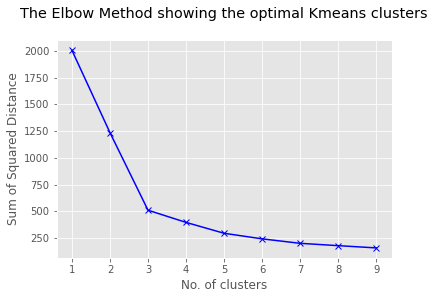

In [74]:
#Plotting to find the number of clusters
plt.plot(range(1,10), ssd,'bx-')
plt.xlabel("No. of clusters")
plt.ylabel("Sum of Squared Distance") #sum of squares within clusters
plt.title("The Elbow Method showing the optimal Kmeans clusters\n")
plt.show()

In [90]:
kmeans = KMeans(n_clusters=3)
kmeans.fit(protein_vectors)

KMeans(n_clusters=3)

In [91]:
vector_df['cluster'] = kmeans.predict(protein_vectors)

In [92]:
vector_df.head(20)

,0,1,2,3,4,5,6,7,8,9,...,494,495,496,497,498,499,strain,cluster,svd_1,svd_2
ids,,,,,,,,,,,,,,,,,,,,,
NC_045512.2,0.042690,0.042701,0.042701,0.042755,0.042679,0.042679,0.042690,0.042755,0.042765,0.042755,...,0.042755,0.042711,0.042711,0.042679,0.042733,0.042755,covid,2,0.879293,-0.473114
MT270101.1,0.042690,0.042701,0.042701,0.042755,0.042679,0.042679,0.042690,0.042755,0.042765,0.042755,...,0.042755,0.042711,0.042711,0.042679,0.042733,0.042755,covid,2,0.879293,-0.473114
MT270102.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,covid,1,0.496371,0.572994
MT270103.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,covid,1,0.496371,0.572994
MT270104.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,covid,1,0.496371,0.572994
MT270105.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,covid,0,0.451342,0.765837
MT270106.1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,covid,1,0.496371,0.572994
MT270107.1,0.042690,0.042701,0.042701,0.042755,0.042679,0.042679,0.042690,0.042755,0.042765,0.042755,...,0.042755,0.042711,0.042711,0.042679,0.042733,0.042755,covid,2,0.879293,-0.473114
MT270108.1,0.042690,0.042701,0.042701,0.042755,0.042679,0.042679,0.042690,0.042755,0.042765,0.042755,...,0.042755,0.042711,0.042711,0.042679,0.042733,0.042755,covid,2,0.879293,-0.473114


In [78]:
svd = TruncatedSVD(n_components=2, random_state=42)

In [79]:
svd_matrix = svd.fit_transform(protein_vectors)

In [80]:
vector_df['svd_1'] = svd_matrix[:, 0]
vector_df['svd_2'] = svd_matrix[:, 1]

In [95]:
vector_df[['svd_1', 'svd_2', 'cluster', 'strain']]

,svd_1,svd_2,cluster,strain
ids,,,,
NC_045512.2,0.879293,-0.473114,2,covid
MT270101.1,0.879293,-0.473114,2,covid
MT270102.1,0.496371,0.572994,1,covid
MT270103.1,0.496371,0.572994,1,covid
MT270104.1,0.496371,0.572994,1,covid
...,...,...,...,...
AY669852.1,0.000000,-0.000000,1,other
AY224602.1,0.188102,0.230869,1,other
AB070959.1,0.196091,0.065434,1,other


In [84]:
vector_df.shape[0]

6659

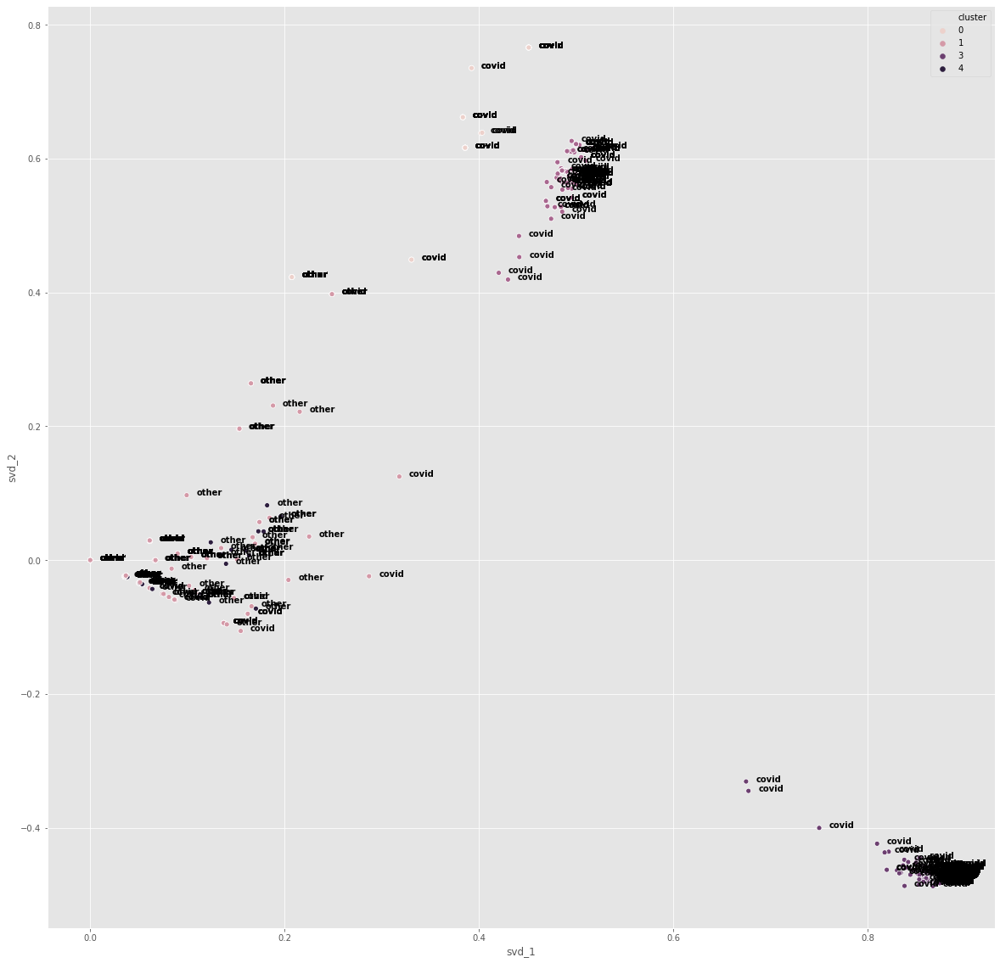

In [87]:
plt.figure(figsize=(20,20))
sp = sns.scatterplot(data=vector_df[['svd_1', 'svd_2', 'cluster','strain']], x='svd_1', y='svd_2', hue='cluster')
for line in range(0,vector_df.shape[0]):
     sp.text(vector_df.svd_1[line]+0.01, vector_df.svd_2[line], 
     vector_df.strain[line], horizontalalignment='left', 
     size='medium', color='black', weight='semibold')

In [102]:
import plotly.express as px
fig = px.scatter(vector_df.reset_index(), x="svd_1", y="svd_2", color="strain", 
                 hover_data=['strain', 'ids', 'cluster'], color_continuous_scale=px.colors.sequential.Viridis)
fig.show()